In [1]:
from os import chdir
chdir("../general")
from models import *
from util import *
from observation import *
from MCMC import *
chdir("../case-studies")

from fenics import *
from mshr import *

import numpy as np
from numpy import random
from numpy import linalg as linalg
import pandas
import geopandas
import contextily as ctx

from scipy import stats
from scipy.optimize import minimize
from scipy import sparse
from scipy import linalg as dlinalg
from scipy.sparse import linalg as splinalg
from sksparse import cholmod

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from mpl_toolkits.axes_grid1 import make_axes_locatable
from decimal import Decimal

import time

In [2]:
# Define units
distscale = 1e+03 # km in meters
timescale = 3600 # hr in seconds

# Create mesh and define function space
long_W = -129.0
long_E = -61
lat_N = 54.0
lat_S = 20.0
mesh = RectangleMesh(Point(long_W,lat_S),Point(long_E,lat_N),int(long_E-long_W),int(lat_N-lat_S))

V = FunctionSpace(mesh, 'P', 1)
fem = V.element()

interior_exp = Expression("x[0] >= -125.5 and x[0] <= -64.5 and x[1] >= 24 and x[1] <= 49.5",degree=0,domain=mesh)
interior_f = Function(V)
interior_f.interpolate(interior_exp)

class Interior(SubDomain):
	def inside(self,x,on_boundary):
		return (x[0] >= -125.5 and x[0] <= -64.5 and x[1] >= 24 and x[1] <= 49.5)
class Buffer(SubDomain):
	def inside(self,x,on_boundary):
		return (x[0] < -125.5 or x[0] > -64.5 or x[1] < 24 or x[1] > 49.5)
regions = MeshFunction("size_t", mesh, mesh.topology().dim() - 1)
subdomain_buffer = Buffer()
subdomain_buffer.mark(regions,0)
subdomain_interior = Interior()
subdomain_interior.mark(regions,1)

In [3]:
# now we need to warp the mesh to get lat/lon degrees in terms of km
x_coords = mesh.coordinates()[:,0].copy()
y_coords = mesh.coordinates()[:,1].copy()
km_y_coords = y_coords*111.11
km_x_coords = (95+x_coords)*np.cos(np.pi*y_coords/180)*111.11
km_xy_coords = np.array([km_x_coords, km_y_coords]).transpose()
mesh.coordinates()[:] = km_xy_coords

In [4]:
warped_V = FunctionSpace(mesh,'P',1)

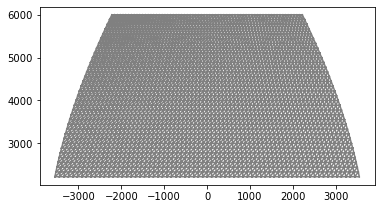

In [5]:
plot(mesh)
plt.show()

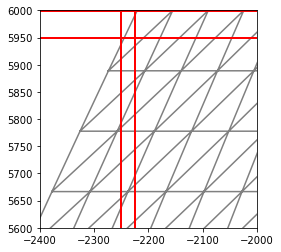

In [6]:
plot(mesh)
plt.xlim((-2400,-2000))
plt.ylim((5600,6000))
plt.plot([-3000, -1100], [5999, 5999], 'r-', lw=2)
plt.plot([-3000, -1100], [5950, 5950], 'r-', lw=2)
plt.plot([-2250, -2250], [4000, 7000], 'r-', lw=2)
plt.plot([-2225, -2225], [4000, 7000], 'r-', lw=2)
plt.show()
# if someone is going due south at, say 50km/hr
# due to the warping of this projection, in order to move to the correct location they need a phantom "westward" component of about 25km/hr

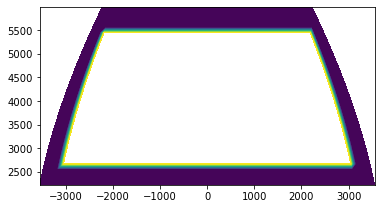

In [7]:
plot(interior_f,mesh=mesh)
plt.show()

In [8]:
chdir("../data/nomads")
wind_df = pandas.read_csv("jan01windus.csv")
chdir("../../case-studies")
lon = wind_df['lon'][wind_df['variable']=="UGRD"]
lat = wind_df['lat'][wind_df['variable']=="UGRD"]

vlon = wind_df['lon'][wind_df['variable']=="VGRD"]
vlat = wind_df['lat'][wind_df['variable']=="VGRD"]

print(np.all(np.array(vlon)==np.array(lon)))
print(np.all(np.array(vlat)==np.array(lat))) # THESE MUST BOTH BE TRUE IN ORDER FOR VEL_LAT TO BE ORDERED CORRECTLY

True
True


In [9]:
vel_lon = wind_df['value'][wind_df['variable']=="UGRD"]
vel_lat = wind_df['value'][wind_df['variable']=="VGRD"] # ARE THESE IN THE SAME ORDER SPATALLY????

# convert to km/hr and x/y projection
speed = np.sqrt(np.array(vel_lon)**2 + np.array(vel_lat)**2)*timescale/distscale
vel_x = (vel_lon*np.cos(lat*np.pi/180) - np.array(vel_lat*np.array((np.pi/180)*(95+lon)*np.sin(lat*np.pi/180))))*timescale/distscale
vel_y = vel_lat*timescale/distscale

vel = list(zip(vel_x,vel_y))
pts = list(zip((95+lon)*np.cos(lat*np.pi/180)*111.11,lat*111.11))

vecspace = VectorFunctionSpace(mesh,'P',1,2)
vel_f = spatialvec_to_func(pts,vel,vecspace)
speed_f = spatialvec_to_func(pts,speed.reshape(len(speed),1),warped_V)
advection = vel_f


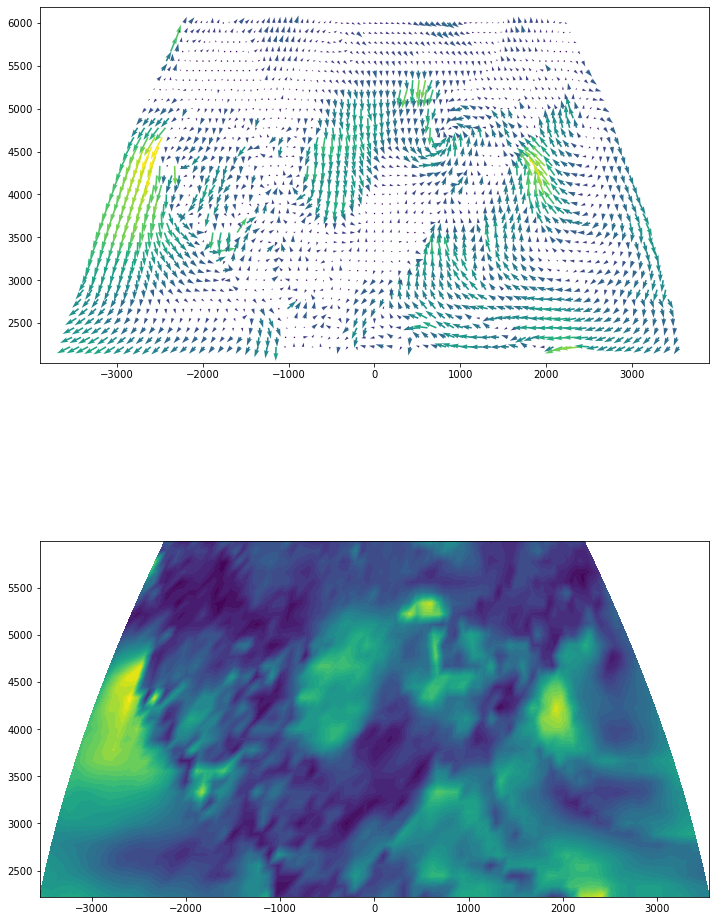

In [10]:
fig = plt.figure(figsize=(12,18))

plt.subplot(2,1,1)
plot(advection,mesh=mesh)

plt.subplot(2,1,2)
plot(speed_f)
plt.show()

In [11]:
# Get the mechanics problem matrices
u = TrialFunction(warped_V)
v = TestFunction(warped_V)
n = FacetNormal(mesh) # on external cells this automatically points out

# The mass matrix is defined by the mesh but the stiffness requires optimization for hyperparameters
mass = u*v*dx
L = assemble_mat(mass)
diag = L.sum(axis=0)
m = diag.size
print(m)
invL = sparse.spdiags(1/diag,0,m,m)

2415


In [12]:
# Get observations
chdir("../data/epa_air_quality_data")
pm25_df = pandas.read_csv("jan1_processed_air_quality_us.csv")
chdir("../../case-studies")

In [13]:
lons = pm25_df["SITE_LONGITUDE"]
lats = pm25_df["SITE_LATITUDE"]

xs = (95+lons)*np.cos(lats*np.pi/180)*111.11
ys = 111.11*lats
pts = [[xs[i],ys[i]] for i in range(len(xs))]
data = np.array(pm25_df["Daily.Mean.PM2.5.Concentration"]) # units of ug/m^3
O = make_obs_mat_pts(pts,fem,mesh,warped_V,threshold=1e-10)

In [14]:
pm25_df

,Unnamed: 0,Date,Daily.Mean.PM2.5.Concentration,SITE_LATITUDE,SITE_LONGITUDE,STATE,COUNTY
0,801,01/01/2019,7.3,33.553056,-86.815000,Alabama,Jefferson
1,1341,01/01/2019,5.2,33.331111,-87.003611,Alabama,Jefferson
2,1829,01/01/2019,6.7,33.545278,-86.549167,Alabama,Jefferson
3,2359,01/01/2019,6.4,33.499722,-86.924167,Alabama,Jefferson
4,2782,01/01/2019,5.0,33.801667,-86.942500,Alabama,Jefferson
...,...,...,...,...,...,...,...
941,416958,01/01/2019,6.9,41.182227,-104.778334,Wyoming,Laramie
942,417841,01/01/2019,4.4,44.526120,-109.016730,Wyoming,Park
943,418478,01/01/2019,9.0,42.869824,-109.870760,Wyoming,Sublette
944,419145,01/01/2019,5.5,43.482560,-110.745260,Wyoming,Teton


In [15]:
# get the posterior mean and covariance
def simultaneous_confint(cov,num_sim,p=0.05):
	std = np.sqrt(np.diag(cov))
	sim = random.multivariate_normal(np.zeros(cov.shape[0]),cov,size=num_sim)
	scaled = sim/std
	max_scaled = np.amax(scaled,axis=0)
	q = np.quantile(max_scaled,1-p)
	return q*std

# def calc_hat_sigma2(x,Qpost_ch=None):

# 	rho,varratio,diff,dec = x
# 	logrho,logvarratio,logdiff,logdec = np.log(x)
# 	sample_size = len(data)

# 	if Qpost_ch is None:
# 		kappa = np.sqrt(8*nu)/rho
# 		diffusion,decay = Constant(diff),Constant(dec)
# 		equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds #- dot(n,advection)*u*v*ds # + div(advection*u)*v*dx
# 		K = assemble_mat(equation)
# 		Q_source = make_matern(guess_alpha,kappa,d,warped_V,1,threshold=0,space_name="warped US")  # we are factoring out sigma2 here
# 		Q_prior = K.transpose().tocsc() @ invL @ Q_source @ invL @ K
# 		Q_post = Q_prior + O@O.transpose()/varratio	
# 		Qpost_ch = cholmod.cholesky(Q_post.tocsc())

# 	inner_prod_term1 = data@data/varratio
# 	inner_prod_term2 = (O@data).transpose() @ Qpost_ch.solve_A(O@data)/varratio**2
# 	hat_sigma2 = (inner_prod_term1 - inner_prod_term2)/sample_size
# 	return hat_sigma2

In [16]:
guess_alpha = 2		  # twice the number of recursive applications
d = 2				  # dimension of the space
nu = guess_alpha-d/2  # matern nu parameter

In [17]:
# we guess that there might be correlation on the scale of high 10s or low 100s of kms, but not necessarily high 100s
rho_p = stats.gamma(4.0189541,scale=1/0.1099471)
print(rho_p.cdf(10))
print(rho_p.cdf(80))

# we expect sigma2 to be quite small (0.02 or so)
# but concentrations to be reasonably large (O(10 ug/m^3))
# so we might expect eps2 to be as high as 0.1-10 ug/m^3 or so
# this gives us an eps2 that has about 95% chance to be between those bounds
varratio_p = stats.gamma(1.1506877,scale=1/0.1332913)
print(varratio_p.cdf(0.33))
print(varratio_p.cdf(30))

# https://reader.elsevier.com/reader/sd/pii/S0307904X07001576?token=310E91295B3DE82BAA67BD55BE00C697FB652F04E998FC68169B170ADDCD9CB831571E0D44188A0287BB3D8968AD395B&originRegion=us-east-1&originCreation=20210927180035
# based on this link we are confident that diffusion should be approx. 36 km2/hr
diff_p = stats.gamma(8.474816,scale=1/1.045954)
print(diff_p.cdf(3.6))
print(diff_p.cdf(14.4))

# https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&ved=2ahUKEwjCh4XE3p_zAhUXqJ4KHSi0COIQFnoECBQQAw&url=https%3A%2F%2Fwww.webcms.pima.gov%2FUserFiles%2FServers%2FServer_6%2FFile%2FGovernment%2FEnvironmental%2520Quality%2FAir%2FAir%2520Monitoring%2FAAWhat%2520is%2520Particulate%2520Matter.pdf&usg=AOvVaw3tYKGlrowVEVDpPygH8-BG
# based on this link we are confident that decay should take days or weeks, so we set the CDF to 
# have approximately 95+% of mass between values that give 95% decay after 1day-1week
dec_p = stats.gamma(1.362488,scale=1/2.942860)
print(dec_p.cdf(0.027))
print(dec_p.cdf(1.5))

# https://www.statista.com/statistics/501298/volume-of-particulate-matter-2-5-emissions-us/
# we expect emissions in the US overall to be in the range of  1.5M tons/year
# or 165 tons/hour or 1.5e8 grams/hour
# or over 7.6M km^2, about
# or about 20grams/km^2/hour
# or about 20 micrograms/m^2/hour on average over all area
# measurements are made in units of micrograms/m^3
# so emissions are weirdly measured in units of "additional micrograms/m^3/hour"
# if we assume that PM2.5 is homoegenously distributed within the 100m-10,000m of atmosphere
# then "additional micrograms/m^3/hour" can be written as something like
# "1 additional micrograms emitted/m^3/hour * 100m" = "100 micrograms emitted/m^2/hour"
# so we may multiply the emissions function by something like 100 to get the actual 
# area-density of PM2.5 emitted
# divide the area-density expected by 100 to get the rate of increase
# therefore we expect the additional micrograms/m^3/hour to be approximately
# 0.2 micrograms/m^3/hour - 0.002 micrograms/m^3/hour
# with alpha=1 and beta=0.06
# we get a distribution that contains about 90% of its mass between 0.2 and 0.002

# but these units don't necessarily make any kind of real sense
# and we should expect sigma2 to be wonky
# in order to be truly accurate, it would need to be 3d+time
sigma2_p_alpha = 1.116810
sigma2_p_beta = 3.930237
sigma2_p = stats.invgamma(sigma2_p_alpha,scale=sigma2_p_beta)
print(sigma2_p.cdf(1))
print(sigma2_p.cdf(100))
priors = rho_p,varratio_p,diff_p,dec_p,sigma2_p

def median_init(priors,*args):
    return tuple(p.median() for p in priors)

def custom_init(*args):
    return (50,1,1,14,1)

rho_prop_std = 0.15 
varratio_prop_std = 0.25 # 1
diff_prop_std = 1 #3
dec_prop_std = 0.15

rho_prop_dist = lognorm_f(rho_prop_std)
varratio_prop_dist = lognorm_f(varratio_prop_std)
diff_prop_dist = lognorm_f(diff_prop_std)
dec_prop_dist = lognorm_f(dec_prop_std)

#joint_proposal = MultiProposal([rho_prop_dist,varratio_prop_dist,diff_prop_dist,dec_prop_dist],which=[0,1,2,3])
rho_dec_proposal = MultiProposal([rho_prop_dist,dec_prop_dist],which=[0,3])
varratio_proposal = MultiProposal([varratio_prop_dist],which=[1])
diff_proposal = MultiProposal([diff_prop_dist],which=[2])

0.025000019546047424
0.9750000358328649
0.025000007150132265
0.9750000175811538
0.024999957157056923
0.9749999332662084
0.025000040486640205
0.9750000307540794
0.02499997625271414
0.9749999651942582


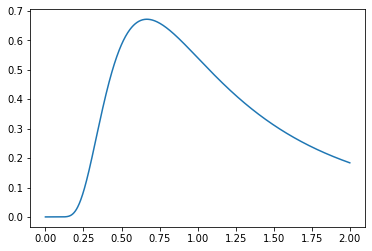

In [18]:
a = 2
b = 2
ig = stats.invgamma(a,scale=b)
x = np.linspace(0,2,1000)
pdf = [ig.pdf(x) for x in x]
plt.plot(x,pdf)

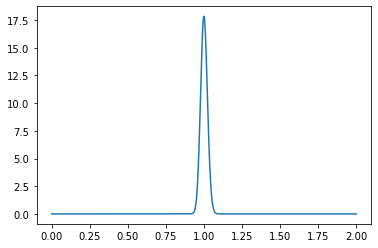

In [19]:
a = 2000
b = 2000
ig = stats.invgamma(a,scale=b)
x = np.linspace(0,2,1000)
pdf = [ig.pdf(x) for x in x]
plt.plot(x,pdf)

In [20]:

diffmat = assemble_mat(dot(grad(u),grad(v))*dx)
advmat = assemble_mat(-dot(advection*u,grad(v))*dx+dot(advection*u,n)*v*ds)
decaymat = assemble_mat(u*v*dx)

def loglik(x):
    print(x)
    rho,varratio,diff,dec,sigma2 = tuple(x)
    logrho,logvarratio,logdiff,logdec,logsigma2 = np.log(x)
    eps2 = sigma2*varratio
    logeps2 = logsigma2 + logvarratio
    
    kappa = np.sqrt(8*nu)/rho
    #diffusion,decay = Constant(diff),Constant(dec)
    #equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds
    #K = assemble_mat(equation)
    K = diff*diffmat + advmat + dec*decaymat
    
    Q_source = make_matern(guess_alpha,kappa,d,warped_V,sigma2,threshold=0,space_name="warped US") 
    Q_prior = K.transpose().tocsc() @ invL @ Q_source @ invL @ K
    Q_post = Q_prior + O@O.transpose()/eps2
    Q_prior_chol = cholmod.cholesky(Q_prior.tocsc())
    Q_post_chol = cholmod.cholesky(Q_post.tocsc())
    
    quadform = np.sum(data**2)/eps2 - data @ O.transpose() @ Q_post_chol(O @ data/eps2)/eps2
    logdets = len(data)*logeps2 - Q_prior_chol.logdet() + Q_post_chol.logdet()
    loglik = -(logdets+quadform)/2
    loglik += logsigma2 - 2*logrho # transforms for varratio and rho
    print("~~~~~~~~")
    print(loglik)
    return loglik

def log_lik_with_priors(priors,pars):
    log_lik = loglik(pars)
    for i in range(len(priors)):
        priori = priors[i]
        parsi = pars[i]
        log_lik += priori.logpdf(parsi)
    return log_lik

#updates = [MH_update(joint_proposal,log_lik_with_priors)]   
def sigma2gibbs(priors,pars):
    print("DOING GIBBS")
    rho,varratio,diff,dec,old_sigma2 = tuple(pars)
    logrho,logvarratio,logdiff,logdec,log_old_sigma2 = np.log(pars)
    sample_size = len(data)

    kappa = np.sqrt(8*nu)/rho
    #diffusion,decay = Constant(diff),Constant(dec)
    #equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds
    #K = assemble_mat(equation)
    K = diff*diffmat + advmat + dec*decaymat
    
    Q_source = make_matern(guess_alpha,kappa,d,warped_V,1,threshold=0,space_name="warped US")  # we are factoring out sigma2 here
    Q_prior = K.transpose().tocsc() @ invL @ Q_source @ invL @ K
    Q_post = Q_prior + O@O.transpose()/varratio	# we are factoring out sigma2 here
    Qpost_ch = cholmod.cholesky(Q_post.tocsc())

    inner_prod_term1 = np.sum(data**2)/varratio
    inner_prod_term2 = (O @ data).transpose() @ Qpost_ch(O@data/varratio)/varratio
    twice_beta = inner_prod_term1 - inner_prod_term2
    print("term1: {term1}, term2: {term2}, beta: {beta}, mode: {mode}".format(term1=inner_prod_term1,term2=inner_prod_term2,beta=twice_beta/2,mode=twice_beta/(len(data)-2)))
    
    alpha = len(data)/2-2 + sigma2_p_alpha
    beta = twice_beta/2 + sigma2_p_beta
    new_sigma2 = stats.invgamma(alpha,scale=beta).rvs()
    new_pars = rho,varratio,diff,dec,new_sigma2
    return new_pars
    
updates = [MH_update(x,log_lik_with_priors) for x in [rho_dec_proposal,varratio_proposal,diff_proposal]]
updates += [gibbs_update(sigma2gibbs,log_lik_with_priors)]
def initf(): return median_init(priors),log_lik_with_priors(priors,median_init(priors))
def initf(): return custom_init(),log_lik_with_priors(priors,custom_init())

cyclef = MCMC_cycle(updates)

num_chains = 4
num_sample= 1000#5000 # approx 1 hour for every 100*5 so, approx 10hr runtime, started 1pm 12/6
thin_rate = 5#5
remote = True
num_warmup = num_sample*thin_rate
initf()

(50, 1, 1, 14, 1)
~~~~~~~~
-69519.47451997008


((50, 1, 1, 14, 1), -69577.39593531798)

In [45]:
def sample(seed=None):
    if seed is not None:
        random.seed(seed)
    start = time.time()
    samples,successes = MCMC_chain(num_warmup,num_sample,thin_rate,priors,initf,cyclef)
    end = time.time()
    print("Total time elapsed: ", end-start)
    print("Time per sample: ", (end-start)/num_sample)
    print("Proportion of proposals accepted: ",np.array(successes)/(num_sample*thin_rate))
    return samples

def plot_samples(samples,remote=False):
    rho = [samples[j][i][0] for i in range(num_sample) for j in range(num_chains)]
    varratio = [samples[j][i][1] for i in range(num_sample) for j in range(num_chains)]
    diff = [samples[j][i][2] for i in range(num_sample) for j in range(num_chains)]
    dec = [samples[j][i][3] for i in range(num_sample) for j in range(num_chains)]
    sigma2 = [samples[j][i][4] for i in range(num_sample) for j in range(num_chains)]
    
    fig = plt.figure(figsize=(24,4))
    
    ax_r = plt.subplot(1,6,1)
    ax_r.set_title('Rho')
    plt.hist(rho)
    ax_v = plt.subplot(1,6,2)
    ax_v.set_title('Var Ratio')
    plt.hist(varratio)
    ax_diff = plt.subplot(1,6,3)
    ax_diff.set_title('Log Diffusion')
    plt.hist(np.log(diff))
    ax_dec = plt.subplot(1,6,4)
    ax_dec.set_title('Decay')
    plt.hist(dec)
    ax_s = plt.subplot(1,6,5)
    ax_s.set_title('Sigma2')
    plt.hist(sigma2)
    ax_e = plt.subplot(1,6,6)
    ax_e.set_title('Epsilon2')
    plt.hist([sigma2[i]*varratio[i] for i in range(len(sigma2))])
    plt.tight_layout()
    if remote:
        plt.savefig("../figs/movement_hists.png")
    else:
        plt.show()

def plot_tracks(samples, remote=False):
    rhos = [[samples[j][i][0] for i in range(num_sample)] for j in range(num_chains)]
    varratios = [[samples[j][i][1] for i in range(num_sample)] for j in range(num_chains)]
    diffs = [[samples[j][i][2] for i in range(num_sample)] for j in range(num_chains)]
    decs = [[samples[j][i][3] for i in range(num_sample)] for j in range(num_chains)]
    sigma2 = [[samples[j][i][4] for i in range(num_sample)] for j in range(num_chains)]
    
    plt.figure(figsize=(24,4))
    plt.subplot(1,6,1)
    for i in range(num_chains):
        plt.plot(rhos[i])
    plt.title("Rho")
    plt.subplot(1,6,2)
    for i in range(num_chains):
        plt.plot(varratios[i])
    plt.title("Var Ratio")
    plt.subplot(1,6,3)
    for i in range(num_chains):
        plt.plot(diffs[i])
    plt.title("Diffusion")
    plt.subplot(1,6,4)
    for i in range(num_chains):
        plt.plot(decs[i])
    plt.title("Decay")
    plt.subplot(1,6,5)
    for i in range(num_chains):
        plt.plot(sigma2[i])
    plt.title("Sigma2")
    plt.subplot(1,6,6)
    for i in range(num_chains):
        plt.plot([sigma2[i][j]*varratios[i][j] for j in range(num_sample)])
    plt.title("Epsilon2")
    if remote:
        plt.savefig("../figs/MCMC_tracks.png")
    else:
        plt.show()

In [22]:
random.seed(875154)
samples = [sample() for i in range(num_chains)]

(50, 1, 1, 14, 1)
~~~~~~~~
-69519.47451997008
[63.971748000769004, 1, 1, 15.658208588695116, 1]
~~~~~~~~
-69692.33943620627
~~~~~~
new, old, prop ratio
-69755.89237801809
-69577.39593531798
0.35835650330445423
[50, 1.0652654218898254, 1, 14, 1]
~~~~~~~~
-65483.27771473128
~~~~~~
new, old, prop ratio
-65541.19830231438
-69577.39593531798
0.06322399054239791
[50, 1.0652654218898254, 1.2573705005625908, 14, 1]
~~~~~~~~
-65483.43874177052
~~~~~~
new, old, prop ratio
-65539.91662499402
-65541.19830231438
0.22902263602881434
DOING GIBBS
term1: 137416.46634911594, term2: 6538.704768020203, beta: 65438.88079054787, mode: 138.6416965901438
(50, 1.0652654218898254, 1.2573705005625908, 14, 135.0987023997861)
~~~~~~~~
-2844.5709207156715
[46.19017857622412, 1.0652654218898254, 1.2573705005625908, 12.642392375329868, 135.0987023997861]
~~~~~~~~
-2842.2963802476766
~~~~~~
new, old, prop ratio
-2901.1203159312636
-2907.532740335307
-0.18125750347579106
[46.19017857622412, 0.7525140297040672, 1.257370

~~~~~~~~
-2817.1783293560766
~~~~~~
new, old, prop ratio
-2870.7588472687366
-2864.741852140826
-1.4399996321211836
DOING GIBBS
term1: 158690.7107685226, term2: 19480.999297756935, beta: 69604.85573538284, mode: 147.4679146936077
(89.15365440027891, 0.9224548134611826, 5.904171345687273, 10.071892465285522, 147.5823104567039)
~~~~~~~~
-2817.1415808014854
[77.74227771335462, 0.9224548134611826, 5.904171345687273, 9.73191270078074, 147.5823104567039]
~~~~~~~~
-2816.5480885716734
~~~~~~
new, old, prop ratio
-2862.285826220456
-2864.708549574437
-0.17130027647826496
[77.74227771335462, 1.2692260276044356, 5.904171345687273, 9.73191270078074, 147.5823104567039]
~~~~~~~~
-2845.541479308778
~~~~~~
new, old, prop ratio
-2891.277350455615
-2862.285826220456
0.31912417457626274
[77.74227771335462, 0.9224548134611826, 8.662964492148737, 9.73191270078074, 147.5823104567039]
~~~~~~~~
-2816.5710659221454
~~~~~~
new, old, prop ratio
-2862.3285457252623
-2862.285826220456
0.383397875262693
DOING GIBBS

~~~~~~~~
-2676.553963384412
[63.61495816640941, 0.49527792800195, 8.197429626842268, 4.177756424695669, 153.9421497549373]
~~~~~~~~
-2683.3997707843414
~~~~~~
new, old, prop ratio
-2712.221814196112
-2706.5596886886437
-0.1974279978014204
[74.6754472558839, 0.40496078511092554, 8.197429626842268, 4.33577182894371, 153.9421497549373]
~~~~~~~~
-2669.8207120892303
~~~~~~
new, old, prop ratio
-2699.8447366839446
-2706.5596886886437
-0.20132884018208697
[74.6754472558839, 0.40496078511092554, 4.215583236856488, 4.33577182894371, 153.9421497549373]
~~~~~~~~
-2669.6427892868232
~~~~~~
new, old, prop ratio
-2700.472982724562
-2699.8447366839446
-0.6650326913753393
DOING GIBBS
term1: 361479.47006746026, term2: 181575.41426387167, beta: 89952.0279017943, mode: 190.57633030041166
(74.6754472558839, 0.40496078511092554, 8.197429626842268, 4.33577182894371, 190.9934373995113)
~~~~~~~~
-2658.2588933246025
[74.32270284707324, 0.40496078511092554, 8.197429626842268, 4.417171936802486, 190.993437399511

~~~~~~~~
-2566.7809166800744
~~~~~~
new, old, prop ratio
-2591.0511759971373
-2584.855257351962
0.21492455920562104
[58.65540623960274, 0.14941932663714824, 2.5489951131299127, 2.341440733848724, 229.37282355880507]
~~~~~~~~
-2560.9359455467893
~~~~~~
new, old, prop ratio
-2588.0573061857185
-2584.855257351962
-1.168121436769455
DOING GIBBS
term1: 979692.6093468698, term2: 756922.4535479777, beta: 111385.07789944601, mode: 235.9853345327246
(58.65540623960274, 0.14941932663714824, 8.197429626842268, 2.341440733848724, 249.06633391226248)
~~~~~~~~
-2561.0396434834092
[56.955658160741805, 0.14941932663714824, 8.197429626842268, 2.6034481046316666, 249.06633391226248]
~~~~~~~~
-2567.6159570923705
~~~~~~
new, old, prop ratio
-2592.7213324650274
-2585.5105219258767
0.07666361160480717
[58.65540623960274, 0.20618928738851464, 8.197429626842268, 2.341440733848724, 249.06633391226248]
~~~~~~~~
-2580.7310408368567
~~~~~~
new, old, prop ratio
-2605.160959056915
-2585.5105219258767
0.322037991677

~~~~~~~~
-2520.740222563943
~~~~~~
new, old, prop ratio
-2547.1785540547994
-2548.9505936467017
-0.35369687043290554
DOING GIBBS
term1: 1119909.9626167237, term2: 911762.1099738411, beta: 104073.92632144131, mode: 220.49560661322312
(86.36797491506691, 0.13071140974401582, 10.68555249581113, 2.2992525738900804, 220.8675707078653)
~~~~~~~~
-2519.0202502854113
[92.62269676266418, 0.13071140974401582, 10.68555249581113, 2.294692691980005, 220.8675707078653]
~~~~~~~~
-2511.0908093858866
~~~~~~
new, old, prop ratio
-2538.173236197039
-2545.6387650924353
0.06793209967619152
[92.62269676266418, 0.1330960280501685, 10.68555249581113, 2.294692691980005, 220.8675707078653]
~~~~~~~~
-2511.07609084546
~~~~~~
new, old, prop ratio
-2538.1561112272157
-2538.173236197039
0.01807896908900819
[92.62269676266418, 0.1330960280501685, 24.526006509505788, 2.294692691980005, 220.8675707078653]
~~~~~~~~
-2509.9141852935277
~~~~~~
new, old, prop ratio
-2545.260296950982
-2538.1561112272157
0.8308414497080925
D

~~~~~~~~
-2441.1428825759467
[198.17821228531687, 0.1341444576817855, 6.673433359518571, 2.0519466416049954, 188.71322426646168]
~~~~~~~~
-2416.399983010463
~~~~~~
new, old, prop ratio
-2451.106653674145
-2472.894384564179
0.18877247338546943
[198.17821228531687, 0.1166493585148601, 6.673433359518571, 2.0519466416049954, 188.71322426646168]
~~~~~~~~
-2422.8450187623753
~~~~~~
new, old, prop ratio
-2457.5704152983876
-2451.106653674145
-0.13974476245921608
[198.17821228531687, 0.1341444576817855, 35.46517670854935, 2.0519466416049954, 188.71322426646168]
~~~~~~~~
-2414.2814581854655
~~~~~~
new, old, prop ratio
-2466.616909724705
-2451.106653674145
1.6704168032142137
DOING GIBBS
term1: 1091249.0350309608, term2: 918521.8512720687, beta: 86363.59187944606, mode: 182.9737116089959
(198.17821228531687, 0.1341444576817855, 6.673433359518571, 2.0519466416049954, 175.49497163913415)
~~~~~~~~
-2416.5939390815975
[253.50265751627475, 0.1341444576817855, 6.673433359518571, 1.9857976024553474, 175

~~~~~~~~
-2351.5078046910353
~~~~~~
new, old, prop ratio
-2401.358934092298
-2394.7499476726093
-0.1986752592198009
[341.21199340284994, 0.1441618331362229, 9.391899356392623, 2.348265426010437, 198.1505247649227]
~~~~~~~~
-2344.9093625368973
~~~~~~
new, old, prop ratio
-2394.9069377137625
-2394.7499476726093
0.09010531694337276
DOING GIBBS
term1: 1015421.3970189763, term2: 828767.4614892814, beta: 93326.96776484745, mode: 197.7266266204395
(341.21199340284994, 0.1441618331362229, 9.391899356392623, 2.348265426010437, 194.3847237231339)
~~~~~~~~
-2344.9772466242475
[377.8252369354202, 0.1441618331362229, 9.391899356392623, 2.607333658436742, 194.3847237231339]
~~~~~~~~
-2339.904193876437
~~~~~~
new, old, prop ratio
-2394.3038080573715
-2394.9345894234084
0.20657896023740363
[377.8252369354202, 0.17266709838236705, 9.391899356392623, 2.607333658436742, 194.3847237231339]
~~~~~~~~
-2341.9948739432302
~~~~~~
new, old, prop ratio
-2396.371099205425
-2394.3038080573715
0.18042894410925792
[

term1: 1015497.8497994967, term2: 811267.6206384721, beta: 102115.11458051228, mode: 216.34558173837348
(546.4563542191303, 0.1441509797671189, 6.371379320896058, 2.3180060884143963, 228.5347887644677)
~~~~~~~~
-2317.3658431783483
[680.5410874798542, 0.1441509797671189, 6.371379320896058, 2.0888781525687303, 228.5347887644677]
~~~~~~~~
-2311.9287242211794
~~~~~~
new, old, prop ratio
-2396.4698992760386
-2388.4638147084775
0.11535353966585205
[546.4563542191303, 0.13865402191203482, 6.371379320896058, 2.3180060884143963, 228.5347887644677]
~~~~~~~~
-2316.521208596491
~~~~~~
new, old, prop ratio
-2387.6243060835964
-2388.4638147084775
-0.03887944161867907
[546.4563542191303, 0.13865402191203482, 13.529534233881272, 2.3180060884143963, 228.5347887644677]
~~~~~~~~
-2316.513040881829
~~~~~~
new, old, prop ratio
-2389.474261395134
-2387.6243060835964
0.7530590368588714
DOING GIBBS
term1: 1055757.4023555545, term2: 845467.1534389001, beta: 105145.12445832719, mode: 222.76509419137116
(546.456

~~~~~~~~
-2319.9020391245845
[586.051341102403, 0.15179455051321541, 10.675011631264944, 2.798163839170086, 224.12329929760705]
~~~~~~~~
-2324.1979588392874
~~~~~~
new, old, prop ratio
-2401.3789328782223
-2389.4713234106025
0.2982436683167099
[526.2321693584742, 0.10055174818875891, 10.675011631264944, 2.312628273761513, 224.12329929760705]
~~~~~~~~
-2331.92454346037
~~~~~~
new, old, prop ratio
-2401.549059079082
-2389.4713234106025
-0.41185546286405006
[526.2321693584742, 0.15179455051321541, 9.2758580737741, 2.312628273761513, 224.12329929760705]
~~~~~~~~
-2319.9090139348996
~~~~~~
new, old, prop ratio
-2389.0649888207467
-2389.4713234106025
-0.14049052978704557
DOING GIBBS
term1: 964362.7488936472, term2: 769872.0262796787, beta: 97245.36130698427, mode: 206.02830785378023
(526.2321693584742, 0.15179455051321541, 9.2758580737741, 2.312628273761513, 234.251663599336)
~~~~~~~~
-2322.011017019638
[400.41887627609236, 0.15179455051321541, 9.2758580737741, 2.5189737065971918, 234.251663

~~~~~~~~
-2323.5371735296553
~~~~~~
new, old, prop ratio
-2395.488659452527
-2389.5570229055456
0.17274574984714386
[526.2321693584742, 0.13878706815930483, 18.050604032678564, 2.312628273761513, 222.08156050854657]
~~~~~~~~
-2317.580151746487
~~~~~~
new, old, prop ratio
-2390.93019847167
-2389.5570229055456
0.13509558084571927
DOING GIBBS
term1: 1054745.315550394, term2: 846558.5707368139, beta: 104093.37240678997, mode: 220.53680594658894
(526.2321693584742, 0.13878706815930483, 15.769592615897182, 2.312628273761513, 208.2246775617736)
~~~~~~~~
-2318.365488692756
[459.4503158546521, 0.13878706815930483, 15.769592615897182, 2.4357963009904724, 208.2246775617736]
~~~~~~~~
-2324.4820786818113
~~~~~~
new, old, prop ratio
-2389.731798281218
-2390.20431495054
-0.08382262509173044
[459.4503158546521, 0.1611803164247649, 15.769592615897182, 2.4357963009904724, 208.2246775617736]
~~~~~~~~
-2326.464545332442
~~~~~~
new, old, prop ratio
-2391.694709462718
-2389.731798281218
0.1495828412196687
[

~~~~~~~~
-2321.3858881292517
~~~~~~
new, old, prop ratio
-2401.4561767974487
-2385.0765077764695
1.4372312220333807
DOING GIBBS
term1: 967149.170826338, term2: 784588.587877881, beta: 91280.29147422849, mode: 193.3904480386197
(483.7258430657153, 0.15135722018448072, 8.108268735443069, 2.1155735593459726, 199.68372794616351)
~~~~~~~~
-2321.4778556652673
[332.6825259094918, 0.15135722018448072, 8.108268735443069, 2.237431983825758, 199.68372794616351]
~~~~~~~~
-2348.8644385581756
~~~~~~
new, old, prop ratio
-2397.457694979181
-2385.2094908239314
-0.31832683647156224
[483.7258430657153, 0.18626570746343363, 8.108268735443069, 2.1155735593459726, 199.68372794616351]
~~~~~~~~
-2329.6760958749337
~~~~~~
new, old, prop ratio
-2393.3811115944404
-2385.2094908239314
0.20753144953165314
[483.7258430657153, 0.15135722018448072, 31.701393436776815, 2.1155735593459726, 199.68372794616351]
~~~~~~~~
-2321.269908451248
~~~~~~
new, old, prop ratio
-2399.4871325670665
-2385.2094908239314
1.363476264392

~~~~~~~~
-2321.2112716332495
[407.476149579702, 0.1575553916398444, 3.3507788261967826, 2.3498175604516143, 188.5138379546419]
~~~~~~~~
-2331.4358294759127
~~~~~~
new, old, prop ratio
-2389.456583042989
-2386.4463170450335
-0.06652417484657691
[483.7258430657153, 0.14991300931519438, 3.3507788261967826, 2.1155735593459726, 188.5138379546419]
~~~~~~~~
-2321.543302209025
~~~~~~
new, old, prop ratio
-2386.7848214366986
-2386.4463170450335
-0.04972190141908728
[483.7258430657153, 0.1575553916398444, 7.528802668908227, 2.1155735593459726, 188.5138379546419]
~~~~~~~~
-2321.185088579134
~~~~~~
new, old, prop ratio
-2384.738968151615
-2386.4463170450335
0.8095432168072545
DOING GIBBS
term1: 929101.8763396004, term2: 751952.9433322082, beta: 88574.46650369611, mode: 187.6577680163053
(483.7258430657153, 0.1575553916398444, 7.528802668908227, 2.1155735593459726, 177.59879450818332)
~~~~~~~~
-2321.9098579223296
[506.61294428363385, 0.1575553916398444, 7.528802668908227, 1.9940786497642222, 177.59

~~~~~~~~
-2342.48406393458
~~~~~~
new, old, prop ratio
-2401.9855158353707
-2386.531185158417
-0.25896709981257526
[433.9747295102386, 0.13215532512798908, 15.5363632538467, 2.3706471204808937, 213.01389062257766]
~~~~~~~~
-2327.0206461897415
~~~~~~
new, old, prop ratio
-2389.3813511438057
-2386.531185158417
0.6368301411146255
DOING GIBBS
term1: 1107673.9424478721, term2: 898897.8413569928, beta: 104388.05054543965, mode: 221.1611240369484
(433.9747295102386, 0.13215532512798908, 8.218215981136334, 2.3706471204808937, 217.60469722042558)
~~~~~~~~
-2326.79041866267
[492.0571435454691, 0.13215532512798908, 8.218215981136334, 2.2613468353052997, 217.60469722042558]
~~~~~~~~
-2320.3502490163314
~~~~~~
new, old, prop ratio
-2385.563684986214
-2386.3016132339785
0.07840616580729731
[492.0571435454691, 0.1366198463505519, 8.218215981136334, 2.2613468353052997, 217.60469722042558]
~~~~~~~~
-2320.2029118900423
~~~~~~
new, old, prop ratio
-2385.4119364501703
-2385.563684986214
0.0332242883286610

term1: 736091.739850684, term2: 588488.8015088509, beta: 73801.46917091653, mode: 156.35904485363673
(524.937174048175, 0.1988678884369687, 7.718202030627739, 1.9987628040325918, 162.1363855295651)
~~~~~~~~
-2318.9048989893063
[570.6946076911386, 0.1988678884369687, 7.718202030627739, 2.28455674901064, 162.1363855295651]
~~~~~~~~
-2321.4904719089805
~~~~~~
new, old, prop ratio
-2394.2437339759285
-2386.0869675944755
0.2172192733954239
[524.937174048175, 0.1530661028874516, 7.718202030627739, 1.9987628040325918, 162.1363855295651]
~~~~~~~~
-2324.571860406613
~~~~~~
new, old, prop ratio
-2391.7872696801533
-2386.0869675944755
-0.26177085395539756
[524.937174048175, 0.1988678884369687, 27.574166963069512, 1.9987628040325918, 162.1363855295651]
~~~~~~~~
-2318.861306372588
~~~~~~
new, old, prop ratio
-2397.2941332911805
-2386.0869675944755
1.2732979154970034
DOING GIBBS
term1: 736091.739850684, term2: 588488.8015088509, beta: 73801.46917091653, mode: 156.35904485363673
(524.937174048175, 0.

~~~~~~~~
-2328.514523774979
~~~~~~
new, old, prop ratio
-2404.881602792219
-2389.04424446594
0.2512607017968188
[524.937174048175, 0.19999094692701788, 3.251067468215517, 1.9987628040325918, 143.40483600709086]
~~~~~~~~
-2320.25945325495
~~~~~~
new, old, prop ratio
-2388.9744105316267
-2389.04424446594
0.003295949396655562
[524.937174048175, 0.19999094692701788, 1.9824520934314027, 1.9987628040325918, 143.40483600709086]
~~~~~~~~
-2320.2500165258634
~~~~~~
new, old, prop ratio
-2391.335469874281
-2388.9744105316267
-0.49464888466254986
DOING GIBBS
term1: 731958.1823542236, term2: 585089.579370636, beta: 73434.30149179377, mode: 155.58114722837664
(524.937174048175, 0.19999094692701788, 3.251067468215517, 1.9987628040325918, 171.67171255910426)
~~~~~~~~
-2320.8612573917776
[581.4650254208266, 0.19999094692701788, 3.251067468215517, 1.6517156576266645, 171.67171255910426]
~~~~~~~~
-2321.6062461319484
~~~~~~
new, old, prop ratio
-2395.6516694565344
-2389.952542263042
-0.08844161321305566


~~~~~~~~
-2324.978562796606
~~~~~~
new, old, prop ratio
-2389.5382500616065
-2385.169987776425
-1.790231421684895
DOING GIBBS
term1: 813132.6932344727, term2: 660375.1533130148, beta: 76378.76996072894, mode: 161.8194278829003
(453.7251839993662, 0.18002598003741666, 10.41024076333133, 1.976777870686261, 172.17892343721337)
~~~~~~~~
-2325.5405174472194
[400.9247760380137, 0.18002598003741666, 10.41024076333133, 1.8679622755196674, 172.17892343721337]
~~~~~~~~
-2336.9622664788785
~~~~~~
new, old, prop ratio
-2391.680265957076
-2385.9899750540008
-0.18033791102303165
[453.7251839993662, 0.173477605859222, 10.41024076333133, 1.976777870686261, 172.17892343721337]
~~~~~~~~
-2325.0593247042734
~~~~~~
new, old, prop ratio
-2385.5134928492316
-2385.9899750540008
-0.0370526558175448
[453.7251839993662, 0.173477605859222, 2.220544005233671, 1.976777870686261, 172.17892343721337]
~~~~~~~~
-2325.172459646296
~~~~~~
new, old, prop ratio
-2388.6094549552536
-2385.5134928492316
-1.5450377971736762
D

~~~~~~~~
-2323.016237180841
[442.54945808136125, 0.1575377762480657, 6.631504988006796, 1.459145274829645, 181.01516280763775]
~~~~~~~~
-2352.0532627469547
~~~~~~
new, old, prop ratio
-2409.4763907781626
-2385.8149375541566
-0.3540131173612978
[482.75438601763807, 0.2098411060307947, 6.631504988006796, 1.9058120192447827, 181.01516280763775]
~~~~~~~~
-2333.395320153157
~~~~~~
new, old, prop ratio
-2396.157792152643
-2385.8149375541566
0.2866853276733692
[482.75438601763807, 0.1575377762480657, 5.193829650802123, 1.9058120192447827, 181.01516280763775]
~~~~~~~~
-2323.0360175925985
~~~~~~
new, old, prop ratio
-2386.157525170362
-2385.8149375541566
-0.24436045972215714
DOING GIBBS
term1: 929205.7656666166, term2: 761117.6567389601, beta: 84044.05446382827, mode: 178.05943742336498
(482.75438601763807, 0.1575377762480657, 5.193829650802123, 1.9058120192447827, 167.34524669996608)
~~~~~~~~
-2323.9003913450206
[518.4309386588072, 0.1575377762480657, 5.193829650802123, 2.0318323424364166, 167

~~~~~~~~
-2324.830081886273
~~~~~~
new, old, prop ratio
-2391.779717077426
-2385.2717026659398
0.19734914676613924
[518.4309386588072, 0.16639536051172407, 1.3857852348210833, 2.0318323424364166, 180.80043696426742]
~~~~~~~~
-2318.3254099610767
~~~~~~
new, old, prop ratio
-2391.3850247347386
-2385.2717026659398
-1.83472940317808
DOING GIBBS
term1: 879742.1367387575, term2: 710154.5882317415, beta: 84793.77425350802, mode: 179.6478268082797
(518.4309386588072, 0.16639536051172407, 8.679781353861985, 2.0318323424364166, 163.10557081226935)
~~~~~~~~
-2320.5624786061476
[512.2652909302598, 0.16639536051172407, 8.679781353861985, 1.9363673394424212, 163.10557081226935]
~~~~~~~~
-2320.3458491253023
~~~~~~
new, old, prop ratio
-2386.199447112923
-2387.321348004905
-0.06008849248124504
[512.2652909302598, 0.15664156191446635, 8.679781353861985, 1.9363673394424212, 163.10557081226935]
~~~~~~~~
-2322.8810048773944
~~~~~~
new, old, prop ratio
-2388.7424052845217
-2386.199447112923
-0.060406496361

~~~~~~~~
-2324.7914776098346
[488.2443533553439, 0.19944286745843176, 4.9871899137046185, 2.2084635398159826, 160.552206696912]
~~~~~~~~
-2323.714490838576
~~~~~~
new, old, prop ratio
-2388.048907956076
-2385.7753588234714
0.16381365498097744
[461.9718368584009, 0.20766277333184507, 4.9871899137046185, 1.9813837465099984, 160.552206696912]
~~~~~~~~
-2326.0934996802216
~~~~~~
new, old, prop ratio
-2387.0723906114085
-2385.7753588234714
0.04038766528160842
[461.9718368584009, 0.19944286745843176, 4.152437121563572, 1.9813837465099984, 160.552206696912]
~~~~~~~~
-2324.8009798422386
~~~~~~
new, old, prop ratio
-2386.280963805961
-2385.7753588234714
-0.18317718751030165
DOING GIBBS
term1: 733969.6418600171, term2: 591759.0962278699, beta: 71105.27281607362, mode: 150.64676444083392
(461.9718368584009, 0.19944286745843176, 4.9871899137046185, 1.9813837465099984, 146.7656805094645)
~~~~~~~~
-2324.016598211241
[347.4468717213512, 0.19944286745843176, 4.9871899137046185, 1.9384810578951994, 146

~~~~~~~~
-2324.5228161834784
~~~~~~
new, old, prop ratio
-2392.642868367949
-2386.325887250329
0.24822591218554768
[536.54405006513, 0.19944286745843176, 15.634241939604655, 1.6970265187823188, 142.88683972483835]
~~~~~~~~
-2318.154993886192
~~~~~~
new, old, prop ratio
-2388.4573833735585
-2386.325887250329
0.3353543916022832
DOING GIBBS
term1: 733969.6418600171, term2: 597087.80853233, beta: 68440.91666384356, mode: 145.0019420844143
(536.54405006513, 0.19944286745843176, 11.179805979157656, 1.6970265187823188, 153.53682058986962)
~~~~~~~~
-2318.882176876966
[535.125268667691, 0.19944286745843176, 11.179805979157656, 1.4792357740413977, 153.53682058986962]
~~~~~~~~
-2326.272914980883
~~~~~~
new, old, prop ratio
-2393.8340092918484
-2387.1824077152037
-0.13999982600527683
[536.54405006513, 0.33052091352600443, 11.179805979157656, 1.6970265187823188, 153.53682058986962]
~~~~~~~~
-2360.3367161641195
~~~~~~
new, old, prop ratio
-2428.5782998614227
-2387.1824077152037
0.5051421190732948
[5

term1: 859175.7829519564, term2: 699471.5919597973, beta: 79852.09549607954, mode: 169.17816842389732
(514.847271531057, 0.17037841720474284, 9.831202845429523, 1.8689300126410773, 169.87586146552107)
~~~~~~~~
-2319.3489125965175
[407.1505463297373, 0.17037841720474284, 9.831202845429523, 2.3163492598916213, 169.87586146552107]
~~~~~~~~
-2332.635403712111
~~~~~~
new, old, prop ratio
-2389.0338867942432
-2385.6409353887557
-0.02006101674519989
[514.847271531057, 0.18379522766165238, 9.831202845429523, 1.8689300126410773, 169.87586146552107]
~~~~~~~~
-2319.7830458192166
~~~~~~
new, old, prop ratio
-2386.0654347830027
-2385.6409353887557
0.0758002979637511
[514.847271531057, 0.18379522766165238, 8.591155329386687, 1.8689300126410773, 169.87586146552107]
~~~~~~~~
-2319.7965339168404
~~~~~~
new, old, prop ratio
-2385.7897052168278
-2386.0654347830027
-0.13482806744622255
DOING GIBBS
term1: 796457.0781428524, term2: 645682.0848808357, beta: 75387.49663100834, mode: 159.71927252332276
(514.84

~~~~~~~~
-2317.878309721376
~~~~~~
new, old, prop ratio
-2397.521964027813
-2387.211862233045
-0.1482714461892134
[521.4906082794469, 0.3065186994441429, 10.862824032145625, 1.7855800845155974, 113.86358722740665]
~~~~~~~~
-2323.2134121986005
~~~~~~
new, old, prop ratio
-2389.395718418685
-2387.211862233045
0.1989903845362062
[521.4906082794469, 0.2512097829209536, 6.484057267945394, 1.7855800845155974, 113.86358722740665]
~~~~~~~~
-2320.9693193292055
~~~~~~
new, old, prop ratio
-2386.451254335591
-2387.211862233045
-0.5159998844653688
DOING GIBBS
term1: 582720.1803126511, term2: 465788.297423541, beta: 58465.941444555036, mode: 123.8685200096505
(521.4906082794469, 0.2512097829209536, 6.484057267945394, 1.7855800845155974, 131.93770179634564)
~~~~~~~~
-2320.167856713842
[481.95563053278084, 0.2512097829209536, 6.484057267945394, 1.5473124697116656, 131.93770179634564]
~~~~~~~~
-2328.3199137830084
~~~~~~
new, old, prop ratio
-2389.3509717027373
-2385.9569301569372
-0.22206301251287014


~~~~~~~~
-2320.2633845904897
~~~~~~
new, old, prop ratio
-2388.2040201595487
-2385.80054322208
-0.6805122225422311
DOING GIBBS
term1: 566781.1121518814, term2: 452802.8717621966, beta: 56989.12019484243, mode: 120.73966142975091
(519.0976293508072, 0.2582743264753906, 5.1685894036163464, 1.773160256033957, 125.17234446142122)
~~~~~~~~
-2319.861726340867
[533.7386339957012, 0.2582743264753906, 5.1685894036163464, 2.0232325406205, 125.17234446142122]
~~~~~~~~
-2323.423212996974
~~~~~~
new, old, prop ratio
-2391.3488378447814
-2385.573481701461
0.15974738375836967
[519.0976293508072, 0.27799673987727713, 5.1685894036163464, 1.773160256033957, 125.17234446142122]
~~~~~~~~
-2322.353565056365
~~~~~~
new, old, prop ratio
-2388.0568605743997
-2385.573481701461
0.07358708561050165
[519.0976293508072, 0.27799673987727713, 6.134856731134838, 1.773160256033957, 125.17234446142122]
~~~~~~~~
-2322.347983021937
~~~~~~
new, old, prop ratio
-2387.780864050485
-2388.0568605743997
0.17138691651732074
DOI

~~~~~~~~
-2321.25210628083
[437.50581262705646, 0.2743293149398745, 10.916263542697662, 2.0427027643359446, 111.70502813384482]
~~~~~~~~
-2333.9603698251176
~~~~~~
new, old, prop ratio
-2392.138627708818
-2384.321649644561
0.06578287410121642
[494.05400556221, 0.22412045608560738, 10.916263542697662, 1.6937349141806368, 111.70502813384482]
~~~~~~~~
-2326.603776944013
~~~~~~
new, old, prop ratio
-2389.697088760162
-2384.321649644561
-0.20214560635059775
[494.05400556221, 0.2743293149398745, 3.0835098940383365, 1.6937349141806368, 111.70502813384482]
~~~~~~~~
-2321.274282320198
~~~~~~
new, old, prop ratio
-2385.600677592464
-2384.321649644561
-1.2641852211967275
DOING GIBBS
term1: 533610.5258458565, term2: 428268.24278047116, beta: 52671.14153269268, mode: 111.591401552315
(494.05400556221, 0.2743293149398745, 10.916263542697662, 1.6937349141806368, 115.31250343454197)
~~~~~~~~
-2321.5030352174567
[388.71681722623435, 0.2743293149398745, 10.916263542697662, 1.7135407369968545, 115.312503

~~~~~~~~
-2343.5416725182918
~~~~~~
new, old, prop ratio
-2406.0688196206124
-2387.286774708679
0.24098020030246992
[485.4720850159244, 0.2351711116146775, 13.166847618429767, 1.8780227361859099, 146.05864975947347]
~~~~~~~~
-2324.6545191022065
~~~~~~
new, old, prop ratio
-2388.8684946578087
-2387.286774708679
0.7513908176335571
DOING GIBBS
term1: 622461.7003122752, term2: 498586.6240890883, beta: 61937.53811159346, mode: 131.22359769405395
(485.4720850159244, 0.2351711116146775, 6.210934133350682, 1.8780227361859099, 129.8415067187212)
~~~~~~~~
-2322.145233620894
[499.37545497427396, 0.2351711116146775, 6.210934133350682, 2.077286965020839, 129.8415067187212]
~~~~~~~~
-2325.131524245247
~~~~~~
new, old, prop ratio
-2389.4339109639545
-2384.4543773710034
0.12907965019019685
[485.4720850159244, 0.22048964424231574, 6.210934133350682, 1.8780227361859099, 129.8415067187212]
~~~~~~~~
-2322.44214733242
~~~~~~
new, old, prop ratio
-2384.7590478998477
-2384.4543773710034
-0.06446265481680635


term1: 622461.7003122752, term2: 503784.419606873, beta: 59338.6403527011, mode: 125.71745837436673
(467.11990245898704, 0.2351711116146775, 6.47591920109211, 1.7577353437327343, 127.16436229826158)
~~~~~~~~
-2323.4452305462783
[440.97411491804394, 0.2351711116146775, 6.47591920109211, 1.4036513194428628, 127.16436229826158]
~~~~~~~~
-2338.073784926417
~~~~~~
new, old, prop ratio
-2394.4116673553835
-2383.444353630586
-0.2825491149617887
[467.11990245898704, 0.3384549214442906, 6.47591920109211, 1.7577353437327343, 127.16436229826158]
~~~~~~~~
-2344.438901253764
~~~~~~
new, old, prop ratio
-2404.396929165998
-2383.444353630586
0.36407752826210993
[467.11990245898704, 0.2351711116146775, 7.104288463874318, 1.7577353437327343, 127.16436229826158]
~~~~~~~~
-2323.4395756237413
~~~~~~
new, old, prop ratio
-2383.4037159058435
-2383.444353630586
0.0926080516349983
DOING GIBBS
term1: 622461.7003122752, term2: 503768.6974731043, beta: 59346.50141958546, mode: 125.73411317708783
(467.11990245898

~~~~~~~~
-2320.9055654261783
[470.79668085367683, 0.2157593561158275, 8.104148735540404, 1.662892887674331, 137.31974243835512]
~~~~~~~~
-2324.739207306011
~~~~~~
new, old, prop ratio
-2385.0572165691938
-2383.7283576453874
-0.12156060284009351
[491.36279966188613, 0.2575277642104326, 8.104148735540404, 1.7992374977127497, 137.31974243835512]
~~~~~~~~
-2325.7102338610966
~~~~~~
new, old, prop ratio
-2388.5119271714
-2383.7283576453874
0.1769638419019024
[491.36279966188613, 0.2157593561158275, 5.948154395800955, 1.7992374977127497, 137.31974243835512]
~~~~~~~~
-2320.918398423185
~~~~~~
new, old, prop ratio
-2383.7980439571043
-2383.7283576453874
-0.3092951342666055
DOING GIBBS
term1: 678464.2512624814, term2: 548878.4444760445, beta: 64792.90339321847, mode: 137.27310040936115
(491.36279966188613, 0.2157593561158275, 5.948154395800955, 1.7992374977127497, 135.0711567819244)
~~~~~~~~
-2320.9804167869843
[563.7660454332495, 0.2157593561158275, 5.948154395800955, 1.9142793419974111, 135.0

~~~~~~~~
-2325.1348674122514
~~~~~~
new, old, prop ratio
-2386.8016264594726
-2386.4189291847615
-0.25366235018498484
[478.0536590753525, 0.18400855172107589, 3.9862741847779146, 1.7832827649275382, 140.51823957255363]
~~~~~~~~
-2325.1550246547095
~~~~~~
new, old, prop ratio
-2387.617951961778
-2386.8016264594726
-0.837299025208897
DOING GIBBS
term1: 795533.7327033232, term2: 651026.7572792113, beta: 72253.48771205597, mode: 153.07942311876263
(478.0536590753525, 0.18400855172107589, 9.208767612374647, 1.7832827649275382, 144.32834637003984)
~~~~~~~~
-2324.1884425227063
[327.26738521923903, 0.18400855172107589, 9.208767612374647, 1.9458516335186868, 144.32834637003984]
~~~~~~~~
-2350.2029678252065
~~~~~~
new, old, prop ratio
-2396.9379187551945
-2385.911095466053
-0.29170163173298536
[478.0536590753525, 0.14010934960575003, 9.208767612374647, 1.7832827649275382, 144.32834637003984]
~~~~~~~~
-2347.0801588445765
~~~~~~
new, old, prop ratio
-2408.8380317021
-2385.911095466053
-0.272559046

~~~~~~~~
-2321.4192762145694
~~~~~~
new, old, prop ratio
-2388.8724733236127
-2383.9838878168443
-1.0397627294910365
DOING GIBBS
term1: 550803.9656319353, term2: 447209.7081931441, beta: 51797.12871939558, mode: 109.73967949024487
(492.4035909152686, 0.2657660785576463, 4.305403498847342, 1.5695496901399117, 109.92143274380238)
~~~~~~~~
-2321.3568115698913
[442.3001450926595, 0.2657660785576463, 4.305403498847342, 2.1032244192895497, 109.92143274380238]
~~~~~~~~
-2336.95473268347
~~~~~~
new, old, prop ratio
-2395.804655393727
-2383.9270629691027
0.18537287420743076
[492.4035909152686, 0.3977330624926832, 4.305403498847342, 1.5695496901399117, 109.92143274380238]
~~~~~~~~
-2343.959724246301
~~~~~~
new, old, prop ratio
-2406.486813755329
-2383.9270629691027
0.40316456505124687
[492.4035909152686, 0.2657660785576463, 13.837223168131333, 1.5695496901399117, 109.92143274380238]
~~~~~~~~
-2321.277574366302
~~~~~~
new, old, prop ratio
-2385.090887051499
-2383.9270629691027
1.1674914304754478


~~~~~~~~
-2320.406977980592
[425.327634462543, 0.28438044088555103, 11.959655845956496, 1.4189749673452605, 106.54450620316618]
~~~~~~~~
-2333.8840263080792
~~~~~~
new, old, prop ratio
-2389.411578322671
-2384.3328360594187
-0.25273241035930216
[503.263081682783, 0.2813818638270418, 11.959655845956496, 1.5440577986983346, 106.54450620316618]
~~~~~~~~
-2320.3520740371246
~~~~~~
new, old, prop ratio
-2384.27912975592
-2384.3328360594187
-0.010600229500522529
[503.263081682783, 0.2813818638270418, 40.51152800492048, 1.5440577986983346, 106.54450620316618]
~~~~~~~~
-2320.1636355852816
~~~~~~
new, old, prop ratio
-2404.835004852421
-2384.27912975592
1.220047603019653
DOING GIBBS
term1: 520236.12328468735, term2: 421066.50320113654, beta: 49584.8100417754, mode: 105.05256364782925
(503.263081682783, 0.2813818638270418, 11.959655845956496, 1.5440577986983346, 106.6189097753392)
~~~~~~~~
-2320.3568013735526
[519.7774189325795, 0.2813818638270418, 11.959655845956496, 1.352781067568835, 106.6189

~~~~~~~~
-2327.6267324898017
~~~~~~
new, old, prop ratio
-2394.0243178555347
-2387.2235839782297
0.2912165233514826
[531.6739715161125, 0.3010150591103125, 8.642050502017353, 1.6220668904881597, 94.68747879644977]
~~~~~~~~
-2320.842032213566
~~~~~~
new, old, prop ratio
-2386.6445211122636
-2387.2235839782297
0.6808014859333928
DOING GIBBS
term1: 486304.60692783655, term2: 388433.1609454991, beta: 48935.72299116873, mode: 103.67737921857783
(531.6739715161125, 0.3010150591103125, 8.642050502017353, 1.6220668904881597, 101.06115076884076)
~~~~~~~~
-2318.9959124301554
[433.7409248904794, 0.3010150591103125, 8.642050502017353, 1.802860623486206, 101.06115076884076]
~~~~~~~~
-2330.1527357523455
~~~~~~
new, old, prop ratio
-2386.431403107178
-2384.93368106025
-0.09790961306617274
[531.6739715161125, 0.33333851387738944, 8.642050502017353, 1.6220668904881597, 101.06115076884076]
~~~~~~~~
-2320.7110086267726
~~~~~~
new, old, prop ratio
-2386.637715812276
-2384.93368106025
0.101998238061203
[53

term1: 517460.677727162, term2: 419799.8117717954, beta: 48830.43297768332, mode: 103.45430715610873
(441.0845323794592, 0.2828910800390971, 12.59745620667571, 1.6055261339158102, 97.4253796105509)
~~~~~~~~
-2327.5627744320022
[356.63013293784945, 0.2828910800390971, 12.59745620667571, 1.4077282692946247, 97.4253796105509]
~~~~~~~~
-2346.69007841456
~~~~~~
new, old, prop ratio
-2395.2595376155555
-2385.3105430470446
-0.344011601556622
[441.0845323794592, 0.3240023737270634, 12.59745620667571, 1.6055261339158102, 97.4253796105509]
~~~~~~~~
-2327.565087305495
~~~~~~
new, old, prop ratio
-2385.297889050858
-2385.3105430470446
0.135688894711137
[441.0845323794592, 0.3240023737270634, 17.204353605329857, 1.6055261339158102, 97.4253796105509]
~~~~~~~~
-2327.5125163015905
~~~~~~
new, old, prop ratio
-2387.734263120849
-2385.297889050858
0.311667563163589
DOING GIBBS
term1: 451802.2763725595, term2: 363407.8038327691, beta: 44197.23626989519, mode: 93.63821243621862
(441.0845323794592, 0.32400

~~~~~~~~
-2377.6687160144666
~~~~~~
new, old, prop ratio
-2418.1369950038493
-2384.2585880852785
-0.5111194903622044
[415.0422448027652, 0.415128396407752, 7.289783515817271, 1.3961333659848136, 84.14400132700884]
~~~~~~~~
-2336.845277485595
~~~~~~
new, old, prop ratio
-2389.5412041507225
-2384.2585880852785
0.219793684531005
[415.0422448027652, 0.33321708243249615, 9.080752147378714, 1.3961333659848136, 84.14400132700884]
~~~~~~~~
-2331.4991682866016
~~~~~~
new, old, prop ratio
-2384.448476581661
-2384.2585880852785
0.21968317526430114
DOING GIBBS
term1: 439308.2399359133, term2: 359916.77117320016, beta: 39695.73438135657, mode: 84.10113216389104
(415.0422448027652, 0.33321708243249615, 9.080752147378714, 1.3961333659848136, 83.15530712818193)
~~~~~~~~
-2331.5294093374564
[459.62071348386127, 0.33321708243249615, 9.080752147378714, 1.7726287176039974, 83.15530712818193]
~~~~~~~~
-2334.749330028426
~~~~~~
new, old, prop ratio
-2393.288876082012
-2384.454253129607
0.34077836558433994
[

~~~~~~~~
-2323.116681861449
~~~~~~
new, old, prop ratio
-2383.0155843785697
-2382.8336630174854
0.40182102132405273
DOING GIBBS
term1: 434457.50596826844, term2: 352977.5430280817, beta: 40739.981470093364, mode: 86.31352006375712
(480.5053391342388, 0.33693746336308333, 9.340376670477719, 1.3973030177859096, 89.81443270602723)
~~~~~~~~
-2323.148279653634
[460.59006368731053, 0.33693746336308333, 9.340376670477719, 1.7415843150093584, 89.81443270602723]
~~~~~~~~
-2328.8660338232744
~~~~~~
new, old, prop ratio
-2387.640073932109
-2383.050821222955
0.17792133663007237
[480.5053391342388, 0.23033543299364734, 9.340376670477719, 1.3973030177859096, 89.81443270602723]
~~~~~~~~
-2344.5234184613505
~~~~~~
new, old, prop ratio
-2404.4690665855614
-2383.050821222955
-0.38036069367215686
[480.5053391342388, 0.33693746336308333, 26.732034525367364, 1.3973030177859096, 89.81443270602723]
~~~~~~~~
-2322.896900078137
~~~~~~
new, old, prop ratio
-2393.1304266702987
-2383.050821222955
1.05151606101249

~~~~~~~~
-2322.195764536967
[351.79761853373566, 0.3164271201898992, 5.0148012105270166, 1.2732638825371678, 87.39195539978866]
~~~~~~~~
-2351.780582119433
~~~~~~
new, old, prop ratio
-2398.2167006625673
-2383.743243047286
-0.42038796745469764
[496.230965120119, 0.3796944877026893, 5.0148012105270166, 1.3743572214207, 87.39195539978866]
~~~~~~~~
-2323.7307694813076
~~~~~~
new, old, prop ratio
-2385.25921453108
-2383.743243047286
0.18227400251954373
[496.230965120119, 0.3796944877026893, 20.744109412219167, 1.3743572214207, 87.39195539978866]
~~~~~~~~
-2323.465396889766
~~~~~~
new, old, prop ratio
-2390.832718682354
-2385.25921453108
1.419868540975024
DOING GIBBS
term1: 385533.67178357166, term2: 311127.03860697034, beta: 37203.31658830066, mode: 78.8205859921624
(496.230965120119, 0.3796944877026893, 5.0148012105270166, 1.3743572214207, 81.83768001667765)
~~~~~~~~
-2321.629116994552
[529.0074018197356, 0.3796944877026893, 5.0148012105270166, 1.581723034505576, 81.83768001667765]
~~~~~~

~~~~~~~~
-2357.346395022542
~~~~~~
new, old, prop ratio
-2417.337171158982
-2382.74430288395
0.5583111635400659
[489.6417263254587, 0.3796944877026893, 6.094401966538159, 1.2913430173828486, 73.14431258166267]
~~~~~~~~
-2322.704578178719
~~~~~~
new, old, prop ratio
-2382.631026950645
-2382.74430288395
0.08170658607473502
DOING GIBBS
term1: 385533.67178357166, term2: 313601.1890511401, beta: 35966.24136621578, mode: 76.1996639114741
(489.6417263254587, 0.3796944877026893, 6.094401966538159, 1.2913430173828486, 78.58955601776474)
~~~~~~~~
-2322.5266805246474
[467.72849147505633, 0.3796944877026893, 6.094401966538159, 1.5502279914740058, 78.58955601776474]
~~~~~~~~
-2326.0976958091064
~~~~~~
new, old, prop ratio
-2384.5969757888633
-2382.6014026761695
0.1369332640775076
[489.6417263254587, 0.35011704768144447, 6.094401966538159, 1.2913430173828486, 78.58955601776474]
~~~~~~~~
-2323.182254724424
~~~~~~
new, old, prop ratio
-2383.2652551469578
-2382.6014026761695
-0.08109942910174439
[489.6

term1: 388957.32734394603, term2: 312972.6358603929, beta: 37992.345741776575, mode: 80.49225792749274
(530.539291017983, 0.3763523649229395, 5.851379395102421, 1.3667356942701738, 90.90677615170587)
~~~~~~~~
-2322.0826951614504
[401.2981008917067, 0.3763523649229395, 5.851379395102421, 1.3076924413312196, 90.90677615170587]
~~~~~~~~
-2343.856222615533
~~~~~~
new, old, prop ratio
-2395.2143454993065
-2386.96540004869
-0.32335057754469054
[530.539291017983, 0.5004224047557816, 5.851379395102421, 1.3667356942701738, 90.90677615170587]
~~~~~~~~
-2345.582420367703
~~~~~~
new, old, prop ratio
-2410.43872776185
-2386.96540004869
0.2849267059829047
[530.539291017983, 0.3763523649229395, 8.680408465272604, 1.3667356942701738, 90.90677615170587]
~~~~~~~~
-2322.0389824085637
~~~~~~
new, old, prop ratio
-2386.932720227598
-2386.96540004869
0.3943911582928621
DOING GIBBS
term1: 388957.32734394603, term2: 312917.1324905764, beta: 38020.097426684806, mode: 80.55105387009493
(530.539291017983, 0.3763

~~~~~~~~
-2324.5734716421725
~~~~~~
new, old, prop ratio
-2387.01207113506
-2383.526017251328
0.012578216622190774
[447.1543613015787, 0.4080684459833747, 6.212136680379122, 1.3020402942926075, 79.28741621057529]
~~~~~~~~
-2329.4166811618234
~~~~~~
new, old, prop ratio
-2385.1138775842396
-2383.526017251328
0.06897786139722362
[447.1543613015787, 0.3808695997617782, 7.256079595728138, 1.3020402942926075, 79.28741621057529]
~~~~~~~~
-2327.794991950966
~~~~~~
new, old, prop ratio
-2383.4297745277854
-2383.526017251328
0.15533477471438983
DOING GIBBS
term1: 384344.16947837046, term2: 313825.7663266661, beta: 35259.201575852174, mode: 74.70169825392409
(447.1543613015787, 0.3808695997617782, 7.256079595728138, 1.3020402942926075, 78.70503891088718)
~~~~~~~~
-2327.6058521905316
[515.6033317676862, 0.3808695997617782, 7.256079595728138, 1.12383658391657, 78.70503891088718]
~~~~~~~~
-2325.2422045951994
~~~~~~
new, old, prop ratio
-2387.4864367043247
-2383.225395903923
-0.0047502677087308265
[

~~~~~~~~
-2327.888525483082
~~~~~~
new, old, prop ratio
-2383.480699548659
-2383.9797097477435
0.6274568695732832
DOING GIBBS
term1: 394097.864660118, term2: 322219.3170839089, beta: 35939.27378810456, mode: 76.14252921208593
(447.1543613015787, 0.3714432965178507, 8.691390762579477, 1.3020402942926075, 77.0141625975288)
~~~~~~~~
-2327.1903586077538
[410.96626650295116, 0.3714432965178507, 8.691390762579477, 1.3360044201494703, 77.0141625975288]
~~~~~~~~
-2332.1458756828033
~~~~~~
new, old, prop ratio
-2384.24179745831
-2382.919661411304
-0.0586418355066094
[410.96626650295116, 0.34130947021032665, 8.691390762579477, 1.3360044201494703, 77.0141625975288]
~~~~~~~~
-2333.5479025161458
~~~~~~
new, old, prop ratio
-2385.6525568910865
-2384.24179745831
-0.084606615645338
[410.96626650295116, 0.3714432965178507, 34.91111070481783, 1.3360044201494703, 77.0141625975288]
~~~~~~~~
-2331.5149353089464
~~~~~~
new, old, prop ratio
-2400.6419544231253
-2384.24179745831
1.3904721686516135
DOING GIBBS

~~~~~~~~
-2329.1874329617167
[442.30200643116035, 0.40179226361062964, 11.307195990635766, 1.1973754246925663, 70.46919115546233]
~~~~~~~~
-2329.1493046680657
~~~~~~
new, old, prop ratio
-2384.6786959914684
-2383.8660922319586
-0.02443388287138626
[442.30200643116035, 0.27361866611189567, 11.307195990635766, 1.1973754246925663, 70.46919115546233]
~~~~~~~~
-2357.7768313048336
~~~~~~
new, old, prop ratio
-2413.3470323855486
-2384.6786959914684
-0.3841997903520974
[442.30200643116035, 0.40179226361062964, 6.245292397336078, 1.1973754246925663, 70.46919115546233]
~~~~~~~~
-2329.296495617815
~~~~~~
new, old, prop ratio
-2383.968504417807
-2384.6786959914684
-0.5936113728572585
DOING GIBBS
term1: 364330.0861110142, term2: 299525.33164724783, beta: 32402.377231883176, mode: 68.64910430483724
(442.30200643116035, 0.40179226361062964, 6.245292397336078, 1.1973754246925663, 73.34824621590454)
~~~~~~~~
-2330.148421311983
[284.1491135255624, 0.40179226361062964, 6.245292397336078, 1.18364480040387

~~~~~~~~
-2328.6625179064354
~~~~~~
new, old, prop ratio
-2389.8644797749985
-2382.8625136776113
0.20869953568470112
[494.6768114247387, 0.4499972234740293, 15.611832403084763, 1.2528094436954667, 66.42510684817438]
~~~~~~~~
-2321.62123907559
~~~~~~
new, old, prop ratio
-2384.6767564339266
-2382.8625136776113
0.2680789837327602
DOING GIBBS
term1: 325302.0293545174, term2: 262576.78488238977, beta: 31362.62223606382, mode: 66.44623355098267
(494.6768114247387, 0.4499972234740293, 15.611832403084763, 1.2528094436954667, 62.050088923958064)
~~~~~~~~
-2322.752676280114
[378.90453821165704, 0.4499972234740293, 15.611832403084763, 1.552989944436111, 62.050088923958064]
~~~~~~~~
-2344.9296577435157
~~~~~~
new, old, prop ratio
-2396.726739980869
-2385.6681404977694
-0.05182686291359917
[494.6768114247387, 0.3622306094300971, 15.611832403084763, 1.2528094436954667, 62.050088923958064]
~~~~~~~~
-2336.3866413727633
~~~~~~
new, old, prop ratio
-2399.323100322136
-2385.6681404977694
-0.216960361062

term1: 291198.55165781605, term2: 234673.7281399633, beta: 28262.411758926377, mode: 59.87799101467453
(426.4781802327919, 0.5026982763706026, 2.754288260679058, 1.2892188515736314, 59.43273288976601)
~~~~~~~~
-2329.7583055135447
[396.56422535764034, 0.5026982763706026, 2.754288260679058, 1.0421910814328696, 59.43273288976601]
~~~~~~~~
-2341.415641059957
~~~~~~
new, old, prop ratio
-2393.0795338184757
-2385.1414657574333
-0.2854343844065413
[426.4781802327919, 0.6037353972589853, 2.754288260679058, 1.2892188515736314, 59.43273288976601]
~~~~~~~~
-2335.717562598605
~~~~~~
new, old, prop ratio
-2391.086592380868
-2385.1414657574333
0.18314587599060683
[426.4781802327919, 0.5026982763706026, 9.54988532244353, 1.2892188515736314, 59.43273288976601]
~~~~~~~~
-2329.6888140721076
~~~~~~
new, old, prop ratio
-2382.8858936648803
-2385.1414657574333
1.24337008165238
DOING GIBBS
term1: 291198.55165781605, term2: 234563.0846970577, beta: 28317.733480379175, mode: 59.995198051650796
(426.4781802327

~~~~~~~~
-2320.5273218732036
~~~~~~
new, old, prop ratio
-2384.22627420993
-2384.1870946118597
0.13458528969542116
[518.2223444062873, 0.4102453699940949, 12.177674499692547, 1.2008237403313642, 68.36701813213293]
~~~~~~~~
-2320.571957429078
~~~~~~
new, old, prop ratio
-2384.271145678853
-2384.22627420993
-0.0024590086721523186
[518.2223444062873, 0.4102453699940949, 5.350634824065974, 1.2008237403313642, 68.36701813213293]
~~~~~~~~
-2320.6057810939815
~~~~~~
new, old, prop ratio
-2383.311407117473
-2384.271145678853
-0.8223891037046216
DOING GIBBS
term1: 356823.0642118084, term2: 290354.1277084712, beta: 33234.468251668586, mode: 70.41200900777243
(518.2223444062873, 0.4102453699940949, 5.350634824065974, 1.2008237403313642, 67.85883194311259)
~~~~~~~~
-2320.7246822359284
[363.1003376803214, 0.4102453699940949, 5.350634824065974, 1.3403192616651691, 67.85883194311259]
~~~~~~~~
-2340.8683099153386
~~~~~~
new, old, prop ratio
-2387.9479545292443
-2383.4149453170608
-0.24582510906927346


~~~~~~~~
-2333.908004149378
~~~~~~
new, old, prop ratio
-2391.3805123204666
-2383.142513160672
-0.21800651745483912
[467.10774075554804, 0.5453143007041348, 11.316894046192658, 1.2585196758626618, 55.002075988494894]
~~~~~~~~
-2325.6896751138584
~~~~~~
new, old, prop ratio
-2383.4115050763594
-2383.142513160672
0.06746110423053997
DOING GIBBS
term1: 268441.5387804446, term2: 214715.66704521084, beta: 26862.935867616878, mode: 56.912999719527285
(467.10774075554804, 0.5453143007041348, 10.578626032048108, 1.2585196758626618, 56.82373632058098)
~~~~~~~~
-2325.410764784782
[534.1640049351493, 0.5453143007041348, 10.578626032048108, 1.1270766930102845, 56.82373632058098]
~~~~~~~~
-2319.2152594640397
~~~~~~
new, old, prop ratio
-2383.356673726228
-2382.931341405379
0.023834091318544803
[467.10774075554804, 0.49130687761735975, 10.578626032048108, 1.2585196758626618, 56.82373632058098]
~~~~~~~~
-2325.99757451744
~~~~~~
new, old, prop ratio
-2383.526668149331
-2382.931341405379
-0.10429338908

~~~~~~~~
-2320.1163324912222
~~~~~~
new, old, prop ratio
-2390.115871669319
-2385.0515892162434
1.532079985657632
DOING GIBBS
term1: 245398.92228231236, term2: 195596.34024547797, beta: 24901.291018417192, mode: 52.7569724966466
(543.6262406698206, 0.5965185528875121, 4.306548899487467, 1.1548083219455307, 54.008373052140946)
~~~~~~~~
-2319.604519213956
[719.9704955228742, 0.5965185528875121, 4.306548899487467, 1.6011710996316537, 54.008373052140946]
~~~~~~~~
-2347.4148860965674
~~~~~~
new, old, prop ratio
-2432.3985703232374
-2384.852712227708
0.6077492032024292
[543.6262406698206, 1.1613297895689247, 4.306548899487467, 1.1548083219455307, 54.008373052140946]
~~~~~~~~
-2392.0629452263815
~~~~~~
new, old, prop ratio
-2457.286032912978
-2384.852712227708
0.666210653870607
[543.6262406698206, 0.5965185528875121, 6.1375928810504154, 1.1548083219455307, 54.008373052140946]
~~~~~~~~
-2319.607038138738
~~~~~~
new, old, prop ratio
-2384.122123295792
-2384.852712227708
0.35429576238262506
DOIN

~~~~~~~~
-2323.558676787508
~~~~~~
new, old, prop ratio
-2384.766045405142
-2384.017713692831
-0.001531215779720485
[512.0187739833839, 0.5825798068160066, 4.577558959421325, 0.988341432930161, 50.19773355261259]
~~~~~~~~
-2321.921138232481
~~~~~~
new, old, prop ratio
-2383.1211832254953
-2384.766045405142
0.09557109362747407
[512.0187739833839, 0.5825798068160066, 35.53582712056251, 0.988341432930161, 50.19773355261259]
~~~~~~~~
-2321.460787469667
~~~~~~
new, old, prop ratio
-2399.723051918508
-2383.1211832254953
2.0493755244799683
DOING GIBBS
term1: 251270.31230286375, term2: 204967.6400535272, beta: 23151.336124668276, mode: 49.0494409420938
(512.0187739833839, 0.5825798068160066, 4.577558959421325, 0.988341432930161, 45.62563963996146)
~~~~~~~~
-2323.06173087893
[616.4099293698, 0.5825798068160066, 4.577558959421325, 1.4119071279549287, 45.62563963996146]
~~~~~~~~
-2347.7920756479666
~~~~~~
new, old, prop ratio
-2420.8323526612508
-2384.0674662841097
0.5422193442085996
[512.0187739

term1: 276371.2143408368, term2: 223385.89687628727, beta: 26492.658732274765, mode: 56.128514263293994
(462.9139478377508, 0.5296680783095943, 6.991837363110635, 1.1822050968148259, 56.73388397340349)
~~~~~~~~
-2324.9817012288304
[396.22118672301525, 0.5296680783095943, 6.991837363110635, 1.3798900622340036, 56.73388397340349]
~~~~~~~~
-2336.9001652791
~~~~~~
new, old, prop ratio
-2386.7903629275534
-2381.2092097674245
-0.0009461611052276886
[462.9139478377508, 0.41385144732931817, 6.991837363110635, 1.1822050968148259, 56.73388397340349]
~~~~~~~~
-2333.8393649405302
~~~~~~
new, old, prop ratio
-2390.0886173337635
-2381.2092097674245
-0.24674345646153495
[462.9139478377508, 0.5296680783095943, 21.487522696597658, 1.1822050968148259, 56.73388397340349]
~~~~~~~~
-2324.8272917555983
~~~~~~
new, old, prop ratio
-2387.824427289971
-2381.2092097674245
1.1227290493201987
DOING GIBBS
term1: 276371.2143408368, term2: 223385.89687628727, beta: 26492.658732274765, mode: 56.128514263293994
(462.9

~~~~~~~~
-2328.1109051045614
[496.8259730039574, 0.6645145995900743, 11.235279135803092, 1.0803468963693796, 46.71680122021252]
~~~~~~~~
-2322.381692072204
~~~~~~
new, old, prop ratio
-2382.3376467705148
-2383.594005471646
0.18783168873538025
[496.8259730039574, 0.7681623904711341, 11.235279135803092, 1.0803468963693796, 46.71680122021252]
~~~~~~~~
-2327.281455229829
~~~~~~
new, old, prop ratio
-2387.229383952525
-2382.3376467705148
0.14494430801996339
[496.8259730039574, 0.6645145995900743, 12.998433637549711, 1.0803468963693796, 46.71680122021252]
~~~~~~~~
-2322.3748529595214
~~~~~~
new, old, prop ratio
-2383.0853814090897
-2382.3376467705148
0.1457701102558775
DOING GIBBS
term1: 220288.62885827036, term2: 176699.82062223152, beta: 21794.404118019418, mode: 46.174584995803855
(496.8259730039574, 0.6645145995900743, 12.998433637549711, 1.0803468963693796, 47.80646524342133)
~~~~~~~~
-2322.6242248831904
[592.5494068416806, 0.6645145995900743, 12.998433637549711, 1.0345809991560158, 47.

~~~~~~~~
-2326.3331199838576
~~~~~~
new, old, prop ratio
-2382.7212262130165
-2381.4544735313966
-0.4693804583600114
DOING GIBBS
term1: 220288.62885827036, term2: 179541.40100274407, beta: 20373.613927763145, mode: 43.164436287633784
(462.4310715447648, 0.6645145995900743, 5.776264335614455, 0.9816151001880179, 45.82167855711304)
~~~~~~~~
-2326.6102332796504
[430.26658795332605, 0.6645145995900743, 5.776264335614455, 0.9532859697362254, 45.82167855711304]
~~~~~~~~
-2332.5080633654043
~~~~~~
new, old, prop ratio
-2384.475489355556
-2381.969160387754
-0.10137686748036256
[462.4310715447648, 0.6951460906973409, 5.776264335614455, 0.9816151001880179, 45.82167855711304]
~~~~~~~~
-2327.553244276706
~~~~~~
new, old, prop ratio
-2382.909463528176
-2381.969160387754
0.04506517721544634
[462.4310715447648, 0.6645145995900743, 9.080861062234872, 0.9816151001880179, 45.82167855711304]
~~~~~~~~
-2326.51646760793
~~~~~~
new, old, prop ratio
-2381.950155517703
-2381.969160387754
0.45241185374011783
D

~~~~~~~~
-2330.689433138613
~~~~~~
new, old, prop ratio
-2388.6420604594273
-2382.7423672337927
-0.04289553266241952
[421.7979735806795, 0.8445137371070447, 4.428361484053335, 0.9343599084522256, 39.217520369986644]
~~~~~~~~
-2334.3282985775904
~~~~~~
new, old, prop ratio
-2385.6254983237686
-2382.7423672337927
0.13438659327496283
[421.7979735806795, 0.8445137371070447, 0.5623064789600498, 0.9343599084522256, 39.217520369986644]
~~~~~~~~
-2334.5023728092247
~~~~~~
new, old, prop ratio
-2397.1819178509727
-2385.6254983237686
-2.0637378889817897
DOING GIBBS
term1: 173336.4462506609, term2: 140763.01421832817, beta: 16286.716016166363, mode: 34.505754271538905
(421.7979735806795, 0.8445137371070447, 4.428361484053335, 0.9343599084522256, 33.6495766572972)
~~~~~~~~
-2330.77188747294
[517.8596658347531, 0.8445137371070447, 4.428361484053335, 0.8733363137797507, 33.6495766572972]
~~~~~~~~
-2321.3989662686554
~~~~~~
new, old, prop ratio
-2382.175797054534
-2381.7615373140748
0.137636842210380

term1: 173336.4462506609, term2: 140241.97137795194, beta: 16547.23743635448, mode: 35.057706432954404
(430.1957134000087, 0.8445137371070447, 6.846527427666846, 0.9537938985055201, 33.5236952640458)
~~~~~~~~
-2329.921230247452
[392.8137036530009, 0.8445137371070447, 6.846527427666846, 0.8686242528414543, 33.5236952640458]
~~~~~~~~
-2336.345603715076
~~~~~~
new, old, prop ratio
-2383.4613612246944
-2381.0893302488494
-0.18444175694353437
[430.1957134000087, 0.8707399729434385, 6.846527427666846, 0.9537938985055201, 33.5236952640458]
~~~~~~~~
-2329.6830157291865
~~~~~~
new, old, prop ratio
-2380.8500030694795
-2381.0893302488494
0.030582391082377924
[430.1957134000087, 0.8707399729434385, 9.768349000569664, 0.9537938985055201, 33.5236952640458]
~~~~~~~~
-2329.6523694115717
~~~~~~
new, old, prop ratio
-2381.2188541081346
-2380.8500030694795
0.35540588627119973
DOING GIBBS
term1: 168115.64249791123, term2: 135717.5753822902, beta: 16199.033557810515, mode: 34.319986351293466
(430.19571340

~~~~~~~~
-2336.977854835795
~~~~~~
new, old, prop ratio
-2383.8822453976245
-2383.3532498916825
-0.03927177490341993
[385.6819820734524, 0.7943187740569387, 4.794028045680368, 0.9605322337116561, 34.32108864849452]
~~~~~~~~
-2337.074320978414
~~~~~~
new, old, prop ratio
-2384.261859745069
-2383.8822453976245
-0.6426766908996058
DOING GIBBS
term1: 184290.0039392834, term2: 150280.31996954558, beta: 17004.84198486891, mode: 36.02720759506125
(385.6819820734524, 0.7943187740569387, 9.11615101393527, 0.9605322337116561, 34.73163829452294)
~~~~~~~~
-2336.7337410410273
[336.5039826731816, 0.7943187740569387, 9.11615101393527, 1.0115910807603987, 34.73163829452294]
~~~~~~~~
-2347.6784745598156
~~~~~~
new, old, prop ratio
-2389.7429840554832
-2383.6619490580965
-0.08461100780923703
[385.6819820734524, 0.9640197532420898, 9.11615101393527, 0.9605322337116561, 34.73163829452294]
~~~~~~~~
-2339.5782790152225
~~~~~~
new, old, prop ratio
-2386.499929500285
-2383.6619490580965
0.19362692597836617
[3

~~~~~~~~
-2320.6788285271937
[509.8797672347106, 0.7725917376063592, 9.990671442244969, 0.8664963312155803, 38.58595374532994]
~~~~~~~~
-2322.360557528938
~~~~~~
new, old, prop ratio
-2382.304518906897
-2381.7633195594735
-0.07725513414253893
[509.8797672347106, 0.8088796935862829, 9.990671442244969, 0.8664963312155803, 38.58595374532994]
~~~~~~~~
-2322.892558199091
~~~~~~
new, old, prop ratio
-2382.8344399648226
-2382.304518906897
0.045899440066572206
[509.8797672347106, 0.8088796935862829, 2.925088609001306, 0.8664963312155803, 38.58595374532994]
~~~~~~~~
-2323.0650146077764
~~~~~~
new, old, prop ratio
-2384.7981402684027
-2382.8344399648226
-1.2283270279371723
DOING GIBBS
term1: 180972.5366586733, term2: 146990.69091973492, beta: 16990.9228694692, mode: 35.997717943790676
(509.8797672347106, 0.8088796935862829, 9.990671442244969, 0.8664963312155803, 38.24208378207141)
~~~~~~~~
-2322.626838205437
[512.0831475416514, 0.8088796935862829, 9.990671442244969, 0.908849665016907, 38.2420837

~~~~~~~~
-2323.838809206269
~~~~~~
new, old, prop ratio
-2382.7911882137587
-2382.618879120665
0.09723229079549345
DOING GIBBS
term1: 175866.60798592027, term2: 144085.54561636108, beta: 15890.531184779597, mode: 33.66637962877033
(506.11953244281176, 0.8323638675724016, 9.477869487889885, 0.7899711605290067, 31.160628721784004)
~~~~~~~~
-2325.2808736791444
[568.3279298896595, 0.8323638675724016, 9.477869487889885, 0.7737298852524928, 31.160628721784004]
~~~~~~~~
-2322.1970208879566
~~~~~~
new, old, prop ratio
-2387.433683289492
-2384.068143233697
0.09515211004812718
[506.11953244281176, 0.9036998916273088, 9.477869487889885, 0.7899711605290067, 31.160628721784004]
~~~~~~~~
-2322.925316368308
~~~~~~
new, old, prop ratio
-2381.709703700154
-2384.068143233697
0.08222764093901658
[506.11953244281176, 0.9036998916273088, 7.042058147348644, 0.7899711605290067, 31.160628721784004]
~~~~~~~~
-2322.9564979458564
~~~~~~
new, old, prop ratio
-2381.4136005935034
-2381.709703700154
-0.2970590755257

~~~~~~~~
-2340.351030602679
~~~~~~
new, old, prop ratio
-2385.417010433211
-2382.4844751856226
-0.2536582810652015
[371.735151091774, 1.1035806728044653, 7.278119559056222, 0.9731407016567593, 31.015260716716252]
~~~~~~~~
-2343.9267464851946
~~~~~~
new, old, prop ratio
-2388.9914252816316
-2385.417010433211
0.11251318068907856
[371.735151091774, 0.9861437633983072, 14.677478214259365, 0.9731407016567593, 31.015260716716252]
~~~~~~~~
-2340.195191433025
~~~~~~
new, old, prop ratio
-2387.757412418042
-2385.417010433211
0.7014416981446892
DOING GIBBS
term1: 148441.85547100048, term2: 119243.89942199773, beta: 14598.978024501375, mode: 30.930038187502912
(371.735151091774, 0.9861437633983072, 14.677478214259365, 0.9731407016567593, 31.886388130588397)
~~~~~~~~
-2340.4100416109404
[325.86013348235616, 0.9861437633983072, 14.677478214259365, 0.9946774122873864, 31.886388130588397]
~~~~~~~~
-2351.722242614994
~~~~~~
new, old, prop ratio
-2394.748893244555
-2388.027435974095
-0.1098235922889033

~~~~~~~~
-2336.256104207046
~~~~~~
new, old, prop ratio
-2390.204249343253
-2381.422067858624
0.2378257253369576
[449.33310945416775, 0.7954885045935615, 4.52887477943946, 1.0152331920974378, 37.389898323362694]
~~~~~~~~
-2327.4688940681717
~~~~~~
new, old, prop ratio
-2381.654221029612
-2381.422067858624
-0.09139079949837203
DOING GIBBS
term1: 184019.01366857893, term2: 147985.67540907313, beta: 18016.669129752903, mode: 38.1709091732053
(449.33310945416775, 0.7954885045935615, 4.962275050336756, 1.0152331920974378, 37.178107418142936)
~~~~~~~~
-2327.530348122403
[420.3504264782633, 0.7954885045935615, 4.962275050336756, 0.7157114504364331, 37.178107418142936]
~~~~~~~~
-2347.7043829651993
~~~~~~
new, old, prop ratio
-2397.9084747517704
-2381.4744367021904
-0.41627231984432855
[449.33310945416775, 1.1761655159777435, 4.962275050336756, 1.0152331920974378, 37.178107418142936]
~~~~~~~~
-2349.6001528777156
~~~~~~
new, old, prop ratio
-2403.5360546903776
-2381.4744367021904
0.3910584663028

~~~~~~~~
-2328.3355510093525
[566.9656186660728, 0.6397647354334138, 9.033309271280327, 0.8289400455920599, 43.52639184751817]
~~~~~~~~
-2321.445243801521
~~~~~~
new, old, prop ratio
-2387.256582242304
-2381.545501154327
0.013666301465736053
[440.1901903505161, 0.4546852961286244, 9.033309271280327, 1.053184078234554, 43.52639184751817]
~~~~~~~~
-2355.6609884376808
~~~~~~
new, old, prop ratio
-2408.8977281974535
-2381.545501154327
-0.34149498510083126
[440.1901903505161, 0.6397647354334138, 7.407746024040931, 1.053184078234554, 43.52639184751817]
~~~~~~~~
-2328.3512050077547
~~~~~~
new, old, prop ratio
-2381.3438386745283
-2381.545501154327
-0.19839256277367845
DOING GIBBS
term1: 228810.68913689075, term2: 185859.3033736942, beta: 21475.692881598283, mode: 45.49934932542009
(440.1901903505161, 0.6397647354334138, 7.407746024040931, 1.053184078234554, 46.283902353254774)
~~~~~~~~
-2327.949074795623
[415.0793555529547, 0.6397647354334138, 7.407746024040931, 0.8352767017687558, 46.2839023

~~~~~~~~
-2326.2229698488
~~~~~~
new, old, prop ratio
-2382.951673960213
-2382.8372841760847
-0.08498014464965564
DOING GIBBS
term1: 257641.25274439887, term2: 211285.53295671172, beta: 23177.859893843575, mode: 49.10563536831266
(474.6303181357627, 0.5681738015193781, 6.198408611792387, 0.99120473981196, 50.32857785345439)
~~~~~~~~
-2325.883987557998
[486.7756921405055, 0.5681738015193781, 6.198408611792387, 0.8384743945144955, 50.32857785345439]
~~~~~~~~
-2334.115842727632
~~~~~~
new, old, prop ratio
-2391.7483648559787
-2382.6462479052525
-0.14206986617056538
[474.6303181357627, 0.6397668772643558, 6.198408611792387, 0.99120473981196, 50.32857785345439]
~~~~~~~~
-2327.481475107728
~~~~~~
new, old, prop ratio
-2384.2353951010114
-2382.6462479052525
0.11867649521592671
[474.6303181357627, 0.5681738015193781, 2.1754705685995575, 0.99120473981196, 50.32857785345439]
~~~~~~~~
-2325.9949137239955
~~~~~~
new, old, prop ratio
-2386.3758540047484
-2382.6462479052525
-1.0470475890681534
DOING

~~~~~~~~
-2317.3831563026056
~~~~~~
new, old, prop ratio
-2389.2333940047592
-2381.3604510122495
0.08909764756896255
[441.9009232564126, 0.6317293896318453, 6.80896217827877, 1.0990582476572806, 45.65534726209505]
~~~~~~~~
-2327.8154640331145
~~~~~~
new, old, prop ratio
-2381.2054575203615
-2381.3604510122495
-0.06072026245005668
[441.9009232564126, 0.6317293896318453, 0.47592505213307856, 1.0990582476572806, 45.65534726209505]
~~~~~~~~
-2327.873211912897
~~~~~~
new, old, prop ratio
-2394.5276414641935
-2381.2054575203615
-2.660734602469095
DOING GIBBS
term1: 231721.06981647506, term2: 187376.76227684968, beta: 22172.153769812692, mode: 46.97490205468791
(441.9009232564126, 0.6317293896318453, 6.80896217827877, 1.0990582476572806, 42.05633215302485)
~~~~~~~~
-2330.618505395347
[391.71945891798003, 0.6317293896318453, 6.80896217827877, 0.9630343560766779, 42.05633215302485]
~~~~~~~~
-2337.709900025714
~~~~~~
new, old, prop ratio
-2385.427637605278
-2383.842052781417
-0.2526596502122673


term1: 287322.35821749375, term2: 232809.84707099543, beta: 27256.25557324916, mode: 57.746304180612626
(512.140352568555, 0.5094800519811663, 7.706524257284004, 1.1225664049713655, 59.084099926171135)
~~~~~~~~
-2320.7681413365503
[444.91350536362705, 0.5094800519811663, 7.706524257284004, 1.0094578238161545, 59.084099926171135]
~~~~~~~~
-2333.554884446981
~~~~~~
new, old, prop ratio
-2387.578305008985
-2382.052500132127
-0.24692293865056625
[512.140352568555, 0.5318215757591557, 7.706524257284004, 1.1225664049713655, 59.084099926171135]
~~~~~~~~
-2321.2815997635676
~~~~~~
new, old, prop ratio
-2382.5624693732175
-2382.052500132127
0.04291734942708336
[512.140352568555, 0.5094800519811663, 8.910820502747947, 1.1225664049713655, 59.084099926171135]
~~~~~~~~
-2320.7552216546933
~~~~~~
new, old, prop ratio
-2382.2138827518384
-2382.052500132127
0.1451990488541819
DOING GIBBS
term1: 287322.35821749375, term2: 232788.76218383395, beta: 27266.798016829896, mode: 57.76863986616503
(512.140352

~~~~~~~~
-2357.244379312856
~~~~~~
new, old, prop ratio
-2407.297850770362
-2383.9079379752725
0.38261666080966367
[398.25613173947653, 0.4798753632869854, 4.1858626784018895, 1.2941470861546711, 61.89610962131287]
~~~~~~~~
-2333.8741822139905
~~~~~~
new, old, prop ratio
-2384.830270003511
-2383.9079379752725
-0.4488624079500214
DOING GIBBS
term1: 305047.97953641915, term2: 247222.20790756252, beta: 28912.885814428315, mode: 61.25611401361931
(398.25613173947653, 0.4798753632869854, 4.1858626784018895, 1.2941470861546711, 57.452225308325445)
~~~~~~~~
-2334.8398201397304
[421.5681281964984, 0.4798753632869854, 4.1858626784018895, 1.3469503017310769, 57.452225308325445]
~~~~~~~~
-2332.940118345592
~~~~~~
new, old, prop ratio
-2386.2756538459685
-2385.6431094522945
0.09687719552110852
[398.25613173947653, 0.47846868856027824, 4.1858626784018895, 1.2941470861546711, 57.452225308325445]
~~~~~~~~
-2334.89830759086
~~~~~~
new, old, prop ratio
-2385.7018517704996
-2385.6431094522945
-0.0029356

~~~~~~~~
-2322.201551731146
[588.2030876417367, 0.44148879608574815, 4.486077434154886, 1.2390063359209147, 70.11907741220531]
~~~~~~~~
-2316.0831408502672
~~~~~~
new, old, prop ratio
-2386.6598423910623
-2382.784336944057
0.136072834812351
[490.9792483803647, 0.4635873894131207, 4.486077434154886, 1.29551369744695, 70.11907741220531]
~~~~~~~~
-2323.2203432027777
~~~~~~
new, old, prop ratio
-2383.7987140370647
-2382.784336944057
0.04884226686435844
[490.9792483803647, 0.4635873894131207, 7.326208531025621, 1.29551369744695, 70.11907741220531]
~~~~~~~~
-2323.1875811584346
~~~~~~
new, old, prop ratio
-2383.0703549738323
-2383.7987140370647
0.4904794312241645
DOING GIBBS
term1: 315765.72905772174, term2: 253637.24914837917, beta: 31064.239954671284, mode: 65.81406770057475
(490.9792483803647, 0.4635873894131207, 7.326208531025621, 1.29551369744695, 64.54356253556571)
~~~~~~~~
-2322.3500828991773
[455.28502369507686, 0.4635873894131207, 7.326208531025621, 1.3110893960605425, 64.54356253556

~~~~~~~~
-2330.293740133243
~~~~~~
new, old, prop ratio
-2383.379137922276
-2382.474860160168
-0.617913249760158
DOING GIBBS
term1: 267340.41942695045, term2: 215477.3977057737, beta: 25931.510860588372, mode: 54.939641653788925
(423.2188518899388, 0.5475603364196825, 4.198911875473469, 1.2358020858809229, 52.75863821393506)
~~~~~~~~
-2330.6781983833193
[446.74582579432126, 0.5475603364196825, 4.198911875473469, 1.2940622517397986, 52.75863821393506]
~~~~~~~~
-2329.6381216423924
~~~~~~
new, old, prop ratio
-2385.230825264753
-2383.6927529219242
0.10016646628657322
[446.74582579432126, 0.788451495612185, 4.198911875473469, 1.2940622517397986, 52.75863821393506]
~~~~~~~~
-2345.3313955099175
~~~~~~
new, old, prop ratio
-2400.9012673592483
-2385.230825264753
0.36459823062658214
[446.74582579432126, 0.5475603364196825, 3.530742691575525, 1.2940622517397986, 52.75863821393506]
~~~~~~~~
-2329.6342502539032
~~~~~~
new, old, prop ratio
-2385.823593611734
-2385.230825264753
-0.17331717142531122


~~~~~~~~
-2333.698193824305
~~~~~~
new, old, prop ratio
-2383.5599048373074
-2381.1967687364827
-0.18371156546502454
[470.7718700941327, 0.9983213500065384, 8.003085996439195, 1.0129326415239734, 43.26502553316859]
~~~~~~~~
-2345.8138094149363
~~~~~~
new, old, prop ratio
-2401.875131870017
-2381.1967687364827
0.44328799719984757
[470.7718700941327, 0.6408447457573528, 1.5184559441300196, 1.0129326415239734, 43.26502553316859]
~~~~~~~~
-2325.162587817953
~~~~~~
new, old, prop ratio
-2386.8845750795526
-2381.1967687364827
-1.662133224525712
DOING GIBBS
term1: 228425.07638414297, term2: 185685.1268412509, beta: 21369.97477144604, mode: 45.27537027848737
(470.7718700941327, 0.6408447457573528, 8.003085996439195, 1.0129326415239734, 47.081689883233395)
~~~~~~~~
-2324.978531926369
[408.4037863287336, 0.6408447457573528, 8.003085996439195, 0.9934301322435973, 47.081689883233395]
~~~~~~~~
-2334.9395903608292
~~~~~~
new, old, prop ratio
-2384.713162234486
-2381.2305941626823
-0.1615585403961524

term1: 227854.39487132552, term2: 182941.38906727915, beta: 22456.50290202319, mode: 47.57733665682879
(465.73961972877885, 0.6424497981821544, 9.678248256988935, 1.126058989938971, 49.27085678807649)
~~~~~~~~
-2325.5699910959747
[514.2297624714453, 0.6424497981821544, 9.678248256988935, 0.8303137637472485, 49.27085678807649]
~~~~~~~~
-2331.330523655472
~~~~~~
new, old, prop ratio
-2392.0525934638836
-2382.0196135373462
-0.2056320860344676
[465.73961972877885, 0.5061060696786638, 9.678248256988935, 1.126058989938971, 49.27085678807649]
~~~~~~~~
-2330.024489184687
~~~~~~
new, old, prop ratio
-2386.4918835999633
-2382.0196135373462
-0.23854240740128668
[465.73961972877885, 0.6424497981821544, 33.37394663324154, 1.126058989938971, 49.27085678807649]
~~~~~~~~
-2325.351627554968
~~~~~~
new, old, prop ratio
-2397.332825872164
-2382.0196135373462
1.2378946349463047
DOING GIBBS
term1: 227854.39487132552, term2: 182941.38906727915, beta: 22456.50290202319, mode: 47.57733665682879
(465.739619728

~~~~~~~~
-2326.2701297293015
~~~~~~
new, old, prop ratio
-2389.06870334216
-2382.2084048783668
0.20520086183833453
[535.5550892819867, 0.6789472583969288, 2.0811358415816597, 0.9948509505741451, 44.42063341830572]
~~~~~~~~
-2319.410694280159
~~~~~~
new, old, prop ratio
-2386.1016291822843
-2382.2084048783668
-1.337321964452824
DOING GIBBS
term1: 215605.86362132392, term2: 173684.6003321328, beta: 20960.63164459556, mode: 44.40811789109229
(535.5550892819867, 0.6789472583969288, 7.926691906869036, 0.9948509505741451, 47.684138792451385)
~~~~~~~~
-2320.5672349270653
[535.0851217853642, 0.6789472583969288, 7.926691906869036, 0.8787938822161743, 47.684138792451385]
~~~~~~~~
-2324.8417703277128
~~~~~~
new, old, prop ratio
-2387.4490707079026
-2383.5201322432163
-0.1249204672454951
[535.5550892819867, 0.8973430188748114, 7.926691906869036, 0.9948509505741451, 47.684138792451385]
~~~~~~~~
-2338.9574172664757
~~~~~~
new, old, prop ratio
-2401.897398829548
-2383.5201322432163
0.2788947466000513

~~~~~~~~
-2322.9471465661013
~~~~~~
new, old, prop ratio
-2398.7343769836143
-2386.1633010067044
-2.196072577936155
DOING GIBBS
term1: 209659.72849038933, term2: 168024.02055265754, beta: 20817.853968865893, mode: 44.10562281539384
(530.9750356070931, 0.6982028024838838, 4.057850586838268, 1.0321401484869221, 43.14888857013583)
~~~~~~~~
-2320.080523582576
[576.8100685559986, 0.6982028024838838, 4.057850586838268, 1.309229576237743, 43.14888857013583]
~~~~~~~~
-2333.588946968148
~~~~~~
new, old, prop ratio
-2402.4331397960545
-2383.406016773826
0.3206024293220029
[530.9750356070931, 0.6537721730980403, 4.057850586838268, 1.0321401484869221, 43.14888857013583]
~~~~~~~~
-2320.8658392951434
~~~~~~
new, old, prop ratio
-2384.195318088325
-2383.406016773826
-0.06575067694392778
[530.9750356070931, 0.6982028024838838, 13.81438057961017, 1.0321401484869221, 43.14888857013583]
~~~~~~~~
-2320.132486511623
~~~~~~
new, old, prop ratio
-2384.505787858445
-2383.406016773826
1.2250566992535679
DOING 

~~~~~~~~
-2323.5599269496706
~~~~~~
new, old, prop ratio
-2390.172417425406
-2382.549454749211
0.2768257651908668
[493.2265851182906, 0.9156917888792545, 12.18987416167087, 1.0565392043089985, 49.374632189852065]
~~~~~~~~
-2348.335406534658
~~~~~~
new, old, prop ratio
-2408.342266031322
-2382.549454749211
0.3822600428014499
[493.2265851182906, 0.624792622220303, 6.498007383483771, 1.0565392043089985, 49.374632189852065]
~~~~~~~~
-2322.5956989536744
~~~~~~
new, old, prop ratio
-2381.3704370287014
-2382.549454749211
-0.6291100468447501
DOING GIBBS
term1: 234293.7557101697, term2: 189333.0734329705, beta: 22480.3411385996, mode: 47.62784139533814
(493.2265851182906, 0.624792622220303, 6.498007383483771, 1.0565392043089985, 44.18926089928325)
~~~~~~~~
-2323.6521150774556
[571.5437850273071, 0.624792622220303, 6.498007383483771, 0.9727641761291024, 44.18926089928325]
~~~~~~~~
-2318.948354507572
~~~~~~
new, old, prop ratio
-2385.4468088472263
-2382.20132320955
0.06476016228027925
[493.226585

term1: 217948.4211047781, term2: 177019.24890315218, beta: 20464.586100812958, mode: 43.35717394240034
(475.1837985202816, 0.671649784191948, 5.985792688049887, 0.9931154229620172, 43.857777915906894)
~~~~~~~~
-2324.244828435408
[455.7804539064639, 0.671649784191948, 5.985792688049887, 0.8764439466257818, 43.857777915906894]
~~~~~~~~
-2331.1584511735123
~~~~~~
new, old, prop ratio
-2385.4247434974604
-2380.8166468970817
-0.16666458356117186
[475.1837985202816, 0.6250255880968406, 5.985792688049887, 0.9931154229620172, 43.857777915906894]
~~~~~~~~
-2325.044962196674
~~~~~~
new, old, prop ratio
-2381.621407203896
-2380.8166468970817
-0.0719444603453987
[475.1837985202816, 0.6250255880968406, 7.032608354042408, 0.9931154229620172, 43.857777915906894]
~~~~~~~~
-2325.0350133094507
~~~~~~
new, old, prop ratio
-2381.5016715308216
-2381.621407203896
0.1611688928475239
DOING GIBBS
term1: 234206.42736520944, term2: 190994.9212246384, beta: 21605.753070285515, mode: 45.7749005726388
(475.18379852

~~~~~~~~
-2328.0323036787
~~~~~~
new, old, prop ratio
-2386.3142421624007
-2381.301621825949
-0.18015511193057976
[486.1187912594816, 0.673080819591689, 12.65111952884112, 1.024839621217003, 44.370084936375676]
~~~~~~~~
-2322.965526518051
~~~~~~
new, old, prop ratio
-2382.1541056317374
-2381.301621825949
0.988645357952278
DOING GIBBS
term1: 217485.04152711044, term2: 175651.2252179449, beta: 20916.908154582765, mode: 44.31548337835331
(486.1187912594816, 0.673080819591689, 12.65111952884112, 1.024839621217003, 44.438063984625565)
~~~~~~~~
-2322.966967891962
[434.1743776623025, 0.673080819591689, 12.65111952884112, 1.105882113787218, 44.438063984625565]
~~~~~~~~
-2328.913213719972
~~~~~~
new, old, prop ratio
-2382.945831399223
-2382.158652168413
-0.036899598960082325
[486.1187912594816, 0.7058406916400198, 12.65111952884112, 1.024839621217003, 44.438063984625565]
~~~~~~~~
-2323.441708261112
~~~~~~
new, old, prop ratio
-2382.630597838365
-2382.158652168413
0.04752415181450487
[486.118791

~~~~~~~~
-2324.143651710457
[393.2647244022913, 0.7358968216745594, 5.544209152685334, 1.357715835164081, 42.14258056854663]
~~~~~~~~
-2347.8525019298113
~~~~~~
new, old, prop ratio
-2396.973364990674
-2382.9893614178577
-0.018069904541388904
[494.1879917588073, 0.6612449577889062, 5.544209152685334, 1.1001435249280387, 42.14258056854663]
~~~~~~~~
-2325.217513356045
~~~~~~
new, old, prop ratio
-2384.0693910141417
-2382.9893614178577
-0.10696556308799243
[494.1879917588073, 0.7358968216745594, 1.7882537568513908, 1.1001435249280387, 42.14258056854663]
~~~~~~~~
-2324.1245194482603
~~~~~~
new, old, prop ratio
-2387.499534513998
-2382.9893614178577
-1.1315143982716234
DOING GIBBS
term1: 198920.56289480327, term2: 158277.91869309745, beta: 20321.322100852907, mode: 43.05364851875616
(494.1879917588073, 0.7358968216745594, 5.544209152685334, 1.1001435249280387, 42.267600457980556)
~~~~~~~~
-2324.115538819154
[506.3172520623725, 0.7358968216745594, 5.544209152685334, 0.8771265146171744, 42.26

~~~~~~~~
-2324.432560635997
~~~~~~
new, old, prop ratio
-2382.202177863445
-2381.5262240717484
-0.6619613721382454
DOING GIBBS
term1: 225532.0159236576, term2: 180876.25316821274, beta: 22327.881377722428, mode: 47.30483342737802
(475.93414393736, 0.6490653196198592, 8.448245330231067, 1.1201435608389738, 45.84437274646728)
~~~~~~~~
-2324.5877964729843
[524.1087709420374, 0.6490653196198592, 8.448245330231067, 1.542856042513814, 45.84437274646728]
~~~~~~~~
-2350.883594783278
~~~~~~
new, old, prop ratio
-2414.0888907269164
-2381.6595958610737
0.4165981648022319
[475.93414393736, 0.4483280425753422, 8.448245330231067, 1.1201435608389738, 45.84437274646728]
~~~~~~~~
-2350.0090023073976
~~~~~~
new, old, prop ratio
-2407.109800840858
-2381.6595958610737
-0.3700081558522859
[475.93414393736, 0.6490653196198592, 32.46506229355386, 1.1201435608389738, 45.84437274646728]
~~~~~~~~
-2324.635596152525
~~~~~~
new, old, prop ratio
-2396.7652411197
-2381.6595958610737
1.34620573817066
DOING GIBBS
ter

~~~~~~~~
-2329.3465048556127
[361.3440066188725, 0.6319558892142105, 6.926985999447046, 1.1608733608219497, 48.65097360462628]
~~~~~~~~
-2341.861725652423
~~~~~~
new, old, prop ratio
-2387.2885717539684
-2381.7741399966267
-0.13823485473984531
[430.8775119210692, 0.5803831289867609, 6.926985999447046, 1.1178576608017787, 48.65097360462628]
~~~~~~~~
-2329.1963076340417
~~~~~~
new, old, prop ratio
-2381.62989679101
-2381.7741399966267
-0.0851311434833748
[430.8775119210692, 0.5803831289867609, 26.793953755073073, 1.1178576608017787, 48.65097360462628]
~~~~~~~~
-2328.9704481657573
~~~~~~
new, old, prop ratio
-2392.0724034721006
-2381.62989679101
1.3527514580282705
DOING GIBBS
term1: 252221.3391274149, term2: 204865.48608896803, beta: 23677.92651922343, mode: 50.16509855767676
(430.8775119210692, 0.5803831289867609, 6.926985999447046, 1.1178576608017787, 48.87901909187422)
~~~~~~~~
-2329.1329258683663
[376.6986199487436, 0.5803831289867609, 6.926985999447046, 1.2793089447908859, 48.8790190

~~~~~~~~
-2326.872230261146
~~~~~~
new, old, prop ratio
-2381.189346147881
-2384.7607699162913
-0.6899829954755696
DOING GIBBS
term1: 218896.2691699328, term2: 178444.13383657593, beta: 20226.067666678442, mode: 42.85183827686111
(453.3526107438491, 0.6687414571070597, 8.58720169400373, 0.9838576719013903, 43.76269425537598)
~~~~~~~~
-2326.828955794425
[513.7509194247326, 0.6687414571070597, 8.58720169400373, 0.9537416712871539, 43.76269425537598]
~~~~~~~~
-2321.2143136401264
~~~~~~
new, old, prop ratio
-2381.7089564226617
-2381.137913281935
0.09397994833706547
[513.7509194247326, 0.5480516615787854, 8.58720169400373, 0.9537416712871539, 43.76269425537598]
~~~~~~~~
-2328.702066055706
~~~~~~
new, old, prop ratio
-2389.21061300527
-2381.7089564226617
-0.19902796825068492
[513.7509194247326, 0.6687414571070597, 14.456250812328165, 0.9537416712871539, 43.76269425537598]
~~~~~~~~
-2321.1556249815553
~~~~~~
new, old, prop ratio
-2383.895735476229
-2381.7089564226617
0.5208539834785904
DOING 

~~~~~~~~
-2337.9391385320187
~~~~~~
new, old, prop ratio
-2389.3417201276943
-2384.690924981315
-0.2893768906129812
[543.4316587094802, 0.5889889775181675, 10.985752102781003, 0.9667052545940351, 48.63896393495555]
~~~~~~~~
-2319.6720781495255
~~~~~~
new, old, prop ratio
-2384.184386005011
-2384.690924981315
-0.10235524214535463
[543.4316587094802, 0.5889889775181675, 7.787795476073588, 0.9667052545940351, 48.63896393495555]
~~~~~~~~
-2319.6955663155522
~~~~~~
new, old, prop ratio
-2383.434604388968
-2384.184386005011
-0.34404134408941944
DOING GIBBS
term1: 248536.07722308306, term2: 202288.1499883284, beta: 23123.963617377332, mode: 48.991448341901126
(543.4316587094802, 0.5889889775181675, 7.787795476073588, 0.9667052545940351, 52.99427728340187)
~~~~~~~~
-2321.1015644294334
[551.4727812467687, 0.5889889775181675, 7.787795476073588, 1.0676509302360415, 52.99427728340187]
~~~~~~~~
-2318.43463267342
~~~~~~
new, old, prop ratio
-2383.449385275105
-2385.015497133309
0.11401100441650147
[

term1: 275042.1542892392, term2: 221125.40044340896, beta: 26958.376922915122, mode: 57.115205345159154
(454.7756486088149, 0.5322275430044041, 5.357851969343024, 1.2419401045386844, 57.09933163194139)
~~~~~~~~
-2326.225724576917
[486.45661174027094, 0.5322275430044041, 5.357851969343024, 1.0006600626920346, 57.09933163194139]
~~~~~~~~
-2326.978976604388
~~~~~~
new, old, prop ratio
-2385.4646835347035
-2382.0632589788047
-0.1486714166113595
[454.7756486088149, 0.4077156084804144, 5.357851969343024, 1.2419401045386844, 57.09933163194139]
~~~~~~~~
-2336.2059723599564
~~~~~~
new, old, prop ratio
-2392.0670688596615
-2382.0632589788047
-0.2665012169910549
[454.7756486088149, 0.5322275430044041, 1.8646987480311787, 1.2419401045386844, 57.09933163194139]
~~~~~~~~
-2326.2517829434714
~~~~~~
new, old, prop ratio
-2386.3250362042777
-2382.0632589788047
-1.0554636319292006
DOING GIBBS
term1: 275042.1542892392, term2: 221125.40044340896, beta: 26958.376922915122, mode: 57.115205345159154
(454.775

~~~~~~~~
-2330.432246626354
~~~~~~
new, old, prop ratio
-2385.5941555884096
-2385.5980052923937
-0.07198406541694502
[427.9518872497183, 0.5547704107631869, 58.22164516490473, 1.0481655318859113, 50.35377308710734]
~~~~~~~~
-2329.4493006531434
~~~~~~
new, old, prop ratio
-2419.21273505846
-2385.5941555884096
1.3019809101549322
DOING GIBBS
term1: 263865.9293285325, term2: 216395.36832651787, beta: 23735.280501007306, mode: 50.286611230947685
(427.9518872497183, 0.5547704107631869, 15.835848865850043, 1.0481655318859113, 50.35344844205214)
~~~~~~~~
-2330.432242577228
[432.5281131937053, 0.5547704107631869, 15.835848865850043, 1.2609983423427542, 50.35344844205214]
~~~~~~~~
-2331.660264690034
~~~~~~
new, old, prop ratio
-2387.8525188527983
-2385.594138394795
0.1954987682937208
[427.9518872497183, 0.4875550542650553, 15.835848865850043, 1.0481655318859113, 50.35344844205214]
~~~~~~~~
-2334.7093740513387
~~~~~~
new, old, prop ratio
-2389.8817721345918
-2385.594138394795
-0.12915113797171518

~~~~~~~~
-2319.4749924066396
[624.2734801591314, 0.5699749752060962, 10.12044741368643, 0.9192031486470397, 52.746701541497494]
~~~~~~~~
-2316.8357163100786
~~~~~~
new, old, prop ratio
-2389.5720535151463
-2384.4972247725254
0.05837206022932573
[549.0302922746972, 0.46943046423633894, 10.12044741368643, 0.985914874198229, 52.746701541497494]
~~~~~~~~
-2324.827038332465
~~~~~~
new, old, prop ratio
-2389.8651132945342
-2384.4972247725254
-0.19407227503097113
[549.0302922746972, 0.5699749752060962, 7.187404687156208, 0.985914874198229, 52.746701541497494]
~~~~~~~~
-2319.5150122963996
~~~~~~
new, old, prop ratio
-2384.027506191702
-2384.4972247725254
-0.34222772860248396
DOING GIBBS
term1: 256827.08253475325, term2: 208848.47104796974, beta: 23989.305743391757, mode: 50.824800303796096
(549.0302922746972, 0.5699749752060962, 7.187404687156208, 0.985914874198229, 52.98841911171318)
~~~~~~~~
-2319.5983904238833
[477.92213938823795, 0.5699749752060962, 7.187404687156208, 0.9645026234053881, 5

~~~~~~~~
-2327.134431624373
~~~~~~
new, old, prop ratio
-2386.644126447996
-2382.5515720759086
0.8410587256260955
DOING GIBBS
term1: 211847.623106964, term2: 169139.27651621794, beta: 21354.173295373024, mode: 45.241892574942845
(459.40914246212225, 0.6909919868493816, 7.573670672236112, 1.140730066799039, 44.83439036543405)
~~~~~~~~
-2327.0030206973397
[507.4876003337079, 0.6909919868493816, 7.573670672236112, 1.1713032623486037, 44.83439036543405]
~~~~~~~~
-2324.4935060793437
~~~~~~
new, old, prop ratio
-2384.8281096846968
-2382.2716317218265
0.1259796482678116
[459.40914246212225, 0.6103476063611176, 7.573670672236112, 1.140730066799039, 44.83439036543405]
~~~~~~~~
-2328.1590956971286
~~~~~~
new, old, prop ratio
-2383.4356578084703
-2382.2716317218265
-0.12409958588498782
[459.40914246212225, 0.6909919868493816, 7.039918581616544, 1.140730066799039, 44.83439036543405]
~~~~~~~~
-2327.0039236717234
~~~~~~
new, old, prop ratio
-2382.26052340044
-2382.2716317218265
-0.07308124218996648


~~~~~~~~
-2335.565882351029
~~~~~~
new, old, prop ratio
-2385.045277514739
-2381.2450595037044
-0.2684976399194292
[507.05563858986557, 0.891225933064669, 4.89541545165674, 0.856000420264527, 32.25400433054208]
~~~~~~~~
-2322.0219689344685
~~~~~~
new, old, prop ratio
-2381.2833531995598
-2381.2450595037044
-0.06559288337517938
[507.05563858986557, 0.891225933064669, 10.251178259067006, 0.856000420264527, 32.25400433054208]
~~~~~~~~
-2322.0116953863712
~~~~~~
new, old, prop ratio
-2381.3503732184518
-2381.2833531995598
0.7390935060438868
DOING GIBBS
term1: 164251.29091186135, term2: 132887.7418286965, beta: 15681.774541582417, mode: 33.224098605047494
(507.05563858986557, 0.891225933064669, 10.251178259067006, 0.856000420264527, 36.79812725510093)
~~~~~~~~
-2324.1841974810395
[499.351177313068, 0.891225933064669, 10.251178259067006, 1.0886393149365317, 36.79812725510093]
~~~~~~~~
-2327.289499247757
~~~~~~
new, old, prop ratio
-2386.6887526599075
-2383.7868336025513
0.22510186537761906
[

term1: 174275.02203406385, term2: 142873.40887356838, beta: 15700.806580247736, mode: 33.264420720863846
(501.9451302864894, 0.8399655228354386, 6.94957361706054, 0.7870883536239488, 31.68641635045214)
~~~~~~~~
-2324.827328368899
[513.7468140579033, 0.8399655228354386, 6.94957361706054, 0.7533951210656162, 31.68641635045214]
~~~~~~~~
-2324.9311824538727
~~~~~~
new, old, prop ratio
-2384.1292084901897
-2382.8812486134334
-0.02051093618136557
[513.7468140579033, 0.5489641235301069, 6.94957361706054, 0.7533951210656162, 31.68641635045214]
~~~~~~~~
-2372.790325556338
~~~~~~
new, old, prop ratio
-2432.013655299158
-2384.1292084901897
-0.42532775613847856
[513.7468140579033, 0.8399655228354386, 26.269175574746836, 0.7533951210656162, 31.68641635045214]
~~~~~~~~
-2324.657880781556
~~~~~~
new, old, prop ratio
-2394.1239399834117
-2384.1292084901897
1.32971591280789
DOING GIBBS
term1: 174275.02203406385, term2: 143297.9869307447, beta: 15488.517551659577, mode: 32.81465582978724
(513.7468140579

~~~~~~~~
-2417.488388838731
~~~~~~
new, old, prop ratio
-2477.2290298491635
-2381.09714714518
-0.7077954251938174
[511.9707278386869, 0.8885575171198131, 17.970902630753972, 0.8764360752833587, 33.76162828429592]
~~~~~~~~
-2321.353589533588
~~~~~~
new, old, prop ratio
-2385.22489208109
-2381.09714714518
1.193454214837618
DOING GIBBS
term1: 164744.5519053118, term2: 132934.89003625704, beta: 15904.830934527374, mode: 33.696675708744436
(511.9707278386869, 0.8885575171198131, 5.448278649000766, 0.8764360752833587, 33.7483439298352)
~~~~~~~~
-2321.402761698988
[550.6432297058348, 0.8885575171198131, 5.448278649000766, 0.7244980746213576, 33.7483439298352]
~~~~~~~~
-2323.1448749065826
~~~~~~
new, old, prop ratio
-2386.492122352064
-2381.0960390100136
-0.11756501345367065
[511.9707278386869, 1.114800737612198, 5.448278649000766, 0.8764360752833587, 33.7483439298352]
~~~~~~~~
-2329.702720793723
~~~~~~
new, old, prop ratio
-2389.3919736291473
-2381.0960390100136
0.22683157668099138
[511.97072

~~~~~~~~
-2322.238251791862
~~~~~~
new, old, prop ratio
-2390.6961293920913
-2380.6938136061067
-2.128968187987287
DOING GIBBS
term1: 155841.1955073329, term2: 125366.96243315614, beta: 15237.116537088375, mode: 32.282026561627916
(503.0596143767009, 0.9393216570461439, 6.4371544975107815, 0.8814171471212615, 33.49395262782772)
~~~~~~~~
-2322.534208411209
[510.97457812674793, 0.9393216570461439, 6.4371544975107815, 0.6859711557266606, 33.49395262782772]
~~~~~~~~
-2331.608816904093
~~~~~~
new, old, prop ratio
-2390.4976379979453
-2381.084227672895
-0.23508426785846626
[503.0596143767009, 1.0205384549434016, 6.4371544975107815, 0.8814171471212615, 33.49395262782772]
~~~~~~~~
-2325.0301287989046
~~~~~~
new, old, prop ratio
-2383.5784773701894
-2381.084227672895
0.08292769067779016
[503.0596143767009, 0.9393216570461439, 28.204482466474015, 0.8814171471212615, 33.49395262782772]
~~~~~~~~
-2322.3595598535917
~~~~~~
new, old, prop ratio
-2392.633952144144
-2381.084227672895
1.477394323764302

~~~~~~~~
-2335.2313181580857
~~~~~~
new, old, prop ratio
-2385.1822532675023
-2380.5085271390894
0.11981164419942364
[439.96849226088636, 0.9857291258013732, 5.138639662801194, 0.8462692781063614, 30.18618859775755]
~~~~~~~~
-2328.492687356179
~~~~~~
new, old, prop ratio
-2380.539439197613
-2380.5085271390894
0.00617619774841055
[439.96849226088636, 0.9857291258013732, 1.0076380833922836, 0.8462692781063614, 30.18618859775755]
~~~~~~~~
-2328.595782523812
~~~~~~
new, old, prop ratio
-2388.499512435646
-2380.539439197613
-1.6291793264729795
DOING GIBBS
term1: 148504.2961279983, term2: 120612.71180232547, beta: 13945.792162836413, mode: 29.546169836517823
(439.96849226088636, 0.9857291258013732, 5.138639662801194, 0.8462692781063614, 28.27856713524763)
~~~~~~~~
-2328.84556311087
[480.441497358661, 0.9857291258013732, 5.138639662801194, 0.7197471976100853, 28.27856713524763]
~~~~~~~~
-2326.9970514088004
~~~~~~
new, old, prop ratio
-2382.7849784073705
-2380.7629119748553
-0.0739352171989375

~~~~~~~~
-2354.8917911963567
~~~~~~
new, old, prop ratio
-2403.4598405575716
-2382.947118724892
-0.30634232675590445
[398.4185443012046, 0.8221653805406167, 35.669302082806695, 0.9598506642713057, 34.08688193916702]
~~~~~~~~
-2334.005889797171
~~~~~~
new, old, prop ratio
-2399.7715171065292
-2382.947118724892
1.2315726258954625
DOING GIBBS
term1: 178048.1317563435, term2: 144667.34056288083, beta: 16690.395596731338, mode: 35.36100762019351
(398.4185443012046, 0.8221653805406167, 10.409489138806745, 0.9598506642713057, 36.00845827122792)
~~~~~~~~
-2334.1518010149352
[344.2807817490398, 0.8221653805406167, 10.409489138806745, 0.8171935427704518, 36.00845827122792]
~~~~~~~~
-2353.401472206391
~~~~~~
new, old, prop ratio
-2396.1893311786253
-2382.812540237444
-0.3069472741611262
[398.4185443012046, 0.8148424093734278, 10.409489138806745, 0.9598506642713057, 36.00845827122792]
~~~~~~~~
-2334.10630047757
~~~~~~
new, old, prop ratio
-2382.767411789853
-2382.812540237444
-0.008946835879515946

~~~~~~~~
-2324.064391916133
[422.1325890421635, 0.8685482342973003, 5.96947314885691, 0.9041846744868192, 33.46926540843239]
~~~~~~~~
-2330.651498826495
~~~~~~
new, old, prop ratio
-2380.966608627563
-2380.3302573921987
-0.08708765525011586
[480.69718649378206, 0.7273986876922968, 5.96947314885691, 0.8662756976834547, 33.46926540843239]
~~~~~~~~
-2330.172933665733
~~~~~~
new, old, prop ratio
-2386.446709356703
-2380.3302573921987
-0.17734839317042567
[480.69718649378206, 0.8685482342973003, 6.620072166044603, 0.8662756976834547, 33.46926540843239]
~~~~~~~~
-2324.0557656569663
~~~~~~
new, old, prop ratio
-2380.228876021494
-2380.3302573921987
0.10344759736713716
DOING GIBBS
term1: 168539.87403294063, term2: 136859.55406038486, beta: 15840.159986277882, mode: 33.55966098787687
(480.69718649378206, 0.8685482342973003, 6.620072166044603, 0.8662756976834547, 33.12164406316248)
~~~~~~~~
-2324.0949602923474
[687.0513518432933, 0.8685482342973003, 6.620072166044603, 0.8833588966315213, 33.1216

~~~~~~~~
-2333.8001239561863
~~~~~~
new, old, prop ratio
-2384.840832711818
-2383.3461838632766
-0.919831309413297
DOING GIBBS
term1: 179295.29322740328, term2: 143717.98855677972, beta: 17788.65233531178, mode: 37.68782274430462
(409.0082912222599, 0.8164464742213696, 8.618565876051687, 1.0613272140635561, 34.896206566777515)
~~~~~~~~
-2335.0387680595586
[366.1066439140634, 0.8164464742213696, 8.618565876051687, 1.5351074241897533, 34.896206566777515]
~~~~~~~~
-2389.589178505878
~~~~~~
new, old, prop ratio
-2435.9507072551164
-2384.5221942128887
0.2582693881215574
[409.0082912222599, 0.9350642756606962, 8.618565876051687, 1.0613272140635561, 34.896206566777515]
~~~~~~~~
-2336.146835000332
~~~~~~
new, old, prop ratio
-2385.625630498046
-2384.5221942128887
0.13565391583472586
[409.0082912222599, 0.8164464742213696, 13.189574531646521, 1.0613272140635561, 34.896206566777515]
~~~~~~~~
-2335.046436898914
~~~~~~
new, old, prop ratio
-2386.130333757019
-2384.5221942128887
0.4255080101743429


~~~~~~~~
-2325.560558473585
~~~~~~
new, old, prop ratio
-2381.535563888956
-2381.1725234018722
-0.07793148323654431
[469.4576302153426, 0.49309939162513966, 6.52931290094198, 0.9978996533325255, 45.315245111988816]
~~~~~~~~
-2337.554003981798
~~~~~~
new, old, prop ratio
-2393.5531102639866
-2381.535563888956
-0.3311930620199342
[469.4576302153426, 0.6867043302386474, 4.562966822600533, 0.9978996533325255, 45.315245111988816]
~~~~~~~~
-2325.6070902042984
~~~~~~
new, old, prop ratio
-2382.2038290606997
-2381.535563888956
-0.35832868488745095
DOING GIBBS
term1: 213170.3610331501, term2: 172955.99169862585, beta: 20107.184667262132, mode: 42.59996751538587
(469.4576302153426, 0.6867043302386474, 4.562966822600533, 0.9978996533325255, 40.055553062654226)
~~~~~~~~
-2325.6380922396397
[480.35422649780634, 0.6867043302386474, 4.562966822600533, 1.0876574508411592, 40.055553062654226]
~~~~~~~~
-2327.0418878324735
~~~~~~
new, old, prop ratio
-2384.750552323866
-2381.985055775147
0.10907456488410

term1: 204285.46726955008, term2: 165228.7664384085, beta: 19528.350415570792, mode: 41.37362376180253
(469.4576302153426, 0.716570845476973, 11.326596415879608, 0.9978996533325255, 41.08351254769617)
~~~~~~~~
-2324.6336944961063
[501.11173217069194, 0.716570845476973, 11.326596415879608, 1.1454231260219963, 41.08351254769617]
~~~~~~~~
-2326.4194923477194
~~~~~~
new, old, prop ratio
-2386.7611424068023
-2381.307895460496
0.2031277110399407
[469.4576302153426, 0.7799626211518891, 11.326596415879608, 0.9978996533325255, 41.08351254769617]
~~~~~~~~
-2325.643913990756
~~~~~~
new, old, prop ratio
-2382.313790900167
-2381.307895460496
0.08476887740641381
[469.4576302153426, 0.716570845476973, 17.939077199839716, 0.9978996533325255, 41.08351254769617]
~~~~~~~~
-2324.5752434242377
~~~~~~
new, old, prop ratio
-2384.728666978676
-2381.307895460496
0.45982779186243583
DOING GIBBS
term1: 204285.46726955008, term2: 165228.7664384085, beta: 19528.350415570792, mode: 41.37362376180253
(469.4576302153

~~~~~~~~
-2411.2710338274346
~~~~~~
new, old, prop ratio
-2467.2273534962264
-2380.6919816048917
-0.6326639409483397
[471.2029686057687, 0.7091782184154545, 6.891580805597798, 0.9798054222274952, 40.06743429482273]
~~~~~~~~
-2324.781082051325
~~~~~~
new, old, prop ratio
-2380.614414640361
-2380.6919816048917
0.11058449567830797
DOING GIBBS
term1: 206414.98314355162, term2: 167441.3095272746, beta: 19486.836808138512, mode: 41.285671203683286
(471.2029686057687, 0.7091782184154545, 6.891580805597798, 0.9798054222274952, 40.196643623038696)
~~~~~~~~
-2324.737395473155
[501.668843279914, 0.7091782184154545, 6.891580805597798, 1.1504874398575131, 40.196643623038696]
~~~~~~~~
-2327.962305398053
~~~~~~
new, old, prop ratio
-2387.4067135923274
-2380.577228055616
0.2232382839503555
[471.2029686057687, 0.7886212138670666, 6.891580805597798, 0.9798054222274952, 40.196643623038696]
~~~~~~~~
-2325.336266900312
~~~~~~
new, old, prop ratio
-2381.170688634297
-2380.577228055616
0.10617926091583574
[4

~~~~~~~~
-2324.72537074653
[529.8073859175802, 0.6806257004330045, 12.795747626142703, 0.9387287442444013, 41.73929227056319]
~~~~~~~~
-2320.3434292431325
~~~~~~
new, old, prop ratio
-2383.79586227841
-2382.193672171949
0.07439714228284389
[529.8073859175802, 0.8648596975933069, 12.795747626142703, 0.9387287442444013, 41.73929227056319]
~~~~~~~~
-2325.5993003452722
~~~~~~
new, old, prop ratio
-2389.040192211968
-2383.79586227841
0.23955477167268696
[529.8073859175802, 0.6806257004330045, 7.815359080807506, 0.9387287442444013, 41.73929227056319]
~~~~~~~~
-2320.3511149411356
~~~~~~
new, old, prop ratio
-2382.279539304334
-2383.79586227841
-0.493021988563779
DOING GIBBS
term1: 215074.17352426145, term2: 174485.37810830207, beta: 20294.39770797969, mode: 42.99660531351629
(529.8073859175802, 0.6806257004330045, 7.815359080807506, 0.9387287442444013, 45.70481831236729)
~~~~~~~~
-2321.004051861837
[422.64626784662187, 0.6806257004330045, 7.815359080807506, 1.0030533010855192, 45.704818312367

~~~~~~~~
-2330.8906623006937
~~~~~~
new, old, prop ratio
-2382.4768829643426
-2383.0612217411535
0.17941400849978084
DOING GIBBS
term1: 213265.17501530465, term2: 173891.1740018087, beta: 19687.00050674798, mode: 41.70974683633047
(422.64626784662187, 0.6863990334544536, 4.478889746676189, 1.0030533010855192, 45.175488865918446)
~~~~~~~~
-2332.005640888024
[451.233158122249, 0.6863990334544536, 4.478889746676189, 0.9580643950475566, 45.175488865918446]
~~~~~~~~
-2329.0978415714067
~~~~~~
new, old, prop ratio
-2383.752752765282
-2383.8308545912323
0.019559668971726674
[451.233158122249, 0.6533218846379647, 4.478889746676189, 0.9580643950475566, 45.175488865918446]
~~~~~~~~
-2328.4094352328716
~~~~~~
new, old, prop ratio
-2383.0673798755556
-2383.752752765282
-0.049389200145714796
[451.233158122249, 0.6533218846379647, 7.935390377342986, 0.9580643950475566, 45.175488865918446]
~~~~~~~~
-2328.2911690962205
~~~~~~
new, old, prop ratio
-2382.289178386039
-2383.0673798755556
0.57195735835015

~~~~~~~~
-2325.1036183193437
~~~~~~
new, old, prop ratio
-2382.21225222351
-2381.713936240537
0.05068588761843551
[473.12036298692067, 0.7184442450789328, 5.8924584945365694, 1.1543356785526326, 55.112255966242216]
~~~~~~~~
-2336.7706883904684
~~~~~~
new, old, prop ratio
-2394.0298516340695
-2381.713936240537
0.23564844582639155
[473.12036298692067, 0.56761289167102, 9.969988133291142, 1.1543356785526326, 55.112255966242216]
~~~~~~~~
-2324.386022472196
~~~~~~
new, old, prop ratio
-2381.9944477726685
-2381.713936240537
0.5259060817063523
DOING GIBBS
term1: 257895.85146498503, term2: 207866.46724261818, beta: 25014.692111183424, mode: 52.99722904911742
(473.12036298692067, 0.56761289167102, 9.969988133291142, 1.1543356785526326, 55.11651899698441)
~~~~~~~~
-2324.3874249107466
[469.9845989031252, 0.56761289167102, 9.969988133291142, 1.2133371500777819, 55.11651899698441]
~~~~~~~~
-2324.9450580909147
~~~~~~
new, old, prop ratio
-2382.3845123901237
-2381.99600842811
0.04319963278095451
[469

term1: 235967.09038663429, term2: 190422.6144691114, beta: 22772.23795876144, mode: 48.246266861782715
(462.1228180929833, 0.6203619740369167, 8.174905193977699, 1.1051679299208423, 45.06331216020177)
~~~~~~~~
-2326.398327496553
[519.5415030232085, 0.6203619740369167, 8.174905193977699, 1.103299812341371, 45.06331216020177]
~~~~~~~~
-2322.739441625388
~~~~~~
new, old, prop ratio
-2384.2250469864484
-2381.9293671572627
0.11542422438492272
[462.1228180929833, 0.7159007413899383, 8.174905193977699, 1.1051679299208423, 45.06331216020177]
~~~~~~~~
-2326.763213049729
~~~~~~
new, old, prop ratio
-2382.2854029332125
-2381.9293671572627
0.1432383912380094
[462.1228180929833, 0.7159007413899383, 3.702413944372118, 1.1051679299208423, 45.06331216020177]
~~~~~~~~
-2326.8047368431244
~~~~~~
new, old, prop ratio
-2383.5695894832566
-2382.2854029332125
-0.7920840953327826
DOING GIBBS
term1: 204476.68445738725, term2: 163488.68495883385, beta: 20493.9997492767, mode: 43.419490994230294
(462.1228180929

~~~~~~~~
-2347.314042807667
~~~~~~
new, old, prop ratio
-2401.018323967988
-2383.67469376165
-0.4372584189029892
[446.5221434686554, 0.7931477364544679, 6.565577574016859, 1.1013434747881399, 41.83618262911048]
~~~~~~~~
-2330.005770979269
~~~~~~
new, old, prop ratio
-2383.7060905436647
-2383.67469376165
-0.10558802684593882
DOING GIBBS
term1: 184562.09766716458, term2: 146883.88797236577, beta: 18839.1048473994, mode: 39.913357727541104
(446.5221434686554, 0.7931477364544679, 6.565577574016859, 1.1013434747881399, 41.97264660870743)
~~~~~~~~
-2330.0788022974184
[328.53899178641063, 0.7931477364544679, 6.565577574016859, 1.2146413546568207, 41.97264660870743]
~~~~~~~~
-2354.960763117023
~~~~~~
new, old, prop ratio
-2396.9200072008293
-2383.7857099388075
-0.20891538860846515
[446.5221434686554, 1.8450001195549406, 6.565577574016859, 1.1013434747881399, 41.97264660870743]
~~~~~~~~
-2446.8250304602234
~~~~~~
new, old, prop ratio
-2500.544926532108
-2383.7857099388075
0.8442251162918195
[44

~~~~~~~~
-2327.2269905359485
[479.0370936029312, 0.836853341158245, 6.026524166684179, 0.8172385550422513, 37.32575082180051]
~~~~~~~~
-2328.211985226333
~~~~~~
new, old, prop ratio
-2384.391255041161
-2380.992601886017
-0.11438926738786104
[451.93219079882874, 0.8077519042518335, 6.026524166684179, 0.9712328020775209, 37.32575082180051]
~~~~~~~~
-2326.774532292827
~~~~~~
new, old, prop ratio
-2380.5415980959024
-2380.992601886017
-0.035393873314481294
[451.93219079882874, 0.8077519042518335, 18.14284175667135, 0.9712328020775209, 37.32575082180051]
~~~~~~~~
-2326.623028608053
~~~~~~
new, old, prop ratio
-2384.8251681770125
-2380.5415980959024
1.1021056682376562
DOING GIBBS
term1: 181225.21188679416, term2: 146344.92065686642, beta: 17440.14561496387, mode: 36.94946104865227
(451.93219079882874, 0.8077519042518335, 6.026524166684179, 0.9712328020775209, 35.80711571714784)
~~~~~~~~
-2326.985592738039
[492.19403496441464, 0.8077519042518335, 6.026524166684179, 1.1516106244276234, 35.8071

~~~~~~~~
-2330.823172134217
~~~~~~
new, old, prop ratio
-2382.8174739044084
-2382.2645027219196
-0.8991644620020778
DOING GIBBS
term1: 191896.3614219298, term2: 157383.14092654537, beta: 17256.61024769221, mode: 36.56061493155129
(429.2437512515528, 0.7628336927042496, 10.25351925198242, 0.8918012155580463, 36.091150844644005)
~~~~~~~~
-2330.670095035915
[359.0473932472145, 0.7628336927042496, 10.25351925198242, 0.8200365756786345, 36.091150844644005]
~~~~~~~~
-2348.6576140908664
~~~~~~
new, old, prop ratio
-2392.907032871737
-2382.2790861290882
-0.262464859398038
[429.2437512515528, 0.8273036059737433, 10.25351925198242, 0.8918012155580463, 36.091150844644005]
~~~~~~~~
-2330.4093394660217
~~~~~~
new, old, prop ratio
-2382.014698288116
-2382.2790861290882
0.08113170238665335
[429.2437512515528, 0.8273036059737433, 7.895021042892775, 0.8918012155580463, 36.091150844644005]
~~~~~~~~
-2330.4925140578293
~~~~~~
new, old, prop ratio
-2381.584824496221
-2382.014698288116
-0.26138867526468657

~~~~~~~~
-2318.946113565015
~~~~~~
new, old, prop ratio
-2385.156636155899
-2381.836331076376
0.21691869638886385
[518.1640121851434, 0.4856581013074768, 7.480555625094762, 0.8037423878030898, 32.82978941663287]
~~~~~~~~
-2393.42075212784
~~~~~~
new, old, prop ratio
-2453.3143888996624
-2381.836331076376
-0.654498041991296
[518.1640121851434, 0.9344918663110896, 15.461603932309902, 0.8037423878030898, 32.82978941663287]
~~~~~~~~
-2321.8356477478046
~~~~~~
new, old, prop ratio
-2384.6111843060357
-2381.836331076376
0.7260527143591391
DOING GIBBS
term1: 156646.63896739457, term2: 127037.72623642652, beta: 14804.456365484024, mode: 31.36537365568649
(518.1640121851434, 0.9344918663110896, 15.461603932309902, 0.8037423878030898, 31.410815255662428)
~~~~~~~~
-2321.352119078805
[496.1915247369996, 0.9344918663110896, 15.461603932309902, 0.6811744404687258, 31.410815255662428]
~~~~~~~~
-2330.036319673332
~~~~~~
new, old, prop ratio
-2390.1380116873916
-2384.039534516097
-0.20879020511161916
[

term1: 165260.13919636334, term2: 133357.124281545, beta: 15951.50745740917, mode: 33.79556664705333
(536.8077123198876, 0.8857853485531937, 15.83727252788512, 0.8472159123989995, 31.41981173889599)
~~~~~~~~
-2321.1373942610203
[397.57772940729467, 0.8857853485531937, 15.83727252788512, 0.7914514209593432, 31.41981173889599]
~~~~~~~~
-2337.2866934041203
~~~~~~
new, old, prop ratio
-2387.700770175808
-2386.092390795426
-0.36833656704456175
[536.8077123198876, 0.8777727844123229, 15.83727252788512, 0.8472159123989995, 31.41981173889599]
~~~~~~~~
-2321.399352216836
~~~~~~
new, old, prop ratio
-2386.354650026978
-2386.092390795426
-0.009086878538388521
[536.8077123198876, 0.8777727844123229, 39.08594199698389, 0.8472159123989995, 31.41981173889599]
~~~~~~~~
-2321.7362198155374
~~~~~~
new, old, prop ratio
-2404.2558324938614
-2386.354650026978
0.9033966799584086
DOING GIBBS
term1: 166768.6815990839, term2: 134645.47879916098, beta: 16061.601399961466, mode: 34.02881652534209
(536.8077123198

~~~~~~~~
-2327.529253942756
~~~~~~
new, old, prop ratio
-2384.959415099764
-2381.2191024071794
-0.14340022180848377
[481.7669295472697, 0.8031468913407768, 11.00732299216399, 0.9659555179334575, 36.92534313353116]
~~~~~~~~
-2323.795473553434
~~~~~~
new, old, prop ratio
-2381.3217188171684
-2381.2191024071794
0.026602352241738014
DOING GIBBS
term1: 182264.30504589799, term2: 146746.2903209647, beta: 17759.00736246664, mode: 37.625015598446275
(481.7669295472697, 0.8031468913407768, 11.00732299216399, 0.9659555179334575, 36.050902237446685)
~~~~~~~~
-2324.149050173183
[658.2100856488566, 0.8031468913407768, 11.00732299216399, 0.8317828699828226, 36.050902237446685]
~~~~~~~~
-2316.36332698985
~~~~~~
new, old, prop ratio
-2391.95808676176
-2381.62714519733
0.16251735874105078
[481.7669295472697, 0.776694180229663, 11.00732299216399, 0.9659555179334575, 36.050902237446685]
~~~~~~~~
-2324.6891361489693
~~~~~~
new, old, prop ratio
-2382.168751930029
-2381.62714519733
-0.033490942960091585
[48

~~~~~~~~
-2320.345109740044
[647.0918792162572, 0.9305058530262943, 6.674653608095006, 0.7737812916808011, 31.96120060114495]
~~~~~~~~
-2316.279276609529
~~~~~~
new, old, prop ratio
-2389.51988073317
-2381.8461522832886
0.1520172679574998
[534.3586827675556, 0.6856203591037721, 6.674653608095006, 0.8048798287685662, 31.96120060114495]
~~~~~~~~
-2336.612070380732
~~~~~~
new, old, prop ratio
-2398.126492490296
-2381.8461522832886
-0.30540430410579855
[534.3586827675556, 0.9305058530262943, 14.23975763769556, 0.8048798287685662, 31.96120060114495]
~~~~~~~~
-2320.289848941381
~~~~~~
new, old, prop ratio
-2384.039820412367
-2381.8461522832886
0.7577205769928153
DOING GIBBS
term1: 157317.66707744013, term2: 127361.84334155463, beta: 14977.911867942748, mode: 31.73286412699735
(534.3586827675556, 0.9305058530262943, 14.23975763769556, 0.8048798287685662, 33.33395522908677)
~~~~~~~~
-2320.8402991843004
[455.87763308829653, 0.9305058530262943, 14.23975763769556, 0.9673796881035277, 33.333955229

~~~~~~~~
-2326.8001424352246
~~~~~~
new, old, prop ratio
-2380.937835346684
-2380.328111807497
-0.3505511462879669
DOING GIBBS
term1: 154529.89448712292, term2: 124455.73692729397, beta: 15037.078779914475, mode: 31.85821775405609
(454.9466401338673, 0.9472924995247336, 4.629133521434768, 0.9128488104396852, 30.578239300350063)
~~~~~~~~
-2327.176451147334
[330.9225763512255, 0.9472924995247336, 4.629133521434768, 0.9071271893337778, 30.578239300350063]
~~~~~~~~
-2349.0510827077715
~~~~~~
new, old, prop ratio
-2390.3964370029744
-2381.2115302339475
-0.32458329727996094
[454.9466401338673, 0.7338396469663729, 4.629133521434768, 0.9128488104396852, 30.578239300350063]
~~~~~~~~
-2340.7536414029687
~~~~~~
new, old, prop ratio
-2394.7987422693827
-2381.2115302339475
-0.2553173749857966
[454.9466401338673, 0.9472924995247336, 2.195451579287045, 0.9128488104396852, 30.578239300350063]
~~~~~~~~
-2327.1815243037677
~~~~~~
new, old, prop ratio
-2384.247161843357
-2381.2115302339475
-0.74598194993

~~~~~~~~
-2319.9543406170565
~~~~~~
new, old, prop ratio
-2383.323856454553
-2382.1828815429712
0.18279896707544208
[420.53669007545966, 0.6647534539335341, 11.774551049568228, 0.9402101192638349, 32.82207548330982]
~~~~~~~~
-2346.103983661331
~~~~~~
new, old, prop ratio
-2397.3153701701413
-2382.1828815429712
-0.3268876581318698
[420.53669007545966, 0.921777511851097, 24.899453615001914, 0.9402101192638349, 32.82207548330982]
~~~~~~~~
-2330.785288699468
~~~~~~
new, old, prop ratio
-2390.1117909876425
-2382.1828815429712
0.7489053483068839
DOING GIBBS
term1: 158807.31317260308, term2: 128082.52557670075, beta: 15362.393797951168, mode: 32.54744448718468
(420.53669007545966, 0.921777511851097, 11.774551049568228, 0.9402101192638349, 34.17585665123836)
~~~~~~~~
-2331.52332970001
[374.68207431386577, 0.921777511851097, 11.774551049568228, 0.8225983037983804, 34.17585665123836]
~~~~~~~~
-2344.342645209952
~~~~~~
new, old, prop ratio
-2390.6291410327444
-2382.800531512675
-0.249089252125256

~~~~~~~~
-2360.9632124885165
~~~~~~
new, old, prop ratio
-2411.499094866928
-2382.3298253723956
0.386386522755628
[418.2176544163626, 0.8745189328395918, 7.584715701781754, 0.9525707233355026, 35.83025215139206]
~~~~~~~~
-2331.8564815631994
~~~~~~
new, old, prop ratio
-2381.928526275198
-2382.3298253723956
-0.2788584577256876
DOING GIBBS
term1: 167389.1833589961, term2: 135330.4196900334, beta: 16029.381834481348, mode: 33.960554734070655
(418.2176544163626, 0.8745189328395918, 7.584715701781754, 0.9525707233355026, 31.780993943306775)
~~~~~~~~
-2332.2522976285236
[363.8816360024046, 0.8745189328395918, 7.584715701781754, 0.9118807475869944, 31.780993943306775]
~~~~~~~~
-2341.009374650455
~~~~~~
new, old, prop ratio
-2385.183688468494
-2382.0844615441406
-0.18282849457823735
[418.2176544163626, 1.2399341668892878, 7.584715701781754, 0.9525707233355026, 31.780993943306775]
~~~~~~~~
-2344.3523053099043
~~~~~~
new, old, prop ratio
-2394.180564850513
-2382.0844615441406
0.34913962184474145

~~~~~~~~
-2325.252347584656
[458.39081985217615, 0.8610095541995659, 9.538712990436155, 1.0514341694541125, 36.43593685322314]
~~~~~~~~
-2328.286275762053
~~~~~~
new, old, prop ratio
-2383.1180858406638
-2381.103830937257
0.06927176658202716
[470.640866247797, 0.6378036065814394, 9.538712990436155, 0.9555293191752539, 36.43593685322314]
~~~~~~~~
-2335.037532924665
~~~~~~
new, old, prop ratio
-2390.9044825068067
-2381.103830937257
-0.30007519171590935
[470.640866247797, 0.8610095541995659, 5.135674798702565, 0.9555293191752539, 36.43593685322314]
~~~~~~~~
-2325.3040767173898
~~~~~~
new, old, prop ratio
-2381.178196979928
-2381.103830937257
-0.6191473233232307
DOING GIBBS
term1: 170015.54661734996, term2: 136666.8369552016, beta: 16674.354831074175, mode: 35.32702294719105
(470.640866247797, 0.8610095541995659, 9.538712990436155, 0.9555293191752539, 36.403998897029)
~~~~~~~~
-2325.239926300119
[506.1042584640743, 0.8610095541995659, 9.538712990436155, 0.853349474910782, 36.403998897029]


~~~~~~~~
-2324.2209965129377
~~~~~~
new, old, prop ratio
-2380.451903008831
-2380.431651309545
-0.023249060219439954
DOING GIBBS
term1: 159305.43490581762, term2: 128317.64747443165, beta: 15493.893715692982, mode: 32.82604600782412
(480.9271230933138, 0.918895266106544, 6.245971732254221, 0.9019819454125793, 34.15240139394183)
~~~~~~~~
-2324.3749298457938
[422.88279799061985, 0.918895266106544, 6.245971732254221, 0.8112908428632312, 34.15240139394183]
~~~~~~~~
-2335.222317234925
~~~~~~
new, old, prop ratio
-2385.3698738882968
-2380.744470915363
-0.23458857138497735
[480.9271230933138, 1.1462058413416603, 6.245971732254221, 0.9019819454125793, 34.15240139394183]
~~~~~~~~
-2335.5722812729277
~~~~~~
new, old, prop ratio
-2391.9388128029905
-2380.744470915363
0.22104034757445415
[480.9271230933138, 0.918895266106544, 5.393344693962541, 0.9019819454125793, 34.15240139394183]
~~~~~~~~
-2324.386769007384
~~~~~~
new, old, prop ratio
-2380.9615876627913
-2380.744470915363
-0.14677100373408924


~~~~~~~~
-2321.259149298376
~~~~~~
new, old, prop ratio
-2385.9382530935172
-2385.2817930977585
0.013541178096505124
[557.7368596847556, 0.82072197601341, 10.023007287727962, 0.9222071477046343, 31.608079028617336]
~~~~~~~~
-2326.1354953008477
~~~~~~
new, old, prop ratio
-2390.8189404388154
-2385.9382530935172
-0.1276794792793321
[557.7368596847556, 0.932495094313482, 8.887254858506065, 0.9222071477046343, 31.608079028617336]
~~~~~~~~
-2321.2342474833467
~~~~~~
new, old, prop ratio
-2385.6243649826156
-2385.9382530935172
-0.12026496712184986
DOING GIBBS
term1: 156982.06981750508, term2: 124793.67423997147, beta: 16094.197788766804, mode: 34.09787667111611
(557.7368596847556, 0.932495094313482, 8.887254858506065, 0.9222071477046343, 36.25244102957593)
~~~~~~~~
-2320.7106969178426
[588.8302982317713, 0.932495094313482, 8.887254858506065, 1.33939516944126, 36.25244102957593]
~~~~~~~~
-2345.9972828750165
~~~~~~
new, old, prop ratio
-2415.0089694854964
-2385.375086524085
0.4274543046653423


term1: 154630.9230201819, term2: 126900.06853454304, beta: 13865.427242819424, mode: 29.37590517546488
(402.02707437859533, 0.9466735834002254, 8.887254858506065, 0.8173687227382063, 30.724911750997006)
~~~~~~~~
-2335.05571530429
[373.9602364516302, 0.9466735834002254, 8.887254858506065, 0.7895298232815274, 30.724911750997006]
~~~~~~~~
-2342.3428396720587
~~~~~~
new, old, prop ratio
-2387.343097622747
-2382.992723889775
-0.10702266162779295
[402.02707437859533, 1.0296560647730018, 8.887254858506065, 0.8173687227382063, 30.724911750997006]
~~~~~~~~
-2336.5023020314393
~~~~~~
new, old, prop ratio
-2384.437709811395
-2382.992723889775
0.0840257588954999
[402.02707437859533, 0.9466735834002254, 2.77486629332379, 0.8173687227382063, 30.724911750997006]
~~~~~~~~
-2335.3608448731075
~~~~~~
new, old, prop ratio
-2385.6053789834637
-2382.992723889775
-1.164015648569522
DOING GIBBS
term1: 154630.9230201819, term2: 126900.06853454304, beta: 13865.427242819424, mode: 29.37590517546488
(402.0270743

~~~~~~~~
-2325.262214966765
~~~~~~
new, old, prop ratio
-2386.430312722578
-2381.4793452937092
-0.17761994194143754
[529.4058973234186, 0.9190552380336159, 1.29490418541743, 0.8538509471218704, 32.800964696710274]
~~~~~~~~
-2320.335142958793
~~~~~~
new, old, prop ratio
-2388.125385176207
-2381.4793452937092
-1.778457474886185
DOING GIBBS
term1: 159277.70599860913, term2: 128353.93139825907, beta: 15461.887300175033, mode: 32.75823580545558
(529.4058973234186, 0.9190552380336159, 7.666760598818462, 0.8538509471218704, 33.66839603282497)
~~~~~~~~
-2320.4933142788536
[486.94989971149323, 0.9190552380336159, 7.666760598818462, 0.9939707782904398, 33.66839603282497]
~~~~~~~~
-2325.4153948994085
~~~~~~
new, old, prop ratio
-2382.570554415292
-2381.706748023845
0.06835697764445942
[486.94989971149323, 0.877063555228713, 7.666760598818462, 0.9939707782904398, 33.66839603282497]
~~~~~~~~
-2325.457244905166
~~~~~~
new, old, prop ratio
-2382.613854471852
-2382.570554415292
-0.046766768573251016
[

~~~~~~~~
-2334.247286166325
~~~~~~
new, old, prop ratio
-2386.70644826145
-2383.368659341099
1.0085582737054586
DOING GIBBS
term1: 162462.51340417235, term2: 131222.18071330985, beta: 15620.166345431251, mode: 33.09357276574418
(405.14058399188093, 0.9010386884500862, 6.150368830906231, 0.9574223539604312, 32.25673484706787)
~~~~~~~~
-2333.5259717464946
[503.7612133640143, 0.9010386884500862, 6.150368830906231, 1.1448833404189418, 32.25673484706787]
~~~~~~~~
-2336.8032753999655
~~~~~~
new, old, prop ratio
-2396.073461731514
-2382.123986382671
0.3966816443547284
[405.14058399188093, 0.8052594389164484, 6.150368830906231, 0.9574223539604312, 32.25673484706787]
~~~~~~~~
-2335.9062905895935
~~~~~~
new, old, prop ratio
-2384.508473524289
-2382.123986382671
-0.1123836862783506
[405.14058399188093, 0.9010386884500862, 19.252755423553538, 0.9574223539604312, 32.25673484706787]
~~~~~~~~
-2333.3567342783704
~~~~~~
new, old, prop ratio
-2387.129415077864
-2382.123986382671
1.141142136851073
DOING

~~~~~~~~
-2340.16874649906
~~~~~~
new, old, prop ratio
-2409.7656932021187
-2381.1703483225942
0.4842440963409441
[463.55167554981057, 0.8792865015424284, 8.54736931067565, 0.8935603463305593, 31.09624264489314]
~~~~~~~~
-2326.8633344248105
~~~~~~
new, old, prop ratio
-2381.2888358633604
-2381.1703483225942
-0.00447451533308052
[463.55167554981057, 0.8792865015424284, 4.802353125077364, 0.8935603463305593, 31.09624264489314]
~~~~~~~~
-2326.8592913000302
~~~~~~
new, old, prop ratio
-2381.677040465428
-2381.2888358633604
-0.5765175204633008
DOING GIBBS
term1: 166481.58449289747, term2: 134909.38962134212, beta: 15786.097435777672, mode: 33.445121685969646
(463.55167554981057, 0.8792865015424284, 4.802353125077364, 0.8935603463305593, 32.894360751758676)
~~~~~~~~
-2325.642372135643
[340.51317799692004, 0.8792865015424284, 4.802353125077364, 0.8083898827148853, 32.894360751758676]
~~~~~~~~
-2352.164046130482
~~~~~~
new, old, prop ratio
-2394.283059528958
-2380.5722072889976
-0.408633443236

term1: 186394.12619512374, term2: 151577.44593325607, beta: 17408.340130933837, mode: 36.882076548588635
(466.94177437827824, 0.7853520547463989, 8.72198714059284, 0.9124139183748918, 33.37722682074569)
~~~~~~~~
-2327.7122021647747
[468.1642349530108, 0.7853520547463989, 8.72198714059284, 0.7949430816845446, 33.37722682074569]
~~~~~~~~
-2329.0302708708864
~~~~~~
new, old, prop ratio
-2383.862375749688
-2382.7135353478343
-0.1352086342737091
[466.94177437827824, 1.2389840555494527, 8.72198714059284, 0.9124139183748918, 33.37722682074569]
~~~~~~~~
-2341.8018431976784
~~~~~~
new, old, prop ratio
-2396.794940809441
-2382.7135353478343
0.45591491810997686
[466.94177437827824, 0.7853520547463989, 3.6987848072246923, 0.9124139183748918, 33.37722682074569]
~~~~~~~~
-2327.696256447698
~~~~~~
new, old, prop ratio
-2383.855767844021
-2382.7135353478343
-0.8578427598297242
DOING GIBBS
term1: 186394.12619512374, term2: 151577.44593325607, beta: 17408.340130933837, mode: 36.882076548588635
(466.9417

~~~~~~~~
-2339.3485526519767
~~~~~~
new, old, prop ratio
-2399.4960199894444
-2382.253403318551
-0.24435436178619546
[518.5273908970914, 0.89670559826737, 7.560346452136245, 0.8500812483451614, 30.97289963446953]
~~~~~~~~
-2322.1038904366433
~~~~~~
new, old, prop ratio
-2382.0018762084196
-2382.253403318551
-0.19194953772241385
DOING GIBBS
term1: 163247.57008637802, term2: 131984.32793353306, beta: 15631.621076422482, mode: 33.117841263606955
(518.5273908970914, 0.89670559826737, 7.560346452136245, 0.8500812483451614, 32.589151661920305)
~~~~~~~~
-2321.0831951202517
[510.30328237187604, 0.89670559826737, 7.560346452136245, 1.05707050487629, 32.589151661920305]
~~~~~~~~
-2328.9887790691305
~~~~~~
new, old, prop ratio
-2388.6623414104956
-2381.0825631185394
0.20193712208314413
[518.5273908970914, 1.5501905512471994, 7.560346452136245, 0.8500812483451614, 32.589151661920305]
~~~~~~~~
-2360.78614886448
~~~~~~
new, old, prop ratio
-2420.790133440265
-2381.0825631185394
0.547405537518479
[51

~~~~~~~~
-2325.2612882674066
[509.3444508716813, 0.8926240306461812, 9.16012194231805, 1.1614456812642813, 32.98901389744555]
~~~~~~~~
-2336.6991032318215
~~~~~~
new, old, prop ratio
-2396.809004079592
-2380.822699582892
0.292981794641469
[471.13923513634757, 1.161191988381784, 9.16012194231805, 0.9367438126883805, 32.98901389744555]
~~~~~~~~
-2334.733292107336
~~~~~~
new, old, prop ratio
-2390.2908647757804
-2380.822699582892
0.26303685878652927
[471.13923513634757, 0.8926240306461812, 25.353628540314787, 0.9367438126883805, 32.98901389744555]
~~~~~~~~
-2325.274594680985
~~~~~~
new, old, prop ratio
-2390.163840131296
-2380.822699582892
1.018062366401407
DOING GIBBS
term1: 163994.02769162526, term2: 131844.2842621945, beta: 16074.87171471538, mode: 34.056931598973264
(471.13923513634757, 0.8926240306461812, 9.16012194231805, 0.9367438126883805, 33.61328557513295)
~~~~~~~~
-2325.059938485305
[518.7606073010975, 0.8926240306461812, 9.16012194231805, 1.0056737153122681, 33.61328557513295]

~~~~~~~~
-2324.7587596967824
~~~~~~
new, old, prop ratio
-2381.7335127107026
-2380.3329337475375
-0.7847835409474313
DOING GIBBS
term1: 190333.40277245108, term2: 154440.94737149362, beta: 17946.227700478732, mode: 38.02166885694647
(471.13923513634757, 0.7690978455053809, 7.945868991662916, 0.9367438126883805, 34.49422969505379)
~~~~~~~~
-2326.999530444619
[583.7235975005732, 0.7690978455053809, 7.945868991662916, 0.8768179669924238, 34.49422969505379]
~~~~~~~~
-2321.157725895899
~~~~~~
new, old, prop ratio
-2388.186337402924
-2382.4490900495516
0.14816348747433583
[471.13923513634757, 0.7940144790887879, 7.945868991662916, 0.9367438126883805, 34.49422969505379]
~~~~~~~~
-2325.9575453838374
~~~~~~
new, old, prop ratio
-2381.4056217082752
-2382.4490900495516
0.03188349796920986
[471.13923513634757, 0.7940144790887879, 7.268009184991487, 0.9367438126883805, 34.49422969505379]
~~~~~~~~
-2325.9562234405644
~~~~~~
new, old, prop ratio
-2381.361817104904
-2381.4056217082752
-0.0891697556339

~~~~~~~~
-2330.0546986601853
~~~~~~
new, old, prop ratio
-2381.551779564155
-2382.2073359783926
-0.03465587105601364
[428.18285720292215, 0.8050096241730017, 5.987667933887126, 1.0258889588355757, 37.82707887553441]
~~~~~~~~
-2330.1453843109857
~~~~~~
new, old, prop ratio
-2381.639949814701
-2381.551779564155
0.0543841292247943
[428.18285720292215, 0.8050096241730017, 14.502729891711066, 1.0258889588355757, 37.82707887553441]
~~~~~~~~
-2330.046127470424
~~~~~~
new, old, prop ratio
-2383.8345730566784
-2381.639949814701
0.8846348903431145
DOING GIBBS
term1: 181842.55890155784, term2: 146273.2424413777, beta: 17784.658230090077, mode: 37.6793606569705
(428.18285720292215, 0.8050096241730017, 5.987667933887126, 1.0258889588355757, 36.80514056267072)
~~~~~~~~
-2330.272853014814
[385.9627917829843, 0.8050096241730017, 5.987667933887126, 0.9661917910762448, 36.80514056267072]
~~~~~~~~
-2336.5966121003244
~~~~~~
new, old, prop ratio
-2383.5535615699887
-2381.7123288833177
-0.16376180694910492

term1: 143721.51503076515, term2: 115925.89296686195, beta: 13897.811031951598, mode: 29.444514898202538
(438.4305288155588, 1.0185323329542184, 5.21721661991049, 0.8822166514667237, 27.586594636434327)
~~~~~~~~
-2329.7610756018425
[475.7021042065759, 1.0185323329542184, 5.21721661991049, 0.8177411427140221, 27.586594636434327]
~~~~~~~~
-2325.0937653197325
~~~~~~
new, old, prop ratio
-2380.551886929789
-2381.5298459480114
0.005698629357199336
[475.7021042065759, 1.2646848029924802, 5.21721661991049, 0.8177411427140221, 27.586594636434327]
~~~~~~~~
-2328.796014584847
~~~~~~
new, old, prop ratio
-2384.254328284684
-2380.551886929789
0.21646022169684573
[475.7021042065759, 1.0185323329542184, 33.147725919713146, 0.8177411427140221, 27.586594636434327]
~~~~~~~~
-2325.088021232938
~~~~~~
new, old, prop ratio
-2395.9391607157754
-2380.551886929789
1.8490100694632439
DOING GIBBS
term1: 143721.51503076515, term2: 116464.8382655593, beta: 13628.338382602924, mode: 28.873598268226534
(475.702104

~~~~~~~~
-2339.1394279268434
~~~~~~
new, old, prop ratio
-2392.242226778006
-2381.979532767548
-0.17088100719593852
[458.5640866905202, 1.0163388795171318, 43.58330938252046, 0.7283050046435429, 26.1177724359334]
~~~~~~~~
-2328.2463768639923
~~~~~~
new, old, prop ratio
-2405.8643069918876
-2381.979532767548
1.668084187623431
DOING GIBBS
term1: 144031.69351304197, term2: 118409.274570029, beta: 12811.209471506489, mode: 27.142392948106966
(458.5640866905202, 1.0163388795171318, 8.220163316949106, 0.7283050046435429, 27.729866235493045)
~~~~~~~~
-2328.6346599425056
[420.85960817586124, 1.0163388795171318, 8.220163316949106, 0.7161272709085033, 27.729866235493045]
~~~~~~~~
-2335.118080636943
~~~~~~
new, old, prop ratio
-2384.4182503571483
-2381.8510242899174
-0.10266276985546985
[458.5640866905202, 0.5757812622538108, 8.220163316949106, 0.7283050046435429, 27.729866235493045]
~~~~~~~~
-2393.86783172081
~~~~~~
new, old, prop ratio
-2447.111099487379
-2381.8510242899174
-0.5682342798173352


~~~~~~~~
-2326.7197660207844
[488.54358910476014, 1.0245397008912231, 8.643408354285178, 0.872054694794911, 29.53123947963927]
~~~~~~~~
-2323.7785973944356
~~~~~~
new, old, prop ratio
-2380.6495473251985
-2380.242546620966
0.06258570459323365
[488.54358910476014, 1.442682955921709, 8.643408354285178, 0.872054694794911, 29.53123947963927]
~~~~~~~~
-2342.3149938801835
~~~~~~
new, old, prop ratio
-2399.190104130365
-2380.6495473251985
0.34226110445963764
[488.54358910476014, 1.0245397008912231, 2.266624263304412, 0.872054694794911, 29.53123947963927]
~~~~~~~~
-2323.783523504571
~~~~~~
new, old, prop ratio
-2383.9897319976603
-2380.6495473251985
-1.3385053745034434
DOING GIBBS
term1: 142878.8068170156, term2: 114640.57733357337, beta: 14119.114741721118, mode: 29.913378690087114
(488.54358910476014, 1.0245397008912231, 8.643408354285178, 0.872054694794911, 31.062531217642487)
~~~~~~~~
-2324.0706045604143
[451.9184755034727, 1.0245397008912231, 8.643408354285178, 0.9515164876491644, 31.0625

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2345.551110655752
~~~~~~
new, old, prop ratio
-2394.9859017832805
-2383.001229341788
-0.3236622345108334
[471.5612490357054, 1.1518918992527631, 11.731148165613956, 0.8914577647483863, 34.37409929679236]
~~~~~~~~
-2337.7045652166007
~~~~~~
new, old, prop ratio
-2394.112753852588
-2383.001229341788
0.1847192989313441
[471.5612490357054, 0.9576110567274756, 62.403027332839244, 0.8914577647483863, 34.37409929679236]
~~~~~~~~
-2325.716324681139
~~~~~~
new, old, prop ratio
-2422.6337518241307
-2383.001229341788
1.6713662484412044
DOING GIBBS
term1: 152864.7867749708, term2: 123061.20705293759, beta: 14901.789861016601, mode: 31.571588688594495
(471.5612490357054, 0.9576110567274756, 11.731148165613956, 0.8914577647483863, 31.72334655424087)
~~~~~~~~
-2324.9369622493837
[400.8909354294277, 0.9576110567274756, 11.731148165613956, 0.9510608396866665, 31.72334655424087]
~~~~~~~~
-2334.329561214115
~~~~~~
new, old, prop ratio
-2383.4514710843846
-2381.1867687238773
-0.09763961306685343

term1: 152864.7867749708, term2: 123106.61132249958, beta: 14879.087726235608, mode: 31.523490945414423
(471.5612490357054, 0.9576110567274756, 7.884300258115906, 0.8914577647483863, 32.263267113797454)
~~~~~~~~
-2325.0854322397686
[483.53647070998187, 0.9576110567274756, 7.884300258115906, 1.1181269302777102, 32.263267113797454]
~~~~~~~~
-2334.246017050404
~~~~~~
new, old, prop ratio
-2391.302012070174
-2380.3155617346715
0.2516298664531671
[471.5612490357054, 0.7489816244301087, 7.884300258115906, 0.8914577647483863, 32.263267113797454]
~~~~~~~~
-2331.8827633320952
~~~~~~
new, old, prop ratio
-2387.1221124129875
-2380.3155617346715
-0.2457272507221655
[471.5612490357054, 0.9576110567274756, 3.036044554325557, 0.8914577647483863, 32.263267113797454]
~~~~~~~~
-2325.1449802579464
~~~~~~
new, old, prop ratio
-2382.4374083006746
-2380.3155617346715
-0.9543179382913642
DOING GIBBS
term1: 152864.7867749708, term2: 123106.61132249958, beta: 14879.087726235608, mode: 31.523490945414423
(471.5

~~~~~~~~
-2332.627562410129
~~~~~~
new, old, prop ratio
-2382.0838927086975
-2382.0783519055426
0.023401823677106526
[408.9926763243144, 0.7461581821645408, 5.964420034771763, 0.9723532887698952, 39.286095213313814]
~~~~~~~~
-2332.7027483399334
~~~~~~
new, old, prop ratio
-2382.1723276851826
-2382.0838927086975
-0.34148035299103086
DOING GIBBS
term1: 196184.95581640568, term2: 159979.10743691892, beta: 18102.924189743382, mode: 38.353652944371575
(408.9926763243144, 0.7461581821645408, 5.964420034771763, 0.9723532887698952, 35.3534374149977)
~~~~~~~~
-2334.1768612192704
[413.9295818655282, 0.7461581821645408, 5.964420034771763, 0.783106780939315, 35.3534374149977]
~~~~~~~~
-2339.4689912858066
~~~~~~
new, old, prop ratio
-2388.754538273874
-2383.4342984345353
-0.20445152575761036
[408.9926763243144, 0.7094554827030627, 5.964420034771763, 0.9723532887698952, 35.3534374149977]
~~~~~~~~
-2336.307701129345
~~~~~~
new, old, prop ratio
-2385.5678468618025
-2383.4342984345353
-0.05043986813439

~~~~~~~~
-2333.314941173986
[422.1910229887187, 0.6573193559683203, 7.235349969047566, 0.9423208906601327, 42.66829521903963]
~~~~~~~~
-2332.3900041934485
~~~~~~
new, old, prop ratio
-2383.1974067652486
-2382.7639806179054
-0.017014414685268875
[422.1910229887187, 0.576788867866507, 7.235349969047566, 0.9423208906601327, 42.66829521903963]
~~~~~~~~
-2336.2436720822957
~~~~~~
new, old, prop ratio
-2387.060034573186
-2383.1974067652486
-0.13069369655936935
[422.1910229887187, 0.6573193559683203, 28.791569895846056, 0.9423208906601327, 42.66829521903963]
~~~~~~~~
-2331.6150294952668
~~~~~~
new, old, prop ratio
-2394.6457489818586
-2383.1974067652486
1.3811039017579412
DOING GIBBS
term1: 222699.9839132306, term2: 183268.77708107914, beta: 19715.603416075726, mode: 41.77034622049942
(422.1910229887187, 0.6573193559683203, 7.235349969047566, 0.9423208906601327, 42.43371856173666)
~~~~~~~~
-2332.342278440465
[430.94731436050284, 0.6573193559683203, 7.235349969047566, 0.8447210925082007, 42.43

~~~~~~~~
-2337.250344012897
~~~~~~
new, old, prop ratio
-2385.664834471112
-2384.8619126733615
-0.27411022372997884
DOING GIBBS
term1: 220195.62913608865, term2: 179999.68670593182, beta: 20097.971215078418, mode: 42.58044748957292
(384.8975248745415, 0.6647952576276113, 5.167793735292945, 1.0344078173233122, 43.75745418872877)
~~~~~~~~
-2336.91633300897
[318.5550661436926, 0.6647952576276113, 5.167793735292945, 0.9981980013205699, 43.75745418872877]
~~~~~~~~
-2355.368336981594
~~~~~~
new, old, prop ratio
-2396.178458152429
-2384.543128003374
-0.2248145075320379
[384.8975248745415, 0.6380872392875282, 5.167793735292945, 1.0344078173233122, 43.75745418872877]
~~~~~~~~
-2337.0226669289923
~~~~~~
new, old, prop ratio
-2384.652080790023
-2384.543128003374
-0.04100409729122878
[384.8975248745415, 0.6380872392875282, 9.690755127521273, 1.0344078173233122, 43.75745418872877]
~~~~~~~~
-2336.8697808619204
~~~~~~
new, old, prop ratio
-2384.530389398957
-2384.652080790023
0.6287264976208915
DOING

~~~~~~~~
-2328.4453353475415
~~~~~~
new, old, prop ratio
-2394.756637714485
-2383.5117566971976
-0.15103748554596574
[528.7819623440232, 0.31577090628280047, 7.611221328182018, 1.008090629540318, 50.86251887876308]
~~~~~~~~
-2391.1400156064183
~~~~~~
new, old, prop ratio
-2453.5928110755917
-2383.5117566971976
-0.6907127457993432
[528.7819623440232, 0.6300062351142588, 3.6826102228498274, 1.008090629540318, 50.86251887876308]
~~~~~~~~
-2321.188943811816
~~~~~~
new, old, prop ratio
-2384.8971259343416
-2383.5117566971976
-0.7260018484679631
DOING GIBBS
term1: 232354.8591125474, term2: 187873.24928020584, beta: 22240.804916170775, mode: 47.120349398666896
(528.7819623440232, 0.6300062351142588, 7.611221328182018, 1.008090629540318, 47.64759597256972)
~~~~~~~~
-2319.8064283680105
[634.065743788023, 0.6300062351142588, 7.611221328182018, 1.1426816029148106, 47.64759597256972]
~~~~~~~~
-2319.9643213631375
~~~~~~
new, old, prop ratio
-2393.60004921068
-2382.0640252909534
0.30689617598844604


term1: 220227.36478934746, term2: 178504.51209753208, beta: 20861.42634590769, mode: 44.19793717353324
(471.0814793945725, 0.6646994579443869, 5.09086526282717, 1.0212674232305463, 46.67730535463668)
~~~~~~~~
-2325.1614277587287
[504.27499025283845, 0.6646994579443869, 5.09086526282717, 0.9323075754672011, 46.67730535463668]
~~~~~~~~
-2324.012149262235
~~~~~~
new, old, prop ratio
-2383.8485719196306
-2381.782643080208
-0.023046266423539574
[471.0814793945725, 0.5567777027180153, 5.09086526282717, 1.0212674232305463, 46.67730535463668]
~~~~~~~~
-2327.089445669043
~~~~~~
new, old, prop ratio
-2383.722973138457
-2381.782643080208
-0.17716893274558365
[471.0814793945725, 0.6646994579443869, 8.821516465608608, 1.0212674232305463, 46.67730535463668]
~~~~~~~~
-2325.083544595009
~~~~~~
new, old, prop ratio
-2381.497599407658
-2381.782643080208
0.5497459813036527
DOING GIBBS
term1: 220227.36478934746, term2: 178448.7275176248, beta: 20889.31863586133, mode: 44.25703100818079
(471.0814793945725,

~~~~~~~~
-2325.72939467957
~~~~~~
new, old, prop ratio
-2382.1060089600182
-2382.251289860158
0.013109849943679697
[469.32189112190383, 0.6483157093511301, 4.70142474084808, 1.1304644793671856, 45.03162970694861]
~~~~~~~~
-2325.7171306612754
~~~~~~
new, old, prop ratio
-2382.5569114596215
-2382.1060089600182
-0.5851872585321849
DOING GIBBS
term1: 225792.78565763915, term2: 181082.63760701384, beta: 22355.074025312657, mode: 47.36244496888275
(469.32189112190383, 0.6483157093511301, 4.70142474084808, 1.1304644793671856, 46.9626470267177)
~~~~~~~~
-2325.122886180418
[418.1219388425755, 0.6483157093511301, 4.70142474084808, 1.102890060217908, 46.9626470267177]
~~~~~~~~
-2331.1434285516557
~~~~~~
new, old, prop ratio
-2382.7157543680264
-2382.0479576821076
-0.14021028841183947
[469.32189112190383, 0.5476094261973505, 4.70142474084808, 1.1304644793671856, 46.9626470267177]
~~~~~~~~
-2328.780177115467
~~~~~~
new, old, prop ratio
-2385.717263761646
-2382.0479576821076
-0.1688154765739427
[469

~~~~~~~~
-2324.2649338412784
~~~~~~
new, old, prop ratio
-2383.61964319168
-2381.194919962311
0.9441255753430213
DOING GIBBS
term1: 250401.8621863073, term2: 203655.75303899497, beta: 23373.05457365616, mode: 49.519183418763056
(473.67185215283706, 0.5846003249412127, 5.8322071608682515, 1.0553079976528021, 54.58787637789018)
~~~~~~~~
-2326.4645516290125
[505.4474175599323, 0.5846003249412127, 5.8322071608682515, 0.8561060939680429, 54.58787637789018]
~~~~~~~~
-2334.830429809043
~~~~~~
new, old, prop ratio
-2394.682495999873
-2383.5293980361666
-0.14426440870872087
[473.67185215283706, 0.30864267749737606, 5.8322071608682515, 1.0553079976528021, 54.58787637789018]
~~~~~~~~
-2380.4869921134464
~~~~~~
new, old, prop ratio
-2437.61130665904
-2383.5293980361666
-0.6387441842453043
[473.67185215283706, 0.5846003249412127, 7.114695070996771, 1.0553079976528021, 54.58787637789018]
~~~~~~~~
-2326.426500639568
~~~~~~
new, old, prop ratio
-2383.347024716322
-2383.5293980361666
0.1987668579335069

~~~~~~~~
-2340.1207670002063
~~~~~~
new, old, prop ratio
-2394.2237398598863
-2383.5992671734584
-0.2598950272996362
[517.0316306016898, 0.6105200812161028, 7.114695070996771, 0.963912897563303, 51.300795957081284]
~~~~~~~~
-2323.233097918691
~~~~~~
new, old, prop ratio
-2384.290414891126
-2383.5992671734584
0.05342418471852295
[517.0316306016898, 0.6105200812161028, 12.724398009929118, 0.963912897563303, 51.300795957081284]
~~~~~~~~
-2323.080768248302
~~~~~~
new, old, prop ratio
-2385.66002578884
-2384.290414891126
0.5813588802300167
DOING GIBBS
term1: 239770.99935585054, term2: 195355.69652433586, beta: 22207.65141575734, mode: 47.05010893168928
(517.0316306016898, 0.6105200812161028, 12.724398009929118, 0.963912897563303, 49.47097814407392)
~~~~~~~~
-2321.949337479668
[493.27700117413804, 0.6105200812161028, 12.724398009929118, 1.4984175359649978, 49.47097814407392]
~~~~~~~~
-2341.5897333882876
~~~~~~
new, old, prop ratio
-2403.0382359831615
-2384.4545460199797
0.39413074996094855
[

term1: 234905.0035054751, term2: 189989.62335764186, beta: 22457.690073916616, mode: 47.57985185151826
(463.5620965075355, 0.6231668453864505, 7.672383326285688, 1.081252251822924, 46.44746102724073)
~~~~~~~~
-2325.2220887850917
[415.0622472625511, 0.6231668453864505, 7.672383326285688, 1.4628961130100808, 46.44746102724073]
~~~~~~~~
-2348.5486863266688
~~~~~~
new, old, prop ratio
-2400.1906265945054
-2380.849271669196
0.19178640138830882
[463.5620965075355, 0.6220040474206258, 7.672383326285688, 1.081252251822924, 46.44746102724073]
~~~~~~~~
-2325.235932667106
~~~~~~
new, old, prop ratio
-2380.863241998678
-2380.849271669196
-0.001867692716807312
[463.5620965075355, 0.6220040474206258, 2.927962342709502, 1.081252251822924, 46.44746102724073]
~~~~~~~~
-2325.2702363432268
~~~~~~
new, old, prop ratio
-2383.135743547236
-2380.863241998678
-0.9633205657360344
DOING GIBBS
term1: 235344.14383160468, term2: 190438.96140577158, beta: 22452.59121291655, mode: 47.56904917990795
(463.562096507535

~~~~~~~~
-2325.617000401205
~~~~~~
new, old, prop ratio
-2383.655245701438
-2381.020847375926
0.1745684615634261
[491.7595879933289, 0.8258881903753336, 14.060129207765574, 0.9572181998817284, 41.01539207478522]
~~~~~~~~
-2325.4976520717023
~~~~~~
new, old, prop ratio
-2385.612135981077
-2383.655245701438
0.5200484114227617
DOING GIBBS
term1: 177245.55418751514, term2: 142476.93195481042, beta: 17384.311116352357, mode: 36.831167619390584
(491.7595879933289, 0.8258881903753336, 8.358631058115579, 0.9572181998817284, 38.105431758153806)
~~~~~~~~
-2323.2498713678597
[674.5863368961017, 0.8258881903753336, 8.358631058115579, 1.1024594795820095, 38.105431758153806]
~~~~~~~~
-2325.7450250971674
~~~~~~
new, old, prop ratio
-2403.1579779013864
-2381.139657060272
0.457377197918973
[491.7595879933289, 1.0256807329118964, 8.358631058115579, 0.9572181998817284, 38.105431758153806]
~~~~~~~~
-2333.9974305934875
~~~~~~
new, old, prop ratio
-2391.8812000418916
-2381.139657060272
0.2166523991892469
[4

~~~~~~~~
-2332.246897297686
~~~~~~
new, old, prop ratio
-2381.740248426161
-2381.920904687913
0.1369933107792205
DOING GIBBS
term1: 186756.85037149987, term2: 152510.5613824263, beta: 17123.144494536784, mode: 36.27784850537454
(412.399341637785, 0.7838267228688451, 6.4868226653321726, 0.9329713571751861, 37.01494365716138)
~~~~~~~~
-2332.3205006054873
[408.22582364613845, 0.7838267228688451, 6.4868226653321726, 0.9274916966318271, 37.01494365716138]
~~~~~~~~
-2333.130454651034
~~~~~~
new, old, prop ratio
-2382.2029874164077
-2381.835182421884
-0.01606230375874107
[408.22582364613845, 0.6673344991787161, 6.4868226653321726, 0.9274916966318271, 37.01494365716138]
~~~~~~~~
-2337.0899479163418
~~~~~~
new, old, prop ratio
-2386.1711984144868
-2382.2029874164077
-0.1608965609471017
[408.22582364613845, 0.7838267228688451, 11.859676365919665, 0.9274916966318271, 37.01494365716138]
~~~~~~~~
-2332.94418531066
~~~~~~
new, old, prop ratio
-2383.1263866845616
-2382.2029874164077
0.603371268405330

~~~~~~~~
-2330.1982546551803
~~~~~~
new, old, prop ratio
-2383.386380123847
-2383.8296489571985
-0.08017529851652527
[424.7455279579037, 0.6266126901474098, 14.630046376806087, 0.9286856769392026, 36.61180868598285]
~~~~~~~~
-2339.732637036613
~~~~~~
new, old, prop ratio
-2392.933651059048
-2383.386380123847
-0.22626723283031747
[424.7455279579037, 0.7857163610774571, 30.756018815717788, 0.9286856769392026, 36.61180868598285]
~~~~~~~~
-2329.831966273283
~~~~~~
new, old, prop ratio
-2394.333266610424
-2383.386380123847
0.7430083239367193
DOING GIBBS
term1: 186307.70243763467, term2: 151872.06517014824, beta: 17217.818633743213, mode: 36.47842930877799
(424.7455279579037, 0.7857163610774571, 14.630046376806087, 0.9286856769392026, 37.28242309398218)
~~~~~~~~
-2330.306469827198
[461.66217725975736, 0.7857163610774571, 14.630046376806087, 0.7734852491012092, 37.28242309398218]
~~~~~~~~
-2332.403136797628
~~~~~~
new, old, prop ratio
-2389.044575978803
-2383.5310869128543
-0.0995205627529555

term1: 165337.93477198738, term2: 134037.92714271697, beta: 15650.003814635202, mode: 33.15678774287119
(472.4083779778519, 0.8853685647028023, 4.846000515401585, 0.8791714291817165, 32.875583612970296)
~~~~~~~~
-2324.7502179090625
[404.86448909113994, 0.8853685647028023, 4.846000515401585, 0.921915013205612, 32.875583612970296]
~~~~~~~~
-2333.205090377979
~~~~~~
new, old, prop ratio
-2382.1398764624887
-2380.536880094929
-0.10681826624769863
[472.4083779778519, 0.7888722227293794, 4.846000515401585, 0.8791714291817165, 32.875583612970296]
~~~~~~~~
-2327.468308239225
~~~~~~
new, old, prop ratio
-2383.2594976110063
-2380.536880094929
-0.1153996562526231
[472.4083779778519, 0.8853685647028023, 5.750975506339357, 0.8791714291817165, 32.875583612970296]
~~~~~~~~
-2324.7398600362894
~~~~~~
new, old, prop ratio
-2380.1932780945585
-2380.536880094929
0.17121576494576685
DOING GIBBS
term1: 165337.93477198738, term2: 134026.16753848165, beta: 15655.883616752864, mode: 33.1692449507476
(472.4083

~~~~~~~~
-2329.775002579145
~~~~~~
new, old, prop ratio
-2385.0259847119623
-2380.7175560038622
0.23136065461454042
[468.6799312897649, 0.7661509774237041, 8.512808768114779, 0.9181703171465764, 36.37643565141332]
~~~~~~~~
-2325.4532806360553
~~~~~~
new, old, prop ratio
-2380.785431980394
-2380.7175560038622
0.06317549228109565
DOING GIBBS
term1: 191065.48749991972, term2: 155460.21454434737, beta: 17802.636477786175, mode: 37.717450164801214
(468.6799312897649, 0.7661509774237041, 8.512808768114779, 0.9181703171465764, 37.234481956613635)
~~~~~~~~
-2325.179588211715
[452.50677834070814, 0.7661509774237041, 8.512808768114779, 0.7058027041937138, 37.234481956613635]
~~~~~~~~
-2341.619226341241
~~~~~~
new, old, prop ratio
-2394.7964490213126
-2380.558601222518
-0.2981645048606043
[468.6799312897649, 0.697867558464134, 8.512808768114779, 0.9181703171465764, 37.234481956613635]
~~~~~~~~
-2327.536942142253
~~~~~~
new, old, prop ratio
-2382.9209202503584
-2380.558601222518
-0.093349908345690

~~~~~~~~
-2321.0629695848584
[575.8298323573434, 0.8103813881155086, 10.650540126356534, 0.8305977163249663, 38.51754821764954]
~~~~~~~~
-2318.877079921522
~~~~~~
new, old, prop ratio
-2385.820913470892
-2382.3573314539512
-0.04050339628767141
[575.8298323573434, 0.6613117277039338, 10.650540126356534, 0.8305977163249663, 38.51754821764954]
~~~~~~~~
-2322.6873214046554
~~~~~~
new, old, prop ratio
-2389.6419170092495
-2385.820913470892
-0.2032796575364299
[575.8298323573434, 0.8103813881155086, 13.866633611822664, 0.8305977163249663, 38.51754821764954]
~~~~~~~~
-2318.8394381364565
~~~~~~
new, old, prop ratio
-2387.174741297443
-2385.820913470892
0.26387488787424607
DOING GIBBS
term1: 180637.1816366726, term2: 146168.74950376173, beta: 17234.21606645544, mode: 36.513169632320846
(575.8298323573434, 0.8103813881155086, 13.866633611822664, 0.8305977163249663, 37.585282992042266)
~~~~~~~~
-2318.3730422872923
[442.7292209516065, 0.8103813881155086, 13.866633611822664, 1.0402610646682922, 37.

~~~~~~~~
-2324.832036825879
~~~~~~
new, old, prop ratio
-2381.736757299839
-2381.1360606013345
0.3254280412728652
DOING GIBBS
term1: 187737.03630385868, term2: 150448.70046197332, beta: 18644.16792094268, mode: 39.50035576470907
(475.23989526462805, 0.77973431818254, 10.44461134990326, 1.0253327406443415, 40.07397214576462)
~~~~~~~~
-2324.792198831523
[438.71309107728547, 0.77973431818254, 10.44461134990326, 0.930558805737266, 40.07397214576462]
~~~~~~~~
-2329.9357700708447
~~~~~~
new, old, prop ratio
-2382.890212661825
-2381.7649692949267
-0.17696126269366852
[475.23989526462805, 0.7687868784699814, 10.44461134990326, 1.0253327406443415, 40.07397214576462]
~~~~~~~~
-2324.6172699013787
~~~~~~
new, old, prop ratio
-2381.5907118081113
-2381.7649692949267
-0.014139453981975136
[475.23989526462805, 0.7687868784699814, 2.595421302972283, 1.0253327406443415, 40.07397214576462]
~~~~~~~~
-2324.6582634540973
~~~~~~
new, old, prop ratio
-2383.829278985087
-2381.5907118081113
-1.3923373298560033


~~~~~~~~
-2332.520836657135
~~~~~~
new, old, prop ratio
-2385.4049189572183
-2382.212867189767
0.18761247967736228
[406.1580552777972, 0.5179923884095599, 7.5259991543340625, 1.003213458913128, 37.57281959347959]
~~~~~~~~
-2361.8419172214467
~~~~~~
new, old, prop ratio
-2410.930143210325
-2382.212867189767
-0.3629358460031078
[406.1580552777972, 0.7446366594412518, 12.816134451404293, 1.003213458913128, 37.57281959347959]
~~~~~~~~
-2333.0640631673787
~~~~~~
new, old, prop ratio
-2383.6818937954836
-2382.212867189767
0.5323413013679907
DOING GIBBS
term1: 196585.8222852498, term2: 159684.20043038685, beta: 18450.810927431477, mode: 39.09070111743957
(406.1580552777972, 0.7446366594412518, 12.816134451404293, 1.003213458913128, 39.027361666970194)
~~~~~~~~
-2332.6895937362656
[435.2739127678134, 0.7446366594412518, 12.816134451404293, 1.1028290908917098, 39.027361666970194]
~~~~~~~~
-2330.8190771608124
~~~~~~
new, old, prop ratio
-2384.7644404729244
-2383.3839266611403
0.16390360703525653

term1: 196149.13891075677, term2: 161592.17249165094, beta: 17278.483209552913, mode: 36.60695595244261
(491.4024468936913, 0.7462944309258566, 6.534079759864404, 0.8073366451854332, 37.996588513846696)
~~~~~~~~
-2326.7847278471427
[561.7454904939759, 0.7462944309258566, 6.534079759864404, 0.93518356322201, 37.996588513846696]
~~~~~~~~
-2319.29069129894
~~~~~~
new, old, prop ratio
-2384.3483989652395
-2384.189364893671
0.28078754059500044
[561.7454904939759, 0.7462606517146918, 6.534079759864404, 0.93518356322201, 37.996588513846696]
~~~~~~~~
-2319.2917299462547
~~~~~~
new, old, prop ratio
-2384.3494399307474
-2384.3483989652395
-4.526360408863006e-05
[561.7454904939759, 0.7462606517146918, 2.6442936470599503, 0.93518356322201, 37.996588513846696]
~~~~~~~~
-2319.2384600150986
~~~~~~
new, old, prop ratio
-2386.9895570845315
-2384.3494399307474
-0.9046275425070438
DOING GIBBS
term1: 196158.01752866033, term2: 157781.37104514978, beta: 19188.32324175528, mode: 40.65322720710864
(561.74549

~~~~~~~~
-2357.408388619572
~~~~~~
new, old, prop ratio
-2412.7604781174105
-2381.5072968616746
-0.45018042053870144
[457.19910016629143, 0.7362428254309878, 3.9680604995521014, 1.027237064827074, 41.42000978480375]
~~~~~~~~
-2326.1928016959423
~~~~~~
new, old, prop ratio
-2381.8334218635887
-2381.5072968616746
-0.1034080501879826
DOING GIBBS
term1: 198827.07843612324, term2: 160317.16252209255, beta: 19254.957957015344, mode: 40.7944024513037
(457.19910016629143, 0.7362428254309878, 3.9680604995521014, 1.027237064827074, 39.93209712790509)
~~~~~~~~
-2326.246905457455
[487.44959135582, 0.7362428254309878, 3.9680604995521014, 1.0705603238360317, 39.93209712790509]
~~~~~~~~
-2324.6980385587012
~~~~~~
new, old, prop ratio
-2383.5098094733767
-2381.8136205898686
0.10537736084822147
[457.19910016629143, 0.4968596213532197, 3.9680604995521014, 1.027237064827074, 39.93209712790509]
~~~~~~~~
-2355.040208418995
~~~~~~
new, old, prop ratio
-2410.6342741610497
-2381.8136205898686
-0.3932524559786

~~~~~~~~
-2327.397555230147
~~~~~~
new, old, prop ratio
-2409.9224207649363
-2383.4644539440883
2.380823365975469
DOING GIBBS
term1: 160008.13521346232, term2: 128515.23196004634, beta: 15746.451626707989, mode: 33.36112632777116
(461.32218482306547, 0.9148597963766775, 4.387962414578627, 0.9442693028752691, 33.077085964178536)
~~~~~~~~
-2326.2915582016412
[533.0934939525249, 0.9148597963766775, 4.387962414578627, 0.9453231580175945, 33.077085964178536]
~~~~~~~~
-2321.581114336296
~~~~~~
new, old, prop ratio
-2384.117735555281
-2381.370976281034
0.14571556946627817
[461.32218482306547, 0.8197238618560264, 4.387962414578627, 0.9442693028752691, 33.077085964178536]
~~~~~~~~
-2327.6601112556655
~~~~~~
new, old, prop ratio
-2382.7433945487687
-2381.370976281034
-0.1098032958214008
[461.32218482306547, 0.9148597963766775, 7.230646472611703, 0.9442693028752691, 33.077085964178536]
~~~~~~~~
-2326.2774890339397
~~~~~~
new, old, prop ratio
-2380.596826333129
-2381.370976281034
0.499463470597735

~~~~~~~~
-2333.382240080827
~~~~~~
new, old, prop ratio
-2382.8570032145417
-2381.337813993138
-0.07917411413345155
[459.2220055278196, 1.2967323581877803, 7.964199697442967, 0.9760058510311388, 33.78610613452487]
~~~~~~~~
-2348.5767726508407
~~~~~~
new, old, prop ratio
-2402.846113516019
-2381.337813993138
0.34883198297131013
[459.2220055278196, 0.9148597963766775, 5.544711245049979, 0.9760058510311388, 33.78610613452487]
~~~~~~~~
-2327.074603088745
~~~~~~
new, old, prop ratio
-2381.5216546738843
-2381.337813993138
-0.36211191629232653
DOING GIBBS
term1: 160008.13521346232, term2: 127959.6086146456, beta: 16024.263299408361, mode: 33.94971038010246
(459.2220055278196, 0.9148597963766775, 7.964199697442967, 0.9760058510311388, 35.611609308634776)
~~~~~~~~
-2327.591834834488
[468.41409600635205, 0.9148597963766775, 7.964199697442967, 0.993139565022222, 35.611609308634776]
~~~~~~~~
-2326.913497591339
~~~~~~
new, old, prop ratio
-2382.284855646737
-2381.9682678491263
0.0372215816476561
[4

term1: 192770.10060487635, term2: 155287.03734699803, beta: 18741.531628939163, mode: 39.7066348070745
(444.63230839423954, 0.7593761145565177, 5.530774327083034, 1.029846500484866, 35.27720012015167)
~~~~~~~~
-2331.1605439869545
[419.99097114656934, 0.7593761145565177, 5.530774327083034, 1.0918695890970977, 35.27720012015167]
~~~~~~~~
-2336.5035311133806
~~~~~~
new, old, prop ratio
-2387.305227385125
-2384.3380334528943
0.0014672302404727944
[444.63230839423954, 0.6541153548271637, 5.530774327083034, 1.029846500484866, 35.27720012015167]
~~~~~~~~
-2340.7320730917127
~~~~~~
new, old, prop ratio
-2393.9180168494795
-2384.3380334528943
-0.1492134748253573
[444.63230839423954, 0.7593761145565177, 2.7832073635589016, 1.029846500484866, 35.27720012015167]
~~~~~~~~
-2331.132408172463
~~~~~~
new, old, prop ratio
-2386.569203315575
-2384.3380334528943
-0.6867238381437368
DOING GIBBS
term1: 192770.10060487635, term2: 155287.03734699803, beta: 18741.531628939163, mode: 39.7066348070745
(444.6323

~~~~~~~~
-2356.7042809484483
~~~~~~
new, old, prop ratio
-2407.309472066641
-2385.493193617536
0.32042989288710105
[400.76911523655224, 0.7104608285951928, 8.627654990419675, 1.1272699730149396, 44.38263510045485]
~~~~~~~~
-2334.7763742581265
~~~~~~
new, old, prop ratio
-2384.0809829627406
-2385.493193617536
0.8843677343425078
DOING GIBBS
term1: 206042.33774499543, term2: 165547.56262296147, beta: 20247.387561016978, mode: 42.8970075445275
(400.76911523655224, 0.7104608285951928, 8.627654990419675, 1.1272699730149396, 48.751093621953956)
~~~~~~~~
-2338.208469014785
[415.86800743926455, 0.7104608285951928, 8.627654990419675, 1.5090059904287643, 48.751093621953956]
~~~~~~~~
-2350.3572552330147
~~~~~~
new, old, prop ratio
-2402.4187599262796
-2387.7038673955844
0.32863482415799283
[400.76911523655224, 0.6378520982187978, 8.627654990419675, 1.1272699730149396, 48.751093621953956]
~~~~~~~~
-2334.219349577368
~~~~~~
new, old, prop ratio
-2383.7213150919915
-2387.7038673955844
-0.107807378353

~~~~~~~~
-2325.0570487505433
[408.735617802446, 0.46326809890889303, 7.470500838608268, 1.1503524556738245, 63.9548691368059]
~~~~~~~~
-2334.8273403336384
~~~~~~
new, old, prop ratio
-2385.6528444276714
-2381.9003700504286
-0.15741983140750138
[466.3813215756088, 0.301649996902722, 7.470500838608268, 1.1800456918731879, 63.9548691368059]
~~~~~~~~
-2355.789525045626
~~~~~~
new, old, prop ratio
-2412.675954889275
-2381.9003700504286
-0.429038539203464
[466.3813215756088, 0.46326809890889303, 7.2921111588111325, 1.1800456918731879, 63.9548691368059]
~~~~~~~~
-2325.0605498297537
~~~~~~
new, old, prop ratio
-2381.8979421317727
-2381.9003700504286
-0.024168942924652992
DOING GIBBS
term1: 315983.35897673864, term2: 257390.40606978704, beta: 29296.4764534758, mode: 62.06880604549958
(466.3813215756088, 0.46326809890889303, 7.2921111588111325, 1.1800456918731879, 62.018419923377984)
~~~~~~~~
-2324.851331692967
[419.49101280996274, 0.46326809890889303, 7.2921111588111325, 1.0237369920754251, 62.

~~~~~~~~
-2329.3843213301893
~~~~~~
new, old, prop ratio
-2391.2564754530003
-2383.323501686205
-2.253943731445896
DOING GIBBS
term1: 315983.35897673864, term2: 254576.00891738152, beta: 30703.67502967856, mode: 65.0501589611834
(431.9242067182279, 0.46326809890889303, 9.561907293468261, 1.3353222026513052, 67.18362201563522)
~~~~~~~~
-2329.017119998186
[477.97968211920306, 0.46326809890889303, 9.561907293468261, 1.298707667177232, 67.18362201563522]
~~~~~~~~
-2323.5441074149676
~~~~~~
new, old, prop ratio
-2382.346794167933
-2383.1596887033297
0.07351515493770999
[477.97968211920306, 0.5518562900216285, 9.561907293468261, 1.298707667177232, 67.18362201563522]
~~~~~~~~
-2330.7035994550424
~~~~~~
new, old, prop ratio
-2389.4917266480675
-2382.346794167933
0.17498173439550624
[477.97968211920306, 0.46326809890889303, 8.730510353175395, 1.298707667177232, 67.18362201563522]
~~~~~~~~
-2323.550962424123
~~~~~~
new, old, prop ratio
-2382.163980802416
-2382.346794167933
-0.09096338700709605
D

~~~~~~~~
-2324.2204326187543
~~~~~~
new, old, prop ratio
-2382.37017468197
-2382.7926815787396
-0.028810979538906767
[475.98602128594837, 0.56941351269877, 6.334849011828411, 1.2671096329041367, 64.870023354111]
~~~~~~~~
-2330.839025670667
~~~~~~
new, old, prop ratio
-2388.9642259675015
-2382.37017468197
0.2894524076507133
[475.98602128594837, 0.4263047637628753, 6.317755284250287, 1.2671096329041367, 64.870023354111]
~~~~~~~~
-2324.2204726031455
~~~~~~
new, old, prop ratio
-2382.372532448663
-2382.37017468197
-0.0027020109975830486
DOING GIBBS
term1: 343381.12646900694, term2: 278487.2770668019, beta: 32446.924701102515, mode: 68.74348453623413
(475.98602128594837, 0.4263047637628753, 6.317755284250287, 1.2671096329041367, 67.70708804466648)
~~~~~~~~
-2323.4658362978284
[442.208244909451, 0.4263047637628753, 6.317755284250287, 1.411284404719791, 67.70708804466648]
~~~~~~~~
-2328.2989367118726
~~~~~~
new, old, prop ratio
-2383.432741579641
-2381.7059680234474
0.03415421466541463
[475.9

term1: 318244.16873662634, term2: 256839.42976843563, beta: 30702.369484095354, mode: 65.04739297477829
(475.98602128594837, 0.45997703769757314, 10.96524759644897, 1.2671096329041367, 65.83314045487711)
~~~~~~~~
-2323.4332482611876
[465.6315539226265, 0.45997703769757314, 10.96524759644897, 1.3770906041722322, 65.83314045487711]
~~~~~~~~
-2325.556241205963
~~~~~~
new, old, prop ratio
-2383.6927824059517
-2382.3483477186546
0.06124076652089072
[465.6315539226265, 0.4010550926944526, 10.96524759644897, 1.3770906041722322, 65.83314045487711]
~~~~~~~~
-2328.262326206914
~~~~~~
new, old, prop ratio
-2386.411669557241
-2383.6927824059517
-0.13707776405330518
[465.6315539226265, 0.45997703769757314, 3.7809060353525172, 1.3770906041722322, 65.83314045487711]
~~~~~~~~
-2325.557698515314
~~~~~~
new, old, prop ratio
-2384.1386884934022
-2383.6927824059517
-1.0647672894282296
DOING GIBBS
term1: 318244.16873662634, term2: 254590.19653254005, beta: 31826.98610204314, mode: 67.43005530093886
(465.63

~~~~~~~~
-2321.9863026434004
~~~~~~
new, old, prop ratio
-2383.2824414197667
-2383.619561885157
0.05609011094382743
[493.058578759928, 0.47832402886077463, 4.400054654174041, 1.184194367778439, 62.49611809316903]
~~~~~~~~
-2322.080518788108
~~~~~~
new, old, prop ratio
-2382.3949283097854
-2383.2824414197667
-1.0968946627270126
DOING GIBBS
term1: 306037.3327859892, term2: 247838.48548344534, beta: 29099.423651271936, mode: 61.65132129506766
(493.058578759928, 0.47832402886077463, 13.177510479148147, 1.184194367778439, 63.86212931172517)
~~~~~~~~
-2322.232319835896
[354.05761679984846, 0.47832402886077463, 13.177510479148147, 1.084567361389485, 63.86212931172517]
~~~~~~~~
-2351.847182866666
~~~~~~
new, old, prop ratio
-2398.6434433071327
-2383.5728832917052
-0.4190498515410659
[493.058578759928, 0.7472015866837841, 13.177510479148147, 1.184194367778439, 63.86212931172517]
~~~~~~~~
-2355.113734968096
~~~~~~
new, old, prop ratio
-2416.422923723425
-2383.5728832917052
0.44604662294109915
[4

~~~~~~~~
-2324.066847852092
[492.88255704456776, 0.5030376137195373, 14.816482034907967, 1.7492155827393252, 54.82636775679929]
~~~~~~~~
-2360.7900061646114
~~~~~~
new, old, prop ratio
-2424.154606322831
-2386.178293390845
0.3588408990856564
[494.61821504682956, 0.3959884679876892, 14.816482034907967, 1.2175142647601203, 54.82636775679929]
~~~~~~~~
-2341.920490034402
~~~~~~
new, old, prop ratio
-2404.053723384586
-2386.178293390845
-0.23927985648318217
[494.61821504682956, 0.5030376137195373, 8.01550213564928, 1.2175142647601203, 54.82636775679929]
~~~~~~~~
-2324.003480007604
~~~~~~
new, old, prop ratio
-2383.593662143647
-2386.178293390845
-0.6143627785405994
DOING GIBBS
term1: 291002.1159602893, term2: 234222.4439472294, beta: 28389.836006529964, mode: 60.147957640953315
(494.61821504682956, 0.5030376137195373, 8.01550213564928, 1.2175142647601203, 60.08141751228442)
~~~~~~~~
-2321.914529349819
[429.9395968582729, 0.5030376137195373, 8.01550213564928, 1.0891653796364014, 60.081417512

~~~~~~~~
-2322.781840149492
~~~~~~
new, old, prop ratio
-2382.707389948981
-2382.5368372271605
-0.5839027331731801
DOING GIBBS
term1: 263636.5688475157, term2: 210919.4425304019, beta: 26358.56315855689, mode: 55.84441347151884
(494.61821504682956, 0.5552530540050663, 5.044947339602119, 1.2175142647601203, 50.88971641404533)
~~~~~~~~
-2324.7523260540215
[464.97709587181714, 0.5552530540050663, 5.044947339602119, 0.9225234841273653, 50.88971641404533]
~~~~~~~~
-2331.0519980907197
~~~~~~
new, old, prop ratio
-2386.995849766524
-2384.5361103134437
-0.33925177274310225
[494.61821504682956, 0.773343403634038, 5.044947339602119, 1.2175142647601203, 50.88971641404533]
~~~~~~~~
-2334.364328264975
~~~~~~
new, old, prop ratio
-2394.1272593509048
-2384.5361103134437
0.3312992348543684
[494.61821504682956, 0.5552530540050663, 4.702732752847507, 1.2175142647601203, 50.88971641404533]
~~~~~~~~
-2324.7481506350427
~~~~~~
new, old, prop ratio
-2384.6990509610073
-2384.5361103134437
-0.0702434390915365

~~~~~~~~
-2333.434584444394
~~~~~~
new, old, prop ratio
-2383.4916786821464
-2383.357827449285
-0.21932605612616407
[404.96544336076215, 0.5932901782085954, 7.1793930241228, 1.1941918494897268, 50.878079592461035]
~~~~~~~~
-2333.1358542198354
~~~~~~
new, old, prop ratio
-2383.194526058375
-2383.4916786821464
-0.022308139850810926
[404.96544336076215, 0.5932901782085954, 13.022560889482449, 1.1941918494897268, 50.878079592461035]
~~~~~~~~
-2333.0403574195425
~~~~~~
new, old, prop ratio
-2384.7596968581934
-2383.194526058375
0.5954684638836132
DOING GIBBS
term1: 246734.25479922976, term2: 198982.62399765025, beta: 23875.815400789754, mode: 50.58435466269015
(404.96544336076215, 0.5932901782085954, 13.022560889482449, 1.1941918494897268, 48.22878387836646)
~~~~~~~~
-2333.5777548721494
[314.3899083315067, 0.5932901782085954, 13.022560889482449, 1.0637027830142702, 48.22878387836646]
~~~~~~~~
-2355.4217572734487
~~~~~~
new, old, prop ratio
-2397.495859484471
-2385.1881388318116
-0.368881443

term1: 281720.67686557537, term2: 225887.62947691424, beta: 27916.523694330564, mode: 59.145177318496955
(462.52009410621963, 0.5196104582335944, 9.900369752524597, 1.271531684597082, 54.42984290267003)
~~~~~~~~
-2327.203204734285
[581.5702172020209, 0.5196104582335944, 9.900369752524597, 1.4600504760805042, 54.42984290267003]
~~~~~~~~
-2334.938631196206
~~~~~~
new, old, prop ratio
-2404.6232534257565
-2383.985406709943
0.36729049693736954
[462.52009410621963, 0.4891900487112367, 9.900369752524597, 1.271531684597082, 54.42984290267003]
~~~~~~~~
-2329.0499678665174
~~~~~~
new, old, prop ratio
-2385.837205806614
-2383.985406709943
-0.06032835042207174
[462.52009410621963, 0.5196104582335944, 34.92714275247746, 1.271531684597082, 54.42984290267003]
~~~~~~~~
-2327.3891525318613
~~~~~~
new, old, prop ratio
-2400.9247659721836
-2383.985406709943
1.260692151048059
DOING GIBBS
term1: 281720.67686557537, term2: 225887.62947691424, beta: 27916.523694330564, mode: 59.145177318496955
(462.52009410

~~~~~~~~
-2336.613830795279
~~~~~~
new, old, prop ratio
-2393.692613156985
-2382.1409225507714
-0.2678602985793941
[462.07771794905267, 0.4490612763083301, 1.1881384225554952, 1.2310695882870222, 65.81415634458673]
~~~~~~~~
-2325.149135513715
~~~~~~
new, old, prop ratio
-2388.9157555438887
-2382.1409225507714
-1.4193645362498728
DOING GIBBS
term1: 325980.0337348406, term2: 264909.17114357336, beta: 30535.431295633607, mode: 64.6937103721051
(462.07771794905267, 0.4490612763083301, 4.912349141946469, 1.2310695882870222, 67.32023246668284)
~~~~~~~~
-2325.388116588372
[435.7220095524724, 0.4490612763083301, 4.912349141946469, 1.0734931863140464, 67.32023246668284]
~~~~~~~~
-2335.6755745970972
~~~~~~
new, old, prop ratio
-2389.640106067235
-2382.4871596474018
-0.19569403471329772
[462.07771794905267, 0.4168324257375418, 4.912349141946469, 1.2310695882870222, 67.32023246668284]
~~~~~~~~
-2325.497345540006
~~~~~~
new, old, prop ratio
-2382.6033152501973
-2382.4871596474018
-0.074475066989505

~~~~~~~~
-2326.5701004176713
[526.3448862373484, 0.38089000674773266, 9.206216307146578, 1.221685686843165, 75.73907356019309]
~~~~~~~~
-2319.979917180682
~~~~~~
new, old, prop ratio
-2383.781689741039
-2383.7238650398776
0.12257181762975355
[526.3448862373484, 0.4593025825153817, 9.206216307146578, 1.221685686843165, 75.73907356019309]
~~~~~~~~
-2324.0162533985927
~~~~~~
new, old, prop ratio
-2387.8002691501297
-2383.781689741039
0.18719857679037277
[526.3448862373484, 0.38089000674773266, 9.670163625033265, 1.221685686843165, 75.73907356019309]
~~~~~~~~
-2319.9752821165607
~~~~~~
new, old, prop ratio
-2383.8948132678684
-2383.781689741039
0.049166288773140554
DOING GIBBS
term1: 384323.57742835797, term2: 313038.4222901846, beta: 35642.57756908669, mode: 75.51393552772603
(526.3448862373484, 0.38089000674773266, 9.670163625033265, 1.221685686843165, 80.69818418508041)
~~~~~~~~
-2320.991019836819
[538.7220732767626, 0.38089000674773266, 9.670163625033265, 1.303021567191716, 80.69818418

~~~~~~~~
-2319.5704626458946
~~~~~~
new, old, prop ratio
-2402.072333921876
-2383.6136128670446
1.2498162354853815
DOING GIBBS
term1: 346264.3565702783, term2: 278759.44692331826, beta: 33752.45482348002, mode: 71.50943818533902
(521.8849188247799, 0.42275506335659907, 10.729035962510352, 1.290539345149093, 70.15519587716892)
~~~~~~~~
-2319.5666108741075
[519.5727210775833, 0.42275506335659907, 10.729035962510352, 1.384421763012808, 70.15519587716892]
~~~~~~~~
-2321.0010370696345
~~~~~~
new, old, prop ratio
-2384.81138042966
-2383.366940492714
0.06578200683391822
[521.8849188247799, 0.36662300215419735, 10.729035962510352, 1.290539345149093, 70.15519587716892]
~~~~~~~~
-2323.595226211624
~~~~~~
new, old, prop ratio
-2387.409540716833
-2383.366940492714
-0.14245888690268482
[521.8849188247799, 0.36662300215419735, 11.100065167555837, 1.290539345149093, 70.15519587716892]
~~~~~~~~
-2323.5991657159666
~~~~~~
new, old, prop ratio
-2387.5474363518106
-2387.409540716833
0.033997271705346055


~~~~~~~~
-2318.4653757479928
~~~~~~
new, old, prop ratio
-2386.906449268802
-2386.037730077003
-0.0834441854876401
[525.4713574545084, 0.3617813210040104, 2.704899368663874, 1.4208945784080793, 81.20327351058715]
~~~~~~~~
-2319.399157447093
~~~~~~
new, old, prop ratio
-2386.1457503505862
-2386.037730077003
-0.021485247340558455
[525.4713574545084, 0.3617813210040104, 4.1290361445593415, 1.4208945784080793, 81.20327351058715]
~~~~~~~~
-2319.4037370422966
~~~~~~
new, old, prop ratio
-2384.4782191305953
-2386.1457503505862
0.42297929106074905
DOING GIBBS
term1: 404622.9075446859, term2: 325076.0862035278, beta: 39773.41067057903, mode: 84.26570057326066
(525.4713574545084, 0.3617813210040104, 4.1290361445593415, 1.4208945784080793, 82.43050910009237)
~~~~~~~~
-2319.1915557149923
[460.8903649632302, 0.3617813210040104, 4.1290361445593415, 1.3229201271085476, 82.43050910009237]
~~~~~~~~
-2325.897231403896
~~~~~~
new, old, prop ratio
-2384.035717289557
-2384.2970695037147
-0.2025806361313040

term1: 364559.27027789934, term2: 295535.27658806933, beta: 34511.996844915004, mode: 73.1186373832945
(492.0111679900534, 0.40153967251583644, 3.6491073000921608, 1.2918355853145842, 72.1340244540175)
~~~~~~~~
-2321.9187178404095
[503.81368018271803, 0.40153967251583644, 3.6491073000921608, 1.4073841904082984, 72.1340244540175]
~~~~~~~~
-2322.1007038332004
~~~~~~
new, old, prop ratio
-2385.0513516562314
-2383.334288782233
0.10937375812638833
[492.0111679900534, 0.3593519428112984, 3.6491073000921608, 1.2918355853145842, 72.1340244540175]
~~~~~~~~
-2324.788408662545
~~~~~~
new, old, prop ratio
-2386.215083297878
-2383.334288782233
-0.11100408889508606
[492.0111679900534, 0.40153967251583644, 11.99814487918372, 1.2918355853145842, 72.1340244540175]
~~~~~~~~
-2321.8640100024177
~~~~~~
new, old, prop ratio
-2383.1152448273383
-2383.334288782233
1.1902694820720887
DOING GIBBS
term1: 364559.27027789934, term2: 295372.0800684004, beta: 34593.59510474946, mode: 73.2915150524353
(492.011167990

~~~~~~~~
-2319.605200820869
~~~~~~
new, old, prop ratio
-2383.6964925614852
-2383.72394668685
-0.042944225937063374
[523.4761507640395, 0.35686294143341957, 14.812410109507447, 1.4529966041137932, 83.06613829913707]
~~~~~~~~
-2319.6320900179735
~~~~~~
new, old, prop ratio
-2386.259225343984
-2383.6964925614852
0.6344516591088443
DOING GIBBS
term1: 410199.52761699486, term2: 328944.97990261693, beta: 40627.273857188964, mode: 86.0747327482817
(523.4761507640395, 0.35686294143341957, 7.853927233465451, 1.4529966041137932, 92.72526879799999)
~~~~~~~~
-2320.5782773865917
[577.3793360123411, 0.35686294143341957, 7.853927233465451, 1.6450375639687802, 92.72526879799999]
~~~~~~~~
-2320.1654178085732
~~~~~~
new, old, prop ratio
-2390.6354075212344
-2384.8974977248263
0.22214317836708036
[523.4761507640395, 0.35156214676857556, 7.853927233465451, 1.4529966041137932, 92.72526879799999]
~~~~~~~~
-2320.1355230479858
~~~~~~
new, old, prop ratio
-2384.4562919216028
-2384.8974977248263
-0.01496529042

~~~~~~~~
-2323.417531956311
[520.1238465963875, 0.3863311662639141, 7.654308580553008, 1.528282602674294, 81.73329878929113]
~~~~~~~~
-2321.4715700259594
~~~~~~
new, old, prop ratio
-2385.3590752304153
-2382.912946741383
0.13102818956269047
[479.8030765804455, 0.43314442859473923, 7.654308580553008, 1.4532575467845017, 81.73329878929113]
~~~~~~~~
-2327.4958760897703
~~~~~~
new, old, prop ratio
-2386.980295576809
-2382.912946741383
0.11437628039211578
[479.8030765804455, 0.3863311662639141, 12.54756105372526, 1.4532575467845017, 81.73329878929113]
~~~~~~~~
-2323.3859980553207
~~~~~~
new, old, prop ratio
-2384.3050451769736
-2382.912946741383
0.4942576059054318
DOING GIBBS
term1: 378910.6931642169, term2: 303810.0291393114, beta: 37550.33201245274, mode: 79.55578816197614
(479.8030765804455, 0.3863311662639141, 12.54756105372526, 1.4532575467845017, 76.06832463760743)
~~~~~~~~
-2323.6968440728047
[503.421825087965, 0.3863311662639141, 12.54756105372526, 1.2485343971397724, 76.06832463760

~~~~~~~~
-2327.803467118831
~~~~~~
new, old, prop ratio
-2384.4059783970997
-2384.493551972938
-1.2155360207533286
DOING GIBBS
term1: 358698.5840911233, term2: 289747.4536059031, beta: 34475.565242610115, mode: 73.04145178519092
(444.97007122953426, 0.4081003284997985, 12.48899393474305, 1.3761723845885803, 76.71995751363204)
~~~~~~~~
-2327.233256662866
[388.5793385535715, 0.4081003284997985, 12.48899393474305, 1.1797794429663147, 76.71995751363204]
~~~~~~~~
-2344.0528054819442
~~~~~~
new, old, prop ratio
-2394.686966013552
-2384.1804588551704
-0.28948816053632603
[444.97007122953426, 0.43442001362316074, 12.48899393474305, 1.3761723845885803, 76.71995751363204]
~~~~~~~~
-2329.0858793703965
~~~~~~
new, old, prop ratio
-2386.027171948516
-2384.1804588551704
0.06249879207426101
[444.97007122953426, 0.43442001362316074, 39.58703088853599, 1.3761723845885803, 76.71995751363204]
~~~~~~~~
-2328.6028608665915
~~~~~~
new, old, prop ratio
-2405.26410377645
-2386.027171948516
1.153653790572025
D

~~~~~~~~
-2357.2408697673154
~~~~~~
new, old, prop ratio
-2406.3473588369793
-2383.0647319057143
-0.33890086137822695
[426.9591026174452, 0.4573433926830134, 7.227259728505127, 1.165153651931137, 61.52367497490133]
~~~~~~~~
-2330.459711239317
~~~~~~
new, old, prop ratio
-2383.1106254304877
-2383.0647319057143
-0.005990925026422067
[426.9591026174452, 0.4573433926830134, 1.820787475278679, 1.165153651931137, 61.52367497490133]
~~~~~~~~
-2330.6093517289682
~~~~~~
new, old, prop ratio
-2387.910057689071
-2383.1106254304877
-1.378590864053875
DOING GIBBS
term1: 320076.8008065661, term2: 262492.64173930424, beta: 28792.079533630924, mode: 61.00016850345535
(426.9591026174452, 0.4573433926830134, 7.227259728505127, 1.165153651931137, 62.79324899827871)
~~~~~~~~
-2330.638705836036
[572.5414129266599, 0.4573433926830134, 7.227259728505127, 0.7972242777077957, 62.79324899827871]
~~~~~~~~
-2336.332265253157
~~~~~~
new, old, prop ratio
-2403.200515503948
-2383.331565366087
-0.08607536620110978
[4

term1: 330173.9418969404, term2: 267045.9172260769, beta: 31564.012335431762, mode: 66.87290749032152
(458.4127236241122, 0.44335724727087106, 8.905934995163221, 1.2915210578023473, 72.76397378560695)
~~~~~~~~
-2326.8284823916983
[608.9389478479699, 0.44335724727087106, 8.905934995163221, 1.1742629320513092, 72.76397378560695]
~~~~~~~~
-2316.0183544335164
~~~~~~
new, old, prop ratio
-2388.1723790766328
-2383.6003841092256
0.18876811178860886
[458.4127236241122, 0.3396989520428195, 8.905934995163221, 1.2915210578023473, 72.76397378560695]
~~~~~~~~
-2330.1640093009055
~~~~~~
new, old, prop ratio
-2386.9622248273895
-2383.6003841092256
-0.2663160820926411
[458.4127236241122, 0.44335724727087106, 3.9634980414363876, 1.2915210578023473, 72.76397378560695]
~~~~~~~~
-2326.934442768271
~~~~~~
new, old, prop ratio
-2384.588326011858
-2383.6003841092256
-0.8095909287343686
DOING GIBBS
term1: 330173.9418969404, term2: 267045.9172260769, beta: 31564.012335431762, mode: 66.87290749032152
(458.41272

~~~~~~~~
-2326.0458879546436
~~~~~~
new, old, prop ratio
-2387.9233331875844
-2383.8704553038474
-0.2581107287338401
[504.6830987595072, 0.4439206146076609, 13.75639104436833, 1.3585445488545493, 73.44136828254793]
~~~~~~~~
-2321.972731713271
~~~~~~
new, old, prop ratio
-2385.5629355154992
-2383.8704553038474
0.9418630353901367
DOING GIBBS
term1: 329754.927306937, term2: 263632.31108690845, beta: 33061.30811001427, mode: 70.0451443008777
(504.6830987595072, 0.4439206146076609, 5.363627314408094, 1.3585445488545493, 65.70186039703206)
~~~~~~~~
-2322.485644406334
[477.32442230425795, 0.4439206146076609, 5.363627314408094, 1.3298728289298993, 65.70186039703206]
~~~~~~~~
-2323.8279456063915
~~~~~~
new, old, prop ratio
-2382.5341406536472
-2384.1082320149
-0.07706493647722801
[477.32442230425795, 0.3266050126982427, 5.363627314408094, 1.3298728289298993, 65.70186039703206]
~~~~~~~~
-2343.1321935303095
~~~~~~
new, old, prop ratio
-2401.8689966129286
-2382.5341406536472
-0.30689422197216076
[

~~~~~~~~
-2324.0877798779507
[532.868215975603, 0.34071080560926104, 9.759954359429697, 1.4989719010673497, 80.77435776203309]
~~~~~~~~
-2322.195263561003
~~~~~~
new, old, prop ratio
-2387.705986486948
-2383.3696969764374
0.22977390720683927
[477.32442230425795, 0.3444254613598392, 9.759954359429697, 1.3298728289298993, 80.77435776203309]
~~~~~~~~
-2323.8778587690854
~~~~~~
new, old, prop ratio
-2383.1586369927763
-2383.3696969764374
0.010843659366936986
[477.32442230425795, 0.3444254613598392, 7.8639460410615145, 1.3298728289298993, 80.77435776203309]
~~~~~~~~
-2323.8990398872947
~~~~~~
new, old, prop ratio
-2382.8112349235653
-2383.1586369927763
-0.2159992028178337
DOING GIBBS
term1: 425012.1620569275, term2: 346950.22826746816, beta: 39030.966894729674, mode: 82.6927264718849
(477.32442230425795, 0.3444254613598392, 7.8639460410615145, 1.3298728289298993, 76.14820518719547)
~~~~~~~~
-2325.417345552137
[701.244795794895, 0.3444254613598392, 7.8639460410615145, 1.468096400707601, 76.1

~~~~~~~~
-2322.731312289497
~~~~~~
new, old, prop ratio
-2386.7449725763436
-2383.907942685837
-0.5939783986889973
DOING GIBBS
term1: 380368.81060914055, term2: 306972.10798051785, beta: 36698.35131431135, mode: 77.75074430998168
(483.39451439545434, 0.3848501925422648, 3.455913822671623, 1.3830174102752246, 79.9973284862111)
~~~~~~~~
-2322.680357441883
[541.3641219896004, 0.3848501925422648, 3.455913822671623, 1.5045397748629379, 79.9973284862111]
~~~~~~~~
-2320.190607978762
~~~~~~
new, old, prop ratio
-2387.736880009484
-2383.8678681295937
0.1974783984131837
[483.39451439545434, 0.331317668903038, 3.455913822671623, 1.3830174102752246, 79.9973284862111]
~~~~~~~~
-2324.4631670693147
~~~~~~
new, old, prop ratio
-2385.666111814917
-2383.8678681295937
-0.1497765083666316
[483.39451439545434, 0.3848501925422648, 5.33003723979563, 1.3830174102752246, 79.9973284862111]
~~~~~~~~
-2322.6617521846433
~~~~~~
new, old, prop ratio
-2382.570886437254
-2383.8678681295937
0.43327130992043505
DOING G

~~~~~~~~
-2323.482780671718
~~~~~~
new, old, prop ratio
-2384.1399730646776
-2385.13497271224
0.019759310809947195
[490.25377597543604, 0.3908447251661328, 6.1394098073858565, 1.4563008462220661, 82.1041014859701]
~~~~~~~~
-2322.7830499663314
~~~~~~
new, old, prop ratio
-2383.442833910763
-2384.1399730646776
-0.026472546430330812
[490.25377597543604, 0.3908447251661328, 2.661158686674489, 1.4563008462220661, 82.1041014859701]
~~~~~~~~
-2322.8032962225384
~~~~~~
new, old, prop ratio
-2386.07368893047
-2383.442833910763
-0.8359669905202223
DOING GIBBS
term1: 374534.9510288964, term2: 299742.08496830775, beta: 37396.43303029431, mode: 79.22973099638625
(490.25377597543604, 0.3908447251661328, 6.1394098073858565, 1.4563008462220661, 75.92495693942692)
~~~~~~~~
-2322.9214277107826
[575.5619669548374, 0.3908447251661328, 6.1394098073858565, 1.3346324810026495, 75.92495693942692]
~~~~~~~~
-2316.815257009028
~~~~~~
new, old, prop ratio
-2385.88196031315
-2383.419482897477
0.0731801354021156
[5

term1: 402460.09557773644, term2: 327184.20617806143, beta: 37637.944699837506, mode: 79.7414082623676
(469.51959086009435, 0.36372552610430237, 10.83314251501933, 1.3508440576744483, 75.98927401858953)
~~~~~~~~
-2324.5324252688856
[597.3553099509179, 0.36372552610430237, 10.83314251501933, 1.436996992120988, 75.98927401858953]
~~~~~~~~
-2320.8889964998616
~~~~~~
new, old, prop ratio
-2393.187659535131
-2383.271767230056
0.30262795949840404
[469.51959086009435, 0.47613280276206393, 10.83314251501933, 1.3508440576744483, 75.98927401858953]
~~~~~~~~
-2330.1770381752813
~~~~~~
new, old, prop ratio
-2388.8907832609457
-2383.271767230056
0.2692972786835075
[469.51959086009435, 0.36372552610430237, 1.9476521371686233, 1.3508440576744483, 75.98927401858953]
~~~~~~~~
-2324.586740143852
~~~~~~
new, old, prop ratio
-2386.85894430863
-2383.271767230056
-1.7159855715889485
DOING GIBBS
term1: 402460.09557773644, term2: 327184.20617806143, beta: 37637.944699837506, mode: 79.7414082623676
(469.519590

~~~~~~~~
-2323.3339888318687
[396.9724207782209, 0.36372552610430237, 8.361968022101241, 1.4917906010334068, 87.90997364957057]
~~~~~~~~
-2335.2943489050704
~~~~~~
new, old, prop ratio
-2386.594928598943
-2383.5809957927636
-0.21537357124479528
[483.0196368025394, 0.2733566712014165, 8.361968022101241, 1.520683972893635, 87.90997364957057]
~~~~~~~~
-2330.765692817371
~~~~~~
new, old, prop ratio
-2391.0436941339835
-2383.5809957927636
-0.2856221036451472
[483.0196368025394, 0.36372552610430237, 7.712605879572265, 1.520683972893635, 87.90997364957057]
~~~~~~~~
-2323.3375654345145
~~~~~~
new, old, prop ratio
-2383.509616333237
-2383.5809957927636
-0.08083769128957163
DOING GIBBS
term1: 402460.09557773644, term2: 322052.0323864652, beta: 40204.031595635635, mode: 85.17803304160093
(483.0196368025394, 0.36372552610430237, 7.712605879572265, 1.520683972893635, 88.04013443332721)
~~~~~~~~
-2323.3597675343
[481.8642286976757, 0.36372552610430237, 7.712605879572265, 1.2938091431772292, 88.04013

~~~~~~~~
-2331.2628187414525
~~~~~~
new, old, prop ratio
-2389.3291241029087
-2384.2324165270793
-1.512967881489629
DOING GIBBS
term1: 458671.9424520957, term2: 371394.8792270859, beta: 43638.531612504885, mode: 92.45451612818832
(411.47292619012836, 0.31914969382564456, 7.712605879572265, 1.580333816822541, 95.78884839679634)
~~~~~~~~
-2331.4507880720153
[470.2998755903896, 0.31914969382564456, 7.712605879572265, 1.5032459678467156, 95.78884839679634]
~~~~~~~~
-2323.7348336934965
~~~~~~
new, old, prop ratio
-2382.7335871434266
-2384.5938346741136
0.08361794689272556
[470.2998755903896, 0.317343287469932, 7.712605879572265, 1.5032459678467156, 95.78884839679634]
~~~~~~~~
-2323.6728691178478
~~~~~~
new, old, prop ratio
-2382.6722371138044
-2382.7335871434266
-0.005676138649685525
[470.2998755903896, 0.317343287469932, 5.816584640251707, 1.5032459678467156, 95.78884839679634]
~~~~~~~~
-2323.6956613901243
~~~~~~
new, old, prop ratio
-2382.8208443474027
-2382.6722371138044
-0.2821428595264

~~~~~~~~
-2335.2275131144156
~~~~~~
new, old, prop ratio
-2387.745537757804
-2384.011903439464
-0.16810818577039854
[464.1330505373813, 0.2998024887762022, 3.933054356148131, 1.5000368594510691, 93.51828534000425]
~~~~~~~~
-2324.5838866548625
~~~~~~
new, old, prop ratio
-2383.9734559059057
-2384.011903439464
-0.10040966415435726
[464.1330505373813, 0.2998024887762022, 7.408143042731359, 1.5000368594510691, 93.51828534000425]
~~~~~~~~
-2324.5566039653204
~~~~~~
new, old, prop ratio
-2382.8481755241223
-2383.9734559059057
0.6331634924963576
DOING GIBBS
term1: 488271.4970030622, term2: 396971.89766228053, beta: 45649.79967039084, mode: 96.71567726777721
(464.1330505373813, 0.2998024887762022, 7.408143042731359, 1.5000368594510691, 95.02376047337486)
~~~~~~~~
-2324.360802665225
[478.06081779413967, 0.2998024887762022, 7.408143042731359, 1.7424703581362042, 95.02376047337486]
~~~~~~~~
-2326.6498840248305
~~~~~~
new, old, prop ratio
-2387.075794298898
-2382.6855138245537
0.1793808719283927
[

term1: 472160.6925540197, term2: 383033.45181731455, beta: 44563.62036835257, mode: 94.41444993295035
(464.1330505373813, 0.3100321824931502, 11.049560632307186, 1.5000368594510691, 90.0259973897597)
~~~~~~~~
-2324.6925204330573
[487.29708077418525, 0.3100321824931502, 11.049560632307186, 1.555701380346424, 90.0259973897597]
~~~~~~~~
-2323.268007607566
~~~~~~
new, old, prop ratio
-2384.8475888782136
-2383.721709989479
0.08513951286835186
[487.29708077418525, 0.2755458534250569, 11.049560632307186, 1.555701380346424, 90.0259973897597]
~~~~~~~~
-2328.589775709741
~~~~~~
new, old, prop ratio
-2390.182529655961
-2384.8475888782136
-0.1179220547264801
[487.29708077418525, 0.3100321824931502, 12.04768567194519, 1.555701380346424, 90.0259973897597]
~~~~~~~~
-2323.2720822526685
~~~~~~
new, old, prop ratio
-2385.2492199939893
-2384.8475888782136
0.08648191568012731
DOING GIBBS
term1: 472160.6925540197, term2: 380307.6954648831, beta: 45926.49854456828, mode: 97.30190369611924
(487.2970807741852

~~~~~~~~
-2355.0758514949644
~~~~~~
new, old, prop ratio
-2417.683791614622
-2384.2878288605234
-0.43724871814601507
[489.5891101742154, 0.27718992056777964, 8.182284324707242, 1.5316618762743697, 107.04782119131099]
~~~~~~~~
-2321.776264365007
~~~~~~
new, old, prop ratio
-2383.1472577742766
-2384.2878288605234
-0.39331273846545267
DOING GIBBS
term1: 528103.6543470033, term2: 428982.63876381743, beta: 49560.50779159294, mode: 105.00107582964607
(489.5891101742154, 0.27718992056777964, 8.182284324707242, 1.5316618762743697, 103.87811940511845)
~~~~~~~~
-2321.716256378723
[540.3426338287446, 0.27718992056777964, 8.182284324707242, 1.842810352427608, 103.87811940511845]
~~~~~~~~
-2324.4922412307965
~~~~~~
new, old, prop ratio
-2391.931779920536
-2383.024744330835
0.283575389042735
[489.5891101742154, 0.29768950168453756, 8.182284324707242, 1.5316618762743697, 103.87811940511845]
~~~~~~~~
-2321.951007294568
~~~~~~
new, old, prop ratio
-2383.251476381772
-2383.024744330835
0.071348097585419

~~~~~~~~
-2329.4911855095515
~~~~~~
new, old, prop ratio
-2385.170575481012
-2384.7118386919424
0.09820642780903333
DOING GIBBS
term1: 491737.22678042116, term2: 398010.1568295628, beta: 46863.53497542918, mode: 99.287150371672
(421.3148712343992, 0.29768950168453756, 12.335880993949464, 1.6243322758133178, 96.9140977270378)
~~~~~~~~
-2329.6303411213726
[369.5230649752095, 0.29768950168453756, 12.335880993949464, 1.4637438019601208, 96.9140977270378]
~~~~~~~~
-2341.176353058486
~~~~~~
new, old, prop ratio
-2391.0734494904095
-2385.260662982966
-0.23526672882117644
[421.3148712343992, 0.36093355762723756, 12.335880993949464, 1.6243322758133178, 96.9140977270378]
~~~~~~~~
-2334.314708095527
~~~~~~
new, old, prop ratio
-2389.9244309258634
-2385.260662982966
0.1926428878473856
[421.3148712343992, 0.29768950168453756, 44.6507041248214, 1.6243322758133178, 96.9140977270378]
~~~~~~~~
-2329.360393362581
~~~~~~
new, old, prop ratio
-2409.1752450696167
-2385.260662982966
1.2863579073499274
DOING

~~~~~~~~
-2325.7864133093253
~~~~~~
new, old, prop ratio
-2388.9716964419354
-2383.3495753102743
0.26354674649732424
[439.2321076400178, 0.368972900288161, 5.588222640507837, 1.5619848408896948, 94.60700613748892]
~~~~~~~~
-2331.707227940792
~~~~~~
new, old, prop ratio
-2387.800813930641
-2383.3495753102743
0.14390833277042514
[439.2321076400178, 0.31951840174967927, 12.374387562717224, 1.5619848408896948, 94.60700613748892]
~~~~~~~~
-2327.1591728871804
~~~~~~
new, old, prop ratio
-2384.423632539701
-2383.3495753102743
0.7949675341370681
DOING GIBBS
term1: 458142.6584459527, term2: 370209.69763148006, beta: 43966.48040723632, mode: 93.14932289668711
(439.2321076400178, 0.31951840174967927, 12.374387562717224, 1.5619848408896948, 92.91824144312326)
~~~~~~~~
-2327.1040215943485
[491.9509362878168, 0.31951840174967927, 12.374387562717224, 1.8119511789031841, 92.91824144312326]
~~~~~~~~
-2328.4078217719657
~~~~~~
new, old, prop ratio
-2391.7707960023877
-2384.3311092429813
0.26179791379052

term1: 481113.6158942969, term2: 391895.95571033633, beta: 44608.830091980286, mode: 94.51023324572094
(511.83186952649, 0.30426287089775805, 7.257958929854548, 1.3927275280581892, 99.862068805258)
~~~~~~~~
-2321.2267799767656
[563.2117948601192, 0.30426287089775805, 7.257958929854548, 1.4988863200321334, 99.862068805258]
~~~~~~~~
-2316.4933242848438
~~~~~~
new, old, prop ratio
-2385.2217269918015
-2384.3091179948547
0.16911786011854524
[563.2117948601192, 0.21542733565829544, 7.257958929854548, 1.4988863200321334, 99.862068805258]
~~~~~~~~
-2337.243149458994
~~~~~~
new, old, prop ratio
-2406.011738858758
-2385.2217269918015
-0.3452683715011463
[563.2117948601192, 0.30426287089775805, 1.770012261467375, 1.4988863200321334, 99.862068805258]
~~~~~~~~
-2316.4850535422615
~~~~~~
new, old, prop ratio
-2390.0211203522877
-2385.2217269918015
-1.411112176226755
DOING GIBBS
term1: 481113.6158942969, term2: 386313.2983327375, beta: 47400.15878077969, mode: 100.42406521351629
(563.2117948601192, 

~~~~~~~~
-2326.6516197698515
~~~~~~
new, old, prop ratio
-2396.3820516295623
-2388.3531754228047
0.25588459170579103
[566.8210332444625, 0.32794760419903013, 1.9174073770737807, 1.582396290366745, 91.6859345116143]
~~~~~~~~
-2318.565378947688
~~~~~~
new, old, prop ratio
-2392.075918904261
-2388.3531754228047
-0.8822950652037804
DOING GIBBS
term1: 446367.06634136447, term2: 354296.32669093745, beta: 46035.36982521351, mode: 97.53256318901167
(566.8210332444625, 0.32794760419903013, 4.633298411218916, 1.582396290366745, 97.36299043963234)
~~~~~~~~
-2317.676926686166
[516.6740626547193, 0.32794760419903013, 4.633298411218916, 1.29984344897068, 97.36299043963234]
~~~~~~~~
-2324.0772413871728
~~~~~~
new, old, prop ratio
-2387.9640802506574
-2387.557842987961
-0.2893278841565959
[516.6740626547193, 0.4706531930989555, 4.633298411218916, 1.29984344897068, 97.36299043963234]
~~~~~~~~
-2352.12921340972
~~~~~~
new, old, prop ratio
-2415.98063509539
-2387.9640802506574
0.36126765008685247
[516.67

~~~~~~~~
-2323.4096333214147
~~~~~~
new, old, prop ratio
-2388.8142589379427
-2383.4224614653
1.340479145379868
DOING GIBBS
term1: 559589.6942770877, term2: 455239.5726223947, beta: 52175.06082734649, mode: 110.54038310878494
(470.99496869784804, 0.26159347017480217, 5.267374728938575, 1.588924418677079, 108.15506063407568)
~~~~~~~~
-2323.5948085708205
[504.9611397718343, 0.26159347017480217, 5.267374728938575, 1.3732525599184144, 108.15506063407568]
~~~~~~~~
-2323.9469883075753
~~~~~~
new, old, prop ratio
-2386.7595533099666
-2383.4649276609357
-0.07624120013611979
[470.99496869784804, 0.31519013337150154, 5.267374728938575, 1.588924418677079, 108.15506063407568]
~~~~~~~~
-2326.7112214666968
~~~~~~
new, old, prop ratio
-2386.5603986896895
-2383.4649276609357
0.18638439657238015
[470.99496869784804, 0.26159347017480217, 4.225314163749978, 1.588924418677079, 108.15506063407568]
~~~~~~~~
-2323.6038208698324
~~~~~~
new, old, prop ratio
-2384.031729532686
-2383.4649276609357
-0.22043846820

~~~~~~~~
-2323.839714599942
~~~~~~
new, old, prop ratio
-2384.2569949112894
-2383.279449484099
0.12359019846160535
[470.99496869784804, 0.2432378730796804, 6.691076444494101, 1.588924418677079, 113.44322201825237]
~~~~~~~~
-2324.1844088490193
~~~~~~
new, old, prop ratio
-2383.8632307938124
-2383.279449484099
-0.06981797073158003
[470.99496869784804, 0.2432378730796804, 2.5566233015059696, 1.588924418677079, 113.44322201825237]
~~~~~~~~
-2324.2270669263585
~~~~~~
new, old, prop ratio
-2386.7728673574243
-2383.8632307938124
-0.9620873997424892
DOING GIBBS
term1: 601818.3276584025, term2: 491587.21063610376, beta: 55115.55851114937, mode: 116.77025108294359
(470.99496869784804, 0.2432378730796804, 6.691076444494101, 1.588924418677079, 111.68829734194533)
~~~~~~~~
-2324.4595772027783
[462.56352395549294, 0.2432378730796804, 6.691076444494101, 1.6920007173178793, 111.68829734194533]
~~~~~~~~
-2325.30193548497
~~~~~~
new, old, prop ratio
-2384.3563747874805
-2384.105941316818
0.0447908488706

~~~~~~~~
-2326.4292147676997
~~~~~~
new, old, prop ratio
-2387.297242036533
-2383.9156745211267
0.1432085059361552
[472.7825969145966, 0.2432378730796804, 6.192502818024577, 1.6801203429288802, 121.54695308431631]
~~~~~~~~
-2323.01427301864
~~~~~~
new, old, prop ratio
-2383.3274267018683
-2383.9156745211267
0.30289032439524766
DOING GIBBS
term1: 601818.3276584025, term2: 488387.8492567588, beta: 56715.239200821845, mode: 120.15940508648696
(472.7825969145966, 0.2432378730796804, 6.192502818024577, 1.6801203429288802, 134.49984019254026)
~~~~~~~~
-2325.873484830885
[430.74448686084077, 0.2432378730796804, 6.192502818024577, 1.3695710291565746, 134.49984019254026]
~~~~~~~~
-2348.274953784048
~~~~~~
new, old, prop ratio
-2403.618682882637
-2386.397877721451
-0.297488430603027
[472.7825969145966, 0.21545591601341368, 6.192502818024577, 1.6801203429288802, 134.49984019254026]
~~~~~~~~
-2323.8486477257616
~~~~~~
new, old, prop ratio
-2384.3876134613774
-2386.397877721451
-0.12128354353706627

~~~~~~~~
-2326.436345382418
~~~~~~
new, old, prop ratio
-2399.6738178448663
-2384.3151801539398
1.5081292835731084
DOING GIBBS
term1: 673505.8352749044, term2: 550282.0923535349, beta: 61611.87146068475, mode: 130.53362597602703
(443.44665805151163, 0.21734779764788548, 7.337475722039818, 1.7262944597608463, 134.58773130206802)
~~~~~~~~
-2327.0193726710045
[414.9347724271405, 0.21734779764788548, 7.337475722039818, 1.2944738878479742, 134.58773130206802]
~~~~~~~~
-2355.6715042718315
~~~~~~
new, old, prop ratio
-2409.133649015971
-2384.582125419324
-0.3543290186717485
[443.44665805151163, 0.2042469110648692, 7.337475722039818, 1.7262944597608463, 134.58773130206802]
~~~~~~~~
-2327.495761349962
~~~~~~
new, old, prop ratio
-2385.066135999994
-2384.582125419324
-0.062169214318176014
[443.44665805151163, 0.21734779764788548, 5.921000403076803, 1.7262944597608463, 134.58773130206802]
~~~~~~~~
-2327.044969835009
~~~~~~
new, old, prop ratio
-2384.729423765921
-2384.582125419324
-0.214489454772

~~~~~~~~
-2336.685757686635
~~~~~~
new, old, prop ratio
-2401.3937317925784
-2384.111535031517
-0.34956239289820834
[516.8262628781222, 0.1852754907172657, 6.870536093174828, 1.7463851008881224, 125.44743908271883]
~~~~~~~~
-2330.333081430146
~~~~~~
new, old, prop ratio
-2395.432477467601
-2384.111535031517
-0.2652453743092269
[516.8262628781222, 0.2415530773017206, 23.12888649034762, 1.7463851008881224, 125.44743908271883]
~~~~~~~~
-2319.024649681733
~~~~~~
new, old, prop ratio
-2392.0238323248554
-2384.111535031517
1.2138401965939156
DOING GIBBS
term1: 606015.9184689356, term2: 487189.18928230915, beta: 59413.36459331325, mode: 125.87577244346028
(516.8262628781222, 0.2415530773017206, 6.870536093174828, 1.7463851008881224, 124.2220885644018)
~~~~~~~~
-2319.083317642669
[493.8883189382334, 0.2415530773017206, 6.870536093174828, 2.495044280780051, 124.2220885644018]
~~~~~~~~
-2346.419051812338
~~~~~~
new, old, prop ratio
-2411.1544812765123
-2384.129776513002
0.3113611291302858
[516.8

~~~~~~~~
-2323.954380373785
~~~~~~
new, old, prop ratio
-2390.491902650148
-2384.9466709003623
-0.16977032576375062
[532.2658564184698, 0.25469809502717783, 7.053783893160425, 1.5408394032447037, 115.22542120312715]
~~~~~~~~
-2318.414047234194
~~~~~~
new, old, prop ratio
-2384.341687213417
-2384.9466709003623
0.4125119495119378
DOING GIBBS
term1: 574739.3202308004, term2: 466488.85677656153, beta: 54125.23172711945, mode: 114.67210111677849
(532.2658564184698, 0.25469809502717783, 7.053783893160425, 1.5408394032447037, 115.72571175507782)
~~~~~~~~
-2318.42826914618
[413.5577134068178, 0.25469809502717783, 7.053783893160425, 1.6664731522244929, 115.72571175507782]
~~~~~~~~
-2331.018244757489
~~~~~~
new, old, prop ratio
-2385.006423148988
-2384.36493262838
-0.17396384358597172
[532.2658564184698, 0.24813449143544575, 7.053783893160425, 1.5408394032447037, 115.72571175507782]
~~~~~~~~
-2318.598010477482
~~~~~~
new, old, prop ratio
-2384.5377332427975
-2384.36493262838
-0.02610799933023311

~~~~~~~~
-2325.311640255332
~~~~~~
new, old, prop ratio
-2398.244021632289
-2384.705018923904
1.1002289279714241
DOING GIBBS
term1: 514856.0678248828, term2: 422137.3662714981, beta: 46359.35077669236, mode: 98.21896350994143
(467.8006385791425, 0.2843222002188575, 10.504277529984158, 1.4202341054591114, 98.21891421473086)
~~~~~~~~
-2325.3574405079476
[317.65227160435194, 0.2843222002188575, 10.504277529984158, 1.2582644513781307, 98.21891421473086]
~~~~~~~~
-2369.773272293773
~~~~~~
new, old, prop ratio
-2413.1926580199074
-2384.5493730811236
-0.508173289366295
[467.8006385791425, 0.30207226305033497, 10.504277529984158, 1.4202341054591114, 98.21891421473086]
~~~~~~~~
-2325.136772370947
~~~~~~
new, old, prop ratio
-2384.3219455021003
-2384.5493730811236
0.06055816746878695
[467.8006385791425, 0.30207226305033497, 46.07818620257477, 1.4202341054591114, 98.21891421473086]
~~~~~~~~
-2324.4688547325077
~~~~~~
new, old, prop ratio
-2409.8107576997163
-2384.3219455021003
1.4785570956764058


~~~~~~~~
-2319.412837455818
~~~~~~
new, old, prop ratio
-2384.740100976486
-2385.881173798856
-0.005816194952087073
[523.7300404706409, 0.37556126588702304, 5.094679508061687, 1.578470868624106, 105.8701974173219]
~~~~~~~~
-2330.8934852191246
~~~~~~
new, old, prop ratio
-2396.197731132314
-2384.740100976486
0.2177553456746537
[523.7300404706409, 0.30207226305033497, 5.3222792937657175, 1.578470868624106, 105.8701974173219]
~~~~~~~~
-2319.4117105307255
~~~~~~
new, old, prop ratio
-2384.6503469555105
-2384.740100976486
0.04370488880784018
DOING GIBBS
term1: 484602.6196572956, term2: 388731.26023230277, beta: 47935.67971249641, mode: 101.55864345867883
(523.7300404706409, 0.30207226305033497, 5.3222792937657175, 1.578470868624106, 101.31146523398516)
~~~~~~~~
-2319.010740498224
[649.5328293840684, 0.30207226305033497, 5.3222792937657175, 1.5969033133122235, 101.31146523398516]
~~~~~~~~
-2315.941987365107
~~~~~~
new, old, prop ratio
-2394.3209006017137
-2384.157877651767
0.2268867697930647

~~~~~~~~
-2329.3194274192633
~~~~~~
new, old, prop ratio
-2392.0668840093454
-2383.5299827286703
0.19576927772652564
[503.50163453886097, 0.3118270006694355, 58.80220305429228, 1.4979785620368293, 99.53639197326174]
~~~~~~~~
-2320.3562742115914
~~~~~~
new, old, prop ratio
-2421.1211087958345
-2383.5299827286703
2.393834948545301
DOING GIBBS
term1: 469443.02348974976, term2: 379121.24679587025, beta: 45160.888346939755, mode: 95.67984819266897
(503.50163453886097, 0.3118270006694355, 5.3674040395996885, 1.4979785620368293, 100.58638307625324)
~~~~~~~~
-2320.9788101010854
[460.0360751978186, 0.3118270006694355, 5.3674040395996885, 1.5098108998222461, 100.58638307625324]
~~~~~~~~
-2325.689337400315
~~~~~~
new, old, prop ratio
-2384.004720774654
-2383.768579399598
-0.08241421061230114
[503.50163453886097, 0.4051780978211623, 5.3674040395996885, 1.4979785620368293, 100.58638307625324]
~~~~~~~~
-2335.6842589483385
~~~~~~
new, old, prop ratio
-2398.447009316956
-2383.768579399598
0.2618781691

~~~~~~~~
-2328.553547736231
~~~~~~
new, old, prop ratio
-2385.0753070851456
-2385.6745471625914
0.3286643089221766
DOING GIBBS
term1: 402803.85714864894, term2: 321004.21795838664, beta: 40899.81959513115, mode: 86.65216015917616
(445.71139953297836, 0.3634151148308859, 6.339365773745872, 1.6214491935174782, 79.66894138335559)
~~~~~~~~
-2330.0406209267326
[346.10234759246885, 0.3634151148308859, 6.339365773745872, 1.3790817914191615, 79.66894138335559]
~~~~~~~~
-2346.0123272320143
~~~~~~
new, old, prop ratio
-2391.581363807654
-2386.4523439876107
-0.41483952679700264
[445.71139953297836, 0.4735880253872745, 6.339365773745872, 1.6214491935174782, 79.66894138335559]
~~~~~~~~
-2337.5557233007494
~~~~~~
new, old, prop ratio
-2393.9422305469416
-2386.4523439876107
0.2647920510998104
[445.71139953297836, 0.3634151148308859, 30.02260159126719, 1.6214491935174782, 79.66894138335559]
~~~~~~~~
-2330.1940379699995
~~~~~~
new, old, prop ratio
-2399.752713537979
-2386.4523439876107
1.55517175662620

~~~~~~~~
-2323.4890730563466
~~~~~~
new, old, prop ratio
-2383.4585429952053
-2382.451084564008
0.14503397366559817
[466.2460888910393, 0.4646203702689936, 7.8601843687013595, 1.3728936408056183, 84.20190014294809]
~~~~~~~~
-2336.961513766499
~~~~~~
new, old, prop ratio
-2394.8981803428705
-2382.451084564008
0.2749263719896343
[466.2460888910393, 0.3529386663539436, 34.94474752156611, 1.3728936408056183, 84.20190014294809]
~~~~~~~~
-2324.095671371674
~~~~~~
new, old, prop ratio
-2399.2359745937006
-2382.451084564008
1.491958109136049
DOING GIBBS
term1: 414760.4781086757, term2: 337341.7964330246, beta: 38709.340837825555, mode: 82.01131533437618
(466.2460888910393, 0.3529386663539436, 7.8601843687013595, 1.3728936408056183, 88.34228153250064)
~~~~~~~~
-2325.5985621363366
[363.8626268845992, 0.3529386663539436, 7.8601843687013595, 1.5386986254484158, 88.34228153250064]
~~~~~~~~
-2341.250688606678
~~~~~~
new, old, prop ratio
-2389.2516766716362
-2383.6611926586415
-0.13392083295721613
[4

term1: 339255.3051615654, term2: 271989.1351313643, beta: 33633.08501510057, mode: 71.2565360489419
(520.3153568513266, 0.43148922882808355, 5.184367225317363, 1.3279014664598803, 70.96517430379537)
~~~~~~~~
-2319.8797817782233
[489.7970790406054, 0.43148922882808355, 5.184367225317363, 1.3760964514849185, 70.96517430379537]
~~~~~~~~
-2322.5775699830706
~~~~~~
new, old, prop ratio
-2382.9287718124788
-2383.2749943424637
-0.024792921062610773
[489.7970790406054, 0.3707900629484178, 5.184367225317363, 1.3760964514849185, 70.96517430379537]
~~~~~~~~
-2325.386756404838
~~~~~~
new, old, prop ratio
-2385.752712800367
-2382.9287718124788
-0.1516065136720941
[489.7970790406054, 0.43148922882808355, 3.360851024340129, 1.3760964514849185, 70.96517430379537]
~~~~~~~~
-2322.5799724167064
~~~~~~
new, old, prop ratio
-2384.263845875383
-2382.9287718124788
-0.4334535717996575
DOING GIBBS
term1: 339255.3051615654, term2: 271764.39066706225, beta: 33745.45724725159, mode: 71.4946128119737
(489.79707904

~~~~~~~~
-2330.8601009270396
~~~~~~
new, old, prop ratio
-2387.010136559156
-2384.3059961295207
-0.20138798662059765
[448.1473078684023, 0.3542195177829257, 3.885545533848838, 1.3493162765209306, 86.90442123295719]
~~~~~~~~
-2328.29539249972
~~~~~~
new, old, prop ratio
-2385.4992256700057
-2384.3059961295207
-0.7417493872319612
DOING GIBBS
term1: 413260.7116519996, term2: 337422.23202942417, beta: 37919.23981128773, mode: 80.33737248154179
(448.1473078684023, 0.3542195177829257, 8.158112098634849, 1.3493162765209306, 73.88130334504687)
~~~~~~~~
-2328.461635040356
[415.9805366775957, 0.3542195177829257, 8.158112098634849, 0.9452132874041144, 73.88130334504687]
~~~~~~~~
-2357.0414258271885
~~~~~~
new, old, prop ratio
-2408.462062032909
-2384.25424570507
-0.4304261965574967
[448.1473078684023, 0.37907405545250716, 8.158112098634849, 1.3493162765209306, 73.88130334504687]
~~~~~~~~
-2326.6419587192004
~~~~~~
new, old, prop ratio
-2382.4276634280504
-2384.25424570507
0.06781475528876846
[448

~~~~~~~~
-2327.7648084567404
[538.7321615659382, 0.4082480495519747, 9.587168517961674, 1.3237732929533599, 77.3980708650407]
~~~~~~~~
-2318.6518973504076
~~~~~~
new, old, prop ratio
-2384.1500546702323
-2383.8713696622503
0.1879619008269644
[538.7321615659382, 0.45103323167816634, 9.587168517961674, 1.3237732929533599, 77.3980708650407]
~~~~~~~~
-2321.7817185572176
~~~~~~
new, old, prop ratio
-2387.27056031919
-2384.1500546702323
0.09966606696190183
[538.7321615659382, 0.4082480495519747, 7.550075470086003, 1.3237732929533599, 77.3980708650407]
~~~~~~~~
-2318.65986092343
~~~~~~
new, old, prop ratio
-2383.812807212296
-2384.1500546702323
-0.23886803244907284
DOING GIBBS
term1: 358568.7920876729, term2: 287887.1100305533, beta: 35340.84102855981, mode: 74.87466319610128
(538.7321615659382, 0.4082480495519747, 7.550075470086003, 1.3237732929533599, 71.95027541832216)
~~~~~~~~
-2318.7830297382025
[636.0964180647875, 0.4082480495519747, 7.550075470086003, 1.1487748424446589, 71.95027541832

~~~~~~~~
-2323.878367490202
~~~~~~
new, old, prop ratio
-2386.185186007706
-2384.341106899642
0.2913646121162259
DOING GIBBS
term1: 442501.60651468614, term2: 354841.2936417237, beta: 43830.15643648122, mode: 92.86050092474835
(473.04921227660094, 0.3308123808927723, 11.439356714884486, 1.5813080494111418, 88.77383488019306)
~~~~~~~~
-2324.196239160557
[504.94066723648734, 0.3308123808927723, 11.439356714884486, 1.4584711005227935, 88.77383488019306]
~~~~~~~~
-2320.4310359441342
~~~~~~
new, old, prop ratio
-2383.6928866399912
-2384.480857806992
-0.015622182496380532
[504.94066723648734, 0.3230599236493605, 11.439356714884486, 1.4584711005227935, 88.77383488019306]
~~~~~~~~
-2320.654511568425
~~~~~~
new, old, prop ratio
-2383.918902271207
-2383.6928866399912
-0.023713561423825302
[504.94066723648734, 0.3230599236493605, 4.580673367305853, 1.4584711005227935, 88.77383488019306]
~~~~~~~~
-2320.6617379409727
~~~~~~
new, old, prop ratio
-2383.5933156867764
-2383.918902271207
-0.915213742405

~~~~~~~~
-2350.729036248345
~~~~~~
new, old, prop ratio
-2400.345418494581
-2385.547101046442
0.20299785086877142
[395.52556437461567, 0.2711396859429408, 8.727645851568175, 1.4366634756210548, 82.70939793868389]
~~~~~~~~
-2344.9288656878007
~~~~~~
new, old, prop ratio
-2395.901008756454
-2385.547101046442
-0.19948610992637583
[395.52556437461567, 0.331000618611815, 19.269352611897613, 1.4366634756210548, 82.70939793868389]
~~~~~~~~
-2334.3840816794805
~~~~~~
new, old, prop ratio
-2390.440078566701
-2385.547101046442
0.7920202146346567
DOING GIBBS
term1: 442249.9589696381, term2: 362085.63260854105, beta: 40082.16318054852, mode: 84.91983724692484
(395.52556437461567, 0.331000618611815, 8.727645851568175, 1.4366634756210548, 82.74084462851447)
~~~~~~~~
-2334.5922789870965
[397.23568433000025, 0.331000618611815, 8.727645851568175, 1.4038134188259408, 82.74084462851447]
~~~~~~~~
-2334.640357056237
~~~~~~
new, old, prop ratio
-2385.6779150858665
-2385.5431275071123
-0.01881664549663764
[3

term1: 388446.997012459, term2: 317044.6449374327, beta: 35701.17603751313, mode: 75.63808482523967
(471.21361798459344, 0.3768468056796559, 8.459845657915748, 1.280322895424289, 75.24008617956284)
~~~~~~~~
-2324.416985970559
[473.4729384441962, 0.3768468056796559, 8.459845657915748, 1.2413604211656664, 75.24008617956284]
~~~~~~~~
-2324.8747957478454
~~~~~~
new, old, prop ratio
-2383.073884629061
-2382.485568086782
-0.02612118984866063
[473.4729384441962, 0.3589224665468751, 8.459845657915748, 1.2413604211656664, 75.24008617956284]
~~~~~~~~
-2325.7033747942564
~~~~~~
new, old, prop ratio
-2383.907417884152
-2383.073884629061
-0.04873235934098452
[473.4729384441962, 0.3768468056796559, 5.387357834914599, 1.2413604211656664, 75.24008617956284]
~~~~~~~~
-2324.9341457923697
~~~~~~
new, old, prop ratio
-2383.292757783161
-2383.073884629061
-0.45127586257571783
DOING GIBBS
term1: 388446.997012459, term2: 318095.16109665844, beta: 35175.91795790027, mode: 74.52524991080566
(473.4729384441962,

~~~~~~~~
-2333.5549967120955
~~~~~~
new, old, prop ratio
-2391.182725279271
-2383.58160445024
-0.3156492565888186
[470.069030141461, 0.45426848382475127, 5.938286326719303, 1.221640021811314, 70.18615692925393]
~~~~~~~~
-2325.9908485130213
~~~~~~
new, old, prop ratio
-2383.631956673447
-2383.58160445024
-0.03905673053328229
DOING GIBBS
term1: 322243.37635642086, term2: 261662.58284081452, beta: 30290.396757803173, mode: 64.17456940212537
(470.069030141461, 0.45426848382475127, 5.938286326719303, 1.221640021811314, 63.117961240626386)
~~~~~~~~
-2324.2192122098236
[500.0587596908049, 0.45426848382475127, 5.938286326719303, 1.2192378561078816, 63.117961240626386]
~~~~~~~~
-2321.5266063121844
~~~~~~
new, old, prop ratio
-2382.0535125840534
-2381.6419008464777
0.05987777358090607
[500.0587596908049, 0.41868793937212967, 5.938286326719303, 1.2192378561078816, 63.117961240626386]
~~~~~~~~
-2323.6479182362805
~~~~~~
new, old, prop ratio
-2384.182372401122
-2382.0535125840534
-0.081562529640503

~~~~~~~~
-2326.432769149921
[363.19791053158735, 0.4434436222661883, 7.204529704995307, 1.2834810446354663, 67.3984634024382]
~~~~~~~~
-2341.647391652831
~~~~~~
new, old, prop ratio
-2388.2794486909784
-2382.1921572053566
-0.2691517558998595
[450.3946701772911, 0.40955754067895167, 7.204529704995307, 1.3546611634272623, 67.3984634024382]
~~~~~~~~
-2327.2528676240963
~~~~~~
new, old, prop ratio
-2383.019717617045
-2382.1921572053566
-0.07949326573765192
[450.3946701772911, 0.40955754067895167, 1.4267232473673372, 1.3546611634272623, 67.3984634024382]
~~~~~~~~
-2327.2621685184395
~~~~~~
new, old, prop ratio
-2389.089889347733
-2383.019717617045
-1.6193295743903837
DOING GIBBS
term1: 357422.3288803999, term2: 289126.43875600316, beta: 34147.945062198356, mode: 72.3473412334711
(450.3946701772911, 0.40955754067895167, 7.204529704995307, 1.3546611634272623, 73.50240891659934)
~~~~~~~~
-2326.098406569454
[415.75372872385674, 0.40955754067895167, 7.204529704995307, 1.2011606235532868, 73.5024

~~~~~~~~
-2323.068462919607
~~~~~~
new, old, prop ratio
-2418.9638985250313
-2386.4369652890728
1.3014257169694297
DOING GIBBS
term1: 400396.67551062454, term2: 324129.87958832225, beta: 38133.397961151146, mode: 80.79109737532022
(497.84790870290215, 0.3655999636193675, 15.02889856531289, 1.3547949323823716, 82.82693646865012)
~~~~~~~~
-2321.2711669833543
[502.04034678942236, 0.3655999636193675, 15.02889856531289, 1.2674798118626431, 82.82693646865012]
~~~~~~~~
-2322.319824357493
~~~~~~
new, old, prop ratio
-2386.3294781762306
-2385.077998306105
-0.058233710247058035
[502.04034678942236, 0.2986580888160815, 15.02889856531289, 1.2674798118626431, 82.82693646865012]
~~~~~~~~
-2326.9757696292677
~~~~~~
new, old, prop ratio
-2391.0069758096665
-2386.3294781762306
-0.20224033665809094
[502.04034678942236, 0.3655999636193675, 19.392493740070034, 1.2674798118626431, 82.82693646865012]
~~~~~~~~
-2322.2389057271666
~~~~~~
new, old, prop ratio
-2388.9072654164024
-2386.3294781762306
0.254911151

~~~~~~~~
-2326.023480769342
~~~~~~
new, old, prop ratio
-2394.109162156493
-2390.1047299571965
-0.30836844810686487
[601.2259269877472, 0.2165247054121125, 2.84283521803726, 1.3388710642572894, 83.99725444212105]
~~~~~~~~
-2365.0458394642337
~~~~~~
new, old, prop ratio
-2439.3955084356007
-2390.1047299571965
-0.45295090500728763
[601.2259269877472, 0.3405818773158625, 5.168826299864168, 1.3388710642572894, 83.99725444212105]
~~~~~~~~
-2315.8284344247772
~~~~~~
new, old, prop ratio
-2388.0904924984516
-2390.1047299571965
0.5978437710470379
DOING GIBBS
term1: 429808.5710069641, term2: 345832.54184260237, beta: 41988.014582180855, mode: 88.95765801309503
(601.2259269877472, 0.3405818773158625, 5.168826299864168, 1.3388710642572894, 90.24242232617306)
~~~~~~~~
-2315.0847289245708
[625.6091080084084, 0.3405818773158625, 5.168826299864168, 1.4283924600636497, 90.24242232617306]
~~~~~~~~
-2314.761693356843
~~~~~~
new, old, prop ratio
-2389.9731507690785
-2387.495357046846
0.10447785424406897


term1: 463590.0676098549, term2: 376457.1488646042, beta: 43566.459372625366, mode: 92.30182070471476
(427.39543327680866, 0.31576390485396194, 5.107668505715972, 1.5317986370970715, 88.22126972803407)
~~~~~~~~
-2329.263561328039
[399.49824970990835, 0.31576390485396194, 5.107668505715972, 1.4739767700298512, 88.22126972803407]
~~~~~~~~
-2333.7357308310197
~~~~~~
new, old, prop ratio
-2385.5499097335583
-2384.097388065413
-0.10597886486759567
[399.49824970990835, 0.38556144054183683, 5.107668505715972, 1.4739767700298512, 88.22126972803407]
~~~~~~~~
-2337.617451378374
~~~~~~
new, old, prop ratio
-2389.4108404833287
-2385.5499097335583
0.19970576133816031
[399.49824970990835, 0.31576390485396194, 1.4294891140356272, 1.4739767700298512, 88.22126972803407]
~~~~~~~~
-2333.8166941448744
~~~~~~
new, old, prop ratio
-2391.302291052499
-2385.5499097335583
-1.2734259214584376
DOING GIBBS
term1: 463590.0676098549, term2: 379390.0153049042, beta: 42100.02615247536, mode: 89.19497066202406
(399.49

~~~~~~~~
-2362.87137263756
~~~~~~
new, old, prop ratio
-2414.6665406172024
-2386.5342722836735
0.37760937831677577
[398.010562027663, 0.31576390485396194, 1.3311422179052388, 1.5451020047667183, 98.43235563768918]
~~~~~~~~
-2334.8270367896803
~~~~~~
new, old, prop ratio
-2393.009710289436
-2386.5342722836735
-1.4884277076429746
DOING GIBBS
term1: 463590.0676098549, term2: 377297.3400660328, beta: 43146.36377191107, mode: 91.41178765235396
(398.010562027663, 0.31576390485396194, 5.897125871314286, 1.5451020047667183, 85.43828395527456)
~~~~~~~~
-2334.5431634460065
[347.56995623032344, 0.31576390485396194, 5.897125871314286, 1.4884971607644673, 85.43828395527456]
~~~~~~~~
-2344.943655630903
~~~~~~
new, old, prop ratio
-2391.1930563053393
-2386.0823071904165
-0.17283552170174898
[398.010562027663, 0.3413968118909862, 5.897125871314286, 1.5451020047667183, 85.43828395527456]
~~~~~~~~
-2333.5689398440586
~~~~~~
new, old, prop ratio
-2385.099738955396
-2386.0823071904165
0.0780506741742899
[

~~~~~~~~
-2320.140391367811
[586.8103429683466, 0.4136038415971638, 10.214963068406538, 1.6555826225713344, 78.23143268506452]
~~~~~~~~
-2325.7428877505204
~~~~~~
new, old, prop ratio
-2397.3678345849635
-2384.373052494012
0.333972167616864
[524.5836507767497, 0.3631032646564097, 10.214963068406538, 1.3261467905533273, 78.23143268506452]
~~~~~~~~
-2319.559072890447
~~~~~~
new, old, prop ratio
-2383.804625483599
-2384.373052494012
-0.13022134189856627
[524.5836507767497, 0.3631032646564097, 8.311151117956173, 1.3261467905533273, 78.23143268506452]
~~~~~~~~
-2319.559529925197
~~~~~~
new, old, prop ratio
-2383.355504641815
-2383.804625483599
-0.2062554915449435
DOING GIBBS
term1: 403149.80406061176, term2: 326392.03485581896, beta: 38378.8846023964, mode: 81.3111961915178
(524.5836507767497, 0.3631032646564097, 8.311151117956173, 1.3261467905533273, 82.20050066588351)
~~~~~~~~
-2319.2309277783593
[527.3937830549297, 0.3631032646564097, 8.311151117956173, 1.7564044816793523, 82.20050066588

~~~~~~~~
-2322.1975992382622
~~~~~~
new, old, prop ratio
-2387.2149857145837
-2383.613756827205
-1.1495274391993
DOING GIBBS
term1: 361394.44490738766, term2: 289436.32642327104, beta: 35979.05924205831, mode: 76.22682042808964
(500.3706036084792, 0.405056060110479, 7.0357758674299555, 1.4080422896459646, 79.93831423396117)
~~~~~~~~
-2322.026682713593
[464.72787083515715, 0.405056060110479, 7.0357758674299555, 1.7342973381655522, 79.93831423396117]
~~~~~~~~
-2332.7660927641764
~~~~~~
new, old, prop ratio
-2391.3956973587797
-2383.467431007646
0.13450502559653055
[500.3706036084792, 0.3787191659862774, 7.0357758674299555, 1.4080422896459646, 79.93831423396117]
~~~~~~~~
-2321.037975770318
~~~~~~
new, old, prop ratio
-2382.485344400051
-2383.467431007646
-0.06723053398085677
[500.3706036084792, 0.3787191659862774, 2.1772033760987997, 1.4080422896459646, 79.93831423396117]
~~~~~~~~
-2321.053548252121
~~~~~~
new, old, prop ratio
-2386.18678435268
-2382.485344400051
-1.172966773018087
DOING 

~~~~~~~~
-2335.0484175008028
~~~~~~
new, old, prop ratio
-2388.8328742845147
-2381.820163444201
-0.23568758823029057
[459.96200845575845, 0.3702501004913336, 8.961913612657572, 1.2960522879189378, 68.27409198619034]
~~~~~~~~
-2328.940647071413
~~~~~~
new, old, prop ratio
-2385.782622480709
-2381.820163444201
-0.14937658589324854
[459.96200845575845, 0.4299011551229453, 20.3749045902933, 1.2960522879189378, 68.27409198619034]
~~~~~~~~
-2324.8829426970833
~~~~~~
new, old, prop ratio
-2387.508606056212
-2381.820163444201
0.8213201994063182
DOING GIBBS
term1: 340508.52912487776, term2: 275756.16249026475, beta: 32376.18331730651, mode: 68.59360872310701
(459.96200845575845, 0.4299011551229453, 8.961913612657572, 1.2960522879189378, 68.1742683464721)
~~~~~~~~
-2324.996486165837
[487.24732649304735, 0.4299011551229453, 8.961913612657572, 1.3520009960956072, 68.1742683464721]
~~~~~~~~
-2322.9056470416344
~~~~~~
new, old, prop ratio
-2382.7053461433034
-2381.8208903620357
0.09989072732809923
[

term1: 377481.7272160659, term2: 306878.3728289068, beta: 35301.677193579555, mode: 74.79168896944822
(498.0317377874039, 0.387793631971518, 12.45538250394967, 1.267911507547926, 74.78702653275377)
~~~~~~~~
-2321.582714369806
[479.7679251160285, 0.387793631971518, 12.45538250394967, 1.5501183883082996, 74.78702653275377]
~~~~~~~~
-2326.802683828737
~~~~~~
new, old, prop ratio
-2387.7545298203922
-2383.6721718615563
0.16359893513944146
[498.0317377874039, 0.34349292209256777, 12.45538250394967, 1.267911507547926, 74.78702653275377]
~~~~~~~~
-2324.758768413731
~~~~~~
new, old, prop ratio
-2386.8606004513044
-2383.6721718615563
-0.12130681557649847
[498.0317377874039, 0.387793631971518, 16.382799176649755, 1.267911507547926, 74.78702653275377]
~~~~~~~~
-2321.544043266318
~~~~~~
new, old, prop ratio
-2385.69270713487
-2383.6721718615563
0.27407909461256574
DOING GIBBS
term1: 377481.7272160659, term2: 306798.92629673326, beta: 35341.40045966633, mode: 74.87584843149646
(498.0317377874039, 0

~~~~~~~~
-2344.4080061156487
~~~~~~
new, old, prop ratio
-2398.8026867856565
-2383.4671909507224
0.2741210905808442
[429.32165593518954, 0.3782853461144824, 11.612171626025802, 1.4693719896680055, 81.74370195748575]
~~~~~~~~
-2329.002398984319
~~~~~~
new, old, prop ratio
-2384.353281161336
-2383.4671909507224
0.31749208238256355
DOING GIBBS
term1: 386969.81393431715, term2: 312164.4975328793, beta: 37402.65820071893, mode: 79.2429199167774
(429.32165593518954, 0.3782853461144824, 8.453340965234503, 1.4693719896680055, 77.45883156395783)
~~~~~~~~
-2328.9449249663917
[436.7234022948541, 0.3782853461144824, 8.453340965234503, 1.6003472371036247, 77.45883156395783]
~~~~~~~~
-2330.909073562569
~~~~~~
new, old, prop ratio
-2386.334531353303
-2383.2536965081454
0.1024791665842219
[436.7234022948541, 0.4191050301710544, 8.453340965234503, 1.6003472371036247, 77.45883156395783]
~~~~~~~~
-2331.754195607624
~~~~~~
new, old, prop ratio
-2387.1696529222268
-2386.334531353303
0.10247276243720571
[43

~~~~~~~~
-2333.5183817855745
[372.5056551763927, 0.3569352014396137, 7.104707604858831, 1.422403528945201, 79.5792465617893]
~~~~~~~~
-2338.7258232330123
~~~~~~
new, old, prop ratio
-2387.040218026171
-2384.9411290688845
-0.02700197184512987
[404.98000713862365, 0.23371293640599378, 7.104707604858831, 1.3441536482573149, 79.5792465617893]
~~~~~~~~
-2367.0274524781
~~~~~~
new, old, prop ratio
-2418.4975856187066
-2384.9411290688845
-0.4234606619657282
[404.98000713862365, 0.3569352014396137, 1.6120921114873261, 1.3441536482573149, 79.5792465617893]
~~~~~~~~
-2333.681012545164
~~~~~~
new, old, prop ratio
-2390.4455693264813
-2384.9411290688845
-1.4832248236961654
DOING GIBBS
term1: 410116.48447558744, term2: 336544.45754233527, beta: 36786.013466626086, mode: 77.93646920895357
(404.98000713862365, 0.3569352014396137, 7.104707604858831, 1.3441536482573149, 77.66096588687812)
~~~~~~~~
-2333.4193686424287
[357.460596521771, 0.3569352014396137, 7.104707604858831, 1.7200984557759216, 77.66096

~~~~~~~~
-2322.85781361888
~~~~~~
new, old, prop ratio
-2394.692504442159
-2383.451691597648
1.594547855263042
DOING GIBBS
term1: 346045.19965381594, term2: 277809.0212571622, beta: 34118.08919832687, mode: 72.28408728459083
(490.4397353443585, 0.4230228020687579, 5.690718310894192, 1.3649560395524445, 72.80540174748876)
~~~~~~~~
-2322.249039025152
[395.0752979821539, 0.4230228020687579, 5.690718310894192, 1.2305175484056798, 72.80540174748876]
~~~~~~~~
-2338.172407036127
~~~~~~
new, old, prop ratio
-2388.2578569318957
-2382.5248040129964
-0.3199134039138739
[490.4397353443585, 0.47711800760737677, 5.690718310894192, 1.3649560395524445, 72.80540174748876]
~~~~~~~~
-2325.6549521840757
~~~~~~
new, old, prop ratio
-2385.919794170029
-2382.5248040129964
0.12033777250112632
[490.4397353443585, 0.4230228020687579, 3.21212200512634, 1.3649560395524445, 72.80540174748876]
~~~~~~~~
-2322.259354208372
~~~~~~
new, old, prop ratio
-2384.217503889632
-2382.5248040129964
-0.5719047015764498
DOING GI

~~~~~~~~
-2335.0329081994487
~~~~~~
new, old, prop ratio
-2385.237110833612
-2382.306522225564
-0.23278805545665748
[490.4397353443585, 0.34260921450217424, 6.8187106623385265, 1.3649560395524445, 76.28904142599517]
~~~~~~~~
-2324.657690240773
~~~~~~
new, old, prop ratio
-2384.879107808307
-2382.306522225564
-0.09086951738033044
[490.4397353443585, 0.3752002932488512, 12.449113697440188, 1.3649560395524445, 76.28904142599517]
~~~~~~~~
-2322.081538593929
~~~~~~
new, old, prop ratio
-2383.683067442136
-2382.306522225564
0.601979029876361
DOING GIBBS
term1: 390151.64069424197, term2: 315516.10734047106, beta: 37317.766676885454, mode: 79.06306499340138
(490.4397353443585, 0.3752002932488512, 6.8187106623385265, 1.3649560395524445, 76.54551615544456)
~~~~~~~~
-2322.039602669998
[467.6730598562266, 0.3752002932488512, 6.8187106623385265, 1.2106741472044393, 76.54551615544456]
~~~~~~~~
-2326.74047884707
~~~~~~
new, old, prop ratio
-2384.1892979188465
-2382.2586033391804
-0.16747781774802645


~~~~~~~~
-2333.405406581976
~~~~~~
new, old, prop ratio
-2389.693671873857
-2386.2645064431567
-0.13058567017043332
[420.28951190661223, 0.3329468778003208, 26.712599186466353, 1.4427131272476115, 86.10130250673339]
~~~~~~~~
-2329.789640200446
~~~~~~
new, old, prop ratio
-2393.8277598657255
-2386.2645064431567
0.5564189788892153
DOING GIBBS
term1: 439664.7626405793, term2: 358518.3862893043, beta: 40573.18817563751, mode: 85.96014443990997
(420.28951190661223, 0.3329468778003208, 15.313217660937253, 1.4427131272476115, 86.61442896288949)
~~~~~~~~
-2330.0033860058393
[387.30029216645, 0.3329468778003208, 15.313217660937253, 1.193683538401856, 86.61442896288949]
~~~~~~~~
-2346.6612121976373
~~~~~~
new, old, prop ratio
-2398.90307628473
-2386.2897138586704
-0.2712249673711121
[420.28951190661223, 0.32662894676898646, 15.313217660937253, 1.4427131272476115, 86.61442896288949]
~~~~~~~~
-2330.108152490125
~~~~~~
new, old, prop ratio
-2386.3965251143522
-2386.2897138586704
-0.0191581438747254

~~~~~~~~
-2327.403797362462
~~~~~~
new, old, prop ratio
-2384.1105171073764
-2384.304727756154
0.24747769893480154
DOING GIBBS
term1: 448169.1272253746, term2: 360446.8034740511, beta: 43861.16187566175, mode: 92.92619041453761
(447.8835782027199, 0.32662894676898646, 7.218465558977017, 1.594286944189761, 94.38483282347464)
~~~~~~~~
-2326.4516043127746
[483.01324274187806, 0.32662894676898646, 7.218465558977017, 1.7463342814791523, 94.38483282347464]
~~~~~~~~
-2325.8933027706453
~~~~~~
new, old, prop ratio
-2386.815315989855
-2383.324742101491
0.16660305775234396
[447.8835782027199, 0.34085753214142755, 7.218465558977017, 1.594286944189761, 94.38483282347464]
~~~~~~~~
-2327.296833845512
~~~~~~
new, old, prop ratio
-2384.165442889225
-2383.324742101491
0.04263978842158478
[447.8835782027199, 0.34085753214142755, 5.657728388170761, 1.594286944189761, 94.38483282347464]
~~~~~~~~
-2327.31343903703
~~~~~~
new, old, prop ratio
-2384.370602997383
-2384.165442889225
-0.24361993705177287
DOING 

~~~~~~~~
-2329.079645650639
~~~~~~
new, old, prop ratio
-2386.3965368327363
-2385.9709382666465
0.09060271765529077
[439.4332374528381, 0.3170539451449264, 13.651535125524923, 1.4784778237123264, 80.29767702986618]
~~~~~~~~
-2331.124198268951
~~~~~~
new, old, prop ratio
-2388.446298076228
-2386.3965368327363
-0.048503993403893775
[439.4332374528381, 0.3328113878836432, 6.138266376351129, 1.4784778237123264, 80.29767702986618]
~~~~~~~~
-2329.0931752092015
~~~~~~
new, old, prop ratio
-2384.526225268065
-2386.3965368327363
-0.7993096255533025
DOING GIBBS
term1: 439843.7533368865, term2: 357038.51915277255, beta: 41402.617092056986, mode: 87.71740909334108
(439.4332374528381, 0.3328113878836432, 6.138266376351129, 1.4784778237123264, 84.04603830014935)
~~~~~~~~
-2327.631892555937
[535.179646499579, 0.3328113878836432, 6.138266376351129, 1.637859639267959, 84.04603830014935]
~~~~~~~~
-2325.092495594289
~~~~~~
new, old, prop ratio
-2390.983821786878
-2383.159337090867
0.2994939089057692
[439

term1: 377929.2474556585, term2: 306977.3911612448, beta: 35475.92814720684, mode: 75.16086471865856
(436.9277959895121, 0.3873344309431225, 6.23150257009028, 1.3651075584363597, 77.96529725869699)
~~~~~~~~
-2328.0400733134315
[356.75305678059095, 0.3873344309431225, 6.23150257009028, 1.2511437322259018, 77.96529725869699]
~~~~~~~~
-2348.1453372701117
~~~~~~
new, old, prop ratio
-2394.4170352114493
-2382.818516136619
-0.28989923431564946
[436.9277959895121, 0.41606019327212246, 6.23150257009028, 1.3651075584363597, 77.96529725869699]
~~~~~~~~
-2329.6097383039328
~~~~~~
new, old, prop ratio
-2384.381229602862
-2382.818516136619
0.07154146265963268
[436.9277959895121, 0.3873344309431225, 0.8139337029988492, 1.3651075584363597, 77.96529725869699]
~~~~~~~~
-2328.1473687478933
~~~~~~
new, old, prop ratio
-2392.4742257344037
-2382.818516136619
-2.03549384896332
DOING GIBBS
term1: 377929.2474556585, term2: 306977.3911612448, beta: 35475.92814720684, mode: 75.16086471865856
(436.9277959895121,

~~~~~~~~
-2322.6027053741286
~~~~~~
new, old, prop ratio
-2387.0242374946047
-2384.1229885369007
0.14151155212636568
[530.2754730644155, 0.3443496507815984, 2.60024456392736, 1.2827745219332822, 85.29481568608004]
~~~~~~~~
-2319.731113559075
~~~~~~
new, old, prop ratio
-2386.9013709013025
-2384.1229885369007
-0.8734159897838198
DOING GIBBS
term1: 425105.7309561315, term2: 346273.65253440366, beta: 39416.039210863906, mode: 83.5085576501354
(530.2754730644155, 0.3443496507815984, 6.227789742936227, 1.2827745219332822, 83.26222639445825)
~~~~~~~~
-2319.584199532738
[529.0425467330707, 0.3443496507815984, 6.227789742936227, 1.1184879707780129, 83.26222639445825]
~~~~~~~~
-2325.4419859194854
~~~~~~
new, old, prop ratio
-2389.265611557043
-2383.970148616376
-0.13937535502219522
[530.2754730644155, 0.5600853792819183, 6.227789742936227, 1.2827745219332822, 83.26222639445825]
~~~~~~~~
-2349.4575164249895
~~~~~~
new, old, prop ratio
-2413.7989219351894
-2383.970148616376
0.4864316672590705
[53

~~~~~~~~
-2322.399429559077
[436.1640715523211, 0.3443496507815984, 7.073919228878865, 1.0058202280138195, 88.52910155277404]
~~~~~~~~
-2356.480904656428
~~~~~~
new, old, prop ratio
-2410.4423441389386
-2383.389066857527
-0.4173676971142629
[495.49378745055475, 0.3215586530100188, 7.073919228878865, 1.3439791394611258, 88.52910155277404]
~~~~~~~~
-2322.30801291947
~~~~~~
new, old, prop ratio
-2383.3049311090467
-2383.389066857527
-0.06847760532395442
[495.49378745055475, 0.3215586530100188, 16.499622853222213, 1.3439791394611258, 88.52910155277404]
~~~~~~~~
-2322.1858012483663
~~~~~~
new, old, prop ratio
-2386.7109793724076
-2383.3049311090467
0.8469228505734625
DOING GIBBS
term1: 455235.7979787877, term2: 371835.32039477996, beta: 41700.23879200386, mode: 88.34796354238107
(495.49378745055475, 0.3215586530100188, 7.073919228878865, 1.3439791394611258, 86.17348497033085)
~~~~~~~~
-2322.45481345314
[512.238391718912, 0.3215586530100188, 7.073919228878865, 1.2683653371906036, 86.17348497

~~~~~~~~
-2321.441773632592
~~~~~~
new, old, prop ratio
-2383.4644898537117
-2382.2344526224424
0.4683957816937401
DOING GIBBS
term1: 379858.95465636504, term2: 307061.7934768903, beta: 36398.580589737365, mode: 77.1156368426639
(495.49378745055475, 0.38536674785625497, 7.63647318475956, 1.3439791394611258, 86.89233970487678)
~~~~~~~~
-2324.613497117001
[582.8386778634907, 0.38536674785625497, 7.63647318475956, 1.2639990887753094, 86.89233970487678]
~~~~~~~~
-2318.5680050960823
~~~~~~
new, old, prop ratio
-2388.4239520014094
-2385.5694007424754
0.10100147602638643
[495.49378745055475, 0.48381168456065765, 7.63647318475956, 1.3439791394611258, 86.89233970487678]
~~~~~~~~
-2340.855492360772
~~~~~~
new, old, prop ratio
-2401.7902363463745
-2385.5694007424754
0.22750027682400353
[495.49378745055475, 0.38536674785625497, 6.733780743195004, 1.3439791394611258, 86.89233970487678]
~~~~~~~~
-2324.632358270436
~~~~~~
new, old, prop ratio
-2385.584412333759
-2385.5694007424754
-0.1257991110246177

~~~~~~~~
-2327.712783332881
~~~~~~
new, old, prop ratio
-2386.6835342808818
-2386.4159823350915
-0.056087743114279
[493.62839974912146, 0.4089920944780709, 7.5801970516181925, 1.68817541074849, 114.93564864583583]
~~~~~~~~
-2351.1724495289404
~~~~~~
new, old, prop ratio
-2413.4365660647927
-2386.4159823350915
0.31422061930033574
[493.62839974912146, 0.29871059878961365, 3.8149372345277945, 1.68817541074849, 114.93564864583583]
~~~~~~~~
-2324.155831431515
~~~~~~
new, old, prop ratio
-2387.646629681822
-2386.4159823350915
-0.6866149832572943
DOING GIBBS
term1: 490056.2972762181, term2: 391490.1381407329, beta: 49283.07956774259, mode: 104.41330416894617
(493.62839974912146, 0.29871059878961365, 3.8149372345277945, 1.68817541074849, 111.06297752411527)
~~~~~~~~
-2322.929523638529
[578.0629295415846, 0.29871059878961365, 3.8149372345277945, 1.823521125163918, 111.06297752411527]
~~~~~~~~
-2320.394061470031
~~~~~~
new, old, prop ratio
-2392.9904861351583
-2386.348960603073
0.235020739549445

~~~~~~~~
-2323.0846301137144
~~~~~~
new, old, prop ratio
-2384.3126697390444
-2385.3519358516605
-0.051222320259632026
[477.55772672861394, 0.2643245214134349, 9.159573793305729, 1.7804860294070604, 117.55621000855825]
~~~~~~~~
-2323.085312023443
~~~~~~
new, old, prop ratio
-2384.2655078403604
-2384.3126697390444
-0.021647545396827894
DOING GIBBS
term1: 553807.907103089, term2: 443622.15050530154, beta: 55092.878298893746, mode: 116.72219978579183
(477.55772672861394, 0.2643245214134349, 9.159573793305729, 1.7804860294070604, 117.39929840593025)
~~~~~~~~
-2323.0812575762166
[477.7760050294139, 0.2643245214134349, 9.159573793305729, 1.9087676202539867, 117.39929840593025]
~~~~~~~~
-2325.0457221991524
~~~~~~
new, old, prop ratio
-2386.59805079467
-2384.258670716566
0.07002839920091852
[477.55772672861394, 0.41895435469159314, 9.159573793305729, 1.7804860294070604, 117.39929840593025]
~~~~~~~~
-2358.644132722191
~~~~~~
new, old, prop ratio
-2419.7727522732666
-2384.258670716566
0.46058437

~~~~~~~~
-2318.7164199282934
[581.8439992012294, 0.2643245214134349, 10.92327606236742, 1.4934403776429637, 105.59229380048463]
~~~~~~~~
-2316.576930272015
~~~~~~
new, old, prop ratio
-2388.150847631421
-2386.927060995515
-0.008496013733775565
[581.8439992012294, 0.22783236766615578, 10.92327606236742, 1.4934403776429637, 105.59229380048463]
~~~~~~~~
-2324.621592102465
~~~~~~
new, old, prop ratio
-2396.2130326651572
-2388.150847631421
-0.14856746701176005
[581.8439992012294, 0.2643245214134349, 2.615839206291923, 1.4934403776429637, 105.59229380048463]
~~~~~~~~
-2316.5245218382315
~~~~~~
new, old, prop ratio
-2390.0930788570467
-2388.150847631421
-1.429310964814213
DOING GIBBS
term1: 553807.907103089, term2: 447431.597908463, beta: 53188.15459731303, mode: 112.68676821464625
(581.8439992012294, 0.2643245214134349, 10.92327606236742, 1.4934403776429637, 106.31959233150396)
~~~~~~~~
-2316.3710896080347
[751.017935868163, 0.2643245214134349, 10.92327606236742, 1.6162631782953647, 106.3195

~~~~~~~~
-2321.2987736352566
~~~~~~
new, old, prop ratio
-2384.9148882637132
-2384.9335668862054
-0.009276100708519142
DOING GIBBS
term1: 580806.6146562883, term2: 466812.0055143697, beta: 56997.3045709593, mode: 120.75700120965953
(503.38227331459024, 0.25203743605197787, 8.993301689917542, 1.7335610455301498, 117.69412019187973)
~~~~~~~~
-2320.3570270772298
[431.00937320980313, 0.25203743605197787, 8.993301689917542, 1.5919429683432749, 117.69412019187973]
~~~~~~~~
-2329.5490072165135
~~~~~~
new, old, prop ratio
-2385.3776742361138
-2384.060152497407
-0.24044246854756907
[431.00937320980313, 0.21203550585532827, 8.993301689917542, 1.5919429683432749, 117.69412019187973]
~~~~~~~~
-2332.9308905516127
~~~~~~
new, old, prop ratio
-2388.780268096596
-2385.3776742361138
-0.17282389114153585
[431.00937320980313, 0.25203743605197787, 12.19606954686993, 1.5919429683432749, 117.69412019187973]
~~~~~~~~
-2329.471628228121
~~~~~~
new, old, prop ratio
-2386.3731623337303
-2385.3776742361138
0.304

~~~~~~~~
-2320.5380865132893
~~~~~~
new, old, prop ratio
-2384.9460575252624
-2384.869022626648
0.04534163922393908
[500.3727179435303, 0.23308548232575785, 4.291551730369984, 1.778053855254088, 134.22091303118148]
~~~~~~~~
-2320.578689235878
~~~~~~
new, old, prop ratio
-2384.986353970929
-2384.9460575252624
0.0025595777366838046
[500.3727179435303, 0.23308548232575785, 2.946508549587642, 1.778053855254088, 134.22091303118148]
~~~~~~~~
-2320.5883794095225
~~~~~~
new, old, prop ratio
-2386.3999268443063
-2384.986353970929
-0.37602744935054266
DOING GIBBS
term1: 628031.4352457775, term2: 505936.06890292926, beta: 61047.68317142411, mode: 129.33831180386466
(500.3727179435303, 0.23308548232575785, 4.291551730369984, 1.778053855254088, 125.3391927786976)
~~~~~~~~
-2320.4938618442175
[485.2099105004302, 0.23308548232575785, 4.291551730369984, 1.6493601410962997, 125.3391927786976]
~~~~~~~~
-2322.1439372517957
~~~~~~
new, old, prop ratio
-2384.4830512145963
-2384.758677434478
-0.105903661150

~~~~~~~~
-2340.0645490162296
~~~~~~
new, old, prop ratio
-2402.633788054754
-2383.765928679191
0.3344842276403863
[491.31483417591, 0.2284007775071383, 4.881288948573877, 1.7404631804047312, 132.55016927403292]
~~~~~~~~
-2321.1689020718118
~~~~~~
new, old, prop ratio
-2384.1636139826787
-2383.765928679191
-0.219169728628696
DOING GIBBS
term1: 640912.9233171064, term2: 518803.5490791104, beta: 61054.68711899803, mode: 129.3531506758433
(491.31483417591, 0.2284007775071383, 4.881288948573877, 1.7404631804047312, 127.65614441588157)
~~~~~~~~
-2321.07070261346
[557.9117648296843, 0.2284007775071383, 4.881288948573877, 1.3792078241843055, 127.65614441588157]
~~~~~~~~
-2322.0916307843336
~~~~~~
new, old, prop ratio
-2390.967432023284
-2383.9869149030255
-0.10552628964781907
[491.31483417591, 0.1977694894254767, 4.881288948573877, 1.7404631804047312, 127.65614441588157]
~~~~~~~~
-2325.3904585992277
~~~~~~
new, old, prop ratio
-2388.324286991832
-2383.9869149030255
-0.14399972425040453
[491.31

~~~~~~~~
-2325.642727797483
[451.7972990497297, 0.22748015877573713, 9.754308299590576, 1.915400004591897, 140.7935824625394]
~~~~~~~~
-2326.0711106429803
~~~~~~
new, old, prop ratio
-2385.502830793159
-2385.4864847037575
-0.014584586941855271
[451.7972990497297, 0.18949412260544707, 9.754308299590576, 1.915400004591897, 140.7935824625394]
~~~~~~~~
-2326.7192691406153
~~~~~~
new, old, prop ratio
-2386.1734574806346
-2385.502830793159
-0.18270501164823272
[451.7972990497297, 0.18949412260544707, 8.609016387495648, 1.915400004591897, 140.7935824625394]
~~~~~~~~
-2326.7218414240306
~~~~~~
new, old, prop ratio
-2385.911704099339
-2386.1734574806346
-0.12489899308731234
DOING GIBBS
term1: 772504.2232829237, term2: 627991.9775789847, beta: 72256.1228519695, mode: 153.08500604230827
(451.7972990497297, 0.18949412260544707, 8.609016387495648, 1.915400004591897, 159.38026475908362)
~~~~~~~~
-2325.399630767966
[438.63214327239996, 0.18949412260544707, 8.609016387495648, 2.009477176773872, 159.38

~~~~~~~~
-2323.9067415730383
~~~~~~
new, old, prop ratio
-2391.6840782903287
-2384.7676636052524
-2.1158024423350046
DOING GIBBS
term1: 816906.5572249987, term2: 664809.8403665568, beta: 76048.35842922097, mode: 161.11940345173934
(462.9563256905612, 0.17919431384816453, 9.775762626488229, 1.9293427033346475, 164.97063929126335)
~~~~~~~~
-2323.9334861127636
[498.1121720309882, 0.17919431384816453, 9.775762626488229, 2.0870007749637134, 164.97063929126335]
~~~~~~~~
-2320.5134489667253
~~~~~~
new, old, prop ratio
-2385.5835252770353
-2384.923751397871
0.15174119876219627
[498.1121720309882, 0.20390716069769255, 9.775762626488229, 2.0870007749637134, 164.97063929126335]
~~~~~~~~
-2322.5005772100512
~~~~~~
new, old, prop ratio
-2387.554479577159
-2385.5835252770353
0.12919402635868837
[498.1121720309882, 0.17919431384816453, 0.5496857036794635, 2.0870007749637134, 164.97063929126335]
~~~~~~~~
-2320.509661567018
~~~~~~
new, old, prop ratio
-2397.444558833624
-2385.5835252770353
-2.878314732

~~~~~~~~
-2329.354980283517
~~~~~~
new, old, prop ratio
-2399.8204684660564
-2387.6320795278834
-0.16272470944294604
[526.5139520457167, 0.15128449732193935, 3.9232393490868174, 1.8292703581733616, 173.47933661927877]
~~~~~~~~
-2321.232911795772
~~~~~~
new, old, prop ratio
-2389.3776191454576
-2387.6320795278834
-0.16930861690769383
[526.5139520457167, 0.17919431384816453, 13.936388501157522, 1.8292703581733616, 173.47933661927877]
~~~~~~~~
-2319.386714016912
~~~~~~
new, old, prop ratio
-2388.507952909738
-2387.6320795278834
1.2675856201302347
DOING GIBBS
term1: 816906.5572249987, term2: 663735.3138752421, beta: 76585.62167487829, mode: 162.25767303999638
(526.5139520457167, 0.17919431384816453, 13.936388501157522, 1.8292703581733616, 159.5608007415768)
~~~~~~~~
-2318.4211332242903
[443.5165047039922, 0.17919431384816453, 13.936388501157522, 1.7623331122187855, 159.5608007415768]
~~~~~~~~
-2329.0573802977096
~~~~~~
new, old, prop ratio
-2389.212636650633
-2387.3673122286455
-0.20882142

~~~~~~~~
-2325.536164085156
~~~~~~
new, old, prop ratio
-2393.016998075965
-2389.3449552273173
-0.1285229685317537
[493.19260735356727, 0.14907439981562345, 29.405056455484658, 1.9456108704844497, 192.04542528758412]
~~~~~~~~
-2321.7254393911267
~~~~~~
new, old, prop ratio
-2398.5355823683826
-2389.3449552273173
0.5951583342385183
DOING GIBBS
term1: 981959.4120858463, term2: 803589.5933834906, beta: 89184.90935117786, mode: 188.9510791338514
(493.19260735356727, 0.14907439981562345, 16.216160611355303, 1.9456108704844497, 202.9590147757555)
~~~~~~~~
-2322.997917822104
[413.18389907635606, 0.14907439981562345, 16.216160611355303, 2.5307777702600025, 202.9590147757555]
~~~~~~~~
-2331.487589216179
~~~~~~
new, old, prop ratio
-2392.4317513937367
-2390.577681606445
0.0859436626187331
[493.19260735356727, 0.11699489675483883, 16.216160611355303, 1.9456108704844497, 202.9590147757555]
~~~~~~~~
-2329.7475555644155
~~~~~~
new, old, prop ratio
-2397.3595573491352
-2390.577681606445
-0.2423151925

~~~~~~~~
-2323.2526418724024
~~~~~~
new, old, prop ratio
-2387.443242953273
-2387.30445779473
0.05266257459823809
DOING GIBBS
term1: 933231.9114180435, term2: 763415.8849679417, beta: 84908.01322505093, mode: 179.8898585276503
(493.60824164110835, 0.15685812734111113, 9.952874111857545, 1.9071206751774197, 168.32667456563345)
~~~~~~~~
-2322.823946040069
[406.54385936970687, 0.15685812734111113, 9.952874111857545, 2.5754259144109914, 168.32667456563345]
~~~~~~~~
-2342.196030241183
~~~~~~
new, old, prop ratio
-2399.2831046868273
-2387.0398377309
0.10636996820297062
[493.60824164110835, 0.1591285775574008, 9.952874111857545, 1.9071206751774197, 168.32667456563345]
~~~~~~~~
-2322.333542851871
~~~~~~
new, old, prop ratio
-2386.5475716726696
-2387.0398377309
0.014370790006864365
[493.60824164110835, 0.1591285775574008, 14.82134360054944, 1.9071206751774197, 168.32667456563345]
~~~~~~~~
-2322.309565887458
~~~~~~
new, old, prop ratio
-2388.6392664456484
-2386.5475716726696
0.3982069121412195
D

~~~~~~~~
-2357.987518039612
~~~~~~
new, old, prop ratio
-2416.905500538917
-2385.504354401027
-0.5477100296173227
[517.8327007628086, 0.2058325964292972, 6.432142639788469, 2.1366826189839254, 189.16349754965765]
~~~~~~~~
-2328.780276635703
~~~~~~
new, old, prop ratio
-2395.9399959716966
-2385.504354401027
0.257350660416251
[517.8327007628086, 0.1591285775574008, 1.055750032741879, 2.1366826189839254, 189.16349754965765]
~~~~~~~~
-2318.3208413086627
~~~~~~
new, old, prop ratio
-2393.3970686943294
-2385.504354401027
-1.8070562623699717
DOING GIBBS
term1: 919916.536972726, term2: 740252.6819671771, beta: 89831.92750277446, mode: 190.32188030248827
(517.8327007628086, 0.1591285775574008, 6.432142639788469, 2.1366826189839254, 223.756333010454)
~~~~~~~~
-2324.1642902653666
[505.6587953400506, 0.1591285775574008, 6.432142639788469, 2.3268018490672286, 223.756333010454]
~~~~~~~~
-2323.8257023023075
~~~~~~
new, old, prop ratio
-2390.6322048324932
-2391.7088614908243
0.06145018524772261
[505.6

term1: 986556.3194352855, term2: 790061.0522620336, beta: 98247.63358662598, mode: 208.1517660733601
(529.0665239186009, 0.14837978036955074, 12.123961669308015, 2.273478787842536, 196.22065518712284)
~~~~~~~~
-2318.490936130084
[441.38004104726576, 0.14837978036955074, 12.123961669308015, 3.025214763113555, 196.22065518712284]
~~~~~~~~
-2344.506701483829
~~~~~~
new, old, prop ratio
-2407.56543845694
-2388.5347878121033
0.10446301833714555
[529.0665239186009, 0.16094744795810653, 12.123961669308015, 2.273478787842536, 196.22065518712284]
~~~~~~~~
-2318.442809329639
~~~~~~
new, old, prop ratio
-2388.4760848358133
-2388.5347878121033
0.08130283093171542
[529.0665239186009, 0.16094744795810653, 3.817135871726475, 2.273478787842536, 196.22065518712284]
~~~~~~~~
-2318.4333510659926
~~~~~~
new, old, prop ratio
-2388.416589880701
-2388.4760848358133
-1.1556834280359483
DOING GIBBS
term1: 909520.5413763565, term2: 724851.1802142122, beta: 92334.68058107217, mode: 195.62432326498342
(529.066523

~~~~~~~~
-2356.167295845128
~~~~~~
new, old, prop ratio
-2419.5241339895333
-2387.3564680168165
0.40581415485141026
[465.1796816682577, 0.1564462951419635, 10.282860070243084, 2.3242537938899366, 204.15522008667423]
~~~~~~~~
-2323.9568848092154
~~~~~~
new, old, prop ratio
-2386.888157441926
-2387.3564680168165
-0.12042492482390932
DOING GIBBS
term1: 935688.5688291077, term2: 750360.6968608691, beta: 92663.9359841193, mode: 196.3218982714392
(465.1796816682577, 0.1564462951419635, 10.282860070243084, 2.3242537938899366, 173.83586974888124)
~~~~~~~~
-2327.238462446386
[528.4922397589964, 0.1564462951419635, 10.282860070243084, 2.794323522791839, 173.83586974888124]
~~~~~~~~
-2342.220239013692
~~~~~~
new, old, prop ratio
-2412.7069346392377
-2389.8327753055637
0.31179538599362844
[465.1796816682577, 0.13253556227989113, 10.282860070243084, 2.3242537938899366, 173.83586974888124]
~~~~~~~~
-2338.151209502797
~~~~~~
new, old, prop ratio
-2400.767328600218
-2389.8327753055637
-0.1658617850743

~~~~~~~~
-2322.7590017139223
~~~~~~
new, old, prop ratio
-2386.8902421163284
-2386.193515273193
-0.5980267233509351
DOING GIBBS
term1: 1055801.324892493, term2: 848250.3330213756, beta: 103775.49593555869, mode: 219.86333884652265
(471.1564364290955, 0.13864825374689285, 4.413753904494319, 2.4256377810636454, 216.51704065389035)
~~~~~~~~
-2322.645911819684
[548.3108763393943, 0.13864825374689285, 4.413753904494319, 1.8129162572598838, 216.51704065389035]
~~~~~~~~
-2322.058541622168
~~~~~~
new, old, prop ratio
-2392.5409494735263
-2386.800856384059
-0.13950550872869516
[471.1564364290955, 0.11832701986978333, 4.413753904494319, 2.4256377810636454, 216.51704065389035]
~~~~~~~~
-2326.509839089212
~~~~~~
new, old, prop ratio
-2390.6859572067942
-2386.800856384059
-0.15848803112636922
[471.1564364290955, 0.13864825374689285, 9.704924682460089, 2.4256377810636454, 216.51704065389035]
~~~~~~~~
-2322.6338312363077
~~~~~~
new, old, prop ratio
-2386.433630440591
-2386.800856384059
0.787907903015

~~~~~~~~
-2321.701673692516
~~~~~~
new, old, prop ratio
-2385.6012813633297
-2386.4598364175863
-0.006623422536316648
[479.80005802465917, 0.2772248264201331, 8.947068783408676, 2.2255326522804855, 211.7014806373398]
~~~~~~~~
-2386.299793685204
~~~~~~
new, old, prop ratio
-2450.1193185420098
-2385.6012813633297
0.6484549655438403
[479.80005802465917, 0.14494782631624645, 18.605890215084305, 2.2255326522804855, 211.7014806373398]
~~~~~~~~
-2321.6246529823493
~~~~~~
new, old, prop ratio
-2390.154240283875
-2385.6012813633297
0.7321522404076206
DOING GIBBS
term1: 1009915.179277114, term2: 816842.122173158, beta: 96536.528551978, mode: 204.52654354232627
(479.80005802465917, 0.14494782631624645, 8.947068783408676, 2.2255326522804855, 203.48723501196812)
~~~~~~~~
-2321.4304423833964
[459.35096688128624, 0.14494782631624645, 8.947068783408676, 1.907679934869928, 203.48723501196812]
~~~~~~~~
-2328.756819325263
~~~~~~
new, old, prop ratio
-2389.577044454721
-2385.247029054602
-0.19766339105191

~~~~~~~~
-2321.4910576472994
~~~~~~
new, old, prop ratio
-2386.328012457281
-2386.225109064268
-0.00358259091559443
[495.06173205633775, 0.15821764199694907, 8.246557777024028, 2.0428589425736483, 172.40377708786795]
~~~~~~~~
-2321.4913189230288
~~~~~~
new, old, prop ratio
-2385.90269278968
-2386.328012457281
-0.2035174780573814
DOING GIBBS
term1: 925212.9418211324, term2: 750665.5276308628, beta: 87273.70709513483, mode: 184.90192181172634
(495.06173205633775, 0.15821764199694907, 8.246557777024028, 2.0428589425736483, 172.66944551047766)
~~~~~~~~
-2321.4392321938617
[382.9638887499421, 0.15821764199694907, 8.246557777024028, 2.087878285625309, 172.66944551047766]
~~~~~~~~
-2336.227582914314
~~~~~~
new, old, prop ratio
-2389.2170240210744
-2385.8538304079525
-0.2349436597244805
[495.06173205633775, 0.10682070855722305, 8.246557777024028, 2.0428589425736483, 172.66944551047766]
~~~~~~~~
-2362.19402177489
~~~~~~
new, old, prop ratio
-2426.6609623307672
-2385.8538304079525
-0.39281975808

~~~~~~~~
-2320.438949200772
~~~~~~
new, old, prop ratio
-2390.5522951300354
-2384.696256089374
1.1193565819671472
DOING GIBBS
term1: 810434.9882302703, term2: 652396.2254241317, beta: 79019.3814030693, mode: 167.41394365057056
(495.06173205633775, 0.18062523475159661, 6.601387760847303, 2.0428589425736483, 159.53546642458488)
~~~~~~~~
-2320.935457030995
[566.4714235475108, 0.18062523475159661, 6.601387760847303, 1.962723409523539, 159.53546642458488]
~~~~~~~~
-2316.44092054738
~~~~~~
new, old, prop ratio
-2387.8386276344436
-2385.1099839652575
0.094726903560299
[495.06173205633775, 0.12576195608552804, 6.601387760847303, 2.0428589425736483, 159.53546642458488]
~~~~~~~~
-2349.7700278782454
~~~~~~
new, old, prop ratio
-2413.991796006572
-2385.1099839652575
-0.3620334758535346
[495.06173205633775, 0.18062523475159661, 16.32236707910893, 2.0428589425736483, 159.53546642458488]
~~~~~~~~
-2320.944791867143
~~~~~~
new, old, prop ratio
-2388.5203903308293
-2385.1099839652575
0.9052564869060489

~~~~~~~~
-2324.085003277132
~~~~~~
new, old, prop ratio
-2387.683547071088
-2386.7203241057873
0.12530788214606492
[477.8928084844649, 0.20503405263195254, 3.8316750422885546, 2.072372456323428, 155.7867037025948]
~~~~~~~~
-2323.29791759633
~~~~~~
new, old, prop ratio
-2386.876536911969
-2387.683547071088
0.158863662271977
[477.8928084844649, 0.20503405263195254, 8.661542028502588, 2.072372456323428, 155.7867037025948]
~~~~~~~~
-2323.281698827644
~~~~~~
new, old, prop ratio
-2385.815746313885
-2386.876536911969
0.8155907146205545
DOING GIBBS
term1: 713954.6242241487, term2: 570127.1990656599, beta: 71913.7125792444, mode: 152.3595605492466
(477.8928084844649, 0.20503405263195254, 8.661542028502588, 2.072372456323428, 144.59593583825753)
~~~~~~~~
-2323.822714825431
[364.25695956096774, 0.20503405263195254, 8.661542028502588, 2.228794539212063, 144.59593583825753]
~~~~~~~~
-2342.030262802573
~~~~~~
new, old, prop ratio
-2393.1682124880704
-2386.200918094507
-0.19876009708562992
[477.8928

~~~~~~~~
-2332.9377116015007
~~~~~~
new, old, prop ratio
-2394.5407906914925
-2386.3298413410616
0.16777815115571615
[467.21961127245225, 0.1973539638346544, 10.491216428339078, 2.1463209232628744, 163.56770570942479]
~~~~~~~~
-2324.6902439417345
~~~~~~
new, old, prop ratio
-2386.9118446661496
-2386.3298413410616
0.47591390191386607
DOING GIBBS
term1: 741738.3829323194, term2: 591748.8158374159, beta: 74994.78354745178, mode: 158.88725327849954
(467.21961127245225, 0.1973539638346544, 10.491216428339078, 2.1463209232628744, 167.61977854943962)
~~~~~~~~
-2325.1569249339013
[446.5971859830557, 0.1973539638346544, 10.491216428339078, 1.7319495046955806, 167.61977854943962]
~~~~~~~~
-2334.03314394169
~~~~~~
new, old, prop ratio
-2393.0331908649655
-2387.4297456445524
-0.2596498909099232
[467.21961127245225, 0.2130090979580474, 10.491216428339078, 2.1463209232628744, 167.61977854943962]
~~~~~~~~
-2328.4841866821916
~~~~~~
new, old, prop ratio
-2390.74759119111
-2387.4297456445524
0.07633599

~~~~~~~~
-2322.332541849197
[407.6910467435406, 0.172998970682462, 8.327136322356427, 2.084065813505993, 166.62596112449208]
~~~~~~~~
-2331.0727050280857
~~~~~~
new, old, prop ratio
-2386.506894450439
-2385.937816422941
-0.04268732193950342
[494.6182635749059, 0.1583633707940871, 8.327136322356427, 1.7927152940470168, 166.62596112449208]
~~~~~~~~
-2323.9675414207727
~~~~~~
new, old, prop ratio
-2387.5841850001
-2385.937816422941
-0.08839343701546287
[494.6182635749059, 0.172998970682462, 93.80619391269727, 1.7927152940470168, 166.62596112449208]
~~~~~~~~
-2321.3078668444446
~~~~~~
new, old, prop ratio
-2456.218457481839
-2385.937816422941
2.421711268771988
DOING GIBBS
term1: 846161.161667767, term2: 693074.2570180647, beta: 76543.45232485113, mode: 162.1683311967185
(494.6182635749059, 0.172998970682462, 8.327136322356427, 1.7927152940470168, 153.22727030869268)
~~~~~~~~
-2322.9341729542953
[467.4629866264712, 0.172998970682462, 8.327136322356427, 1.424130437901384, 153.22727030869268]

~~~~~~~~
-2324.938561420546
~~~~~~
new, old, prop ratio
-2387.0947945281555
-2384.9444882170706
-1.1800066293298928
DOING GIBBS
term1: 862425.4726569251, term2: 701794.8893048635, beta: 80315.29167603079, mode: 170.1595162627771
(452.7666215660648, 0.16973641739618736, 9.290487441029283, 2.0050187750162713, 158.85277492088866)
~~~~~~~~
-2325.9896694864724
[405.1552374354794, 0.16973641739618736, 9.290487441029283, 2.080089366746679, 158.85277492088866]
~~~~~~~~
-2332.526960305405
~~~~~~
new, old, prop ratio
-2387.781974076489
-2385.9363932947335
-0.07434907981465044
[452.7666215660648, 0.17940553826788558, 9.290487441029283, 2.0050187750162713, 158.85277492088866]
~~~~~~~~
-2324.882880133965
~~~~~~
new, old, prop ratio
-2384.8225443410656
-2385.9363932947335
0.05540207230833705
[452.7666215660648, 0.17940553826788558, 9.229977911091984, 2.0050187750162713, 158.85277492088866]
~~~~~~~~
-2324.8832681142494
~~~~~~
new, old, prop ratio
-2384.808485316521
-2384.8225443410656
-0.006534365534

~~~~~~~~
-2323.1525670615315
~~~~~~
new, old, prop ratio
-2385.5235583005674
-2385.647849400429
-0.0037224790816841047
[470.9212334026587, 0.22795301877457072, 9.229977911091984, 2.1374577245381627, 174.9339697752527]
~~~~~~~~
-2335.710087797354
~~~~~~
new, old, prop ratio
-2398.0514616859773
-2385.5235583005674
0.23949072950866213
[470.9212334026587, 0.17940553826788558, 2.3758025482858134, 2.1374577245381627, 174.9339697752527]
~~~~~~~~
-2323.192606310137
~~~~~~
new, old, prop ratio
-2388.538677866469
-2385.5235583005674
-1.3571213598735548
DOING GIBBS
term1: 815944.7663283403, term2: 655177.1110193051, beta: 80383.8276545176, mode: 170.30471960702883
(470.9212334026587, 0.17940553826788558, 9.229977911091984, 2.1374577245381627, 171.10823795446464)
~~~~~~~~
-2322.9895464050182
[481.4457670814759, 0.17940553826788558, 9.229977911091984, 2.1116060842837623, 171.10823795446464]
~~~~~~~~
-2321.8345769345706
~~~~~~
new, old, prop ratio
-2385.178010942668
-2385.3142325190556
0.00993443597

~~~~~~~~
-2335.368479508448
~~~~~~
new, old, prop ratio
-2395.6915257238943
-2386.335831561404
-0.36489093521012195
[457.3103681264521, 0.20416188511155267, 1.528709425863596, 2.0294932475649765, 161.33871706955347]
~~~~~~~~
-2326.1307685819747
~~~~~~
new, old, prop ratio
-2391.994140645779
-2386.335831561404
-1.670947433699335
DOING GIBBS
term1: 717004.5962301741, term2: 575684.6924958124, beta: 70659.95186718082, mode: 149.70328785419665
(457.3103681264521, 0.20416188511155267, 8.128458511812907, 2.0294932475649765, 152.06420869409894)
~~~~~~~~
-2324.8270942579597
[388.42863162896157, 0.20416188511155267, 8.128458511812907, 2.120058841431839, 152.06420869409894]
~~~~~~~~
-2335.5249432336223
~~~~~~
new, old, prop ratio
-2388.8476907691183
-2384.9796396301454
-0.1195951387863321
[457.3103681264521, 0.2413359224697091, 8.128458511812907, 2.0294932475649765, 152.06420869409894]
~~~~~~~~
-2331.4263809835766
~~~~~~
new, old, prop ratio
-2391.5586748056344
-2384.9796396301454
0.167276598510

~~~~~~~~
-2323.1292125063887
~~~~~~
new, old, prop ratio
-2384.758009368821
-2384.7869713515365
0.06424105429771787
DOING GIBBS
term1: 798213.8122854722, term2: 651905.5355932899, beta: 73154.13834609115, mode: 154.98758124171852
(476.7389673284886, 0.18339072532566883, 7.023883415192764, 1.823804653300161, 154.54921837052504)
~~~~~~~~
-2323.0334302797332
[597.0767864843311, 0.18339072532566883, 7.023883415192764, 2.1418488579491246, 154.54921837052504]
~~~~~~~~
-2320.8234934814636
~~~~~~
new, old, prop ratio
-2395.8326575334686
-2384.6136045166304
0.38582124331381307
[476.7389673284886, 0.20537160997354698, 7.023883415192764, 1.823804653300161, 154.54921837052504]
~~~~~~~~
-2323.8908113256275
~~~~~~
new, old, prop ratio
-2385.4568572618577
-2384.6136045166304
0.11320208190137904
[476.7389673284886, 0.20537160997354698, 26.162120412716078, 1.823804653300161, 154.54921837052504]
~~~~~~~~
-2323.601240457589
~~~~~~
new, old, prop ratio
-2395.3556463963732
-2385.4568572618577
1.31499632070

~~~~~~~~
-2317.1012153365405
~~~~~~
new, old, prop ratio
-2406.398780402739
-2384.660756857057
0.08345020306331863
[476.7389673284886, 0.22886783558750487, 4.647567009569982, 1.823804653300161, 145.7289269988321]
~~~~~~~~
-2324.914802067224
~~~~~~
new, old, prop ratio
-2386.9461780073043
-2384.660756857057
0.15729043826149525
[476.7389673284886, 0.19555746239119648, 4.664411015546758, 1.823804653300161, 145.7289269988321]
~~~~~~~~
-2322.609977270907
~~~~~~
new, old, prop ratio
-2384.6511912910764
-2384.660756857057
0.003617711361067588
DOING GIBBS
term1: 748552.4111944598, term2: 609196.5512137465, beta: 69677.92999035661, mode: 147.62273303041655
(476.7389673284886, 0.19555746239119648, 4.664411015546758, 1.823804653300161, 142.0335909061594)
~~~~~~~~
-2322.9265941974745
[484.33418675894575, 0.19555746239119648, 4.664411015546758, 1.7576248504553371, 142.0335909061594]
~~~~~~~~
-2322.544992009407
~~~~~~
new, old, prop ratio
-2385.138533018764
-2384.914140376313
-0.021155372930490413
[

~~~~~~~~
-2327.057110937378
~~~~~~
new, old, prop ratio
-2385.599555456151
-2384.057454536505
0.1130303906545409
[451.15780454525105, 0.2390892712837616, 3.46665888109249, 1.6945577487194408, 120.89616060114103]
~~~~~~~~
-2325.5180593802143
~~~~~~
new, old, prop ratio
-2385.1106000270743
-2384.057454536505
-0.32501798400380055
DOING GIBBS
term1: 612260.8898927291, term2: 498161.81270762644, beta: 57049.53859255134, mode: 120.86766650964267
(451.15780454525105, 0.2390892712837616, 4.798048417938434, 1.6945577487194408, 116.45239257543615)
~~~~~~~~
-2325.8326978856558
[431.8233373965127, 0.2390892712837616, 4.798048417938434, 1.4913514028888601, 116.45239257543615]
~~~~~~~~
-2332.1882080072173
~~~~~~
new, old, prop ratio
-2388.120597901231
-2384.3103282648235
-0.17153971499841209
[451.15780454525105, 0.23519955897610104, 4.798048417938434, 1.6945577487194408, 116.45239257543615]
~~~~~~~~
-2326.162717845456
~~~~~~
new, old, prop ratio
-2384.6423014391166
-2384.3103282648235
-0.01640266128

~~~~~~~~
-2320.4368167015773
~~~~~~
new, old, prop ratio
-2385.079541400915
-2385.4373798384813
-0.7538799796063742
DOING GIBBS
term1: 450619.91066282184, term2: 366689.6393500351, beta: 41965.135656393366, mode: 88.9091857126978
(528.2114586804607, 0.32485251214195277, 5.08894510461771, 1.3375370084588296, 88.78985941873093)
~~~~~~~~
-2319.4196259035593
[644.0549544399939, 0.32485251214195277, 5.08894510461771, 0.9724413378226192, 88.78985941873093]
~~~~~~~~
-2325.711596225036
~~~~~~
new, old, prop ratio
-2401.6652298440545
-2384.1940967440983
-0.12048803360655391
[528.2114586804607, 0.36086441538253533, 5.08894510461771, 1.3375370084588296, 88.78985941873093]
~~~~~~~~
-2320.3144848898037
~~~~~~
new, old, prop ratio
-2385.077913849638
-2384.1940967440983
0.10513103659363221
[528.2114586804607, 0.32485251214195277, 4.759500709083951, 1.3375370084588296, 88.78985941873093]
~~~~~~~~
-2319.422318725628
~~~~~~
new, old, prop ratio
-2384.3524788043205
-2384.1940967440983
-0.0669277907897658

~~~~~~~~
-2319.114800378207
~~~~~~
new, old, prop ratio
-2384.20064296627
-2383.733732978189
0.03267967424278173
[522.6361266804497, 0.4723666409009587, 4.062287468902007, 1.4458715396536093, 88.56520819424955]
~~~~~~~~
-2335.831255456996
~~~~~~
new, old, prop ratio
-2400.883769555292
-2384.20064296627
0.3422874241853402
[522.6361266804497, 0.3354483654978547, 1.9771314150045296, 1.4458715396536093, 88.56520819424955]
~~~~~~~~
-2319.1171838620253
~~~~~~
new, old, prop ratio
-2387.4046582839437
-2384.20064296627
-0.7200992170313896
DOING GIBBS
term1: 436386.1179730095, term2: 351589.31539513153, beta: 42398.40128893897, mode: 89.8271213748707
(522.6361266804497, 0.3354483654978547, 4.062287468902007, 1.4458715396536093, 93.49944266514365)
~~~~~~~~
-2319.4412232249965
[587.3820603839762, 0.3354483654978547, 4.062287468902007, 1.3649337965859107, 93.49944266514365]
~~~~~~~~
-2315.840164189451
~~~~~~
new, old, prop ratio
-2387.5871678310023
-2384.639489697092
0.05918364355876682
[522.63612

term1: 529310.1600338196, term2: 429880.8638112473, beta: 49714.648111286166, mode: 105.32764430357238
(439.42578051197654, 0.2765580959009873, 4.117024620241311, 1.6181013734805119, 106.5065611628795)
~~~~~~~~
-2327.0347170025557
[508.3572468348697, 0.2765580959009873, 4.117024620241311, 1.3063160163319183, 106.5065611628795]
~~~~~~~~
-2325.8565727435835
~~~~~~
new, old, prop ratio
-2389.4436761310785
-2384.3228671329725
-0.06832688406230797
[439.42578051197654, 0.18739137764996797, 4.117024620241311, 1.6181013734805119, 106.5065611628795]
~~~~~~~~
-2352.75358348345
~~~~~~
new, old, prop ratio
-2410.0884993665823
-2384.3228671329725
-0.3892215523095547
[439.42578051197654, 0.2765580959009873, 4.099409931651213, 1.6181013734805119, 106.5065611628795]
~~~~~~~~
-2327.034961309118
~~~~~~
new, old, prop ratio
-2384.336736894653
-2384.3228671329725
-0.004287678667631578
DOING GIBBS
term1: 529310.1600338196, term2: 429881.27463180583, beta: 49714.44270100689, mode: 105.32720911230274
(439.42

~~~~~~~~
-2323.3708147686752
[484.5039629909151, 0.19406281584727458, 6.81738332147441, 1.5915189817577322, 155.82486843393272]
~~~~~~~~
-2328.544089572915
~~~~~~
new, old, prop ratio
-2390.3121808240917
-2384.402688376031
-0.13125175191505284
[470.0387211409556, 0.1892650476180832, 6.81738332147441, 1.8705849336019158, 155.82486843393272]
~~~~~~~~
-2323.2227259380084
~~~~~~
new, old, prop ratio
-2384.257732284938
-2384.402688376031
-0.025033498671721777
[470.0387211409556, 0.1892650476180832, 7.9071186298334775, 1.8705849336019158, 155.82486843393272]
~~~~~~~~
-2323.2101231715246
~~~~~~
new, old, prop ratio
-2384.2765190630844
-2384.257732284938
0.14828772508766486
DOING GIBBS
term1: 773439.215757309, term2: 629211.3457778497, beta: 72113.93498972966, mode: 152.78376057146116
(470.0387211409556, 0.1892650476180832, 7.9071186298334775, 1.8705849336019158, 145.93187530142706)
~~~~~~~~
-2323.6235891220003
[430.0827129702503, 0.1892650476180832, 7.9071186298334775, 1.815473432679958, 145.

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2327.6921832796183
~~~~~~
new, old, prop ratio
-2380.7893619344686
-2379.1323129592893
-0.787830991475472
DOING GIBBS
term1: 97418.6451845716, term2: 78990.92559812876, beta: 9213.859793221418, mode: 19.52088939241826
(450.29371115616135, 1.5026385321070277, 7.587253314607591, 0.6807037449580002, 19.721503394740797)
~~~~~~~~
-2327.5686443954814
[471.892850608013, 1.5026385321070277, 7.587253314607591, 0.6445067448516985, 19.721503394740797]
~~~~~~~~
-2325.87700297698
~~~~~~
new, old, prop ratio
-2379.5489626417943
-2379.0940006843393
-0.007790007416226263
[471.892850608013, 1.1006384218474847, 7.587253314607591, 0.6445067448516985, 19.721503394740797]
~~~~~~~~
-2341.301224837252
~~~~~~
new, old, prop ratio
-2394.966515316312
-2379.5489626417943
-0.3113321893018634
[471.892850608013, 1.5026385321070277, 13.755438740197008, 0.6445067448516985, 19.721503394740797]
~~~~~~~~
-2325.7248468799835
~~~~~~
new, old, prop ratio
-2381.401193501592
-2379.5489626417943
0.5949646468679717
D

~~~~~~~~
-2323.123637391797
~~~~~~
new, old, prop ratio
-2382.6946329531893
-2379.8001234474978
0.2113144136210121
[449.86758630101286, 0.9670814606820889, 7.456697271901287, 0.7316298555879401, 22.187712602334834]
~~~~~~~~
-2344.6279342100534
~~~~~~
new, old, prop ratio
-2396.4484913715523
-2379.8001234474978
-0.3718021585127659
[449.86758630101286, 1.4026027419985008, 4.106266740030717, 0.7316298555879401, 22.187712602334834]
~~~~~~~~
-2328.0558213158156
~~~~~~
new, old, prop ratio
-2380.833470049121
-2379.8001234474978
-0.596598311275554
DOING GIBBS
term1: 104366.69316033355, term2: 84270.46257531212, beta: 10048.115292510716, mode: 21.28837985701423
(449.86758630101286, 1.4026027419985008, 7.456697271901287, 0.7316298555879401, 21.093343651181215)
~~~~~~~~
-2327.599059455493
[465.52994193978554, 1.4026027419985008, 7.456697271901287, 0.5091307630178269, 21.093343651181215]
~~~~~~~~
-2342.4183147816934
~~~~~~
new, old, prop ratio
-2395.238372747434
-2379.3237613618526
-0.32834670899

term1: 129192.20883964961, term2: 104911.92662531172, beta: 12140.141107168944, mode: 25.720637938917253
(468.66351144082546, 1.1330792415020143, 10.714483518806679, 0.761232686278043, 25.940786769131222)
~~~~~~~~
-2325.4598031525434
[627.1520094744858, 1.1330792415020143, 10.714483518806679, 0.5831898164103517, 25.940786769131222]
~~~~~~~~
-2321.5705916748543
~~~~~~
new, old, prop ratio
-2392.5268458620994
-2380.2975185817613
0.024877543276570047
[468.66351144082546, 1.3344385829041245, 10.714483518806679, 0.761232686278043, 25.940786769131222]
~~~~~~~~
-2329.5892483161483
~~~~~~
new, old, prop ratio
-2384.4291549433924
-2380.2975185817613
0.16357174710816502
[468.66351144082546, 1.1330792415020143, 10.066958589390726, 0.761232686278043, 25.940786769131222]
~~~~~~~~
-2325.471435998214
~~~~~~
new, old, prop ratio
-2380.0978336611665
-2380.2975185817613
-0.062337791827520306
DOING GIBBS
term1: 129192.20883964961, term2: 104919.32865657026, beta: 12136.440091539676, mode: 25.712796804109

~~~~~~~~
-2327.885577680523
~~~~~~
new, old, prop ratio
-2380.1797655474547
-2381.195882139101
0.06813504039338181
[449.610675567815, 1.251450669448346, 5.531659735150026, 0.7081983904874927, 23.020299758519464]
~~~~~~~~
-2328.012793785629
~~~~~~
new, old, prop ratio
-2380.0389687136617
-2380.1797655474547
-0.5987707307964669
DOING GIBBS
term1: 116972.25753575107, term2: 95477.88931974329, beta: 10747.184108003887, mode: 22.769457855940438
(449.610675567815, 1.251450669448346, 5.531659735150026, 0.7081983904874927, 23.06864054760539)
~~~~~~~~
-2328.024609178878
[394.7064351016332, 1.251450669448346, 5.531659735150026, 0.6559654206343398, 23.06864054760539]
~~~~~~~~
-2339.955027280274
~~~~~~
new, old, prop ratio
-2386.215968875662
-2380.0548668116335
-0.20685594846025035
[449.610675567815, 1.1260254063959363, 5.531659735150026, 0.7081983904874927, 23.06864054760539]
~~~~~~~~
-2330.129971910236
~~~~~~
new, old, prop ratio
-2382.1594254723213
-2380.0548668116335
-0.10560932110241977
[449.

~~~~~~~~
-2328.0908426132346
[569.7512528557503, 1.1700091798909775, 7.098139106792533, 0.7550168308512796, 27.274660998354214]
~~~~~~~~
-2319.1961436242154
~~~~~~
new, old, prop ratio
-2383.937344976998
-2380.831626126166
0.175697635179358
[453.41287615564886, 0.9928283921038491, 7.098139106792533, 0.7958726110289941, 27.274660998354214]
~~~~~~~~
-2327.963726187273
~~~~~~
new, old, prop ratio
-2380.705637325573
-2380.831626126166
-0.16420904233068617
[453.41287615564886, 0.9928283921038491, 2.4330395442595907, 0.7958726110289941, 27.274660998354214]
~~~~~~~~
-2328.0219992752177
~~~~~~
new, old, prop ratio
-2383.887651588336
-2380.705637325573
-1.070691335097461
DOING GIBBS
term1: 147442.4091456565, term2: 120321.75067990663, beta: 13560.329232874938, mode: 28.729511086599445
(453.41287615564886, 0.9928283921038491, 7.098139106792533, 0.7958726110289941, 28.71352208896487)
~~~~~~~~
-2327.3152862078846
[373.20769402559415, 0.9928283921038491, 7.098139106792533, 0.8397583791300538, 28.71

~~~~~~~~
-2323.9526925076707
~~~~~~
new, old, prop ratio
-2391.1621558118336
-2383.0832075785884
0.7327755639103763
DOING GIBBS
term1: 129837.49268012107, term2: 105600.18786494303, beta: 12118.65240758902, mode: 25.675111033027584
(500.1395859931387, 1.1274479118342715, 12.31218157389009, 0.7257279571304289, 25.832635582807143)
~~~~~~~~
-2323.147036446943
[510.82906746489743, 1.1274479118342715, 12.31218157389009, 0.6319555769353007, 25.832635582807143]
~~~~~~~~
-2326.990002291576
~~~~~~
new, old, prop ratio
-2386.514601714203
-2381.78600915997
-0.11720833103087702
[500.1395859931387, 1.3088197550605956, 12.31218157389009, 0.7257279571304289, 25.832635582807143]
~~~~~~~~
-2326.03807759181
~~~~~~
new, old, prop ratio
-2384.6787476318473
-2381.78600915997
0.14916918738010176
[500.1395859931387, 1.3088197550605956, 6.873138519227836, 0.7257279571304289, 25.832635582807143]
~~~~~~~~
-2326.2044604129433
~~~~~~
new, old, prop ratio
-2383.5137223758697
-2384.6787476318473
-0.5829682980939865

~~~~~~~~
-2323.098349556419
~~~~~~
new, old, prop ratio
-2381.1621337631273
-2380.190726816462
0.23773705440658688
[512.5626835685372, 1.7090592582247983, 7.410803960437293, 0.7129715111350331, 19.84445513185863]
~~~~~~~~
-2325.143129281662
~~~~~~
new, old, prop ratio
-2383.213294483627
-2381.1621337631273
0.09590878990731572
[512.5626835685372, 1.5527604583929018, 14.48098946723405, 0.7129715111350331, 19.84445513185863]
~~~~~~~~
-2323.1559156713424
~~~~~~
new, old, prop ratio
-2383.6074259863594
-2381.1621337631273
0.669897787887618
DOING GIBBS
term1: 94274.04543229267, term2: 75229.93752177017, beta: 9522.053955261246, mode: 20.17384312555349
(512.5626835685372, 1.5527604583929018, 14.48098946723405, 0.7129715111350331, 19.693945602336655)
~~~~~~~~
-2323.229504312455
[509.1279819166301, 1.5527604583929018, 14.48098946723405, 0.6783159991421605, 19.693945602336655]
~~~~~~~~
-2322.667739359676
~~~~~~
new, old, prop ratio
-2382.66338574517
-2383.6664121666067
-0.0565517985317201
[509.1

~~~~~~~~
-2334.560222954466
~~~~~~
new, old, prop ratio
-2384.7267026064246
-2379.5262238956784
-0.20970532850971463
[437.92681278960345, 1.5453960713172288, 18.883517396176664, 0.6618926054923158, 19.418172475198013]
~~~~~~~~
-2328.999429560152
~~~~~~
new, old, prop ratio
-2384.1754142519903
-2379.5262238956784
0.9173996444100361
DOING GIBBS
term1: 94723.29632314113, term2: 77037.77200136973, beta: 8842.7621608857, mode: 18.734665595096825
(437.92681278960345, 1.5453960713172288, 7.545035533252844, 0.6618926054923158, 18.793894171707052)
~~~~~~~~
-2329.05527449161
[442.61290471920756, 1.5453960713172288, 7.545035533252844, 0.6574009969620112, 18.793894171707052]
~~~~~~~~
-2328.5457585415816
~~~~~~
new, old, prop ratio
-2379.1294969711585
-2379.1666737353244
0.0038346438109964076
[442.61290471920756, 1.4709223547767825, 7.545035533252844, 0.6574009969620112, 18.793894171707052]
~~~~~~~~
-2329.0269878667614
~~~~~~
new, old, prop ratio
-2379.6082421504575
-2379.1294969711585
-0.049390578

~~~~~~~~
-2321.552148991151
[580.9037093108918, 1.5223234193635213, 9.15369116728338, 0.7525862750345227, 18.96594824290987]
~~~~~~~~
-2325.971457765341
~~~~~~
new, old, prop ratio
-2391.424674730568
-2381.552002913481
0.24296202352879825
[531.2090876958952, 1.3558070954768917, 9.15369116728338, 0.6454727036733915, 18.96594824290987]
~~~~~~~~
-2325.3317463944604
~~~~~~
new, old, prop ratio
-2385.326860925296
-2381.552002913481
-0.11584081373651667
[531.2090876958952, 1.5223234193635213, 5.32560290655891, 0.6454727036733915, 18.96594824290987]
~~~~~~~~
-2321.5259284043827
~~~~~~
new, old, prop ratio
-2381.5703722344174
-2381.552002913481
-0.541631277126108
DOING GIBBS
term1: 96158.94240213628, term2: 77630.66169192236, beta: 9264.14035510696, mode: 19.627416006582543
(531.2090876958952, 1.5223234193635213, 5.32560290655891, 0.6454727036733915, 20.30090517563175)
~~~~~~~~
-2321.5110017874426
[570.1899762496765, 1.5223234193635213, 5.32560290655891, 0.5937166851387415, 20.30090517563175]


~~~~~~~~
-2325.21453893863
~~~~~~
new, old, prop ratio
-2385.1135540787345
-2380.8533679701554
-1.0547934665234586
DOING GIBBS
term1: 86070.7034243767, term2: 68837.84449323434, beta: 8616.429465571178, mode: 18.255147172820294
(488.62731500811094, 1.700753034144964, 5.272503063389027, 0.6896174894064051, 19.400276243359126)
~~~~~~~~
-2325.8143166635914
[542.4205088335355, 1.700753034144964, 5.272503063389027, 0.8653041179579065, 19.400276243359126]
~~~~~~~~
-2333.931441408039
~~~~~~
new, old, prop ratio
-2395.7559182647683
-2381.6049352150344
0.33138543117925723
[488.62731500811094, 1.978277718749602, 5.272503063389027, 0.6896174894064051, 19.400276243359126]
~~~~~~~~
-2333.911646354744
~~~~~~
new, old, prop ratio
-2389.716479255596
-2381.6049352150344
0.1511555129160762
[488.62731500811094, 1.700753034144964, 13.873455923181996, 0.6896174894064051, 19.400276243359126]
~~~~~~~~
-2325.713671421692
~~~~~~
new, old, prop ratio
-2383.2688146825726
-2381.6049352150344
0.9674721542409301
DO

~~~~~~~~
-2319.7510964170256
~~~~~~
new, old, prop ratio
-2383.9966350271657
-2379.8613537887045
0.18414233121318135
[462.6906210355901, 1.2143477146308401, 9.409021030276099, 0.7156615157871278, 21.537028427587]
~~~~~~~~
-2328.524908237379
~~~~~~
new, old, prop ratio
-2381.876198745259
-2379.8613537887045
-0.1690735561302081
[462.6906210355901, 1.4380393572707189, 41.42318802083535, 0.7156615157871278, 21.537028427587]
~~~~~~~~
-2326.063217022681
~~~~~~
new, old, prop ratio
-2401.8252301027924
-2379.8613537887045
1.4821719080115132
DOING GIBBS
term1: 101794.85648976034, term2: 82136.71546400886, beta: 9829.07051287574, mode: 20.82430193405877
(462.6906210355901, 1.4380393572707189, 9.409021030276099, 0.7156615157871278, 20.692561183070485)
~~~~~~~~
-2326.250946663
[427.19861782993314, 1.4380393572707189, 9.409021030276099, 0.7509653053150058, 20.692561183070485]
~~~~~~~~
-2330.5881791533243
~~~~~~
new, old, prop ratio
-2380.291722800406
-2379.529352160059
-0.03165743256099107
[427.198

term1: 108825.04893204596, term2: 88282.41113931529, beta: 10271.318896365337, mode: 21.761268848231648
(479.60850907245583, 1.3451407689364583, 6.571190442219153, 0.6969734940777748, 21.91693342008836)
~~~~~~~~
-2324.694824727858
[492.95097334197874, 1.3451407689364583, 6.571190442219153, 0.6563127787063873, 21.91693342008836]
~~~~~~~~
-2324.4390873463008
~~~~~~
new, old, prop ratio
-2380.533781400489
-2379.5032619685035
-0.03267035080488623
[492.95097334197874, 1.4492988000728397, 6.571190442219153, 0.6563127787063873, 21.91693342008836]
~~~~~~~~
-2325.471333807099
~~~~~~
new, old, prop ratio
-2381.56867275346
-2380.533781400489
0.07458118481379483
[492.95097334197874, 1.4492988000728397, 25.878211521761237, 0.6563127787063873, 21.91693342008836]
~~~~~~~~
-2324.8888710101014
~~~~~~
new, old, prop ratio
-2390.934688119362
-2381.56867275346
1.3707063509431276
DOING GIBBS
term1: 101004.02345785624, term2: 81994.90700933973, beta: 9504.558224258253, mode: 20.136775898852232
(492.95097334

~~~~~~~~
-2322.301069146606
~~~~~~
new, old, prop ratio
-2384.3083433477573
-2384.548837581019
-0.007486085860338221
[549.2910813983334, 1.6817396479397002, 4.069372967157635, 0.6886230595726534, 19.923697561317187]
~~~~~~~~
-2322.2990887908895
~~~~~~
new, old, prop ratio
-2385.1316784511946
-2384.3083433477573
-0.34506030671614063
DOING GIBBS
term1: 87043.80025727308, term2: 69171.01008559202, beta: 8936.39508584053, mode: 18.933040436102818
(549.2910813983334, 1.6817396479397002, 4.069372967157635, 0.6886230595726534, 19.285786482387437)
~~~~~~~~
-2321.775453894192
[608.3497057509602, 1.6817396479397002, 4.069372967157635, 0.5529206468013681, 19.285786482387437]
~~~~~~~~
-2320.950900725031
~~~~~~
new, old, prop ratio
-2389.586361312161
-2384.5456842846656
-0.11735815593613863
[549.2910813983334, 1.5341288720020578, 4.069372967157635, 0.6886230595726534, 19.285786482387437]
~~~~~~~~
-2321.2931210569973
~~~~~~
new, old, prop ratio
-2384.057519299415
-2384.5456842846656
-0.0918660525280

~~~~~~~~
-2328.7248664262634
~~~~~~
new, old, prop ratio
-2417.4576496301675
-2383.4713833786577
1.5271005565494278
DOING GIBBS
term1: 74782.53858245227, term2: 59453.88807814645, beta: 7664.32525215291, mode: 16.23797722913752
(469.17278134596273, 1.9574758061817021, 12.110745176288434, 0.6792082021397704, 16.433383006380016)
~~~~~~~~
-2328.035533283289
[507.28816228993173, 1.9574758061817021, 12.110745176288434, 0.6178396322036561, 16.433383006380016]
~~~~~~~~
-2323.8832657321
~~~~~~
new, old, prop ratio
-2382.0758484603552
-2382.4195171335077
-0.016590676892418443
[507.28816228993173, 2.2676459952812995, 12.110745176288434, 0.6178396322036561, 16.433383006380016]
~~~~~~~~
-2330.412155913732
~~~~~~
new, old, prop ratio
-2388.623917503676
-2382.0758484603552
0.14708649768919901
[507.28816228993173, 1.9574758061817021, 13.196231564357884, 0.6178396322036561, 16.433383006380016]
~~~~~~~~
-2323.8761206006357
~~~~~~
new, old, prop ratio
-2382.5624473205867
-2382.0758484603552
0.0858382116

~~~~~~~~
-2337.1066872740066
~~~~~~
new, old, prop ratio
-2382.489628534934
-2380.69753869788
-0.14284204031051884
[462.4141147760126, 2.7236845228546955, 13.196231564357884, 0.5503756814013165, 13.713218944553034]
~~~~~~~~
-2335.4019206438793
~~~~~~
new, old, prop ratio
-2388.994209512365
-2380.69753869788
0.2905443274521654
[462.4141147760126, 2.036924842102813, 91.95553682581017, 0.5503756814013165, 13.713218944553034]
~~~~~~~~
-2327.3046485081504
~~~~~~
new, old, prop ratio
-2448.7163777005085
-2380.69753869788
1.9413738635682094
DOING GIBBS
term1: 71865.69036532535, term2: 58473.14725291326, beta: 6696.2715562060475, mode: 14.187016008911117
(462.4141147760126, 2.036924842102813, 13.196231564357884, 0.5503756814013165, 14.22021589972907)
~~~~~~~~
-2326.878901104483
[440.30591005335657, 2.036924842102813, 13.196231564357884, 0.4753844142190253, 14.22021589972907]
~~~~~~~~
-2334.8920922662905
~~~~~~
new, old, prop ratio
-2386.052831002731
-2380.490063459955
-0.1954684387839991
[462.

term1: 71865.69036532535, term2: 58024.94776683908, beta: 6920.371299243136, mode: 14.661803600091389
(446.1257928961306, 2.036924842102813, 8.010477726970036, 0.6036306318677139, 15.437024176343924)
~~~~~~~~
-2328.983615184563
[438.62881585364784, 2.036924842102813, 8.010477726970036, 0.5444202198220119, 15.437024176343924]
~~~~~~~~
-2332.304599146428
~~~~~~
new, old, prop ratio
-2381.905716062992
-2379.494663792411
-0.12018848831727813
[446.1257928961306, 1.7434617202206852, 8.010477726970036, 0.6036306318677139, 15.437024176343924]
~~~~~~~~
-2329.419871004461
~~~~~~
new, old, prop ratio
-2379.9152458071762
-2379.494663792411
-0.15556860901500325
[446.1257928961306, 1.7434617202206852, 4.721805282757614, 0.6036306318677139, 15.437024176343924]
~~~~~~~~
-2329.4496569779085
~~~~~~
new, old, prop ratio
-2380.4561144404556
-2379.9152458071762
-0.528559198988404
DOING GIBBS
term1: 83962.2736204789, term2: 68462.94113586427, beta: 7749.666242307314, mode: 16.41878441166804
(446.12579289613

~~~~~~~~
-2336.454872861365
~~~~~~
new, old, prop ratio
-2385.1503509133067
-2380.1413203711245
0.155773532834365
[420.2337686831841, 1.5872592039004805, 5.586763293923542, 0.7100697992752135, 18.992073570556986]
~~~~~~~~
-2331.5298822912405
~~~~~~
new, old, prop ratio
-2380.1562139701728
-2380.1413203711245
-0.5016444803198263
DOING GIBBS
term1: 92225.01885027859, term2: 74398.68000208845, beta: 8913.169424095067, mode: 18.883833525625143
(420.2337686831841, 1.5872592039004805, 9.226175272312164, 0.7100697992752135, 17.499771406211416)
~~~~~~~~
-2332.853086776355
[399.0922843000777, 1.5872592039004805, 9.226175272312164, 0.794959633906867, 17.499771406211416]
~~~~~~~~
-2341.1332817709135
~~~~~~
new, old, prop ratio
-2387.7012636921163
-2381.380795974733
0.061309594942649315
[420.2337686831841, 0.79771639100605, 9.226175272312164, 0.7100697992752135, 17.499771406211416]
~~~~~~~~
-2443.1276265977367
~~~~~~
new, old, prop ratio
-2491.6537713885964
-2381.380795974733
-0.6880109021409448
[

~~~~~~~~
-2326.3985534389735
[379.5497306201832, 2.0115568048454793, 7.062097471546753, 0.83494254629466, 14.552964786219098]
~~~~~~~~
-2357.4614659311283
~~~~~~
new, old, prop ratio
-2401.542769387215
-2379.5000390582454
0.08708282579035342
[472.4888676074299, 2.3827350309372988, 7.062097471546753, 0.614772041306532, 14.552964786219098]
~~~~~~~~
-2329.8353414548214
~~~~~~
new, old, prop ratio
-2382.9607844399543
-2379.5000390582454
0.16934004850118067
[472.4888676074299, 2.0115568048454793, 4.7024763623330115, 0.614772041306532, 14.552964786219098]
~~~~~~~~
-2326.387770816423
~~~~~~
new, old, prop ratio
-2380.0608564835957
-2379.5000390582454
-0.4066528441057531
DOING GIBBS
term1: 72771.99910406944, term2: 58512.234864460144, beta: 7129.88211980465, mode: 15.105682457213241
(472.4888676074299, 2.0115568048454793, 4.7024763623330115, 0.614772041306532, 14.074458876184368)
~~~~~~~~
-2327.263994154724
[495.77568755710087, 2.0115568048454793, 4.7024763623330115, 0.562804403387531, 14.0744

~~~~~~~~
-2325.0132026141277
~~~~~~
new, old, prop ratio
-2381.8036175940633
-2380.4546042797583
-0.5477431516605193
DOING GIBBS
term1: 76388.33016167243, term2: 62030.22983942741, beta: 7179.050161122512, mode: 15.209852036276509
(495.77568755710087, 1.9163268746702902, 6.200969043955716, 0.562804403387531, 15.631138529212564)
~~~~~~~~
-2324.31861387517
[462.5942756422804, 1.9163268746702902, 6.200969043955716, 0.5103945993790893, 15.631138529212564]
~~~~~~~~
-2331.321505618315
~~~~~~
new, old, prop ratio
-2383.357855269478
-2379.9128331497623
-0.1670212046577424
[495.77568755710087, 1.684073611209476, 6.200969043955716, 0.562804403387531, 15.631138529212564]
~~~~~~~~
-2326.2953973503268
~~~~~~
new, old, prop ratio
-2381.878127328757
-2379.9128331497623
-0.12919464065955166
[495.77568755710087, 1.9163268746702902, 9.851448761413977, 0.562804403387531, 15.631138529212564]
~~~~~~~~
-2324.2418414249883
~~~~~~
new, old, prop ratio
-2380.1941054404797
-2379.9128331497623
0.4629129494954087

~~~~~~~~
-2320.4036588986983
~~~~~~
new, old, prop ratio
-2391.51321205187
-2381.3104280833845
0.15342849053993413
[502.5753206986736, 2.0338944955358484, 11.451592176960197, 0.5314788118339457, 14.270141595015456]
~~~~~~~~
-2323.99046190179
~~~~~~
new, old, prop ratio
-2380.964261036112
-2381.3104280833845
0.03286837347379268
[502.5753206986736, 2.0338944955358484, 7.105918600102087, 0.5314788118339457, 14.270141595015456]
~~~~~~~~
-2324.05751140296
~~~~~~
new, old, prop ratio
-2380.052923548498
-2380.964261036112
-0.47720073265014884
DOING GIBBS
term1: 71972.76472368519, term2: 58544.56835166292, beta: 6714.098186011135, mode: 14.224784292396473
(502.5753206986736, 2.0338944955358484, 7.105918600102087, 0.5314788118339457, 15.382346977524614)
~~~~~~~~
-2325.462657044876
[471.0536933888789, 2.0338944955358484, 7.105918600102087, 0.5026985595073332, 15.382346977524614]
~~~~~~~~
-2331.347157728717
~~~~~~
new, old, prop ratio
-2384.1468461807704
-2381.5970245756803
-0.1204460613744156
[5

term1: 78311.81470302529, term2: 63382.15007795061, beta: 7464.832312537339, mode: 15.815322696053684
(461.08589349023, 1.8692583048307903, 6.503568084976625, 0.6102861317324652, 16.551579164211997)
~~~~~~~~
-2327.179924977
[546.8767767714896, 1.8692583048307903, 6.503568084976625, 0.7270919660801202, 16.551579164211997]
~~~~~~~~
-2327.2079807143245
~~~~~~
new, old, prop ratio
-2388.5800637366237
-2379.3544384824186
0.34576421521141043
[461.08589349023, 2.2103755846094946, 6.503568084976625, 0.6102861317324652, 16.551579164211997]
~~~~~~~~
-2334.1504275092884
~~~~~~
new, old, prop ratio
-2386.34515059884
-2379.3544384824186
0.1676207251213726
[461.08589349023, 1.8692583048307903, 10.662649217689749, 0.6102861317324652, 16.551579164211997]
~~~~~~~~
-2327.0705691623916
~~~~~~
new, old, prop ratio
-2379.8997714955967
-2379.3544384824186
0.49439594490343053
DOING GIBBS
term1: 78311.81470302529, term2: 63346.41519488584, beta: 7482.699754069723, mode: 15.853177445062972
(461.08589349023, 1.

~~~~~~~~
-2326.424376148096
[438.1189894868597, 1.8379334022978593, 7.687511920729681, 0.6532370554772287, 15.829579780181161]
~~~~~~~~
-2329.632787386743
~~~~~~
new, old, prop ratio
-2379.441156768311
-2378.8024652610306
0.02214353312132067
[438.1189894868597, 2.462948717929208, 7.687511920729681, 0.6532370554772287, 15.829579780181161]
~~~~~~~~
-2341.08186667287
~~~~~~
new, old, prop ratio
-2390.92943623028
-2379.441156768311
0.29271750845369204
[438.1189894868597, 1.8379334022978593, 1.3435681621873057, 0.6532370554772287, 15.829579780181161]
~~~~~~~~
-2329.670549549355
~~~~~~
new, old, prop ratio
-2385.8815301871623
-2379.441156768311
-1.7442683012212918
DOING GIBBS
term1: 79646.52572121684, term2: 64180.19294856936, beta: 7733.166386323737, mode: 16.383827089668934
(438.1189894868597, 1.8379334022978593, 7.687511920729681, 0.6532370554772287, 17.263369660083967)
~~~~~~~~
-2329.9842797544725
[380.228599793326, 1.8379334022978593, 7.687511920729681, 0.6890286124115278, 17.2633696600

~~~~~~~~
-2329.3468202796194
~~~~~~
new, old, prop ratio
-2379.8584368594807
-2379.5293267447564
0.43088409095106295
DOING GIBBS
term1: 86739.54464311448, term2: 70252.01534891306, beta: 8243.76464710071, mode: 17.465603065891337
(438.1189894868597, 1.6876386727909838, 9.984247112892914, 0.6532370554772287, 16.611885829106463)
~~~~~~~~
-2329.5635817712273
[401.7296052339717, 1.6876386727909838, 9.984247112892914, 0.6633368194215243, 16.611885829106463]
~~~~~~~~
-2334.224553074706
~~~~~~
new, old, prop ratio
-2380.8494715050033
-2379.9034694229017
-0.07136850465299904
[401.7296052339717, 3.070956302677281, 9.984247112892914, 0.6633368194215243, 16.611885829106463]
~~~~~~~~
-2377.60116756244
~~~~~~
new, old, prop ratio
-2424.320259696031
-2380.8494715050033
0.5986586954797244
[401.7296052339717, 1.6876386727909838, 3.3417503934921697, 0.6633368194215243, 16.611885829106463]
~~~~~~~~
-2334.36225732066
~~~~~~
new, old, prop ratio
-2382.220719170643
-2380.8494715050033
-1.0945138225917206
D

~~~~~~~~
-2323.165918988558
~~~~~~
new, old, prop ratio
-2385.5941673466828
-2383.4119236413762
0.09737877522021088
[535.3177671895833, 1.5122516528906667, 13.172163559519575, 0.7568080588761344, 21.570186789337725]
~~~~~~~~
-2323.058952098544
~~~~~~
new, old, prop ratio
-2385.486936570103
-2385.5941673466828
-0.005133920205117604
[535.3177671895833, 1.5122516528906667, 25.922863558365503, 0.7568080588761344, 21.570186789337725]
~~~~~~~~
-2323.20133565253
~~~~~~
new, old, prop ratio
-2393.9053691473828
-2385.486936570103
0.6770195605214946
DOING GIBBS
term1: 96799.37179779919, term2: 76602.08795986508, beta: 10098.641918967056, mode: 21.395427794421728
(535.3177671895833, 1.5122516528906667, 13.172163559519575, 0.7568080588761344, 22.570715988415706)
~~~~~~~~
-2323.70639262657
[505.05035887627184, 1.5122516528906667, 13.172163559519575, 0.7449106311165011, 22.570715988415706]
~~~~~~~~
-2325.380657885722
~~~~~~
new, old, prop ratio
-2384.715171926283
-2386.22227880471
-0.074047796436731

~~~~~~~~
-2325.980090587538
~~~~~~
new, old, prop ratio
-2383.467713369982
-2380.9355926859835
-0.10731226633602248
[498.72474529396703, 1.3506359219733686, 4.121041913058397, 0.7390210735300282, 21.86252935736437]
~~~~~~~~
-2323.4164074583045
~~~~~~
new, old, prop ratio
-2381.2313595429146
-2380.9355926859835
-0.9334645254042728
DOING GIBBS
term1: 108382.28690535775, term2: 87066.33215337632, beta: 10657.977375990711, mode: 22.5804605423532
(498.72474529396703, 1.3506359219733686, 10.48106764590269, 0.7390210735300282, 23.185620691454503)
~~~~~~~~
-2323.3603932106685
[492.9863042790187, 1.3506359219733686, 10.48106764590269, 0.7350562120726554, 23.185620691454503]
~~~~~~~~
-2323.8018488131192
~~~~~~
new, old, prop ratio
-2380.800035974527
-2380.9642851946232
-0.016952399151781705
[492.9863042790187, 1.6770652895990532, 10.48106764590269, 0.7350562120726554, 23.185620691454503]
~~~~~~~~
-2334.245276432847
~~~~~~
new, old, prop ratio
-2391.254354440746
-2380.800035974527
0.2164698796087

~~~~~~~~
-2330.006853640612
~~~~~~
new, old, prop ratio
-2382.433947217446
-2382.4764268796844
-1.3854577073108372
DOING GIBBS
term1: 97682.77306918525, term2: 78455.0375182773, beta: 9613.867775453975, mode: 20.368363931046556
(441.4467836078631, 1.4985754949475143, 13.19863324508793, 0.7400850845018008, 19.75005859152066)
~~~~~~~~
-2329.2107673145097
[477.7244735055739, 1.4985754949475143, 13.19863324508793, 0.7667066550915572, 19.75005859152066]
~~~~~~~~
-2327.5134098288986
~~~~~~
new, old, prop ratio
-2383.8196445587864
-2381.7012686471135
0.1143157857493653
[441.4467836078631, 1.3394500312341064, 13.19863324508793, 0.7400850845018008, 19.75005859152066]
~~~~~~~~
-2331.473355118503
~~~~~~
new, old, prop ratio
-2383.959561991793
-2381.7012686471135
-0.11225588158739597
[441.4467836078631, 1.3394500312341064, 3.4033704547032557, 0.7400850845018008, 19.75005859152066]
~~~~~~~~
-2331.3772610838637
~~~~~~
new, old, prop ratio
-2383.7490433362655
-2383.959561991793
-1.3553470313872147
DO

~~~~~~~~
-2337.5791289377376
~~~~~~
new, old, prop ratio
-2396.1333745099046
-2384.867120929138
-0.15418909492321164
[438.08727448714336, 0.7888225250576144, 18.000847530266267, 0.6655126140352134, 21.563769866442197]
~~~~~~~~
-2381.6865379410588
~~~~~~
new, old, prop ratio
-2436.524532776971
-2384.867120929138
-0.4902346337352246
[438.08727448714336, 1.2879099539919674, 17.241191728629868, 0.6655126140352134, 21.563769866442197]
~~~~~~~~
-2330.0620638770984
~~~~~~
new, old, prop ratio
-2384.4204404002644
-2384.867120929138
-0.04311745316542748
DOING GIBBS
term1: 113660.90427849353, term2: 93241.4601526661, beta: 10209.722062913715, mode: 21.63076708244431
(438.08727448714336, 1.2879099539919674, 17.241191728629868, 0.6655126140352134, 21.392473667725174)
~~~~~~~~
-2330.088857709796
[297.30744133290193, 1.2879099539919674, 17.241191728629868, 0.8134060720569891, 21.392473667725174]
~~~~~~~~
-2359.02414390844
~~~~~~
new, old, prop ratio
-2399.421552987039
-2384.4318111993707
-0.18697852

~~~~~~~~
-2324.995540662071
~~~~~~
new, old, prop ratio
-2382.4396885924207
-2381.2064238577677
-0.15764303629341636
[506.9799772948239, 1.2602919285345349, 65.39661762580839, 0.641714764155064, 21.071451938113807]
~~~~~~~~
-2325.1181435427347
~~~~~~
new, old, prop ratio
-2426.911431550885
-2382.4396885924207
2.126023576421617
DOING GIBBS
term1: 116151.668264841, term2: 95073.98015013053, beta: 10538.844057355236, mode: 22.32805944354923
(506.9799772948239, 1.2602919285345349, 7.802521591743725, 0.641714764155064, 24.831973856693022)
~~~~~~~~
-2326.762294650282
[537.3119796678425, 1.2602919285345349, 7.802521591743725, 0.6815749753465657, 24.831973856693022]
~~~~~~~~
-2321.7281574847707
~~~~~~
new, old, prop ratio
-2382.7466175864142
-2384.5258039335504
0.11836973113836313
[537.3119796678425, 1.280253755162223, 7.802521591743725, 0.6815749753465657, 24.831973856693022]
~~~~~~~~
-2322.046936549085
~~~~~~
new, old, prop ratio
-2383.0656893432392
-2382.7466175864142
0.01571492106314168
[5

~~~~~~~~
-2333.4832689814193
[427.361562594711, 1.310541204541662, 12.682155509854843, 0.794306001896144, 25.83745259632799]
~~~~~~~~
-2333.2952522783476
~~~~~~
new, old, prop ratio
-2384.744094267734
-2384.7459212244644
-0.02614019818169666
[427.361562594711, 1.2987334583584111, 12.682155509854843, 0.794306001896144, 25.83745259632799]
~~~~~~~~
-2332.902955542794
~~~~~~
new, old, prop ratio
-2384.3515874852355
-2384.744094267734
-0.00905065837114355
[427.361562594711, 1.2987334583584111, 86.7026427653366, 0.794306001896144, 25.83745259632799]
~~~~~~~~
-2331.0816915070686
~~~~~~
new, old, prop ratio
-2445.583595806405
-2384.3515874852355
1.9222884375917033
DOING GIBBS
term1: 112713.66657869083, term2: 90727.80224314205, beta: 10992.932167774386, mode: 23.290110524945735
(427.361562594711, 1.2987334583584111, 12.682155509854843, 0.794306001896144, 25.599660295742634)
~~~~~~~~
-2332.490935074427
[445.5494879553785, 1.2987334583584111, 12.682155509854843, 0.9638523273985113, 25.5996602957

~~~~~~~~
-2330.489862367917
~~~~~~
new, old, prop ratio
-2380.907578484292
-2380.384951471853
0.5312399289808969
DOING GIBBS
term1: 112713.66657869083, term2: 90748.45040107277, beta: 10982.60808880903, mode: 23.268237476290317
(427.361562594711, 1.2987334583584111, 10.586987986943338, 0.794306001896144, 22.083680201621302)
~~~~~~~~
-2331.130229394174
[559.5495508397559, 1.2987334583584111, 10.586987986943338, 0.9348503046257618, 22.083680201621302]
~~~~~~~~
-2337.2934310001506
~~~~~~
new, old, prop ratio
-2401.668508880857
-2381.4306879975356
0.4324193154498801
[427.361562594711, 1.4857575850226568, 10.586987986943338, 0.794306001896144, 22.083680201621302]
~~~~~~~~
-2332.6128507896774
~~~~~~
new, old, prop ratio
-2382.9179652710554
-2381.4306879975356
0.1345352736688045
[427.361562594711, 1.4857575850226568, 17.81391270041672, 0.794306001896144, 22.083680201621302]
~~~~~~~~
-2332.5087981347833
~~~~~~
new, old, prop ratio
-2386.4833925318135
-2382.9179652710554
0.5203540657193613
DOIN

~~~~~~~~
-2331.0939766552065
~~~~~~
new, old, prop ratio
-2390.9239842555417
-2379.805256250698
0.3404017710742291
[452.8325155530649, 1.066237945417187, 5.804866260505833, 0.765716377827447, 24.253599398696263]
~~~~~~~~
-2329.777791210413
~~~~~~
new, old, prop ratio
-2382.3042536672715
-2379.805256250698
-0.16495073354748085
[452.8325155530649, 1.2574517440213018, 27.59889755701038, 0.765716377827447, 24.253599398696263]
~~~~~~~~
-2326.9143558637766
~~~~~~
new, old, prop ratio
-2390.5831730814157
-2379.805256250698
1.5590792521268488
DOING GIBBS
term1: 116414.01802972106, term2: 94109.35905204545, beta: 11152.329488837808, mode: 23.627816713639422
(452.8325155530649, 1.2574517440213018, 5.804866260505833, 0.765716377827447, 23.821197870940996)
~~~~~~~~
-2327.133933440141
[270.0964752777718, 1.2574517440213018, 5.804866260505833, 0.5310537995818011, 23.821197870940996]
~~~~~~~~
-2409.3691778261214
~~~~~~
new, old, prop ratio
-2442.7719320722135
-2379.625888783202
-0.882691626911525
[45

term1: 118264.58189467063, term2: 95678.07250283913, beta: 11293.254695915748, mode: 23.92638706761811
(452.8325155530649, 1.2377755677551385, 7.725963010629278, 0.765716377827447, 22.99457014861789)
~~~~~~~~
-2327.4321513181435
[387.5405229317682, 1.2377755677551385, 7.725963010629278, 0.7316630269960327, 22.99457014861789]
~~~~~~~~
-2336.8192234641942
~~~~~~
new, old, prop ratio
-2382.3221750079592
-2379.7274351887545
-0.20119369055144598
[452.8325155530649, 1.48615672198134, 7.725963010629278, 0.765716377827447, 22.99457014861789]
~~~~~~~~
-2330.4835322130375
~~~~~~
new, old, prop ratio
-2382.7843657355024
-2379.7274351887545
0.18287753471635068
[452.8325155530649, 1.2377755677551385, 1.7175229915886232, 0.765716377827447, 22.99457014861789]
~~~~~~~~
-2327.4711152581813
~~~~~~
new, old, prop ratio
-2384.7217530788253
-2379.7274351887545
-1.5037033448995252
DOING GIBBS
term1: 118264.58189467063, term2: 95678.07250283913, beta: 11293.254695915748, mode: 23.92638706761811
(452.83251555

~~~~~~~~
-2324.0612375880464
~~~~~~
new, old, prop ratio
-2383.88544628907
-2381.4424062808102
-0.12236966463198236
[518.8107316935385, 1.2667019346702293, 4.142354197447468, 0.7406997093756531, 23.728489240280165]
~~~~~~~~
-2321.6126056269545
~~~~~~
new, old, prop ratio
-2381.6623180507136
-2381.4424062808102
-0.951646940324042
DOING GIBBS
term1: 115563.89549378054, term2: 92947.17519623582, beta: 11308.360148772357, mode: 23.958390145704147
(518.8107316935385, 1.2667019346702293, 10.728580049568324, 0.7406997093756531, 23.554625106523055)
~~~~~~~~
-2321.663741259888
[509.4060501063846, 1.2667019346702293, 10.728580049568324, 0.7281255295558545, 23.554625106523055]
~~~~~~~~
-2322.168943467586
~~~~~~
new, old, prop ratio
-2380.9702273004877
-2381.4746123172395
-0.035415527049082796
[509.4060501063846, 1.416146138840889, 10.728580049568324, 0.7281255295558545, 23.554625106523055]
~~~~~~~~
-2324.13606585773
~~~~~~
new, old, prop ratio
-2382.940464222633
-2380.9702273004877
0.111522574505

~~~~~~~~
-2327.9907267921294
~~~~~~
new, old, prop ratio
-2381.2962603218675
-2381.4886579296813
-1.2728776755023592
DOING GIBBS
term1: 128856.95959916609, term2: 105185.56736289516, beta: 11835.696118135464, mode: 25.075627368931066
(448.9065704225035, 1.136027192131168, 3.6931807715618428, 0.7463157784011113, 26.7806703013873)
~~~~~~~~
-2328.9888983015876
[418.48129961376645, 1.136027192131168, 3.6931807715618428, 0.807869270657435, 26.7806703013873]
~~~~~~~~
-2331.7417339911813
~~~~~~
new, old, prop ratio
-2382.1998856712094
-2382.427926680598
0.009068867823786908
[418.48129961376645, 1.0498145365136737, 3.6931807715618428, 0.807869270657435, 26.7806703013873]
~~~~~~~~
-2331.5736404559566
~~~~~~
new, old, prop ratio
-2382.0321935759075
-2382.1998856712094
-0.07892374007122066
[418.48129961376645, 1.0498145365136737, 3.4190454460010495, 0.807869270657435, 26.7806703013873]
~~~~~~~~
-2331.580661883125
~~~~~~
new, old, prop ratio
-2382.3289898171556
-2382.0321935759075
-0.0771266816991

~~~~~~~~
-2331.4266988757486
~~~~~~
new, old, prop ratio
-2381.232357794333
-2380.4660376298407
-0.09264364692957283
[417.3533964023968, 0.9737562846214367, 10.657848163608367, 0.8172281300318581, 27.841271173360834]
~~~~~~~~
-2332.1977290017794
~~~~~~
new, old, prop ratio
-2382.004454796467
-2381.232357794333
-0.06409829533155348
[417.3533964023968, 1.038216220073291, 46.61798191972808, 0.8172281300318581, 27.841271173360834]
~~~~~~~~
-2330.600204846598
~~~~~~
new, old, prop ratio
-2406.987999725518
-2381.232357794333
1.4756898072692142
DOING GIBBS
term1: 140996.65095741447, term2: 114864.13954687036, beta: 13066.255705272059, mode: 27.682745138288258
(417.3533964023968, 1.038216220073291, 10.657848163608367, 0.8172281300318581, 28.609758475837307)
~~~~~~~~
-2331.6722781056637
[450.4094807707128, 1.038216220073291, 10.657848163608367, 0.9266113688062364, 28.609758475837307]
~~~~~~~~
-2328.9459831887466
~~~~~~
new, old, prop ratio
-2382.4861573068656
-2381.531782452572
0.20183974746733

~~~~~~~~
-2332.8751004931555
~~~~~~
new, old, prop ratio
-2382.969728131423
-2380.866823445659
0.09592478146634884
[424.3604624833192, 1.0657669703892554, 14.367723902789328, 0.8804814152503628, 28.230841399332324]
~~~~~~~~
-2330.6636669410636
~~~~~~
new, old, prop ratio
-2383.0235042840327
-2380.866823445659
0.8362453397499912
DOING GIBBS
term1: 137351.79834531285, term2: 110572.07107877363, beta: 13389.863633269611, mode: 28.368355155232226
(424.3604624833192, 1.0657669703892554, 14.367723902789328, 0.8804814152503628, 27.339460405980052)
~~~~~~~~
-2330.984181095233
[440.2119736751488, 1.0657669703892554, 14.367723902789328, 0.8026912925539835, 27.339460405980052]
~~~~~~~~
-2328.3120271255984
~~~~~~
new, old, prop ratio
-2382.045205319867
-2383.28064189248
-0.05582549546138127
[440.2119736751488, 0.9205009898294823, 14.367723902789328, 0.8026912925539835, 27.339460405980052]
~~~~~~~~
-2332.101393067238
~~~~~~
new, old, prop ratio
-2385.8372891255444
-2382.045205319867
-0.146531902952

~~~~~~~~
-2325.3257137728915
~~~~~~
new, old, prop ratio
-2382.9372908002106
-2380.3678867874096
-1.311407989708202
DOING GIBBS
term1: 135289.72566426758, term2: 109800.17968002883, beta: 12744.772992119375, mode: 27.001637695168167
(473.47266648180647, 1.0820112856409088, 9.67512058298747, 0.7805197178648673, 25.569653242624792)
~~~~~~~~
-2325.6328145243415
[525.2544490628915, 1.0820112856409088, 9.67512058298747, 0.8339175287482073, 25.569653242624792]
~~~~~~~~
-2324.3336635816054
~~~~~~
new, old, prop ratio
-2384.8775110677266
-2380.6635834632
0.16996313396464036
[473.47266648180647, 0.9217990816603315, 9.67512058298747, 0.7805197178648673, 25.569653242624792]
~~~~~~~~
-2333.752189931371
~~~~~~
new, old, prop ratio
-2388.785751621789
-2380.6635834632
-0.160249605664275
[473.47266648180647, 1.0820112856409088, 53.107837473501256, 0.7805197178648673, 25.569653242624792]
~~~~~~~~
-2325.717522917546
~~~~~~
new, old, prop ratio
-2413.449047196852
-2380.6635834632
1.7027668135312908
DOING

~~~~~~~~
-2326.534744580344
~~~~~~
new, old, prop ratio
-2382.2229985473055
-2384.4498436582485
-0.2015049874032615
[470.50639971380735, 0.8291178028527392, 3.713772959550477, 0.7676240774675683, 26.557226330281935]
~~~~~~~~
-2339.581889606327
~~~~~~
new, old, prop ratio
-2395.2764078680134
-2382.2229985473055
-0.3709723782536015
[470.50639971380735, 1.2015102974666259, 2.6620110558746055, 0.7676240774675683, 26.557226330281935]
~~~~~~~~
-2326.5643876485856
~~~~~~
new, old, prop ratio
-2383.6414100448433
-2382.2229985473055
-0.3329664568992756
DOING GIBBS
term1: 121834.17013458107, term2: 98561.97543518293, beta: 11636.09734969907, mode: 24.65274862224379
(470.50639971380735, 1.2015102974666259, 2.6620110558746055, 0.7676240774675683, 23.276639758431592)
~~~~~~~~
-2326.083110071647
[400.635102934277, 1.2015102974666259, 2.6620110558746055, 0.6981437074430532, 23.276639758431592]
~~~~~~~~
-2336.2562167814976
~~~~~~
new, old, prop ratio
-2385.7080883293474
-2382.9018853869416
-0.25563368

term1: 108002.58716850576, term2: 86854.06699200778, beta: 10574.260088248993, mode: 22.40309340730719
(451.6288059758879, 1.355384290670833, 10.331098882183817, 0.7664917872400946, 23.027807488697274)
~~~~~~~~
-2327.7672315790765
[489.5360609714447, 1.355384290670833, 10.331098882183817, 0.8763360092310285, 23.027807488697274]
~~~~~~~~
-2329.270062417698
~~~~~~
new, old, prop ratio
-2386.199822814836
-2380.497809666277
0.21452311746750763
[451.6288059758879, 1.617723519784662, 10.331098882183817, 0.7664917872400946, 23.027807488697274]
~~~~~~~~
-2335.4365747461934
~~~~~~
new, old, prop ratio
-2388.1754584567307
-2380.497809666277
0.17693490280194069
[451.6288059758879, 1.355384290670833, 4.270665786315756, 0.7664917872400946, 23.027807488697274]
~~~~~~~~
-2327.862606271917
~~~~~~
new, old, prop ratio
-2380.857419741393
-2380.497809666277
-0.8833889182865913
DOING GIBBS
term1: 108002.58716850576, term2: 86854.06699200778, beta: 10574.260088248993, mode: 22.40309340730719
(451.628805975

~~~~~~~~
-2327.524393705017
~~~~~~
new, old, prop ratio
-2381.5555765721874
-2380.1206186467516
-0.09733854247843154
[468.29213282915254, 1.132029350908794, 2.7696823553605014, 0.7362501620579213, 25.88430852678074]
~~~~~~~~
-2326.20692071703
~~~~~~
new, old, prop ratio
-2382.743001113955
-2380.1206186467516
-0.925949586283132
DOING GIBBS
term1: 129312.02700926617, term2: 105451.25492892471, beta: 11930.386040170728, mode: 25.276241610531205
(468.29213282915254, 1.132029350908794, 6.99140981899258, 0.7362501620579213, 24.96887242200897)
~~~~~~~~
-2325.993265071641
[385.1377251672069, 1.132029350908794, 6.99140981899258, 0.7423920451099381, 24.96887242200897]
~~~~~~~~
-2338.0672849448
~~~~~~
new, old, prop ratio
-2383.489798872904
-2379.9531223277736
-0.18718380736118911
[468.29213282915254, 0.8332633729824178, 6.99140981899258, 0.7362501620579213, 24.96887242200897]
~~~~~~~~
-2346.227833305734
~~~~~~
new, old, prop ratio
-2400.194040992615
-2379.9531223277736
-0.3064174205487716
[468.2

~~~~~~~~
-2326.138852494753
[454.47192884613474, 1.2713550337077908, 7.26973558007287, 0.6956737528013303, 24.262863349700194]
~~~~~~~~
-2329.0285584333365
~~~~~~
new, old, prop ratio
-2381.4047595557076
-2380.21106192296
-0.06979380874282226
[454.47192884613474, 1.2979492812581284, 7.26973558007287, 0.6956737528013303, 24.262863349700194]
~~~~~~~~
-2329.497796081895
~~~~~~
new, old, prop ratio
-2381.8744224108086
-2381.4047595557076
0.020702255633713113
[454.47192884613474, 1.2713550337077908, 5.309637921841522, 0.6956737528013303, 24.262863349700194]
~~~~~~~~
-2329.117788497077
~~~~~~
new, old, prop ratio
-2381.792376973599
-2381.4047595557076
-0.31419627455289856
DOING GIBBS
term1: 115140.9371252352, term2: 94029.47417240961, beta: 10555.731476412795, mode: 22.363837873755923
(454.47192884613474, 1.2713550337077908, 5.309637921841522, 0.6956737528013303, 22.922682754495252)
~~~~~~~~
-2327.734480433315
[549.771662666748, 1.2713550337077908, 5.309637921841522, 0.6300377467298631, 22.9

~~~~~~~~
-2330.884128654725
~~~~~~
new, old, prop ratio
-2381.842398362624
-2381.803291186914
0.13711888917942883
DOING GIBBS
term1: 79575.5179058873, term2: 64831.03214139848, beta: 7372.242882244413, mode: 15.619158648822909
(448.2713241391907, 1.8395734498784817, 8.38859678751388, 0.5871466993530554, 14.894520265701006)
~~~~~~~~
-2328.77460043803
[404.33158682403143, 1.8395734498784817, 8.38859678751388, 0.5640259207731736, 14.894520265701006]
~~~~~~~~
-2334.921993688633
~~~~~~
new, old, prop ratio
-2381.016229828497
-2379.441916196566
-0.14333787560833877
[404.33158682403143, 1.4789112869843986, 8.38859678751388, 0.5640259207731736, 14.894520265701006]
~~~~~~~~
-2346.370768860757
~~~~~~
new, old, prop ratio
-2392.4498160757144
-2381.016229828497
-0.21822752385338712
[404.33158682403143, 1.8395734498784817, 2.9413649201962313, 0.5640259207731736, 14.894520265701006]
~~~~~~~~
-2335.2134339160284
~~~~~~
new, old, prop ratio
-2383.4437197209913
-2381.016229828497
-1.047999526095
DOING 

~~~~~~~~
-2326.037004255887
~~~~~~
new, old, prop ratio
-2387.7095777254635
-2378.827555150039
0.3880412103600752
[426.6779854637882, 2.3111110615953, 6.94996251187157, 0.5379009247612961, 12.89071697285991]
~~~~~~~~
-2330.9486023145114
~~~~~~
new, old, prop ratio
-2378.9428449325574
-2378.827555150039
0.027211613044258343
[426.6779854637882, 2.3111110615953, 13.290396539162563, 0.5379009247612961, 12.89071697285991]
~~~~~~~~
-2330.7019712179267
~~~~~~
new, old, prop ratio
-2380.482052262093
-2378.9428449325574
0.6483054441019585
DOING GIBBS
term1: 63339.66914552096, term2: 51506.43217142436, beta: 5916.6184870482975, mode: 12.53520865900063
(426.6779854637882, 2.3111110615953, 13.290396539162563, 0.5379009247612961, 12.656628300312189)
~~~~~~~~
-2330.5409637680928
[394.38923974740203, 2.3111110615953, 13.290396539162563, 0.48062905565341163, 12.656628300312189]
~~~~~~~~
-2338.8214120465864
~~~~~~
new, old, prop ratio
-2385.1281152839333
-2380.287890365533
-0.19126986652540556
[426.677

~~~~~~~~
-2331.705801898095
~~~~~~
new, old, prop ratio
-2384.305790381754
-2382.6902013173367
0.04835135250566713
[438.1322629078765, 2.206758169547761, 26.786767113061646, 0.5833690700236768, 14.4558842093445]
~~~~~~~~
-2329.7882692825974
~~~~~~
new, old, prop ratio
-2389.9324833973333
-2382.6902013173367
0.5285391348379411
DOING GIBBS
term1: 66334.86714586367, term2: 53499.48791861385, beta: 6417.689613624909, mode: 13.596800028866332
(438.1322629078765, 2.206758169547761, 15.789874281018175, 0.5833690700236768, 14.364428490641199)
~~~~~~~~
-2329.9284352828795
[478.91220536386135, 2.206758169547761, 15.789874281018175, 0.5828040772414302, 14.364428490641199]
~~~~~~~~
-2325.896512658421
~~~~~~
new, old, prop ratio
-2382.6911606172225
-2382.5094345083744
0.08802748934812898
[478.91220536386135, 2.068594403164454, 15.789874281018175, 0.5828040772414302, 14.364428490641199]
~~~~~~~~
-2325.2736346531974
~~~~~~
new, old, prop ratio
-2382.0596093277436
-2382.6911606172225
-0.06465520264078

~~~~~~~~
-2326.643901254922
~~~~~~
new, old, prop ratio
-2379.5176639591386
-2379.5021815397454
0.07791103493960216
DOING GIBBS
term1: 66987.53629198969, term2: 53715.06189929105, beta: 6636.237196349317, mode: 14.059824568536689
(471.4021148223665, 2.1852574091085746, 7.6032270713878845, 0.6004060993625353, 14.073792300558251)
~~~~~~~~
-2326.514715909158
[483.4659915006869, 2.1852574091085746, 7.6032270713878845, 0.5356772341552607, 14.073792300558251]
~~~~~~~~
-2325.7054520263364
~~~~~~
new, old, prop ratio
-2379.7247831426953
-2379.433083590701
-0.08880495642130937
[471.4021148223665, 2.26858667316831, 7.6032270713878845, 0.6004060993625353, 14.073792300558251]
~~~~~~~~
-2327.1058294502986
~~~~~~
new, old, prop ratio
-2380.029664952055
-2379.433083590701
0.0374233976704067
[471.4021148223665, 2.1852574091085746, 2.2598499597170405, 0.6004060993625353, 14.073792300558251]
~~~~~~~~
-2326.537757809179
~~~~~~
new, old, prop ratio
-2382.9362013529044
-2379.433083590701
-1.213274350250714

~~~~~~~~
-2337.198462461389
~~~~~~
new, old, prop ratio
-2380.6806258376764
-2379.5654279513124
-0.04912260752396391
[382.9043573716808, 2.3554107186590585, 5.838250739684522, 0.5339507585243274, 11.773858130711883]
~~~~~~~~
-2337.3418467021124
~~~~~~
new, old, prop ratio
-2380.8213640569797
-2380.6806258376764
-0.015960380247938333
[382.9043573716808, 2.3554107186590585, 5.11222490842287, 0.5339507585243274, 11.773858130711883]
~~~~~~~~
-2337.375721275193
~~~~~~
new, old, prop ratio
-2381.0884784766063
-2380.8213640569797
-0.13279650881807648
DOING GIBBS
term1: 62148.40105819735, term2: 50849.662231715934, beta: 5649.369413240707, mode: 11.96900299415404
(382.9043573716808, 2.3554107186590585, 5.11222490842287, 0.5339507585243274, 12.493401827006336)
~~~~~~~~
-2337.739400896945
[317.0521101889435, 2.3554107186590585, 5.11222490842287, 0.5552340575964735, 12.493401827006336]
~~~~~~~~
-2352.6711456866196
~~~~~~
new, old, prop ratio
-2389.868180662927
-2381.5584996842454
-0.1496329644805

term1: 52838.07066639628, term2: 42768.69317876457, beta: 5034.688743815852, mode: 10.666713440287822
(416.6383995541792, 2.770445781872526, 9.685054049773727, 0.5159502446372856, 10.548356834477023)
~~~~~~~~
-2332.0007436930937
[383.4636129332275, 2.770445781872526, 9.685054049773727, 0.4957857930953022, 10.548356834477023]
~~~~~~~~
-2336.973814847274
~~~~~~
new, old, prop ratio
-2380.5021487188014
-2378.970944636233
-0.12284033450876763
[416.6383995541792, 3.3228592294878467, 9.685054049773727, 0.5159502446372856, 10.548356834477023]
~~~~~~~~
-2337.0056882279805
~~~~~~
new, old, prop ratio
-2384.0221234338737
-2378.970944636233
0.18181738666280378
[416.6383995541792, 2.770445781872526, 194.40011155671183, 0.5159502446372856, 10.548356834477023]
~~~~~~~~
-2333.2190025275527
~~~~~~
new, old, prop ratio
-2550.9731825606063
-2378.970944636233
2.9993345882625038
DOING GIBBS
term1: 52838.07066639628, term2: 42768.69317876457, beta: 5034.688743815852, mode: 10.666713440287822
(416.638399554

~~~~~~~~
-2326.659174210762
~~~~~~
new, old, prop ratio
-2378.900740690991
-2379.098106525194
-0.04694761587744867
[466.6437811334098, 2.2193241619566018, 5.452191899485515, 0.573733263961575, 13.23113029861478]
~~~~~~~~
-2326.6631832027024
~~~~~~
new, old, prop ratio
-2379.1521949743396
-2378.900740690991
-0.24161077679831733
DOING GIBBS
term1: 65959.27377771797, term2: 53174.639353225524, beta: 6392.317212246224, mode: 13.543044941199627
(466.6437811334098, 2.2193241619566018, 5.452191899485515, 0.573733263961575, 13.376790684803819)
~~~~~~~~
-2326.5702077159704
[496.577300119465, 2.2193241619566018, 5.452191899485515, 0.6191570567159829, 13.376790684803819]
~~~~~~~~
-2326.6297301608165
~~~~~~
new, old, prop ratio
-2382.3481464014717
-2379.0791613966076
0.13836735177009096
[466.6437811334098, 3.7351214693151844, 5.452191899485515, 0.573733263961575, 13.376790684803819]
~~~~~~~~
-2365.4974659617155
~~~~~~
new, old, prop ratio
-2418.13001759146
-2379.0791613966076
0.5205776219765421
[4

~~~~~~~~
-2329.859216678499
~~~~~~
new, old, prop ratio
-2379.8319768599085
-2379.2061330798756
-0.4882747472710367
DOING GIBBS
term1: 58217.80728407904, term2: 47564.58660517127, beta: 5326.610339453884, mode: 11.28519139714806
(443.56927051204065, 2.514437022433723, 7.852032934604022, 0.4865847370895685, 10.878516954132836)
~~~~~~~~
-2329.6830704471095
[516.6869405925238, 2.514437022433723, 7.852032934604022, 0.5674443801632673, 10.878516954132836]
~~~~~~~~
-2329.8102620367554
~~~~~~
new, old, prop ratio
-2386.9332953087564
-2379.045436829852
0.3063148528351758
[443.56927051204065, 3.1335349655159543, 7.852032934604022, 0.4865847370895685, 10.878516954132836]
~~~~~~~~
-2332.8200191915826
~~~~~~
new, old, prop ratio
-2382.2317376495985
-2379.045436829852
0.22011281867887733
[443.56927051204065, 2.514437022433723, 3.5427666598847187, 0.4865847370895685, 10.878516954132836]
~~~~~~~~
-2329.783980424837
~~~~~~
new, old, prop ratio
-2380.5879932581397
-2379.045436829852
-0.7958645065869185

~~~~~~~~
-2329.0488243438126
~~~~~~
new, old, prop ratio
-2379.8635308165285
-2378.9218615341124
-0.08026715092393322
[453.1776022193276, 1.8640983866936973, 7.742585621662837, 0.5252969930307199, 13.606582537393885]
~~~~~~~~
-2331.4689706026084
~~~~~~
new, old, prop ratio
-2382.2593107697203
-2379.8635308165285
-0.196666309713471
[453.1776022193276, 2.2692373528703222, 35.09095751614535, 0.5252969930307199, 13.606582537393885]
~~~~~~~~
-2327.993731966872
~~~~~~
new, old, prop ratio
-2396.117577283996
-2379.8635308165285
1.5112077851967909
DOING GIBBS
term1: 64508.46131844249, term2: 52524.120910046826, beta: 5992.1702041978315, mode: 12.695275856351337
(453.1776022193276, 2.2692373528703222, 7.742585621662837, 0.5252969930307199, 12.558781891191042)
~~~~~~~~
-2327.968096695852
[365.7690590775365, 2.2692373528703222, 7.742585621662837, 0.4558284116790477, 12.558781891191042]
~~~~~~~~
-2348.511253318565
~~~~~~
new, old, prop ratio
-2390.0640046884296
-2378.6372748477365
-0.3561293135409

~~~~~~~~
-2349.5419083542174
~~~~~~
new, old, prop ratio
-2400.1435708561653
-2378.4436254333064
0.36861129965776507
[453.1776022193276, 2.6184243497902475, 67.29131541318088, 0.5252969930307199, 11.433437010240848]
~~~~~~~~
-2327.7924338597754
~~~~~~
new, old, prop ratio
-2424.441139103167
-2378.4436254333064
2.2384846159045715
DOING GIBBS
term1: 55905.76256737239, term2: 45132.36856427646, beta: 5386.697001547964, mode: 11.41249364734738
(453.1776022193276, 2.6184243497902475, 7.174596832858539, 0.5252969930307199, 11.43527778154085)
~~~~~~~~
-2327.942127125243
[428.9453052479428, 2.6184243497902475, 7.174596832858539, 0.45138165272636077, 11.43527778154085]
~~~~~~~~
-2334.1077255125438
~~~~~~
new, old, prop ratio
-2381.9487384803756
-2378.4440561677548
-0.20660527468613976
[453.1776022193276, 2.5004319185760266, 7.174596832858539, 0.5252969930307199, 11.43527778154085]
~~~~~~~~
-2328.0541168835675
~~~~~~
new, old, prop ratio
-2378.547266659761
-2378.4440561677548
-0.0461092592717524

~~~~~~~~
-2333.1925000020933
[353.777163252146, 2.194645641027266, 9.547196072138021, 0.6254940336512451, 13.395185872111588]
~~~~~~~~
-2343.2557742157155
~~~~~~
new, old, prop ratio
-2384.4088022027263
-2379.6302465870795
-0.05933913972853988
[406.6948706898277, 1.9729089816940788, 9.547196072138021, 0.5773709549771452, 13.395185872111588]
~~~~~~~~
-2334.670278966247
~~~~~~
new, old, prop ratio
-2381.0945199566545
-2379.6302465870795
-0.10651150028459933
[406.6948706898277, 2.194645641027266, 5.791136961227921, 0.5773709549771452, 13.395185872111588]
~~~~~~~~
-2333.3159245407987
~~~~~~
new, old, prop ratio
-2379.5618076254955
-2379.6302465870795
-0.4999188677023616
DOING GIBBS
term1: 66700.97771751451, term2: 54131.1657074434, beta: 6284.906005035558, mode: 13.315478824227878
(406.6948706898277, 2.194645641027266, 9.547196072138021, 0.5773709549771452, 13.529332991751005)
~~~~~~~~
-2333.2437043936625
[318.6224912129595, 2.194645641027266, 9.547196072138021, 0.6224703563331698, 13.5293

~~~~~~~~
-2324.927136092769
~~~~~~
new, old, prop ratio
-2379.665586263115
-2380.074417355477
-0.41942474946458885
DOING GIBBS
term1: 62757.529277019254, term2: 50359.663823189, beta: 6198.932726915125, mode: 13.133332048548995
(490.83226011652556, 2.3325489656203486, 6.487545389871445, 0.565733525258662, 13.610578933833724)
~~~~~~~~
-2325.204945719002
[505.4017839778024, 2.3325489656203486, 6.487545389871445, 0.7232300644954549, 13.610578933833724]
~~~~~~~~
-2335.5671132386337
~~~~~~
new, old, prop ratio
-2392.275066517597
-2380.0248687016583
0.2748555002307567
[490.83226011652556, 1.8693600405837045, 6.487545389871445, 0.565733525258662, 13.610578933833724]
~~~~~~~~
-2328.7234129886697
~~~~~~
new, old, prop ratio
-2383.514953975157
-2380.0248687016583
-0.221365498274685
[490.83226011652556, 2.3325489656203486, 2.374225336777163, 0.565733525258662, 13.610578933833724]
~~~~~~~~
-2325.2521658274477
~~~~~~
new, old, prop ratio
-2383.2835277223826
-2380.0248687016583
-1.0052130346877717
D

~~~~~~~~
-2326.0216071058453
~~~~~~
new, old, prop ratio
-2382.435312947741
-2380.441947678051
0.18129161861698762
[488.8196330867128, 2.095243061420322, 9.728562441357994, 0.5252743389017829, 13.485082495735066]
~~~~~~~~
-2325.159266390472
~~~~~~
new, old, prop ratio
-2380.0070532811033
-2380.441947678051
-0.1068657114211004
[488.8196330867128, 2.095243061420322, 11.402058494892582, 0.5252743389017829, 13.485082495735066]
~~~~~~~~
-2325.1390673085725
~~~~~~
new, old, prop ratio
-2380.550793226581
-2380.0070532811033
0.15872776852319292
DOING GIBBS
term1: 69865.4073579266, term2: 56864.509281547835, beta: 6500.449038189381, mode: 13.772137792774112
(488.8196330867128, 2.095243061420322, 11.402058494892582, 0.5252743389017829, 14.295904654060172)
~~~~~~~~
-2325.358363761565
[593.9822935435379, 2.095243061420322, 11.402058494892582, 0.7713019958503815, 14.295904654060172]
~~~~~~~~
-2341.423929874784
~~~~~~
new, old, prop ratio
-2408.501564270978
-2380.8771579335034
0.5790152513114464
[48

term1: 76996.40229364725, term2: 62170.046714104625, beta: 7413.177789771311, mode: 15.705885147820574
(470.33658279051036, 1.9011928562807383, 7.565251087817178, 0.6105691176847655, 14.804761417813493)
~~~~~~~~
-2326.7199533474545
[518.4944976558272, 1.9011928562807383, 7.565251087817178, 0.6251334284454576, 14.804761417813493]
~~~~~~~~
-2324.972601600463
~~~~~~
new, old, prop ratio
-2382.91354380937
-2379.626047090579
0.12105445401192871
[470.33658279051036, 1.220333834705544, 7.565251087817178, 0.6105691176847655, 14.804761417813493]
~~~~~~~~
-2372.0800040716194
~~~~~~
new, old, prop ratio
-2424.962153685079
-2379.626047090579
-0.4433570519530803
[470.33658279051036, 1.9011928562807383, 4.665214885720213, 0.6105691176847655, 14.804761417813493]
~~~~~~~~
-2326.704702849553
~~~~~~
new, old, prop ratio
-2380.191054690377
-2379.626047090579
-0.483431640782535
DOING GIBBS
term1: 76996.40229364725, term2: 62170.046714104625, beta: 7413.177789771311, mode: 15.705885147820574
(470.336582790

~~~~~~~~
-2338.641787296228
~~~~~~
new, old, prop ratio
-2388.2479013946477
-2379.170524188633
0.21829873480005357
[437.1240855318864, 1.9011928562807383, 1.9100419739474304, 0.594942761907275, 15.75427902303666]
~~~~~~~~
-2329.761928940274
~~~~~~
new, old, prop ratio
-2383.690036238665
-2379.170524188633
-1.2211461677004003
DOING GIBBS
term1: 76996.40229364725, term2: 62617.68165513551, beta: 7189.360319255869, mode: 15.231695591643792
(437.1240855318864, 1.9011928562807383, 6.477090323725164, 0.594942761907275, 16.011733578728002)
~~~~~~~~
-2329.9067596004043
[463.4752844983906, 1.9011928562807383, 6.477090323725164, 0.6042976183784393, 16.011733578728002]
~~~~~~~~
-2326.684466516389
~~~~~~
new, old, prop ratio
-2379.034350336604
-2379.5142482458864
0.07413757637282714
[463.4752844983906, 2.0437649625714407, 6.477090323725164, 0.6042976183784393, 16.011733578728002]
~~~~~~~~
-2328.2927211227134
~~~~~~
new, old, prop ratio
-2380.650712009966
-2379.034350336604
0.07231216850094063
[463

~~~~~~~~
-2331.133864856827
[405.49132045172297, 1.9447909361965194, 6.477090323725164, 0.6897623076383117, 16.04845382754297]
~~~~~~~~
-2335.1421222822437
~~~~~~
new, old, prop ratio
-2381.7305741507307
-2379.93770915817
0.002619881292193149
[427.94936929091506, 2.6048581918127365, 6.477090323725164, 0.6518547437856514, 16.04845382754297]
~~~~~~~~
-2348.816119124438
~~~~~~
new, old, prop ratio
-2397.663910123096
-2379.93770915817
0.29222375332301276
[427.94936929091506, 1.9447909361965194, 5.6187421798255475, 0.6518547437856514, 16.04845382754297]
~~~~~~~~
-2331.151690287149
~~~~~~
new, old, prop ratio
-2380.1203883517114
-2379.93770915817
-0.14216355796903457
DOING GIBBS
term1: 75270.30657921985, term2: 60536.416632638655, beta: 7366.944973290596, mode: 15.607934265446177
(427.94936929091506, 1.9447909361965194, 5.6187421798255475, 0.6518547437856514, 15.920700490283046)
~~~~~~~~
-2331.0628413178138
[488.51506116108135, 1.9447909361965194, 5.6187421798255475, 0.6120226765505772, 15.9

~~~~~~~~
-2325.1535311716575
~~~~~~
new, old, prop ratio
-2393.2422684781563
-2381.0078573508463
1.3158900689873003
DOING GIBBS
term1: 73745.99951936773, term2: 58776.09493798378, beta: 7484.952290691977, mode: 15.857949768415207
(497.2344140678703, 1.9849891648909752, 7.701859412498506, 0.6465900716754924, 16.684895326932082)
~~~~~~~~
-2325.615310348701
[449.7014631129046, 1.9849891648909752, 7.701859412498506, 0.7254615850711101, 16.684895326932082]
~~~~~~~~
-2332.4115142566984
~~~~~~
new, old, prop ratio
-2383.6968395641234
-2381.6330213839165
0.014617985136388567
[497.2344140678703, 1.7263107423901654, 7.701859412498506, 0.6465900716754924, 16.684895326932082]
~~~~~~~~
-2324.359806943878
~~~~~~
new, old, prop ratio
-2380.3640784437107
-2381.6330213839165
-0.1396268430271143
[497.2344140678703, 1.7263107423901654, 6.627574694934851, 0.6465900716754924, 16.684895326932082]
~~~~~~~~
-2324.34815335559
~~~~~~
new, old, prop ratio
-2380.351660637725
-2380.3640784437107
-0.150222852278503

~~~~~~~~
-2344.853259863341
~~~~~~
new, old, prop ratio
-2395.3317471626833
-2381.2265664083
-0.37917454077282664
[521.281468041216, 1.6442665985403098, 6.614110587996477, 0.5574708466486166, 16.158975501648747]
~~~~~~~~
-2324.573142039398
~~~~~~
new, old, prop ratio
-2382.8068531270274
-2381.2265664083
-0.065983274318278
[521.281468041216, 1.7564201331346125, 3.329486868525316, 0.5574708466486166, 16.158975501648747]
~~~~~~~~
-2323.021949873526
~~~~~~
new, old, prop ratio
-2382.9557194131744
-2381.2265664083
-0.6863871361267968
DOING GIBBS
term1: 83342.82170789773, term2: 67861.84099016858, beta: 7740.490358864576, mode: 16.399343980645288
(521.281468041216, 1.7564201331346125, 6.614110587996477, 0.5574708466486166, 14.731766150642098)
~~~~~~~~
-2325.749661343498
[536.8355041183206, 1.7564201331346125, 6.614110587996477, 0.6602345924841372, 14.731766150642098]
~~~~~~~~
-2331.372151203498
~~~~~~
new, old, prop ratio
-2391.3011423962475
-2383.8162016206506
0.19858658820979824
[521.28146

term1: 84364.5653181797, term2: 68743.44292621549, beta: 7810.5611959821035, mode: 16.54779914402988
(521.281468041216, 1.7351480381355744, 6.248583747004186, 0.5574708466486166, 16.898631151878924)
~~~~~~~~
-2323.1412340665515
[504.90531016690124, 1.7351480381355744, 6.248583747004186, 0.766308843953948, 16.898631151878924]
~~~~~~~~
-2331.4044699445367
~~~~~~
new, old, prop ratio
-2388.5640048046
-2381.505670946042
0.2862558355020648
[521.281468041216, 2.777655820109702, 6.248583747004186, 0.5574708466486166, 16.898631151878924]
~~~~~~~~
-2354.578008591421
~~~~~~
new, old, prop ratio
-2413.0105019244143
-2381.505670946042
0.4705146074749258
[521.281468041216, 1.7351480381355744, 88.93795141750736, 0.5574708466486166, 16.898631151878924]
~~~~~~~~
-2322.6008138740935
~~~~~~
new, old, prop ratio
-2447.604523001963
-2381.505670946042
2.655584113917178
DOING GIBBS
term1: 84364.5653181797, term2: 68743.44292621549, beta: 7810.5611959821035, mode: 16.54779914402988
(521.281468041216, 1.73514

~~~~~~~~
-2331.5192182387373
~~~~~~
new, old, prop ratio
-2382.477917456018
-2381.8603919656007
0.10722365155877828
[439.2048657234954, 1.8072455356754713, 20.6163950909039, 0.5826106097446602, 17.123507742910462]
~~~~~~~~
-2330.609191657601
~~~~~~
new, old, prop ratio
-2386.6583063865955
-2382.477917456018
1.6495838133700973
DOING GIBBS
term1: 80998.96063391714, term2: 66227.6832731062, beta: 7385.638680405471, mode: 15.647539577130235
(439.2048657234954, 1.8072455356754713, 3.9610249759335705, 0.5826106097446602, 14.633647256915088)
~~~~~~~~
-2330.7412114039707
[537.9709827875348, 1.8072455356754713, 3.9610249759335705, 0.7900962690379236, 14.633647256915088]
~~~~~~~~
-2347.353809056088
~~~~~~
new, old, prop ratio
-2408.765811019758
-2381.4063513598267
0.5074743968200971
[439.2048657234954, 1.7194466105825352, 3.9610249759335705, 0.5826106097446602, 14.633647256915088]
~~~~~~~~
-2332.7888541672846
~~~~~~
new, old, prop ratio
-2383.449795745933
-2381.4063513598267
-0.04980138164129855

~~~~~~~~
-2326.0364305888024
[458.1191906553938, 2.068955659311216, 5.797312342221556, 0.5254450293765762, 14.70114726572672]
~~~~~~~~
-2329.4663250151502
~~~~~~
new, old, prop ratio
-2381.0495464940427
-2379.5536806745795
-0.09221313594530223
[476.17386669786475, 3.0468797026538437, 5.797312342221556, 0.5543548763063053, 14.70114726572672]
~~~~~~~~
-2351.8995882964728
~~~~~~
new, old, prop ratio
-2405.4888598508014
-2379.5536806745795
0.3870740510799613
[476.17386669786475, 2.068955659311216, 2.82408780154759, 0.5543548763063053, 14.70114726572672]
~~~~~~~~
-2326.125259859872
~~~~~~
new, old, prop ratio
-2381.9086088637246
-2379.5536806745795
-0.719209010534994
DOING GIBBS
term1: 70753.09194820232, term2: 57435.32223349928, beta: 6658.884857351517, mode: 14.107806901168468
(476.17386669786475, 2.068955659311216, 5.797312342221556, 0.5543548763063053, 15.055613801577149)
~~~~~~~~
-2326.617847534381
[510.6647935036884, 2.068955659311216, 5.797312342221556, 0.5958266529380714, 15.0556138

~~~~~~~~
-2329.5380724649285
~~~~~~
new, old, prop ratio
-2382.8539857748206
-2379.532352283906
0.8130569634878055
DOING GIBBS
term1: 76266.2998165874, term2: 62199.70386815988, beta: 7033.297974213761, mode: 14.901055030113902
(443.0459193614078, 1.9193931048450088, 7.234060240373135, 0.5727594054675462, 14.936635390549165)
~~~~~~~~
-2328.927524708894
[473.3384016783289, 1.9193931048450088, 7.234060240373135, 0.5699620271989961, 14.936635390549165]
~~~~~~~~
-2325.891791463034
~~~~~~
new, old, prop ratio
-2379.0197848258254
-2378.931070058085
0.06124114639262834
[473.3384016783289, 1.6298675364647157, 7.234060240373135, 0.5699620271989961, 14.936635390549165]
~~~~~~~~
-2331.7603920402294
~~~~~~
new, old, prop ratio
-2384.874433154556
-2379.0197848258254
-0.16351029930192473
[473.3384016783289, 1.9193931048450088, 1.4425666700825626, 0.5699620271989961, 14.936635390549165]
~~~~~~~~
-2325.990778390942
~~~~~~
new, old, prop ratio
-2385.1133537285023
-2379.0197848258254
-1.6123765241297177

~~~~~~~~
-2328.04395829674
~~~~~~
new, old, prop ratio
-2383.963433305149
-2380.292757885377
0.2400503348311709
[410.1571868275133, 1.576169647029167, 9.864669512788511, 0.6380043423974726, 14.86292899925143]
~~~~~~~~
-2341.7050321743836
~~~~~~
new, old, prop ratio
-2388.8862047432194
-2380.292757885377
-0.23269871553665722
[410.1571868275133, 1.9891279870413547, 10.428218613348422, 0.6380043423974726, 14.86292899925143]
~~~~~~~~
-2333.0825481147454
~~~~~~
new, old, prop ratio
-2380.4578764921152
-2380.292757885377
0.05555582199508047
DOING GIBBS
term1: 73592.55460365539, term2: 59350.24495287196, beta: 7121.1548253917135, mode: 15.08719242667736
(410.1571868275133, 1.9891279870413547, 9.864669512788511, 0.6380043423974726, 16.132440948027572)
~~~~~~~~
-2334.0741175874286
[369.01219777726044, 1.9891279870413547, 9.864669512788511, 0.5113189603969783, 16.132440948027572]
~~~~~~~~
-2352.0209471277008
~~~~~~
new, old, prop ratio
-2394.877571438636
-2381.4279582434533
-0.3270622743955377
[

term1: 81934.27333333202, term2: 66350.78718646026, beta: 7791.743073435879, mode: 16.50793024033025
(440.4167505281656, 1.786615100672999, 11.48046384518435, 0.6320957498145829, 15.286674121934839)
~~~~~~~~
-2330.14630890873
[293.7126201254549, 1.786615100672999, 11.48046384518435, 0.7913603038762493, 15.286674121934839]
~~~~~~~~
-2368.858906712281
~~~~~~
new, old, prop ratio
-2405.2362594569245
-2381.043080067428
-0.1804071494229753
[440.4167505281656, 1.1139687850049296, 11.48046384518435, 0.6320957498145829, 15.286674121934839]
~~~~~~~~
-2385.839266987808
~~~~~~
new, old, prop ratio
-2436.7175641653953
-2381.043080067428
-0.4723937039638664
[440.4167505281656, 1.786615100672999, 16.113887538812225, 0.6320957498145829, 15.286674121934839]
~~~~~~~~
-2330.160455734405
~~~~~~
new, old, prop ratio
-2383.369353047234
-2381.043080067428
0.3390346855245303
DOING GIBBS
term1: 81934.27333333202, term2: 66350.78718646026, beta: 7791.743073435879, mode: 16.50793024033025
(440.4167505281656, 1.

~~~~~~~~
-2368.4193556845994
~~~~~~
new, old, prop ratio
-2423.894319376341
-2379.72655328798
-0.47420266244736387
[493.61094069160123, 1.8731699156716068, 2.933383049739146, 0.5702094104381394, 15.486261140306414]
~~~~~~~~
-2324.309641982714
~~~~~~
new, old, prop ratio
-2381.853961895629
-2379.72655328798
-1.114701241753167
DOING GIBBS
term1: 78148.28157087666, term2: 63445.4962330257, beta: 7351.39266892548, mode: 15.574984468062459
(493.61094069160123, 1.8731699156716068, 8.942879447708153, 0.5702094104381394, 15.479798909518154)
~~~~~~~~
-2324.2299332608764
[409.17890863774306, 1.8731699156716068, 8.942879447708153, 0.5372612354791304, 15.479798909518154]
~~~~~~~~
-2336.3024583094925
~~~~~~
new, old, prop ratio
-2383.0073679939346
-2379.726945735573
-0.24711437945570736
[493.61094069160123, 2.513162426803753, 8.942879447708153, 0.5702094104381394, 15.479798909518154]
~~~~~~~~
-2335.6614140770694
~~~~~~
new, old, prop ratio
-2391.1994434008343
-2379.726945735573
0.293909753289038
[4

~~~~~~~~
-2331.394046115981
[527.7659471246232, 1.8737112338748834, 8.943923328452476, 0.7504523127042038, 16.67173560391524]
~~~~~~~~
-2329.340130947368
~~~~~~
new, old, prop ratio
-2388.960386212229
-2380.0430648630504
0.37506652566149523
[424.3959478329811, 2.2896526860674906, 8.943923328452476, 0.6413630180681071, 16.67173560391524]
~~~~~~~~
-2341.3983538521784
~~~~~~
new, old, prop ratio
-2390.072604247771
-2380.0430648630504
0.2004790594298524
[424.3959478329811, 1.8737112338748834, 1.3747963109761203, 0.6413630180681071, 16.67173560391524]
~~~~~~~~
-2331.644117144215
~~~~~~
new, old, prop ratio
-2386.374031630532
-2380.0430648630504
-1.8726687613026018
DOING GIBBS
term1: 78125.70440604768, term2: 63111.210288425515, beta: 7507.247058811081, mode: 15.905184446633646
(424.3959478329811, 1.8737112338748834, 8.943923328452476, 0.6413630180681071, 14.868452401273498)
~~~~~~~~
-2331.975985583581
[528.3185616053528, 1.8737112338748834, 8.943923328452476, 0.5690455064400101, 14.86845240

~~~~~~~~
-2332.567031775684
~~~~~~
new, old, prop ratio
-2383.857425729331
-2381.4388266002065
0.3990591036829234
DOING GIBBS
term1: 66128.93057620394, term2: 52778.83472583317, beta: 6675.047925185387, mode: 14.142050688952091
(424.3959478329811, 2.2136303842281655, 15.809178597453174, 0.6413630180681071, 14.889162954690642)
~~~~~~~~
-2333.1805521720426
[397.5525315716962, 2.2136303842281655, 15.809178597453174, 0.8061052627295499, 14.889162954690642]
~~~~~~~~
-2350.0312707588955
~~~~~~
new, old, prop ratio
-2399.060136236565
-2384.5615738048814
0.1632789269999556
[424.3959478329811, 2.7675877626688927, 15.809178597453174, 0.6413630180681071, 14.889162954690642]
~~~~~~~~
-2347.660102150716
~~~~~~
new, old, prop ratio
-2399.0813065570105
-2384.5615738048814
0.22334222143610338
[424.3959478329811, 2.2136303842281655, 13.347114891709582, 0.6413630180681071, 14.889162954690642]
~~~~~~~~
-2333.227406665291
~~~~~~
new, old, prop ratio
-2383.2986378568025
-2384.5615738048814
-0.1692904467414

~~~~~~~~
-2326.3148867028613
~~~~~~
new, old, prop ratio
-2380.1467493893742
-2380.209710367912
-0.09721401795510087
[479.24043359017975, 1.6994268895149596, 8.584290525335769, 0.544834888492413, 15.103473149316512]
~~~~~~~~
-2328.7537739283625
~~~~~~
new, old, prop ratio
-2382.578382448254
-2380.1467493893742
-0.08465099470989962
[479.24043359017975, 1.8495494430261867, 4.85978023641712, 0.544834888492413, 15.103473149316512]
~~~~~~~~
-2326.4063893312778
~~~~~~
new, old, prop ratio
-2380.5953121198845
-2380.1467493893742
-0.5689406316930805
DOING GIBBS
term1: 79146.30806543268, term2: 64725.77326418788, beta: 7210.267400622397, mode: 15.275990255555925
(479.24043359017975, 1.8495494430261867, 8.584290525335769, 0.544834888492413, 14.958200070736632)
~~~~~~~~
-2326.389363962359
[494.1943148067288, 1.8495494430261867, 8.584290525335769, 0.45046449432635083, 14.958200070736632]
~~~~~~~~
-2332.9167913070632
~~~~~~
new, old, prop ratio
-2388.073324121875
-2380.2032947620833
-0.159477162710

term1: 95022.18407919789, term2: 76449.84296894625, beta: 9286.17055512582, mode: 19.674090159164873
(447.2602435049688, 1.540535101550527, 4.456655291357758, 0.7214477987125847, 17.782062819961556)
~~~~~~~~
-2330.811987690232
[476.63358551884374, 1.540535101550527, 4.456655291357758, 0.8799231063748861, 17.782062819961556]
~~~~~~~~
-2345.3800238703175
~~~~~~
new, old, prop ratio
-2400.6295478704674
-2382.6296359864223
0.2621819057277429
[447.2602435049688, 0.9802791059213826, 4.456655291357758, 0.7214477987125847, 17.782062819961556]
~~~~~~~~
-2383.704929034144
~~~~~~
new, old, prop ratio
-2435.516018119173
-2382.6296359864223
-0.4520477705169321
[447.2602435049688, 1.540535101550527, 4.4105908304339225, 0.7214477987125847, 17.782062819961556]
~~~~~~~~
-2330.811329482926
~~~~~~
new, old, prop ratio
-2382.658459020684
-2382.6296359864223
-0.010389894377180298
DOING GIBBS
term1: 95022.18407919789, term2: 76450.26703459247, beta: 9285.95852230271, mode: 19.673640937082013
(447.2602435049

~~~~~~~~
-2328.0728421156446
~~~~~~
new, old, prop ratio
-2381.52648720677
-2380.329425072894
0.05845755302838046
[464.42465753138544, 1.5260649548062304, 2.979793699251243, 0.647703137694384, 19.827784682713386]
~~~~~~~~
-2326.937456428507
~~~~~~
new, old, prop ratio
-2382.0220722554996
-2380.329425072894
-0.46650026820639257
DOING GIBBS
term1: 95923.18435658397, term2: 78039.07567305367, beta: 8942.05434176515, mode: 18.945030385095656
(464.42465753138544, 1.5260649548062304, 4.750996273713022, 0.647703137694384, 19.210776317136354)
~~~~~~~~
-2326.442650871373
[441.1737606991636, 1.5260649548062304, 4.750996273713022, 0.7345549343596606, 19.210776317136354]
~~~~~~~~
-2329.477037363154
~~~~~~
new, old, prop ratio
-2380.6753603115894
-2379.8323074391774
0.07447178294067158
[441.1737606991636, 1.7990820486689023, 4.750996273713022, 0.7345549343596606, 19.210776317136354]
~~~~~~~~
-2333.0653888397264
~~~~~~
new, old, prop ratio
-2384.275301797389
-2380.6753603115894
0.16458406449975532
[

~~~~~~~~
-2332.4296547011345
[333.5125703953768, 1.7389861015752788, 5.835926394327225, 0.7456916261812128, 17.246261584534775]
~~~~~~~~
-2349.5955737859204
~~~~~~
new, old, prop ratio
-2389.229784839487
-2381.1607435520273
-0.20039072996726626
[423.42969423680415, 1.5375478329231853, 5.835926394327225, 0.7176600169456042, 17.246261584534775]
~~~~~~~~
-2334.5084050039404
~~~~~~
new, old, prop ratio
-2383.231195563041
-2381.1607435520273
-0.1231134120876273
[423.42969423680415, 1.7389861015752788, 3.994839116845326, 0.7176600169456042, 17.246261584534775]
~~~~~~~~
-2332.4357220488723
~~~~~~
new, old, prop ratio
-2382.07429564543
-2381.1607435520273
-0.379029710951559
DOING GIBBS
term1: 84178.36684686302, term2: 67403.75115769886, beta: 8387.30784458208, mode: 17.769720009707797
(423.42969423680415, 1.7389861015752788, 5.835926394327225, 0.7176600169456042, 16.498713920949523)
~~~~~~~~
-2333.5491047519945
[448.48006006739195, 1.7389861015752788, 5.835926394327225, 0.7779132417037581, 16.

~~~~~~~~
-2334.9733352383914
~~~~~~
new, old, prop ratio
-2383.608658750244
-2385.507495787659
-0.0687621941990405
[415.14758692236904, 1.4243028223858547, 3.40458238914449, 0.8428581206247372, 22.07977535029049]
~~~~~~~~
-2334.993152890607
~~~~~~
new, old, prop ratio
-2385.1298600065916
-2383.608658750244
-0.9205527432758185
DOING GIBBS
term1: 102776.60599927054, term2: 81698.89969924264, beta: 10538.85315001395, mode: 22.328078707656676
(415.14758692236904, 1.4243028223858547, 8.547809309400666, 0.8428581206247372, 21.418946335863776)
~~~~~~~~
-2335.3572275510624
[437.36449651934254, 1.4243028223858547, 8.547809309400666, 0.9096368678917481, 21.418946335863776]
~~~~~~~~
-2338.18364120782
~~~~~~
new, old, prop ratio
-2389.2143148176738
-2383.933721110984
0.12837968013202294
[415.14758692236904, 1.7706177242570773, 8.547809309400666, 0.8428581206247372, 21.418946335863776]
~~~~~~~~
-2343.940207743628
~~~~~~
new, old, prop ratio
-2392.530065486465
-2383.933721110984
0.21764603590443898


~~~~~~~~
-2326.969269648038
[448.68360129150705, 1.4444932348228317, 7.845236393196842, 0.7530984334271725, 21.234215225908567]
~~~~~~~~
-2328.208695422896
~~~~~~
new, old, prop ratio
-2379.9045947614104
-2379.7862800088506
0.07238845842580321
[448.68360129150705, 1.3625591183462695, 7.845236393196842, 0.7530984334271725, 21.234215225908567]
~~~~~~~~
-2328.1168791572354
~~~~~~
new, old, prop ratio
-2379.8106566365423
-2379.9045947614104
-0.05839392128322218
[448.68360129150705, 1.3625591183462695, 5.554501869159323, 0.7530984334271725, 21.234215225908567]
~~~~~~~~
-2328.1250263187103
~~~~~~
new, old, prop ratio
-2380.003838171729
-2379.8106566365423
-0.34529777215482316
DOING GIBBS
term1: 107433.87793526836, term2: 86609.97054263634, beta: 10411.953696316014, mode: 22.05922393287291
(448.68360129150705, 1.3625591183462695, 7.845236393196842, 0.7530984334271725, 24.282012833128427)
~~~~~~~~
-2329.8768274172176
[361.6192891576541, 1.3625591183462695, 7.845236393196842, 0.8715475346287277

~~~~~~~~
-2331.039811185517
~~~~~~
new, old, prop ratio
-2381.4816627360165
-2381.489153604609
-0.5446978141973826
DOING GIBBS
term1: 113025.58776341776, term2: 90782.39183177898, beta: 11121.59796581939, mode: 23.562707554702097
(430.29516339667373, 1.2951492922683077, 5.494706608557938, 0.8117603131006728, 22.258688530193705)
~~~~~~~~
-2331.281622741611
[594.9236148187942, 1.2951492922683077, 5.494706608557938, 0.7945061585625168, 22.258688530193705]
~~~~~~~~
-2323.8639643464817
~~~~~~
new, old, prop ratio
-2391.180448023438
-2381.5186995974864
0.3024772409047014
[430.29516339667373, 1.4391355965517676, 5.494706608557938, 0.8117603131006728, 22.258688530193705]
~~~~~~~~
-2332.043875892547
~~~~~~
new, old, prop ratio
-2382.2842598728917
-2381.5186995974864
0.10541668106352181
[430.29516339667373, 1.4391355965517676, 3.3829591333277067, 0.8117603131006728, 22.258688530193705]
~~~~~~~~
-2332.064506212422
~~~~~~
new, old, prop ratio
-2383.7216422502033
-2382.2842598728917
-0.485034384276

~~~~~~~~
-2325.9082631840756
~~~~~~
new, old, prop ratio
-2383.400360635188
-2382.301560853401
-0.04846141743594079
[441.1652323664986, 1.3134157724412008, 3.0472577181545737, 0.7560763685741966, 21.72712152405293]
~~~~~~~~
-2328.8931418443794
~~~~~~
new, old, prop ratio
-2381.912209458859
-2382.301560853401
-0.09141144960921144
[441.1652323664986, 1.3134157724412008, 5.969564690596649, 0.7560763685741966, 21.72712152405293]
~~~~~~~~
-2328.8713162017402
~~~~~~
new, old, prop ratio
-2379.92067752487
-2381.912209458859
0.6724319312212539
DOING GIBBS
term1: 111453.67146605771, term2: 90116.21607766708, beta: 10668.727694195317, mode: 22.603236640244315
(441.1652323664986, 1.3134157724412008, 5.969564690596649, 0.7560763685741966, 21.751777850128374)
~~~~~~~~
-2328.8500454717714
[536.6444707872004, 1.3134157724412008, 5.969564690596649, 0.6838679646155027, 21.751777850128374]
~~~~~~~~
-2321.079890483544
~~~~~~
new, old, prop ratio
-2381.8615369903146
-2379.901602581293
0.09553880492331523


~~~~~~~~
-2353.9335911393177
~~~~~~
new, old, prop ratio
-2404.758874039052
-2379.570916062642
-0.3480167423746796
[440.70807564150624, 1.3383220578478479, 4.007230461708446, 0.7359377418285806, 21.321475324069358]
~~~~~~~~
-2328.775899564691
~~~~~~
new, old, prop ratio
-2380.619438221779
-2379.570916062642
-0.4998159043368595
DOING GIBBS
term1: 109379.509320351, term2: 88619.85875047112, beta: 10379.825284939943, mode: 21.99115526470327
(440.70807564150624, 1.3383220578478479, 6.605589926415678, 0.7359377418285806, 21.72245439909958)
~~~~~~~~
-2328.5534075356454
[416.2986767108441, 1.3383220578478479, 6.605589926415678, 0.7113984504255085, 21.72245439909958]
~~~~~~~~
-2331.976072818953
~~~~~~
new, old, prop ratio
-2380.2657349996684
-2379.41471588007
-0.0908925646897305
[440.70807564150624, 1.2883054137588037, 6.605589926415678, 0.7359377418285806, 21.72245439909958]
~~~~~~~~
-2328.911791466991
~~~~~~
new, old, prop ratio
-2379.7721725583906
-2379.41471588007
-0.038088911618224086
[44

~~~~~~~~
-2326.8392095941394
[421.7143168166889, 1.3110316570250136, 8.027281758996418, 0.9142728396271265, 20.726172665570335]
~~~~~~~~
-2344.0145069790547
~~~~~~
new, old, prop ratio
-2393.3054086903003
-2380.2675726499942
0.18301447492678935
[467.3033117933955, 1.033380101452624, 8.027281758996418, 0.6870892093343757, 20.726172665570335]
~~~~~~~~
-2343.372738251957
~~~~~~
new, old, prop ratio
-2396.7999533199354
-2380.2675726499942
-0.23797927045587475
[467.3033117933955, 1.3110316570250136, 13.281181242956125, 0.6870892093343757, 20.726172665570335]
~~~~~~~~
-2326.806941191668
~~~~~~
new, old, prop ratio
-2381.9670556572173
-2380.2675726499942
0.5035021291696369
DOING GIBBS
term1: 111656.35033724215, term2: 90977.10840419882, beta: 10339.620966521667, mode: 21.905976623986582
(467.3033117933955, 1.3110316570250136, 8.027281758996418, 0.6870892093343757, 23.482919624255462)
~~~~~~~~
-2327.216761232068
[458.5878140395835, 1.3110316570250136, 8.027281758996418, 0.5817142842559345, 23.

~~~~~~~~
-2326.927112896237
~~~~~~
new, old, prop ratio
-2384.305376594071
-2380.5449131728424
-1.0153285058554697
DOING GIBBS
term1: 119628.34498030128, term2: 97875.79772377884, beta: 10876.273628261217, mode: 23.04295260224834
(467.3033117933955, 1.2236649267705295, 5.922092907943143, 0.6870892093343757, 22.4387346166391)
~~~~~~~~
-2326.8977594364196
[512.5986897687744, 1.2236649267705295, 5.922092907943143, 0.7295104642864265, 22.4387346166391]
~~~~~~~~
-2323.4546690318675
~~~~~~
new, old, prop ratio
-2381.9108635911525
-2380.55003292822
0.15242429617454678
[467.3033117933955, 0.8654429778664863, 5.922092907943143, 0.6870892093343757, 22.4387346166391]
~~~~~~~~
-2355.8148199080315
~~~~~~
new, old, prop ratio
-2409.4715383528187
-2380.55003292822
-0.34636418396957824
[467.3033117933955, 1.2236649267705295, 6.976450493159096, 0.6870892093343757, 22.4387346166391]
~~~~~~~~
-2326.8769866756097
~~~~~~
new, old, prop ratio
-2380.407318528679
-2380.55003292822
0.1638503439306045
DOING GIB

~~~~~~~~
-2321.2220325808466
~~~~~~
new, old, prop ratio
-2383.2146064791623
-2380.9638759027007
0.06489846000922395
[545.6665758630156, 1.2249002216427016, 6.150604342881223, 0.6840123977105748, 25.425236914635448]
~~~~~~~~
-2321.2382280580237
~~~~~~
new, old, prop ratio
-2383.230814567265
-2383.2146064791623
0.001008994984490419
[545.6665758630156, 1.2249002216427016, 16.73751912360308, 0.6840123977105748, 25.425236914635448]
~~~~~~~~
-2321.0496023505602
~~~~~~
new, old, prop ratio
-2386.6325576670706
-2383.230814567265
1.0011025094512558
DOING GIBBS
term1: 119507.70145480463, term2: 96897.05444510657, beta: 11305.323504849031, mode: 23.951956578069982
(545.6665758630156, 1.2249002216427016, 6.150604342881223, 0.6840123977105748, 23.847704717059848)
~~~~~~~~
-2320.418303452908
[543.7936974326997, 1.2249002216427016, 6.150604342881223, 0.6919160431308459, 23.847704717059848]
~~~~~~~~
-2320.4029429650554
~~~~~~
new, old, prop ratio
-2382.093721246324
-2382.2855247291773
0.0080504005098

~~~~~~~~
-2322.019857678595
~~~~~~
new, old, prop ratio
-2383.6575163739544
-2383.532313577562
-0.010469323248601947
[534.8435952054247, 1.1527165534534105, 5.57157267150601, 0.815590840645438, 25.43069705590903]
~~~~~~~~
-2321.935252505486
~~~~~~
new, old, prop ratio
-2383.255175894494
-2383.6575163739544
-0.603679094378581
DOING GIBBS
term1: 126991.33153024202, term2: 101426.84026673475, beta: 12782.245631753634, mode: 27.081028880833973
(534.8435952054247, 1.1527165534534105, 5.57157267150601, 0.815590840645438, 25.791358986609534)
~~~~~~~~
-2321.5535039379133
[539.0976978420787, 1.1527165534534105, 5.57157267150601, 0.9101757381079918, 25.791358986609534]
~~~~~~~~
-2326.399195944099
~~~~~~
new, old, prop ratio
-2388.4291530804594
-2382.901076194265
0.11764734456430226
[534.8435952054247, 0.8335632744669071, 5.57157267150601, 0.815590840645438, 25.791358986609534]
~~~~~~~~
-2343.2125052928427
~~~~~~
new, old, prop ratio
-2404.566385179806
-2382.901076194265
-0.32416704260803075
[534

~~~~~~~~
-2323.317467489731
[473.40655276715876, 1.0801317724716264, 7.787521169955777, 0.5964079860543356, 26.194468648177725]
~~~~~~~~
-2336.745802021701
~~~~~~
new, old, prop ratio
-2391.020834931948
-2381.1033907943456
-0.36037556536583126
[502.35414157709914, 1.1820014905303753, 7.787521169955777, 0.8058920054297921, 26.194468648177725]
~~~~~~~~
-2322.9186565606055
~~~~~~
new, old, prop ratio
-2380.704577312413
-2381.1033907943456
0.09012613476599046
[502.35414157709914, 1.1820014905303753, 18.223335028420035, 0.8058920054297921, 26.194468648177725]
~~~~~~~~
-2322.913872654406
~~~~~~
new, old, prop ratio
-2385.2602332355787
-2380.704577312413
0.8501803146929054
DOING GIBBS
term1: 123845.0299536557, term2: 99269.49311884024, beta: 12287.76841740773, mode: 26.033407663999427
(502.35414157709914, 1.1820014905303753, 7.787521169955777, 0.8058920054297921, 28.30735784308979)
~~~~~~~~
-2324.519421033168
[605.4718965226626, 1.1820014905303753, 7.787521169955777, 0.9569751841231559, 28.30

~~~~~~~~
-2323.889421044065
~~~~~~
new, old, prop ratio
-2381.5312733413907
-2383.9442862013952
0.724046945890148
DOING GIBBS
term1: 123845.0299536557, term2: 99307.01239735278, beta: 12269.00877815146, mode: 25.993662665575126
(498.41672887897124, 1.1820014905303753, 5.629373315832728, 0.8080644644536787, 24.58339770252427)
~~~~~~~~
-2323.9616476997553
[489.9631825968096, 1.1820014905303753, 5.629373315832728, 0.786988263031646, 24.58339770252427]
~~~~~~~~
-2323.9542927134967
~~~~~~
new, old, prop ratio
-2380.4501368401825
-2381.387735941459
-0.043534784680098415
[489.9631825968096, 1.054339573089643, 5.629373315832728, 0.786988263031646, 24.58339770252427]
~~~~~~~~
-2327.2443927391732
~~~~~~
new, old, prop ratio
-2383.740443434249
-2380.4501368401825
-0.11429460616849144
[489.9631825968096, 1.1820014905303753, 1.4206309918108286, 0.786988263031646, 24.58339770252427]
~~~~~~~~
-2323.9434028088817
~~~~~~
new, old, prop ratio
-2386.329147725739
-2380.4501368401825
-1.37689699103653
DOIN

~~~~~~~~
-2316.0773324866777
~~~~~~
new, old, prop ratio
-2390.558484713592
-2382.7033437839914
0.23461953405154623
[531.7014328495634, 1.3489529559636022, 6.55152833743407, 0.7681387397553244, 31.647910979784037]
~~~~~~~~
-2341.5233650195696
~~~~~~
new, old, prop ratio
-2402.646685282174
-2382.7033437839914
0.3323717494874845
[531.7014328495634, 0.9674969116886497, 2.425736365510213, 0.7681387397553244, 31.647910979784037]
~~~~~~~~
-2321.66908393825
~~~~~~
new, old, prop ratio
-2385.9029574175
-2382.7033437839914
-0.9935632222125954
DOING GIBBS
term1: 151302.81888394098, term2: 122976.77641725805, beta: 14163.021233341467, mode: 30.00640091809633
(531.7014328495634, 0.9674969116886497, 6.55152833743407, 0.7681387397553244, 29.214655831161448)
~~~~~~~~
-2321.093297001653
[480.6836278901775, 0.9674969116886497, 6.55152833743407, 0.7584127359427696, 29.214655831161448]
~~~~~~~~
-2325.5739081307975
~~~~~~
new, old, prop ratio
-2381.208730433252
-2382.0568518742866
-0.11361542350765408
[48

term1: 132191.84956428612, term2: 107004.90454225925, beta: 12593.472511013439, mode: 26.6810858284183
(473.52806068326936, 1.107367893576613, 14.013754388864305, 0.7859164774271087, 26.421627642087095)
~~~~~~~~
-2324.8124430905605
[386.3042969670076, 1.107367893576613, 14.013754388864305, 0.7221744542910435, 26.421627642087095]
~~~~~~~~
-2339.809149206279
~~~~~~
new, old, prop ratio
-2387.5597770570057
-2381.695377929469
-0.28816956795252335
[473.52806068326936, 1.143205294539084, 14.013754388864305, 0.7859164774271087, 26.421627642087095]
~~~~~~~~
-2324.8614846526984
~~~~~~
new, old, prop ratio
-2381.744396895105
-2381.695377929469
0.03185004658504631
[473.52806068326936, 1.143205294539084, 4.707493828328795, 0.7859164774271087, 26.421627642087095]
~~~~~~~~
-2324.992005626928
~~~~~~
new, old, prop ratio
-2380.295151846204
-2381.744396895105
-1.0908836331494882
DOING GIBBS
term1: 128047.8761769725, term2: 103554.62957689406, beta: 12246.623300039217, mode: 25.94623580516783
(473.52806

~~~~~~~~
-2324.0614868715743
~~~~~~
new, old, prop ratio
-2382.1055011139083
-2381.3468072887954
0.030414190677394648
[499.81687749730037, 1.143205294539084, 93.33506271551023, 0.8177530752776726, 27.865879921979293]
~~~~~~~~
-2323.1803251395468
~~~~~~
new, old, prop ratio
-2451.7677626577374
-2381.3468072887954
2.2598446908291328
DOING GIBBS
term1: 128047.8761769725, term2: 102683.16319346768, beta: 12682.356491752405, mode: 26.86939934693306
(499.81687749730037, 1.143205294539084, 9.741071799288573, 0.8177530752776726, 29.179721245502662)
~~~~~~~~
-2324.556205394708
[505.92379373402576, 1.143205294539084, 9.741071799288573, 0.7105928090535554, 29.179721245502662]
~~~~~~~~
-2327.770954777352
~~~~~~
new, old, prop ratio
-2386.2763518750867
-2382.691270028668
-0.12831659673113915
[499.81687749730037, 0.9638166175154852, 9.741071799288573, 0.8177530752776726, 29.179721245502662]
~~~~~~~~
-2323.0165814031443
~~~~~~
new, old, prop ratio
-2381.15345600263
-2382.691270028668
-0.1706902122159

~~~~~~~~
-2322.9335686461454
~~~~~~
new, old, prop ratio
-2381.088572412597
-2380.5264569794263
-0.4684914655185568
DOING GIBBS
term1: 129250.54044450146, term2: 103762.92906214, beta: 12743.805691180729, mode: 26.99958832877273
(499.81687749730037, 1.132567875511947, 4.7124785955391895, 0.8177530752776726, 28.267839592708754)
~~~~~~~~
-2323.421563117128
[551.499390391718, 1.132567875511947, 4.7124785955391895, 0.7231520886666344, 28.267839592708754]
~~~~~~~~
-2321.17739465218
~~~~~~
new, old, prop ratio
-2384.569099923991
-2381.6618207495953
-0.024541922267572125
[499.81687749730037, 1.1416482390425462, 4.7124785955391895, 0.8177530752776726, 28.267839592708754]
~~~~~~~~
-2323.6124086624395
~~~~~~
new, old, prop ratio
-2381.852673307048
-2381.6618207495953
0.00798553112522793
[499.81687749730037, 1.1416482390425462, 0.9409927118816507, 0.8177530752776726, 28.267839592708754]
~~~~~~~~
-2323.657461660216
~~~~~~
new, old, prop ratio
-2389.9951074953115
-2381.852673307048
-1.6110338952078

~~~~~~~~
-2328.3473443548737
~~~~~~
new, old, prop ratio
-2380.2846328143733
-2380.1874864620245
-0.019312745756145944
[442.8857820020958, 1.5107896963398681, 5.328222452217128, 0.8007267513122498, 26.971370319056348]
~~~~~~~~
-2344.411060492039
~~~~~~
new, old, prop ratio
-2396.354912108728
-2380.2846328143733
0.3665469461271209
[442.8857820020958, 1.0471639875049608, 23.6118272972335, 0.8007267513122498, 26.971370319056348]
~~~~~~~~
-2328.061743286236
~~~~~~
new, old, prop ratio
-2387.9948581012504
-2380.2846328143733
1.4887300592481711
DOING GIBBS
term1: 139791.86808055366, term2: 113812.16210032206, beta: 12989.852990115796, mode: 27.520874979058892
(442.8857820020958, 1.0471639875049608, 5.328222452217128, 0.8007267513122498, 27.539166647307155)
~~~~~~~~
-2328.2507990540444
[438.8222429864257, 1.0471639875049608, 5.328222452217128, 0.9725983183991807, 27.539166647307155]
~~~~~~~~
-2333.644693549395
~~~~~~
new, old, prop ratio
-2385.6394382300155
-2380.2291832281016
0.1852339238073

term1: 127718.96361451624, term2: 103368.9277068647, beta: 12175.017953825765, mode: 25.79452956319018
(422.78735388390487, 1.1461493724755079, 4.561527609510625, 0.820280439367744, 28.879735240380683)
~~~~~~~~
-2333.671531717606
[435.06383895591387, 1.1461493724755079, 4.561527609510625, 0.7984487952317029, 28.879735240380683]
~~~~~~~~
-2332.410013133696
~~~~~~
new, old, prop ratio
-2384.029454882227
-2384.0820915642475
0.0016479917734080196
[435.06383895591387, 1.3094645573810075, 4.561527609510625, 0.7984487952317029, 28.879735240380683]
~~~~~~~~
-2340.236457756861
~~~~~~
new, old, prop ratio
-2391.857594834945
-2384.029454882227
0.13321036656158447
[435.06383895591387, 1.1461493724755079, 1.990326454008188, 0.7984487952317029, 28.879735240380683]
~~~~~~~~
-2332.5259838905185
~~~~~~
new, old, prop ratio
-2387.655372658602
-2384.029454882227
-0.8293588969888694
DOING GIBBS
term1: 127718.96361451624, term2: 103557.24442493914, beta: 12080.859594788548, mode: 25.595041514382515
(435.06

~~~~~~~~
-2362.756789149923
~~~~~~
new, old, prop ratio
-2418.451183945459
-2381.0500618331357
-0.39155178859297374
[477.8429161681999, 0.9414851236792396, 13.634334297396991, 0.880511295606578, 29.72352627516204]
~~~~~~~~
-2325.4080892044867
~~~~~~
new, old, prop ratio
-2383.0186266660176
-2381.0500618331357
0.5685550918300146
DOING GIBBS
term1: 155483.08339481827, term2: 125441.42767418823, beta: 15020.827860315017, mode: 31.82378783965046
(477.8429161681999, 0.9414851236792396, 7.7217119929981335, 0.880511295606578, 32.75538999447698)
~~~~~~~~
-2324.4430253668024
[654.0295171329814, 0.9414851236792396, 7.7217119929981335, 0.7217040169934619, 32.75538999447698]
~~~~~~~~
-2316.8319715450107
~~~~~~
new, old, prop ratio
-2390.729778907424
-2380.312440524518
0.11498278204787571
[477.8429161681999, 0.8702248329401335, 7.7217119929981335, 0.880511295606578, 32.75538999447698]
~~~~~~~~
-2324.3960819755066
~~~~~~
new, old, prop ratio
-2380.267858924252
-2380.312440524518
-0.07870694038453041

~~~~~~~~
-2320.7875676206386
[827.383081412052, 0.7445275564736206, 8.883418140835003, 1.0600728989140606, 39.442928082664906]
~~~~~~~~
-2331.404557964371
~~~~~~
new, old, prop ratio
-2425.0582291134965
-2383.9747437018164
0.6566738770788461
[543.9786943051281, 0.7518959140001998, 8.883418140835003, 0.8361238975694213, 39.442928082664906]
~~~~~~~~
-2320.7919488153148
~~~~~~
new, old, prop ratio
-2383.9786230563554
-2383.9747437018164
0.009848037300719814
[543.9786943051281, 0.7518959140001998, 13.793377200625686, 0.8361238975694213, 39.442928082664906]
~~~~~~~~
-2320.7058500140156
~~~~~~
new, old, prop ratio
-2385.7391804233007
-2383.9786230563554
0.4400021552610527
DOING GIBBS
term1: 194687.86473543878, term2: 158743.39116675084, beta: 17972.23678434397, mode: 38.07677284818638
(543.9786943051281, 0.7518959140001998, 8.883418140835003, 0.8361238975694213, 40.65048436552571)
~~~~~~~~
-2321.490062260577
[599.7958254851496, 0.7518959140001998, 8.883418140835003, 0.7794889022296491, 40.65

~~~~~~~~
-2319.5331492902606
~~~~~~
new, old, prop ratio
-2383.0969347850914
-2382.3272455819197
-0.7717872661872587
DOING GIBBS
term1: 160488.15276824578, term2: 129452.50957915618, beta: 15517.821594544803, mode: 32.87674066640848
(543.9786943051281, 0.9121234650347585, 8.883418140835003, 0.8361238975694213, 32.20563289516999)
~~~~~~~~
-2319.60916875424
[490.22059335833546, 0.9121234650347585, 8.883418140835003, 0.7436132064885177, 32.20563289516999]
~~~~~~~~
-2326.847299120516
~~~~~~
new, old, prop ratio
-2383.793353715501
-2382.3813767817705
-0.22131038992546137
[543.9786943051281, 1.0404750737992112, 8.883418140835003, 0.8361238975694213, 32.20563289516999]
~~~~~~~~
-2321.4300440455195
~~~~~~
new, old, prop ratio
-2384.199521085545
-2382.3813767817705
0.13165733032418253
[543.9786943051281, 0.9121234650347585, 5.284790402961936, 0.8361238975694213, 32.20563289516999]
~~~~~~~~
-2319.6001152194144
~~~~~~
new, old, prop ratio
-2382.4903956404414
-2382.3813767817705
-0.519353449026092

~~~~~~~~
-2336.4523042070064
~~~~~~
new, old, prop ratio
-2391.613192645833
-2382.9385751105065
0.11593609556637186
[474.1998887261483, 0.8137387453553816, 7.230509593811843, 0.9303504916103135, 28.87358790613494]
~~~~~~~~
-2338.005968944788
~~~~~~
new, old, prop ratio
-2393.356240854633
-2382.9385751105065
-0.1885391239554067
[474.1998887261483, 0.9825767785431602, 1.2875485356944993, 0.9303504916103135, 28.87358790613494]
~~~~~~~~
-2327.507005473113
~~~~~~
new, old, prop ratio
-2389.5336218633147
-2382.9385751105065
-1.7255694664529875
DOING GIBBS
term1: 148980.73432698162, term2: 119110.44856891909, beta: 14935.142879031264, mode: 31.64225186235437
(474.1998887261483, 0.9825767785431602, 7.230509593811843, 0.9303504916103135, 31.171067446890092)
~~~~~~~~
-2325.60709001972
[445.38138623183056, 0.9825767785431602, 7.230509593811843, 0.773697086538906, 31.171067446890092]
~~~~~~~~
-2330.913291045449
~~~~~~
new, old, prop ratio
-2383.0362922287372
-2381.1034928235813
-0.2470789280735201

term1: 151906.2470703693, term2: 122499.62611223884, beta: 14703.310479065236, mode: 31.151081523443295
(504.7288787259624, 0.9636536536393291, 5.726603387062369, 0.8511128464786037, 32.44513508295442)
~~~~~~~~
-2322.446361987477
[551.3137789705753, 0.9636536536393291, 5.726603387062369, 0.8061143356633546, 32.44513508295442]
~~~~~~~~
-2319.693447807775
~~~~~~
new, old, prop ratio
-2383.150035051028
-2381.16033026955
0.033963571352187305
[504.7288787259624, 0.9131809375381559, 5.726603387062369, 0.8511128464786037, 32.44513508295442]
~~~~~~~~
-2322.0183788464237
~~~~~~
new, old, prop ratio
-2380.7337262378023
-2381.16033026955
-0.053797909514902986
[504.7288787259624, 0.9131809375381559, 3.5112709452145086, 0.8511128464786037, 32.44513508295442]
~~~~~~~~
-2322.0359708148276
~~~~~~
new, old, prop ratio
-2382.0904476112496
-2380.7337262378023
-0.489144513246083
DOING GIBBS
term1: 160302.30590953783, term2: 129685.54390265059, beta: 15308.381003443617, mode: 32.43301060051614
(504.7288787

~~~~~~~~
-2328.8578091261925
~~~~~~
new, old, prop ratio
-2384.760446131576
-2381.875874261312
0.12455397355932807
[472.09266036188603, 0.8687414621919841, 11.743051341814793, 1.0015941489661804, 34.98157627598082]
~~~~~~~~
-2325.9886485540255
~~~~~~
new, old, prop ratio
-2382.778490363938
-2381.875874261312
0.7444782161232402
DOING GIBBS
term1: 168502.38692492637, term2: 134514.13417757707, beta: 16994.126373674648, mode: 36.004505028971714
(472.09266036188603, 0.8687414621919841, 11.743051341814793, 1.0015941489661804, 38.047817064248804)
~~~~~~~~
-2326.496738454207
[506.30990849020236, 0.8687414621919841, 11.743051341814793, 1.0320707732106653, 38.047817064248804]
~~~~~~~~
-2324.287530217845
~~~~~~
new, old, prop ratio
-2384.8758397008432
-2383.455384937767
0.09994803227431481
[472.09266036188603, 0.8439853742022476, 11.743051341814793, 1.0015941489661804, 38.047817064248804]
~~~~~~~~
-2325.700474418284
~~~~~~
new, old, prop ratio
-2382.660177572953
-2383.455384937767
-0.02891040383

~~~~~~~~
-2320.989365755079
[476.77040906402675, 0.8822377038274701, 11.994676578058098, 0.6838946317476388, 31.201737039485195]
~~~~~~~~
-2332.6012167801573
~~~~~~
new, old, prop ratio
-2388.95470430509
-2385.0206414408112
-0.3431911075843303
[546.8592641747904, 0.6315090445555882, 11.994676578058098, 0.840366861074401, 31.201737039485195]
~~~~~~~~
-2352.924600522219
~~~~~~
new, old, prop ratio
-2416.972838580168
-2385.0206414408112
-0.3343492611454153
[546.8592641747904, 0.8822377038274701, 9.243997446983979, 0.840366861074401, 31.201737039485195]
~~~~~~~~
-2320.9485371658006
~~~~~~
new, old, prop ratio
-2384.0498327436203
-2385.0206414408112
-0.2604885166338269
DOING GIBBS
term1: 165924.6814831516, term2: 133969.97296419763, beta: 15977.354259476982, mode: 33.85032682092581
(546.8592641747904, 0.8822377038274701, 9.243997446983979, 0.840366861074401, 34.46719990141329)
~~~~~~~~
-2319.4150138214472
[578.6355089728976, 0.8822377038274701, 9.243997446983979, 0.7608835954077967, 34.4671

~~~~~~~~
-2324.8817984694765
~~~~~~
new, old, prop ratio
-2381.786282507962
-2380.1145404653425
-0.6663050900555088
DOING GIBBS
term1: 142468.83726966905, term2: 115911.75928950838, beta: 13278.538990080335, mode: 28.132497860339694
(477.7869929762043, 1.0274879251166928, 6.580287313241796, 0.7829869108118505, 31.162893002269218)
~~~~~~~~
-2327.1061278273705
[479.2318714278401, 1.0274879251166928, 6.580287313241796, 0.9822175698123904, 31.162893002269218]
~~~~~~~~
-2327.5421550594524
~~~~~~
new, old, prop ratio
-2383.715901849578
-2382.6259972371445
0.22971640499517398
[477.7869929762043, 0.8151630395732022, 6.580287313241796, 0.7829869108118505, 31.162893002269218]
~~~~~~~~
-2328.786424693755
~~~~~~
new, old, prop ratio
-2384.312874843016
-2382.6259972371445
-0.23148405280019482
[477.7869929762043, 1.0274879251166928, 12.544811496096566, 0.7829869108118505, 31.162893002269218]
~~~~~~~~
-2326.8847005022694
~~~~~~
new, old, prop ratio
-2383.8202216963186
-2382.6259972371445
0.6452287444

~~~~~~~~
-2347.5810570168924
~~~~~~
new, old, prop ratio
-2394.689480167467
-2382.269550837032
0.2233196872201615
[447.8555124204504, 0.9665088326412199, 5.31783853821049, 0.7652061046168648, 29.06852778355261]
~~~~~~~~
-2329.2819216436296
~~~~~~
new, old, prop ratio
-2381.79688675384
-2382.269550837032
-0.09025943965571037
[447.8555124204504, 0.9665088326412199, 33.79784541269365, 0.7652061046168648, 29.06852778355261]
~~~~~~~~
-2328.3809550012666
~~~~~~
new, old, prop ratio
-2396.861294819582
-2381.79688675384
1.8493301242851574
DOING GIBBS
term1: 151457.49842758029, term2: 124412.50320982633, beta: 13522.497608876976, mode: 28.649359340841052
(447.8555124204504, 0.9665088326412199, 5.31783853821049, 0.7652061046168648, 30.87513357701619)
~~~~~~~~
-2330.521166760525
[423.8265983098039, 0.9665088326412199, 5.31783853821049, 0.8448458420406154, 30.87513357701619]
~~~~~~~~
-2330.949447159542
~~~~~~
new, old, prop ratio
-2381.307187732056
-2383.155853695716
0.04386270177441798
[423.82659

term1: 149429.77927025643, term2: 118955.33202037883, beta: 15237.2236249388, mode: 32.28225344266695
(521.6904619971144, 0.9796240797174055, 9.626198086992284, 0.9200073842524498, 32.93526813814073)
~~~~~~~~
-2322.128532590497
[585.2267111681665, 0.9796240797174055, 9.626198086992284, 0.7480086933396858, 32.93526813814073]
~~~~~~~~
-2319.958066586207
~~~~~~
new, old, prop ratio
-2387.045407419517
-2383.008345014951
-0.09204221105539107
[521.6904619971144, 1.3335789804682732, 9.626198086992284, 0.9200073842524498, 32.93526813814073]
~~~~~~~~
-2342.130459246086
~~~~~~
new, old, prop ratio
-2403.0109707569254
-2383.008345014951
0.30845266386663245
[521.6904619971144, 0.9796240797174055, 1.0725621013529905, 0.9200073842524498, 32.93526813814073]
~~~~~~~~
-2322.116641169715
~~~~~~
new, old, prop ratio
-2390.452764658163
-2383.008345014951
-2.1944380754947774
DOING GIBBS
term1: 149429.77927025643, term2: 118955.33202037883, beta: 15237.2236249388, mode: 32.28225344266695
(521.6904619971144,

~~~~~~~~
-2325.5542551038325
~~~~~~
new, old, prop ratio
-2389.7087109521935
-2385.07436761141
0.11167456741307108
[546.4662359323926, 0.9669393822334302, 2.0866135291379537, 0.9208385399689512, 34.00112530822514]
~~~~~~~~
-2320.9129052250883
~~~~~~
new, old, prop ratio
-2387.9852696911603
-2385.07436761141
-0.6671410145890286
DOING GIBBS
term1: 151390.0588699582, term2: 120306.04325326649, beta: 15542.00780834585, mode: 32.92798264480053
(546.4662359323926, 0.9669393822334302, 4.066096488272929, 0.9208385399689512, 32.0181778512758)
~~~~~~~~
-2320.8651694345353
[562.5706688653091, 0.9669393822334302, 4.066096488272929, 0.8844147551800429, 32.0181778512758]
~~~~~~~~
-2319.3487615296344
~~~~~~
new, old, prop ratio
-2384.975169728222
-2384.9011857503583
-0.011314342339743488
[562.5706688653091, 0.9559013511213968, 4.066096488272929, 0.8844147551800429, 32.0181778512758]
~~~~~~~~
-2319.3199708657494
~~~~~~
new, old, prop ratio
-2384.9466378496477
-2384.975169728222
-0.01148108854657326
[5

~~~~~~~~
-2325.9226791185156
[439.6000596579472, 0.6940951950713217, 13.281249798763387, 1.0605425909252093, 46.70187783672577]
~~~~~~~~
-2329.4893789528674
~~~~~~
new, old, prop ratio
-2384.3576047805345
-2383.824731414715
-0.04896504817233305
[469.4087355764266, 0.46945720621076303, 13.281249798763387, 1.0430375407998558, 46.70187783672577]
~~~~~~~~
-2339.728251471881
~~~~~~
new, old, prop ratio
-2397.659285187135
-2383.824731414715
-0.3910319728774903
[469.4087355764266, 0.6940951950713217, 12.867834968610113, 1.0430375407998558, 46.70187783672577]
~~~~~~~~
-2325.9306800639847
~~~~~~
new, old, prop ratio
-2383.6366915843996
-2383.824731414715
-0.0316224666230327
DOING GIBBS
term1: 210900.48027916148, term2: 169990.24391322015, beta: 20455.118182970662, mode: 43.33711479442937
(469.4087355764266, 0.6940951950713217, 12.867834968610113, 1.0430375407998558, 41.5333186932149)
~~~~~~~~
-2325.0760731292007
[425.51297599608193, 0.6940951950713217, 12.867834968610113, 0.7583235360073578, 41

~~~~~~~~
-2324.8021654027507
~~~~~~
new, old, prop ratio
-2389.304668496842
-2382.5029909983923
0.6048242589757171
DOING GIBBS
term1: 202822.3480859113, term2: 163074.24723773316, beta: 19874.050424089073, mode: 42.10603903408702
(469.4087355764266, 0.7217400418714923, 13.112796037568673, 1.0430375407998558, 41.769421155552195)
~~~~~~~~
-2324.872788635365
[470.86641622143816, 0.7217400418714923, 13.112796037568673, 1.3578954882230179, 41.769421155552195]
~~~~~~~~
-2341.2889531217847
~~~~~~
new, old, prop ratio
-2399.86354993569
-2382.4655191625543
0.26689944072692806
[469.4087355764266, 0.6383704041257121, 13.112796037568673, 1.0430375407998558, 41.769421155552195]
~~~~~~~~
-2326.88781492827
~~~~~~
new, old, prop ratio
-2384.4879293710646
-2382.4655191625543
-0.12274633563992154
[469.4087355764266, 0.7217400418714923, 3.3934443481744285, 1.0430375407998558, 41.769421155552195]
~~~~~~~~
-2324.9262354398284
~~~~~~
new, old, prop ratio
-2382.457002236949
-2382.4655191625543
-1.35174311272

~~~~~~~~
-2332.4861438613184
~~~~~~
new, old, prop ratio
-2382.7982386104895
-2381.3477644480995
-0.13737524826281677
[453.4604323201913, 0.9184972878658826, 10.064770885202767, 1.0123470917869681, 41.03550481868712]
~~~~~~~~
-2335.4832230868437
~~~~~~
new, old, prop ratio
-2390.090750547476
-2381.3477644480995
0.29424064804513306
[453.4604323201913, 0.6843697240465991, 17.304701976543143, 1.0123470917869681, 41.03550481868712]
~~~~~~~~
-2326.675272275415
~~~~~~
new, old, prop ratio
-2384.817686841724
-2381.3477644480995
0.5419369598112005
DOING GIBBS
term1: 213897.55399236886, term2: 173538.72668577745, beta: 20179.413653295705, mode: 42.75299502816887
(453.4604323201913, 0.6843697240465991, 10.064770885202767, 1.0123470917869681, 45.430275308571325)
~~~~~~~~
-2327.1781882668733
[467.29564662881296, 0.6843697240465991, 10.064770885202767, 1.003939573223099, 45.430275308571325]
~~~~~~~~
-2325.6239473638802
~~~~~~
new, old, prop ratio
-2381.8593981036065
-2382.0049484419833
0.0217144627

~~~~~~~~
-2326.5579755435015
~~~~~~
new, old, prop ratio
-2383.7299748745827
-2382.3812973576833
-0.03559028869292791
[485.4740433718448, 0.6796977930180955, 15.984417377618573, 0.9146025446736104, 39.28839969112183]
~~~~~~~~
-2325.133134713721
~~~~~~
new, old, prop ratio
-2385.4634074022315
-2382.3812973576833
0.9413459159661346
DOING GIBBS
term1: 215367.7877193031, term2: 176021.55927678655, beta: 19673.114221258278, mode: 41.680326739953976
(485.4740433718448, 0.6796977930180955, 15.984417377618573, 0.9146025446736104, 42.910686941673426)
~~~~~~~~
-2324.4901617973
[487.379514359922, 0.6796977930180955, 15.984417377618573, 0.8945330152260209, 42.910686941673426]
~~~~~~~~
-2325.0187323584223
~~~~~~
new, old, prop ratio
-2385.6739013492042
-2384.998674899924
-0.018270494830519235
[485.4740433718448, 0.7032547511849037, 15.984417377618573, 0.9146025446736104, 42.910686941673426]
~~~~~~~~
-2324.6521060345767
~~~~~~
new, old, prop ratio
-2385.158625005298
-2384.998674899924
0.034070926033

~~~~~~~~
-2323.565019003789
~~~~~~
new, old, prop ratio
-2381.2241249991825
-2380.3443471924925
-0.5676191437079852
DOING GIBBS
term1: 166323.73222405068, term2: 134016.31036418144, beta: 16153.71092993462, mode: 34.22396383460725
(485.4740433718448, 0.8801210028332475, 7.4513787237507545, 0.9146025446736104, 35.92870546964645)
~~~~~~~~
-2324.0530496669176
[574.3836562649659, 0.8801210028332475, 7.4513787237507545, 0.7008923625320481, 35.92870546964645]
~~~~~~~~
-2325.2547882782096
~~~~~~
new, old, prop ratio
-2390.907893873215
-2380.9709522357175
-0.09796352555896826
[485.4740433718448, 0.9124518892361023, 7.4513787237507545, 0.9146025446736104, 35.92870546964645]
~~~~~~~~
-2324.9972182815536
~~~~~~
new, old, prop ratio
-2381.9139940729897
-2380.9709522357175
0.03607595870271141
[485.4740433718448, 0.9124518892361023, 5.261116677677509, 0.9146025446736104, 35.92870546964645]
~~~~~~~~
-2325.0366290438765
~~~~~~
new, old, prop ratio
-2382.2641443892408
-2381.9139940729897
-0.34805577850

~~~~~~~~
-2317.837235932164
~~~~~~
new, old, prop ratio
-2398.2073112678613
-2380.467637521372
0.3025032056767376
[485.4740433718448, 1.0622125398341207, 6.566986347377183, 0.9146025446736104, 33.15867112265603]
~~~~~~~~
-2327.960949151575
~~~~~~
new, old, prop ratio
-2384.733452642638
-2380.467637521372
0.17892916422682945
[485.4740433718448, 0.8881850840176886, 3.4994655854821066, 0.9146025446736104, 33.15867112265603]
~~~~~~~~
-2323.6963675666357
~~~~~~
new, old, prop ratio
-2381.969135297676
-2380.467637521372
-0.6294447612577603
DOING GIBBS
term1: 164813.63246704184, term2: 132735.62396857646, beta: 16039.00424923269, mode: 33.98094120600146
(485.4740433718448, 0.8881850840176886, 6.566986347377183, 0.9146025446736104, 33.31611562085585)
~~~~~~~~
-2323.6413415210272
[615.7595558531367, 0.8881850840176886, 6.566986347377183, 0.9136754666446164, 33.31611562085585]
~~~~~~~~
-2319.1511025077
~~~~~~
new, old, prop ratio
-2389.5412946765946
-2380.4270782347116
0.2367165789137824
[485.47

term1: 184063.98353768626, term2: 150640.35265124487, beta: 16711.815443220694, mode: 35.4063886508913
(448.7176509523591, 0.7952941536225545, 14.37893544508123, 0.8682819815557979, 33.19416992097198)
~~~~~~~~
-2329.018530926262
[501.78129421494344, 0.7952941536225545, 14.37893544508123, 0.7631165457881205, 33.19416992097198]
~~~~~~~~
-2326.428974689398
~~~~~~
new, old, prop ratio
-2386.83753371812
-2384.1930141551143
-0.017335253377807835
[448.7176509523591, 0.5998024085363685, 14.37893544508123, 0.8682819815557979, 33.19416992097198]
~~~~~~~~
-2353.4294912610058
~~~~~~
new, old, prop ratio
-2408.620427914615
-2384.1930141551143
-0.2821117689035495
[448.7176509523591, 0.7952941536225545, 20.612794526774184, 0.8682819815557979, 33.19416992097198]
~~~~~~~~
-2328.947453199232
~~~~~~
new, old, prop ratio
-2387.950228799454
-2384.1930141551143
0.3601476572216731
DOING GIBBS
term1: 184063.98353768626, term2: 150640.35265124487, beta: 16711.815443220694, mode: 35.4063886508913
(448.717650952

~~~~~~~~
-2348.839261801259
~~~~~~
new, old, prop ratio
-2408.5643764713204
-2381.692885222726
0.39553798757639225
[504.75311477741485, 0.8388152021213426, 0.6557687819134284, 0.910431326942632, 36.728420290116574]
~~~~~~~~
-2322.0692042728697
~~~~~~
new, old, prop ratio
-2392.0830479570327
-2381.692885222726
-2.8135434627749465
DOING GIBBS
term1: 174514.01647203817, term2: 140732.2235484685, beta: 16890.89646178484, mode: 35.7857975885272
(504.75311477741485, 0.8388152021213426, 10.930930639733354, 0.910431326942632, 35.55825327551253)
~~~~~~~~
-2321.8138784137695
[509.66011266777815, 0.8388152021213426, 10.930930639733354, 0.8997989765908381, 35.55825327551253]
~~~~~~~~
-2321.449964597195
~~~~~~
new, old, prop ratio
-2381.5986890289287
-2381.4793312587276
-0.0020724641436999924
[509.66011266777815, 0.686069704777784, 10.930930639733354, 0.8997989765908381, 35.55825327551253]
~~~~~~~~
-2328.351581171097
~~~~~~
new, old, prop ratio
-2388.5102358707395
-2381.5986890289287
-0.20101118949

~~~~~~~~
-2329.3471022266344
[419.509629097527, 0.8388152021213426, 7.392626919864079, 1.0316632299085569, 36.86919564720391]
~~~~~~~~
-2331.8328943336473
~~~~~~
new, old, prop ratio
-2382.291286595814
-2381.0896415167517
0.036903136023558436
[419.509629097527, 0.6974520062535009, 7.392626919864079, 1.0316632299085569, 36.86919564720391]
~~~~~~~~
-2334.6072640275106
~~~~~~
new, old, prop ratio
-2385.0746242330983
-2382.291286595814
-0.18455671942855456
[419.509629097527, 0.6974520062535009, 12.265089838193385, 1.0316632299085569, 36.86919564720391]
~~~~~~~~
-2334.6228800166964
~~~~~~
new, old, prop ratio
-2386.4023083441275
-2385.0746242330983
0.5062738611137623
DOING GIBBS
term1: 209885.4239252039, term2: 170419.34742252177, beta: 19733.038251341073, mode: 41.80728443080736
(419.509629097527, 0.6974520062535009, 7.392626919864079, 1.0316632299085569, 41.45084495738832)
~~~~~~~~
-2330.7347891864233
[397.89743947761264, 0.6974520062535009, 7.392626919864079, 0.9597933503001245, 41.45084

~~~~~~~~
-2325.506379531367
~~~~~~
new, old, prop ratio
-2381.59240503456
-2381.428545886409
-0.08527760709252252
DOING GIBBS
term1: 236424.4237778392, term2: 192626.8256586092, beta: 21898.799059615005, mode: 46.39576071952332
(466.98960910513847, 0.6191619616150721, 5.139574078349722, 1.0164840968421576, 48.51835393302343)
~~~~~~~~
-2325.6767752079754
[556.9077451872747, 0.6191619616150721, 5.139574078349722, 0.8624399442780135, 48.51835393302343]
~~~~~~~~
-2322.6191078831
~~~~~~
new, old, prop ratio
-2387.8283452350324
-2381.92514899861
0.011753119795991307
[466.98960910513847, 0.5468723423599446, 5.139574078349722, 1.0164840968421576, 48.51835393302343]
~~~~~~~~
-2327.0200533837556
~~~~~~
new, old, prop ratio
-2383.2774996997646
-2381.92514899861
-0.1241514914729207
[466.98960910513847, 0.5468723423599446, 6.041651103005936, 1.0164840968421576, 48.51835393302343]
~~~~~~~~
-2327.0066642420566
~~~~~~
new, old, prop ratio
-2382.9989106316584
-2383.2774996997646
0.1617071241157646
DOIN

~~~~~~~~
-2324.2895648634526
~~~~~~
new, old, prop ratio
-2393.5347744101473
-2381.075831232785
0.3964064913688658
[461.10603328495426, 0.6269606087321893, 7.291531917446863, 1.0701100263533754, 47.654897689890504]
~~~~~~~~
-2325.4023484913455
~~~~~~
new, old, prop ratio
-2380.7804859326857
-2381.075831232785
-0.03083116505470951
[461.10603328495426, 0.6269606087321893, 24.978330650096026, 1.0701100263533754, 47.654897689890504]
~~~~~~~~
-2325.1758733731835
~~~~~~
new, old, prop ratio
-2389.8498850434944
-2380.7804859326857
1.2312950114944408
DOING GIBBS
term1: 233483.5840739867, term2: 189064.15918342615, beta: 22209.712445280282, mode: 47.054475519661615
(461.10603328495426, 0.6269606087321893, 7.291531917446863, 1.0701100263533754, 46.98019528411213)
~~~~~~~~
-2325.3651564820984
[557.3296142880283, 0.6269606087321893, 7.291531917446863, 0.8936797593159883, 46.98019528411213]
~~~~~~~~
-2320.2422780383667
~~~~~~
new, old, prop ratio
-2385.1448402603655
-2380.714294178579
0.00935955775

~~~~~~~~
-2324.1661323744524
~~~~~~
new, old, prop ratio
-2381.0399975846126
-2381.1429297114305
-0.05367623413087075
[473.1926388044767, 0.5941949591324779, 10.153263472323957, 1.0790966262577553, 48.688211367544845]
~~~~~~~~
-2324.127484820031
~~~~~~
new, old, prop ratio
-2381.3456559161586
-2381.0399975846126
0.5761196681509828
DOING GIBBS
term1: 246358.5524416456, term2: 199606.49758465274, beta: 23376.027428496425, mode: 49.5254818400348
(473.1926388044767, 0.5941949591324779, 10.153263472323957, 1.0790966262577553, 49.487744592042404)
~~~~~~~~
-2324.0586214715713
[457.035763307512, 0.5941949591324779, 10.153263472323957, 1.0600195791108897, 49.487744592042404]
~~~~~~~~
-2326.007154905795
~~~~~~
new, old, prop ratio
-2381.537304927477
-2381.309967255375
-0.05257778638613064
[457.035763307512, 0.5001661770554526, 10.153263472323957, 1.0600195791108897, 49.487744592042404]
~~~~~~~~
-2330.6994654491236
~~~~~~
new, old, prop ratio
-2386.2430407826114
-2381.537304927477
-0.172267082224

~~~~~~~~
-2322.5627045189167
[442.7285666575971, 0.6690867878699499, 8.494057411428606, 0.9911270994248704, 44.720843570574644]
~~~~~~~~
-2328.4209417834545
~~~~~~
new, old, prop ratio
-2381.6801169413116
-2381.454521760523
-0.09178987306891628
[442.7285666575971, 0.645764416068485, 8.494057411428606, 0.9911270994248704, 44.720843570574644]
~~~~~~~~
-2328.2888990246806
~~~~~~
new, old, prop ratio
-2381.550311765687
-2381.6801169413116
-0.0354790232103086
[442.7285666575971, 0.645764416068485, 1.8650196798242507, 0.9911270994248704, 44.720843570574644]
~~~~~~~~
-2328.4696242102696
~~~~~~
new, old, prop ratio
-2386.12990097135
-2381.550311765687
-1.5160951857003653
DOING GIBBS
term1: 226684.85032237438, term2: 185245.14929798964, beta: 20719.850512192366, mode: 43.89798837328891
(442.7285666575971, 0.645764416068485, 8.494057411428606, 0.9911270994248704, 45.82829859806272)
~~~~~~~~
-2328.6388441229033
[381.09298058655156, 0.645764416068485, 8.494057411428606, 1.0803955880666791, 45.8282

~~~~~~~~
-2327.796127194869
~~~~~~
new, old, prop ratio
-2381.7902828426704
-2381.843500787806
0.1261835319006348
DOING GIBBS
term1: 210388.73447084645, term2: 170749.60194060788, beta: 19819.566265119283, mode: 41.990606493896784
(450.5127532558719, 0.6957834998540978, 7.370123737907919, 1.0058482913339701, 44.24552636035154)
~~~~~~~~
-2327.3543561817532
[456.70483868361003, 0.6957834998540978, 7.370123737907919, 0.9520866639227038, 44.24552636035154]
~~~~~~~~
-2327.936664634721
~~~~~~
new, old, prop ratio
-2382.3996593734
-2381.3160619197256
-0.04127954200706552
[456.70483868361003, 0.9816812204672869, 7.370123737907919, 0.9520866639227038, 44.24552636035154]
~~~~~~~~
-2350.8615896327915
~~~~~~
new, old, prop ratio
-2405.3108211120048
-2382.3996593734
0.3442280843948919
[456.70483868361003, 0.6957834998540978, 90.86662368351271, 0.9520866639227038, 44.24552636035154]
~~~~~~~~
-2325.821298182628
~~~~~~
new, old, prop ratio
-2448.841365216577
-2382.3996593734
2.5119582620944048
DOING G

~~~~~~~~
-2345.969424118193
~~~~~~
new, old, prop ratio
-2389.8426839782164
-2382.4178596037127
-0.2217792423871493
[420.14334418994696, 0.4396544627793522, 11.898140063671828, 1.0165077509147142, 39.153773206162356]
~~~~~~~~
-2382.690550488187
~~~~~~
new, old, prop ratio
-2434.495310705695
-2382.4178596037127
-0.540343476743931
[420.14334418994696, 0.7547092556835256, 4.185713140727345, 1.0165077509147142, 39.153773206162356]
~~~~~~~~
-2330.786846207855
~~~~~~
new, old, prop ratio
-2382.2943112119715
-2382.4178596037127
-1.0447049973100704
DOING GIBBS
term1: 193962.12368883952, term2: 156925.82792729614, beta: 18518.147880771692, mode: 39.233364154177316
(420.14334418994696, 0.7547092556835256, 11.898140063671828, 1.0165077509147142, 38.61669329104214)
~~~~~~~~
-2330.7111037254513
[404.38862913539884, 0.7547092556835256, 11.898140063671828, 1.0456727449361891, 38.61669329104214]
~~~~~~~~
-2333.3508859427548
~~~~~~
new, old, prop ratio
-2383.547148047966
-2382.448593280573
-0.009932105

term1: 200725.6642772819, term2: 161094.0149615992, beta: 19815.824657841353, mode: 41.98267935983338
(507.8790363394908, 0.7292789914387038, 9.960301927037264, 1.0164468309737493, 38.517565752352944)
~~~~~~~~
-2323.359880390364
[415.34750931361793, 0.7292789914387038, 9.960301927037264, 0.8964507260831418, 38.517565752352944]
~~~~~~~~
-2333.3969370172254
~~~~~~
new, old, prop ratio
-2383.632585727513
-2383.46950086313
-0.32675275683934035
[415.34750931361793, 0.6238850763733316, 9.960301927037264, 0.8964507260831418, 38.517565752352944]
~~~~~~~~
-2338.5361508650626
~~~~~~
new, old, prop ratio
-2388.7812723542447
-2383.632585727513
-0.15609018417257725
[415.34750931361793, 0.7292789914387038, 8.942220856988758, 0.8964507260831418, 38.517565752352944]
~~~~~~~~
-2333.439991897147
~~~~~~
new, old, prop ratio
-2383.416734780823
-2383.632585727513
-0.10782340875414276
DOING GIBBS
term1: 200725.6642772819, term2: 165229.17258001858, beta: 17748.24584863166, mode: 37.60221578099928
(415.34750

~~~~~~~~
-2362.4149544102443
~~~~~~
new, old, prop ratio
-2416.401881884445
-2381.725470649682
-0.4131287704052954
[440.5443266041719, 0.5835903484490982, 72.92873149726104, 1.1109755329821769, 49.00280982744475]
~~~~~~~~
-2327.2721811189135
~~~~~~
new, old, prop ratio
-2432.136522333929
-2381.725470649682
1.9688683771086346
DOING GIBBS
term1: 250835.2141001317, term2: 203540.19382973714, beta: 23647.510135197284, mode: 50.10065706609594
(440.5443266041719, 0.5835903484490982, 10.181927207386993, 1.1109755329821769, 49.20478708102859)
~~~~~~~~
-2327.7350521221115
[436.59343627104244, 0.5835903484490982, 10.181927207386993, 1.0720227738643155, 49.20478708102859]
~~~~~~~~
-2328.471662638923
~~~~~~
new, old, prop ratio
-2381.9221524668483
-2381.6944290514502
-0.044699839175954215
[436.59343627104244, 0.4848768421849672, 10.181927207386993, 1.0720227738643155, 49.20478708102859]
~~~~~~~~
-2335.152405894644
~~~~~~
new, old, prop ratio
-2388.617661157821
-2381.9221524668483
-0.18530435350461

~~~~~~~~
-2331.121770895271
[451.1818901633799, 0.5677435055858702, 6.038238515636286, 1.1034584026123537, 49.17797267386263]
~~~~~~~~
-2326.86611939965
~~~~~~
new, old, prop ratio
-2381.475798166768
-2382.385423488382
0.08701106185743246
[451.1818901633799, 0.49615912451481414, 6.038238515636286, 1.1034584026123537, 49.17797267386263]
~~~~~~~~
-2332.284296598913
~~~~~~
new, old, prop ratio
-2386.90474243193
-2381.475798166768
-0.13477305122915717
[451.1818901633799, 0.5677435055858702, 1.6421870245596877, 1.1034584026123537, 49.17797267386263]
~~~~~~~~
-2326.909303400714
~~~~~~
new, old, prop ratio
-2386.653748566899
-2381.475798166768
-1.3020834279217444
DOING GIBBS
term1: 257836.52047052706, term2: 209541.39677426283, beta: 24147.561848132114, mode: 51.160088661296854
(451.1818901633799, 0.5677435055858702, 6.038238515636286, 1.1034584026123537, 51.66137332984628)
~~~~~~~~
-2326.515104654189
[361.93791993904324, 0.5677435055858702, 6.038238515636286, 1.3074631178338023, 51.661373329

~~~~~~~~
-2333.455306521833
~~~~~~
new, old, prop ratio
-2386.6891836442746
-2384.7170488568677
-0.7052553694492141
DOING GIBBS
term1: 223397.09930910394, term2: 180891.87105692545, beta: 21252.614126089247, mode: 45.026724843409426
(420.40076398535086, 0.6552681769491288, 6.447029007624486, 1.088993046736634, 41.54285558407632)
~~~~~~~~
-2332.1347696307034
[444.43977713118875, 0.6552681769491288, 6.447029007624486, 1.0508851162851183, 41.54285558407632]
~~~~~~~~
-2328.6717935165907
~~~~~~
new, old, prop ratio
-2382.034153076445
-2383.1212159213455
0.01998542300289541
[444.43977713118875, 0.9855496876124873, 6.447029007624486, 1.0508851162851183, 41.54285558407632]
~~~~~~~~
-2343.478978164959
~~~~~~
new, old, prop ratio
-2396.823857444312
-2382.034153076445
0.40815496170703336
[444.43977713118875, 0.6552681769491288, 5.019862728415251, 1.0508851162851183, 41.54285558407632]
~~~~~~~~
-2328.6758639587456
~~~~~~
new, old, prop ratio
-2382.415797909803
-2382.034153076445
-0.250216817324668

~~~~~~~~
-2339.4501062189224
~~~~~~
new, old, prop ratio
-2391.9668428688133
-2383.122850718139
0.16599233988081674
[434.1854138662998, 0.9771472285363475, 13.385298404546502, 1.0380339051600525, 44.69883288665694]
~~~~~~~~
-2352.0517011783113
~~~~~~
new, old, prop ratio
-2406.251218900059
-2383.122850718139
0.4444727879917475
[434.1854138662998, 0.6265098817820607, 25.638986353792628, 1.0380339051600525, 44.69883288665694]
~~~~~~~~
-2328.7161183988605
~~~~~~
new, old, prop ratio
-2390.894359789425
-2383.122850718139
0.6499571268118163
DOING GIBBS
term1: 233651.558030687, term2: 190390.2051761275, beta: 21630.67642727976, mode: 45.82770429508424
(434.1854138662998, 0.6265098817820607, 13.385298404546502, 1.0380339051600525, 47.54508328416258)
~~~~~~~~
-2329.070593915363
[422.948394261805, 0.6265098817820607, 13.385298404546502, 1.2644395252200247, 47.54508328416258]
~~~~~~~~
-2333.5445372322015
~~~~~~
new, old, prop ratio
-2387.328148457136
-2383.415760404308
0.17107902125497593
[434.1

term1: 202063.6502175564, term2: 163926.59143656335, beta: 19068.529390496522, mode: 40.39942667478077
(444.2467603768953, 0.724449993070952, 9.147898057983433, 0.9935729541026584, 43.74214360557121)
~~~~~~~~
-2328.9077590085435
[389.1537578993247, 0.724449993070952, 9.147898057983433, 0.9379620619397062, 43.74214360557121]
~~~~~~~~
-2341.0543851946536
~~~~~~
new, old, prop ratio
-2388.756186077633
-2382.409925671094
-0.19000363282882127
[444.2467603768953, 0.4703171289673019, 9.147898057983433, 0.9935729541026584, 43.74214360557121]
~~~~~~~~
-2348.9212236570434
~~~~~~
new, old, prop ratio
-2402.454614539023
-2382.409925671094
-0.4320055270508058
[444.2467603768953, 0.724449993070952, 8.0802490055761, 0.9935729541026584, 43.74214360557121]
~~~~~~~~
-2328.939544472745
~~~~~~
new, old, prop ratio
-2382.2526347891867
-2382.409925671094
-0.1241014428787306
DOING GIBBS
term1: 202063.6502175564, term2: 163941.7094934577, beta: 19060.970362049353, mode: 40.38341178400287
(444.2467603768953, 0

~~~~~~~~
-2326.420286002079
~~~~~~
new, old, prop ratio
-2381.1810530879425
-2380.4203789917437
-0.10231122684422356
[462.11270857445766, 0.8101384847508081, 7.9894675300640925, 0.9599863111220087, 37.50144711724857]
~~~~~~~~
-2325.6657655298004
~~~~~~
new, old, prop ratio
-2380.4109399818726
-2380.4203789917437
-0.011481429561170486
DOING GIBBS
term1: 180691.34198090446, term2: 145891.46755088348, beta: 17399.93721501049, mode: 36.86427376061545
(462.11270857445766, 0.8101384847508081, 7.9894675300640925, 0.9599863111220087, 36.78212211802789)
~~~~~~~~
-2325.5980304981126
[368.136004827162, 0.8101384847508081, 7.9894675300640925, 0.9226578381732543, 36.78212211802789]
~~~~~~~~
-2341.3349611065028
~~~~~~
new, old, prop ratio
-2386.2996239804465
-2380.3042569588897
-0.26701693659832915
[462.11270857445766, 0.9502259538231467, 7.9894675300640925, 0.9599863111220087, 36.78212211802789]
~~~~~~~~
-2329.9116497930486
~~~~~~
new, old, prop ratio
-2384.612514820171
-2380.3042569588897
0.159494

~~~~~~~~
-2326.7701268462606
~~~~~~
new, old, prop ratio
-2384.523409148804
-2382.220031286152
-0.7420269957192556
DOING GIBBS
term1: 200500.22970848402, term2: 163959.44069907593, beta: 18270.394504704047, mode: 38.70846293369502
(469.11339384512996, 0.7300989640402683, 2.9121369504869623, 0.9030213785132262, 36.74826907632812)
~~~~~~~~
-2326.499937184124
[403.4206169815362, 0.7300989640402683, 2.9121369504869623, 0.8515658252042954, 36.74826907632812]
~~~~~~~~
-2337.670953850428
~~~~~~
new, old, prop ratio
-2388.29495423282
-2384.0213735394273
-0.20953421090701152
[469.11339384512996, 0.7678081374061846, 2.9121369504869623, 0.9030213785132262, 36.74826907632812]
~~~~~~~~
-2325.464665500407
~~~~~~
new, old, prop ratio
-2382.9835395597156
-2384.0213735394273
0.050359788719002485
[469.11339384512996, 0.7678081374061846, 2.8083591715595024, 0.9030213785132262, 36.74826907632812]
~~~~~~~~
-2325.4663653326675
~~~~~~
new, old, prop ratio
-2383.1479295442996
-2382.9835395597156
-0.0362867708

~~~~~~~~
-2325.014496653289
[616.8034066242641, 0.7323966337902492, 11.468926260007041, 0.8224550591362711, 41.3761947874262]
~~~~~~~~
-2317.3892372504183
~~~~~~
new, old, prop ratio
-2389.062064702399
-2382.1363336369077
0.01660162634728851
[471.6157430252504, 0.926662940428611, 11.468926260007041, 1.0579390589083753, 41.3761947874262]
~~~~~~~~
-2334.434940875524
~~~~~~
new, old, prop ratio
-2391.5472199220817
-2382.1363336369077
0.23526768023414205
[471.6157430252504, 0.7323966337902492, 1.0579838425722885, 1.0579390589083753, 41.3761947874262]
~~~~~~~~
-2325.0402321404054
~~~~~~
new, old, prop ratio
-2389.087253721163
-2382.1363336369077
-2.3832762522080158
DOING GIBBS
term1: 199871.2217483009, term2: 160244.87167800573, beta: 19813.17503514758, mode: 41.97706575243131
(471.6157430252504, 0.7323966337902492, 11.468926260007041, 1.0579390589083753, 43.78639357152464)
~~~~~~~~
-2325.379625072175
[441.50852034276454, 0.7323966337902492, 11.468926260007041, 0.9764749649586245, 43.786393

~~~~~~~~
-2330.9885024983255
~~~~~~
new, old, prop ratio
-2382.947800188792
-2381.496305031691
-0.6250842396462009
DOING GIBBS
term1: 197868.0237211214, term2: 160093.8351904354, beta: 18887.094265342996, mode: 40.01503022318431
(418.8246241819413, 0.7398113512586428, 6.737186266381642, 1.0314246155923856, 41.332364288993226)
~~~~~~~~
-2331.178027412226
[500.74264956130764, 0.7398113512586428, 6.737186266381642, 1.1432183598696726, 41.332364288993226]
~~~~~~~~
-2325.7780007229594
~~~~~~
new, old, prop ratio
-2385.168940231058
-2381.8099326278975
0.2815464603438278
[418.8246241819413, 0.8353538788373962, 6.737186266381642, 1.0314246155923856, 41.332364288993226]
~~~~~~~~
-2335.1609517693014
~~~~~~
new, old, prop ratio
-2385.787289411622
-2381.8099326278975
0.12146021909464277
[418.8246241819413, 0.7398113512586428, 9.878605916920364, 1.0314246155923856, 41.332364288993226]
~~~~~~~~
-2331.107252803575
~~~~~~
new, old, prop ratio
-2382.1641093882076
-2381.8099326278975
0.382729030413405
D

~~~~~~~~
-2341.701118801603
~~~~~~
new, old, prop ratio
-2387.988346332222
-2383.074077455634
-0.17786315485395987
[429.36575187272206, 0.750061647427977, 11.013457627996084, 1.0693118441776304, 46.88997531495261]
~~~~~~~~
-2334.5452643491117
~~~~~~
new, old, prop ratio
-2387.413683358789
-2383.074077455634
0.2633473058626444
[429.36575187272206, 0.576403590830455, 20.50089876019751, 1.0693118441776304, 46.88997531495261]
~~~~~~~~
-2330.0605333893645
~~~~~~
new, old, prop ratio
-2388.224432730402
-2383.074077455634
0.6213507813882075
DOING GIBBS
term1: 253962.69615374084, term2: 207404.77901601247, beta: 23278.958568864182, mode: 49.31982747640716
(429.36575187272206, 0.576403590830455, 11.013457627996084, 1.0693118441776304, 51.800563545649354)
~~~~~~~~
-2330.1356420190264
[423.84817508394445, 0.576403590830455, 11.013457627996084, 1.0001236148680945, 51.800563545649354]
~~~~~~~~
-2333.7020643594697
~~~~~~
new, old, prop ratio
-2386.0429430209024
-2383.223479501257
-0.0798255087531597

~~~~~~~~
-2335.869115861158
~~~~~~
new, old, prop ratio
-2385.7795730011917
-2384.16519819819
-0.044196489893940205
[406.40856983740025, 0.5845979810961518, 9.262706428488903, 1.0384260437773598, 45.2610715988959]
~~~~~~~~
-2334.2647178367424
~~~~~~
new, old, prop ratio
-2384.1012067796446
-2384.16519819819
-0.029946996908774004
DOING GIBBS
term1: 250402.86612950743, term2: 205577.41556649856, beta: 22412.725281504434, mode: 47.48458746081448
(406.40856983740025, 0.5845979810961518, 9.262706428488903, 1.0384260437773598, 47.101388668819965)
~~~~~~~~
-2333.7286821369203
[414.4149245903856, 0.5845979810961518, 9.262706428488903, 1.0960726996641057, 47.101388668819965]
~~~~~~~~
-2331.8475421718
~~~~~~
new, old, prop ratio
-2382.7364454887756
-2383.6461441393308
0.07353609279850559
[414.4149245903856, 0.5177129575491295, 9.262706428488903, 1.0960726996641057, 47.101388668819965]
~~~~~~~~
-2336.6054146774545
~~~~~~
new, old, prop ratio
-2387.5037118775904
-2382.7364454887756
-0.121503446528

~~~~~~~~
-2322.7581723706235
~~~~~~
new, old, prop ratio
-2382.4483075098447
-2383.4789201406784
-0.1867541549218097
DOING GIBBS
term1: 279602.056069389, term2: 227269.8881119613, beta: 26166.08397871384, mode: 55.43661859897
(490.1927083694603, 0.5235476879457266, 11.383009648355845, 1.0988669681607994, 55.861710143864)
~~~~~~~~
-2322.6382608279705
[431.40217668639235, 0.5235476879457266, 11.383009648355845, 1.0937635357128632, 55.861710143864]
~~~~~~~~
-2330.06006076113
~~~~~~
new, old, prop ratio
-2383.722816012028
-2382.392500835087
-0.1324129024932328
[490.1927083694603, 0.5372159454423955, 11.383009648355845, 1.0988669681607994, 55.861710143864]
~~~~~~~~
-2322.6816755796413
~~~~~~
new, old, prop ratio
-2382.433853919231
-2382.392500835087
0.025772026100942425
[490.1927083694603, 0.5372159454423955, 82.13391820734037, 1.0988669681607994, 55.861710143864]
~~~~~~~~
-2321.9632230893158
~~~~~~
new, old, prop ratio
-2440.94564758071
-2382.433853919231
1.9762292020431245
DOING GIBBS
ter

~~~~~~~~
-2328.3634150029648
~~~~~~
new, old, prop ratio
-2386.5457919238147
-2382.0459046256005
0.1313347164630429
[490.1927083694603, 0.5036758204927319, 11.517098220850084, 1.0988669681607994, 51.719912713383984]
~~~~~~~~
-2325.2362530270743
~~~~~~
new, old, prop ratio
-2384.88895207602
-2382.0459046256005
-0.1355607779932928
[490.1927083694603, 0.5767988693781805, 1.360858009285549, 1.0988669681607994, 51.719912713383984]
~~~~~~~~
-2322.4920598564895
~~~~~~
new, old, prop ratio
-2387.475212322411
-2382.0459046256005
-2.1357173429851892
DOING GIBBS
term1: 253788.65627425857, term2: 205119.4107805843, beta: 24334.622746837136, mode: 51.55640412465495
(490.1927083694603, 0.5767988693781805, 11.517098220850084, 1.0988669681607994, 54.44938830404061)
~~~~~~~~
-2323.092323664097
[584.8082471672561, 0.5767988693781805, 11.517098220850084, 1.0144125840300766, 54.44938830404061]
~~~~~~~~
-2317.2891045472
~~~~~~
new, old, prop ratio
-2386.686531936574
-2382.8393976101715
0.09651550470431225


term1: 279009.22910660354, term2: 225278.09734135916, beta: 26865.56588262219, mode: 56.91857178521651
(470.3330271863477, 0.5246600998423223, 9.335832811119266, 1.1881068374626373, 58.24513124725052)
~~~~~~~~
-2324.278362848826
[413.32647452739, 0.5246600998423223, 9.335832811119266, 1.2543139421153713, 58.24513124725052]
~~~~~~~~
-2331.6468098121936
~~~~~~
new, old, prop ratio
-2383.300354598757
-2381.6343727611697
-0.0749756203408265
[413.32647452739, 0.4402943497836198, 9.335832811119266, 1.2543139421153713, 58.24513124725052]
~~~~~~~~
-2334.2023501472736
~~~~~~
new, old, prop ratio
-2385.8710663436623
-2383.300354598757
-0.17530714401924075
[413.32647452739, 0.5246600998423223, 24.07970534468655, 1.2543139421153713, 58.24513124725052]
~~~~~~~~
-2331.4039533564305
~~~~~~
new, old, prop ratio
-2391.3964521940984
-2383.300354598757
0.947509397003309
DOING GIBBS
term1: 279009.22910660354, term2: 225251.19631980435, beta: 26879.016393399594, mode: 56.94706863008388
(413.32647452739, 0.

~~~~~~~~
-2329.935579123901
~~~~~~
new, old, prop ratio
-2385.5451615764573
-2381.908871563831
-0.1410056205102831
[460.1739483999129, 0.5292461825468382, 2.079243460397771, 1.0743508069952987, 54.61174769457211]
~~~~~~~~
-2326.4447894377704
~~~~~~
new, old, prop ratio
-2385.9549557269393
-2381.908871563831
-1.2990807724524576
DOING GIBBS
term1: 276591.5273976397, term2: 226111.6654255588, beta: 25239.930986040446, mode: 53.47443005517044
(460.1739483999129, 0.5292461825468382, 7.622351203851614, 1.0743508069952987, 54.06655349389745)
~~~~~~~~
-2326.235976439261
[423.62328464796036, 0.5292461825468382, 7.622351203851614, 1.1632702166619586, 54.06655349389745]
~~~~~~~~
-2329.957649736053
~~~~~~
new, old, prop ratio
-2381.998811140042
-2381.8130758956227
-0.0032413736350681566
[423.62328464796036, 0.37882584806831493, 7.622351203851614, 1.1632702166619586, 54.06655349389745]
~~~~~~~~
-2351.7107765040596
~~~~~~
new, old, prop ratio
-2403.782274702453
-2381.998811140042
-0.3343771013394617

~~~~~~~~
-2332.4874304261166
[441.33645245678844, 0.5348322725732264, 6.328568584191061, 0.9447971998149879, 50.36884502694852]
~~~~~~~~
-2333.5474637564844
~~~~~~
new, old, prop ratio
-2386.736638049611
-2383.6235691052766
-0.06196289888138007
[418.4993535441103, 0.6721886415520588, 6.328568584191061, 1.0600436548166916, 50.36884502694852]
~~~~~~~~
-2335.634149172634
~~~~~~
new, old, prop ratio
-2386.754151187925
-2383.6235691052766
0.2285858291921456
[418.4993535441103, 0.5348322725732264, 11.406978410125554, 1.0600436548166916, 50.36884502694852]
~~~~~~~~
-2332.3489311505314
~~~~~~
new, old, prop ratio
-2384.39305585427
-2383.6235691052766
0.5891512308124569
DOING GIBBS
term1: 273702.64942259586, term2: 224969.08672052456, beta: 24366.78135103565, mode: 51.62453676066875
(418.4993535441103, 0.5348322725732264, 11.406978410125554, 1.0600436548166916, 47.85056351527653)
~~~~~~~~
-2333.599788330019
[418.2261144833894, 0.5348322725732264, 11.406978410125554, 1.1618864390315509, 47.85056

~~~~~~~~
-2328.69109875964
~~~~~~
new, old, prop ratio
-2383.658753357574
-2383.6220396475737
0.9369753129342411
DOING GIBBS
term1: 230026.28432485636, term2: 189122.89604116464, beta: 20451.69414184586, mode: 43.32986047001241
(454.17122637691716, 0.6363838394801294, 11.323140241242937, 0.9296810233380032, 41.38831379809993)
~~~~~~~~
-2328.954254672504
[391.85346180114635, 0.6363838394801294, 11.323140241242937, 0.8750296262721453, 41.38831379809993]
~~~~~~~~
-2341.722665588352
~~~~~~
new, old, prop ratio
-2390.1168513568377
-2383.893412090645
-0.20817012685715408
[454.17122637691716, 0.7424024210026562, 11.323140241242937, 0.9296810233380032, 41.38831379809993]
~~~~~~~~
-2327.854752849631
~~~~~~
new, old, prop ratio
-2382.7848222239472
-2383.893412090645
0.15408954002589048
[454.17122637691716, 0.7424024210026562, 17.421929868288032, 0.9296810233380032, 41.38831379809993]
~~~~~~~~
-2327.6613742550658
~~~~~~
new, old, prop ratio
-2385.749738531251
-2382.7848222239472
0.430881309144911

~~~~~~~~
-2321.68917370585
~~~~~~
new, old, prop ratio
-2384.556560310393
-2381.7536518952097
0.14413079016209096
[522.4777426214872, 0.5425991855571671, 5.668455147284175, 0.9511242400174361, 41.151295157853596]
~~~~~~~~
-2334.9474285657693
~~~~~~
new, old, prop ratio
-2396.2859838431723
-2381.7536518952097
-0.30700477558519096
[522.4777426214872, 0.7375808245419999, 4.782155421130051, 0.9511242400174361, 41.151295157853596]
~~~~~~~~
-2320.441324359177
~~~~~~
new, old, prop ratio
-2382.103485864747
-2381.7536518952097
-0.1700252500291537
DOING GIBBS
term1: 198466.39870403035, term2: 160214.94936718565, beta: 19125.72466842235, mode: 40.520603111064304
(522.4777426214872, 0.7375808245419999, 4.782155421130051, 0.9511242400174361, 41.99153496770416)
~~~~~~~~
-2320.6818456764654
[502.574223760636, 0.7375808245419999, 4.782155421130051, 1.069092320540994, 41.99153496770416]
~~~~~~~~
-2322.8337090355863
~~~~~~
new, old, prop ratio
-2382.770446170324
-2382.384882448708
0.07808152635003696
[

term1: 226659.24286942175, term2: 184025.75893505325, beta: 21316.74196718425, mode: 45.16258891352596
(514.4408529797317, 0.645837373084019, 8.846937287824817, 0.9729941002257364, 44.70302751797277)
~~~~~~~~
-2321.0932647049635
[538.2082123216521, 0.645837373084019, 8.846937287824817, 0.968422461385628, 44.70302751797277]
~~~~~~~~
-2319.5238172525296
~~~~~~
new, old, prop ratio
-2382.6989780209406
-2381.803370544733
0.040455309013635254
[514.4408529797317, 0.5661311322308833, 8.846937287824817, 0.9729941002257364, 44.70302751797277]
~~~~~~~~
-2325.1887647913663
~~~~~~
new, old, prop ratio
-2385.908095366972
-2381.803370544733
-0.1317219938819819
[514.4408529797317, 0.645837373084019, 25.080177102695487, 0.9729941002257364, 44.70302751797277]
~~~~~~~~
-2320.9931740696948
~~~~~~
new, old, prop ratio
-2390.8936955624135
-2381.803370544733
1.042006447299026
DOING GIBBS
term1: 226659.24286942175, term2: 184025.75893505325, beta: 21316.74196718425, mode: 45.16258891352596
(514.4408529797317

~~~~~~~~
-2361.804202209155
~~~~~~
new, old, prop ratio
-2423.647215721667
-2384.2715210188667
0.4836247767923033
[498.7976111616449, 0.5807407351844754, 0.2634818503217458, 1.0659626759486451, 53.10885392112408]
~~~~~~~~
-2322.4477121521118
~~~~~~
new, old, prop ratio
-2399.417201795413
-2384.2715210188667
-2.383074686363102
DOING GIBBS
term1: 252066.02728410298, term2: 204292.1132224112, beta: 23886.957030845893, mode: 50.60795981111418
(498.7976111616449, 0.5807407351844754, 2.8556625814726235, 1.0659626759486451, 47.95722397440809)
~~~~~~~~
-2322.5589103401358
[387.17961150059307, 0.5807407351844754, 2.8556625814726235, 1.0069337464748869, 47.95722397440809]
~~~~~~~~
-2338.882284312145
~~~~~~
new, old, prop ratio
-2388.8815911058696
-2384.2186195081968
-0.3102802202077417
[498.7976111616449, 0.5923344360509689, 2.8556625814726235, 1.0659626759486451, 47.95722397440809]
~~~~~~~~
-2322.1928685342396
~~~~~~
new, old, prop ratio
-2383.8511444005862
-2384.2186195081968
0.019766982802770

~~~~~~~~
-2327.2869896961506
[541.584701202612, 0.6574854061441928, 4.084147551719425, 0.7405344935740346, 46.57545154684331]
~~~~~~~~
-2334.289481564271
~~~~~~
new, old, prop ratio
-2398.1218532077437
-2384.319211944663
-0.10289167520790274
[471.29082112995735, 0.4519795654300085, 4.084147551719425, 0.943209107359055, 46.57545154684331]
~~~~~~~~
-2344.3406255831374
~~~~~~
new, old, prop ratio
-2401.401931270776
-2384.319211944663
-0.3747855982425536
[471.29082112995735, 0.6574854061441928, 8.146446422199375, 0.943209107359055, 46.57545154684331]
~~~~~~~~
-2327.1388758167495
~~~~~~
new, old, prop ratio
-2383.2589487226874
-2384.319211944663
0.6904687814855026
DOING GIBBS
term1: 222643.74027474062, term2: 182136.05521590193, beta: 20253.842529419344, mode: 42.910683325040985
(471.29082112995735, 0.6574854061441928, 8.146446422199375, 0.943209107359055, 44.524864567843245)
~~~~~~~~
-2325.914150113303
[378.6545693188714, 0.6574854061441928, 8.146446422199375, 0.8655749253277799, 44.524864

~~~~~~~~
-2325.6192950776367
~~~~~~
new, old, prop ratio
-2383.290816126812
-2382.1932013680785
0.9891821371334748
DOING GIBBS
term1: 207034.57751388926, term2: 168601.56557795266, beta: 19216.505967968304, mode: 40.712936372814205
(471.29082112995735, 0.707055853943912, 13.274013959255827, 0.943209107359055, 42.5487953947104)
~~~~~~~~
-2325.3282421088215
[518.9794785148335, 0.707055853943912, 13.274013959255827, 0.6746913752808307, 42.5487953947104]
~~~~~~~~
-2341.3065983056113
~~~~~~
new, old, prop ratio
-2403.236172527325
-2382.9743454474124
-0.23864365662476295
[471.29082112995735, 0.7588549360282715, 13.274013959255827, 0.943209107359055, 42.5487953947104]
~~~~~~~~
-2326.734264221712
~~~~~~
new, old, prop ratio
-2384.376618160752
-2382.9743454474124
0.07070096989022678
[471.29082112995735, 0.707055853943912, 19.681351060976755, 0.943209107359055, 42.5487953947104]
~~~~~~~~
-2325.1769551300654
~~~~~~
new, old, prop ratio
-2386.580782983801
-2382.9743454474124
0.39386325439300585
DO

~~~~~~~~
-2327.0886928458494
~~~~~~
new, old, prop ratio
-2384.5251062175266
-2383.850789085134
0.20245941624238833
[430.5849668546035, 0.7706143088529395, 14.358469742068543, 0.9720370877659972, 42.61011606091616]
~~~~~~~~
-2332.148822649793
~~~~~~
new, old, prop ratio
-2386.2117604435207
-2383.850789085134
0.11755608958122665
[430.5849668546035, 0.6851459703043157, 3.404856261310706, 0.9720370877659972, 42.61011606091616]
~~~~~~~~
-2330.1196432591787
~~~~~~
new, old, prop ratio
-2383.4892135759255
-2383.850789085134
-1.4391372693141635
DOING GIBBS
term1: 213655.21559585526, term2: 174544.30706495402, beta: 19555.454265450622, mode: 41.43104717256488
(430.5849668546035, 0.6851459703043157, 14.358469742068543, 0.9720370877659972, 41.12042984388464)
~~~~~~~~
-2329.610821015356
[364.83956492102305, 0.6851459703043157, 14.358469742068543, 1.1056747759193457, 41.12042984388464]
~~~~~~~~
-2340.8772598294713
~~~~~~
new, old, prop ratio
-2388.492798502586
-2383.608092286727
-0.036869838793826

~~~~~~~~
-2325.7031702527383
~~~~~~
new, old, prop ratio
-2383.142433847653
-2382.3016185558854
-0.046347800397582684
[470.12011083809483, 0.6509134108155954, 22.32743090805437, 1.0750801429047676, 44.33932583618286]
~~~~~~~~
-2324.856802017965
~~~~~~
new, old, prop ratio
-2388.393344561221
-2382.3016185558854
0.6091630672387511
DOING GIBBS
term1: 224891.67924283416, term2: 181322.2548883385, beta: 21784.712177247828, mode: 46.15405122298269
(470.12011083809483, 0.6509134108155954, 12.141786595864092, 1.0750801429047676, 43.08223086688222)
~~~~~~~~
-2325.626199176173
[590.9713685241151, 0.6509134108155954, 12.141786595864092, 0.9700045036406154, 43.08223086688222]
~~~~~~~~
-2318.2456143041077
~~~~~~
new, old, prop ratio
-2387.9481572177215
-2383.0041122293223
0.12592957848158415
[470.12011083809483, 0.6409361544213357, 12.141786595864092, 1.0750801429047676, 43.08223086688222]
~~~~~~~~
-2325.9901391035314
~~~~~~
new, old, prop ratio
-2383.369049914201
-2383.0041122293223
-0.01544677498

~~~~~~~~
-2325.510107517125
[492.02060318745094, 0.6262844784520818, 15.944056708722734, 0.9103003672790668, 46.526653808032464]
~~~~~~~~
-2325.347633184468
~~~~~~
new, old, prop ratio
-2386.670568483583
-2387.891411939704
-0.2764518028446429
[492.02060318745094, 0.6992975096390857, 15.944056708722734, 0.9103003672790668, 46.526653808032464]
~~~~~~~~
-2327.30572788945
~~~~~~
new, old, prop ratio
-2388.6217786215734
-2386.670568483583
0.11027156718772435
[492.02060318745094, 0.6262844784520818, 30.212144102564963, 0.9103003672790668, 46.526653808032464]
~~~~~~~~
-2324.934953737774
~~~~~~
new, old, prop ratio
-2396.404064970745
-2386.670568483583
0.6391578265047451
DOING GIBBS
term1: 233735.65054941754, term2: 191818.38523431035, beta: 20958.632657553593, mode: 44.403882749054226
(492.02060318745094, 0.6262844784520818, 15.944056708722734, 0.9103003672790668, 44.826182296684976)
~~~~~~~~
-2324.861974148757
[541.6874279946546, 0.6262844784520818, 15.944056708722734, 0.7685186038646357, 44

~~~~~~~~
-2322.606614161683
~~~~~~
new, old, prop ratio
-2380.6345548104123
-2380.656964450358
0.12115096124136793
DOING GIBBS
term1: 187493.34903768843, term2: 151903.8716187277, beta: 17794.73870948037, mode: 37.7007176048313
(495.42812936388145, 0.7807477478605114, 7.4461502867994245, 0.9187723821635597, 36.49538976116138)
~~~~~~~~
-2322.7862940470086
[685.2321611245881, 0.7807477478605114, 7.4461502867994245, 0.8043126158192819, 36.49538976116138]
~~~~~~~~
-2316.249150672974
~~~~~~
new, old, prop ratio
-2393.8474777285387
-2380.7839818420907
0.19128501311669832
[495.42812936388145, 0.7124805587659642, 7.4461502867994245, 0.9187723821635597, 36.49538976116138]
~~~~~~~~
-2325.4578753195788
~~~~~~
new, old, prop ratio
-2383.460251539337
-2380.7839818420907
-0.09149948574631706
[495.42812936388145, 0.7807477478605114, 6.037889085526997, 0.9187723821635597, 36.49538976116138]
~~~~~~~~
-2322.7914167467457
~~~~~~
new, old, prop ratio
-2380.8831686918666
-2380.7839818420907
-0.209642697098

~~~~~~~~
-2331.6983473359614
~~~~~~
new, old, prop ratio
-2387.464893217267
-2380.737478354694
-0.21691535721412197
[450.7676275942263, 1.1010588303104727, 9.006625795770436, 0.9358130219569596, 32.967867864245875]
~~~~~~~~
-2333.50455744189
~~~~~~
new, old, prop ratio
-2386.917878565076
-2380.737478354694
0.23411447973160193
[450.7676275942263, 0.8712361707701134, 2.5030696395091, 0.9358130219569596, 32.967867864245875]
~~~~~~~~
-2327.3518826492086
~~~~~~
new, old, prop ratio
-2383.5385013761543
-2380.737478354694
-1.280442671524984
DOING GIBBS
term1: 168019.89507690622, term2: 135635.15187051913, beta: 16192.371603193547, mode: 34.3058720406643
(450.7676275942263, 0.8712361707701134, 9.006625795770436, 0.9358130219569596, 32.84238817209184)
~~~~~~~~
-2327.3961379261623
[475.73533548782467, 0.8712361707701134, 9.006625795770436, 0.649293330988222, 32.84238817209184]
~~~~~~~~
-2339.065428966432
~~~~~~
new, old, prop ratio
-2394.3474676002256
-2380.8064871314027
-0.31162139213161066
[45

~~~~~~~~
-2331.2214507121466
~~~~~~
new, old, prop ratio
-2382.9718408232643
-2383.0229629600612
0.2182031254132919
[433.86033055801255, 1.0223451989411383, 3.8322059874863923, 0.8495426518506426, 31.74762147016633]
~~~~~~~~
-2331.469269895511
~~~~~~
new, old, prop ratio
-2383.820876971286
-2382.9718408232643
-0.9959370262846634
DOING GIBBS
term1: 143185.50148385658, term2: 116003.06225324514, beta: 13591.219615305723, mode: 28.794956812088397
(433.86033055801255, 1.0223451989411383, 10.37477770135516, 0.8495426518506426, 27.587892240779468)
~~~~~~~~
-2329.483017319493
[435.78119905998886, 1.0223451989411383, 10.37477770135516, 0.7302354019578806, 27.587892240779468]
~~~~~~~~
-2331.527609593083
~~~~~~
new, old, prop ratio
-2382.9009878441325
-2380.954787022707
-0.14691358038400493
[433.86033055801255, 1.1007333944958013, 10.37477770135516, 0.8495426518506426, 27.587892240779468]
~~~~~~~~
-2329.3458325098227
~~~~~~
new, old, prop ratio
-2380.8169182504184
-2380.954787022707
0.0738774771

~~~~~~~~
-2336.817382988211
~~~~~~
new, old, prop ratio
-2382.9969627696105
-2386.646842863558
-1.1137756712213047
DOING GIBBS
term1: 136573.89947941698, term2: 112206.95700390518, beta: 12183.471237755904, mode: 25.81243906304217
(389.9414253722281, 1.0718373756477653, 5.826050541781737, 0.7706370121311832, 27.604935333892335)
~~~~~~~~
-2337.8478268646027
[439.6282389237866, 1.0718373756477653, 5.826050541781737, 0.7664732633658511, 27.604935333892335]
~~~~~~~~
-2329.544779868598
~~~~~~
new, old, prop ratio
-2380.959869730684
-2384.172357152651
0.1145152766806008
[439.6282389237866, 0.9113804889908641, 5.826050541781737, 0.7664732633658511, 27.604935333892335]
~~~~~~~~
-2332.7126150907948
~~~~~~
new, old, prop ratio
-2384.1307543432094
-2380.959869730684
-0.16216915743551835
[439.6282389237866, 1.0718373756477653, 31.39663824476322, 0.7664732633658511, 27.604935333892335]
~~~~~~~~
-2328.686814082459
~~~~~~
new, old, prop ratio
-2394.2572702106017
-2380.959869730684
1.6843614912029121


~~~~~~~~
-2327.607110087913
~~~~~~
new, old, prop ratio
-2381.0088183321336
-2381.5102482204607
0.04517901499115107
[461.59695843813597, 1.1054130620259253, 7.205071394848093, 0.763731405198838, 25.845410885099245]
~~~~~~~~
-2326.3277037763487
~~~~~~
new, old, prop ratio
-2379.7287113759216
-2381.0088183321336
-0.11984018985916736
[461.59695843813597, 1.1054130620259253, 19.319974150506056, 0.763731405198838, 25.845410885099245]
~~~~~~~~
-2326.136908136816
~~~~~~
new, old, prop ratio
-2384.8367294386967
-2379.7287113759216
0.9863543523457348
DOING GIBBS
term1: 132425.6199141664, term2: 107786.08057717903, beta: 12319.769668493682, mode: 26.10120692477475
(461.59695843813597, 1.1054130620259253, 7.205071394848093, 0.763731405198838, 25.89667275214252)
~~~~~~~~
-2326.319382682238
[459.5859531478989, 1.1054130620259253, 7.205071394848093, 0.6945446782694961, 25.89667275214252]
~~~~~~~~
-2328.9851995702543
~~~~~~
new, old, prop ratio
-2382.0129923637523
-2379.7242835977486
-0.0993258154950

~~~~~~~~
-2334.1230082162156
~~~~~~
new, old, prop ratio
-2388.40139675405
-2380.8337822933718
-0.21470334509422911
[457.5223781906312, 1.1026822293369012, 5.857781723850429, 0.8353182457013992, 27.00557465309119]
~~~~~~~~
-2326.6033811220022
~~~~~~
new, old, prop ratio
-2379.985975071656
-2380.8337822933718
-0.6816839435716835
DOING GIBBS
term1: 132753.57678342995, term2: 107010.87837123509, beta: 12871.349206097431, mode: 27.26980764003693
(457.5223781906312, 1.1026822293369012, 5.857781723850429, 0.8353182457013992, 29.053990961199077)
~~~~~~~~
-2327.509112568416
[529.5489005177492, 1.1026822293369012, 5.857781723850429, 0.7580888803171622, 29.053990961199077]
~~~~~~~~
-2321.9949066768386
~~~~~~
new, old, prop ratio
-2382.807632823392
-2381.036211162439
0.049187565741313
[457.5223781906312, 0.883109040428194, 5.857781723850429, 0.8353182457013992, 29.053990961199077]
~~~~~~~~
-2329.458207568145
~~~~~~
new, old, prop ratio
-2382.989499501591
-2381.036211162439
-0.22205219946943378
[4

~~~~~~~~
-2326.4932406630046
[498.81621658448535, 1.087289023608314, 8.973324720903006, 0.9061499892931397, 27.80295928837076]
~~~~~~~~
-2325.200405679672
~~~~~~
new, old, prop ratio
-2383.1695138500345
-2380.004140434625
0.16780398549831954
[498.81621658448535, 1.0912348027316572, 8.973324720903006, 0.9061499892931397, 27.80295928837076]
~~~~~~~~
-2325.1920425969283
~~~~~~
new, old, prop ratio
-2383.1611308485117
-2383.1695138500345
0.003622437717102134
[498.81621658448535, 1.0912348027316572, 10.360336018574648, 0.9061499892931397, 27.80295928837076]
~~~~~~~~
-2325.2114375970964
~~~~~~
new, old, prop ratio
-2383.5569324133835
-2383.1611308485117
0.1437284142032511
DOING GIBBS
term1: 134146.20724481894, term2: 106517.24874765436, beta: 13814.47924858229, mode: 29.267964509708243
(498.81621658448535, 1.0912348027316572, 10.360336018574648, 0.9061499892931397, 29.90424953220141)
~~~~~~~~
-2324.6867146795526
[576.4943467860999, 1.0912348027316572, 10.360336018574648, 1.2159977553293844, 

~~~~~~~~
-2331.613313554477
~~~~~~
new, old, prop ratio
-2385.61531109122
-2384.9741147832183
-1.32460940026224
DOING GIBBS
term1: 162857.42525307467, term2: 134386.31518291196, beta: 14235.555035081357, mode: 30.160074226867284
(448.69717963643325, 0.8988537659398882, 12.385674880759238, 0.7536053441843964, 30.02670344756557)
~~~~~~~~
-2330.6237165043804
[454.44352270943017, 0.8988537659398882, 12.385674880759238, 0.8414746611795323, 30.02670344756557]
~~~~~~~~
-2327.779332641621
~~~~~~
new, old, prop ratio
-2382.30367742776
-2384.3360756284997
0.1230125030104674
[454.44352270943017, 0.7921712885574093, 12.385674880759238, 0.8414746611795323, 30.02670344756557]
~~~~~~~~
-2334.1664942945617
~~~~~~
new, old, prop ratio
-2388.6956575279423
-2382.30367742776
-0.12634271635307626
[454.44352270943017, 0.8988537659398882, 11.844013934273809, 0.8414746611795323, 30.02670344756557]
~~~~~~~~
-2327.7838395068875
~~~~~~
new, old, prop ratio
-2382.0758904310333
-2382.30367742776
-0.044717966519435

~~~~~~~~
-2323.63315047677
~~~~~~
new, old, prop ratio
-2383.690880378775
-2384.7337182729602
0.08198163702725392
[512.0233097053059, 0.8373858489467644, 8.280195334012365, 0.9861037389402132, 38.1385782587902]
~~~~~~~~
-2322.183852462726
~~~~~~
new, old, prop ratio
-2382.2435321789153
-2383.690880378775
-0.054172248559668956
[512.0233097053059, 0.8373858489467644, 20.07563747960797, 0.9861037389402132, 38.1385782587902]
~~~~~~~~
-2322.181408620277
~~~~~~
new, old, prop ratio
-2387.958578786803
-2382.2435321789153
0.8856404550449755
DOING GIBBS
term1: 174811.89846248075, term2: 139542.42307094714, beta: 17634.737695766802, mode: 37.3617324062856
(512.0233097053059, 0.8373858489467644, 8.280195334012365, 0.9861037389402132, 37.257635302207056)
~~~~~~~~
-2340.318027093185
~~~~~~
new, old, prop ratio
-2385.302888386705
-2380.421195368579
-0.1802497564257194
[463.0170805991171, 0.9397545685982265, 8.527731344774054, 0.9484622305280794, 35.00414754669972]
~~~~~~~~
-2327.3451183280567
~~~~~~

~~~~~~~~
-2326.084065253001
~~~~~~
new, old, prop ratio
-2387.6421716789723
-2380.941543440098
-1.6117104645329712
DOING GIBBS
term1: 201936.4186966218, term2: 164371.42257873894, beta: 18782.498058941434, mode: 39.79342809097761
(463.0170805991171, 0.72490643809981, 6.538310182519021, 0.9484622305280794, 39.52640602613891)
~~~~~~~~
-2325.683502221027
[384.8634409092359, 0.72490643809981, 6.538310182519021, 0.8497586771168623, 39.52640602613891]
~~~~~~~~
-2343.267838394161
~~~~~~
new, old, prop ratio
-2389.8835259623233
-2380.5844626541875
-0.29476494058751035
[463.0170805991171, 0.9514944350468497, 6.538310182519021, 0.9484622305280794, 39.52640602613891]
~~~~~~~~
-2334.948441040693
~~~~~~
new, old, prop ratio
-2389.8386179477816
-2380.5844626541875
0.2719912424782507
[463.0170805991171, 0.72490643809981, 0.5127333641839933, 0.9484622305280794, 39.52640602613891]
~~~~~~~~
-2325.784931963312
~~~~~~
new, old, prop ratio
-2393.411891442309
-2380.5844626541875
-2.5456780770632124
DOING GI

~~~~~~~~
-2326.400729475104
~~~~~~
new, old, prop ratio
-2388.588197796846
-2384.630170749235
0.0016574978299174203
[482.8080652415593, 0.5407615790348712, 7.281459058856751, 0.9499942624875353, 49.05751328366002]
~~~~~~~~
-2327.2765484661845
~~~~~~
new, old, prop ratio
-2384.6612320521444
-2384.630170749235
-0.1796258667576257
[482.8080652415593, 0.6471669797497541, 3.9253071753564583, 0.9499942624875353, 49.05751328366002]
~~~~~~~~
-2327.3883855486424
~~~~~~
new, old, prop ratio
-2385.868393192125
-2384.630170749235
-0.6178866528903502
DOING GIBBS
term1: 226193.5707174121, term2: 184821.5030681449, beta: 20686.033824633603, mode: 43.82634284880001
(482.8080652415593, 0.6471669797497541, 7.281459058856751, 0.9499942624875353, 42.85253285305913)
~~~~~~~~
-2324.4874960115676
[520.2959332922147, 0.6471669797497541, 7.281459058856751, 0.7725068608115598, 42.85253285305913]
~~~~~~~~
-2329.567934751719
~~~~~~
new, old, prop ratio
-2390.1136578514406
-2381.5846423673024
-0.1320364970883045
[

term1: 230484.3750084233, term2: 188543.37296163914, beta: 20970.501023392077, mode: 44.42902759193237
(482.8080652415593, 0.6351190183484248, 5.977059322052421, 0.9499942624875353, 42.62918180382364)
~~~~~~~~
-2325.0034452980262
[473.8896456577136, 0.6351190183484248, 5.977059322052421, 0.9204071969687255, 42.62918180382364]
~~~~~~~~
-2326.6152999148394
~~~~~~
new, old, prop ratio
-2382.814428141399
-2382.2024419120853
-0.05028448226899984
[473.8896456577136, 0.584727024488893, 5.977059322052421, 0.9204071969687255, 42.62918180382364]
~~~~~~~~
-2329.7328828040118
~~~~~~
new, old, prop ratio
-2385.9377511612424
-2382.814428141399
-0.08266729827644415
[473.8896456577136, 0.6351190183484248, 1.8262788257512237, 0.9204071969687255, 42.62918180382364]
~~~~~~~~
-2326.708379817825
~~~~~~
new, old, prop ratio
-2387.428484916976
-2382.814428141399
-1.1856482267683046
DOING GIBBS
term1: 230484.3750084233, term2: 189367.1789874913, beta: 20558.598010465998, mode: 43.55635171708898
(473.889645657

~~~~~~~~
-2364.219918115429
~~~~~~
new, old, prop ratio
-2422.9360351282207
-2381.35138758567
-0.5027009240328734
[499.6424127675548, 0.7548735705074356, 3.64450227706619, 0.9109550063065418, 39.96456713243053]
~~~~~~~~
-2322.7165146425805
~~~~~~
new, old, prop ratio
-2382.680811948178
-2381.35138758567
-0.5173392161653689
DOING GIBBS
term1: 193919.90356954496, term2: 157508.4562378626, beta: 18205.72366584117, mode: 38.57144844457875
(499.6424127675548, 0.7548735705074356, 6.113864266621833, 0.9109550063065418, 38.07593064185492)
~~~~~~~~
-2322.417276369632
[402.89461183439886, 0.7548735705074356, 6.113864266621833, 0.93544861967301, 38.07593064185492]
~~~~~~~~
-2334.181470820109
~~~~~~
new, old, prop ratio
-2382.8390485924965
-2380.9997985964483
-0.1886849347867421
[499.6424127675548, 0.5108729812385068, 6.113864266621833, 0.9109550063065418, 38.07593064185492]
~~~~~~~~
-2353.790751591213
~~~~~~
new, old, prop ratio
-2412.399583553803
-2380.9997985964483
-0.3904292886446842
[499.6424

~~~~~~~~
-2328.016634556542
[437.1501165392161, 0.8435929286155646, 7.9002458463975875, 0.638384067933684, 34.11803251390765]
~~~~~~~~
-2350.71747373096
~~~~~~
new, old, prop ratio
-2401.88641484473
-2380.813411458732
-0.3208692602496035
[447.6779840953859, 0.6736136165998831, 7.9002458463975875, 0.8592086692230807, 34.11803251390765]
~~~~~~~~
-2337.3378145680413
~~~~~~
new, old, prop ratio
-2390.1458414567846
-2380.813411458732
-0.22501338878812405
[447.6779840953859, 0.8435929286155646, 0.9473349488802865, 0.8592086692230807, 34.11803251390765]
~~~~~~~~
-2328.218594515341
~~~~~~
new, old, prop ratio
-2389.597004521609
-2380.813411458732
-2.120996432417859
DOING GIBBS
term1: 173525.64849048114, term2: 141812.35345580388, beta: 15856.647517338628, mode: 33.59459219775133
(447.6779840953859, 0.8435929286155646, 7.9002458463975875, 0.8592086692230807, 35.41756826116498)
~~~~~~~~
-2328.608053460797
[514.5525076529017, 0.8435929286155646, 7.9002458463975875, 0.9297951155377754, 35.41756826

~~~~~~~~
-2336.3757748229523
~~~~~~
new, old, prop ratio
-2386.720707081631
-2383.5583653435
0.5631553920832646
DOING GIBBS
term1: 161310.82957278268, term2: 130325.96751666548, beta: 15492.4310280586, mode: 32.82294709334449
(386.5982406707834, 0.9074716830090555, 9.521770349203225, 0.9650844300713799, 33.36379109686668)
~~~~~~~~
-2336.5933248413085
[405.208431138898, 0.9074716830090555, 9.521770349203225, 1.3978926176919948, 33.36379109686668]
~~~~~~~~
-2367.6526909782924
~~~~~~
new, old, prop ratio
-2417.743204257164
-2383.640249377439
0.4175210821706137
[386.5982406707834, 0.9330229827512118, 9.521770349203225, 0.9650844300713799, 33.36379109686668]
~~~~~~~~
-2337.0594959203263
~~~~~~
new, old, prop ratio
-2384.1056420060218
-2383.640249377439
0.027767471361446305
[386.5982406707834, 0.9330229827512118, 17.606391610995022, 0.9650844300713799, 33.36379109686668]
~~~~~~~~
-2336.848179589263
~~~~~~
new, old, prop ratio
-2387.755838729129
-2384.1056420060218
0.6146812032677835
DOING GI

~~~~~~~~
-2336.0244553817165
~~~~~~
new, old, prop ratio
-2384.3790521043775
-2384.3978836953497
-0.20331926998955763
[395.69224975567556, 0.6583546674611603, 11.200411273358947, 0.8922924260232334, 33.73702917295953]
~~~~~~~~
-2346.4325660834006
~~~~~~
new, old, prop ratio
-2394.8028645890267
-2384.3790521043775
-0.3401208539167203
[395.69224975567556, 0.9250655948308819, 8.766584612606339, 0.8922924260232334, 33.73702917295953]
~~~~~~~~
-2336.1314077137918
~~~~~~
new, old, prop ratio
-2383.771687602818
-2384.3790521043775
-0.2450032077694142
DOING GIBBS
term1: 158242.84333778702, term2: 128828.83517337398, beta: 14707.00408220652, mode: 31.158906953827373
(395.69224975567556, 0.9250655948308819, 8.766584612606339, 0.8922924260232334, 31.153204871565084)
~~~~~~~~
-2334.6787387759487
[424.3851632652033, 0.9250655948308819, 8.766584612606339, 0.9037999352814426, 31.153204871565084]
~~~~~~~~
-2330.355393814753
~~~~~~
new, old, prop ratio
-2380.8092524571503
-2382.1600156916325
0.08281879

term1: 172319.22115477393, term2: 139939.03231581222, beta: 16190.094419480854, mode: 34.30104749890012
(476.0611576510226, 0.849499022912364, 11.40026805521138, 0.8764223782300191, 33.27094881355479)
~~~~~~~~
-2324.6255491562474
[598.8782414008082, 0.849499022912364, 11.40026805521138, 1.0582661942858196, 33.27094881355479]
~~~~~~~~
-2329.5687419714636
~~~~~~
new, old, prop ratio
-2399.490320846237
-2381.269834220181
0.41805101974910763
[476.0611576510226, 1.0357258923134478, 11.40026805521138, 0.8764223782300191, 33.27094881355479]
~~~~~~~~
-2328.000928057291
~~~~~~
new, old, prop ratio
-2384.6401675809
-2381.269834220181
0.19821101418234535
[476.0611576510226, 0.849499022912364, 10.090377528100936, 0.8764223782300191, 33.27094881355479]
~~~~~~~~
-2324.63622137403
~~~~~~
new, old, prop ratio
-2380.8227570206054
-2381.269834220181
-0.12205461900798431
DOING GIBBS
term1: 172319.22115477393, term2: 139956.48797364903, beta: 16181.366590562451, mode: 34.28255633593739
(476.0611576510226,

~~~~~~~~
-2356.057256113593
~~~~~~
new, old, prop ratio
-2406.8046117876297
-2382.436099861082
0.3166276075508772
[427.96708516993965, 1.0008789647104621, 7.140541036807829, 0.8961305651060648, 32.556271871372054]
~~~~~~~~
-2331.6739876546067
~~~~~~
new, old, prop ratio
-2382.3956210038073
-2382.436099861082
0.07995629479882504
DOING GIBBS
term1: 146256.45573673016, term2: 117994.71586014499, beta: 14130.869938292584, mode: 29.938283767569036
(427.96708516993965, 1.0008789647104621, 7.140541036807829, 0.8961305651060648, 32.560890337269626)
~~~~~~~~
-2331.6793760487944
[461.09969337399775, 1.0008789647104621, 7.140541036807829, 0.8678653100721502, 32.560890337269626]
~~~~~~~~
-2327.63159214534
~~~~~~
new, old, prop ratio
-2381.6996624092762
-2382.401292546296
0.042518392956994555
[461.09969337399775, 0.8429841243844345, 7.140541036807829, 0.8678653100721502, 32.560890337269626]
~~~~~~~~
-2326.6619556412575
~~~~~~
new, old, prop ratio
-2380.734850824754
-2381.6996624092762
-0.1716857320

~~~~~~~~
-2326.0319204273383
~~~~~~
new, old, prop ratio
-2381.805979604779
-2380.027333113057
-0.7601688423513289
DOING GIBBS
term1: 159772.75814836696, term2: 129601.96153911683, beta: 15085.398304625065, mode: 31.960589628442936
(461.09969337399775, 0.9162075668998908, 7.140541036807829, 0.8678653100721502, 30.890855713006736)
~~~~~~~~
-2326.161854649033
[434.5301210677517, 0.9162075668998908, 7.140541036807829, 0.6897564917329467, 30.890855713006736]
~~~~~~~~
-2338.7974776794704
~~~~~~
new, old, prop ratio
-2389.5796913001113
-2380.1270303436354
-0.28904691352567724
[461.09969337399775, 1.4907188705917875, 7.140541036807829, 0.8678653100721502, 30.890855713006736]
~~~~~~~~
-2354.602984383676
~~~~~~
new, old, prop ratio
-2408.571387063681
-2380.1270303436354
0.4867708056528388
[461.09969337399775, 0.9162075668998908, 74.98041273207001, 0.8678653100721502, 30.890855713006736]
~~~~~~~~
-2326.007397286271
~~~~~~
new, old, prop ratio
-2433.353389012021
-2380.1270303436354
2.351438366910

~~~~~~~~
-2322.5712149795704
~~~~~~
new, old, prop ratio
-2381.461480974648
-2380.455255393512
0.06418200768975546
[493.8720555310117, 0.8547577743041915, 5.718166764772101, 0.8145532702629902, 28.44250649145258]
~~~~~~~~
-2329.8548335357737
~~~~~~
new, old, prop ratio
-2387.093183928904
-2380.455255393512
-0.16538855339570274
[493.8720555310117, 1.008487212192563, 1.9373045663651984, 0.8145532702629902, 28.44250649145258]
~~~~~~~~
-2323.234362879073
~~~~~~
new, old, prop ratio
-2384.6040460657227
-2380.455255393512
-1.0823506501678324
DOING GIBBS
term1: 145153.06513579164, term2: 117483.21152946529, beta: 13834.926803163173, mode: 29.311285599921977
(493.8720555310117, 1.008487212192563, 5.718166764772101, 0.8145532702629902, 29.701947277758148)
~~~~~~~~
-2323.046719263163
[602.8936883120724, 1.008487212192563, 5.718166764772101, 1.0376560571655695, 29.701947277758148]
~~~~~~~~
-2330.948830857368
~~~~~~
new, old, prop ratio
-2400.221855391166
-2380.3664960384654
0.4415442188436587
[49

term1: 159702.5126756449, term2: 127879.01196186082, beta: 15911.750356892037, mode: 33.711335501889906
(492.79086961854426, 0.9166105626484872, 6.356361352862906, 0.9366209878314593, 33.973151457283635)
~~~~~~~~
-2323.462544352028
[534.1886735507688, 0.9166105626484872, 6.356361352862906, 0.8758298376348191, 33.973151457283635]
~~~~~~~~
-2320.1961561736143
~~~~~~
new, old, prop ratio
-2382.0123095793906
-2381.125225231368
0.013557331086607505
[492.79086961854426, 1.529878071435592, 6.356361352862906, 0.9366209878314593, 33.973151457283635]
~~~~~~~~
-2366.505243985215
~~~~~~
new, old, prop ratio
-2424.1724767128776
-2381.125225231368
0.5122606236027791
[492.79086961854426, 0.9166105626484872, 2.7855665035779955, 0.9366209878314593, 33.973151457283635]
~~~~~~~~
-2323.472113149508
~~~~~~
new, old, prop ratio
-2383.5666662077615
-2381.125225231368
-0.8250048341929039
DOING GIBBS
term1: 159702.5126756449, term2: 127879.01196186082, beta: 15911.750356892037, mode: 33.711335501889906
(492.79

~~~~~~~~
-2346.2553414043637
~~~~~~
new, old, prop ratio
-2393.8988493999436
-2383.4598440700497
0.24094835497945405
[389.0863777523702, 0.7053026887485643, 9.407060188636665, 1.043753590675228, 42.071675211020285]
~~~~~~~~
-2335.7503870685605
~~~~~~
new, old, prop ratio
-2383.7027745906357
-2383.4598440700497
0.21896066158332106
DOING GIBBS
term1: 207549.2016906025, term2: 168718.7117043857, beta: 19415.244993108397, mode: 41.13399362946694
(389.0863777523702, 0.7053026887485643, 9.407060188636665, 1.043753590675228, 37.63882130905004)
~~~~~~~~
-2337.5486283774835
[388.27048604286944, 0.7053026887485643, 9.407060188636665, 0.9453882162770539, 37.63882130905004]
~~~~~~~~
-2337.4122944317373
~~~~~~
new, old, prop ratio
-2384.8030381018793
-2385.2763351089375
-0.10108220634569542
[388.27048604286944, 0.9479835605214864, 9.407060188636665, 0.9453882162770539, 37.63882130905004]
~~~~~~~~
-2343.405023922573
~~~~~~
new, old, prop ratio
-2390.7835549660895
-2384.8030381018793
0.29571010447019

~~~~~~~~
-2324.9967921982334
~~~~~~
new, old, prop ratio
-2381.180979449447
-2381.5220603055245
0.10808225161991603
DOING GIBBS
term1: 186166.65602598432, term2: 150180.83476627377, beta: 17992.91062985528, mode: 38.12057336833746
(468.5813772627278, 0.7863116474497358, 4.3851526425946075, 0.9782299306796084, 40.641270773093886)
~~~~~~~~
-2325.9057872163976
[452.56604783305437, 0.7863116474497358, 4.3851526425946075, 1.138956090630727, 40.641270773093886]
~~~~~~~~
-2329.9362751234953
~~~~~~
new, old, prop ratio
-2385.037178176087
-2382.2446899917754
0.11734659704009104
[468.5813772627278, 0.4989777427274603, 4.3851526425946075, 0.9782299306796084, 40.641270773093886]
~~~~~~~~
-2349.4601619304253
~~~~~~
new, old, prop ratio
-2405.829297114505
-2382.2446899917754
-0.4547917208681327
[468.5813772627278, 0.7863116474497358, 1.4444166562705596, 0.9782299306796084, 40.641270773093886]
~~~~~~~~
-2325.9651776559303
~~~~~~
new, old, prop ratio
-2387.529130256265
-2382.2446899917754
-1.110518893

~~~~~~~~
-2339.0374363075166
~~~~~~
new, old, prop ratio
-2402.987178456857
-2381.429359938346
0.37301041882526265
[468.5813772627278, 0.8858599423757354, 6.681454858978371, 0.9782299306796084, 36.20554544208841]
~~~~~~~~
-2326.1437686749514
~~~~~~
new, old, prop ratio
-2381.499278789712
-2381.429359938346
0.14399731479509553
[468.5813772627278, 0.8858599423757354, 2.854896427967482, 0.9782299306796084, 36.20554544208841]
~~~~~~~~
-2326.180701842047
~~~~~~
new, old, prop ratio
-2383.889645340107
-2381.499278789712
-0.850300192064795
DOING GIBBS
term1: 165246.22346893654, term2: 132261.63186543647, beta: 16492.295801750035, mode: 34.94130466472465
(468.5813772627278, 0.8858599423757354, 6.681454858978371, 0.9782299306796084, 36.21397769780149)
~~~~~~~~
-2326.147619112178
[440.54446461253104, 0.8858599423757354, 6.681454858978371, 0.868002777833444, 36.21397769780149]
~~~~~~~~
-2331.199698135035
~~~~~~
new, old, prop ratio
-2383.3783156267496
-2381.5035968974967
-0.1812482329696461
[468.

term1: 166643.8525032504, term2: 135080.87393158916, beta: 15781.489285830627, mode: 33.43535865642082
(442.4172485008147, 0.8784303039150199, 6.467967276656815, 0.90971274444511, 32.55064226910053)
~~~~~~~~
-2328.0753503869987
[454.1078330517747, 0.8784303039150199, 6.467967276656815, 0.8648313504224985, 32.55064226910053]
~~~~~~~~
-2326.8523234801896
~~~~~~
new, old, prop ratio
-2380.2288203396433
-2380.358979281676
-0.024513117268571527
[454.1078330517747, 0.7280857301337416, 6.467967276656815, 0.8648313504224985, 32.55064226910053]
~~~~~~~~
-2334.280583244141
~~~~~~
new, old, prop ratio
-2387.6653272384233
-2380.2288203396433
-0.18771776671659357
[454.1078330517747, 0.8784303039150199, 4.374458359209638, 0.8648313504224985, 32.55064226910053]
~~~~~~~~
-2326.8916388684597
~~~~~~
new, old, prop ratio
-2381.001666567996
-2380.2288203396433
-0.39107917389835567
DOING GIBBS
term1: 166643.8525032504, term2: 135688.30241104835, beta: 15477.77504610103, mode: 32.79189628411235
(454.1078330

~~~~~~~~
-2332.6922940993436
~~~~~~
new, old, prop ratio
-2386.1547141063447
-2380.7274215296707
-0.2186123998842867
[454.1078330517747, 0.8830404408375819, 3.411330028400802, 0.8648313504224985, 34.202447964409615]
~~~~~~~~
-2327.396023687554
~~~~~~
new, old, prop ratio
-2382.4562809394615
-2380.7274215296707
-0.7985675908014596
DOING GIBBS
term1: 165773.84594203957, term2: 134923.99010191357, beta: 15424.927920062997, mode: 32.67993203403177
(454.1078330517747, 0.8830404408375819, 7.58118745491474, 0.8648313504224985, 32.81123932650242)
~~~~~~~~
-2326.7966115996915
[522.836259841558, 0.8830404408375819, 7.58118745491474, 0.8122948167964565, 32.81123932650242]
~~~~~~~~
-2321.2428661066565
~~~~~~
new, old, prop ratio
-2381.611554891511
-2380.166171505182
0.07826248060068086
[454.1078330517747, 0.9686104168052238, 7.58118745491474, 0.8648313504224985, 32.81123932650242]
~~~~~~~~
-2327.8571061185694
~~~~~~
new, old, prop ratio
-2381.2241344281792
-2380.166171505182
0.09249148548944963
[4

~~~~~~~~
-2328.282936620544
[457.15128559045337, 0.9266112967159602, 7.435235534014503, 1.0058050812057817, 30.731924163431017]
~~~~~~~~
-2330.9371631100107
~~~~~~
new, old, prop ratio
-2384.8420202490247
-2380.3092747275336
0.15666351966655656
[441.831276881805, 1.4123064184718608, 7.435235534014503, 0.8897729786908747, 30.731924163431017]
~~~~~~~~
-2350.1494072896203
~~~~~~
new, old, prop ratio
-2402.1769777168593
-2380.3092747275336
0.42144524027306274
[441.831276881805, 0.9266112967159602, 16.886578308869836, 0.8897729786908747, 30.731924163431017]
~~~~~~~~
-2328.199911765157
~~~~~~
new, old, prop ratio
-2383.980411320199
-2380.3092747275336
0.8202888649938984
DOING GIBBS
term1: 157978.87476529687, term2: 127972.97400635917, beta: 15002.95037946885, mode: 31.78591182090858
(441.831276881805, 0.9266112967159602, 7.435235534014503, 0.8897729786908747, 29.27346185847634)
~~~~~~~~
-2329.656493468299
[494.5193110794535, 0.9266112967159602, 7.435235534014503, 0.8818121065336444, 29.27346

~~~~~~~~
-2327.3572341342856
~~~~~~
new, old, prop ratio
-2416.820469679304
-2381.304758573719
1.6131959565131266
DOING GIBBS
term1: 141602.66997085046, term2: 114383.79763966832, beta: 13609.436165591069, mode: 28.833551198286163
(444.99544363450264, 1.0337729509629587, 11.49438848846127, 0.8553388331276939, 29.87863316238138)
~~~~~~~~
-2328.0306361898374
[425.5917505197831, 1.0337729509629587, 11.49438848846127, 0.7540284442950554, 29.87863316238138]
~~~~~~~~
-2334.2954614872465
~~~~~~
new, old, prop ratio
-2385.241173148339
-2381.2275764336277
-0.17065108309019972
[444.99544363450264, 1.1819021598307007, 11.49438848846127, 0.8553388331276939, 29.87863316238138]
~~~~~~~~
-2332.825253518582
~~~~~~
new, old, prop ratio
-2386.021759511549
-2381.2275764336277
0.1339099716905839
[444.99544363450264, 1.0337729509629587, 3.9939579071862847, 0.8553388331276939, 29.87863316238138]
~~~~~~~~
-2328.191021578852
~~~~~~
new, old, prop ratio
-2381.4443070170423
-2381.2275764336277
-1.05707626282794

~~~~~~~~
-2324.3166965145465
~~~~~~
new, old, prop ratio
-2386.8658985384695
-2384.4776043803217
0.12314501369356134
[414.2710202055747, 1.0274967532730603, 8.80368145841605, 0.8262623759988301, 24.397539048796425]
~~~~~~~~
-2336.52739448493
~~~~~~
new, old, prop ratio
-2385.2689615181935
-2384.4776043803217
-0.015372374444586279
[414.2710202055747, 1.0434138464169245, 12.681105619019219, 0.8262623759988301, 24.397539048796425]
~~~~~~~~
-2335.7462009821666
~~~~~~
new, old, prop ratio
-2385.8152975547664
-2384.4776043803217
0.36494315758836837
DOING GIBBS
term1: 140294.29502271325, term2: 114128.26706695993, beta: 13083.01397787666, mode: 27.718249953128517
(414.2710202055747, 1.0434138464169245, 12.681105619019219, 0.8262623759988301, 27.00539403707695)
~~~~~~~~
-2331.8959634876283
[367.80110886090904, 1.0434138464169245, 12.681105619019219, 0.7193287791974251, 27.00539403707695]
~~~~~~~~
-2344.800122610811
~~~~~~
new, old, prop ratio
-2390.0541395306923
-2382.164475061981
-0.257571914

term1: 129219.46869251382, term2: 105965.82410055569, beta: 11626.822295979066, mode: 24.63309808470141
(373.96471536909445, 1.132840209615261, 10.85356015914662, 0.7700056460205121, 23.175273641184226)
~~~~~~~~
-2340.049305180247
[412.72787536742976, 1.132840209615261, 10.85356015914662, 0.7694195039452398, 23.175273641184226]
~~~~~~~~
-2333.8854360318082
~~~~~~
new, old, prop ratio
-2382.805621548349
-2385.006793039391
0.09786552158013828
[412.72787536742976, 1.5383287455586616, 10.85356015914662, 0.7694195039452398, 23.175273641184226]
~~~~~~~~
-2338.178153632495
~~~~~~
new, old, prop ratio
-2387.106281529799
-2382.805621548349
0.30596865787665506
[412.72787536742976, 1.132840209615261, 6.264676562765982, 0.7694195039452398, 23.175273641184226]
~~~~~~~~
-2333.9456914287343
~~~~~~
new, old, prop ratio
-2382.174021945703
-2382.805621548349
-0.5495661904716664
DOING GIBBS
term1: 129219.46869251382, term2: 105559.07865490885, beta: 11830.195018802486, mode: 25.063972497462892
(412.72787

~~~~~~~~
-2328.6454270720633
~~~~~~
new, old, prop ratio
-2383.1167646873587
-2381.2045223453024
-0.22440975796291335
[466.47468385456625, 1.1328990497354565, 11.278544685434145, 0.809801257841483, 28.330328170006023]
~~~~~~~~
-2326.5993862765276
~~~~~~
new, old, prop ratio
-2381.711317006716
-2381.2045223453024
0.7361779220710911
DOING GIBBS
term1: 129212.7573363067, term2: 104200.70036486378, beta: 12506.028485721465, mode: 26.495823062969205
(466.47468385456625, 1.1328990497354565, 11.278544685434145, 0.809801257841483, 26.34058691440949)
~~~~~~~~
-2325.573073325498
[432.10567334329176, 1.1328990497354565, 11.278544685434145, 0.6596952349080002, 26.34058691440949]
~~~~~~~~
-2336.548910833733
~~~~~~
new, old, prop ratio
-2387.6020221438794
-2380.5413333339247
-0.28154447178667297
[466.47468385456625, 1.0682947548019786, 11.278544685434145, 0.809801257841483, 26.34058691440949]
~~~~~~~~
-2326.0165541279957
~~~~~~
new, old, prop ratio
-2380.9850507532883
-2380.5413333339247
-0.05871618

~~~~~~~~
-2332.7318020760495
~~~~~~
new, old, prop ratio
-2383.5581629018975
-2383.8177567875828
0.3003655958533846
DOING GIBBS
term1: 155330.38003113086, term2: 128363.83062587662, beta: 13483.274702627117, mode: 28.566259963193044
(435.7791918151992, 0.9424106859885488, 7.589256102036122, 0.7393406759451704, 28.485653639704086)
~~~~~~~~
-2332.4911078776017
[330.30249053097447, 0.9424106859885488, 7.589256102036122, 0.7760228580164014, 28.485653639704086]
~~~~~~~~
-2353.0041279073685
~~~~~~
new, old, prop ratio
-2393.218117171945
-2383.374923761781
-0.22870363632903845
[435.7791918151992, 0.7668573142046212, 7.589256102036122, 0.7393406759451704, 28.485653639704086]
~~~~~~~~
-2344.3865973528864
~~~~~~
new, old, prop ratio
-2395.278076322511
-2383.374923761781
-0.20614039891763225
[435.7791918151992, 0.9424106859885488, 24.129167623372336, 0.7393406759451704, 28.485653639704086]
~~~~~~~~
-2331.818694877165
~~~~~~
new, old, prop ratio
-2391.3564688484616
-2383.374923761781
1.15668780720

~~~~~~~~
-2336.80030703338
~~~~~~
new, old, prop ratio
-2384.966068716553
-2381.7331425979373
0.20137795366951994
[409.87637039873965, 0.8872474632346221, 9.8152691632785, 0.707924620013299, 23.00933547830934]
~~~~~~~~
-2353.855787297509
~~~~~~
new, old, prop ratio
-2401.9883278689804
-2381.7331425979373
-0.32350996876529053
[409.87637039873965, 1.2261493170841087, 6.519448766049095, 0.707924620013299, 23.00933547830934]
~~~~~~~~
-2333.7534754607977
~~~~~~
new, old, prop ratio
-2381.4934798590057
-2381.7331425979373
-0.4091494237381381
DOING GIBBS
term1: 119385.95728953835, term2: 98014.53510262535, beta: 10685.711093456499, mode: 22.63921841834004
(409.87637039873965, 1.2261493170841087, 6.519448766049095, 0.707924620013299, 23.439976037550196)
~~~~~~~~
-2333.9736097540977
[422.99455250781324, 1.2261493170841087, 6.519448766049095, 0.7038833552235255, 23.439976037550196]
~~~~~~~~
-2332.0133025335604
~~~~~~
new, old, prop ratio
-2381.1268007700287
-2381.749727846732
0.02577875682620201

~~~~~~~~
-2328.6371654997765
~~~~~~
new, old, prop ratio
-2380.989124810785
-2381.3204568226447
-0.11485331380444389
[454.3293631739675, 1.1616172346799278, 17.724163917702164, 0.6931831309104388, 23.782432796834218]
~~~~~~~~
-2328.301102915187
~~~~~~
new, old, prop ratio
-2384.8896872006635
-2380.989124810785
1.0104682414844173
DOING GIBBS
term1: 126018.2835013936, term2: 103321.6091787899, beta: 11348.337161301846, mode: 24.04308720614798
(454.3293631739675, 1.1616172346799278, 17.724163917702164, 0.6931831309104388, 25.1853522261829)
~~~~~~~~
-2328.7736121728635
[478.0876135004206, 1.1616172346799278, 17.724163917702164, 0.79807081462707, 25.1853522261829]
~~~~~~~~
-2324.76914612591
~~~~~~
new, old, prop ratio
-2384.185714550127
-2385.47431672047
0.19187471417466184
[478.0876135004206, 1.1307550032849947, 17.724163917702164, 0.79807081462707, 25.1853522261829]
~~~~~~~~
-2325.0774971197357
~~~~~~
new, old, prop ratio
-2384.494009542335
-2384.185714550127
-0.026927647881089145
[478.08

~~~~~~~~
-2324.925612907599
[558.0298383877623, 1.2012370514564163, 2.6601541161266975, 0.7245697296050364, 25.877048373254027]
~~~~~~~~
-2319.6062676700935
~~~~~~
new, old, prop ratio
-2385.637656657808
-2382.815652091092
0.057999095851577476
[478.0876135004206, 1.447277504231308, 2.6601541161266975, 0.79807081462707, 25.877048373254027]
~~~~~~~~
-2332.8692998723527
~~~~~~
new, old, prop ratio
-2390.7640561209837
-2382.815652091092
0.1863323062551133
[478.0876135004206, 1.2012370514564163, 5.788003550366802, 0.79807081462707, 25.877048373254027]
~~~~~~~~
-2324.891449575473
~~~~~~
new, old, prop ratio
-2380.2421282924306
-2382.815652091092
0.7774033626616235
DOING GIBBS
term1: 121861.8838159532, term2: 98005.0009357655, beta: 11928.441440093848, mode: 25.272121695114084
(478.0876135004206, 1.2012370514564163, 5.788003550366802, 0.79807081462707, 26.14568123621334)
~~~~~~~~
-2325.029902455393
[415.1504978354632, 1.2012370514564163, 5.788003550366802, 0.6007010675048726, 26.1456812362133

~~~~~~~~
-2326.1687541349097
~~~~~~
new, old, prop ratio
-2380.3098338868767
-2380.166386833538
-0.09469856944524802
DOING GIBBS
term1: 138334.22400881146, term2: 111697.02069617998, beta: 13318.60165631574, mode: 28.217376390499446
(463.6295731797865, 1.058198078233162, 5.4472321388734555, 0.836743698648134, 27.253337457594714)
~~~~~~~~
-2326.0918537558323
[535.4725416734897, 1.058198078233162, 5.4472321388734555, 0.7853880181797068, 27.253337457594714]
~~~~~~~~
-2320.6295446063564
~~~~~~
new, old, prop ratio
-2382.1149979412194
-2380.2414754016495
0.08072378981482098
[463.6295731797865, 1.6518630120328501, 5.4472321388734555, 0.836743698648134, 27.253337457594714]
~~~~~~~~
-2351.4394690900886
~~~~~~
new, old, prop ratio
-2405.60111441692
-2380.2414754016495
0.4453362137474839
[463.6295731797865, 1.058198078233162, 8.87528686923997, 0.836743698648134, 27.253337457594714]
~~~~~~~~
-2326.0801632280672
~~~~~~
new, old, prop ratio
-2380.16644350771
-2380.2414754016495
0.4881630428922925
D

~~~~~~~~
-2320.9704449340356
~~~~~~
new, old, prop ratio
-2381.288932792363
-2380.2479939940326
0.12961665795211008
[468.5601174655636, 0.974334697917434, 8.87528686923997, 0.7726205408772885, 27.314569439484664]
~~~~~~~~
-2327.1238669311106
~~~~~~
new, old, prop ratio
-2381.5661969026946
-2380.2479939940326
-0.13377741455372413
[468.5601174655636, 1.1137993544098257, 14.377986850356583, 0.7726205408772885, 27.314569439484664]
~~~~~~~~
-2325.677674711327
~~~~~~
new, old, prop ratio
-2382.2679483533534
-2380.2479939940326
0.4824276878605871
DOING GIBBS
term1: 131428.52832552211, term2: 106679.52373111666, beta: 12374.50229720273, mode: 26.217165883904087
(468.5601174655636, 1.1137993544098257, 8.87528686923997, 0.7726205408772885, 26.842078794956787)
~~~~~~~~
-2325.545707654451
[504.9788498323581, 1.1137993544098257, 8.87528686923997, 0.7077025119942585, 26.842078794956787]
~~~~~~~~
-2323.8275517227166
~~~~~~
new, old, prop ratio
-2381.8528357360265
-2379.95206401321
-0.0129120775736590

term1: 107148.42719499256, term2: 86573.37963110846, beta: 10287.52378194205, mode: 21.795601232928075
(375.9754190407127, 1.3661890690528131, 10.717559636716661, 0.7877250776859552, 21.23966383599981)
~~~~~~~~
-2338.823038382038
[389.10298508980884, 1.3661890690528131, 10.717559636716661, 0.8074845480682843, 21.23966383599981]
~~~~~~~~
-2337.2924644163386
~~~~~~
new, old, prop ratio
-2383.6733494198506
-2383.8150281388657
0.05909506197745351
[389.10298508980884, 1.2772696231117278, 10.717559636716661, 0.8074845480682843, 21.23966383599981]
~~~~~~~~
-2338.317397488695
~~~~~~
new, old, prop ratio
-2384.6965716566388
-2383.6733494198506
-0.06730046962307482
[389.10298508980884, 1.3661890690528131, 2.6704004143362265, 0.8074845480682843, 21.23966383599981]
~~~~~~~~
-2337.379218053471
~~~~~~
new, old, prop ratio
-2385.7305605179054
-2383.6733494198506
-1.3896550548144573
DOING GIBBS
term1: 107148.42719499256, term2: 86165.85375666765, beta: 10491.286719162454, mode: 22.227302371106894
(389

~~~~~~~~
-2330.681735032312
[454.5188100692762, 1.2173899396534165, 8.400722071870229, 0.8458791762919381, 25.929409361606798]
~~~~~~~~
-2328.012784011518
~~~~~~
new, old, prop ratio
-2380.996668419165
-2381.249589717175
0.144402783748675
[454.5188100692762, 1.0876547340042009, 8.400722071870229, 0.8458791762919381, 25.929409361606798]
~~~~~~~~
-2327.962963236333
~~~~~~
new, old, prop ratio
-2380.94653537581
-2380.996668419165
-0.11268541524537873
[454.5188100692762, 1.0876547340042009, 4.152579079846942, 0.8458791762919381, 25.929409361606798]
~~~~~~~~
-2327.9492179604244
~~~~~~
new, old, prop ratio
-2381.756094025613
-2380.94653537581
-0.7045880568552216
DOING GIBBS
term1: 134587.7560437618, term2: 108474.3221148983, beta: 13056.716964431747, mode: 27.662535941592687
(454.5188100692762, 1.0876547340042009, 4.152579079846942, 0.8458791762919381, 28.43634627964292)
~~~~~~~~
-2327.117601181609
[421.58559919559974, 1.0876547340042009, 4.152579079846942, 1.2175461256152038, 28.43634627964

~~~~~~~~
-2329.7378224531744
~~~~~~
new, old, prop ratio
-2383.0515643340327
-2383.239787967054
-0.5470842970300427
DOING GIBBS
term1: 137115.37281758216, term2: 113095.4768512393, beta: 12009.947983171427, mode: 25.444805049092007
(461.9049681462361, 1.0676046528695957, 10.038595728649486, 0.6825715999015075, 26.166840002883593)
~~~~~~~~
-2329.67386784098
[511.4149757328418, 1.0676046528695957, 10.038595728649486, 0.7012750155324464, 26.166840002883593]
~~~~~~~~
-2323.4756818201586
~~~~~~
new, old, prop ratio
-2382.4009492641007
-2383.417807491627
0.12885487209033286
[511.4149757328418, 0.9506224348995098, 10.038595728649486, 0.7012750155324464, 26.166840002883593]
~~~~~~~~
-2327.677435158396
~~~~~~
new, old, prop ratio
-2386.6045980736735
-2382.4009492641007
-0.1160558110932926
[511.4149757328418, 1.0676046528695957, 11.007222378464322, 0.7012750155324464, 26.166840002883593]
~~~~~~~~
-2323.460003539578
~~~~~~
new, old, prop ratio
-2382.709871708552
-2382.4009492641007
0.092114400387

~~~~~~~~
-2327.3701958199354
~~~~~~
new, old, prop ratio
-2380.430423426644
-2380.3887960472384
-0.00843922128814456
[459.5150826422371, 1.604301497703679, 10.153069700288881, 0.7152818518545555, 19.663259508054203]
~~~~~~~~
-2327.4496051616643
~~~~~~
new, old, prop ratio
-2380.5157017205156
-2380.430423426644
0.11419585199103743
[459.5150826422371, 1.604301497703679, 21.686784015230764, 0.7152818518545555, 19.663259508054203]
~~~~~~~~
-2327.3460518145175
~~~~~~
new, old, prop ratio
-2386.8030436860136
-2380.5157017205156
0.7589269501651801
DOING GIBBS
term1: 91245.3240301331, term2: 73137.64612123082, beta: 9053.838954451137, mode: 19.181862191633765
(459.5150826422371, 1.604301497703679, 10.153069700288881, 0.7152818518545555, 19.241632938853982)
~~~~~~~~
-2327.308083439365
[368.0396270761596, 1.604301497703679, 10.153069700288881, 0.6335063312123421, 19.241632938853982]
~~~~~~~~
-2343.3628851325543
~~~~~~
new, old, prop ratio
-2386.803522750371
-2380.3326766607875
-0.343387820328140

term1: 86302.08557466623, term2: 69972.18053321358, beta: 8164.952520726321, mode: 17.2986282218778
(451.29812588018586, 1.6961931919171487, 10.152105611330606, 0.6365779520944518, 18.331083631349763)
~~~~~~~~
-2328.300526199264
[439.55097378216163, 1.6961931919171487, 10.152105611330606, 0.5827749576285595, 18.331083631349763]
~~~~~~~~
-2332.604137273954
~~~~~~
new, old, prop ratio
-2383.1632301522227
-2380.1978859886826
-0.11468023847986863
[451.29812588018586, 1.3582560977962659, 10.152105611330606, 0.6365779520944518, 18.331083631349763]
~~~~~~~~
-2331.9611011578495
~~~~~~
new, old, prop ratio
-2383.8468973959907
-2380.1978859886826
-0.22218484532092075
[451.29812588018586, 1.6961931919171487, 5.7515261841366625, 0.6365779520944518, 18.331083631349763]
~~~~~~~~
-2328.4505531167997
~~~~~~
new, old, prop ratio
-2379.992418481391
-2380.1978859886826
-0.5682158904464902
DOING GIBBS
term1: 86302.08557466623, term2: 70012.44106340827, beta: 8144.822255628977, mode: 17.25597935514614
(451

~~~~~~~~
-2360.5051460824766
~~~~~~
new, old, prop ratio
-2417.6410726222994
-2381.1625775988364
0.5329203659245634
[499.58423089942187, 1.8548485893069766, 1.9081536704846591, 0.6225381648171303, 15.718804021090833]
~~~~~~~~
-2324.0351289497444
~~~~~~
new, old, prop ratio
-2384.4908644163634
-2381.1625775988364
-1.791833688925351
DOING GIBBS
term1: 78920.19372572807, term2: 63414.65735211376, beta: 7752.768186807152, mode: 16.425356327981255
(499.58423089942187, 1.8548485893069766, 11.449771789969203, 0.6225381648171303, 17.68066161219626)
~~~~~~~~
-2324.906494219376
[436.530089323165, 1.8548485893069766, 11.449771789969203, 0.5356174973597889, 17.68066161219626]
~~~~~~~~
-2338.432439473517
~~~~~~
new, old, prop ratio
-2388.969274778465
-2382.169918265611
-0.28530356165190707
[499.58423089942187, 1.625711564204813, 11.449771789969203, 0.6225381648171303, 17.68066161219626]
~~~~~~~~
-2323.535570818006
~~~~~~
new, old, prop ratio
-2380.788322190282
-2382.169918265611
-0.1318574641106998

~~~~~~~~
-2328.6785010637627
~~~~~~
new, old, prop ratio
-2385.231615626766
-2380.91230708971
0.41097930039197017
DOING GIBBS
term1: 81359.03057744027, term2: 66015.00506006599, beta: 7672.012758687139, mode: 16.254264319252414
(440.20194052822455, 1.799247225059618, 14.102971406946137, 0.6173194867883292, 16.26116241381479)
~~~~~~~~
-2328.7119480817305
[434.2708436090362, 1.799247225059618, 14.102971406946137, 0.48164146283232473, 16.26116241381479]
~~~~~~~~
-2339.9277460409753
~~~~~~
new, old, prop ratio
-2391.1681838894106
-2380.872856922225
-0.2617518867695697
[440.20194052822455, 1.5312547287149694, 14.102971406946137, 0.6173194867883292, 16.26116241381479]
~~~~~~~~
-2333.149942761213
~~~~~~
new, old, prop ratio
-2385.299433579197
-2380.872856922225
-0.16128088568190713
[440.20194052822455, 1.799247225059618, 6.4373126005338035, 0.6173194867883292, 16.26116241381479]
~~~~~~~~
-2328.8874293027866
~~~~~~
new, old, prop ratio
-2378.892718173843
-2380.872856922225
-0.7842743582938168


~~~~~~~~
-2341.5742227679266
~~~~~~
new, old, prop ratio
-2386.206974365827
-2381.1940956210083
0.021244774892068774
[407.09111281186716, 1.5254228435601689, 10.134779058069265, 0.6846266663304118, 16.27428357062407]
~~~~~~~~
-2338.8248499561732
~~~~~~
new, old, prop ratio
-2386.0510723029593
-2381.1940956210083
-0.17555752173287748
[407.09111281186716, 1.8181675765446068, 17.172516019951175, 0.6846266663304118, 16.27428357062407]
~~~~~~~~
-2333.885013333662
~~~~~~
new, old, prop ratio
-2384.543202082458
-2381.1940956210083
0.5273372202176603
DOING GIBBS
term1: 80512.38614550699, term2: 64758.827567608794, beta: 7876.779288949096, mode: 16.688091713875203
(407.09111281186716, 1.8181675765446068, 10.134779058069265, 0.6846266663304118, 16.342793276809044)
~~~~~~~~
-2333.9091549829386
[402.6443337104349, 1.8181675765446068, 10.134779058069265, 0.5955544161525708, 16.342793276809044]
~~~~~~~~
-2334.8056612626783
~~~~~~
new, old, prop ratio
-2381.38497426821
-2381.155823330733
-0.150364312

term1: 79504.08188829014, term2: 64009.222693342716, beta: 7747.429597473711, mode: 16.414045757359556
(490.69144831513677, 1.841226343644634, 7.847800789961887, 0.6229056912752443, 17.256689390171875)
~~~~~~~~
-2324.8169725499697
[617.1253518269226, 1.841226343644634, 7.847800789961887, 0.6749006427353715, 17.256689390171875]
~~~~~~~~
-2322.0828392662056
~~~~~~
new, old, prop ratio
-2390.765889154703
-2380.167143641786
0.309427006395262
[490.69144831513677, 2.1509809920994583, 7.847800789961887, 0.6229056912752443, 17.256689390171875]
~~~~~~~~
-2331.7894717703625
~~~~~~
new, old, prop ratio
-2387.157499704073
-2380.167143641786
0.15549217274715688
[490.69144831513677, 1.841226343644634, 45.984778115425634, 0.6229056912752443, 17.256689390171875]
~~~~~~~~
-2324.3959386989795
~~~~~~
new, old, prop ratio
-2406.4195828298307
-2380.167143641786
1.7680770927930665
DOING GIBBS
term1: 79504.08188829014, term2: 64009.222693342716, beta: 7747.429597473711, mode: 16.414045757359556
(490.69144831

~~~~~~~~
-2342.808581177414
~~~~~~
new, old, prop ratio
-2387.095308907626
-2381.268852091343
-0.19495359502331466
[383.23761475190247, 1.810434342362647, 6.501824618796273, 0.6450866328707435, 16.08680742851111]
~~~~~~~~
-2337.04849392282
~~~~~~
new, old, prop ratio
-2381.2481456074247
-2381.268852091343
-0.27729418991012444
DOING GIBBS
term1: 80856.29319700439, term2: 65750.70414048736, beta: 7552.794528258513, mode: 16.001683322581595
(383.23761475190247, 1.810434342362647, 6.501824618796273, 0.6450866328707435, 14.999874711442589)
~~~~~~~~
-2338.0499235311545
[349.87211400511086, 1.810434342362647, 6.501824618796273, 0.8260852888593426, 14.999874711442589]
~~~~~~~~
-2360.8190513561676
~~~~~~
new, old, prop ratio
-2401.937874137217
-2382.119191808027
0.15622589945789495
[383.23761475190247, 1.8930603938455761, 6.501824618796273, 0.6450866328707435, 14.999874711442589]
~~~~~~~~
-2337.392263018595
~~~~~~
new, old, prop ratio
-2381.465819739987
-2382.119191808027
0.04462799084686747
[3

~~~~~~~~
-2328.772447135559
~~~~~~
new, old, prop ratio
-2382.8305419712538
-2381.635750166627
-1.480572683715895
DOING GIBBS
term1: 79590.73453156611, term2: 63991.78171679492, beta: 7799.476407385595, mode: 16.524314422427107
(454.5507033163747, 1.8392217493851994, 12.524737467911358, 0.6510010889922332, 17.96548723624498)
~~~~~~~~
-2329.1804500439707
[441.6156652951913, 1.8392217493851994, 12.524737467911358, 0.6672430052892708, 17.96548723624498]
~~~~~~~~
-2330.60732906636
~~~~~~
new, old, prop ratio
-2382.4591477320905
-2382.328418042963
-0.004226507236251065
[441.6156652951913, 2.005721417792156, 12.524737467911358, 0.6672430052892708, 17.96548723624498]
~~~~~~~~
-2334.7779320512054
~~~~~~
new, old, prop ratio
-2386.638884884388
-2382.4591477320905
0.08666128555884756
[441.6156652951913, 1.8392217493851994, 10.9410356454467, 0.6672430052892708, 17.96548723624498]
~~~~~~~~
-2330.6507796385554
~~~~~~
new, old, prop ratio
-2381.8566037508467
-2382.4591477320905
-0.13518522764638607


~~~~~~~~
-2324.998919104727
~~~~~~
new, old, prop ratio
-2380.074890892658
-2379.47712319999
-0.03592897946875828
[439.9343830601513, 1.8381198486288095, 5.513369877211818, 0.6481828068128518, 15.89745590377922]
~~~~~~~~
-2329.2603880750266
~~~~~~
new, old, prop ratio
-2379.462554023764
-2379.47712319999
0.0038178638676963916
[439.9343830601513, 1.8381198486288095, 1.5558556742568241, 0.6481828068128518, 15.89745590377922]
~~~~~~~~
-2329.294944371207
~~~~~~
new, old, prop ratio
-2384.8144986780226
-2379.462554023764
-1.2651503620578803
DOING GIBBS
term1: 79638.44692129269, term2: 64238.5364659131, beta: 7699.955227689796, mode: 16.313464465444483
(439.9343830601513, 1.8381198486288095, 5.513369877211818, 0.6481828068128518, 15.945850818607159)
~~~~~~~~
-2329.2250803027478
[580.7997752599699, 1.8381198486288095, 5.513369877211818, 0.7521869586381097, 15.945850818607159]
~~~~~~~~
-2332.6335569810462
~~~~~~
new, old, prop ratio
-2397.7426686594627
-2379.432930125796
0.42659263259318636
[4

term1: 79638.44692129269, term2: 64257.9971141111, beta: 7690.224903590795, mode: 16.2928493720144
(439.97615451474945, 1.8381198486288095, 13.33133047960514, 0.6410818320930165, 16.59046066489648)
~~~~~~~~
-2328.965530621971
[539.0246747195, 1.8381198486288095, 13.33133047960514, 0.6719062236540789, 16.59046066489648]
~~~~~~~~
-2323.5812884138686
~~~~~~
new, old, prop ratio
-2385.77907286534
-2380.812499598945
0.2500024881100107
[439.97615451474945, 1.956462557272372, 13.33133047960514, 0.6410818320930165, 16.59046066489648]
~~~~~~~~
-2330.26632276608
~~~~~~
new, old, prop ratio
-2382.1196636680725
-2380.812499598945
0.06239479707032569
[439.97615451474945, 1.8381198486288095, 17.78361521105419, 0.6410818320930165, 16.59046066489648]
~~~~~~~~
-2328.884697536439
~~~~~~
new, old, prop ratio
-2383.234604077777
-2380.812499598945
0.2881605994895411
DOING GIBBS
term1: 79638.44692129269, term2: 64257.9971141111, beta: 7690.224903590795, mode: 16.2928493720144
(439.97615451474945, 1.83811984

~~~~~~~~
-2321.1559593545758
~~~~~~
new, old, prop ratio
-2382.2324113178533
-2384.057267171365
-0.09526791778510185
[537.0651938793137, 1.6710886662970206, 17.187482016131884, 0.6139609978557948, 18.14007981993327]
~~~~~~~~
-2321.148082828865
~~~~~~
new, old, prop ratio
-2385.298739876994
-2382.2324113178533
0.4312981168669534
DOING GIBBS
term1: 87598.58944192098, term2: 70619.5360535915, beta: 8489.526694164742, mode: 17.986285368993098
(537.0651938793137, 1.6710886662970206, 11.166109040285077, 0.6139609978557948, 19.477714061490953)
~~~~~~~~
-2322.597552365294
[625.1284044989441, 1.6710886662970206, 11.166109040285077, 0.582128721995299, 19.477714061490953]
~~~~~~~~
-2319.1904804918104
~~~~~~
new, old, prop ratio
-2389.552182952498
-2383.809730040119
0.09859777518893709
[537.0651938793137, 3.0322508727378494, 11.166109040285077, 0.6139609978557948, 19.477714061490953]
~~~~~~~~
-2386.24492868336
~~~~~~
new, old, prop ratio
-2447.5487532015723
-2383.809730040119
0.5958298960023636
[5

~~~~~~~~
-2328.3663412427495
[446.5869776707043, 2.130605619407076, 7.831410111911331, 0.674876901215252, 13.484093261957023]
~~~~~~~~
-2334.146823548469
~~~~~~
new, old, prop ratio
-2384.612646918031
-2380.3857810886702
0.05948872821053297
[463.0439576280353, 1.1545666673683952, 7.831410111911331, 0.6132997267922471, 13.484093261957023]
~~~~~~~~
-2411.0722922016207
~~~~~~
new, old, prop ratio
-2463.0539580636955
-2380.3857810886702
-0.6126811738592193
[463.0439576280353, 2.130605619407076, 18.220729776218047, 0.6132997267922471, 13.484093261957023]
~~~~~~~~
-2328.522957157852
~~~~~~
new, old, prop ratio
-2385.097283071476
-2380.3857810886702
0.8444173598998881
DOING GIBBS
term1: 68705.82179386973, term2: 55094.918110229955, beta: 6805.4518418198895, mode: 14.418330173347224
(463.0439576280353, 2.130605619407076, 7.831410111911331, 0.6132997267922471, 14.421885223093494)
~~~~~~~~
-2327.2832296262127
[606.659409890128, 2.130605619407076, 7.831410111911331, 0.8034771348665566, 14.4218852

~~~~~~~~
-2333.3698027881715
~~~~~~
new, old, prop ratio
-2387.361233691579
-2385.616228402363
-0.8166554453292831
DOING GIBBS
term1: 68705.82179386973, term2: 55095.12729915143, beta: 6805.347247359154, mode: 14.418108574913461
(463.0439576280353, 2.130605619407076, 7.803844569391578, 0.6132997267922471, 14.11360575185507)
~~~~~~~~
-2327.3916390522036
[393.6527992880306, 2.130605619407076, 7.803844569391578, 0.5903856067206789, 14.11360575185507]
~~~~~~~~
-2335.4758583513512
~~~~~~
new, old, prop ratio
-2380.3835575211083
-2379.492189804082
-0.2004305627785472
[463.0439576280353, 2.1879378463726953, 7.803844569391578, 0.6132997267922471, 14.11360575185507]
~~~~~~~~
-2327.570820376795
~~~~~~
new, old, prop ratio
-2379.675011773611
-2379.492189804082
0.02655320989461224
[463.0439576280353, 2.1879378463726953, 3.37587683451542, 0.6132997267922471, 14.11360575185507]
~~~~~~~~
-2327.584376834972
~~~~~~
new, old, prop ratio
-2381.3207250402206
-2379.675011773611
-0.8379614123742116
DOING GI

~~~~~~~~
-2328.3683735313857
~~~~~~
new, old, prop ratio
-2380.929801537224
-2381.7523927347424
0.04703468203238481
[471.162173218898, 2.397394781153072, 7.0731761128336705, 0.5834173149001601, 11.965671470006273]
~~~~~~~~
-2328.5182186432603
~~~~~~
new, old, prop ratio
-2381.0779113979333
-2380.929801537224
-0.010177674199038311
[471.162173218898, 2.397394781153072, 5.824069659856102, 0.5834173149001601, 11.965671470006273]
~~~~~~~~
-2328.4914572415205
~~~~~~
new, old, prop ratio
-2381.1970761840826
-2381.0779113979333
-0.19431034540605996
DOING GIBBS
term1: 61060.0353144981, term2: 48852.39125627559, beta: 6103.822029111256, mode: 12.93182633286283
(471.162173218898, 2.397394781153072, 5.824069659856102, 0.5834173149001601, 13.42075808877378)
~~~~~~~~
-2327.3519931551523
[475.34761031641284, 2.397394781153072, 5.824069659856102, 0.5864114485235749, 13.42075808877378]
~~~~~~~~
-2327.069952684163
~~~~~~
new, old, prop ratio
-2380.4233194472886
-2380.2649271025525
0.01396293351560085
[4

term1: 60797.95614726514, term2: 48773.82392966253, beta: 6012.066108801304, mode: 12.737428196612932
(563.9255974484493, 2.407729129009295, 6.353860817261374, 0.5146595070572979, 12.244432182451838)
~~~~~~~~
-2321.446263402127
[551.0390017966363, 2.407729129009295, 6.353860817261374, 0.5232523467349608, 12.244432182451838]
~~~~~~~~
-2321.9482236657886
~~~~~~
new, old, prop ratio
-2382.7710411107787
-2383.5968509783474
-0.006558417495065694
[551.0390017966363, 2.135379739723656, 6.353860817261374, 0.5232523467349608, 12.244432182451838]
~~~~~~~~
-2325.5114489776142
~~~~~~
new, old, prop ratio
-2386.3160531003823
-2382.7710411107787
-0.12003953826254166
[551.0390017966363, 2.407729129009295, 92.85199958463802, 0.5232523467349608, 12.244432182451838]
~~~~~~~~
-2324.2937562561683
~~~~~~
new, old, prop ratio
-2455.542608577384
-2382.7710411107787
2.6819441923476646
DOING GIBBS
term1: 60797.95614726514, term2: 48762.656664819464, beta: 6017.649741222838, mode: 12.749257926319572
(551.039001

~~~~~~~~
-2326.223883329681
~~~~~~
new, old, prop ratio
-2382.165574398145
-2382.4997263105565
-0.170277320907828
[491.854469151953, 2.177789001530091, 17.03484396372569, 0.5693736759852349, 12.772093583638046]
~~~~~~~~
-2326.3373861073246
~~~~~~
new, old, prop ratio
-2384.9618583305496
-2382.165574398145
0.35738828374653764
DOING GIBBS
term1: 67217.2602107695, term2: 54080.74034422586, beta: 6568.25993327182, mode: 13.9158049433725
(491.854469151953, 2.177789001530091, 11.915887665148432, 0.5693736759852349, 13.536468750067426)
~~~~~~~~
-2324.619283815385
[445.4452006577757, 2.177789001530091, 11.915887665148432, 0.6131138368139316, 13.536468750067426]
~~~~~~~~
-2329.4748682117706
~~~~~~
new, old, prop ratio
-2380.820754246633
-2380.666637784353
-0.025094964871071213
[445.4452006577757, 2.2580202029694822, 11.915887665148432, 0.6131138368139316, 13.536468750067426]
~~~~~~~~
-2329.5538758517628
~~~~~~
new, old, prop ratio
-2380.905004387421
-2380.820754246633
0.03617827032163351
[445.4

~~~~~~~~
-2332.270071042191
[545.3965362410798, 1.7754335007973332, 4.956730401723015, 0.600356330389832, 15.970314596726354]
~~~~~~~~
-2321.843959851843
~~~~~~
new, old, prop ratio
-2383.0984336014026
-2380.1734850611706
0.26535012075153297
[416.5073357314328, 1.7748165879643223, 4.956730401723015, 0.6029186551915937, 15.970314596726354]
~~~~~~~~
-2332.272228679669
~~~~~~
new, old, prop ratio
-2380.17561283834
-2380.1734850611706
-0.0003475320463606768
[416.5073357314328, 1.7748165879643223, 23.907935416526538, 0.6029186551915937, 15.970314596726354]
~~~~~~~~
-2331.633792982829
~~~~~~
new, old, prop ratio
-2387.5979112055393
-2380.17561283834
1.5734640994527225
DOING GIBBS
term1: 82478.95077873966, term2: 67430.18105081937, beta: 7524.384863960142, mode: 15.941493355847758
(416.5073357314328, 1.7748165879643223, 4.956730401723015, 0.6029186551915937, 14.742701999349585)
~~~~~~~~
-2333.752146027034
[288.6598372382716, 1.7748165879643223, 4.956730401723015, 0.6896750897589453, 14.742701

~~~~~~~~
-2332.984950173161
~~~~~~
new, old, prop ratio
-2383.09292725058
-2382.0450538519963
-0.9193014701308089
DOING GIBBS
term1: 67283.59497078598, term2: 54067.51123418102, beta: 6608.04186830248, mode: 14.000088704030677
(430.8552289078999, 2.175641923764021, 9.610875396209254, 0.6142771709392858, 13.254129280468373)
~~~~~~~~
-2331.3807503605167
[420.4442974638416, 2.175641923764021, 9.610875396209254, 0.5986132070895136, 13.254129280468373]
~~~~~~~~
-2331.854769181132
~~~~~~
new, old, prop ratio
-2379.74967032095
-2380.3831927723004
-0.050290720905458386
[420.4442974638416, 2.4161242911663976, 9.610875396209254, 0.5986132070895136, 13.254129280468373]
~~~~~~~~
-2332.901058668474
~~~~~~
new, old, prop ratio
-2380.8122157717266
-2379.74967032095
0.10484096540957177
[420.4442974638416, 2.4161242911663976, 28.177234013877293, 0.5986132070895136, 13.254129280468373]
~~~~~~~~
-2332.5602842182
~~~~~~
new, old, prop ratio
-2391.8509440000375
-2380.8122157717266
1.0756190363749236
DOING 

~~~~~~~~
-2340.161619774749
~~~~~~
new, old, prop ratio
-2384.9001691232843
-2381.459037852129
-0.15955091383228104
[442.0957289410121, 3.5766645412040052, 13.760707218669799, 0.4154924375319026, 9.260053306027931]
~~~~~~~~
-2333.4189847106322
~~~~~~
new, old, prop ratio
-2384.274574440159
-2381.459037852129
0.1631841338532959
[442.0957289410121, 3.0381432015995578, 20.18415313297227, 0.4154924375319026, 9.260053306027931]
~~~~~~~~
-2330.346307650855
~~~~~~
new, old, prop ratio
-2385.009879184664
-2381.459037852129
0.3830805702694873
DOING GIBBS
term1: 48182.39308895298, term2: 39547.12861531866, beta: 4317.63223681716, mode: 9.147525925460085
(442.0957289410121, 3.0381432015995578, 13.760707218669799, 0.4154924375319026, 9.550384604532997)
~~~~~~~~
-2331.0476282928776
[355.0147008639517, 3.0381432015995578, 13.760707218669799, 0.42160423945324715, 9.550384604532997]
~~~~~~~~
-2345.6345304950737
~~~~~~
new, old, prop ratio
-2387.596022606887
-2381.908474381059
-0.20476460087768977
[442

term1: 45408.67072607067, term2: 36745.264930710204, beta: 4331.702897680232, mode: 9.17733664762761
(411.8783990436201, 3.223723743931473, 4.778608455580559, 0.48231743072115696, 9.244315737567229)
~~~~~~~~
-2332.87998964893
[348.13027672772785, 3.223723743931473, 4.778608455580559, 0.5546234739837991, 9.244315737567229]
~~~~~~~~
-2346.901726350855
~~~~~~
new, old, prop ratio
-2386.928956614559
-2379.2463480598776
-0.02846439869156625
[411.8783990436201, 1.9928068143808277, 4.778608455580559, 0.48231743072115696, 9.244315737567229]
~~~~~~~~
-2370.627519977096
~~~~~~
new, old, prop ratio
-2416.90228760359
-2379.2463480598776
-0.4809930291462381
[411.8783990436201, 3.223723743931473, 48.93651442015639, 0.48231743072115696, 9.244315737567229]
~~~~~~~~
-2332.1343623996195
~~~~~~
new, old, prop ratio
-2407.2986382403506
-2379.2463480598776
2.32637444794475
DOING GIBBS
term1: 45408.67072607067, term2: 36745.264930710204, beta: 4331.702897680232, mode: 9.17733664762761
(411.8783990436201, 3.

~~~~~~~~
-2345.8591258862134
~~~~~~
new, old, prop ratio
-2391.472253692858
-2381.268653540476
-0.1982610424539738
[406.1555890250852, 3.223723743931473, 6.445648010891508, 0.39996898372780215, 8.38868870277297]
~~~~~~~~
-2335.929753993549
~~~~~~
new, old, prop ratio
-2380.8792050277093
-2381.268653540476
-0.5199623914677542
DOING GIBBS
term1: 45408.67072607067, term2: 37504.80612693753, beta: 3951.932299566568, mode: 8.372737922810526
(406.1555890250852, 3.223723743931473, 6.445648010891508, 0.39996898372780215, 8.496930367787698)
~~~~~~~~
-2335.9798135007177
[351.1243330687255, 3.223723743931473, 6.445648010891508, 0.4199063405639983, 8.496930367787698]
~~~~~~~~
-2344.6974590390346
~~~~~~
new, old, prop ratio
-2384.0981409227793
-2380.950435237767
-0.09695124004856259
[406.1555890250852, 2.5291273588659977, 6.445648010891508, 0.39996898372780215, 8.496930367787698]
~~~~~~~~
-2349.063192481138
~~~~~~
new, old, prop ratio
-2393.977796863431
-2380.950435237767
-0.24266280780938554
[406.

~~~~~~~~
-2336.0855281594377
[480.8962130769159, 3.223723743931473, 8.667654368566808, 0.4063329570667899, 8.08722486586848]
~~~~~~~~
-2328.817562606235
~~~~~~
new, old, prop ratio
-2381.5377079199834
-2381.085099651873
0.18470107459175433
[480.8962130769159, 7.68586891615804, 8.667654368566808, 0.4063329570667899, 8.08722486586848]
~~~~~~~~
-2401.962884487698
~~~~~~
new, old, prop ratio
-2455.1468704811127
-2381.5377079199834
0.8688463035059151
[480.8962130769159, 3.223723743931473, 2.2618614235872285, 0.4063329570667899, 8.08722486586848]
~~~~~~~~
-2328.7948338170736
~~~~~~
new, old, prop ratio
-2384.856557652718
-2381.5377079199834
-1.3434100954283106
DOING GIBBS
term1: 45408.67072607067, term2: 37085.010025494856, beta: 4161.830350287906, mode: 8.81743718281336
(480.8962130769159, 3.223723743931473, 8.667654368566808, 0.4063329570667899, 8.618123611623997)
~~~~~~~~
-2327.126351648145
[440.84825594736077, 3.223723743931473, 8.667654368566808, 0.4381769019157698, 8.618123611623997]
~

~~~~~~~~
-2330.2864671112893
~~~~~~
new, old, prop ratio
-2381.6666096748513
-2378.7686844724203
0.6356459698249171
DOING GIBBS
term1: 38469.60163984598, term2: 31020.455724724958, beta: 3724.572957560513, mode: 7.891044401611256
(440.84825594736077, 3.8052125252156905, 8.204647284508575, 0.4381769019157698, 7.529516237713992)
~~~~~~~~
-2330.2555060437694
[441.95980482858124, 3.8052125252156905, 8.204647284508575, 0.6013877004338588, 7.529516237713992]
~~~~~~~~
-2354.785822279015
~~~~~~
new, old, prop ratio
-2403.7751422707374
-2378.7646802000213
0.3191353175285687
[440.84825594736077, 3.522922327633592, 8.204647284508575, 0.4381769019157698, 7.529516237713992]
~~~~~~~~
-2332.0569570943712
~~~~~~
new, old, prop ratio
-2380.540119580617
-2378.7646802000213
-0.07708099205671837
[440.84825594736077, 3.8052125252156905, 2.6050043193454018, 0.4381769019157698, 7.529516237713992]
~~~~~~~~
-2330.2584754452005
~~~~~~
new, old, prop ratio
-2381.486285904718
-2378.7646802000213
-1.14726640244384

~~~~~~~~
-2345.833260775614
~~~~~~
new, old, prop ratio
-2384.0120866613656
-2379.630610054543
-0.1611893575467136
[406.2385127707146, 5.115939680123406, 8.279054611626536, 0.4215499011190245, 7.638073369060671]
~~~~~~~~
-2346.648240398377
~~~~~~
new, old, prop ratio
-2391.727428749382
-2379.630610054543
0.38806641788225105
[406.2385127707146, 3.4704861163971885, 1.4511352989518846, 0.4215499011190245, 7.638073369060671]
~~~~~~~~
-2334.9036355843423
~~~~~~
new, old, prop ratio
-2385.6968009038187
-2379.630610054543
-1.7413825696687963
DOING GIBBS
term1: 42179.97280218671, term2: 34498.9309374068, beta: 3840.5209323899544, mode: 8.136696890656683
(406.2385127707146, 3.4704861163971885, 8.279054611626536, 0.4215499011190245, 8.225484835296468)
~~~~~~~~
-2333.775951319854
[403.2220090437209, 3.4704861163971885, 8.279054611626536, 0.3339425174485272, 8.225484835296468]
~~~~~~~~
-2345.5611460874748
~~~~~~
new, old, prop ratio
-2390.1170557086057
-2378.8143837375487
-0.240422440883877
[406.2

term1: 40233.76227632781, term2: 32812.76960996923, beta: 3710.4963331792896, mode: 7.861221044871376
(406.2385127707146, 3.6383624527733516, 8.708967944658525, 0.4215499011190245, 7.205984737682523)
~~~~~~~~
-2335.3342092196303
[379.06006540153436, 3.6383624527733516, 8.708967944658525, 0.42732136272859583, 7.205984737682523]
~~~~~~~~
-2338.9858948401456
~~~~~~
new, old, prop ratio
-2381.1312529249567
-2380.246653514288
-0.05564760427207016
[379.06006540153436, 5.541803731645385, 8.708967944658525, 0.42732136272859583, 7.205984737682523]
~~~~~~~~
-2352.717230241487
~~~~~~
new, old, prop ratio
-2395.052893165133
-2381.1312529249567
0.42078632628539436
[379.06006540153436, 3.6383624527733516, 5.260256469495212, 0.42732136272859583, 7.205984737682523]
~~~~~~~~
-2339.075889891469
~~~~~~
new, old, prop ratio
-2381.3826586256073
-2381.1312529249567
-0.504173508969326
DOING GIBBS
term1: 40233.76227632781, term2: 32871.93503664044, beta: 3680.9136198436863, mode: 7.798545804753573
(379.060065

~~~~~~~~
-2332.30138265919
~~~~~~
new, old, prop ratio
-2380.558791348826
-2378.325931510128
-0.13628361215642026
[436.89017540327666, 3.5083042236151964, 25.59580596987313, 0.459466979094567, 8.538201032504887]
~~~~~~~~
-2329.8391972193476
~~~~~~
new, old, prop ratio
-2387.8490469287217
-2378.325931510128
1.165376273925434
DOING GIBBS
term1: 41725.2896754646, term2: 33652.26339246946, beta: 4036.5131414975694, mode: 8.551934621816885
(436.89017540327666, 3.5083042236151964, 7.980908362228334, 0.459466979094567, 7.9077214842101435)
~~~~~~~~
-2331.5149621355126
[407.2776767012313, 3.5083042236151964, 7.980908362228334, 0.4781861456524239, 7.9077214842101435]
~~~~~~~~
-2335.522487798988
~~~~~~
new, old, prop ratio
-2380.6899512984273
-2379.685731084917
-0.030253637281565382
[436.89017540327666, 3.710340079207077, 7.980908362228334, 0.459466979094567, 7.9077214842101435]
~~~~~~~~
-2330.809754864887
~~~~~~
new, old, prop ratio
-2378.999016319633
-2379.685731084917
0.05599074441370133
[436.

~~~~~~~~
-2331.283744022153
[390.2273402096679, 3.652727721301614, 7.980908362228334, 0.41450766578940496, 7.561426653706035]
~~~~~~~~
-2336.051866163237
~~~~~~
new, old, prop ratio
-2379.2793512073386
-2379.3707571206737
-0.1770509877427
[390.2273402096679, 4.033662569989413, 7.980908362228334, 0.41450766578940496, 7.561426653706035]
~~~~~~~~
-2336.3315736145423
~~~~~~
new, old, prop ratio
-2379.594885652582
-2379.2793512073386
0.09920058013239097
[390.2273402096679, 4.033662569989413, 18.57024638198914, 0.41450766578940496, 7.561426653706035]
~~~~~~~~
-2335.6844402035695
~~~~~~
new, old, prop ratio
-2383.71116773911
-2379.594885652582
0.844508408182921
DOING GIBBS
term1: 36290.84174990479, term2: 29528.394042401233, beta: 3381.223853751777, mode: 7.1636098596435955
(390.2273402096679, 4.033662569989413, 7.980908362228334, 0.41450766578940496, 7.536062620293335)
~~~~~~~~
-2336.2506623865756
[325.78620359992965, 4.033662569989413, 7.980908362228334, 0.41506223181056234, 7.5360626202933

~~~~~~~~
-2330.3931590712223
~~~~~~
new, old, prop ratio
-2390.4251401857823
-2380.8008258585214
-1.7945668927091152
DOING GIBBS
term1: 42737.70781187575, term2: 34818.30727250862, beta: 3959.700269683566, mode: 8.389195486617725
(452.5669636003126, 3.425195629217233, 4.339454667400178, 0.4201344986749879, 8.51884550062349)
~~~~~~~~
-2328.7352570386047
[369.59856383662185, 3.425195629217233, 4.339454667400178, 0.3894855762328783, 8.51884550062349]
~~~~~~~~
-2344.364096966569
~~~~~~
new, old, prop ratio
-2386.355360964751
-2379.3000003030675
-0.27826634583465704
[452.5669636003126, 1.9548085328181544, 4.339454667400178, 0.4201344986749879, 8.51884550062349]
~~~~~~~~
-2386.142448462047
~~~~~~
new, old, prop ratio
-2436.5957175772032
-2379.3000003030675
-0.5608663366388908
[452.5669636003126, 3.425195629217233, 2.6752109194968363, 0.4201344986749879, 8.51884550062349]
~~~~~~~~
-2328.7992106643987
~~~~~~
new, old, prop ratio
-2381.238952971867
-2379.3000003030675
-0.48372046189495554
DOING

~~~~~~~~
-2334.325943775863
~~~~~~
new, old, prop ratio
-2379.0092780063296
-2378.322797092695
0.051204621180412246
[413.21371779889165, 3.2031104061699467, 7.153807663866623, 0.40946200373550146, 7.428291251756369]
~~~~~~~~
-2339.1052834937936
~~~~~~
new, old, prop ratio
-2384.5611210018146
-2378.322797092695
-0.16491336206938145
[413.21371779889165, 3.777399091292058, 2.623211113383941, 0.40946200373550146, 7.428291251756369]
~~~~~~~~
-2332.9958389732833
~~~~~~
new, old, prop ratio
-2381.2636542224577
-2378.322797092695
-1.0032455722430456
DOING GIBBS
term1: 38752.8578427039, term2: 31615.80914658179, beta: 3568.524348061057, mode: 7.560432940807324
(413.21371779889165, 3.777399091292058, 7.153807663866623, 0.40946200373550146, 7.265586666267581)
~~~~~~~~
-2333.1199029025497
[431.1191428993954, 3.777399091292058, 7.153807663866623, 0.4217007623235035, 7.265586666267581]
~~~~~~~~
-2331.509511156607
~~~~~~
new, old, prop ratio
-2378.8479416303153
-2378.5924054777843
0.07187140638977496

term1: 35023.07929008763, term2: 28335.61647586312, beta: 3343.7314071122564, mode: 7.084176709983594
(390.02887830474816, 4.179672746291914, 7.822182816654455, 0.42706121267001174, 6.8273445674088835)
~~~~~~~~
-2336.291289706923
[488.2246610284263, 4.179672746291914, 7.822182816654455, 0.44133372102909346, 6.8273445674088835]
~~~~~~~~
-2330.1856230494154
~~~~~~
new, old, prop ratio
-2383.441236875368
-2379.3983973136565
0.257428855697065
[390.02887830474816, 3.6776761622487273, 7.822182816654455, 0.42706121267001174, 6.8273445674088835]
~~~~~~~~
-2339.9066845993807
~~~~~~
new, old, prop ratio
-2382.9661612030445
-2379.3983973136565
-0.1279518780459793
[390.02887830474816, 4.179672746291914, 7.731259263609398, 0.42706121267001174, 6.8273445674088835]
~~~~~~~~
-2336.2931889461534
~~~~~~
new, old, prop ratio
-2379.392589446333
-2379.3983973136565
-0.011691892810221205
DOING GIBBS
term1: 35023.07929008763, term2: 28336.1133996025, beta: 3343.4829452425674, mode: 7.083650307717304
(390.028

~~~~~~~~
-2364.930607657987
~~~~~~
new, old, prop ratio
-2412.3649703962183
-2378.7300767297347
-0.3773835432927104
[432.27862864285765, 4.148347991085325, 25.93111458010611, 0.3918394358887208, 6.644587658949556]
~~~~~~~~
-2331.105718685145
~~~~~~
new, old, prop ratio
-2388.4131626268904
-2378.7300767297347
1.0371084311202696
DOING GIBBS
term1: 35287.543454545514, term2: 28683.398799346378, beta: 3302.072327599568, mode: 6.9959159483041695
(432.27862864285765, 4.148347991085325, 9.192014809724297, 0.3918394358887208, 6.691260397641904)
~~~~~~~~
-2331.0162248464894
[481.45910666174194, 4.148347991085325, 9.192014809724297, 0.39989652751976973, 6.691260397641904]
~~~~~~~~
-2328.1746758087897
~~~~~~
new, old, prop ratio
-2380.8349658753723
-2378.5782262057305
0.1281046234196377
[432.27862864285765, 3.836929738280453, 9.192014809724297, 0.3918394358887208, 6.691260397641904]
~~~~~~~~
-2333.386846752083
~~~~~~
new, old, prop ratio
-2380.9190980862395
-2378.5782262057305
-0.0780376810842775

~~~~~~~~
-2329.552642787439
[351.51243797895603, 4.422387649886144, 5.898496737385922, 0.29006789014152395, 6.530763197035263]
~~~~~~~~
-2358.9465669934866
~~~~~~
new, old, prop ratio
-2397.9236410150043
-2379.65469833388
-0.44289806746464433
[459.1174617030245, 3.3131296370943137, 5.898496737385922, 0.3458316437447687, 6.530763197035263]
~~~~~~~~
-2343.967918676111
~~~~~~
new, old, prop ratio
-2393.965636351983
-2379.65469833388
-0.288786490147807
[459.1174617030245, 4.422387649886144, 3.504947883809293, 0.3458316437447687, 6.530763197035263]
~~~~~~~~
-2329.6872703695158
~~~~~~
new, old, prop ratio
-2381.1765891721366
-2379.65469833388
-0.5205218768961704
DOING GIBBS
term1: 33100.89969244753, term2: 27075.783058518078, beta: 3012.5583169647252, mode: 6.382538807128655
(459.1174617030245, 4.422387649886144, 5.898496737385922, 0.3458316437447687, 5.94117219563354)
~~~~~~~~
-2330.6705556606994
[548.715492258104, 4.422387649886144, 5.898496737385922, 0.30640779826270703, 5.94117219563354]

~~~~~~~~
-2333.0165313729335
~~~~~~
new, old, prop ratio
-2390.3103887953066
-2381.440749262235
-1.6671522190284875
DOING GIBBS
term1: 39575.888265301306, term2: 32221.36749492048, beta: 3677.260385190413, mode: 7.790805900827147
(433.57206643671105, 3.698843321435821, 4.207871874378859, 0.4144887010852315, 7.342433281537704)
~~~~~~~~
-2331.3046582981356
[459.65193587203333, 3.698843321435821, 4.207871874378859, 0.36748933626072333, 7.342433281537704]
~~~~~~~~
-2330.0324559110923
~~~~~~
new, old, prop ratio
-2381.0996424573273
-2379.7754671256703
-0.0619398975093679
[433.57206643671105, 5.334153271679247, 4.207871874378859, 0.4144887010852315, 7.342433281537704]
~~~~~~~~
-2343.251088736136
~~~~~~
new, old, prop ratio
-2391.8847018782035
-2379.7754671256703
0.36611000524747883
[433.57206643671105, 3.698843321435821, 33.33496467889904, 0.4144887010852315, 7.342433281537704]
~~~~~~~~
-2331.2993119575053
~~~~~~
new, old, prop ratio
-2394.765468500944
-2379.7754671256703
2.0696498096214393


~~~~~~~~
-2335.1466002021075
~~~~~~
new, old, prop ratio
-2381.555264515391
-2380.5768265003708
-0.16936531388345166
[437.64410125037756, 3.038136249863266, 13.737478123618589, 0.45716573298964225, 8.341066205764529]
~~~~~~~~
-2333.9554453555265
~~~~~~
new, old, prop ratio
-2384.2067929487207
-2380.5768265003708
-0.1967759032400056
[437.64410125037756, 3.698843321435821, 4.744647665163405, 0.45716573298964225, 8.341066205764529]
~~~~~~~~
-2330.423009899208
~~~~~~
new, old, prop ratio
-2379.2732410622602
-2380.5768265003708
-1.0631105518833843
DOING GIBBS
term1: 39575.888265301306, term2: 31844.401206954608, beta: 3865.743529173349, mode: 8.190134595706247
(437.64410125037756, 3.698843321435821, 4.744647665163405, 0.45716573298964225, 8.288770116146416)
~~~~~~~~
-2330.3784785238126
[474.95690542393703, 3.698843321435821, 4.744647665163405, 0.5863648137543209, 8.288770116146416]
~~~~~~~~
-2342.324932502816
~~~~~~
new, old, prop ratio
-2395.3102455796893
-2379.218368988778
0.3307142141903

term1: 46303.1813571067, term2: 37554.58031844973, beta: 4374.300519328488, mode: 9.267585846034931
(447.7150487634725, 3.161446054236024, 5.198511390046148, 0.4594582828539664, 9.45914003326371)
~~~~~~~~
-2328.7905378699984
[291.1719549054298, 3.161446054236024, 5.198511390046148, 0.44784666635367404, 9.45914003326371]
~~~~~~~~
-2362.992390076796
~~~~~~
new, old, prop ratio
-2396.903137345793
-2378.638753209749
-0.45584021351749726
[447.7150487634725, 2.8119244590050565, 5.198511390046148, 0.4594582828539664, 9.45914003326371]
~~~~~~~~
-2330.1507491552024
~~~~~~
new, old, prop ratio
-2379.9700309421564
-2378.638753209749
-0.11716042523497305
[447.7150487634725, 3.161446054236024, 3.322649479770091, 0.4594582828539664, 9.45914003326371]
~~~~~~~~
-2328.8492343882394
~~~~~~
new, old, prop ratio
-2380.081185449342
-2378.638753209749
-0.44760981271675515
DOING GIBBS
term1: 46303.1813571067, term2: 37554.58031844973, beta: 4374.300519328488, mode: 9.267585846034931
(447.7150487634725, 3.161

~~~~~~~~
-2327.5918410914574
~~~~~~
new, old, prop ratio
-2380.0064452275797
-2378.8306871011705
-0.08370235510324786
[475.9873164748648, 2.886323807835084, 27.113880746208395, 0.4416465218303799, 9.347700347718074]
~~~~~~~~
-2327.626141413092
~~~~~~
new, old, prop ratio
-2390.8932896644683
-2380.0064452275797
1.2040782381262392
DOING GIBBS
term1: 50716.76629026511, term2: 41359.08464014223, beta: 4678.8408250614375, mode: 9.912798358181012
(475.9873164748648, 2.886323807835084, 8.133306653225366, 0.4416465218303799, 9.818700695578206)
~~~~~~~~
-2326.784153211062
[432.5581762279858, 2.886323807835084, 8.133306653225366, 0.35569351314802616, 9.818700695578206]
~~~~~~~~
-2342.8989355561334
~~~~~~
new, old, prop ratio
-2390.736867827764
-2379.2826475745705
-0.31211477481558814
[475.9873164748648, 2.32551595329481, 8.133306653225366, 0.4416465218303799, 9.818700695578206]
~~~~~~~~
-2337.094836957728
~~~~~~
new, old, prop ratio
-2389.5511353437137
-2379.2826475745705
-0.21604172376948105
[4

~~~~~~~~
-2327.220015166874
[397.86104230977037, 3.237645159014111, 6.817698220492568, 0.4839761189742994, 9.492228577260688]
~~~~~~~~
-2335.133674230048
~~~~~~
new, old, prop ratio
-2379.58960682501
-2378.741934400338
-0.1141553131000026
[466.9556383923935, 2.552102377904031, 6.817698220492568, 0.46222852960767136, 9.492228577260688]
~~~~~~~~
-2333.420504097093
~~~~~~
new, old, prop ratio
-2384.886899382885
-2378.741934400338
-0.2379287813701907
[466.9556383923935, 3.237645159014111, 10.856952187758116, 0.46222852960767136, 9.492228577260688]
~~~~~~~~
-2327.140279153866
~~~~~~
new, old, prop ratio
-2379.409162045121
-2378.741934400338
0.4652837188615879
DOING GIBBS
term1: 45213.419880940695, term2: 36468.134037750424, beta: 4372.642921595136, mode: 9.264073986430372
(466.9556383923935, 3.237645159014111, 10.856952187758116, 0.46222852960767136, 9.545338418235646)
~~~~~~~~
-2327.2107352258936
[408.71988104561007, 3.237645159014111, 10.856952187758116, 0.32587389738282985, 9.54533841823

~~~~~~~~
-2327.459327019825
~~~~~~
new, old, prop ratio
-2391.2076041585683
-2380.6241880466378
2.2108277184577894
DOING GIBBS
term1: 50933.53127681638, term2: 41446.091897339036, beta: 4743.719689738671, mode: 10.050253579954811
(463.08309322259925, 2.874040074001911, 3.210519121805903, 0.4628104291175248, 9.852013106399633)
~~~~~~~~
-2327.5152435106224
[475.8455574919901, 2.874040074001911, 3.210519121805903, 0.5527430443882989, 9.852013106399633]
~~~~~~~~
-2331.109802756553
~~~~~~
new, old, prop ratio
-2385.6431303213158
-2380.527160921169
0.2047625436635071
[463.08309322259925, 2.1500219863596377, 3.210519121805903, 0.4628104291175248, 9.852013106399633]
~~~~~~~~
-2345.5548046576964
~~~~~~
new, old, prop ratio
-2398.5139524540555
-2380.527160921169
-0.2902406628917851
[463.08309322259925, 2.874040074001911, 1.7568737921337902, 0.4628104291175248, 9.852013106399633]
~~~~~~~~
-2327.5425819663737
~~~~~~
new, old, prop ratio
-2383.540594898194
-2380.527160921169
-0.6028966690852935
DOI

~~~~~~~~
-2368.850981021154
~~~~~~
new, old, prop ratio
-2400.5636067675473
-2379.1275715654624
-0.49307572179019776
[396.62241992563264, 3.479768435360241, 9.097896503874466, 0.45613445484894716, 8.150742670699886]
~~~~~~~~
-2334.937738092911
~~~~~~
new, old, prop ratio
-2379.2018071344037
-2379.1275715654624
-0.012627590509939113
[396.62241992563264, 3.479768435360241, 1.2719147026673001, 0.45613445484894716, 8.150742670699886]
~~~~~~~~
-2335.1631168761037
~~~~~~
new, old, prop ratio
-2385.948417642072
-2379.2018071344037
-1.9675198283643747
DOING GIBBS
term1: 42067.457280342154, term2: 34136.55175907776, beta: 3965.452760632197, mode: 8.401382967441096
(396.62241992563264, 3.479768435360241, 9.097896503874466, 0.45613445484894716, 7.563636804803791)
~~~~~~~~
-2337.416766614662
[402.1611442201983, 3.479768435360241, 9.097896503874466, 0.5673021450475946, 7.563636804803791]
~~~~~~~~
-2353.0318473216685
~~~~~~
new, old, prop ratio
-2397.9902892690757
-2381.5600183922343
0.2319725420570

term1: 36974.31873305019, term2: 29927.87702524054, beta: 3523.2208539048243, mode: 7.464450961662763
(430.8394364204813, 3.959099586306942, 7.520105070663625, 0.4198165836378393, 7.392876087070666)
~~~~~~~~
-2330.66265819366
[661.7661337985254, 3.959099586306942, 7.520105070663625, 0.3540350813732945, 7.392876087070666]
~~~~~~~~
-2323.645099931796
~~~~~~
new, old, prop ratio
-2394.9675239537105
-2378.022836256169
0.2587548358057121
[430.8394364204813, 3.6794525813545422, 7.520105070663625, 0.4198165836378393, 7.392876087070666]
~~~~~~~~
-2331.550497053485
~~~~~~
new, old, prop ratio
-2378.8844388744255
-2378.022836256169
-0.07325263616805189
[430.8394364204813, 3.6794525813545422, 22.421059281817033, 0.4198165836378393, 7.392876087070666]
~~~~~~~~
-2331.5287309506366
~~~~~~
new, old, prop ratio
-2386.2827427991524
-2378.8844388744255
1.0924205536828935
DOING GIBBS
term1: 39784.4534651158, term2: 32347.169641143817, beta: 3718.641911985993, mode: 7.878478627088968
(430.8394364204813, 3

~~~~~~~~
-2333.790740863813
~~~~~~
new, old, prop ratio
-2380.69391398641
-2378.5267860854597
0.16743526497985517
[425.7863624774523, 3.7010271259510037, 12.355367910227093, 0.3985890630649904, 7.495590441423092]
~~~~~~~~
-2331.5342618519167
~~~~~~
new, old, prop ratio
-2379.6746439126578
-2378.5267860854597
0.4295107183777285
DOING GIBBS
term1: 39552.536368504836, term2: 32315.06114363388, beta: 3618.737612435478, mode: 7.666816975498894
(425.7863624774523, 3.7010271259510037, 12.355367910227093, 0.3985890630649904, 7.365702731134779)
~~~~~~~~
-2331.796932033896
[529.4701229416387, 3.7010271259510037, 12.355367910227093, 0.4480572643667035, 7.365702731134779]
~~~~~~~~
-2330.0975161230995
~~~~~~
new, old, prop ratio
-2389.0550930652403
-2379.9095575854876
0.33492909192707865
[425.7863624774523, 3.0431787296655113, 12.355367910227093, 0.3985890630649904, 7.365702731134779]
~~~~~~~~
-2342.6373530718347
~~~~~~
new, old, prop ratio
-2390.6917839105495
-2379.9095575854876
-0.195707778853079

~~~~~~~~
-2331.3598477549167
~~~~~~
new, old, prop ratio
-2379.501934529972
-2378.51970526641
-0.5068351859155267
DOING GIBBS
term1: 39434.05956841024, term2: 31920.22178085269, beta: 3756.918893778773, mode: 7.9595739274974004
(428.4830992922215, 3.7121465961690094, 4.09787940296561, 0.438377939912414, 8.242357564154585)
~~~~~~~~
-2331.214064158959
[452.9634748129669, 3.7121465961690094, 4.09787940296561, 0.4302064981775764, 8.242357564154585]
~~~~~~~~
-2328.722788350689
~~~~~~
new, old, prop ratio
-2379.4967680921395
-2379.4814580905304
0.036744103888713964
[452.9634748129669, 3.336709438133857, 4.09787940296561, 0.4302064981775764, 8.242357564154585]
~~~~~~~~
-2329.0662127033306
~~~~~~
new, old, prop ratio
-2379.806217041574
-2379.4967680921395
-0.10662518344817562
[452.9634748129669, 3.336709438133857, 3.1758088397629165, 0.4302064981775764, 8.242357564154585]
~~~~~~~~
-2329.0760623721476
~~~~~~
new, old, prop ratio
-2380.757008245894
-2379.806217041574
-0.25490726853567525
DOING G

~~~~~~~~
-2356.8188943505475
~~~~~~
new, old, prop ratio
-2403.8603028983894
-2378.48796402753
-0.3933979198185251
[412.8022455988361, 3.816840539920703, 7.564125630812059, 0.43765214481404435, 8.4329082432098]
~~~~~~~~
-2334.36108694869
~~~~~~
new, old, prop ratio
-2380.1066723113263
-2378.48796402753
0.13678795394797616
[412.8022455988361, 3.328877109119779, 2.903289466401781, 0.43765214481404435, 8.4329082432098]
~~~~~~~~
-2332.970445736321
~~~~~~
new, old, prop ratio
-2380.9542590999504
-2378.48796402753
-0.9575723667818234
DOING GIBBS
term1: 43974.290789817445, term2: 35886.0423821493, beta: 4044.1242038340715, mode: 8.568059753885745
(412.8022455988361, 3.328877109119779, 7.564125630812059, 0.43765214481404435, 8.227462996681638)
~~~~~~~~
-2333.1204499803366
[351.9699289355543, 3.328877109119779, 7.564125630812059, 0.38351626231916347, 8.227462996681638]
~~~~~~~~
-2347.499099099532
~~~~~~
new, old, prop ratio
-2386.841187372236
-2378.7810351497114
-0.29146529128945686
[412.802245

term1: 43412.12780951158, term2: 34945.674121304466, beta: 4233.226844103556, mode: 8.968700940897364
(409.6890374439401, 3.3719842216056297, 5.537734039398906, 0.4920954521380265, 8.987086479386516)
~~~~~~~~
-2333.704451296618
[488.8675618520791, 3.3719842216056297, 5.537734039398906, 0.49789886483669205, 8.987086479386516]
~~~~~~~~
-2327.5131397389086
~~~~~~
new, old, prop ratio
-2381.518595479205
-2379.525057806
0.18841745911726338
[409.6890374439401, 4.048230315648289, 5.537734039398906, 0.4920954521380265, 8.987086479386516]
~~~~~~~~
-2340.6247228722427
~~~~~~
new, old, prop ratio
-2386.5079246360233
-2379.525057806
0.18277846563528932
[409.6890374439401, 3.3719842216056297, 7.6704035456835475, 0.4920954521380265, 8.987086479386516]
~~~~~~~~
-2333.6605771828335
~~~~~~
new, old, prop ratio
-2379.2766837185522
-2379.525057806
0.32578382858377886
DOING GIBBS
term1: 43412.12780951158, term2: 34932.85184287997, beta: 4239.637983315803, mode: 8.982283862957209
(409.6890374439401, 3.3719

~~~~~~~~
-2349.676451618521
~~~~~~
new, old, prop ratio
-2396.7064613636244
-2379.038596833352
-0.2953290205209238
[424.7218011586645, 3.3719842216056297, 9.897990705202703, 0.4780928662650719, 8.531490257361007]
~~~~~~~~
-2331.9274781530103
~~~~~~
new, old, prop ratio
-2379.394242058741
-2379.038596833352
0.4727678647867064
DOING GIBBS
term1: 43412.12780951158, term2: 34978.59256481589, beta: 4216.767622347845, mode: 8.933829708364078
(424.7218011586645, 3.3719842216056297, 9.897990705202703, 0.4780928662650719, 8.745990168920907)
~~~~~~~~
-2331.525878358738
[466.32938111594194, 3.3719842216056297, 9.897990705202703, 0.4530835403949185, 8.745990168920907]
~~~~~~~~
-2327.2164621990246
~~~~~~
new, old, prop ratio
-2378.962855725775
-2379.03390708486
0.03972937164249157
[466.32938111594194, 4.3556637271291345, 9.897990705202703, 0.4530835403949185, 8.745990168920907]
~~~~~~~~
-2336.7951140403698
~~~~~~
new, old, prop ratio
-2388.634051106209
-2378.962855725775
0.2559756435725422
[466.329

~~~~~~~~
-2325.6051727892077
[503.26364204545916, 2.888276602381122, 11.469517593019022, 0.5704177319561682, 10.424345554191493]
~~~~~~~~
-2329.497788954445
~~~~~~
new, old, prop ratio
-2386.1370651558395
-2380.025824447913
0.2418262829187542
[484.15887349317313, 3.2208672966459755, 11.469517593019022, 0.46556128432965055, 10.424345554191493]
~~~~~~~~
-2328.1574715030947
~~~~~~
new, old, prop ratio
-2382.6060310533403
-2380.025824447913
0.108990677181383
[484.15887349317313, 2.888276602381122, 4.55172796662652, 0.46556128432965055, 10.424345554191493]
~~~~~~~~
-2325.7526989421126
~~~~~~
new, old, prop ratio
-2379.8457807089208
-2380.025824447913
-0.9241859383544297
DOING GIBBS
term1: 50682.47614488129, term2: 41036.592796604375, beta: 4822.941674138459, mode: 10.218096767242498
(484.15887349317313, 2.888276602381122, 11.469517593019022, 0.46556128432965055, 10.395627197631367)
~~~~~~~~
-2325.5811721030864
[494.75012178497053, 2.888276602381122, 11.469517593019022, 0.4211879339265589, 1

~~~~~~~~
-2331.073627670194
~~~~~~
new, old, prop ratio
-2381.264746680914
-2380.581092115492
-1.1362194578960971
DOING GIBBS
term1: 50904.65397792855, term2: 40807.565702102445, beta: 5048.544137913053, mode: 10.696068088798842
(436.51943291565533, 2.8756704654837693, 11.238142868949193, 0.5357766781090495, 9.941033313021792)
~~~~~~~~
-2331.7892604663684
[374.0256645883495, 2.8756704654837693, 11.238142868949193, 0.5669902272386188, 9.941033313021792]
~~~~~~~~
-2341.508596849674
~~~~~~
new, old, prop ratio
-2384.653766462402
-2381.267653320922
-0.09788383844972715
[436.51943291565533, 2.5446940361377743, 11.238142868949193, 0.5357766781090495, 9.941033313021792]
~~~~~~~~
-2336.13880489222
~~~~~~
new, old, prop ratio
-2385.591506871735
-2381.267653320922
-0.12227543122839457
[436.51943291565533, 2.8756704654837693, 48.24677234187669, 0.5357766781090495, 9.941033313021792]
~~~~~~~~
-2332.516629671186
~~~~~~
new, old, prop ratio
-2409.813425090572
-2381.267653320922
1.4570153254466796
DO

~~~~~~~~
-2321.526058852419
~~~~~~
new, old, prop ratio
-2393.8430996097973
-2380.8632308659435
0.127302585864286
[456.57683200618806, 3.3847785681134805, 10.780051057291285, 0.5093097882422726, 9.42974909068858]
~~~~~~~~
-2329.861419558553
~~~~~~
new, old, prop ratio
-2381.1348111476227
-2380.8632308659435
0.01511437206164401
[456.57683200618806, 3.3847785681134805, 13.10772183459828, 0.5093097882422726, 9.42974909068858]
~~~~~~~~
-2329.8631299542462
~~~~~~
new, old, prop ratio
-2382.1098001229693
-2381.1348111476227
0.19550420780315392
DOING GIBBS
term1: 43248.03146032334, term2: 34411.39739591435, beta: 4418.317032204497, mode: 9.360841169924782
(456.57683200618806, 3.3847785681134805, 13.10772183459828, 0.5093097882422726, 9.501018646160482)
~~~~~~~~
-2329.9023490651543
[501.9058043214554, 3.3847785681134805, 13.10772183459828, 0.5024302439938415, 9.501018646160482]
~~~~~~~~
-2326.8111265014436
~~~~~~
new, old, prop ratio
-2383.753321504987
-2382.1618313612016
0.08105582838082315
[

~~~~~~~~
-2333.910859740699
~~~~~~
new, old, prop ratio
-2379.2509777016594
-2379.263532219197
0.001949280472005932
[403.36963972870586, 2.8802834526233507, 2.813007118511616, 0.48857284931277184, 9.857844914958486]
~~~~~~~~
-2334.0045991391403
~~~~~~
new, old, prop ratio
-2381.4979036256377
-2379.2509777016594
-0.6437137753553928
DOING GIBBS
term1: 50823.126406768446, term2: 41393.77784141599, beta: 4714.674282676227, mode: 9.988716700585227
(403.36963972870586, 2.8802834526233507, 5.354663349961316, 0.48857284931277184, 9.85244766503651)
~~~~~~~~
-2333.914363225776
[433.0802094867478, 2.8802834526233507, 5.354663349961316, 0.43381883128400056, 9.85244766503651]
~~~~~~~~
-2331.851012069778
~~~~~~
new, old, prop ratio
-2380.1241767892975
-2379.253540305025
-0.04779199100817033
[403.36963972870586, 2.366216824899255, 5.354663349961316, 0.48857284931277184, 9.85244766503651]
~~~~~~~~
-2341.7557731625734
~~~~~~
new, old, prop ratio
-2387.056054278061
-2379.253540305025
-0.1965963070280154

~~~~~~~~
-2328.7390292512287
[481.053906722152, 2.4468882856475984, 12.094827747927926, 0.3997744789478035, 11.707758808758994]
~~~~~~~~
-2333.510370255359
~~~~~~
new, old, prop ratio
-2387.8985347262565
-2381.5020498564604
-0.10262238485106878
[464.1593040831656, 2.3747871052265075, 12.094827747927926, 0.45910295386913064, 11.707758808758994]
~~~~~~~~
-2328.982008544134
~~~~~~
new, old, prop ratio
-2381.739925658385
-2381.5020498564604
-0.02990933625707587
[464.1593040831656, 2.3747871052265075, 3.463629628720253, 0.45910295386913064, 11.707758808758994]
~~~~~~~~
-2329.385932947482
~~~~~~
new, old, prop ratio
-2382.4629785396646
-2381.739925658385
-1.2504608374987605
DOING GIBBS
term1: 61641.31920618534, term2: 50651.771590491764, beta: 5494.773807846788, mode: 11.641469931878788
(464.1593040831656, 2.3747871052265075, 12.094827747927926, 0.45910295386913064, 11.756247182791585)
~~~~~~~~
-2328.9970567286637
[493.6898251038939, 2.3747871052265075, 12.094827747927926, 0.4407524770744929

~~~~~~~~
-2325.1043946536206
~~~~~~
new, old, prop ratio
-2379.5978555713245
-2379.2329648514938
-0.26297273723997483
DOING GIBBS
term1: 61641.31920618534, term2: 49819.65959290191, beta: 5910.829806641716, mode: 12.522944505596856
(486.3989515608273, 2.3747871052265075, 5.1717413780540955, 0.5300031205694109, 12.730460346023046)
~~~~~~~~
-2325.020767081852
[508.7072753082126, 2.3747871052265075, 5.1717413780540955, 0.5337763761871865, 12.730460346023046]
~~~~~~~~
-2323.507758905692
~~~~~~
new, old, prop ratio
-2380.3114938393715
-2379.4986145762646
0.05193766402104827
[486.3989515608273, 2.1515693499449204, 5.1717413780540955, 0.5300031205694109, 12.730460346023046]
~~~~~~~~
-2325.881512469565
~~~~~~
new, old, prop ratio
-2380.3444814053814
-2379.4986145762646
-0.09871028748705757
[486.3989515608273, 2.1515693499449204, 4.031906351800898, 0.5300031205694109, 12.730460346023046]
~~~~~~~~
-2325.8807114766237
~~~~~~
new, old, prop ratio
-2381.0124714767785
-2380.3444814053814
-0.24897015

~~~~~~~~
-2326.907058175044
~~~~~~
new, old, prop ratio
-2381.0009181989303
-2381.3262441981456
0.2172500215076174
[480.48674597553196, 1.2454046268169103, 5.042205231740723, 0.567922851113975, 13.549080071468016]
~~~~~~~~
-2385.1322133890617
~~~~~~
new, old, prop ratio
-2439.197604805008
-2381.0009181989303
-0.467309896008514
[480.48674597553196, 1.9872869654034837, 5.312114294552075, 0.567922851113975, 13.549080071468016]
~~~~~~~~
-2326.9099078469326
~~~~~~
new, old, prop ratio
-2380.896295620526
-2381.0009181989303
0.05214639586809966
DOING GIBBS
term1: 73660.73070895381, term2: 59750.42515740032, beta: 6955.1527757767435, mode: 14.735493169018524
(480.48674597553196, 1.9872869654034837, 5.312114294552075, 0.567922851113975, 14.177367419331032)
~~~~~~~~
-2325.555959059929
[499.22820918867086, 1.9872869654034837, 5.312114294552075, 0.5861709801121633, 14.177367419331032]
~~~~~~~~
-2324.6876088971985
~~~~~~
new, old, prop ratio
-2380.74438376383
-2379.6254430243475
0.06988961799993798

term1: 69727.37937015745, term2: 56938.76206661771, beta: 6394.308651769868, mode: 13.547264092732773
(425.5070047632621, 2.099390674399147, 5.085984565689303, 0.5520084545606272, 13.6029056437182)
~~~~~~~~
-2331.1003124827625
[360.63905736932287, 2.099390674399147, 5.085984565689303, 0.47640490060962043, 13.6029056437182]
~~~~~~~~
-2350.2624523037093
~~~~~~
new, old, prop ratio
-2391.8350705993303
-2379.474724936044
-0.31269903144067546
[425.5070047632621, 2.541681372575886, 5.085984565689303, 0.5520084545606272, 13.6029056437182]
~~~~~~~~
-2335.8280216711014
~~~~~~
new, old, prop ratio
-2384.2325793521236
-2379.474724936044
0.19117867216189188
[425.5070047632621, 2.099390674399147, 0.5581545919744147, 0.5520084545606272, 13.6029056437182]
~~~~~~~~
-2331.2775712533607
~~~~~~
new, old, prop ratio
-2391.432494623571
-2379.474724936044
-2.2096079407514413
DOING GIBBS
term1: 69727.37937015745, term2: 56938.76206661771, beta: 6394.308651769868, mode: 13.547264092732773
(425.5070047632621, 

~~~~~~~~
-2331.375973616212
~~~~~~
new, old, prop ratio
-2380.0198430253295
-2379.3463715993043
0.08270045274666465
[425.5070047632621, 2.496437817275286, 8.702311116946792, 0.5520084545606272, 12.523690353651054]
~~~~~~~~
-2331.448501215168
~~~~~~
new, old, prop ratio
-2379.4674418948634
-2380.0198430253295
-0.22755572734862417
DOING GIBBS
term1: 58637.555074282034, term2: 47352.77088819191, beta: 5642.392093045062, mode: 11.95422053611242
(425.5070047632621, 2.496437817275286, 8.702311116946792, 0.5520084545606272, 11.58976129642393)
~~~~~~~~
-2331.1738187106394
[497.21971681305126, 2.496437817275286, 8.702311116946792, 0.4063270142474287, 11.58976129642393]
~~~~~~~~
-2330.594684761183
~~~~~~
new, old, prop ratio
-2385.571610165327
-2379.0539952382996
-0.15065446894150658
[425.5070047632621, 3.796576621756185, 8.702311116946792, 0.5520084545606272, 11.58976129642393]
~~~~~~~~
-2354.7294964950643
~~~~~~
new, old, prop ratio
-2402.7197966669455
-2379.0539952382996
0.4192349289891315
[4

~~~~~~~~
-2331.29294382
[398.09687081273125, 2.543219818265448, 13.472142382356473, 0.6506276003920201, 11.403920358613384]
~~~~~~~~
-2342.3886892032683
~~~~~~
new, old, prop ratio
-2389.3838711157564
-2380.8701315603175
0.09778803309298001
[425.5070047632621, 2.318591418231658, 13.472142382356473, 0.5520084545606272, 11.403920358613384]
~~~~~~~~
-2333.2640020585977
~~~~~~
new, old, prop ratio
-2382.825183040201
-2380.8701315603175
-0.09247106925758475
[425.5070047632621, 2.543219818265448, 1.7566880049835085, 0.5520084545606272, 11.403920358613384]
~~~~~~~~
-2331.392240808974
~~~~~~
new, old, prop ratio
-2383.943251032754
-2380.8701315603175
-2.0371938053449146
DOING GIBBS
term1: 57558.92941249529, term2: 46392.946180503895, beta: 5582.991615995696, mode: 11.828372067787491
(425.5070047632621, 2.543219818265448, 13.472142382356473, 0.5520084545606272, 11.765368935428414)
~~~~~~~~
-2330.9806454755208
[384.8287376057572, 2.543219818265448, 13.472142382356473, 0.6095954150667459, 11.7653

~~~~~~~~
-2327.004462444073
~~~~~~
new, old, prop ratio
-2412.3458424552073
-2381.5988961604394
1.7013168451888356
DOING GIBBS
term1: 61642.08150855465, term2: 50536.01962315021, beta: 5553.030942702218, mode: 11.764896065047074
(471.3673706086725, 2.3747577372072484, 9.659674026957507, 0.46777370428349535, 11.79900385687841)
~~~~~~~~
-2327.8195327737276
[512.6161342428185, 2.3747577372072484, 9.659674026957507, 0.3966435278555072, 11.79900385687841]
~~~~~~~~
-2330.862765617616
~~~~~~
new, old, prop ratio
-2387.6650396310265
-2380.489418412779
-0.08105715982950912
[471.3673706086725, 2.2858465977613767, 9.659674026957507, 0.46777370428349535, 11.79900385687841]
~~~~~~~~
-2328.501836397877
~~~~~~
new, old, prop ratio
-2381.16562104282
-2380.489418412779
-0.038158968867569476
[471.3673706086725, 2.3747577372072484, 25.647644343448377, 0.46777370428349535, 11.79900385687841]
~~~~~~~~
-2327.3347807828686
~~~~~~
new, old, prop ratio
-2389.428251202201
-2380.489418412779
0.9764918259036288
D

~~~~~~~~
-2356.954571893173
~~~~~~
new, old, prop ratio
-2398.0094639944905
-2378.924309204827
-0.47481027479830384
[474.6769614919871, 2.260613981942179, 8.092055208908269, 0.47577727443556705, 10.95965871674959]
~~~~~~~~
-2331.061585462889
~~~~~~
new, old, prop ratio
-2383.637104898345
-2378.924309204827
-0.17382138576125528
[474.6769614919871, 2.6897757762203836, 4.443793456685594, 0.47577727443556705, 10.95965871674959]
~~~~~~~~
-2326.411986878314
~~~~~~
new, old, prop ratio
-2379.6828160970263
-2378.924309204827
-0.5993743481313802
DOING GIBBS
term1: 54422.7557159791, term2: 44224.25850549341, beta: 5099.248605242847, mode: 10.803492807717895
(474.6769614919871, 2.6897757762203836, 8.092055208908269, 0.47577727443556705, 11.239889449661495)
~~~~~~~~
-2326.634641583308
[425.8293186960016, 2.6897757762203836, 8.092055208908269, 0.361242465895297, 11.239889449661495]
~~~~~~~~
-2350.596125784378
~~~~~~
new, old, prop ratio
-2397.967118944852
-2379.285675964101
-0.3839963362808859
[474

~~~~~~~~
-2343.4967970880043
~~~~~~
new, old, prop ratio
-2391.881436492354
-2380.0393007045227
0.32226217569497795
[433.1153559265208, 2.4204437813160884, 7.4305459967979655, 0.47229436610360376, 11.451016618813448]
~~~~~~~~
-2331.697359776433
~~~~~~
new, old, prop ratio
-2380.0063720215235
-2380.0393007045227
0.08341225572166344
DOING GIBBS
term1: 60478.58294829093, term2: 49734.86233041237, beta: 5371.860308939282, mode: 11.381059976566275
(433.1153559265208, 2.4204437813160884, 7.4305459967979655, 0.47229436610360376, 11.63455999642704)
~~~~~~~~
-2331.8022088548887
[318.048278676956, 2.4204437813160884, 7.4305459967979655, 0.44541557656871855, 11.63455999642704]
~~~~~~~~
-2360.583556245682
~~~~~~
new, old, prop ratio
-2397.143918008169
-2380.1394669167644
-0.3673956343316993
[433.1153559265208, 2.487066228393109, 7.4305459967979655, 0.47229436610360376, 11.63455999642704]
~~~~~~~~
-2331.7448040292165
~~~~~~
new, old, prop ratio
-2380.0868506770944
-2380.1394669167644
0.027152890233

~~~~~~~~
-2335.3402649225427
[434.4826976888803, 2.899251957757446, 6.5992123356284935, 0.534696919557387, 10.255051798221078]
~~~~~~~~
-2331.027904803731
~~~~~~
new, old, prop ratio
-2379.476885108334
-2379.6803413512134
0.12239608390457413
[434.4826976888803, 2.8524542867571205, 6.5992123356284935, 0.534696919557387, 10.255051798221078]
~~~~~~~~
-2331.0604376853394
~~~~~~
new, old, prop ratio
-2379.5056324056422
-2379.476885108334
-0.016272981168910294
[434.4826976888803, 2.8524542867571205, 1.6117571083241828, 0.534696919557387, 10.255051798221078]
~~~~~~~~
-2331.055445304447
~~~~~~
new, old, prop ratio
-2384.820681350114
-2379.5056324056422
-1.4096253433105996
DOING GIBBS
term1: 51318.96790760536, term2: 41212.5240308898, beta: 5053.221938357779, mode: 10.705978682961398
(434.4826976888803, 2.8524542867571205, 6.5992123356284935, 0.534696919557387, 10.288398779561323)
~~~~~~~~
-2330.9956527329596
[416.96254011025616, 2.8524542867571205, 6.5992123356284935, 0.4616682861364147, 10.28

~~~~~~~~
-2330.9946747078056
~~~~~~
new, old, prop ratio
-2394.2660308095656
-2383.311041253981
0.8678952165095435
DOING GIBBS
term1: 54315.63796184184, term2: 44799.81218139418, beta: 4757.91289022383, mode: 10.08032391996574
(458.48359123563864, 2.695080376352006, 12.372926816763796, 0.4140058950031892, 10.026207273963662)
~~~~~~~~
-2330.8851341859
[405.95693223597084, 2.695080376352006, 12.372926816763796, 0.445489274056591, 10.026207273963662]
~~~~~~~~
-2335.260397246173
~~~~~~
new, old, prop ratio
-2381.8671356679674
-2382.8336045098195
-0.04838446982373368
[405.95693223597084, 3.87823316177114, 12.372926816763796, 0.445489274056591, 10.026207273963662]
~~~~~~~~
-2348.381322838906
~~~~~~
new, old, prop ratio
-2395.0909221963548
-2381.8671356679674
0.3639516510793481
[405.95693223597084, 2.695080376352006, 50.974875823456145, 0.445489274056591, 10.026207273963662]
~~~~~~~~
-2333.5843142143726
~~~~~~
new, old, prop ratio
-2409.983905801924
-2381.8671356679674
1.415822115967666
DOING

~~~~~~~~
-2355.884172809252
~~~~~~
new, old, prop ratio
-2396.6474602056355
-2378.4913757642903
-0.4150150461111888
[439.8624247916967, 2.4146438647534723, 6.521071055836934, 0.493033963501147, 11.011023923102828]
~~~~~~~~
-2330.752098107894
~~~~~~
new, old, prop ratio
-2379.756731595111
-2378.4913757642903
-0.10987621994650387
[439.8624247916967, 2.695080376352006, 7.1075025340143645, 0.493033963501147, 11.011023923102828]
~~~~~~~~
-2329.4451252501326
~~~~~~
new, old, prop ratio
-2378.440288344912
-2378.4913757642903
0.08611228625481138
DOING GIBBS
term1: 54315.63796184184, term2: 44160.35742954074, beta: 5077.640266150553, mode: 10.75771242828507
(439.8624247916967, 2.695080376352006, 7.1075025340143645, 0.493033963501147, 10.413250223978446)
~~~~~~~~
-2329.5709570224603
[447.75619992594824, 2.695080376352006, 7.1075025340143645, 0.5174670409274587, 10.413250223978446]
~~~~~~~~
-2329.366319733335
~~~~~~
new, old, prop ratio
-2379.132387236722
-2378.4684542282116
0.06615465152919953
[

~~~~~~~~
-2334.7545395403345
~~~~~~
new, old, prop ratio
-2387.038611795137
-2380.4765730289487
-0.17528349522415232
[464.11180954368774, 2.1811774449762096, 4.648307625503759, 0.494905268686697, 12.979285579442996]
~~~~~~~~
-2328.4029321443
~~~~~~
new, old, prop ratio
-2380.76570855794
-2380.4765730289487
-0.7887370712920907
DOING GIBBS
term1: 67112.83868130988, term2: 55011.06435554342, beta: 6050.887162883228, mode: 12.819676192549212
(464.11180954368774, 2.1811774449762096, 10.229137577553525, 0.494905268686697, 11.886201777939384)
~~~~~~~~
-2329.519764038036
[522.2735667957623, 2.1811774449762096, 10.229137577553525, 0.41204496846434746, 11.886201777939384]
~~~~~~~~
-2329.840370644214
~~~~~~
new, old, prop ratio
-2387.8472459646755
-2381.665784933019
-0.06516784482884752
[464.11180954368774, 2.0985020376573282, 10.229137577553525, 0.494905268686697, 11.886201777939384]
~~~~~~~~
-2331.335764802385
~~~~~~
new, old, prop ratio
-2383.4765885185966
-2381.665784933019
-0.038641068569590

~~~~~~~~
-2331.7499527602513
~~~~~~
new, old, prop ratio
-2379.4607168436846
-2380.2355983998455
-0.5916527505556166
DOING GIBBS
term1: 61040.07184740781, term2: 49879.61244266618, beta: 5580.229702370816, mode: 11.822520555870373
(424.9002585100704, 2.398178861354282, 6.475027171182401, 0.5101920813276323, 11.635295915884146)
~~~~~~~~
-2331.358910300631
[387.26405102561665, 2.398178861354282, 6.475027171182401, 0.5589164265272042, 11.635295915884146]
~~~~~~~~
-2336.736967123399
~~~~~~
new, old, prop ratio
-2380.592685788592
-2378.962294378863
-0.0015350209688724803
[424.9002585100704, 2.6899032452948846, 6.475027171182401, 0.5101920813276323, 11.635295915884146]
~~~~~~~~
-2332.039332718739
~~~~~~
new, old, prop ratio
-2379.664302836956
-2378.962294378863
0.11479558313049387
[424.9002585100704, 2.6899032452948846, 3.8783574887798404, 0.5101920813276323, 11.635295915884146]
~~~~~~~~
-2332.1712897407165
~~~~~~
new, old, prop ratio
-2380.911412990144
-2379.664302836956
-0.5125410675257212

~~~~~~~~
-2322.374229642575
~~~~~~
new, old, prop ratio
-2391.2335727370823
-2379.710894381801
0.28075597004814146
[424.39602950691375, 2.1700369827175283, 5.998859924960987, 0.5581654660969655, 12.876552660908953]
~~~~~~~~
-2331.2085230514563
~~~~~~
new, old, prop ratio
-2379.1082215663864
-2379.710894381801
0.03181088390652287
[424.39602950691375, 2.1700369827175283, 47.31084797917384, 0.5581654660969655, 12.876552660908953]
~~~~~~~~
-2330.73786073857
~~~~~~
new, old, prop ratio
-2406.411231342154
-2379.1082215663864
2.0651701747042255
DOING GIBBS
term1: 67457.38029620245, term2: 54909.26612812118, beta: 6274.057084040636, mode: 13.292493822119992
(424.39602950691375, 2.1700369827175283, 5.998859924960987, 0.5581654660969655, 12.475069780235032)
~~~~~~~~
-2331.938515222751
[428.81715408209817, 2.1700369827175283, 5.998859924960987, 0.5401660691464637, 12.475069780235032]
~~~~~~~~
-2331.300373889979
~~~~~~
new, old, prop ratio
-2379.556558666029
-2379.780985067631
-0.02241526225178569

~~~~~~~~
-2335.904833457293
~~~~~~
new, old, prop ratio
-2391.64047937976
-2381.3473930883756
0.22778590757128248
[483.50186901262487, 2.9635894744870557, 7.075184355100555, 0.48403917826356313, 10.383803279513144]
~~~~~~~~
-2325.7564358462164
~~~~~~
new, old, prop ratio
-2379.1634118036054
-2381.3473930883756
-0.698951605151545
DOING GIBBS
term1: 49394.4965253113, term2: 39792.99771995116, beta: 4800.749402680067, mode: 10.171079242966243
(483.50186901262487, 2.9635894744870557, 7.075184355100555, 0.48403917826356313, 9.854433082211715)
~~~~~~~~
-2325.8945872515496
[641.925492194556, 2.9635894744870557, 7.075184355100555, 0.45975526206341344, 9.854433082211715]
~~~~~~~~
-2322.857648629278
~~~~~~
new, old, prop ratio
-2392.683981768329
-2379.2111318972325
0.23194551934910024
[483.50186901262487, 2.965455984587056, 7.075184355100555, 0.48403917826356313, 9.854433082211715]
~~~~~~~~
-2325.8905762734953
~~~~~~
new, old, prop ratio
-2379.2072748333885
-2379.2111318972325
0.0006296157364769

~~~~~~~~
-2326.386025113569
[573.2896288745329, 2.5960304496137003, 11.481566372716852, 0.3691216513468847, 11.006034651237844]
~~~~~~~~
-2327.4871550149087
~~~~~~
new, old, prop ratio
-2391.0745605471266
-2379.8724240959227
-0.06706480237050516
[474.1579939500459, 1.9579898190429508, 11.481566372716852, 0.47725051100177984, 11.006034651237844]
~~~~~~~~
-2342.9256032555763
~~~~~~
new, old, prop ratio
-2396.3694607266234
-2379.8724240959227
-0.28206518378505285
[474.1579939500459, 2.5960304496137003, 25.88812265663599, 0.47725051100177984, 11.006034651237844]
~~~~~~~~
-2326.1989395371534
~~~~~~
new, old, prop ratio
-2388.676598424587
-2379.8724240959227
0.8130414536372208
DOING GIBBS
term1: 56388.01733692403, term2: 45877.441304868895, beta: 5255.288016027567, mode: 11.134084779719423
(474.1579939500459, 2.5960304496137003, 11.481566372716852, 0.47725051100177984, 10.23218004448217)
~~~~~~~~
-2328.0868026657004
[663.0530547407834, 2.5960304496137003, 11.481566372716852, 0.38530772950582

~~~~~~~~
-2331.189215270499
~~~~~~
new, old, prop ratio
-2389.9470905048925
-2379.542081823204
1.156068338301627
DOING GIBBS
term1: 58724.77746149192, term2: 47175.70648362185, beta: 5774.535488935035, mode: 12.234185357913208
(429.6171071703354, 2.4927299230037994, 8.367400884783857, 0.5744305366949599, 12.914604447129992)
~~~~~~~~
-2331.682493578017
[402.24975270929883, 2.4927299230037994, 8.367400884783857, 0.498557696513152, 12.914604447129992]
~~~~~~~~
-2338.8097210105684
~~~~~~
new, old, prop ratio
-2384.3192487676965
-2380.174204582495
-0.2074810485973384
[429.6171071703354, 2.8096276699131697, 8.367400884783857, 0.5744305366949599, 12.914604447129992]
~~~~~~~~
-2337.164883816272
~~~~~~
new, old, prop ratio
-2385.680801207698
-2380.174204582495
0.11967350821745504
[429.6171071703354, 2.4927299230037994, 9.107016358164191, 0.5744305366949599, 12.914604447129992]
~~~~~~~~
-2331.662416206485
~~~~~~
new, old, prop ratio
-2380.2946003346206
-2380.174204582495
0.08470183603000292
DOIN

~~~~~~~~
-2333.7232514704074
~~~~~~
new, old, prop ratio
-2382.310438896391
-2381.776698095275
0.015500875795860791
[419.4650880527539, 2.133048472809147, 11.822846387185605, 0.597523801861048, 13.328562836281879]
~~~~~~~~
-2331.981421207121
~~~~~~
new, old, prop ratio
-2380.5459531117986
-2382.310438896391
-0.14578914857262304
[419.4650880527539, 2.133048472809147, 4.565976215637809, 0.597523801861048, 13.328562836281879]
~~~~~~~~
-2332.051886718248
~~~~~~
new, old, prop ratio
-2380.1376170578255
-2380.5459531117986
-0.9514014550071241
DOING GIBBS
term1: 68627.13710730459, term2: 55464.65498108548, beta: 6581.241063109555, mode: 13.943307337096515
(419.4650880527539, 2.133048472809147, 11.822846387185605, 0.597523801861048, 14.715516679533284)
~~~~~~~~
-2332.1678533045733
[394.87168023294186, 2.133048472809147, 11.822846387185605, 0.5495893488993223, 14.715516679533284]
~~~~~~~~
-2337.939080825858
~~~~~~
new, old, prop ratio
-2384.0530478801643
-2380.914142826356
-0.14404220550711155


term1: 73041.71027347179, term2: 59032.84277688694, beta: 7004.4337482924275, mode: 14.839902009094127
(500.00605230247317, 2.004129003167194, 9.401213535694293, 0.5686743497963572, 14.694800659683418)
~~~~~~~~
-2323.689775937595
[505.8846654954532, 2.004129003167194, 9.401213535694293, 0.7794964045436865, 14.694800659683418]
~~~~~~~~
-2340.0043057818207
~~~~~~
new, old, prop ratio
-2397.295671231329
-2379.863979198807
0.327028632449053
[500.00605230247317, 1.9580524571778857, 9.401213535694293, 0.5686743497963572, 14.694800659683418]
~~~~~~~~
-2323.847226678582
~~~~~~
new, old, prop ratio
-2380.0187932153
-2379.863979198807
-0.02325921903502487
[500.00605230247317, 1.9580524571778857, 7.109263459655, 0.5686743497963572, 14.694800659683418]
~~~~~~~~
-2323.8505025654526
~~~~~~
new, old, prop ratio
-2379.7135583385607
-2380.0187932153
-0.2794401342084578
DOING GIBBS
term1: 74760.51495115852, term2: 60524.731379727986, beta: 7117.891785715266, mode: 15.08027920702387
(500.00605230247317, 

~~~~~~~~
-2372.0939156872746
~~~~~~
new, old, prop ratio
-2423.611125141402
-2379.4312842475233
0.5716780854666301
[449.18857901583493, 2.2880885925638217, 6.342326493953477, 0.5487745470699625, 12.707276323313902]
~~~~~~~~
-2328.14309806289
~~~~~~
new, old, prop ratio
-2378.5026639097914
-2379.4312842475233
-0.6085130880948189
DOING GIBBS
term1: 63976.98519005963, term2: 51850.083506741, beta: 6063.450841659316, mode: 12.846294156057873
(449.18857901583493, 2.2880885925638217, 6.342326493953477, 0.5487745470699625, 13.310276118627538)
~~~~~~~~
-2328.408674830202
[512.9211322221856, 2.2880885925638217, 6.342326493953477, 0.6978630203440922, 13.310276118627538]
~~~~~~~~
-2333.58319585853
~~~~~~
new, old, prop ratio
-2390.985173135501
-2378.852367516375
0.37301443910536797
[449.18857901583493, 1.6764437545300568, 6.342326493953477, 0.5487745470699625, 13.310276118627538]
~~~~~~~~
-2340.6918196584484
~~~~~~
new, old, prop ratio
-2391.100855621085
-2378.852367516375
-0.31104205627357706
[4

~~~~~~~~
-2331.348569666282
[489.57851487872426, 2.4573726463953673, 11.11777507868227, 0.45927243538072043, 12.073780935042524]
~~~~~~~~
-2326.7494687711346
~~~~~~
new, old, prop ratio
-2381.81007442523
-2379.5554737764096
0.019736890478204705
[421.8882136826603, 3.828912042523944, 11.11777507868227, 0.5225450234499824, 12.073780935042524]
~~~~~~~~
-2362.0490461587888
~~~~~~
new, old, prop ratio
-2410.371936358629
-2379.5554737764096
0.44348795156179843
[421.8882136826603, 2.4573726463953673, 4.596852856989607, 0.5225450234499824, 12.073780935042524]
~~~~~~~~
-2331.6189187446826
~~~~~~
new, old, prop ratio
-2379.606795923444
-2379.5554737764096
-0.8831732781251245
DOING GIBBS
term1: 59569.723873473966, term2: 48512.492505573005, beta: 5528.61568395048, mode: 11.713168821928983
(421.8882136826603, 2.4573726463953673, 4.596852856989607, 0.5225450234499824, 11.681341721171625)
~~~~~~~~
-2331.4058532580007
[475.14443356287825, 2.4573726463953673, 4.596852856989607, 0.57811038503721, 11.68

~~~~~~~~
-2337.6827226906225
~~~~~~
new, old, prop ratio
-2392.8078968914774
-2381.578026303938
1.1157434990723405
DOING GIBBS
term1: 67039.04132200326, term2: 54349.084827380175, beta: 6344.978247311545, mode: 13.442750523965136
(377.6756499170064, 2.1835785105708867, 9.33348256041403, 0.6005644509148371, 13.200173482549932)
~~~~~~~~
-2338.097413518508
[422.57424117303987, 2.1835785105708867, 9.33348256041403, 0.5414288094581527, 13.200173482549932]
~~~~~~~~
-2331.360943365237
~~~~~~
new, old, prop ratio
-2379.2647419658906
-2381.540312491015
0.008671015990276087
[422.57424117303987, 2.3106186189426063, 9.33348256041403, 0.5414288094581527, 13.200173482549932]
~~~~~~~~
-2331.7697211002906
~~~~~~
new, old, prop ratio
-2379.6819316166166
-2379.2647419658906
0.056550239497216104
[422.57424117303987, 2.3106186189426063, 36.21133766341969, 0.5414288094581527, 13.200173482549932]
~~~~~~~~
-2330.737993760692
~~~~~~
new, old, prop ratio
-2396.629117483461
-2379.6819316166166
1.355764054923395

~~~~~~~~
-2326.291421922511
~~~~~~
new, old, prop ratio
-2379.207271834604
-2381.154744899817
-0.035189888513656786
[476.7657782064512, 2.67222512593431, 8.589546691663722, 0.5092027206902655, 10.567538946527865]
~~~~~~~~
-2326.765796056076
~~~~~~
new, old, prop ratio
-2379.671695648475
-2379.207271834604
-0.04651621179897514
[476.7657782064512, 2.67222512593431, 3.0383759694905623, 0.5092027206902655, 10.567538946527865]
~~~~~~~~
-2326.7122671715993
~~~~~~
new, old, prop ratio
-2381.579896836644
-2379.671695648475
-1.039222810860497
DOING GIBBS
term1: 54780.19369674863, term2: 44186.07575517317, beta: 5297.05897078773, mode: 11.22258256522824
(476.7657782064512, 2.67222512593431, 8.589546691663722, 0.5092027206902655, 11.347917327649915)
~~~~~~~~
-2325.923825040295
[550.36078293149, 2.67222512593431, 8.589546691663722, 0.5672381619293977, 11.347917327649915]
~~~~~~~~
-2325.7249027658486
~~~~~~
new, old, prop ratio
-2386.54589943631
-2378.9549655364317
0.2514817373351881
[476.765778206

term1: 54780.19369674863, term2: 44483.143125994, beta: 5148.525285377316, mode: 10.907892553765501
(463.1400592721966, 2.67222512593431, 5.781408296723455, 0.4888507418594233, 11.384360211616134)
~~~~~~~~
-2327.537325937254
[519.6947135906437, 2.67222512593431, 5.781408296723455, 0.48315924459887866, 11.384360211616134]
~~~~~~~~
-2323.281710017584
~~~~~~
new, old, prop ratio
-2380.7426324022395
-2379.1405521559504
0.10350112451884308
[463.1400592721966, 3.7851281371748313, 5.781408296723455, 0.4888507418594233, 11.384360211616134]
~~~~~~~~
-2349.3009392074064
~~~~~~
new, old, prop ratio
-2401.000041044788
-2379.1405521559504
0.3481682344163479
[463.1400592721966, 2.67222512593431, 1.560886415971972, 0.4888507418594233, 11.384360211616134]
~~~~~~~~
-2327.691978273667
~~~~~~
new, old, prop ratio
-2384.668207692798
-2379.1405521559504
-1.3093934277037422
DOING GIBBS
term1: 54780.19369674863, term2: 44483.143125994, beta: 5148.525285377316, mode: 10.907892553765501
(463.1400592721966, 2.6

~~~~~~~~
-2337.6044381357865
~~~~~~
new, old, prop ratio
-2393.8569507273355
-2381.830905066347
-0.33794811538260694
[506.22246470950785, 2.842216182636262, 5.180254675074143, 0.4486955898397853, 11.027052095860888]
~~~~~~~~
-2325.710087012024
~~~~~~
new, old, prop ratio
-2381.843424178485
-2381.830905066347
-0.6746726154479497
DOING GIBBS
term1: 51503.82680047315, term2: 41795.7240901766, beta: 4854.051355148276, mode: 10.284007108364992
(506.22246470950785, 2.842216182636262, 10.170860677981368, 0.4486955898397853, 11.017271069372084)
~~~~~~~~
-2325.4926268288236
[496.6455663379751, 2.842216182636262, 10.170860677981368, 0.37177153487395637, 11.017271069372084]
~~~~~~~~
-2335.8396538626516
~~~~~~
new, old, prop ratio
-2390.994822912886
-2381.801292620261
-0.207164772903069
[506.22246470950785, 4.893003499398007, 10.170860677981368, 0.4486955898397853, 11.017271069372084]
~~~~~~~~
-2376.1954062739483
~~~~~~
new, old, prop ratio
-2432.6955672638856
-2381.801292620261
0.5432222336311199

~~~~~~~~
-2325.8933838317253
[483.36017867310113, 2.7945880456313903, 4.080407487320411, 0.6268041108204124, 10.915176716436871]
~~~~~~~~
-2334.3485970251936
~~~~~~
new, old, prop ratio
-2389.1225787268163
-2379.9848264262178
0.24542626205337081
[479.71141139531846, 2.3866702391139043, 4.080407487320411, 0.49412335736704277, 10.915176716436871]
~~~~~~~~
-2328.31849401866
~~~~~~
new, old, prop ratio
-2382.379341055056
-2379.9848264262178
-0.15778551684915487
[479.71141139531846, 2.7945880456313903, 0.10562415359428083, 0.49412335736704277, 10.915176716436871]
~~~~~~~~
-2325.9652551921126
~~~~~~
new, old, prop ratio
-2403.212721268111
-2379.9848264262178
-3.654065064417688
DOING GIBBS
term1: 52381.60602198052, term2: 42294.57956269905, beta: 5043.5132296407355, mode: 10.685409384832067
(479.71141139531846, 2.7945880456313903, 4.080407487320411, 0.49412335736704277, 10.340113358104647)
~~~~~~~~
-2326.044776857088
[507.09305760506743, 2.7945880456313903, 4.080407487320411, 0.48263709506609

~~~~~~~~
-2323.86989602897
~~~~~~
new, old, prop ratio
-2393.3807034012893
-2380.319892574335
1.3627774352245212
DOING GIBBS
term1: 57758.76356962212, term2: 46837.770848752036, beta: 5460.496360435041, mode: 11.568848221260682
(507.09305760506743, 2.534420769301065, 7.762173557270699, 0.4826370950660934, 12.073000331642902)
~~~~~~~~
-2324.3885771665578
[462.12781777233516, 2.534420769301065, 7.762173557270699, 0.6554762336392813, 12.073000331642902]
~~~~~~~~
-2334.6628192740613
~~~~~~
new, old, prop ratio
-2386.5092306156184
-2380.500782343198
0.21324401277278332
[507.09305760506743, 2.495328766980796, 7.762173557270699, 0.4826370950660934, 12.073000331642902]
~~~~~~~~
-2324.237926809095
~~~~~~
new, old, prop ratio
-2380.3472637459718
-2380.500782343198
-0.015544626706679221
[507.09305760506743, 2.495328766980796, 2.798989656259531, 0.4826370950660934, 12.073000331642902]
~~~~~~~~
-2324.357262585833
~~~~~~
new, old, prop ratio
-2382.8996787726687
-2380.3472637459718
-1.020003877547914

~~~~~~~~
-2326.712910671291
~~~~~~
new, old, prop ratio
-2393.001979548537
-2382.376931100785
-0.026164665583906954
[496.23315777481923, 1.8424245377974593, 11.889159739972138, 0.4826132195938629, 12.26797895018332]
~~~~~~~~
-2336.7351660219206
~~~~~~
new, old, prop ratio
-2392.832855091318
-2382.376931100785
-0.17380737246300615
[496.23315777481923, 2.1921652637412765, 31.303132203122956, 0.4826132195938629, 12.26797895018332]
~~~~~~~~
-2326.1790555305456
~~~~~~
new, old, prop ratio
-2395.3669904919084
-2382.376931100785
0.9680911241937165
DOING GIBBS
term1: 66776.44811786263, term2: 54626.65248975608, beta: 6074.8978140532745, mode: 12.870546216214565
(496.23315777481923, 2.1921652637412765, 11.889159739972138, 0.4826132195938629, 12.498811022506215)
~~~~~~~~
-2325.9121589705724
[439.0475717035782, 2.1921652637412765, 11.889159739972138, 0.4829994081123552, 12.498811022506215]
~~~~~~~~
-2331.568881162582
~~~~~~
new, old, prop ratio
-2381.803632087424
-2382.0638176262605
-0.1216382384

~~~~~~~~
-2332.7439017665433
~~~~~~
new, old, prop ratio
-2380.0682498997144
-2378.637115012168
-0.06614314902275459
[423.33241584283394, 2.4090818898214392, 20.174398995902187, 0.5053681820151634, 10.934440441578191]
~~~~~~~~
-2332.5960591749463
~~~~~~
new, old, prop ratio
-2385.752454717557
-2380.0682498997144
0.9396254779162474
DOING GIBBS
term1: 60763.81654707887, term2: 49595.244634104485, beta: 5584.285956487194, mode: 11.831114314591513
(423.33241584283394, 2.4090818898214392, 20.174398995902187, 0.5053681820151634, 11.141347525434432)
~~~~~~~~
-2331.9596584114515
[594.6639466173466, 2.4090818898214392, 20.174398995902187, 0.5089229066065033, 11.141347525434432]
~~~~~~~~
-2326.2425175978897
~~~~~~
new, old, prop ratio
-2397.2512868085028
-2385.1490599258786
0.3468480345589364
[423.33241584283394, 1.9275917100908364, 20.174398995902187, 0.5053681820151634, 11.141347525434432]
~~~~~~~~
-2347.184461206466
~~~~~~
new, old, prop ratio
-2400.3432837550135
-2385.1490599258786
-0.222974

~~~~~~~~
-2325.4047475452467
[468.5732183698728, 2.274206259341626, 9.516955614637052, 0.4582128283071769, 12.85677246287899]
~~~~~~~~
-2330.4229518877105
~~~~~~
new, old, prop ratio
-2382.892363417244
-2380.3657759870616
-0.12164486651327633
[491.8788385618311, 1.3822526089746194, 9.516955614637052, 0.4929651994734236, 12.85677246287899]
~~~~~~~~
-2370.799016299748
~~~~~~
new, old, prop ratio
-2425.716184987334
-2380.3657759870616
-0.497916600813483
[491.8788385618311, 2.274206259341626, 4.852434499573616, 0.4929651994734236, 12.85677246287899]
~~~~~~~~
-2325.5442788839887
~~~~~~
new, old, prop ratio
-2380.6614275412185
-2380.3657759870616
-0.6735944715963549
DOING GIBBS
term1: 64367.51697375853, term2: 52526.24550780479, beta: 5920.635732976869, mode: 12.543719773256079
(491.8788385618311, 2.274206259341626, 4.852434499573616, 0.4929651994734236, 12.081217047217958)
~~~~~~~~
-2325.739337840997
[394.76918635158665, 2.274206259341626, 4.852434499573616, 0.43443599382583353, 12.08121704

~~~~~~~~
-2326.822279069061
~~~~~~
new, old, prop ratio
-2385.5238733041365
-2380.716062831172
-1.054087088723015
DOING GIBBS
term1: 65061.41925315771, term2: 53097.83712836229, beta: 5981.791062397708, mode: 12.673286149147685
(479.7698127011631, 2.2499510720847873, 4.696854452442473, 0.5027275686426524, 11.874126484140712)
~~~~~~~~
-2327.1802354988786
[487.21366789428515, 2.2499510720847873, 4.696854452442473, 0.5179319180115356, 11.874126484140712]
~~~~~~~~
-2326.7720736811025
~~~~~~
new, old, prop ratio
-2381.3968660709256
-2380.999134635092
0.045191728840584755
[487.21366789428515, 1.9048220454053049, 4.696854452442473, 0.5179319180115356, 11.874126484140712]
~~~~~~~~
-2337.5931162008637
~~~~~~
new, old, prop ratio
-2392.1969983918516
-2381.3968660709256
-0.16651988050993716
[487.21366789428515, 2.2499510720847873, 10.889157981678746, 0.5179319180115356, 11.874126484140712]
~~~~~~~~
-2326.843892693689
~~~~~~
new, old, prop ratio
-2381.660166856827
-2381.3968660709256
0.84087459441

~~~~~~~~
-2341.3276226138623
~~~~~~
new, old, prop ratio
-2383.0426789891712
-2379.159660211769
-0.1181127265531996
[426.84722296779734, 2.0227736896103017, 7.005477019104203, 0.5562392020764018, 13.234276498817582]
~~~~~~~~
-2331.763410751199
~~~~~~
new, old, prop ratio
-2379.8448847875934
-2379.159660211769
-0.13647155062667005
[426.84722296779734, 2.3185482461693683, 6.563962960434406, 0.5562392020764018, 13.234276498817582]
~~~~~~~~
-2331.076042475128
~~~~~~
new, old, prop ratio
-2379.201166365576
-2379.159660211769
-0.06509774403868462
DOING GIBBS
term1: 63136.495107165734, term2: 51185.78142691942, beta: 5975.356840123157, mode: 12.659654322294823
(426.84722296779734, 2.3185482461693683, 6.563962960434406, 0.5562392020764018, 12.406898330653231)
~~~~~~~~
-2330.714451264214
[480.74565942261586, 2.3185482461693683, 6.563962960434406, 0.6103386645942075, 12.406898330653231]
~~~~~~~~
-2329.0488371849447
~~~~~~
new, old, prop ratio
-2382.7496582658464
-2378.7227234163365
0.21172776777

~~~~~~~~
-2363.259305508403
~~~~~~
new, old, prop ratio
-2410.030282995546
-2380.9877880586087
-0.29655039308728826
[420.03039726900386, 2.5438952731917435, 4.67825868942512, 0.5002085178129287, 10.132835977483655]
~~~~~~~~
-2334.185594005971
~~~~~~
new, old, prop ratio
-2381.5842589527488
-2380.9877880586087
-0.4208685676643835
DOING GIBBS
term1: 57543.646368875656, term2: 47003.26021575573, beta: 5270.1930765599645, mode: 11.165663297796534
(420.03039726900386, 2.5438952731917435, 4.67825868942512, 0.5002085178129287, 11.05856992491779)
~~~~~~~~
-2331.910504261981
[361.40452260186447, 2.5438952731917435, 4.67825868942512, 0.4182354931888142, 11.05856992491779]
~~~~~~~~
-2351.1351559626983
~~~~~~
new, old, prop ratio
-2392.518147537611
-2379.4617607050245
-0.32930958330477034
[420.03039726900386, 2.8678352980779036, 4.67825868942512, 0.5002085178129287, 11.05856992491779]
~~~~~~~~
-2333.0706399855194
~~~~~~
new, old, prop ratio
-2380.647013234901
-2379.4617607050245
0.1198610152076147

~~~~~~~~
-2328.5667442431736
~~~~~~
new, old, prop ratio
-2380.8729173024194
-2378.7579951751954
1.064235557297446
DOING GIBBS
term1: 56591.93897012707, term2: 45807.49425733513, beta: 5392.222356395971, mode: 11.424199907618581
(444.61523085784745, 2.586675994213091, 15.043735321373992, 0.5159396296320146, 10.921182519091317)
~~~~~~~~
-2329.031174827946
[448.843682015275, 2.586675994213091, 15.043735321373992, 0.49227386482932595, 10.921182519091317]
~~~~~~~~
-2328.4473431965152
~~~~~~
new, old, prop ratio
-2381.040838909579
-2381.240964839146
-0.03748914255734692
[448.843682015275, 1.9911456596796808, 15.043735321373992, 0.49227386482932595, 10.921182519091317]
~~~~~~~~
-2343.7483191810825
~~~~~~
new, old, prop ratio
-2396.301865348146
-2381.040838909579
-0.261663470069075
[448.843682015275, 2.586675994213091, 8.920327210440629, 0.49227386482932595, 10.921182519091317]
~~~~~~~~
-2328.5576017703256
~~~~~~
new, old, prop ratio
-2378.652850022801
-2381.040838909579
-0.5226290181156332
D

~~~~~~~~
-2336.1891680567082
~~~~~~
new, old, prop ratio
-2384.361492560875
-2379.376950014638
0.0884644446054561
[448.8683725615015, 2.3912048058725714, 4.430243447184325, 0.5118559726037566, 10.574441782951675]
~~~~~~~~
-2332.485525776427
~~~~~~
new, old, prop ratio
-2383.091137783293
-2379.376950014638
-0.1187805876185698
[448.8683725615015, 2.6927902654539535, 8.361645761021382, 0.5118559726037566, 10.574441782951675]
~~~~~~~~
-2328.731493467068
~~~~~~
new, old, prop ratio
-2378.723462796934
-2379.376950014638
0.6352007323233515
DOING GIBBS
term1: 54361.83124916424, term2: 43956.23291057042, beta: 5202.799169296912, mode: 11.022879595968034
(448.8683725615015, 2.6927902654539535, 8.361645761021382, 0.5118559726037566, 10.583249989360413)
~~~~~~~~
-2328.7149977912227
[460.22443135873465, 2.6927902654539535, 8.361645761021382, 0.42747262702723093, 10.583249989360413]
~~~~~~~~
-2330.123621388839
~~~~~~
new, old, prop ratio
-2381.107157270346
-2378.70842029362
-0.15516844910204575
[448

term1: 53913.52242596825, term2: 42573.62330321725, beta: 5669.949561375499, mode: 12.012605002914192
(452.95307291860405, 2.7151817097651088, 3.7021040725621632, 0.6147102059179637, 12.21751124889224)
~~~~~~~~
-2332.423605916081
[389.95472412005057, 2.7151817097651088, 3.7021040725621632, 0.5493099308071374, 12.21751124889224]
~~~~~~~~
-2338.981624297603
~~~~~~
new, old, prop ratio
-2384.479549282698
-2384.547592723753
-0.2622460155962154
[389.95472412005057, 2.3289982699610974, 3.7021040725621632, 0.5493099308071374, 12.21751124889224]
~~~~~~~~
-2336.0139633169997
~~~~~~
new, old, prop ratio
-2381.4835320114066
-2384.479549282698
-0.15342063115944105
[389.95472412005057, 2.3289982699610974, 6.419129750301483, 0.5493099308071374, 12.21751124889224]
~~~~~~~~
-2335.90011805881
~~~~~~
new, old, prop ratio
-2380.0975722099192
-2381.4835320114066
0.5503812293215007
DOING GIBBS
term1: 62853.20684349206, term2: 51242.46894352718, beta: 5805.3689499824395, mode: 12.29951048725093
(389.9547241

~~~~~~~~
-2344.0714006275653
~~~~~~
new, old, prop ratio
-2387.007669578743
-2382.251833734259
-0.13032454010155115
[376.45780604782, 2.370480117684486, 13.96001979195956, 0.5838096959952233, 11.744870347007812]
~~~~~~~~
-2339.1685421425327
~~~~~~
new, old, prop ratio
-2384.080265128703
-2382.251833734259
0.8874586335109029
DOING GIBBS
term1: 61753.31693690419, term2: 49943.363343490506, beta: 5904.976796706844, mode: 12.510544060819583
(376.45780604782, 2.370480117684486, 13.96001979195956, 0.5838096959952233, 13.89974458268861)
~~~~~~~~
-2340.734347597868
[409.1591809335782, 2.370480117684486, 13.96001979195956, 0.6659759546447466, 13.89974458268861]
~~~~~~~~
-2337.3201879683393
~~~~~~
new, old, prop ratio
-2386.074637036987
-2385.9507771672256
0.21497680278300613
[409.1591809335782, 2.7726672572574103, 13.96001979195956, 0.6659759546447466, 13.89974458268861]
~~~~~~~~
-2345.7465241592045
~~~~~~
new, old, prop ratio
-2394.530965912618
-2386.074637036987
0.15671724972549395
[409.15918

~~~~~~~~
-2331.461057755697
[413.5691269318137, 2.2192740935078903, 4.258614219641213, 0.7163609056773119, 13.69338493957938]
~~~~~~~~
-2340.1506010759704
~~~~~~
new, old, prop ratio
-2388.169041466593
-2380.1487589129515
0.21358809664931622
[423.58387875802225, 1.9366677013822207, 4.258614219641213, 0.5649115226939164, 13.69338493957938]
~~~~~~~~
-2332.4654160591995
~~~~~~
new, old, prop ratio
-2381.1359736167537
-2380.1487589129515
-0.13621134103450971
[423.58387875802225, 2.2192740935078903, 6.666825508951569, 0.5649115226939164, 13.69338493957938]
~~~~~~~~
-2331.365265773956
~~~~~~
new, old, prop ratio
-2379.221632599972
-2380.1487589129515
0.4482000041389034
DOING GIBBS
term1: 65960.76186723601, term2: 53544.170994515174, beta: 6208.2954363604185, mode: 13.153168297373767
(423.58387875802225, 2.2192740935078903, 6.666825508951569, 0.5649115226939164, 11.997156626664564)
~~~~~~~~
-2333.0478829755193
[422.6534456998347, 2.2192740935078903, 6.666825508951569, 0.533995261370954, 11.99

~~~~~~~~
-2329.349078227233
~~~~~~
new, old, prop ratio
-2385.0724270932396
-2380.4804676517692
-1.7337049667313735
DOING GIBBS
term1: 58872.63197410538, term2: 47014.338103731825, beta: 5929.146935186778, mode: 12.56175198132792
(452.6590251038193, 2.4864696055101834, 9.792421433178536, 0.5886749510792759, 12.94371787216105)
~~~~~~~~
-2329.4157741142926
[403.7539901653743, 2.4864696055101834, 9.792421433178536, 0.5680583105454768, 12.94371787216105]
~~~~~~~~
-2335.2124717767542
~~~~~~
new, old, prop ratio
-2381.3519438850385
-2380.634794916547
-0.14998347355831299
[403.7539901653743, 2.7587582102572927, 9.792421433178536, 0.5680583105454768, 12.94371787216105]
~~~~~~~~
-2340.011827554636
~~~~~~
new, old, prop ratio
-2386.1719343845475
-2381.3519438850385
0.10391677936967159
[403.7539901653743, 2.4864696055101834, 3.8259526540818767, 0.5680583105454768, 12.94371787216105]
~~~~~~~~
-2335.4847936142837
~~~~~~
new, old, prop ratio
-2382.408455386113
-2381.3519438850385
-0.9398012672039697

~~~~~~~~
-2332.01694885088
~~~~~~
new, old, prop ratio
-2382.5209421140694
-2381.180639644259
0.0110964228010495
[427.75540576696966, 3.0066407978837364, 2.930848145587079, 0.6092908729000679, 12.749469221916454]
~~~~~~~~
-2341.9803661657124
~~~~~~
new, old, prop ratio
-2392.5337686729204
-2382.5209421140694
0.24038586121294725
[427.75540576696966, 2.3641949926633994, 0.9095199187725778, 0.6092908729000679, 12.749469221916454]
~~~~~~~~
-2332.024676083729
~~~~~~
new, old, prop ratio
-2389.160961176232
-2382.5209421140694
-1.1701302310937136
DOING GIBBS
term1: 61917.48584793719, term2: 49594.35670677126, beta: 6161.564570582967, mode: 13.05416222581137
(427.75540576696966, 2.3641949926633994, 2.930848145587079, 0.6092908729000679, 12.887582795837895)
~~~~~~~~
-2331.9233622426204
[574.268861136805, 2.3641949926633994, 2.930848145587079, 0.5182865410182127, 12.887582795837895]
~~~~~~~~
-2320.686859729801
~~~~~~
new, old, prop ratio
-2386.220691254643
-2382.4468597251716
0.13277861529073165

~~~~~~~~
-2340.0555352286715
~~~~~~
new, old, prop ratio
-2388.7430197238277
-2379.4999828529826
-0.24185819681782617
[427.75540576696966, 2.1211439266040326, 7.3211225246580725, 0.6092908729000679, 13.983856674578211]
~~~~~~~~
-2330.7602073710027
~~~~~~
new, old, prop ratio
-2379.165603932869
-2379.4999828529826
0.32594105000316453
DOING GIBBS
term1: 69012.2948113019, term2: 55643.58563311506, beta: 6684.354589093418, mode: 14.161768197231819
(427.75540576696966, 2.1211439266040326, 7.3211225246580725, 0.6092908729000679, 13.842709070449464)
~~~~~~~~
-2330.8458096071613
[515.8802993335136, 2.1211439266040326, 7.3211225246580725, 0.6448761348240343, 13.842709070449464]
~~~~~~~~
-2327.1842024718594
~~~~~~
new, old, prop ratio
-2384.778693041756
-2379.232597139564
0.2440856919915695
[427.75540576696966, 2.8720126182998325, 7.3211225246580725, 0.6092908729000679, 13.842709070449464]
~~~~~~~~
-2344.2610052431173
~~~~~~
new, old, prop ratio
-2392.70220999988
-2379.232597139564
0.30305751355

~~~~~~~~
-2330.909342285484
~~~~~~
new, old, prop ratio
-2385.604475231474
-2380.4893421035154
-1.0317880184955186
DOING GIBBS
term1: 78750.89016678752, term2: 64052.58129984096, beta: 7349.154433473279, mode: 15.57024244379932
(427.75540576696966, 1.858836258104122, 3.9225504847009773, 0.6092908729000679, 14.813120707611459)
~~~~~~~~
-2331.068217097809
[490.5900341777662, 1.858836258104122, 3.9225504847009773, 0.5589680833756682, 14.813120707611459]
~~~~~~~~
-2325.2694423684297
~~~~~~
new, old, prop ratio
-2381.2535489534794
-2380.674453335429
0.050853865810577714
[427.75540576696966, 1.5398205994097776, 3.9225504847009773, 0.6092908729000679, 14.813120707611459]
~~~~~~~~
-2340.9959175782265
~~~~~~
new, old, prop ratio
-2390.5880039936446
-2380.674453335429
-0.1882847084776046
[427.75540576696966, 1.858836258104122, 1.1668236700873638, 0.6092908729000679, 14.813120707611459]
~~~~~~~~
-2331.108097192329
~~~~~~
new, old, prop ratio
-2386.8948616645957
-2380.674453335429
-1.2124568309506

~~~~~~~~
-2323.092012312148
~~~~~~
new, old, prop ratio
-2380.1488876554745
-2379.803469817067
0.022046964056353868
[509.1183022664512, 2.3536441386700853, 8.56071453266223, 0.5735360421303006, 15.564242198949373]
~~~~~~~~
-2329.834524797939
~~~~~~
new, old, prop ratio
-2386.9173257446137
-2380.1488876554745
0.19248872202990636
[509.1183022664512, 1.9415295734511588, 8.270619960994738, 0.5735360421303006, 15.564242198949373]
~~~~~~~~
-2323.0950056590555
~~~~~~
new, old, prop ratio
-2380.1061436430377
-2380.1488876554745
-0.034474188832148034
DOING GIBBS
term1: 75396.74491787105, term2: 60934.43478305578, beta: 7231.155067407635, mode: 15.320243786880583
(509.1183022664512, 1.9415295734511588, 8.270619960994738, 0.5735360421303006, 15.860621321250932)
~~~~~~~~
-2323.316724534302
[446.0393910624087, 1.9415295734511588, 8.270619960994738, 0.5332777447974041, 15.860621321250932]
~~~~~~~~
-2332.1902201950784
~~~~~~
new, old, prop ratio
-2382.608459439425
-2380.3630738315833
-0.2050515364964

term1: 75892.8917862902, term2: 61439.71354690829, beta: 7226.589119690954, mode: 15.310570168836767
(519.3078727332455, 1.928836898351579, 4.511535940500677, 0.5629365982445899, 15.087318897912649)
~~~~~~~~
-2322.581094325517
[520.5495859278712, 1.928836898351579, 4.511535940500677, 0.5279071838143964, 15.087318897912649]
~~~~~~~~
-2323.3544495308242
~~~~~~
new, old, prop ratio
-2381.991006687825
-2381.1681367672472
-0.06185828919028169
[519.3078727332455, 1.73430321486917, 4.511535940500677, 0.5629365982445899, 15.087318897912649]
~~~~~~~~
-2325.220156750881
~~~~~~
new, old, prop ratio
-2383.797289372997
-2381.1681367672472
-0.10631145044205143
[519.3078727332455, 1.928836898351579, 5.658246551715496, 0.5629365982445899, 15.087318897912649]
~~~~~~~~
-2322.578407510736
~~~~~~
new, old, prop ratio
-2380.6719871680243
-2381.1681367672472
0.22647638886155308
DOING GIBBS
term1: 75892.8917862902, term2: 61429.53456201099, beta: 7231.678612139607, mode: 15.321352991821202
(519.3078727332455

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



term1: 308442.84564512555, term2: 251721.1167238274, beta: 28360.86446064907, mode: 60.08657724713786
(437.16296626737255, 0.4745936307708079, 8.189962205194506, 1.1809160952102127, 63.57169249043876)
~~~~~~~~
-2329.0656672261575
[503.3971629409372, 0.4745936307708079, 8.189962205194506, 1.4207626004239833, 63.57169249043876]
~~~~~~~~
-2324.967494844811
~~~~~~
new, old, prop ratio
-2386.341883532076
-2382.9448827241977
0.3259766816564191
[437.16296626737255, 0.45269744819254615, 8.189962205194506, 1.1809160952102127, 63.57169249043876]
~~~~~~~~
-2328.8199843777347
~~~~~~
new, old, prop ratio
-2382.7033990245004
-2382.9448827241977
-0.047234906142856525
[437.16296626737255, 0.45269744819254615, 3.719627298194598, 1.1809160952102127, 63.57169249043876]
~~~~~~~~
-2328.935674422459
~~~~~~
new, old, prop ratio
-2384.043090581824
-2382.7033990245004
-0.7892858084954946
DOING GIBBS
term1: 323361.68578917626, term2: 264698.046919837, beta: 29331.819434669625, mode: 62.14368524294412
(437.16296

~~~~~~~~
-2334.1188194146066
~~~~~~
new, old, prop ratio
-2395.691762162525
-2382.7095037311733
0.2743524346781727
[508.69704768823397, 0.48662241434184494, 10.73883476236043, 1.2756239164482406, 63.033694140797785]
~~~~~~~~
-2321.118922732969
~~~~~~
new, old, prop ratio
-2383.2773548537693
-2382.7095037311733
0.6135952988416982
DOING GIBBS
term1: 300818.469691712, term2: 240791.0304934019, beta: 30013.719599155054, mode: 63.58838898126071
(508.69704768823397, 0.48662241434184494, 10.73883476236043, 1.2756239164482406, 63.21067849657809)
~~~~~~~~
-2321.1091466370513
[413.0833729606702, 0.48662241434184494, 10.73883476236043, 1.6124871893865065, 63.21067849657809]
~~~~~~~~
-2341.567131639664
~~~~~~
new, old, prop ratio
-2394.7538291733586
-2383.2733393747294
0.026139215927738046
[508.69704768823397, 0.5202043074668637, 10.73883476236043, 1.2756239164482406, 63.21067849657809]
~~~~~~~~
-2322.2630321689694
~~~~~~
new, old, prop ratio
-2384.42164521732
-2383.2733393747294
0.066733140920244

~~~~~~~~
-2326.1180034445147
~~~~~~
new, old, prop ratio
-2384.5938534276274
-2383.924202356571
0.13498523805524032
DOING GIBBS
term1: 290952.9025948775, term2: 236347.36936715292, beta: 27302.766613862303, mode: 57.84484452089471
(467.2299176550601, 0.5031227002530589, 11.376373882700877, 1.15514636394917, 61.447293011462705)
~~~~~~~~
-2325.4058340030247
[464.011910057712, 0.5031227002530589, 11.376373882700877, 1.081624400811886, 61.447293011462705]
~~~~~~~~
-2328.0838670679204
~~~~~~
new, old, prop ratio
-2385.2763301069026
-2383.1237694324223
-0.07267431742067998
[467.2299176550601, 0.6833472387127606, 11.376373882700877, 1.15514636394917, 61.447293011462705]
~~~~~~~~
-2344.0671603336477
~~~~~~
new, old, prop ratio
-2401.762982215306
-2383.1237694324223
0.3061690553562628
[467.2299176550601, 0.5031227002530589, 11.853249422332896, 1.15514636394917, 61.447293011462705]
~~~~~~~~
-2325.3954188371245
~~~~~~
new, old, prop ratio
-2383.3052034999123
-2383.1237694324223
0.0410633044063937

~~~~~~~~
-2318.200371586853
~~~~~~
new, old, prop ratio
-2387.2178000233857
-2383.1598156487944
0.13468537207073894
[474.12134560970037, 0.5653437188098881, 6.4424448058101795, 1.3313902858066116, 61.30449584368346]
~~~~~~~~
-2328.148500747806
~~~~~~
new, old, prop ratio
-2386.122808735411
-2383.1598156487944
0.17655502550965374
[474.12134560970037, 0.4738443406657907, 2.165209734444946, 1.3313902858066116, 61.30449584368346]
~~~~~~~~
-2325.1523850851563
~~~~~~
new, old, prop ratio
-2386.8177816208936
-2383.1598156487944
-1.090390864512413
DOING GIBBS
term1: 308930.5863489198, term2: 247452.18181554545, beta: 30739.202266687164, mode: 65.12542853111687
(474.12134560970037, 0.4738443406657907, 6.4424448058101795, 1.3313902858066116, 67.57746870275214)
~~~~~~~~
-2324.6091569101573
[490.0741820489064, 0.4738443406657907, 6.4424448058101795, 1.1275334933146348, 67.57746870275214]
~~~~~~~~
-2325.8226340426545
~~~~~~
new, old, prop ratio
-2385.126002937573
-2382.798145071856
-0.1330977469026

term1: 308930.5863489198, term2: 247439.74049910228, beta: 30745.42292490875, mode: 65.13860789175583
(474.12134560970037, 0.4738443406657907, 7.199776194207908, 1.3313902858066116, 65.44547621262375)
~~~~~~~~
-2324.2934017001853
[347.6639391749193, 0.4738443406657907, 7.199776194207908, 1.2106573971554813, 65.44547621262375]
~~~~~~~~
-2348.126311452091
~~~~~~
new, old, prop ratio
-2392.922798148965
-2382.377794325433
-0.40528717958658633
[474.12134560970037, 0.36332644660925456, 7.199776194207908, 1.3313902858066116, 65.44547621262375]
~~~~~~~~
-2333.048295588455
~~~~~~
new, old, prop ratio
-2391.1579763483983
-2382.377794325433
-0.26557714045271796
[474.12134560970037, 0.4738443406657907, 8.89942902601145, 1.3313902858066116, 65.44547621262375]
~~~~~~~~
-2324.2869004971253
~~~~~~
new, old, prop ratio
-2382.5648603845857
-2382.377794325433
0.2119371788982809
DOING GIBBS
term1: 308930.5863489198, term2: 247411.8836400982, beta: 30759.351354410785, mode: 65.16811727629404
(474.121345609

~~~~~~~~
-2402.600831653035
~~~~~~
new, old, prop ratio
-2454.93842783642
-2385.218866228597
-0.6200408416767667
[404.34133903137007, 0.4738443406657907, 1.8996439819175148, 1.2189391626091515, 61.55652709213648]
~~~~~~~~
-2333.260819028015
~~~~~~
new, old, prop ratio
-2388.1445322477584
-2385.218866228597
-1.9479749214067397
DOING GIBBS
term1: 308930.5863489198, term2: 252077.05217091323, beta: 28426.767089003275, mode: 60.2262014597527
(404.34133903137007, 0.4738443406657907, 13.324992565073645, 1.2189391626091515, 61.51595901242958)
~~~~~~~~
-2332.9388936426485
[432.6057483542986, 0.4738443406657907, 13.324992565073645, 1.436595165740301, 61.51595901242958]
~~~~~~~~
-2332.1518124693107
~~~~~~
new, old, prop ratio
-2387.9083904478753
-2385.2108883921887
0.23186228547396562
[404.34133903137007, 0.5360681507362353, 13.324992565073645, 1.2189391626091515, 61.51595901242958]
~~~~~~~~
-2335.569072616498
~~~~~~
new, old, prop ratio
-2387.8307690443767
-2385.2108883921887
0.1233824273425746

~~~~~~~~
-2324.7518915857463
[613.6980471137759, 0.4298968582091464, 3.799202994913264, 1.2546346752918063, 65.1985267719097]
~~~~~~~~
-2318.079104692729
~~~~~~
new, old, prop ratio
-2391.748715573686
-2383.6679892112847
0.2210269001226779
[470.8748618388775, 0.34333028283907313, 3.799202994913264, 1.310918700276699, 65.1985267719097]
~~~~~~~~
-2338.251857434353
~~~~~~
new, old, prop ratio
-2397.1902989806804
-2383.6679892112847
-0.22485240770423287
[470.8748618388775, 0.4298968582091464, 29.819509065731683, 1.310918700276699, 65.1985267719097]
~~~~~~~~
-2324.7744046348816
~~~~~~
new, old, prop ratio
-2395.505647327822
-2383.6679892112847
2.0603715393924373
DOING GIBBS
term1: 340511.93258263625, term2: 275122.14588165097, beta: 32694.89335049264, mode: 69.26884184426406
(470.8748618388775, 0.4298968582091464, 3.799202994913264, 1.310918700276699, 74.73813477875696)
~~~~~~~~
-2325.1977541971137
[510.4524037428548, 0.4298968582091464, 3.799202994913264, 1.0450879101075734, 74.73813477875

~~~~~~~~
-2324.7758328044533
~~~~~~
new, old, prop ratio
-2382.24882927271
-2382.8255893429728
0.2681521589123603
DOING GIBBS
term1: 377044.2682831882, term2: 306342.9019982672, beta: 35350.683142460504, mode: 74.89551513233158
(464.8599581552129, 0.38824356266318844, 5.847914136820959, 1.3233879158330817, 78.1882496537415)
~~~~~~~~
-2324.9444362247827
[523.213714251318, 0.38824356266318844, 5.847914136820959, 1.4765459340027152, 78.1882496537415]
~~~~~~~~
-2320.793040773035
~~~~~~
new, old, prop ratio
-2384.893136555251
-2382.574682225708
0.227764297458596
[464.8599581552129, 0.32386951900305155, 5.847914136820959, 1.3233879158330817, 78.1882496537415]
~~~~~~~~
-2328.2178061381355
~~~~~~
new, old, prop ratio
-2385.8667901386098
-2382.574682225708
-0.1812921659475053
[464.8599581552129, 0.38824356266318844, 1.4122428840856471, 1.3233879158330817, 78.1882496537415]
~~~~~~~~
-2325.0258186273445
~~~~~~
new, old, prop ratio
-2388.6375667046937
-2382.574682225708
-1.4209059013502707
DOING G

~~~~~~~~
-2325.386626141485
~~~~~~
new, old, prop ratio
-2384.5416788607095
-2382.3420753077867
-0.12133965647331307
[490.9376045493888, 0.47662073256970483, 8.24157672781894, 1.3469438032784136, 77.21498072525236]
~~~~~~~~
-2328.9144086221736
~~~~~~
new, old, prop ratio
-2389.2039617027604
-2382.3420753077867
0.17521387274068145
[490.9376045493888, 0.4000170583058702, 2.429791248897004, 1.3469438032784136, 77.21498072525236]
~~~~~~~~
-2322.092939036341
~~~~~~
new, old, prop ratio
-2385.4494618886392
-2382.3420753077867
-1.2213863282210387
DOING GIBBS
term1: 365946.9189138123, term2: 295222.02459931385, beta: 35362.44715724923, mode: 74.9204388924772
(490.9376045493888, 0.4000170583058702, 8.24157672781894, 1.3469438032784136, 76.84732514031818)
~~~~~~~~
-2321.974610802839
[660.8845462456479, 0.4000170583058702, 8.24157672781894, 1.3495480708880205, 76.84732514031818]
~~~~~~~~
-2315.5523788406213
~~~~~~
new, old, prop ratio
-2393.642980762759
-2382.2704962071357
0.2991937153548172
[490

term1: 290076.02415105107, term2: 232376.05494235927, beta: 28849.984604345897, mode: 61.12284873802097
(512.1120727266259, 0.5046436030982452, 5.48133136324273, 1.2438222720980712, 58.00848108202095)
~~~~~~~~
-2321.4923950341877
[523.5372533922699, 0.5046436030982452, 5.48133136324273, 1.1719697911876257, 58.00848108202095]
~~~~~~~~
-2319.8549000214825
~~~~~~
new, old, prop ratio
-2382.6381439239763
-2383.275968358201
-0.03743850382531566
[523.5372533922699, 0.6335471699935233, 5.48133136324273, 1.1719697911876257, 58.00848108202095]
~~~~~~~~
-2326.1235064624448
~~~~~~
new, old, prop ratio
-2388.8896533476677
-2382.6381439239763
0.22748201264476187
[523.5372533922699, 0.5046436030982452, 3.0811406950768334, 1.1719697911876257, 58.00848108202095]
~~~~~~~~
-2319.8519212973415
~~~~~~
new, old, prop ratio
-2384.4305300008036
-2382.6381439239763
-0.5760481369840993
DOING GIBBS
term1: 290076.02415105107, term2: 233731.7185529061, beta: 28172.152799072486, mode: 59.68676440481459
(523.537253

~~~~~~~~
-2323.0919445815175
~~~~~~
new, old, prop ratio
-2382.5932802440566
-2382.5634567924494
-0.0011854468848420119
[494.53274729888136, 0.5074465689118904, 3.936339035328802, 1.093258200217103, 53.98533186322432]
~~~~~~~~
-2323.1214486781932
~~~~~~
new, old, prop ratio
-2383.3926962617224
-2382.5932802440566
-0.879562387691629
DOING GIBBS
term1: 288473.7408194345, term2: 234942.6486745708, beta: 26765.546072431855, mode: 56.70666540769461
(494.53274729888136, 0.5074465689118904, 9.4859665404826, 1.093258200217103, 62.58310515583386)
~~~~~~~~
-2324.7326349927503
[522.4903210287596, 0.5074465689118904, 9.4859665404826, 1.0502326747810726, 62.58310515583386]
~~~~~~~~
-2323.2779816818497
~~~~~~
new, old, prop ratio
-2385.877912765549
-2384.536797487523
0.01484240999650821
[494.53274729888136, 0.4900175053429824, 9.4859665404826, 1.093258200217103, 62.58310515583386]
~~~~~~~~
-2324.0064757589635
~~~~~~
new, old, prop ratio
-2383.813581692539
-2384.536797487523
-0.034950306784767404
[49

~~~~~~~~
-2326.6020254371374
~~~~~~
new, old, prop ratio
-2380.8141187886968
-2381.776959817654
0.5039683219296704
DOING GIBBS
term1: 221583.3944571322, term2: 180166.88178709033, beta: 20708.25633502094, mode: 43.873424438603685
(453.31045709154625, 0.6606316793667489, 6.857542555403936, 1.0141787428733604, 43.714873944473105)
~~~~~~~~
-2326.4674643494786
[495.3290084166589, 0.6606316793667489, 6.857542555403936, 0.9073378125527032, 43.714873944473105]
~~~~~~~~
-2324.213810767681
~~~~~~
new, old, prop ratio
-2382.545440555005
-2380.720957270998
-0.022674633667777222
[453.31045709154625, 0.4856585915035199, 6.857542555403936, 1.0141787428733604, 43.714873944473105]
~~~~~~~~
-2344.515270117252
~~~~~~
new, old, prop ratio
-2398.791805833759
-2380.720957270998
-0.30769057682865314
[453.31045709154625, 0.6606316793667489, 10.006487736992387, 1.0141787428733604, 43.714873944473105]
~~~~~~~~
-2326.417070901068
~~~~~~
new, old, prop ratio
-2381.139598473118
-2380.720957270998
0.37788450684704

~~~~~~~~
-2346.2365478544616
~~~~~~
new, old, prop ratio
-2401.8798027277653
-2381.006445863161
0.3113943291681729
[462.73296385232555, 0.5248114355646248, 7.670884880389894, 0.9703389596494628, 38.945246001847444]
~~~~~~~~
-2349.14754084855
~~~~~~
new, old, prop ratio
-2404.057856570757
-2381.006445863161
-0.3012173862135624
[462.73296385232555, 0.709284286148176, 24.979551399554445, 0.9703389596494628, 38.945246001847444]
~~~~~~~~
-2326.024750758919
~~~~~~
new, old, prop ratio
-2390.1933754437214
-2381.006445863161
1.1806255684061302
DOING GIBBS
term1: 206384.11545102077, term2: 167759.06096864303, beta: 19312.527241188873, mode: 40.91637127370524
(462.73296385232555, 0.709284286148176, 7.670884880389894, 0.9703389596494628, 41.49030649698016)
~~~~~~~~
-2325.5776163990554
[456.3329492306836, 0.709284286148176, 7.670884880389894, 1.131808453992908, 41.49030649698016]
~~~~~~~~
-2328.386955309212
~~~~~~
new, old, prop ratio
-2383.162049036766
-2380.594941291835
0.13999913994065433
[462.

term1: 226305.67367348738, term2: 182348.10284733173, beta: 21978.78541307783, mode: 46.56522333279201
(515.1919622127731, 0.6468463986068839, 6.896617129033556, 1.0400890600793762, 44.110507945527345)
~~~~~~~~
-2321.352587622827
[466.38004704131953, 0.6468463986068839, 6.896617129033556, 1.1844542035770194, 44.110507945527345]
~~~~~~~~
-2328.604843100641
~~~~~~
new, old, prop ratio
-2384.672332283507
-2382.108570735889
0.030437016568339526
[515.1919622127731, 0.7835440996040995, 6.896617129033556, 1.0400890600793762, 44.110507945527345]
~~~~~~~~
-2323.9933817396973
~~~~~~
new, old, prop ratio
-2384.738695849504
-2382.108570735889
0.19171848484119391
[515.1919622127731, 0.6468463986068839, 8.362899292386356, 1.0400890600793762, 44.110507945527345]
~~~~~~~~
-2321.3608283462577
~~~~~~
new, old, prop ratio
-2382.2095238370293
-2382.108570735889
0.19277415205646342
DOING GIBBS
term1: 226305.67367348738, term2: 182326.23773071362, beta: 21989.717971386883, mode: 46.588385532599325
(515.1919

~~~~~~~~
-2326.0619865274084
~~~~~~
new, old, prop ratio
-2381.205171858898
-2381.421452730201
-0.04809092651410585
[463.5241017840494, 0.6867007518287362, 36.03491842978996, 0.9453370865563364, 42.070541186759016]
~~~~~~~~
-2325.5017497609447
~~~~~~
new, old, prop ratio
-2398.670255650914
-2381.205171858898
1.4606832524525126
DOING GIBBS
term1: 213171.47186771766, term2: 174079.45648921488, beta: 19546.00768925139, mode: 41.411033239939385
(463.5241017840494, 0.6867007518287362, 8.362899292386356, 0.9453370865563364, 41.23967839724518)
~~~~~~~~
-2326.007440744929
[592.4674443265305, 0.6867007518287362, 8.362899292386356, 0.8155053672651296, 41.23967839724518]
~~~~~~~~
-2319.2364491077215
~~~~~~
new, old, prop ratio
-2387.4467497666865
-2381.110284429532
0.0977039763901727
[463.5241017840494, 0.8415100302863241, 8.362899292386356, 0.9453370865563364, 41.23967839724518]
~~~~~~~~
-2330.3872820111064
~~~~~~
new, old, prop ratio
-2385.4801257183494
-2381.110284429532
0.20329932262289563
[4

~~~~~~~~
-2323.012518120858
[435.73616756345785, 0.8881824454808119, 5.312283072879958, 0.8796912795255366, 32.37664092110971]
~~~~~~~~
-2328.925248882375
~~~~~~
new, old, prop ratio
-2380.6955564052782
-2380.7565791397656
-0.09087994037701375
[435.73616756345785, 0.9517202116647572, 5.312283072879958, 0.8796912795255366, 32.37664092110971]
~~~~~~~~
-2329.3636334666476
~~~~~~
new, old, prop ratio
-2381.131998417451
-2380.6955564052782
0.06909391777416168
[435.73616756345785, 0.9517202116647572, 31.110869909239295, 0.8796912795255366, 32.37664092110971]
~~~~~~~~
-2328.7386434021605
~~~~~~
new, old, prop ratio
-2394.279140268599
-2381.131998417451
1.767535572809079
DOING GIBBS
term1: 153810.97112978413, term2: 124676.98198959697, beta: 14566.994570093579, mode: 30.86227663155419
(435.73616756345785, 0.9517202116647572, 5.312283072879958, 0.8796912795255366, 25.63932421864869)
~~~~~~~~
-2337.4688614385877
[287.86279480599353, 0.9517202116647572, 5.312283072879958, 0.9587611722137266, 25.6

~~~~~~~~
-2327.75828279871
~~~~~~
new, old, prop ratio
-2385.862135981969
-2380.2951264074163
0.8672932336959267
DOING GIBBS
term1: 134166.109474396, term2: 108883.61623681747, beta: 12641.246618789271, mode: 26.782302158451845
(446.6637270998018, 1.0910729287259822, 8.555671966239332, 0.8003938956266607, 27.06852294174987)
~~~~~~~~
-2327.653230243641
[417.6397982899423, 1.0910729287259822, 8.555671966239332, 1.071430481604097, 27.06852294174987]
~~~~~~~~
-2344.207470461003
~~~~~~
new, old, prop ratio
-2394.0799178934067
-2379.8220363823602
0.2244592685813831
[446.6637270998018, 1.3675872786925807, 8.555671966239332, 0.8003938956266607, 27.06852294174987]
~~~~~~~~
-2335.927901980594
~~~~~~
new, old, prop ratio
-2388.099526755359
-2379.8220363823602
0.22588652644003082
[446.6637270998018, 1.0910729287259822, 4.772910094320294, 0.8003938956266607, 27.06852294174987]
~~~~~~~~
-2327.7335877085047
~~~~~~
new, old, prop ratio
-2380.308387460519
-2379.8220363823602
-0.5836382493262513
DOING G

~~~~~~~~
-2335.4642624321605
~~~~~~
new, old, prop ratio
-2385.145949850585
-2379.9787097328763
-0.2292008475103795
[460.2418190896201, 0.8342416347143482, 4.732894611384652, 0.728186805548866, 22.13185256973727]
~~~~~~~~
-2365.9158637972696
~~~~~~
new, old, prop ratio
-2419.3483538074483
-2379.9787097328763
-0.43625900104851545
[460.2418190896201, 1.2904962216258407, 9.153790954248532, 0.728186805548866, 22.13185256973727]
~~~~~~~~
-2326.504737326462
~~~~~~
new, old, prop ratio
-2379.625736190387
-2379.9787097328763
0.6596311215159716
DOING GIBBS
term1: 113433.11785568488, term2: 91977.83939730622, beta: 10727.639229189328, mode: 22.72804921438417
(460.2418190896201, 1.2904962216258407, 9.153790954248532, 0.728186805548866, 22.63055899455875)
~~~~~~~~
-2326.340859459349
[395.9121370897174, 1.2904962216258407, 9.153790954248532, 0.7669188609679999, 22.63055899455875]
~~~~~~~~
-2334.7450707270527
~~~~~~
new, old, prop ratio
-2381.386194336334
-2379.505114461983
-0.09873634249042951
[460

term1: 96436.44675619678, term2: 78035.90999836053, beta: 9200.268378918125, mode: 19.49209402313162
(432.5850550697247, 1.5179427998843567, 8.270585019413964, 0.7009641952092294, 18.923279704315)
~~~~~~~~
-2329.812109543471
[439.9255309983665, 1.5179427998843567, 8.270585019413964, 0.8896049310473579, 18.923279704315]
~~~~~~~~
-2342.895782067694
~~~~~~
new, old, prop ratio
-2393.8608572331796
-2379.5521641978394
0.25514715617854006
[432.5850550697247, 1.2622010519237963, 8.270585019413964, 0.7009641952092294, 18.923279704315]
~~~~~~~~
-2337.0501107117752
~~~~~~
new, old, prop ratio
-2386.783878936029
-2379.5521641978394
-0.18449893345522222
[432.5850550697247, 1.5179427998843567, 26.54302037847775, 0.7009641952092294, 18.923279704315]
~~~~~~~~
-2329.652655809194
~~~~~~
new, old, prop ratio
-2389.78874155666
-2379.5521641978394
1.1660615807073733
DOING GIBBS
term1: 96436.44675619678, term2: 78035.90999836053, beta: 9200.268378918125, mode: 19.49209402313162
(432.5850550697247, 1.517942

~~~~~~~~
-2324.413650559199
~~~~~~
new, old, prop ratio
-2382.5238953526787
-2382.744885194491
-0.0297658732785947
[503.4019027040299, 1.3390594811818006, 40.23779912433737, 0.6325706420566993, 22.02304173653608]
~~~~~~~~
-2323.7214657728505
~~~~~~
new, old, prop ratio
-2402.523113803793
-2382.5238953526787
1.2513401125381876
DOING GIBBS
term1: 109319.27375683597, term2: 89317.239528939, beta: 10001.017113948488, mode: 21.18859558039934
(503.4019027040299, 1.3390594811818006, 11.51288356198463, 0.6325706420566993, 20.101242321104877)
~~~~~~~~
-2324.7326677382302
[624.6632425643402, 1.3390594811818006, 11.51288356198463, 0.7106535147910658, 20.101242321104877]
~~~~~~~~
-2324.8949861121046
~~~~~~
new, old, prop ratio
-2395.6973781432944
-2382.66669348187
0.33221691887143523
[503.4019027040299, 1.0090776943434199, 11.51288356198463, 0.6325706420566993, 20.101242321104877]
~~~~~~~~
-2348.1196379430003
~~~~~~
new, old, prop ratio
-2406.052314168983
-2382.66669348187
-0.2829307480764028
[503

~~~~~~~~
-2327.909062215405
[512.7872715844179, 1.3252747486124599, 8.8828477718663, 0.6552097863967064, 19.883075153392838]
~~~~~~~~
-2324.7572345306444
~~~~~~
new, old, prop ratio
-2382.887688175201
-2381.326576628932
0.06097441545994542
[512.7872715844179, 1.326623003483279, 8.8828477718663, 0.6552097863967064, 19.883075153392838]
~~~~~~~~
-2324.715554988488
~~~~~~
new, old, prop ratio
-2382.846035121007
-2382.887688175201
0.001016822753381219
[512.7872715844179, 1.326623003483279, 8.787735372960123, 0.6552097863967064, 19.883075153392838]
~~~~~~~~
-2324.714554670514
~~~~~~
new, old, prop ratio
-2382.826019190713
-2382.846035121007
-0.010765158870210456
DOING GIBBS
term1: 110344.09143791471, term2: 89802.21699647483, beta: 10270.937220719941, mode: 21.760460213389706
(512.7872715844179, 1.326623003483279, 8.787735372960123, 0.6552097863967064, 20.17382360283734)
~~~~~~~~
-2324.121745938931
[504.5889695135532, 1.326623003483279, 8.787735372960123, 0.5158261931867261, 20.1738236028373

~~~~~~~~
-2323.6242410023674
~~~~~~
new, old, prop ratio
-2432.9778996519294
-2383.080313679287
1.8410397333470296
DOING GIBBS
term1: 122049.21574359732, term2: 99841.05190685713, beta: 11104.081918370095, mode: 23.525597284682405
(512.7872715844179, 1.1993932866191264, 11.520178470422556, 0.6552097863967064, 22.483869800647373)
~~~~~~~~
-2324.1713650066636
[442.78149054893913, 1.1993932866191264, 11.520178470422556, 0.5097158757992779, 22.483869800647373]
~~~~~~~~
-2349.4067277615736
~~~~~~
new, old, prop ratio
-2400.9970908624523
-2383.352671235695
-0.3978866895918223
[512.7872715844179, 1.283358997110808, 11.520178470422556, 0.6552097863967064, 22.483869800647373]
~~~~~~~~
-2322.966248209408
~~~~~~
new, old, prop ratio
-2382.1485500505014
-2383.352671235695
0.06766502272640754
[512.7872715844179, 1.283358997110808, 3.097179677528191, 0.6552097863967064, 22.483869800647373]
~~~~~~~~
-2323.1201938932945
~~~~~~
new, old, prop ratio
-2383.311406280957
-2382.1485500505014
-1.313608231425

~~~~~~~~
-2325.0219240576685
~~~~~~
new, old, prop ratio
-2380.0541927697
-2382.4279834494987
-0.1070563778605993
[481.8304164428475, 1.9227106551440944, 8.345102711088101, 0.6906942497984527, 21.204506348057677]
~~~~~~~~
-2339.9506461676883
~~~~~~
new, old, prop ratio
-2395.002550668666
-2380.0541927697
0.2629932673359874
[481.8304164428475, 1.4780781883861827, 13.621555898627953, 0.6906942497984527, 21.204506348057677]
~~~~~~~~
-2324.92506004102
~~~~~~
new, old, prop ratio
-2381.813755702761
-2380.0541927697
0.48997866537590395
DOING GIBBS
term1: 99037.39271048189, term2: 79883.66427225653, beta: 9576.864219112678, mode: 20.289966565916693
(481.8304164428475, 1.4780781883861827, 13.621555898627953, 0.6906942497984527, 21.449688792663643)
~~~~~~~~
-2325.1888261909644
[439.8836112938092, 1.4780781883861827, 13.621555898627953, 0.7937465106518157, 21.449688792663643]
~~~~~~~~
-2330.6189407066927
~~~~~~
new, old, prop ratio
-2383.4457546753224
-2382.0997389283266
0.047984856384646446
[48

term1: 89363.29045041019, term2: 72685.85254496096, beta: 8338.718952724616, mode: 17.666777442213167
(455.1130210126288, 1.6380888535123102, 12.454134244435444, 0.6259712751737094, 17.21077460096432)
~~~~~~~~
-2327.4123687423626
[436.38495787962864, 1.6380888535123102, 12.454134244435444, 0.6208044558861667, 17.21077460096432]
~~~~~~~~
-2329.5249305281077
~~~~~~
new, old, prop ratio
-2380.6049027235304
-2380.436778496961
-0.05030933847225172
[436.38495787962864, 2.8499515965397264, 12.454134244435444, 0.6208044558861667, 17.21077460096432]
~~~~~~~~
-2367.5786508954557
~~~~~~
new, old, prop ratio
-2418.7367072552565
-2380.6049027235304
0.5537717813828884
[436.38495787962864, 1.6380888535123102, 6.380166970985206, 0.6208044558861667, 17.21077460096432]
~~~~~~~~
-2329.691744435736
~~~~~~
new, old, prop ratio
-2379.4182194934906
-2380.6049027235304
-0.668858367599479
DOING GIBBS
term1: 89363.29045041019, term2: 72974.98864919994, beta: 8194.150900605127, mode: 17.360489196197303
(436.3849

~~~~~~~~
-2331.0526123159843
~~~~~~
new, old, prop ratio
-2382.0837374868975
-2380.423633432362
-0.055432484358478806
[439.84673571675125, 1.5347650026867925, 5.569684050743643, 0.6407034217753658, 16.99191938309312]
~~~~~~~~
-2331.0790477877326
~~~~~~
new, old, prop ratio
-2381.349070829285
-2382.0837374868975
-0.7200508276684596
DOING GIBBS
term1: 95379.42925707536, term2: 77886.9546654943, beta: 8746.237295790532, mode: 18.530163762268074
(439.84673571675125, 1.5347650026867925, 5.569684050743643, 0.6407034217753658, 18.78414539918461)
~~~~~~~~
-2329.297826041513
[425.2803634320089, 1.5347650026867925, 5.569684050743643, 0.6421866258352011, 18.78414539918461]
~~~~~~~~
-2331.2308771742137
~~~~~~
new, old, prop ratio
-2380.1947629445735
-2379.7580440610304
-0.03136542163941147
[425.2803634320089, 1.368996288450061, 5.569684050743643, 0.6421866258352011, 18.78414539918461]
~~~~~~~~
-2333.4612120058296
~~~~~~
new, old, prop ratio
-2382.420225768712
-2380.1947629445735
-0.114299441443924

~~~~~~~~
-2323.8706635526537
[602.5337051341833, 1.633688304057506, 7.743364127950478, 0.5371933311851983, 16.97391194863721]
~~~~~~~~
-2320.5694841397276
~~~~~~
new, old, prop ratio
-2387.348015738889
-2380.7821380636337
0.08143772940574823
[506.97568514678363, 1.3910663687580673, 7.743364127950478, 0.5885140984047155, 16.97391194863721]
~~~~~~~~
-2331.7925133146655
~~~~~~
new, old, prop ratio
-2388.695874433293
-2380.7821380636337
-0.16076959706558824
[506.97568514678363, 1.633688304057506, 6.42346204357424, 0.5885140984047155, 16.97391194863721]
~~~~~~~~
-2323.8771323957153
~~~~~~
new, old, prop ratio
-2380.8049362077236
-2380.7821380636337
-0.18687900354865983
DOING GIBBS
term1: 89604.00196073586, term2: 72972.48155257308, beta: 8315.760204081387, mode: 17.618136025596158
(506.97568514678363, 1.633688304057506, 6.42346204357424, 0.5885140984047155, 17.840774899975546)
~~~~~~~~
-2323.5826021487815
[483.0567160774663, 1.633688304057506, 6.42346204357424, 0.588578371942865, 17.8407748

~~~~~~~~
-2323.399122847366
~~~~~~
new, old, prop ratio
-2387.196921902458
-2379.9870444876947
0.8836687821977227
DOING GIBBS
term1: 89604.00196073586, term2: 72197.82291059878, beta: 8703.089525068535, mode: 18.438748993789268
(498.0996151400764, 1.633688304057506, 9.3223744690182, 0.6528564138196923, 19.09461620634574)
~~~~~~~~
-2323.712303805907
[490.03110643464646, 1.633688304057506, 9.3223744690182, 0.7156636630074892, 19.09461620634574]
~~~~~~~~
-2325.132965528975
~~~~~~
new, old, prop ratio
-2381.0752177063896
-2380.340824628881
0.0755218782349083
[490.03110643464646, 2.02739684807969, 9.3223744690182, 0.7156636630074892, 19.09461620634574]
~~~~~~~~
-2334.5611455155927
~~~~~~
new, old, prop ratio
-2390.5233402725808
-2381.0752177063896
0.2159124074529165
[490.03110643464646, 1.633688304057506, 29.612716103582397, 0.7156636630074892, 19.09461620634574]
~~~~~~~~
-2325.258140244866
~~~~~~
new, old, prop ratio
-2393.7838649967457
-2381.0752177063896
1.1557864995704992
DOING GIBBS
te

~~~~~~~~
-2351.4330801900924
~~~~~~
new, old, prop ratio
-2390.780930246973
-2379.725786707625
-0.23970531828289832
[468.6907920379873, 1.1249049805873483, 5.100908861411828, 0.6784209886337347, 18.735985806380846]
~~~~~~~~
-2346.213459294147
~~~~~~
new, old, prop ratio
-2399.897659594304
-2379.725786707625
-0.3731416514615836
[468.6907920379873, 1.633688304057506, 15.128387727203673, 0.6784209886337347, 18.735985806380846]
~~~~~~~~
-2325.92713364462
~~~~~~
new, old, prop ratio
-2381.98492628363
-2379.725786707625
1.0871542288275045
DOING GIBBS
term1: 89604.00196073586, term2: 72170.11265562128, beta: 8716.944652557286, mode: 18.468103077451875
(468.6907920379873, 1.633688304057506, 5.100908861411828, 0.6784209886337347, 19.250207302303323)
~~~~~~~~
-2326.3817286481526
[457.39114172057083, 1.633688304057506, 5.100908861411828, 0.6074810094622444, 19.250207302303323]
~~~~~~~~
-2329.9384107377427
~~~~~~
new, old, prop ratio
-2382.3484915200193
-2380.1292282947993
-0.1348514520308659
[468

term1: 86743.93421003887, term2: 69607.40242575273, beta: 8568.26589214307, mode: 18.153105703692944
(424.7951829497931, 1.687553271973441, 8.655493202743841, 0.714363389910457, 17.212520881712237)
~~~~~~~~
-2332.2132792155107
[406.9023642888711, 1.687553271973441, 8.655493202743841, 0.8236299018132306, 17.212520881712237]
~~~~~~~~
-2342.9282107984463
~~~~~~
new, old, prop ratio
-2390.2211205999547
-2381.0735719650074
0.09929563359467497
[424.7951829497931, 2.186519869523975, 8.655493202743841, 0.714363389910457, 17.212520881712237]
~~~~~~~~
-2340.6847714858836
~~~~~~
new, old, prop ratio
-2389.5725392857817
-2381.0735719650074
0.25903146735160754
[424.7951829497931, 1.687553271973441, 40.46330229839423, 0.714363389910457, 17.212520881712237]
~~~~~~~~
-2332.3677446188567
~~~~~~
new, old, prop ratio
-2402.9698717536453
-2381.0735719650074
1.5422012755284138
DOING GIBBS
term1: 86743.93421003887, term2: 69607.40242575273, beta: 8568.26589214307, mode: 18.153105703692944
(424.7951829497931

~~~~~~~~
-2330.6540560357003
~~~~~~
new, old, prop ratio
-2384.3806682234617
-2380.517141313052
-0.14945273762983885
[472.8628850859222, 1.455602437254567, 15.374217389292046, 0.704102372139964, 17.750855082272892]
~~~~~~~~
-2330.8709305123966
~~~~~~
new, old, prop ratio
-2387.4503895718103
-2384.3806682234617
0.6826709134083271
DOING GIBBS
term1: 100566.61506839664, term2: 81156.5387784836, beta: 9705.038144956517, mode: 20.561521493551943
(472.8628850859222, 1.455602437254567, 7.768064214361629, 0.704102372139964, 23.617490681007475)
~~~~~~~~
-2329.6249932816827
[482.3295732701954, 1.455602437254567, 7.768064214361629, 0.9008024834592795, 23.617490681007475]
~~~~~~~~
-2332.3659581628253
~~~~~~
new, old, prop ratio
-2388.112584846505
-2383.9010697738213
0.2661844332073025
[472.8628850859222, 1.1311185673224753, 7.768064214361629, 0.704102372139964, 23.617490681007475]
~~~~~~~~
-2326.9810503518906
~~~~~~
new, old, prop ratio
-2381.2518813392617
-2383.9010697738213
-0.2522128354532203
[

~~~~~~~~
-2322.191222116928
[547.7391287705235, 1.1958501814800755, 6.457548064558978, 0.8231567651805852, 24.33005626595867]
~~~~~~~~
-2323.0247223286997
~~~~~~
new, old, prop ratio
-2385.4466259533465
-2381.196132736744
0.12273980846506083
[516.175141715604, 1.820770395589848, 6.457548064558978, 0.7725987680172537, 24.33005626595867]
~~~~~~~~
-2344.1882899106186
~~~~~~
new, old, prop ratio
-2403.213147498824
-2381.196132736744
0.42040232444413794
[516.175141715604, 1.1958501814800755, 4.149583658120231, 0.7725987680172537, 24.33005626595867]
~~~~~~~~
-2322.1711523368876
~~~~~~
new, old, prop ratio
-2382.0677135642
-2381.196132736744
-0.4422416833095051
DOING GIBBS
term1: 122410.82726501972, term2: 98393.50153915049, beta: 12008.662862934616, mode: 25.442082336725882
(516.175141715604, 1.1958501814800755, 6.457548064558978, 0.7725987680172537, 27.75034542528987)
~~~~~~~~
-2323.442185001538
[520.8830962763944, 1.1958501814800755, 6.457548064558978, 0.7191097426640365, 27.75034542528987

~~~~~~~~
-2324.2796269111086
~~~~~~
new, old, prop ratio
-2382.58454771763
-2382.6997439480683
0.08867957115025504
DOING GIBBS
term1: 131683.9392261232, term2: 106800.50028121698, beta: 12441.719472453115, mode: 26.359575153502362
(506.62831492121063, 1.1116390568225074, 6.350724119088954, 0.7494956508399062, 26.245792655210884)
~~~~~~~~
-2322.372555133231
[457.3460818780491, 1.1116390568225074, 6.350724119088954, 0.7446445987532333, 26.245792655210884]
~~~~~~~~
-2327.268176197524
~~~~~~
new, old, prop ratio
-2380.2627875946005
-2380.4885758919513
-0.10883069189189154
[457.3460818780491, 0.933673381210412, 6.350724119088954, 0.7446445987532333, 26.245792655210884]
~~~~~~~~
-2332.198021761433
~~~~~~
new, old, prop ratio
-2385.1952014844683
-2380.2627875946005
-0.17446415477993304
[457.3460818780491, 1.1116390568225074, 3.695772571465739, 0.7446445987532333, 26.245792655210884]
~~~~~~~~
-2327.3496206813843
~~~~~~
new, old, prop ratio
-2381.6139849634246
-2380.2627875946005
-0.54137922271

~~~~~~~~
-2346.7708241455034
~~~~~~
new, old, prop ratio
-2388.5143947110205
-2382.5706129835776
-0.13557732325812233
[416.9248001952565, 0.8889061158799922, 8.659988960434585, 0.8053943765200855, 23.717674930183737]
~~~~~~~~
-2350.9393403745935
~~~~~~
new, old, prop ratio
-2399.822133208038
-2382.5706129835776
-0.22359920942871409
[416.9248001952565, 1.1116390568225074, 12.532812053522866, 0.8053943765200855, 23.717674930183737]
~~~~~~~~
-2333.680996659795
~~~~~~
new, old, prop ratio
-2383.847612530667
-2382.5706129835776
0.36963672159162586
DOING GIBBS
term1: 131683.9392261232, term2: 107044.28427058045, beta: 12319.827477771381, mode: 26.10132940205801
(416.9248001952565, 1.1116390568225074, 8.659988960434585, 0.8053943765200855, 25.055057919532118)
~~~~~~~~
-2331.8571042061617
[429.4124970499822, 1.1116390568225074, 8.659988960434585, 0.86433137555386, 25.055057919532118]
~~~~~~~~
-2331.8777996113813
~~~~~~
new, old, prop ratio
-2382.295593196711
-2380.8431645426394
0.1001362838847

term1: 138535.70450748672, term2: 113123.04599730253, beta: 12706.329255092096, mode: 26.920189099771388
(436.10007588737557, 1.056659079480042, 12.209026581755523, 0.7768263610064047, 30.25940975328283)
~~~~~~~~
-2332.3834713028787
[430.20558309948177, 1.056659079480042, 12.209026581755523, 0.8454299675338031, 30.25940975328283]
~~~~~~~~
-2330.9105253829375
~~~~~~
new, old, prop ratio
-2382.8799951196784
-2384.788725827345
0.07101992927905743
[430.20558309948177, 0.8574831007912663, 12.209026581755523, 0.8454299675338031, 30.25940975328283]
~~~~~~~~
-2331.8020630474794
~~~~~~
new, old, prop ratio
-2383.776457885174
-2382.8799951196784
-0.20886592656079014
[430.20558309948177, 1.056659079480042, 16.302899590500036, 0.8454299675338031, 30.25940975328283]
~~~~~~~~
-2330.7804164090485
~~~~~~
new, old, prop ratio
-2384.8704157440384
-2382.8799951196784
0.28916741906946175
DOING GIBBS
term1: 138535.70450748672, term2: 112098.3234229028, beta: 13218.690542291959, mode: 28.005700301466014
(43

~~~~~~~~
-2333.4308435804114
~~~~~~
new, old, prop ratio
-2388.869452455088
-2379.863455758438
0.26530664204834464
[478.6108142427455, 1.0500045237702857, 5.215895506447952, 0.8022248842537045, 27.569057408948044]
~~~~~~~~
-2324.4376202193394
~~~~~~
new, old, prop ratio
-2380.157289632824
-2379.863455758438
-0.1957884097897895
DOING GIBBS
term1: 139413.69459473426, term2: 112965.17018018027, beta: 13224.262207276995, mode: 28.017504676434314
(478.6108142427455, 1.0500045237702857, 6.343934762496017, 0.8022248842537045, 26.31567861409234)
~~~~~~~~
-2325.312017794563
[344.3366433143344, 1.0500045237702857, 6.343934762496017, 0.6028388203112065, 26.31567861409234]
~~~~~~~~
-2366.8662150082682
~~~~~~
new, old, prop ratio
-2407.9583767877825
-2380.6563786356646
-0.6150070858694562
[478.6108142427455, 1.1328737288769453, 6.343934762496017, 0.8022248842537045, 26.31567861409234]
~~~~~~~~
-2324.4668975229156
~~~~~~
new, old, prop ratio
-2379.810857410076
-2380.6563786356646
0.07596305484644567

~~~~~~~~
-2330.881287024798
[381.08419922794195, 1.1740435438699357, 5.397381263376041, 0.9112280518845951, 26.235278642796644]
~~~~~~~~
-2339.371124877388
~~~~~~
new, old, prop ratio
-2385.1666942927604
-2381.0277080402648
-0.02878775807000422
[425.3011611583644, 1.127594131730507, 5.397381263376041, 0.8403376446354144, 26.235278642796644]
~~~~~~~~
-2330.5330095223067
~~~~~~
new, old, prop ratio
-2380.6793221262287
-2381.0277080402648
-0.040367534864660604
[425.3011611583644, 1.127594131730507, 8.720317854037281, 0.8403376446354144, 26.235278642796644]
~~~~~~~~
-2330.4850656449594
~~~~~~
new, old, prop ratio
-2380.521035357532
-2380.6793221262287
0.47974180369093267
DOING GIBBS
term1: 129820.65610375647, term2: 104788.56027333063, beta: 12516.04791521292, mode: 26.51705066782398
(425.3011611583644, 1.127594131730507, 8.720317854037281, 0.8403376446354144, 26.29688368400361)
~~~~~~~~
-2330.4744869788938
[437.81230226195197, 1.127594131730507, 8.720317854037281, 0.7412394433539145, 26.2

~~~~~~~~
-2327.493191329564
~~~~~~
new, old, prop ratio
-2386.782942137071
-2382.604721300495
0.4668478762261943
DOING GIBBS
term1: 154241.9964179205, term2: 123939.01659660456, beta: 15151.489910657976, mode: 32.10061421749571
(459.20294053629095, 0.9490606540346385, 12.252556924666461, 0.919817792253453, 32.409883827825915)
~~~~~~~~
-2326.3967542752657
[437.3489885037124, 0.9490606540346385, 12.252556924666461, 0.9662906011312519, 32.409883827825915]
~~~~~~~~
-2329.606720871093
~~~~~~
new, old, prop ratio
-2382.776593269445
-2381.7033024999255
0.0005282482580284409
[459.20294053629095, 0.9486147483027397, 12.252556924666461, 0.919817792253453, 32.409883827825915]
~~~~~~~~
-2326.3915080409606
~~~~~~
new, old, prop ratio
-2381.6980676458647
-2381.7033024999255
-0.00046994943345535223
[459.20294053629095, 0.9486147483027397, 12.92074555103684, 0.919817792253453, 32.409883827825915]
~~~~~~~~
-2326.3857139289853
~~~~~~
new, old, prop ratio
-2381.994258673738
-2381.6980676458647
0.05309955

~~~~~~~~
-2345.312719700966
~~~~~~
new, old, prop ratio
-2402.224661012934
-2380.6869828703675
-0.32440223898404263
[475.444261878364, 0.7671190595050411, 5.814010501514248, 0.9421428570434838, 39.74656091248217]
~~~~~~~~
-2324.5945518922613
~~~~~~
new, old, prop ratio
-2380.8940365665185
-2380.6869828703675
0.030125056670147754
[475.444261878364, 0.7671190595050411, 1.526987236971181, 0.9421428570434838, 39.74656091248217]
~~~~~~~~
-2324.6792407184216
~~~~~~
new, old, prop ratio
-2386.4883304624495
-2380.8940365665185
-1.3369739404170904
DOING GIBBS
term1: 190824.3683769899, term2: 154710.86809607953, beta: 18056.750140455188, mode: 38.25582656876099
(475.444261878364, 0.7671190595050411, 5.814010501514248, 0.9421428570434838, 38.02635419992982)
~~~~~~~~
-2324.262588913727
[392.9836143387161, 0.7671190595050411, 5.814010501514248, 0.7442413833161471, 38.02635419992982]
~~~~~~~~
-2351.255302239197
~~~~~~
new, old, prop ratio
-2398.477426035851
-2380.4728908918805
-0.4262732317204681
[4

term1: 209938.61132281474, term2: 169227.7218438806, beta: 20355.44473946707, mode: 43.12594224463363
(513.7233750579987, 0.6972753086134749, 7.562836762590427, 0.9983963177520557, 40.14922318542777)
~~~~~~~~
-2322.10510226263
[542.7699113431325, 0.6972753086134749, 7.562836762590427, 1.103190617998574, 40.14922318542777]
~~~~~~~~
-2325.010945531436
~~~~~~
new, old, prop ratio
-2388.6185281464273
-2382.41293211826
0.15481206698453565
[513.7233750579987, 0.8851868794728507, 7.562836762590427, 0.9983963177520557, 40.14922318542777]
~~~~~~~~
-2325.599983321374
~~~~~~
new, old, prop ratio
-2385.896903287299
-2382.41293211826
0.23861846235296588
[513.7233750579987, 0.6972753086134749, 14.154956427338542, 0.9983963177520557, 40.14922318542777]
~~~~~~~~
-2322.1641796311683
~~~~~~
new, old, prop ratio
-2384.681710560274
-2382.41293211826
0.6268184873508424
DOING GIBBS
term1: 209938.61132281474, term2: 169227.7218438806, beta: 20355.44473946707, mode: 43.12594224463363
(513.7233750579987, 0.697

~~~~~~~~
-2322.2876338380697
~~~~~~
new, old, prop ratio
-2381.1412688653695
-2381.148404396616
-0.003163533300833854
[495.0210474101703, 0.695072940424145, 2.8903494723694036, 0.9966499746911736, 42.964137312250955]
~~~~~~~~
-2322.343867703025
~~~~~~
new, old, prop ratio
-2383.142679872763
-2381.1412688653695
-1.2040606525998552
DOING GIBBS
term1: 210603.81074635626, term2: 170181.41561423196, beta: 20211.197566062154, mode: 42.820333826402866
(495.0210474101703, 0.695072940424145, 9.635344652449254, 0.9966499746911736, 43.60807674588711)
~~~~~~~~
-2322.3629342305585
[443.11086405375255, 0.695072940424145, 9.635344652449254, 0.9744965355741809, 43.60807674588711]
~~~~~~~~
-2328.6066957790413
~~~~~~
new, old, prop ratio
-2382.0604912555345
-2381.246709453664
-0.1332589514055933
[443.11086405375255, 0.7454681807397627, 9.635344652449254, 0.9744965355741809, 43.60807674588711]
~~~~~~~~
-2330.283737192516
~~~~~~
new, old, prop ratio
-2383.7337024309068
-2382.0604912555345
0.06999566121449

~~~~~~~~
-2322.8242366327463
[426.8937899714103, 0.718480952045613, 11.103922580053338, 0.7241687186001807, 40.24004275320309]
~~~~~~~~
-2348.296015925033
~~~~~~
new, old, prop ratio
-2399.7615023237536
-2382.2966546782577
-0.3746842202613677
[500.09474498600787, 1.0477334563781424, 11.103922580053338, 0.8991467864825313, 40.24004275320309]
~~~~~~~~
-2341.911044671912
~~~~~~
new, old, prop ratio
-2401.3705029847742
-2382.2966546782577
0.3772453025703976
[500.09474498600787, 0.718480952045613, 7.24529801754496, 0.8991467864825313, 40.24004275320309]
~~~~~~~~
-2322.889416281805
~~~~~~
new, old, prop ratio
-2381.5172312479867
-2382.2966546782577
-0.42694572231933225
DOING GIBBS
term1: 203742.3672586197, term2: 166157.05937356694, beta: 18792.653942526376, mode: 39.81494479348809
(500.09474498600787, 0.718480952045613, 7.24529801754496, 0.8991467864825313, 39.50657972813899)
~~~~~~~~
-2322.877195678759
[613.9571878608307, 0.718480952045613, 7.24529801754496, 0.8652664891558998, 39.50657972

~~~~~~~~
-2326.4197426149644
~~~~~~
new, old, prop ratio
-2389.724779263372
-2383.400452570696
0.9229452083393253
DOING GIBBS
term1: 246798.62006471993, term2: 202358.8402114335, beta: 22219.889926643213, mode: 47.076037980176295
(472.61302437308854, 0.5931354476844819, 8.602606095372183, 0.971477587087992, 53.09928744921655)
~~~~~~~~
-2329.2068136990056
[415.48296466781767, 0.5931354476844819, 8.602606095372183, 0.9425101317882758, 53.09928744921655]
~~~~~~~~
-2341.4354657922454
~~~~~~
new, old, prop ratio
-2392.1422657045355
-2385.8802242124143
-0.15910683845240914
[472.61302437308854, 0.7492172189936858, 8.602606095372183, 0.971477587087992, 53.09928744921655]
~~~~~~~~
-2343.1137392991955
~~~~~~
new, old, prop ratio
-2399.772752578401
-2385.8802242124143
0.2336061696284924
[472.61302437308854, 0.5931354476844819, 10.7009757182074, 0.971477587087992, 53.09928744921655]
~~~~~~~~
-2329.1158844476076
~~~~~~
new, old, prop ratio
-2386.3525669597725
-2385.8802242124143
0.2182697342285147


~~~~~~~~
-2320.5468261201936
~~~~~~
new, old, prop ratio
-2392.636924271112
-2386.895064667076
0.3101630198522214
[539.658879903044, 0.4541447052252368, 2.9296800513876344, 0.9597439979263024, 48.76556986365317]
~~~~~~~~
-2334.397635584527
~~~~~~
new, old, prop ratio
-2399.9780282985257
-2386.895064667076
-0.37914014519479344
[539.658879903044, 0.6635180293017352, 1.1532293849871893, 0.9597439979263024, 48.76556986365317]
~~~~~~~~
-2321.3812853643294
~~~~~~
new, old, prop ratio
-2392.0433414486643
-2386.895064667076
-0.9323270518720039
DOING GIBBS
term1: 220619.4911599476, term2: 178674.29839149024, beta: 20972.596384228673, mode: 44.43346691573871
(539.658879903044, 0.6635180293017352, 2.9296800513876344, 0.9597439979263024, 40.71953275186942)
~~~~~~~~
-2321.2147230420087
[408.4766228804581, 0.6635180293017352, 2.9296800513876344, 0.8464016217937713, 40.71953275186942]
~~~~~~~~
-2339.933064473284
~~~~~~
new, old, prop ratio
-2391.2481439683424
-2386.4001207871256
-0.4041751529968908
[

term1: 188324.92631599272, term2: 151906.5619689284, beta: 18209.182173532157, mode: 38.57877579138169
(503.6795088707587, 0.7773002377517397, 3.85285004809665, 0.9511859025200168, 39.850074147522164)
~~~~~~~~
-2322.048907752998
[574.1973971230761, 0.7773002377517397, 3.85285004809665, 1.0436852749096828, 39.850074147522164]
~~~~~~~~
-2320.1254517555
~~~~~~
new, old, prop ratio
-2388.0034359628157
-2382.330664992627
0.22383680156533747
[503.6795088707587, 0.5313588621978261, 3.85285004809665, 0.9511859025200168, 39.850074147522164]
~~~~~~~~
-2341.9362440817636
~~~~~~
new, old, prop ratio
-2402.242539429149
-2382.330664992627
-0.38038906578057596
[503.6795088707587, 0.7773002377517397, 3.1184883726106287, 0.9511859025200168, 39.850074147522164]
~~~~~~~~
-2322.0569825571906
~~~~~~
new, old, prop ratio
-2383.151291422996
-2382.330664992627
-0.2114647582090794
DOING GIBBS
term1: 188324.92631599272, term2: 151906.5619689284, beta: 18209.182173532157, mode: 38.57877579138169
(503.67950887075

~~~~~~~~
-2361.0421010133136
~~~~~~
new, old, prop ratio
-2418.15934655811
-2381.0463695984663
-0.4533848599567051
[478.66071322441593, 0.8211931442195421, 59.805212474644954, 0.9136090628997187, 36.0399501804537]
~~~~~~~~
-2323.6102802366468
~~~~~~
new, old, prop ratio
-2419.019960469868
-2381.0463695984663
1.6760510216289592
DOING GIBBS
term1: 178258.9285242068, term2: 144324.71742926651, beta: 16967.105547470142, mode: 35.94725751582657
(478.66071322441593, 0.8211931442195421, 11.190238107079246, 0.9136090628997187, 35.80921080596003)
~~~~~~~~
-2323.959477802431
[516.3041703957575, 0.8211931442195421, 11.190238107079246, 0.8381503931928335, 35.80921080596003]
~~~~~~~~
-2321.7529713175527
~~~~~~
new, old, prop ratio
-2382.5483302236757
-2381.035410746105
-0.010501161632201272
[478.66071322441593, 0.7524423143939222, 11.190238107079246, 0.9136090628997187, 35.80921080596003]
~~~~~~~~
-2325.3901396150177
~~~~~~
new, old, prop ratio
-2382.4700838998033
-2381.035410746105
-0.087434001547

~~~~~~~~
-2331.5604449409643
~~~~~~
new, old, prop ratio
-2382.714060667526
-2381.529329295222
-0.5842664497364431
DOING GIBBS
term1: 179170.41847082193, term2: 145365.3396819887, beta: 16902.539394416614, mode: 35.810464818679264
(417.29082919625836, 0.8170155054018526, 7.063280115956452, 0.959885750548556, 34.25790170154731)
~~~~~~~~
-2331.6508944682905
[471.804596271607, 0.8170155054018526, 7.063280115956452, 0.9421800254715816, 34.25790170154731]
~~~~~~~~
-2325.5422736069268
~~~~~~
new, old, prop ratio
-2381.0150975887914
-2381.5461162614633
0.10416359671155462
[471.804596271607, 1.162322091049852, 7.063280115956452, 0.9421800254715816, 34.25790170154731]
~~~~~~~~
-2337.707555804972
~~~~~~
new, old, prop ratio
-2393.1732861726887
-2381.0150975887914
0.3525170126526319
[471.804596271607, 0.8170155054018526, 14.1661933650447, 0.9421800254715816, 34.25790170154731]
~~~~~~~~
-2325.5581612317756
~~~~~~
new, old, prop ratio
-2383.2582163041416
-2381.0150975887914
0.6959488279089814
DOING

~~~~~~~~
-2325.039019862055
~~~~~~
new, old, prop ratio
-2381.112709718168
-2381.366819888455
-0.006477674500480868
[469.16418097794696, 0.6141198311882355, 4.121030394764989, 0.90471582653901, 34.636910594010374]
~~~~~~~~
-2343.544654379038
~~~~~~
new, old, prop ratio
-2399.6365990594936
-2381.112709718168
-0.34476529002033485
[469.16418097794696, 0.8669275106865331, 9.618069730164294, 0.90471582653901, 34.636910594010374]
~~~~~~~~
-2324.9597105301827
~~~~~~
new, old, prop ratio
-2380.447842387227
-2381.112709718168
0.8475403648848512
DOING GIBBS
term1: 168854.95983865537, term2: 136596.47799734562, beta: 16129.240920654876, mode: 34.17212059460779
(469.16418097794696, 0.8669275106865331, 9.618069730164294, 0.90471582653901, 32.33474102594233)
~~~~~~~~
-2325.6511680524354
[604.7246650562201, 0.8669275106865331, 9.618069730164294, 0.6460476470790817, 32.33474102594233]
~~~~~~~~
-2323.5574097797667
~~~~~~
new, old, prop ratio
-2392.407083644925
-2381.001789466586
-0.08292715029237785
[4

term1: 190938.39896094095, term2: 153880.01909495596, beta: 18529.189932992493, mode: 39.25675833261121
(524.4063019869863, 0.7666609272760534, 12.119829276259065, 0.9387763483190318, 39.1725197927364)
~~~~~~~~
-2320.29407141979
[603.5819907067353, 0.7666609272760534, 12.119829276259065, 1.1580191664190644, 39.1725197927364]
~~~~~~~~
-2327.6872232650885
~~~~~~
new, old, prop ratio
-2398.990655640494
-2382.74775832705
0.3505040598151846
[524.4063019869863, 0.6310055433835281, 12.119829276259065, 0.9387763483190318, 39.1725197927364]
~~~~~~~~
-2326.5798139332323
~~~~~~
new, old, prop ratio
-2389.0447625707507
-2382.74775832705
-0.19472997947990955
[524.4063019869863, 0.7666609272760534, 5.32605553624886, 0.9387763483190318, 39.1725197927364]
~~~~~~~~
-2320.3120655170724
~~~~~~
new, old, prop ratio
-2381.80581036347
-2382.74775832705
-0.8222319797030284
DOING GIBBS
term1: 190938.39896094095, term2: 153973.6312902157, beta: 18482.38383536262, mode: 39.15759287153097
(524.4063019869863, 0.7

~~~~~~~~
-2374.9319572448712
~~~~~~
new, old, prop ratio
-2426.2290988539994
-2382.489638072211
-0.4856322393989921
[417.93864273132317, 0.6373275781174004, 9.023237310824745, 1.0387936288740223, 45.19196862649623]
~~~~~~~~
-2331.122262108128
~~~~~~
new, old, prop ratio
-2382.0791738713147
-2382.489638072211
0.6307935200455606
DOING GIBBS
term1: 229685.66719238192, term2: 187373.67000685204, beta: 21155.99859276494, mode: 44.82203091687487
(417.93864273132317, 0.6373275781174004, 9.023237310824745, 1.0387936288740223, 43.98283037539555)
~~~~~~~~
-2331.1912002428553
[435.61717772711484, 0.6373275781174004, 9.023237310824745, 1.1400274013612728, 43.98283037539555]
~~~~~~~~
-2330.124551142417
~~~~~~
new, old, prop ratio
-2383.1092848393255
-2382.093094858472
0.1344214216613533
[417.93864273132317, 0.49541672133499065, 9.023237310824745, 1.0387936288740223, 43.98283037539555]
~~~~~~~~
-2345.2327543831098
~~~~~~
new, old, prop ratio
-2396.153689412876
-2382.093094858472
-0.25188450506689375

~~~~~~~~
-2325.8358603335246
[388.9131506160881, 0.6373275781174004, 9.147105808347963, 1.006478802526298, 47.0258026020771]
~~~~~~~~
-2338.1067384984062
~~~~~~
new, old, prop ratio
-2386.1144945376523
-2381.1244745065364
-0.24927132300406463
[457.42799585393163, 0.8309058367084309, 9.147105808347963, 1.0979730493597477, 47.0258026020771]
~~~~~~~~
-2337.490753035436
~~~~~~
new, old, prop ratio
-2392.7652022005905
-2381.1244745065364
0.26523270045615915
[457.42799585393163, 0.6373275781174004, 14.931256037040017, 1.0979730493597477, 47.0258026020771]
~~~~~~~~
-2325.7831509492316
~~~~~~
new, old, prop ratio
-2383.4589167424324
-2381.1244745065364
0.4900192122605418
DOING GIBBS
term1: 229685.66719238192, term2: 185277.5759660461, beta: 22204.04561316791, mode: 47.042469519423534
(457.42799585393163, 0.6373275781174004, 9.147105808347963, 1.0979730493597477, 45.046527445579926)
~~~~~~~~
-2326.2859082941836
[434.419082628461, 0.6373275781174004, 9.147105808347963, 1.536311324947837, 45.0465

~~~~~~~~
-2325.4707929548117
~~~~~~
new, old, prop ratio
-2397.381408647468
-2382.1011795763297
1.1463317908004282
DOING GIBBS
term1: 222382.15231505202, term2: 178541.04398221197, beta: 21920.55416642003, mode: 46.441852047500056
(463.7428648225064, 0.6582588057364165, 10.700407791405839, 1.1138613267742283, 50.19933197740871)
~~~~~~~~
-2326.919675094025
[407.36439095794674, 0.6582588057364165, 10.700407791405839, 0.9899748726044434, 50.19933197740871]
~~~~~~~~
-2339.502441439299
~~~~~~
new, old, prop ratio
-2389.939523447835
-2383.4859236563943
-0.24753050249512432
[463.7428648225064, 0.9049277281222314, 10.700407791405839, 1.1138613267742283, 50.19933197740871]
~~~~~~~~
-2351.839968520263
~~~~~~
new, old, prop ratio
-2408.3911385027473
-2383.4859236563943
0.318256906300152
[463.7428648225064, 0.6582588057364165, 8.02342064203874, 1.1138613267742283, 50.19933197740871]
~~~~~~~~
-2326.9656776845895
~~~~~~
new, old, prop ratio
-2382.8840474820026
-2383.4859236563943
-0.2879170071708694

~~~~~~~~
-2327.6585908175716
~~~~~~
new, old, prop ratio
-2381.859719823605
-2383.169052629211
-0.09958774542816595
[450.7440822035623, 0.5436164458620483, 9.15561311689793, 1.057945593746466, 40.88148430319674]
~~~~~~~~
-2341.7275231426997
~~~~~~
new, old, prop ratio
-2395.950956232531
-2381.859719823605
-0.348513704949427
[450.7440822035623, 0.7702827385555153, 30.654661104002123, 1.057945593746466, 40.88148430319674]
~~~~~~~~
-2327.489761064205
~~~~~~
new, old, prop ratio
-2395.145206251421
-2381.859719823605
1.208417579392055
DOING GIBBS
term1: 190040.6210250937, term2: 152262.025434021, beta: 18889.297795536346, mode: 40.01969871935666
(450.7440822035623, 0.7702827385555153, 9.15561311689793, 1.057945593746466, 42.065880370889914)
~~~~~~~~
-2328.1294105674383
[372.448420899445, 0.7702827385555153, 9.15561311689793, 1.08298896169935, 42.065880370889914]
~~~~~~~~
-2340.850153047468
~~~~~~
new, old, prop ratio
-2387.141888210378
-2382.388288246996
-0.16740530517527596
[450.7440822035

term1: 217834.15726006843, term2: 176731.35951594103, beta: 20551.3988720637, mode: 43.5410993052197
(433.7123246910718, 0.6720020948102895, 10.890835944758157, 1.041561653365945, 45.11532188737338)
~~~~~~~~
-2328.954276621464
[482.38248750737824, 0.6720020948102895, 10.890835944758157, 0.7419275667389919, 45.11532188737338]
~~~~~~~~
-2341.3456513030733
~~~~~~
new, old, prop ratio
-2398.743879949893
-2382.0812617474858
-0.23286896227765763
[433.7123246910718, 0.5964543842983641, 10.890835944758157, 1.041561653365945, 45.11532188737338]
~~~~~~~~
-2329.8079608048533
~~~~~~
new, old, prop ratio
-2382.942846896247
-2382.0812617474858
-0.11925869143925094
[433.7123246910718, 0.5964543842983641, 6.204105972760297, 1.041561653365945, 45.11532188737338]
~~~~~~~~
-2329.8760800823857
~~~~~~
new, old, prop ratio
-2382.315018690243
-2382.942846896247
-0.5627103700739582
DOING GIBBS
term1: 245425.32313212726, term2: 200608.13047659522, beta: 22408.59632776602, mode: 47.47583967747038
(433.712324691

~~~~~~~~
-2321.919690746859
~~~~~~
new, old, prop ratio
-2384.589157014721
-2383.647323555581
-0.06479446736573446
[516.6035934412669, 0.600745490944375, 2.9610449050648433, 0.9740509258923714, 45.611484560723376]
~~~~~~~~
-2321.920860269933
~~~~~~
new, old, prop ratio
-2384.929566944944
-2384.589157014721
-0.07980701812555635
DOING GIBBS
term1: 243672.25756431732, term2: 198664.5104083925, beta: 22503.87357796241, mode: 47.67769825839494
(516.6035934412669, 0.600745490944375, 2.9610449050648433, 0.9740509258923714, 51.318893091013734)
~~~~~~~~
-2322.6981549294737
[449.77229466612744, 0.600745490944375, 2.9610449050648433, 1.0051949853800644, 51.318893091013734]
~~~~~~~~
-2329.819880316811
~~~~~~
new, old, prop ratio
-2386.219140008606
-2385.9468491959324
-0.10706116434654955
[516.6035934412669, 0.6757454537464521, 2.9610449050648433, 0.9740509258923714, 51.318893091013734]
~~~~~~~~
-2326.681107132435
~~~~~~
new, old, prop ratio
-2389.922070573627
-2385.9468491959324
0.1176450885408830

~~~~~~~~
-2324.851870084458
[412.23434152811944, 0.6813628077718766, 7.524810037806551, 0.8851620466582779, 40.63342550531879]
~~~~~~~~
-2335.9048530131295
~~~~~~
new, old, prop ratio
-2385.4525841389122
-2381.126163168912
-0.2480972773388871
[474.99698351207263, 0.7184863564118993, 7.524810037806551, 0.9845173621333689, 40.63342550531879]
~~~~~~~~
-2324.170941675934
~~~~~~
new, old, prop ratio
-2380.442188753524
-2381.126163168912
0.05305179469152188
[474.99698351207263, 0.7184863564118993, 13.191668137906927, 0.9845173621333689, 40.63342550531879]
~~~~~~~~
-2324.1217481337135
~~~~~~
new, old, prop ratio
-2382.1240569305724
-2380.442188753524
0.5613798624559725
DOING GIBBS
term1: 203740.83473351205, term2: 164968.04315310158, beta: 19386.395790205235, mode: 41.0728724368755
(474.99698351207263, 0.7184863564118993, 7.524810037806551, 0.9845173621333689, 42.74518866934701)
~~~~~~~~
-2324.5144648647292
[603.9638448732325, 0.7184863564118993, 7.524810037806551, 0.9586464101077364, 42.7451

~~~~~~~~
-2332.306386005317
~~~~~~
new, old, prop ratio
-2384.898933162379
-2384.568874258834
-0.17486956932278996
DOING GIBBS
term1: 209684.5902954882, term2: 166902.4558196203, beta: 21391.067237933938, mode: 45.32005770748716
(427.07233531119954, 0.6981200182317345, 4.9282174549523745, 1.1937966522337744, 43.11615882570863)
~~~~~~~~
-2332.7431077166198
[448.17393702228526, 0.6981200182317345, 4.9282174549523745, 1.5292255981331588, 43.11615882570863]
~~~~~~~~
-2356.5525217074533
~~~~~~
new, old, prop ratio
-2412.0627352318393
-2385.181499321612
0.29585077673015525
[427.07233531119954, 1.1075732936046074, 4.9282174549523745, 1.1937966522337744, 43.11615882570863]
~~~~~~~~
-2364.3127391712196
~~~~~~
new, old, prop ratio
-2416.7361595907346
-2385.181499321612
0.4615356451843856
[427.07233531119954, 0.6981200182317345, 6.904897476219605, 1.1937966522337744, 43.11615882570863]
~~~~~~~~
-2332.748063879764
~~~~~~
new, old, prop ratio
-2384.7330633491424
-2385.181499321612
0.337253587322906

~~~~~~~~
-2329.059070366162
~~~~~~
new, old, prop ratio
-2383.007945347632
-2381.429521470084
-0.14668400030003037
[448.3310684831319, 0.6050297437591088, 5.488312248523761, 0.9603377118345633, 46.20920797655129]
~~~~~~~~
-2329.2026147686815
~~~~~~
new, old, prop ratio
-2383.1544592470636
-2383.007945347632
-0.043501010336478685
[448.3310684831319, 0.6050297437591088, 6.059878445718145, 0.9603377118345633, 46.20920797655129]
~~~~~~~~
-2329.183673162468
~~~~~~
new, old, prop ratio
-2382.9928273735404
-2383.1544592470636
0.09906895601576737
DOING GIBBS
term1: 241946.7993267499, term2: 199017.17033339432, beta: 21464.81449667779, mode: 45.47630189974108
(448.3310684831319, 0.6050297437591088, 6.059878445718145, 0.9603377118345633, 46.78397989722816)
~~~~~~~~
-2329.3115618109678
[427.02813961582063, 0.6050297437591088, 6.059878445718145, 1.0263730781634626, 46.78397989722816]
~~~~~~~~
-2330.395431262136
~~~~~~
new, old, prop ratio
-2382.204708422041
-2383.14583856333
0.01781953796716118
[4

term1: 217721.5968055923, term2: 177228.76279623955, beta: 20246.417004676376, mode: 42.894951281094016
(481.9728624794278, 0.672349514920699, 2.8707836678627374, 0.9685771930082034, 42.76400389575202)
~~~~~~~~
-2323.867235653886
[590.6084633595846, 0.672349514920699, 2.8707836678627374, 0.9864566558144368, 42.76400389575202]
~~~~~~~~
-2317.835805528608
~~~~~~
new, old, prop ratio
-2388.607731621715
-2383.262655240104
0.2215566925686694
[481.9728624794278, 0.5030867447243733, 2.8707836678627374, 0.9685771930082034, 42.76400389575202]
~~~~~~~~
-2340.6811756178954
~~~~~~
new, old, prop ratio
-2400.0977357492616
-2383.262655240104
-0.29001570684962774
[481.9728624794278, 0.672349514920699, 2.543908667560505, 0.9685771930082034, 42.76400389575202]
~~~~~~~~
-2323.872020207974
~~~~~~
new, old, prop ratio
-2383.829124033398
-2383.262655240104
-0.12088330378597312
DOING GIBBS
term1: 217721.5968055923, term2: 177228.76279623955, beta: 20246.417004676376, mode: 42.894951281094016
(481.9728624794

~~~~~~~~
-2326.3921896016086
~~~~~~
new, old, prop ratio
-2385.832233265599
-2382.102624672468
0.12429079823818945
[499.1629651729802, 0.752000506412561, 28.934848014438938, 1.035192207990875, 41.3109331492168]
~~~~~~~~
-2322.663130090464
~~~~~~
new, old, prop ratio
-2393.9300192911332
-2382.102624672468
1.7942129557055289
DOING GIBBS
term1: 194660.78646453805, term2: 155802.18479542472, beta: 19429.300834556663, mode: 41.163772954569204
(499.1629651729802, 0.752000506412561, 4.810657295495743, 1.035192207990875, 40.09656314736758)
~~~~~~~~
-2322.8183921051036
[500.74878968868416, 0.752000506412561, 4.810657295495743, 1.0678454093826595, 40.09656314736758]
~~~~~~~~
-2323.582098325193
~~~~~~
new, old, prop ratio
-2383.216945786316
-2382.203622253523
0.034227796210698935
[500.74878968868416, 0.6003491675172626, 4.810657295495743, 1.0678454093826595, 40.09656314736758]
~~~~~~~~
-2332.8634497764842
~~~~~~
new, old, prop ratio
-2392.512022155954
-2383.216945786316
-0.22522556555714845
[500.

~~~~~~~~
-2324.5356887620082
~~~~~~
new, old, prop ratio
-2384.988236383854
-2384.2018412948587
0.733825428403867
DOING GIBBS
term1: 197083.4080594633, term2: 157128.24211551677, beta: 19977.582971973272, mode: 42.325387652485745
(500.74878968868416, 0.7427566401522407, 11.648301128154621, 1.0678454093826595, 43.870905425374694)
~~~~~~~~
-2323.295521111919
[564.3939988614793, 0.7427566401522407, 11.648301128154621, 1.1994272227508818, 43.870905425374694]
~~~~~~~~
-2325.047646215481
~~~~~~
new, old, prop ratio
-2392.3883039982497
-2383.654679292552
0.23584917577764236
[500.74878968868416, 0.9459390623868642, 11.648301128154621, 1.0678454093826595, 43.870905425374694]
~~~~~~~~
-2337.860097978326
~~~~~~
new, old, prop ratio
-2398.209900861132
-2383.654679292552
0.24180969663688395
[500.74878968868416, 0.7427566401522407, 11.648739438652338, 1.0678454093826595, 43.870905425374694]
~~~~~~~~
-2323.295519571174
~~~~~~
new, old, prop ratio
-2383.6548549420636
-2383.654679292552
3.7627997985900

~~~~~~~~
-2323.561882849148
~~~~~~
new, old, prop ratio
-2381.921582509063
-2382.571034542439
-0.03521175457384995
[487.45919968127373, 0.6559909202030231, 10.218860424813602, 1.0590043680353634, 42.14273515689347]
~~~~~~~~
-2324.649121314103
~~~~~~
new, old, prop ratio
-2383.014594802335
-2381.921582509063
-0.09817112550522
[487.45919968127373, 0.6559909202030231, 10.411815493744234, 1.0590043680353634, 42.14273515689347]
~~~~~~~~
-2324.6507213923346
~~~~~~
new, old, prop ratio
-2383.0781916612405
-2383.014594802335
0.018706192298844737
DOING GIBBS
term1: 223150.96976448272, term2: 179812.83035248923, beta: 21669.06970599675, mode: 45.909045987281246
(487.45919968127373, 0.6559909202030231, 10.411815493744234, 1.0590043680353634, 43.15500909540291)
~~~~~~~~
-2323.7931702967217
[571.1502424134512, 0.6559909202030231, 10.411815493744234, 1.494471826695785, 43.15500909540291]
~~~~~~~~
-2354.132318957875
~~~~~~
new, old, prop ratio
-2422.4877568560746
-2382.268697982158
0.5028893625861417

term1: 295561.4817650249, term2: 241202.96122594798, beta: 27179.260269538456, mode: 57.58317853715774
(466.24598712154716, 0.49527769696451157, 8.19713727012773, 1.1211942865656999, 58.310707150837914)
~~~~~~~~
-2325.258022371409
[499.96904771106574, 0.49527769696451157, 8.19713727012773, 1.0128166755130203, 58.310707150837914]
~~~~~~~~
-2324.7670176200763
~~~~~~
new, old, prop ratio
-2384.5272939949205
-2381.8034580265385
-0.031826379721435205
[466.24598712154716, 0.47519645596500143, 8.19713727012773, 1.1211942865656999, 58.310707150837914]
~~~~~~~~
-2325.690038774043
~~~~~~
new, old, prop ratio
-2382.239034783443
-2381.8034580265385
-0.04139029919898718
[466.24598712154716, 0.47519645596500143, 11.70438012020246, 1.1211942865656999, 58.310707150837914]
~~~~~~~~
-2325.6338411024326
~~~~~~
new, old, prop ratio
-2383.188885582577
-2382.239034783443
0.3561781610762216
DOING GIBBS
term1: 308051.56091227534, term2: 251978.8931465954, beta: 28036.333882839972, mode: 59.399012463644006
(46

~~~~~~~~
-2335.5544728455648
~~~~~~
new, old, prop ratio
-2393.86750392762
-2382.3921645322475
-0.2639737793729724
[484.05940179000083, 0.576801775338123, 7.153970374117052, 1.0147534687059963, 50.958292056889064]
~~~~~~~~
-2324.1682781326076
~~~~~~
new, old, prop ratio
-2381.920649074794
-2382.3921645322475
-0.35602651841994604
DOING GIBBS
term1: 253787.3776726652, term2: 207187.18118696858, beta: 23300.09824284831, mode: 49.3646149212888
(484.05940179000083, 0.576801775338123, 7.153970374117052, 1.0147534687059963, 45.00688809306818)
~~~~~~~~
-2326.0117931378113
[431.29728955366005, 0.576801775338123, 7.153970374117052, 0.9688124479155258, 45.00688809306818]
~~~~~~~~
-2332.5372729671117
~~~~~~
new, old, prop ratio
-2384.46592418666
-2383.511472009745
-0.16173994393224456
[484.05940179000083, 0.8021614836514898, 7.153970374117052, 1.0147534687059963, 45.00688809306818]
~~~~~~~~
-2329.4155869655533
~~~~~~
new, old, prop ratio
-2386.895605823526
-2383.511472009745
0.32981127490911144
[4

~~~~~~~~
-2327.9613511209936
[426.5145670679364, 0.6180061785785653, 7.7024886302353375, 1.4534966434192564, 50.57723870865337]
~~~~~~~~
-2341.1440564521263
~~~~~~
new, old, prop ratio
-2394.1138330242134
-2386.363606773766
-0.012923513926294372
[483.0853790505727, 0.3583855616682032, 7.7024886302353375, 1.2999798451746394, 50.57723870865337]
~~~~~~~~
-2380.0737670111653
~~~~~~
new, old, prop ratio
-2438.523525573661
-2386.363606773766
-0.5448890603423535
[483.0853790505727, 0.6180061785785653, 3.0379666170813526, 1.2999798451746394, 50.57723870865337]
~~~~~~~~
-2327.9119926698945
~~~~~~
new, old, prop ratio
-2388.3896057509464
-2386.363606773766
-0.9303550597133174
DOING GIBBS
term1: 236866.58009907018, term2: 186669.8657695784, beta: 25098.35716474589, mode: 53.17448551852942
(483.0853790505727, 0.6180061785785653, 7.7024886302353375, 1.2999798451746394, 53.35579209519838)
~~~~~~~~
-2327.3622590768823
[456.6765526915418, 0.6180061785785653, 7.7024886302353375, 1.1787061645377817, 53.

~~~~~~~~
-2333.3914554103926
~~~~~~
new, old, prop ratio
-2386.8313854189532
-2386.5008074377834
-1.0696473589047035
DOING GIBBS
term1: 249442.15542111822, term2: 205160.5887534636, beta: 22140.783333827305, mode: 46.90843926658327
(432.6612606884381, 0.5868495233007708, 11.710396432766762, 0.9891236300329153, 43.61317978370136)
~~~~~~~~
-2332.005412032498
[391.20092755221344, 0.5868495233007708, 11.710396432766762, 1.0341637670060333, 43.61317978370136]
~~~~~~~~
-2337.7497375518083
~~~~~~
new, old, prop ratio
-2386.7502382656753
-2385.143839852168
-0.05620470911417086
[391.20092755221344, 0.7621077166930144, 11.710396432766762, 1.0341637670060333, 43.61317978370136]
~~~~~~~~
-2338.508137245332
~~~~~~
new, old, prop ratio
-2387.4926207220424
-2386.7502382656753
0.2613194679415711
[391.20092755221344, 0.5868495233007708, 2.7843217442685924, 1.0341637670060333, 43.61317978370136]
~~~~~~~~
-2337.9681151135496
~~~~~~
new, old, prop ratio
-2388.369721621446
-2386.7502382656753
-1.4364727263

~~~~~~~~
-2317.396581723395
~~~~~~
new, old, prop ratio
-2388.17739424903
-2383.277979850222
0.163520251958711
[508.4604261888111, 0.6715214483986058, 12.567801637259269, 1.120704338440539, 53.10460610524058]
~~~~~~~~
-2325.7350460051807
~~~~~~
new, old, prop ratio
-2387.8222738784916
-2383.277979850222
0.13477751823451956
[508.4604261888111, 0.5868495233007708, 36.25829659022316, 1.120704338440539, 53.10460610524058]
~~~~~~~~
-2321.077111013136
~~~~~~
new, old, prop ratio
-2400.0327375172706
-2383.277979850222
1.0595301088981506
DOING GIBBS
term1: 249442.15542111822, term2: 200472.52682128726, beta: 24484.81429991548, mode: 51.87460656761754
(508.4604261888111, 0.5868495233007708, 12.567801637259269, 1.120704338440539, 49.20140744102865)
~~~~~~~~
-2321.7255418132054
[416.84114253195673, 0.5868495233007708, 12.567801637259269, 1.4532450393914553, 49.20140744102865]
~~~~~~~~
-2344.2944281136606
~~~~~~
new, old, prop ratio
-2397.6459193084775
-2383.66606388651
0.06115946107945003
[508.46

term1: 246553.347404383, term2: 200836.41666047947, beta: 22858.465371951766, mode: 48.428952059219846
(519.7928803830712, 0.5937255021725887, 10.122441320345006, 0.9789913017649761, 53.97935641856461)
~~~~~~~~
-2323.78336535867
[434.7126145096113, 0.5937255021725887, 10.122441320345006, 0.7923381949504217, 53.97935641856461]
~~~~~~~~
-2356.377245489664
~~~~~~
new, old, prop ratio
-2409.089800159114
-2385.7832400306725
-0.390279711993774
[519.7928803830712, 0.5656223510408686, 10.122441320345006, 0.9789913017649761, 53.97935641856461]
~~~~~~~~
-2322.7712832398424
~~~~~~
new, old, prop ratio
-2384.774718922758
-2385.7832400306725
-0.04849046379829525
[519.7928803830712, 0.5656223510408686, 50.5150508316738, 0.9789913017649761, 53.97935641856461]
~~~~~~~~
-2321.877086162392
~~~~~~
new, old, prop ratio
-2414.113443607101
-2384.774718922758
1.6075164561935456
DOING GIBBS
term1: 258803.43966361947, term2: 211370.81222630353, beta: 23716.31371865797, mode: 50.24642737003807
(519.792880383071

~~~~~~~~
-2327.829800794291
~~~~~~
new, old, prop ratio
-2385.487653014185
-2382.169512687175
0.17266376393936722
[466.71706045267325, 0.475151658881269, 4.67510315427437, 1.225842375797644, 60.757888101559644]
~~~~~~~~
-2324.544188660098
~~~~~~
new, old, prop ratio
-2382.0153414683396
-2382.169512687175
-0.8509011465519469
DOING GIBBS
term1: 308080.60387426475, term2: 249403.20236335316, beta: 29338.700755455793, mode: 62.15826431240634
(466.71706045267325, 0.475151658881269, 10.947951642310851, 1.225842375797644, 62.5195891298011)
~~~~~~~~
-2324.382014612453
[483.513469093157, 0.475151658881269, 10.947951642310851, 0.9724645152828866, 62.5195891298011]
~~~~~~~~
-2331.4772931036123
~~~~~~
new, old, prop ratio
-2390.28616631099
-2382.1126309234583
-0.19619398948060635
[466.71706045267325, 0.4581184286975744, 10.947951642310851, 1.225842375797644, 62.5195891298011]
~~~~~~~~
-2324.5160744189666
~~~~~~
new, old, prop ratio
-2382.249921399909
-2382.1126309234583
-0.03650630629936624
[466.7

~~~~~~~~
-2324.8185084463425
[505.3078721923148, 0.4747251626551128, 9.055298386928769, 1.3787519949470675, 68.3742418270097]
~~~~~~~~
-2322.7509680462585
~~~~~~
new, old, prop ratio
-2384.515367061968
-2383.77350463207
0.05906592265073929
[505.3078721923148, 0.638952964515045, 9.055298386928769, 1.3787519949470675, 68.3742418270097]
~~~~~~~~
-2342.0581669179433
~~~~~~
new, old, prop ratio
-2403.799687536946
-2384.515367061968
0.29709481206905686
[505.3078721923148, 0.4747251626551128, 1.8305061954373285, 1.3787519949470675, 68.3742418270097]
~~~~~~~~
-2322.7470728839794
~~~~~~
new, old, prop ratio
-2388.905089789204
-2384.515367061968
-1.5987575053853158
DOING GIBBS
term1: 308357.3855265568, term2: 244887.8614167064, beta: 31734.762054925202, mode: 67.23466537060425
(505.3078721923148, 0.4747251626551128, 9.055298386928769, 1.3787519949470675, 70.65366601358909)
~~~~~~~~
-2323.255814106667
[502.33467419733205, 0.4747251626551128, 9.055298386928769, 1.2973861284208552, 70.6536660135890

~~~~~~~~
-2327.510816036786
~~~~~~
new, old, prop ratio
-2386.171376223844
-2383.2363398160524
0.4435247329297054
DOING GIBBS
term1: 392381.53107699397, term2: 319364.9448287771, beta: 36508.29312410843, mode: 77.3480786527721
(439.58257082864145, 0.3730680432338596, 10.829476432424967, 1.3606938486079574, 76.54921298118877)
~~~~~~~~
-2327.45375406758
[386.73586876013525, 0.3730680432338596, 10.829476432424967, 1.6728899788880323, 76.54921298118877]
~~~~~~~~
-2340.6603440823014
~~~~~~
new, old, prop ratio
-2391.764945991873
-2383.1381442913234
0.07847428102799536
[439.58257082864145, 0.23536970760508766, 10.829476432424967, 1.3606938486079574, 76.54921298118877]
~~~~~~~~
-2369.9140275393684
~~~~~~
new, old, prop ratio
-2425.649471028268
-2383.1381442913234
-0.4606033227701769
[439.58257082864145, 0.3730680432338596, 4.266364977961971, 1.3606938486079574, 76.54921298118877]
~~~~~~~~
-2327.5503203601866
~~~~~~
new, old, prop ratio
-2383.3328603507316
-2383.1381442913234
-0.93150954418717

~~~~~~~~
-2331.628907538183
~~~~~~
new, old, prop ratio
-2384.693908497752
-2383.6012524461667
-0.11676071949045586
[419.31624509900723, 0.5080646264910521, 10.369310271816655, 1.2692601987875858, 71.83956629016957]
~~~~~~~~
-2339.347116585003
~~~~~~
new, old, prop ratio
-2392.385575615752
-2384.693908497752
0.2889022244732657
[419.31624509900723, 0.38058381633911376, 3.3215048942106913, 1.2692601987875858, 71.83956629016957]
~~~~~~~~
-2331.804265638051
~~~~~~
new, old, prop ratio
-2386.0071601854484
-2384.693908497752
-1.1384325465344198
DOING GIBBS
term1: 384632.7765801942, term2: 316066.6100581941, beta: 34283.08326100005, mode: 72.63365097669502
(419.31624509900723, 0.38058381633911376, 3.3215048942106913, 1.2692601987875858, 71.65946376444367)
~~~~~~~~
-2331.8188665709654
[378.23415106019985, 0.38058381633911376, 3.3215048942106913, 1.275683513691024, 71.65946376444367]
~~~~~~~~
-2339.432042394537
~~~~~~
new, old, prop ratio
-2389.4412671519126
-2386.016585090326
-0.09806403167951

term1: 399369.60649072623, term2: 325998.1144253688, beta: 36685.746032678726, mode: 77.7240382048278
(442.9605878234956, 0.3665401863859643, 5.53771762084039, 1.3381411596938695, 78.99675728052823)
~~~~~~~~
-2327.444308540036
[386.93703033256037, 0.3665401863859643, 5.53771762084039, 1.2721956399281882, 78.99675728052823]
~~~~~~~~
-2339.4071751066326
~~~~~~
new, old, prop ratio
-2388.997553309394
-2382.9618442773663
-0.18575603067094903
[442.9605878234956, 0.3602023503226901, 5.53771762084039, 1.3381411596938695, 78.99675728052823]
~~~~~~~~
-2327.5189673465306
~~~~~~
new, old, prop ratio
-2383.0382866314512
-2382.9618442773663
-0.017442206620943423
[442.9605878234956, 0.3602023503226901, 25.189828603798528, 1.3381411596938695, 78.99675728052823]
~~~~~~~~
-2327.170775331781
~~~~~~
new, old, prop ratio
-2391.922014996935
-2383.0382866314512
1.5148578521311378
DOING GIBBS
term1: 406396.5986586702, term2: 332066.8742823225, beta: 37164.862188173865, mode: 78.7391148054531
(442.96058782349

~~~~~~~~
-2329.481224595362
~~~~~~
new, old, prop ratio
-2387.0902324929916
-2387.01526270296
-0.03458964546352972
[423.1425843691577, 0.29912040139905605, 24.193213911146913, 1.630480002756848, 96.06496470535015]
~~~~~~~~
-2329.41954997343
~~~~~~
new, old, prop ratio
-2392.6031635886798
-2387.0902324929916
0.42390401695322844
DOING GIBBS
term1: 489384.90760016063, term2: 395640.0743948764, beta: 46872.4166026421, mode: 99.30596737847902
(423.1425843691577, 0.29912040139905605, 15.834136699331955, 1.630480002756848, 108.28125653660831)
~~~~~~~~
-2330.935507974384
[429.8477478669453, 0.29912040139905605, 15.834136699331955, 1.439576457697252, 108.28125653660831]
~~~~~~~~
-2334.335923561574
~~~~~~
new, old, prop ratio
-2392.366799810488
-2388.79329795025
-0.10880363783627484
[423.1425843691577, 0.3657263569808957, 15.834136699331955, 1.630480002756848, 108.28125653660831]
~~~~~~~~
-2343.146489040866
~~~~~~
new, old, prop ratio
-2400.982862873069
-2388.79329795025
0.20103922264205143
[423

~~~~~~~~
-2329.7706504628813
[424.79453931485074, 0.3026162960294732, 5.855081221191978, 1.360468581920252, 94.35543290504515]
~~~~~~~~
-2332.757536337523
~~~~~~
new, old, prop ratio
-2386.767626636294
-2384.339855274665
-0.1771488517613929
[423.1425843691577, 0.25577135552386077, 5.855081221191978, 1.630480002756848, 94.35543290504515]
~~~~~~~~
-2336.262406678598
~~~~~~
new, old, prop ratio
-2390.850710388508
-2384.339855274665
-0.16818175036801275
[423.1425843691577, 0.3026162960294732, 3.740209392924561, 1.630480002756848, 94.35543290504515]
~~~~~~~~
-2329.7856036522917
~~~~~~
new, old, prop ratio
-2385.492725184474
-2384.339855274665
-0.44816827178921415
DOING GIBBS
term1: 483731.4180388451, term2: 390990.9193396685, beta: 46370.249349588325, mode: 98.24205370675493
(423.1425843691577, 0.3026162960294732, 5.855081221191978, 1.630480002756848, 103.44230132969207)
~~~~~~~~
-2329.9981018407857
[440.5838821563711, 0.3026162960294732, 5.855081221191978, 1.9089625049733572, 103.442301329

~~~~~~~~
-2329.061193827505
~~~~~~
new, old, prop ratio
-2395.108743117476
-2384.6061835047403
0.9253139472515701
DOING GIBBS
term1: 498051.2038520627, term2: 403199.8869479481, beta: 47425.65845205731, mode: 100.47808994079938
(423.1425843691577, 0.2939155831123763, 11.047855335939047, 1.630480002756848, 103.38218533831669)
~~~~~~~~
-2329.4061771604656
[495.24311352142183, 0.2939155831123763, 11.047855335939047, 1.6464988421430808, 103.38218533831669]
~~~~~~~~
-2321.366243431452
~~~~~~
new, old, prop ratio
-2384.3097322459207
-2384.853825577299
0.1671162472160287
[495.24311352142183, 0.41779248757944165, 11.047855335939047, 1.6464988421430808, 103.38218533831669]
~~~~~~~~
-2341.127052198106
~~~~~~
new, old, prop ratio
-2404.0340570263006
-2384.3097322459207
0.3516922742220284
[495.24311352142183, 0.2939155831123763, 8.217793479597907, 1.6464988421430808, 103.38218533831669]
~~~~~~~~
-2321.3690575053156
~~~~~~
new, old, prop ratio
-2383.564488349283
-2384.3097322459207
-0.2959345819865

~~~~~~~~
-2327.438273860552
~~~~~~
new, old, prop ratio
-2385.8520561573773
-2383.9522680563987
-0.01929281416385542
[511.1281763889922, 0.4979751715569427, 6.013016960443964, 1.6416244498918837, 105.15277097164528]
~~~~~~~~
-2363.947172140792
~~~~~~
new, old, prop ratio
-2427.7924429881023
-2383.9522680563987
0.5347315126113751
[511.1281763889922, 0.29172707976362133, 2.944762489863787, 1.6416244498918837, 105.15277097164528]
~~~~~~~~
-2320.0552933195886
~~~~~~
new, old, prop ratio
-2386.0806570531117
-2383.9522680563987
-0.7138984474346022
DOING GIBBS
term1: 501787.52729644394, term2: 402026.9376561777, beta: 49880.29482013313, mode: 105.67859072062105
(511.1281763889922, 0.29172707976362133, 6.013016960443964, 1.6416244498918837, 110.82950633256385)
~~~~~~~~
-2320.5741606595025
[599.9887798352942, 0.29172707976362133, 6.013016960443964, 1.1790421175664298, 110.82950633256385]
~~~~~~~~
-2325.3698084751572
~~~~~~
new, old, prop ratio
-2397.4222690363463
-2384.5819027568614
-0.17069336

term1: 536022.5824293602, term2: 434367.37042739167, beta: 50827.60600098429, mode: 107.68560593428876
(499.8779795260586, 0.2730948560722092, 6.815685690766656, 1.560518858473195, 110.64628893233558)
~~~~~~~~
-2320.789709694547
[711.5090880364233, 0.2730948560722092, 6.815685690766656, 1.4848085868987833, 110.64628893233558]
~~~~~~~~
-2312.8600569225737
~~~~~~
new, old, prop ratio
-2397.382411052363
-2383.3143782124594
0.30329166151101283
[499.8779795260586, 0.2893184718962219, 6.815685690766656, 1.560518858473195, 110.64628893233558]
~~~~~~~~
-2321.7192872322207
~~~~~~
new, old, prop ratio
-2384.237422200496
-2383.3143782124594
0.05770886728374447
[499.8779795260586, 0.2893184718962219, 16.639274883339834, 1.560518858473195, 110.64628893233558]
~~~~~~~~
-2321.59899156761
~~~~~~
new, old, prop ratio
-2387.7205827827315
-2384.237422200496
0.8925391827013054
DOING GIBBS
term1: 505964.9632482094, term2: 408613.6478336129, beta: 48675.65770729823, mode: 103.12639344766575
(499.87797952605

~~~~~~~~
-2327.856600812841
~~~~~~
new, old, prop ratio
-2387.1753162936247
-2383.113895409247
0.17812797928182467
[467.3414752025185, 0.30649362781032724, 21.4961539824347, 1.52486619586809, 94.92383758974817]
~~~~~~~~
-2323.697131622952
~~~~~~
new, old, prop ratio
-2389.1888358721944
-2383.113895409247
0.7188846773464874
DOING GIBBS
term1: 477611.9198490808, term2: 386837.8990948611, beta: 45387.01037710984, mode: 96.15892029048695
(467.3414752025185, 0.30649362781032724, 10.474977912849534, 1.52486619586809, 88.46448030223914)
~~~~~~~~
-2325.4248533907553
[484.883851645159, 0.30649362781032724, 10.474977912849534, 1.0881611589888238, 88.46448030223914]
~~~~~~~~
-2336.38540837967
~~~~~~
new, old, prop ratio
-2396.231479188579
-2384.616288791626
-0.3005682238958973
[467.3414752025185, 0.3367595720171474, 10.474977912849534, 1.52486619586809, 88.46448030223914]
~~~~~~~~
-2324.023295943945
~~~~~~
new, old, prop ratio
-2383.204574928401
-2384.616288791626
0.09417227460301447
[467.3414752

~~~~~~~~
-2325.0281020933953
[450.44514769571737, 0.35352038254233037, 6.602377126963578, 1.3871698189720358, 81.90817525696728]
~~~~~~~~
-2326.103000056916
~~~~~~
new, old, prop ratio
-2382.4018141631727
-2382.3733927805943
-0.005285111126832165
[450.44514769571737, 0.46842279559965655, 6.602377126963578, 1.3871698189720358, 81.90817525696728]
~~~~~~~~
-2337.111610269109
~~~~~~
new, old, prop ratio
-2393.3833318046723
-2382.4018141631727
0.28143015457275655
[450.44514769571737, 0.35352038254233037, 18.654880018819828, 1.3871698189720358, 81.90817525696728]
~~~~~~~~
-2325.9318310548906
~~~~~~
new, old, prop ratio
-2387.0730816871733
-2382.4018141631727
1.0386780201309533
DOING GIBBS
term1: 414077.9916203896, term2: 337001.94249567325, beta: 38538.02456235819, mode: 81.64835712364022
(450.44514769571737, 0.35352038254233037, 6.602377126963578, 1.3871698189720358, 80.56734883575356)
~~~~~~~~
-2326.1427307261897
[336.1909246711702, 0.35352038254233037, 6.602377126963578, 1.284504196036027

~~~~~~~~
-2325.4774801004287
~~~~~~
new, old, prop ratio
-2390.8356834083534
-2383.7001208571874
0.9097172617904037
DOING GIBBS
term1: 370598.54207427514, term2: 296039.4079061244, beta: 37279.56708407536, mode: 78.98213365270203
(465.3925832456228, 0.3949961842285435, 8.983654419775, 1.5006642243643349, 78.25201370560328)
~~~~~~~~
-2325.438774239904
[570.0652181377557, 0.3949961842285435, 8.983654419775, 1.6720616498673675, 78.25201370560328]
~~~~~~~~
-2326.752690853699
~~~~~~
new, old, prop ratio
-2396.346090806292
-2383.6709794075564
0.31101901720460123
[465.3925832456228, 0.3606244686736783, 8.983654419775, 1.5006642243643349, 78.25201370560328]
~~~~~~~~
-2325.8748523493223
~~~~~~
new, old, prop ratio
-2384.116194514919
-2383.6709794075564
-0.09103894076083341
[465.3925832456228, 0.3606244686736783, 6.833190475829958, 1.5006642243643349, 78.25201370560328]
~~~~~~~~
-2325.867202348605
~~~~~~
new, old, prop ratio
-2383.9044803727315
-2384.116194514919
-0.273615059227573
DOING GIBBS
t

~~~~~~~~
-2327.3771853360854
~~~~~~
new, old, prop ratio
-2383.5580260280676
-2384.896842420243
0.08692839245489192
[440.84475757876106, 0.5148986180972186, 8.004605723688801, 1.6076663404802558, 92.04425388950736]
~~~~~~~~
-2359.216483255002
~~~~~~
new, old, prop ratio
-2415.353862792609
-2383.5580260280676
0.4548752814334731
[440.84475757876106, 0.32671712710199186, 2.832698025367833, 1.6076663404802558, 92.04425388950736]
~~~~~~~~
-2327.410080261539
~~~~~~
new, old, prop ratio
-2385.94608859625
-2383.5580260280676
-1.0387874681354567
DOING GIBBS
term1: 448048.16722786234, term2: 360230.5599579844, beta: 43908.80363493896, mode: 93.02712634520965
(440.84475757876106, 0.32671712710199186, 8.004605723688801, 1.6076663404802558, 96.75071815698983)
~~~~~~~~
-2327.7092663968306
[358.20172305403236, 0.32671712710199186, 8.004605723688801, 1.8223714177600232, 96.75071815698983]
~~~~~~~~
-2344.6387468924604
~~~~~~
new, old, prop ratio
-2393.049841718763
-2383.9935916223035
-0.082241509695325

~~~~~~~~
-2322.2881230434486
~~~~~~
new, old, prop ratio
-2382.2161806177605
-2386.071378297034
0.15922838078969037
[486.017101775447, 0.36477071758606927, 28.301367781067174, 1.3590334221376725, 81.52380625932601]
~~~~~~~~
-2322.090796280453
~~~~~~
new, old, prop ratio
-2393.799553217814
-2382.2161806177605
1.2534130471582747
DOING GIBBS
term1: 401306.91128039855, term2: 325388.8200668156, beta: 37959.04560679148, mode: 80.42170679404974
(486.017101775447, 0.36477071758606927, 8.080850184159168, 1.3590334221376725, 77.38834106397276)
~~~~~~~~
-2322.597980677489
[418.4892943440081, 0.36477071758606927, 8.080850184159168, 1.5811538122417639, 77.38834106397276]
~~~~~~~~
-2332.90757002221
~~~~~~
new, old, prop ratio
-2386.3539266083217
-2382.4184155839775
0.0017886098542493345
[486.017101775447, 0.299444633100246, 8.080850184159168, 1.3590334221376725, 77.38834106397276]
~~~~~~~~
-2332.6575550711937
~~~~~~
new, old, prop ratio
-2392.499019206673
-2382.4184155839775
-0.19733944917730173
[4

~~~~~~~~
-2320.63380684328
[557.4985348471755, 0.32519335397779364, 7.2170309906169035, 1.3454310226291526, 93.22687559198567]
~~~~~~~~
-2317.477607047924
~~~~~~
new, old, prop ratio
-2385.0456768752947
-2382.867119200433
-0.011342826567966702
[502.050191088504, 0.39672282945982784, 7.2170309906169035, 1.5110685197030647, 93.22687559198567]
~~~~~~~~
-2327.63157211416
~~~~~~
new, old, prop ratio
-2389.8444593109634
-2382.867119200433
0.19881793354633448
[502.050191088504, 0.32519335397779364, 9.30288040873099, 1.5110685197030647, 93.22687559198567]
~~~~~~~~
-2320.6265386693185
~~~~~~
new, old, prop ratio
-2383.1438441030286
-2382.867119200433
0.2538804253799869
DOING GIBBS
term1: 450147.60667586135, term2: 362217.24863598397, beta: 43965.17901993869, mode: 93.14656572020908
(502.050191088504, 0.32519335397779364, 9.30288040873099, 1.5110685197030647, 93.49103709399924)
~~~~~~~~
-2320.6295752229103
[528.0902285565294, 0.32519335397779364, 9.30288040873099, 1.580405066005615, 93.491037093

~~~~~~~~
-2322.4717049684673
~~~~~~
new, old, prop ratio
-2383.7095675046053
-2382.666275049946
0.919908136029373
DOING GIBBS
term1: 406955.16500175494, term2: 329801.3039047305, beta: 38576.93054851223, mode: 81.73078506040727
(485.04118905910457, 0.35970795455899607, 12.651129345849196, 1.3727138662559066, 77.92287405068716)
~~~~~~~~
-2322.8033784384675
[443.94180798404227, 0.35970795455899607, 12.651129345849196, 1.75880866872947, 77.92287405068716]
~~~~~~~~
-2337.866053871023
~~~~~~
new, old, prop ratio
-2395.86218359762
-2384.004585363042
0.15930665993335613
[485.04118905910457, 0.3282613966038133, 12.651129345849196, 1.3727138662559066, 77.92287405068716]
~~~~~~~~
-2326.002846437125
~~~~~~
new, old, prop ratio
-2387.213647056394
-2384.004585363042
-0.09148223302228531
[485.04118905910457, 0.35970795455899607, 17.980763929813214, 1.3727138662559066, 77.92287405068716]
~~~~~~~~
-2322.791184157096
~~~~~~
new, old, prop ratio
-2386.9391270676665
-2384.004585363042
0.3515560283543411


~~~~~~~~
-2322.2417896695915
~~~~~~
new, old, prop ratio
-2388.2975801704292
-2384.567091350789
0.32036173344087904
[485.04118905910457, 0.28457631666527267, 8.87036846887326, 1.3727138662559066, 98.069482485658]
~~~~~~~~
-2324.416614462124
~~~~~~
new, old, prop ratio
-2384.818807994038
-2384.567091350789
-0.05753276110670802
[485.04118905910457, 0.3014289179722217, 25.74492104288465, 1.3727138662559066, 98.069482485658]
~~~~~~~~
-2323.8198590068046
~~~~~~
new, old, prop ratio
-2393.9010614831245
-2384.567091350789
1.0655210301205478
DOING GIBBS
term1: 485636.9156110303, term2: 397604.8172107992, beta: 44016.04920011555, mode: 93.25434152566854
(485.04118905910457, 0.3014289179722217, 8.87036846887326, 1.3727138662559066, 84.58559501804716)
~~~~~~~~
-2325.9044723957104
[654.8283852431622, 0.3014289179722217, 8.87036846887326, 1.4922736206632883, 84.58559501804716]
~~~~~~~~
-2325.8577254542893
~~~~~~
new, old, prop ratio
-2404.0298608908897
-2385.9935291879488
0.38365055297809725
[485.0

term1: 475240.8886252836, term2: 379945.83184462634, beta: 47647.52839032863, mode: 100.94815336934032
(479.8402992431388, 0.3080227596229019, 13.215904888148518, 1.6667603960990927, 99.49675810887827)
~~~~~~~~
-2323.3310301731167
[743.6303121205449, 0.3080227596229019, 13.215904888148518, 2.036842939562959, 99.49675810887827]
~~~~~~~~
-2340.8741980435593
~~~~~~
new, old, prop ratio
-2431.815075382895
-2385.575120922645
0.638609851028113
[479.8402992431388, 0.49933612200895394, 13.215904888148518, 1.6667603960990927, 99.49675810887827]
~~~~~~~~
-2359.8639293503497
~~~~~~
new, old, prop ratio
-2422.0607224070495
-2385.575120922645
0.4831057850680647
[479.8402992431388, 0.3080227596229019, 20.96436766482001, 1.6667603960990927, 99.49675810887827]
~~~~~~~~
-2323.329186927074
~~~~~~
new, old, prop ratio
-2390.228909299866
-2385.575120922645
0.4614031986669702
DOING GIBBS
term1: 475240.8886252836, term2: 379945.83184462634, beta: 47647.52839032863, mode: 100.94815336934032
(479.840299243138

~~~~~~~~
-2338.0317261196656
~~~~~~
new, old, prop ratio
-2394.5710721591736
-2384.8488318900386
0.24895644105647752
[436.794918127058, 0.2823111150394855, 6.963197970940855, 1.5091009740221284, 103.38363729881252]
~~~~~~~~
-2328.37340899182
~~~~~~
new, old, prop ratio
-2384.0796120154205
-2384.8488318900386
-0.47079258454800943
DOING GIBBS
term1: 518523.7215315657, term2: 424102.23330068385, beta: 47210.74411544093, mode: 100.02276295644265
(436.794918127058, 0.2823111150394855, 6.963197970940855, 1.5091009740221284, 99.35945015414387)
~~~~~~~~
-2328.1289302352275
[395.90781524487653, 0.2823111150394855, 6.963197970940855, 1.182252492145271, 99.35945015414387]
~~~~~~~~
-2352.9473803158153
~~~~~~
new, old, prop ratio
-2403.4989830990035
-2383.7526300580184
-0.342374977236356
[436.794918127058, 0.24829624864824004, 6.963197970940855, 1.5091009740221284, 99.35945015414387]
~~~~~~~~
-2332.3763417192563
~~~~~~
new, old, prop ratio
-2388.014854016618
-2383.7526300580184
-0.12838712337406766

~~~~~~~~
-2321.3627845273486
[302.2750363589325, 0.2447107208530699, 8.52933086738738, 1.7745683692201588, 127.53382263590413]
~~~~~~~~
-2360.3841489580286
~~~~~~
new, old, prop ratio
-2403.7095241921875
-2384.008204162904
-0.4539923019515475
[492.9464368815737, 0.2738124797795333, 8.52933086738738, 1.7134113444471326, 127.53382263590413]
~~~~~~~~
-2325.1438770000645
~~~~~~
new, old, prop ratio
-2387.776243365812
-2384.008204162904
0.11236671000576859
[492.9464368815737, 0.2447107208530699, 8.459039308228505, 1.7134113444471326, 127.53382263590413]
~~~~~~~~
-2321.3634445156586
~~~~~~
new, old, prop ratio
-2383.9971987853733
-2384.008204162904
-0.00827530358310824
DOING GIBBS
term1: 598196.1455946715, term2: 482946.9027640867, beta: 57624.62141529238, mode: 122.0860623205347
(492.9464368815737, 0.2447107208530699, 8.459039308228505, 1.7134113444471326, 126.6177676859999)
~~~~~~~~
-2321.2298695769096
[439.37487555703456, 0.2447107208530699, 8.459039308228505, 1.3988132388232308, 126.6177

~~~~~~~~
-2320.5144204870694
~~~~~~
new, old, prop ratio
-2387.689021509586
-2384.654448434626
-0.8589799562710074
DOING GIBBS
term1: 559665.9813312766, term2: 450361.48708746413, beta: 54652.24712190623, mode: 115.78865915658099
(508.7940853803784, 0.2615578128436433, 5.662001291517169, 1.6782187680287581, 113.94451951598515)
~~~~~~~~
-2319.8202128361618
[385.46677042200145, 0.2615578128436433, 5.662001291517169, 2.1609474886366944, 113.94451951598515]
~~~~~~~~
-2344.4289760370134
~~~~~~
new, old, prop ratio
-2397.053708533807
-2383.8374382625734
-0.02477459282697292
[508.7940853803784, 0.26747772521603735, 5.662001291517169, 1.6782187680287581, 113.94451951598515]
~~~~~~~~
-2319.864332105773
~~~~~~
new, old, prop ratio
-2383.878974070826
-2383.8374382625734
0.02238095195839418
[508.7940853803784, 0.26747772521603735, 1.634832393625, 1.6782187680287581, 113.94451951598515]
~~~~~~~~
-2319.8740176676947
~~~~~~
new, old, prop ratio
-2388.9619201698256
-2383.878974070826
-1.24223712724211

~~~~~~~~
-2320.7480554556328
~~~~~~
new, old, prop ratio
-2396.3429006094375
-2383.729768816784
0.2958745672079232
[524.9765060251285, 0.4350629221799946, 5.56910678808638, 1.510796850427585, 98.79396001996552]
~~~~~~~~
-2338.2665699550594
~~~~~~
new, old, prop ratio
-2403.190093817698
-2383.729768816784
0.375153145194423
[524.9765060251285, 0.298968292950333, 14.453252925063802, 1.510796850427585, 98.79396001996552]
~~~~~~~~
-2318.7564171037698
~~~~~~
new, old, prop ratio
-2385.882121298621
-2383.729768816784
0.9536848252703827
DOING GIBBS
term1: 489633.89580686623, term2: 394816.00532098475, beta: 47408.94524294074, mode: 100.44268059945072
(524.9765060251285, 0.298968292950333, 14.453252925063802, 1.510796850427585, 101.89662593834207)
~~~~~~~~
-2318.7399235850553
[555.599717128162, 0.298968292950333, 14.453252925063802, 1.52773392774207, 101.89662593834207]
~~~~~~~~
-2316.89411044609
~~~~~~
new, old, prop ratio
-2387.3256372688693
-2385.929873204999
0.06784290796348957
[524.9765060

term1: 539075.1316011735, term2: 436089.6085898106, beta: 51492.76150568147, mode: 109.09483369847769
(472.3576481224328, 0.27154843809100193, 7.881201566693309, 1.6316918778859577, 111.33564619035691)
~~~~~~~~
-2323.1440177969034
[407.35770817049996, 0.27154843809100193, 7.881201566693309, 2.196340465919524, 111.33564619035691]
~~~~~~~~
-2343.9772434722236
~~~~~~
new, old, prop ratio
-2398.7370307532824
-2383.049460374137
0.14913037392561157
[472.3576481224328, 0.21608896603163638, 7.881201566693309, 1.6316918778859577, 111.33564619035691]
~~~~~~~~
-2330.1165320890555
~~~~~~
new, old, prop ratio
-2390.049007055949
-2383.049460374137
-0.22845032997485837
[472.3576481224328, 0.27154843809100193, 5.101894657806912, 1.6316918778859577, 111.33564619035691]
~~~~~~~~
-2323.1716687088465
~~~~~~
new, old, prop ratio
-2383.420645404567
-2383.049460374137
-0.4348684030568921
DOING GIBBS
term1: 539075.1316011735, term2: 436154.3266148573, beta: 51460.40249315812, mode: 109.02627646855534
(472.357

~~~~~~~~
-2330.7508748649943
[447.20141161680664, 0.25828470613862364, 5.714403250339491, 1.8728608524273198, 120.0918879411315]
~~~~~~~~
-2326.9593525529885
~~~~~~
new, old, prop ratio
-2385.2240910334726
-2386.2057890287856
0.19145958802449825
[447.20141161680664, 0.2396501863882187, 5.714403250339491, 1.8728608524273198, 120.0918879411315]
~~~~~~~~
-2326.880044651406
~~~~~~
new, old, prop ratio
-2385.153583136803
-2385.2240910334726
-0.07488218530769819
[447.20141161680664, 0.2396501863882187, 6.153168928233394, 1.8728608524273198, 120.0918879411315]
~~~~~~~~
-2326.8797015348505
~~~~~~
new, old, prop ratio
-2385.0592016691094
-2385.153583136803
0.07397734833791914
DOING GIBBS
term1: 610827.8579131385, term2: 491026.7360755766, beta: 59900.56091878092, mode: 126.90796804826465
(447.20141161680664, 0.2396501863882187, 6.153168928233394, 1.8728608524273198, 121.94506905179918)
~~~~~~~~
-2326.527648382678
[451.83383793094356, 0.2396501863882187, 6.153168928233394, 1.7335886614928728, 12

~~~~~~~~
-2325.202401710191
~~~~~~
new, old, prop ratio
-2388.6882372740192
-2386.2524102761367
-0.9581536308223546
DOING GIBBS
term1: 603472.5613711171, term2: 479620.8829010757, beta: 61925.839235020714, mode: 131.1988119386032
(470.8336291995122, 0.24257111154715405, 7.339597656343964, 1.98483411271585, 134.19039066839218)
~~~~~~~~
-2325.2961703356355
[487.33675243933465, 0.24257111154715405, 7.339597656343964, 2.1255029090774893, 134.19039066839218]
~~~~~~~~
-2326.727411480122
~~~~~~
new, old, prop ratio
-2389.9109392210016
-2386.3800843112954
0.10292366207040837
[470.8336291995122, 0.25148421171187046, 7.339597656343964, 1.98483411271585, 134.19039066839218]
~~~~~~~~
-2326.405418905689
~~~~~~
new, old, prop ratio
-2387.4850833091673
-2386.3800843112954
0.036085300192223224
[470.8336291995122, 0.24257111154715405, 1.7887230827013416, 1.98483411271585, 134.19039066839218]
~~~~~~~~
-2325.3095674839983
~~~~~~
new, old, prop ratio
-2391.1403328442266
-2386.3800843112954
-1.411782022242

~~~~~~~~
-2336.2107276177044
~~~~~~
new, old, prop ratio
-2388.507280514559
-2385.122728636477
-0.1060767752067665
[425.5940542592637, 0.17061555960198893, 5.7690738220848035, 1.7314964762243297, 127.67546814446536]
~~~~~~~~
-2343.1297424711356
~~~~~~
new, old, prop ratio
-2398.945240551311
-2385.122728636477
-0.3237728660382513
[425.5940542592637, 0.23584756895953696, 8.466337271273282, 1.7314964762243297, 127.67546814446536]
~~~~~~~~
-2329.2950706193656
~~~~~~
new, old, prop ratio
-2385.0244504939587
-2385.122728636477
0.3835864280990746
DOING GIBBS
term1: 620676.3573853689, term2: 505533.92320698424, beta: 57571.21708919233, mode: 121.97291756184816
(425.5940542592637, 0.23584756895953696, 8.466337271273282, 1.7314964762243297, 129.26456735320636)
~~~~~~~~
-2329.5901960109404
[437.60487797004464, 0.23584756895953696, 8.466337271273282, 2.010592203742535, 129.26456735320636]
~~~~~~~~
-2328.8187859251325
~~~~~~
new, old, prop ratio
-2386.577676119926
-2385.345381497185
0.1772736881150

term1: 562937.1076342531, term2: 460120.3705469753, beta: 51408.368543638906, mode: 108.91603505008243
(493.5035564031806, 0.260037947427527, 7.301077846908772, 1.490382484530466, 107.89103895491607)
~~~~~~~~
-2322.320453049624
[501.4176194395894, 0.260037947427527, 7.301077846908772, 1.1959794598836955, 107.89103895491607]
~~~~~~~~
-2333.8787246284955
~~~~~~
new, old, prop ratio
-2395.5336762234197
-2383.939920818202
-0.2041580464174898
[493.5035564031806, 0.3490383149476599, 7.301077846908772, 1.490382484530466, 107.89103895491607]
~~~~~~~~
-2331.421382596228
~~~~~~
new, old, prop ratio
-2393.0083577927912
-2383.939920818202
0.2943541291168581
[493.5035564031806, 0.260037947427527, 16.202597347377125, 1.490382484530466, 107.89103895491607]
~~~~~~~~
-2322.220342090359
~~~~~~
new, old, prop ratio
-2387.1918434116856
-2383.939920818202
0.7971495719552575
DOING GIBBS
term1: 562937.1076342531, term2: 460120.3705469753, beta: 51408.368543638906, mode: 108.91603505008243
(493.5035564031806,

~~~~~~~~
-2341.513969606869
~~~~~~
new, old, prop ratio
-2402.9183462441542
-2384.1517873499765
-0.37541034095163583
[483.11501794660643, 0.2433419521290365, 4.367764395703134, 1.6431780270806609, 126.06200442380285]
~~~~~~~~
-2322.8212516898043
~~~~~~
new, old, prop ratio
-2384.8812758876043
-2384.1517873499765
-0.35038525964456024
DOING GIBBS
term1: 601560.9257641555, term2: 488831.0390309574, beta: 56364.94336659904, mode: 119.41725289533694
(483.11501794660643, 0.2433419521290365, 6.200541071994283, 1.6431780270806609, 119.9572490826758)
~~~~~~~~
-2322.118939124508
[511.9086114255852, 0.2433419521290365, 6.200541071994283, 2.059855314781961, 119.9572490826758]
~~~~~~~~
-2327.4125397928356
~~~~~~
new, old, prop ratio
-2392.80231027345
-2383.373409510804
0.28389491481924756
[483.11501794660643, 0.1705365924800887, 6.200541071994283, 1.6431780270806609, 119.9572490826758]
~~~~~~~~
-2345.5528752405726
~~~~~~
new, old, prop ratio
-2406.851213461237
-2383.373409510804
-0.3555177722076044

~~~~~~~~
-2322.618437809182
~~~~~~
new, old, prop ratio
-2384.63012235713
-2384.1593352451023
-0.7281774651914503
DOING GIBBS
term1: 641087.8624954786, term2: 522758.4975921703, beta: 59164.68245165414, mode: 125.34890349926724
(483.11501794660643, 0.22833845181561588, 9.30838480730418, 1.6431780270806609, 124.43905605754001)
~~~~~~~~
-2322.494424476436
[658.2476441086499, 0.22833845181561588, 9.30838480730418, 1.3702586296219168, 124.43905605754001]
~~~~~~~~
-2315.0422890229474
~~~~~~
new, old, prop ratio
-2394.1787737909567
-2384.0467511813554
0.12769377634579704
[483.11501794660643, 0.25141994403787377, 9.30838480730418, 1.6431780270806609, 124.43905605754001]
~~~~~~~~
-2322.950741041358
~~~~~~
new, old, prop ratio
-2384.4916337370296
-2384.0467511813554
0.09629565884884195
[483.11501794660643, 0.25141994403787377, 30.210786883710398, 1.6431780270806609, 124.43905605754001]
~~~~~~~~
-2322.659119646518
~~~~~~
new, old, prop ratio
-2397.2629861899154
-2384.4916337370296
1.177283456034

~~~~~~~~
-2328.6457459018443
~~~~~~
new, old, prop ratio
-2384.2340919923154
-2384.5903490354826
0.043826890218299774
[430.48918983369447, 0.27539810037505086, 6.628890579284216, 1.6514280853580228, 109.24075637853056]
~~~~~~~~
-2328.295726404816
~~~~~~
new, old, prop ratio
-2383.8742417429808
-2384.2340919923154
0.08511594828521263
[430.48918983369447, 0.27539810037505086, 9.258392951222827, 1.6514280853580228, 109.24075637853056]
~~~~~~~~
-2328.2558039686564
~~~~~~
new, old, prop ratio
-2384.087373908678
-2383.8742417429808
0.3340930294581801
DOING GIBBS
term1: 531539.650421138, term2: 431061.843563956, beta: 50238.90342859103, mode: 106.43835472159117
(430.48918983369447, 0.27539810037505086, 9.258392951222827, 1.6514280853580228, 105.97434070664465)
~~~~~~~~
-2328.102295556456
[399.7381361118383, 0.27539810037505086, 9.258392951222827, 1.2950890550232739, 105.97434070664465]
~~~~~~~~
-2345.87357771556
~~~~~~
new, old, prop ratio
-2397.524200089925
-2383.8707139515273
-0.31717349853

~~~~~~~~
-2334.2201535443814
~~~~~~
new, old, prop ratio
-2391.5863046436066
-2383.9992829944813
-0.17324490466179499
[444.19596000206445, 0.23333927347359207, 5.232670208191711, 1.6872320256125568, 119.9819747699291]
~~~~~~~~
-2326.688930020959
~~~~~~
new, old, prop ratio
-2384.2996361099213
-2383.9992829944813
-0.4381941134122558
DOING GIBBS
term1: 627348.3576975608, term2: 511823.43154170987, beta: 57762.463077925466, mode: 122.3780997413675
(444.19596000206445, 0.23333927347359207, 5.232670208191711, 1.6872320256125568, 120.9769180635944)
~~~~~~~~
-2326.6274575594994
[501.97059708400434, 0.23333927347359207, 5.232670208191711, 2.2888232164492677, 120.9769180635944]
~~~~~~~~
-2338.659075386106
~~~~~~
new, old, prop ratio
-2403.929860686367
-2384.2553753863167
0.4272242046967738
[444.19596000206445, 0.16378539008439078, 5.232670208191711, 1.6872320256125568, 120.9769180635944]
~~~~~~~~
-2352.902182754492
~~~~~~
new, old, prop ratio
-2410.5741635354207
-2384.2553753863167
-0.353936529

~~~~~~~~
-2322.2194162663513
~~~~~~
new, old, prop ratio
-2386.8314361943144
-2383.770169770236
-0.7564166396972536
DOING GIBBS
term1: 592647.7889256531, term2: 481216.67128258606, beta: 55715.558821533516, mode: 118.04143818121507
(481.73095101049574, 0.24700169769529642, 4.711206729144867, 1.645255269232222, 109.33256204513111)
~~~~~~~~
-2323.618814193296
[514.6450299094178, 0.24700169769529642, 4.711206729144867, 1.48210958247671, 109.33256204513111]
~~~~~~~~
-2321.46368435617
~~~~~~
new, old, prop ratio
-2385.8579237284907
-2385.036034280948
-0.03833744918783549
[481.73095101049574, 0.27313048093100084, 4.711206729144867, 1.645255269232222, 109.33256204513111]
~~~~~~~~
-2322.14975202158
~~~~~~
new, old, prop ratio
-2383.55530253395
-2385.036034280948
0.10055442326576536
[481.73095101049574, 0.27313048093100084, 2.058900516711778, 1.645255269232222, 109.33256204513111]
~~~~~~~~
-2322.16527694756
~~~~~~
new, old, prop ratio
-2386.98408033659
-2383.55530253395
-0.8277719704109758
DOIN

~~~~~~~~
-2324.0071737739127
~~~~~~
new, old, prop ratio
-2383.4833017691326
-2384.6671521332387
0.014850100711201297
[465.34900761334774, 0.22974916645720536, 10.75057749397607, 1.549304657701044, 103.29850483316355]
~~~~~~~~
-2331.7283187524863
~~~~~~
new, old, prop ratio
-2391.22885679148
-2383.4833017691326
-0.20930643699542273
[465.34900761334774, 0.28323999303185227, 20.137884561595193, 1.549304657701044, 103.29850483316355]
~~~~~~~~
-2323.9031449706304
~~~~~~
new, old, prop ratio
-2388.5064456260548
-2383.4833017691326
0.6276433716094325
DOING GIBBS
term1: 516823.2368355482, term2: 419873.89847028855, beta: 48474.66918262982, mode: 102.70057030218182
(465.34900761334774, 0.28323999303185227, 10.75057749397607, 1.549304657701044, 104.58309792477503)
~~~~~~~~
-2324.0766325443656
[474.92483335426977, 0.28323999303185227, 10.75057749397607, 1.1705197127665588, 104.58309792477503]
~~~~~~~~
-2339.1209332846065
~~~~~~
new, old, prop ratio
-2398.601012778616
-2383.578454962293
-0.259989

term1: 476821.4918828255, term2: 386791.4266567963, beta: 45015.0326130146, mode: 95.37083180723432
(456.75844782969443, 0.30700170292653833, 4.444053919112248, 1.5241925115144803, 84.76006485552888)
~~~~~~~~
-2328.408559500861
[418.88877161662487, 0.30700170292653833, 4.444053919112248, 1.3547009436627957, 84.76006485552888]
~~~~~~~~
-2333.427088520762
~~~~~~
new, old, prop ratio
-2387.1760629273695
-2386.515965122841
-0.20443331245315327
[418.88877161662487, 0.467246851284593, 4.444053919112248, 1.3547009436627957, 84.76006485552888]
~~~~~~~~
-2346.7106281932206
~~~~~~
new, old, prop ratio
-2400.417672384998
-2387.1760629273695
0.4200044129254016
[418.88877161662487, 0.30700170292653833, 2.2181981611714607, 1.3547009436627957, 84.76006485552888]
~~~~~~~~
-2333.4813824878966
~~~~~~
new, old, prop ratio
-2390.0962528414866
-2387.1760629273695
-0.6948717775024602
DOING GIBBS
term1: 476821.4918828255, term2: 393654.2681594087, beta: 41583.6118617084, mode: 88.10087258836525
(418.88877161

~~~~~~~~
-2328.8609429377357
[393.25572044641876, 0.32295341465325966, 6.073852039875425, 1.386344493708721, 88.9727508917519]
~~~~~~~~
-2336.63870048083
~~~~~~
new, old, prop ratio
-2387.309122843061
-2383.4560235741883
-0.13145283332494728
[429.93741889700107, 0.2854520199197322, 6.073852039875425, 1.4462061560301651, 88.9727508917519]
~~~~~~~~
-2331.816175495597
~~~~~~
new, old, prop ratio
-2386.4248575271063
-2383.4560235741883
-0.12343412709140056
[429.93741889700107, 0.32295341465325966, 10.843148466936311, 1.4462061560301651, 88.9727508917519]
~~~~~~~~
-2328.771502696216
~~~~~~
new, old, prop ratio
-2384.0230901824907
-2383.4560235741883
0.5795403960777383
DOING GIBBS
term1: 453269.73909585975, term2: 369861.1072892947, beta: 41704.31590328252, mode: 88.35660149000535
(429.93741889700107, 0.32295341465325966, 10.843148466936311, 1.4462061560301651, 85.79072940977204)
~~~~~~~~
-2328.9671214714517
[511.60635537505664, 0.32295341465325966, 10.843148466936311, 1.102089675248025, 85.

~~~~~~~~
-2319.1657723629505
~~~~~~
new, old, prop ratio
-2389.9719171779448
-2383.5550085541886
-1.5839766664965205
DOING GIBBS
term1: 464979.8716765464, term2: 376921.1316902292, beta: 44029.369993158616, mode: 93.28256354482758
(525.7108960848504, 0.3148201006469151, 6.542122464779413, 1.4098404219701175, 99.46914400041531)
~~~~~~~~
-2319.9613081467414
[572.363675041411, 0.3148201006469151, 6.542122464779413, 1.4619067769303524, 99.46914400041531]
~~~~~~~~
-2316.2230979958645
~~~~~~
new, old, prop ratio
-2385.8247988479284
-2384.55027389472
0.12128822359976543
[525.7108960848504, 0.46554569576378024, 6.542122464779413, 1.4098404219701175, 99.46914400041531]
~~~~~~~~
-2348.6463884159875
~~~~~~
new, old, prop ratio
-2413.1964942066015
-2384.55027389472
0.39120889018201854
[525.7108960848504, 0.3148201006469151, 5.255429827351811, 1.4098404219701175, 99.46914400041531]
~~~~~~~~
-2319.978656247702
~~~~~~
new, old, prop ratio
-2384.858784295647
-2384.55027389472
-0.21899985375623743
DOIN

~~~~~~~~
-2329.395155724334
~~~~~~
new, old, prop ratio
-2399.1103383497225
-2383.373815020849
0.29796362125758125
[525.0334105663217, 0.4103704084064275, 7.329666791991439, 1.4347743529767505, 84.13569648908818]
~~~~~~~~
-2322.118257193186
~~~~~~
new, old, prop ratio
-2386.303342222021
-2383.373815020849
0.1290544225020822
[525.0334105663217, 0.36068527529026256, 1.3129998187644392, 1.4347743529767505, 84.13569648908818]
~~~~~~~~
-2319.1745662697786
~~~~~~
new, old, prop ratio
-2389.933128926094
-2383.373815020849
-1.7196155994578186
DOING GIBBS
term1: 405852.4703626901, term2: 325695.1081144805, beta: 40078.6811241048, mode: 84.91246000869661
(525.0334105663217, 0.36068527529026256, 7.329666791991439, 1.4347743529767505, 89.1833040096535)
~~~~~~~~
-2319.715055359191
[394.06377666700115, 0.36068527529026256, 7.329666791991439, 1.430360788534431, 89.1833040096535]
~~~~~~~~
-2337.339135150826
~~~~~~
new, old, prop ratio
-2388.112415260172
-2384.033652360203
-0.29003001323987965
[525.033

term1: 379182.8216300766, term2: 308972.16109859274, beta: 35105.33026574194, mode: 74.37569971555496
(432.1589533610177, 0.38605390763933495, 6.560956743814211, 1.3372850647628625, 78.18933998632158)
~~~~~~~~
-2329.1453219034834
[444.1383338024248, 0.38605390763933495, 6.560956743814211, 1.4877450730022606, 78.18933998632158]
~~~~~~~~
-2327.3120131140527
~~~~~~
new, old, prop ratio
-2383.129297123786
-2383.3239196248874
0.13396272055654662
[444.1383338024248, 0.7163473039537993, 6.560956743814211, 1.4877450730022606, 78.18933998632158]
~~~~~~~~
-2383.406380784378
~~~~~~
new, old, prop ratio
-2439.1745366882456
-2383.129297123786
0.6181880939339792
[444.1383338024248, 0.38605390763933495, 2.520675777126203, 1.4877450730022606, 78.18933998632158]
~~~~~~~~
-2327.334966305339
~~~~~~
new, old, prop ratio
-2386.0767815729196
-2383.129297123786
-0.9566094063156103
DOING GIBBS
term1: 379182.8216300766, term2: 304500.736383622, beta: 37341.04262322732, mode: 79.11237843904092
(444.138333802424

~~~~~~~~
-2325.6019760552176
~~~~~~
new, old, prop ratio
-2382.750607133075
-2382.3988965278854
-0.05047204338325195
[457.95622730774033, 0.3516993763841643, 12.98423291530538, 1.3558184006362723, 79.5224928439513]
~~~~~~~~
-2325.5560801892802
~~~~~~
new, old, prop ratio
-2384.1060831392706
-2382.750607133075
0.3533435268890073
DOING GIBBS
term1: 416221.9777157136, term2: 339385.1367074708, beta: 38418.4205041214, mode: 81.39495869517246
(457.95622730774033, 0.3516993763841643, 9.11929265940564, 1.3558184006362723, 89.53254681872804)
~~~~~~~~
-2327.549548363462
[531.963788498332, 0.3516993763841643, 9.11929265940564, 1.4834994032616122, 89.53254681872804]
~~~~~~~~
-2318.963979232944
~~~~~~
new, old, prop ratio
-2384.38585438101
-2384.9436276432134
0.23980031509286542
[531.963788498332, 0.4833576789467762, 9.11929265940564, 1.4834994032616122, 89.53254681872804]
~~~~~~~~
-2338.0830610944554
~~~~~~
new, old, prop ratio
-2403.47456945147
-2384.38585438101
0.3179801493814193
[531.963788498

~~~~~~~~
-2323.183963921712
[494.440810811245, 0.3128907545020322, 8.858858271612458, 1.7094858301864104, 105.47160213574348]
~~~~~~~~
-2323.2469049310535
~~~~~~
new, old, prop ratio
-2385.674522328394
-2384.8047090441837
0.06572860175522177
[494.440810811245, 0.2501850998637155, 8.858858271612458, 1.7094858301864104, 105.47160213574348]
~~~~~~~~
-2324.9628794380824
~~~~~~
new, old, prop ratio
-2387.415840482274
-2385.674522328394
-0.22365305910929334
[494.440810811245, 0.3128907545020322, 96.91206399341924, 1.7094858301864104, 105.47160213574348]
~~~~~~~~
-2323.1920053102263
~~~~~~
new, old, prop ratio
-2459.836579415853
-2385.674522328394
2.3923861174991536
DOING GIBBS
term1: 467847.0293344806, term2: 371840.5499392482, beta: 48003.2396976162, mode: 101.7017790203733
(494.440810811245, 0.3128907545020322, 8.858858271612458, 1.7094858301864104, 102.56569705406001)
~~~~~~~~
-2322.954863957685
[484.4483173277449, 0.3128907545020322, 8.858858271612458, 2.018773523310874, 102.565697054060

~~~~~~~~
-2331.1779890937382
~~~~~~
new, old, prop ratio
-2384.938807007852
-2387.2237757812886
-0.620190565380347
DOING GIBBS
term1: 471962.7755898056, term2: 379735.4886884181, beta: 46113.64345069375, mode: 97.69839714130032
(414.81177837352305, 0.3101621940778372, 7.7555344446069, 1.6787886826066276, 105.97302249153213)
~~~~~~~~
-2332.607114690383
[510.04923167566415, 0.3101621940778372, 7.7555344446069, 2.1837387099095746, 105.97302249153213]
~~~~~~~~
-2338.355659772817
~~~~~~
new, old, prop ratio
-2403.563483059233
-2386.5771455471654
0.4696482838070919
[414.81177837352305, 0.2781590831194168, 7.7555344446069, 1.6787886826066276, 105.97302249153213]
~~~~~~~~
-2330.450908910018
~~~~~~
new, old, prop ratio
-2384.433084248948
-2386.5771455471654
-0.1089021758972959
[414.81177837352305, 0.2781590831194168, 3.168935588341821, 1.6787886826066276, 105.97302249153213]
~~~~~~~~
-2330.5136664179363
~~~~~~
new, old, prop ratio
-2386.3885125465918
-2384.433084248948
-0.8950109554310122
DOING

~~~~~~~~
-2318.389750585038
~~~~~~
new, old, prop ratio
-2387.14269901201
-2385.6396228596186
0.05344020552629092
[518.9599736901913, 0.18308951258155456, 6.831500908244719, 1.7749247318091586, 114.9955861569044]
~~~~~~~~
-2344.348052728637
~~~~~~
new, old, prop ratio
-2409.5696754779924
-2385.6396228596186
-0.4150676458387418
[518.9599736901913, 0.27728415726605654, 13.429292418097145, 1.7749247318091586, 114.9955861569044]
~~~~~~~~
-2320.4807027481856
~~~~~~
new, old, prop ratio
-2387.5011389631577
-2385.6396228596186
0.6758939207368306
DOING GIBBS
term1: 527924.1751253114, term2: 419593.5390167289, beta: 54165.318054291245, mode: 114.75702977604077
(518.9599736901913, 0.27728415726605654, 13.429292418097145, 1.7749247318091586, 112.43028844510624)
~~~~~~~~
-2320.5793870140214
[438.72165321439707, 0.27728415726605654, 13.429292418097145, 1.2017788690086264, 112.43028844510624]
~~~~~~~~
-2348.7673712723795
~~~~~~
new, old, prop ratio
-2405.8805950068827
-2387.552847017216
-0.557916761

~~~~~~~~
-2325.6792099668733
~~~~~~
new, old, prop ratio
-2391.3698592039896
-2384.6592716260457
-0.24725879424336794
[518.9599736901913, 0.21973104413195724, 9.359909656065264, 1.7749247318091586, 141.63158191040208]
~~~~~~~~
-2318.980131275452
~~~~~~
new, old, prop ratio
-2384.9045723827485
-2384.6592716260457
0.3662925796231207
DOING GIBBS
term1: 666200.8574086145, term2: 537399.1330483132, beta: 64400.86218015064, mode: 136.44250461896323
(518.9599736901913, 0.21973104413195724, 9.359909656065264, 1.7749247318091586, 147.79320265101796)
~~~~~~~~
-2320.1230608283972
[487.8317101630909, 0.21973104413195724, 9.359909656065264, 1.2224973609556757, 147.79320265101796]
~~~~~~~~
-2354.6304325547762
~~~~~~
new, old, prop ratio
-2415.9175813402294
-2386.1364890098307
-0.4347185018308495
[518.9599736901913, 0.2912787526392229, 9.359909656065264, 1.7749247318091586, 147.79320265101796]
~~~~~~~~
-2339.349434047519
~~~~~~
new, old, prop ratio
-2405.3299236021376
-2386.1364890098307
0.2818764497

~~~~~~~~
-2320.9298085767928
~~~~~~
new, old, prop ratio
-2384.22239191599
-2383.848543644809
0.1876998945747732
DOING GIBBS
term1: 701830.8060703358, term2: 568809.4590550675, beta: 66510.67350763414, mode: 140.91244387210622
(491.4259218744103, 0.20857592561323057, 9.990050318596639, 1.7991113312292273, 142.2438374998794)
~~~~~~~~
-2320.950048012418
[537.0593871856573, 0.20857592561323057, 9.990050318596639, 1.5334997611773575, 142.2438374998794]
~~~~~~~~
-2321.2323828489525
~~~~~~
new, old, prop ratio
-2388.57328398741
-2384.265511188008
-0.07094281998839586
[491.4259218744103, 0.16816266669237767, 9.990050318596639, 1.7991113312292273, 142.2438374998794]
~~~~~~~~
-2328.595423629925
~~~~~~
new, old, prop ratio
-2391.9379538848075
-2384.265511188008
-0.21537136150505676
[491.4259218744103, 0.20857592561323057, 5.6147222824751335, 1.7991113312292273, 142.2438374998794]
~~~~~~~~
-2320.9840593915887
~~~~~~
new, old, prop ratio
-2384.0301010174094
-2384.265511188008
-0.5761975025103045
D

~~~~~~~~
-2331.406267253532
~~~~~~
new, old, prop ratio
-2391.603306152103
-2385.1494558878944
-0.2493803874525944
[480.526383042405, 0.25895677473487133, 11.234523241819762, 1.88484151083366, 142.7526848913565]
~~~~~~~~
-2329.20462360232
~~~~~~
new, old, prop ratio
-2392.0305217699233
-2385.1494558878944
0.27049049527763325
[480.526383042405, 0.19758535329750287, 9.7983608253961, 1.88484151083366, 142.7526848913565]
~~~~~~~~
-2322.294471354552
~~~~~~
new, old, prop ratio
-2384.6731671413386
-2385.1494558878944
-0.13677636068000032
DOING GIBBS
term1: 740869.7434145795, term2: 599871.763767662, beta: 70498.98982345877, mode: 149.36226657512452
(480.526383042405, 0.19758535329750287, 9.7983608253961, 1.88484151083366, 161.2944962816106)
~~~~~~~~
-2323.1626538474343
[382.0125608960618, 0.19758535329750287, 9.7983608253961, 2.233165490578165, 161.2944962816106]
~~~~~~~~
-2337.662407267008
~~~~~~
new, old, prop ratio
-2391.1213639529255
-2385.7966857240926
-0.05985230118614093
[480.52638304

term1: 706642.7474199873, term2: 572353.7215407287, beta: 67144.51293962932, mode: 142.25532402463838
(453.78508066217574, 0.2071556108577695, 7.762200791358811, 1.8851946573238525, 137.4700733966428)
~~~~~~~~
-2325.025891039603
[463.70007577953345, 0.2071556108577695, 7.762200791358811, 2.0077237341738456, 137.4700733966428]
~~~~~~~~
-2325.3036429121116
~~~~~~
new, old, prop ratio
-2385.805583810229
-2384.1651995768734
0.08458478720455931
[453.78508066217574, 0.2691900202592918, 7.762200791358811, 1.8851946573238525, 137.4700733966428]
~~~~~~~~
-2332.6126684438823
~~~~~~
new, old, prop ratio
-2391.720773396421
-2384.1651995768734
0.2619472711160973
[453.78508066217574, 0.2071556108577695, 10.067689052055597, 1.8851946573238525, 137.4700733966428]
~~~~~~~~
-2325.0134936374916
~~~~~~
new, old, prop ratio
-2384.6202966455417
-2384.1651995768734
0.2600652908980807
DOING GIBBS
term1: 706642.7474199873, term2: 572353.7215407287, beta: 67144.51293962932, mode: 142.25532402463838
(453.7850806

~~~~~~~~
-2324.2193899447702
[497.29755081090747, 0.24783171309619056, 6.875171215657067, 2.1602411958417926, 126.77491783492916]
~~~~~~~~
-2328.763504779934
~~~~~~
new, old, prop ratio
-2392.9591533635803
-2384.175504892458
0.29528189787243453
[468.4544291419804, 0.23907196891127208, 6.875171215657067, 1.7069150823010735, 126.77491783492916]
~~~~~~~~
-2323.6552849791
~~~~~~
new, old, prop ratio
-2383.615654872371
-2384.175504892458
-0.03598530784869314
[468.4544291419804, 0.23907196891127208, 1.5082593546976146, 1.7069150823010735, 126.77491783492916]
~~~~~~~~
-2323.7242041329305
~~~~~~
new, old, prop ratio
-2389.4100302692186
-2383.615654872371
-1.516960306666466
DOING GIBBS
term1: 612305.2010933518, term2: 496718.872933132, beta: 57793.16408010991, mode: 122.443144237521
(468.4544291419804, 0.23907196891127208, 6.875171215657067, 1.7069150823010735, 114.21167080742663)
~~~~~~~~
-2324.5432928161126
[468.30582954693625, 0.23907196891127208, 6.875171215657067, 1.812993248313058, 114.21

~~~~~~~~
-2319.1127373390286
~~~~~~
new, old, prop ratio
-2384.533628622548
-2385.932829558214
0.5916600595953483
DOING GIBBS
term1: 622234.0400352912, term2: 502723.9752964319, beta: 59755.03236942965, mode: 126.59964485048656
(520.3727867507304, 0.23525715499540575, 6.52340447901496, 1.6913960982596912, 118.59438525179324)
~~~~~~~~
-2319.72571125373
[563.5568377476006, 0.23525715499540575, 6.52340447901496, 2.0947044259899705, 118.59438525179324]
~~~~~~~~
-2330.4830415224483
~~~~~~
new, old, prop ratio
-2401.296154190951
-2384.9221831239124
0.2935809180586867
[520.3727867507304, 0.3410989825620476, 6.52340447901496, 1.6913960982596912, 118.59438525179324]
~~~~~~~~
-2332.3715717194327
~~~~~~
new, old, prop ratio
-2397.5261718811907
-2384.9221831239124
0.3714935141697071
[520.3727867507304, 0.23525715499540575, 30.86927341741219, 1.6913960982596912, 118.59438525179324]
~~~~~~~~
-2319.8087582532053
~~~~~~
new, old, prop ratio
-2398.8512974809273
-2384.9221831239124
1.5543649023672312
DO

~~~~~~~~
-2327.2814436267863
~~~~~~
new, old, prop ratio
-2384.4534384015546
-2384.8450348903516
0.022097609820432518
[445.5712382516334, 0.2826568665420583, 6.52340447901496, 1.6148428444079734, 115.26776900134969]
~~~~~~~~
-2328.6227222140174
~~~~~~
new, old, prop ratio
-2385.774379859839
-2384.4534384015546
0.1751289301601402
[445.5712382516334, 0.2826568665420583, 8.577609115066217, 1.6148428444079734, 115.26776900134969]
~~~~~~~~
-2328.5781529024785
~~~~~~
new, old, prop ratio
-2385.8321173132804
-2385.774379859839
0.27375881773092514
DOING GIBBS
term1: 517889.45299943193, term2: 419748.4799596908, beta: 49070.48651987055, mode: 103.96289516921728
(445.5712382516334, 0.2826568665420583, 8.577609115066217, 1.6148428444079734, 104.07977698826535)
~~~~~~~~
-2326.148170407664
[324.22415153765417, 0.2826568665420583, 8.577609115066217, 2.019680761719059, 104.07977698826535]
~~~~~~~~
-2355.817934300171
~~~~~~
new, old, prop ratio
-2401.5877611216533
-2383.1896733777567
-0.09422021989609

term1: 540225.8651458115, term2: 440528.5391319255, beta: 49848.66300694298, mode: 105.61157416725207
(449.834635288249, 0.2709700135525526, 3.5123376447705703, 1.5636314327426675, 102.80769190345835)
~~~~~~~~
-2326.2476383068956
[528.7068159024749, 0.2709700135525526, 3.5123376447705703, 1.371006338038852, 102.80769190345835]
~~~~~~~~
-2320.862063641561
~~~~~~
new, old, prop ratio
-2387.224633142753
-2384.945378303219
0.030088082845497854
[449.834635288249, 0.24660258335570015, 3.5123376447705703, 1.5636314327426675, 102.80769190345835]
~~~~~~~~
-2329.2593211348403
~~~~~~
new, old, prop ratio
-2387.9680124813162
-2384.945378303219
-0.09423009708948071
[449.834635288249, 0.2709700135525526, 4.5873729708018125, 1.5636314327426675, 102.80769190345835]
~~~~~~~~
-2326.2355059235056
~~~~~~
new, old, prop ratio
-2384.061715360395
-2384.945378303219
0.2670257112466583
DOING GIBBS
term1: 540225.8651458115, term2: 440502.36658963497, beta: 49861.749278088246, mode: 105.63929931798357
(449.83463

~~~~~~~~
-2323.828017040931
~~~~~~
new, old, prop ratio
-2392.6517365678383
-2385.9248756780476
-0.14651644638703343
[567.574424934927, 0.3211287411404496, 1.4306665326690386, 1.349548514603851, 88.11408315248508]
~~~~~~~~
-2317.1083075601596
~~~~~~
new, old, prop ratio
-2391.669777830221
-2385.9248756780476
-1.3160329238361328
DOING GIBBS
term1: 455845.2459911607, term2: 369112.5872923743, beta: 43366.3293493932, mode: 91.87781641820594
(567.574424934927, 0.3211287411404496, 5.334383744513847, 1.349548514603851, 98.15153823711304)
~~~~~~~~
-2317.7060629376692
[439.5352909358034, 0.3211287411404496, 5.334383744513847, 1.2345147175554632, 98.15153823711304]
~~~~~~~~
-2339.7384180805975
~~~~~~
new, old, prop ratio
-2395.157735852349
-2386.737338391702
-0.3447460254756147
[567.574424934927, 0.41958313140380915, 5.334383744513847, 1.349548514603851, 98.15153823711304]
~~~~~~~~
-2333.0440463255327
~~~~~~
new, old, prop ratio
-2402.048148053502
-2386.737338391702
0.26741956863383864
[567.574

~~~~~~~~
-2319.262744487994
[462.7949810476442, 0.36952341172691916, 7.198359892520029, 1.2254833921585355, 80.46646967374258]
~~~~~~~~
-2328.082326280355
~~~~~~
new, old, prop ratio
-2385.1625169866693
-2382.840358864072
-0.21438969358390858
[522.3088024415422, 0.36526338359055305, 7.198359892520029, 1.3454791938602086, 80.46646967374258]
~~~~~~~~
-2319.2989273668686
~~~~~~
new, old, prop ratio
-2382.877721203426
-2382.840358864072
-0.01159540670763115
[522.3088024415422, 0.36526338359055305, 6.727705616286232, 1.3454791938602086, 80.46646967374258]
~~~~~~~~
-2319.3003830968373
~~~~~~
new, old, prop ratio
-2382.8923340976207
-2382.877721203426
-0.06761904066535518
DOING GIBBS
term1: 400765.6298888483, term2: 323925.4517778971, beta: 38420.089055475604, mode: 81.39849376160086
(522.3088024415422, 0.36526338359055305, 7.198359892520029, 1.3454791938602086, 85.51480504941777)
~~~~~~~~
-2319.8325363425065
[684.9375248876993, 0.36526338359055305, 7.198359892520029, 1.2075232315059417, 85.5

~~~~~~~~
-2326.0438640039647
~~~~~~
new, old, prop ratio
-2386.613502530778
-2383.793711555723
0.36664969765515876
DOING GIBBS
term1: 382962.10607474763, term2: 309154.6989243795, beta: 36903.703575184074, mode: 78.18581265928829
(453.9286684516649, 0.38224411156603616, 12.035300070474669, 1.4181575836965212, 82.35367843083483)
~~~~~~~~
-2326.152851850206
[525.9223984333805, 0.38224411156603616, 12.035300070474669, 1.12691950846933, 82.35367843083483]
~~~~~~~~
-2325.8833863200894
~~~~~~
new, old, prop ratio
-2390.520334861648
-2384.092477168004
-0.08265713883221615
[453.9286684516649, 0.2590740792852287, 12.035300070474669, 1.4181575836965212, 82.35367843083483]
~~~~~~~~
-2343.3787992216544
~~~~~~
new, old, prop ratio
-2401.360616333301
-2384.092477168004
-0.38894539881372237
[453.9286684516649, 0.38224411156603616, 6.591209413372646, 1.4181575836965212, 82.35367843083483]
~~~~~~~~
-2326.236051271076
~~~~~~
new, old, prop ratio
-2382.9820483473854
-2384.092477168004
-0.6021071498843709

~~~~~~~~
-2337.9955461402024
~~~~~~
new, old, prop ratio
-2387.1346692823863
-2383.3908454035077
-0.13230973809511426
[453.9286684516649, 0.7209992408908108, 6.591209413372646, 1.4181575836965212, 67.98133496386261]
~~~~~~~~
-2362.205091657062
~~~~~~
new, old, prop ratio
-2418.5047253737116
-2383.3908454035077
0.5135172530317174
[453.9286684516649, 0.43143671259835953, 3.736227047055914, 1.4181575836965212, 67.98133496386261]
~~~~~~~~
-2327.049902356892
~~~~~~
new, old, prop ratio
-2384.6452986736726
-2383.3908454035077
-0.5676605629044578
DOING GIBBS
term1: 339296.6006958134, term2: 271862.9973221287, beta: 33716.80168684237, mode: 71.43390187890333
(453.9286684516649, 0.43143671259835953, 6.591209413372646, 1.4181575836965212, 68.56803977558907)
~~~~~~~~
-2326.8646922948433
[537.3314607936102, 0.43143671259835953, 6.591209413372646, 1.0312967768529295, 68.56803977558907]
~~~~~~~~
-2323.776645908462
~~~~~~
new, old, prop ratio
-2387.7704231140106
-2383.2208063899325
-0.149866454113584

term1: 322995.0595399996, term2: 257080.46097522735, beta: 32957.29928238611, mode: 69.82478661522481
(432.51180716392906, 0.4532112974374203, 9.96025665510705, 1.4766316762975926, 66.33269468045911)
~~~~~~~~
-2331.359334190599
[484.53007439649406, 0.4532112974374203, 9.96025665510705, 1.4268724188180733, 66.33269468045911]
~~~~~~~~
-2325.19404469561
~~~~~~
new, old, prop ratio
-2385.1061924218966
-2386.029095454261
0.07929120638797327
[484.53007439649406, 0.40058015675948355, 9.96025665510705, 1.4268724188180733, 66.33269468045911]
~~~~~~~~
-2328.237786665681
~~~~~~
new, old, prop ratio
-2388.1615206969545
-2385.1061924218966
-0.12344456878850929
[484.53007439649406, 0.4532112974374203, 2.101706333344709, 1.4268724188180733, 66.33269468045911]
~~~~~~~~
-2325.137391265365
~~~~~~
new, old, prop ratio
-2388.4595738794933
-2385.1061924218966
-1.555853285363877
DOING GIBBS
term1: 322995.0595399996, term2: 256756.60700163315, beta: 33119.226269183215, mode: 70.16785226521867
(484.5300743964

~~~~~~~~
-2330.5493973521784
~~~~~~
new, old, prop ratio
-2386.611610610861
-2383.4208482668205
-0.22545843672150123
[445.2903328584067, 0.4229281696485535, 81.51552811967692, 1.3631339019389714, 74.56328134512236]
~~~~~~~~
-2326.472697367823
~~~~~~
new, old, prop ratio
-2441.5319719361137
-2383.4208482668205
2.0669159489123343
DOING GIBBS
term1: 346122.62910187227, term2: 279318.2335408761, beta: 33402.19778049807, mode: 70.76736817902133
(445.2903328584067, 0.4229281696485535, 10.31787246452451, 1.3631339019389714, 66.58116960156099)
~~~~~~~~
-2327.6435880898302
[507.2620100015167, 0.4229281696485535, 10.31787246452451, 1.1102267285003038, 66.58116960156099]
~~~~~~~~
-2322.9595165520814
~~~~~~
new, old, prop ratio
-2384.5161283829693
-2383.4498467781514
-0.07492098181088469
[507.2620100015167, 0.2622334906716411, 10.31787246452451, 1.1102267285003038, 66.58116960156099]
~~~~~~~~
-2371.349949241457
~~~~~~
new, old, prop ratio
-2432.9571656266676
-2384.5161283829693
-0.4779670602606362

~~~~~~~~
-2336.368823299506
[327.2187520764821, 0.4032814056766668, 5.190511701268916, 1.4714913657730548, 67.00594551761525]
~~~~~~~~
-2351.2501085778636
~~~~~~
new, old, prop ratio
-2395.0862165423373
-2385.9476269022016
-0.06373002275356832
[387.71761877350156, 0.571162919995685, 5.190511701268916, 1.3236036697759161, 67.00594551761525]
~~~~~~~~
-2347.296712817143
~~~~~~
new, old, prop ratio
-2396.8454482334555
-2385.9476269022016
0.34803989756633213
[387.71761877350156, 0.4032814056766668, 4.198027609634022, 1.3236036697759161, 67.00594551761525]
~~~~~~~~
-2336.3890500857688
~~~~~~
new, old, prop ratio
-2386.516047656022
-2385.9476269022016
-0.2122174877801557
DOING GIBBS
term1: 362984.77425305604, term2: 296903.94375366636, beta: 33040.41524969484, mode: 70.00087976630262
(387.71761877350156, 0.4032814056766668, 4.198027609634022, 1.3236036697759161, 63.731245766963866)
~~~~~~~~
-2338.075599552972
[454.1268766972401, 0.4032814056766668, 4.198027609634022, 1.3328326750243291, 63.73

~~~~~~~~
-2319.192181315101
~~~~~~
new, old, prop ratio
-2387.712138325116
-2383.94185578091
0.8749675105559032
DOING GIBBS
term1: 300683.9308043275, term2: 239933.79393385933, beta: 30375.068435234076, mode: 64.35395854922474
(540.5873684728156, 0.48684015008191855, 7.019639069703722, 1.2709541907800774, 61.24611062933487)
~~~~~~~~
-2319.735082955254
[484.6400207474237, 0.48684015008191855, 7.019639069703722, 1.3365829191909129, 61.24611062933487]
~~~~~~~~
-2324.3364515817657
~~~~~~
new, old, prop ratio
-2383.3873419321253
-2384.432516086356
-0.05890153069508208
[484.6400207474237, 0.4527423880277774, 7.019639069703722, 1.3365829191909129, 61.24611062933487]
~~~~~~~~
-2325.543414472545
~~~~~~
new, old, prop ratio
-2384.6007017062366
-2383.3873419321253
-0.07261255141107736
[484.6400207474237, 0.4527423880277774, 35.55579611024797, 1.3365829191909129, 61.24611062933487]
~~~~~~~~
-2325.862034773262
~~~~~~
new, old, prop ratio
-2402.6397525485136
-2384.6007017062366
1.622391381891565
DOI

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2322.323024843212
~~~~~~
new, old, prop ratio
-2384.6384747134925
-2384.564915523717
-0.012320604614341146
[481.27013943928205, 0.2829824439418501, 39.72973998614714, 1.5904451821079038, 102.47688388207034]
~~~~~~~~
-2322.238016939964
~~~~~~
new, old, prop ratio
-2403.9983767281224
-2384.6384747134925
1.0913282113548206
DOING GIBBS
term1: 517293.6100236683, term2: 418144.334844192, beta: 49574.63758973815, mode: 105.03101184266558
(481.27013943928205, 0.2829824439418501, 13.340063677854243, 1.5904451821079038, 108.60944657614493)
~~~~~~~~
-2322.4407728506185
[499.63219996847846, 0.2829824439418501, 13.340063677854243, 1.7666636615009437, 108.60944657614493]
~~~~~~~~
-2322.1273505627673
~~~~~~
new, old, prop ratio
-2386.9499778954564
-2384.877088583496
0.14252235982236816
[481.27013943928205, 0.2582184098443628, 13.340063677854243, 1.5904451821079038, 108.60944657614493]
~~~~~~~~
-2322.641805892116
~~~~~~
new, old, prop ratio
-2385.08862063617
-2384.877088583496
-0.09157908359

~~~~~~~~
-2325.3996323526303
~~~~~~
new, old, prop ratio
-2387.669093126028
-2384.6786770793306
-1.2395859732897967
DOING GIBBS
term1: 596602.318215867, term2: 488188.7524126622, beta: 54206.78290160242, mode: 114.84487902881868
(466.6841993638936, 0.24536446730170752, 8.613843338616974, 1.5623523766579055, 116.74036057307477)
~~~~~~~~
-2324.8324261792436
[360.47692599250763, 0.24536446730170752, 8.613843338616974, 1.4482882252867806, 116.74036057307477]
~~~~~~~~
-2350.3813131320544
~~~~~~
new, old, prop ratio
-2398.517702716683
-2384.174623015312
-0.33403514164512765
[466.6841993638936, 0.12124005012959695, 8.613843338616974, 1.5623523766579055, 116.74036057307477]
~~~~~~~~
-2425.587183652024
~~~~~~
new, old, prop ratio
-2485.0190664317565
-2384.174623015312
-0.7049722611078388
[466.6841993638936, 0.24536446730170752, 12.362454562783913, 1.5623523766579055, 116.74036057307477]
~~~~~~~~
-2324.7696814790015
~~~~~~
new, old, prop ratio
-2385.3321513687033
-2384.174623015312
0.36129342190

~~~~~~~~
-2316.9422131483425
~~~~~~
new, old, prop ratio
-2388.8887466276633
-2385.566077765591
-0.05589694443871451
[543.7760343492338, 0.23423687410632968, 8.22851512966245, 1.7899926081015236, 144.8326770174618]
~~~~~~~~
-2319.3161209860846
~~~~~~
new, old, prop ratio
-2387.6878687527405
-2385.566077765591
0.08265352277106852
[543.7760343492338, 0.215654882368256, 6.481195757963965, 1.7899926081015236, 144.8326770174618]
~~~~~~~~
-2317.190647888605
~~~~~~
new, old, prop ratio
-2385.529000732225
-2385.566077765591
-0.23870055285131642
DOING GIBBS
term1: 678792.9324504253, term2: 546100.5611918219, beta: 66346.1856293017, mode: 140.56395260445277
(543.7760343492338, 0.215654882368256, 6.481195757963965, 1.7899926081015236, 131.0955308763541)
~~~~~~~~
-2318.156371476254
[641.4719130656164, 0.215654882368256, 6.481195757963965, 1.8569399165971703, 131.0955308763541]
~~~~~~~~
-2318.274108893885
~~~~~~
new, old, prop ratio
-2396.830628738861
-2386.286621775693
0.20194637582428276
[543.776

term1: 712800.2387568321, term2: 576850.0538790362, beta: 67975.09243889793, mode: 144.0150263535973
(470.32069764535385, 0.20536610685667636, 9.165883407277864, 1.8755831721292868, 141.0360429199534)
~~~~~~~~
-2322.975100734808
[469.2295551009782, 0.20536610685667636, 9.165883407277864, 1.7377087599387242, 141.0360429199534]
~~~~~~~~
-2323.921356028442
~~~~~~
new, old, prop ratio
-2384.5334611060757
-2384.078230007727
-0.07867488758323815
[469.2295551009782, 0.1563900686915703, 9.165883407277864, 1.7377087599387242, 141.0360429199534]
~~~~~~~~
-2337.4406208353166
~~~~~~
new, old, prop ratio
-2398.087251332808
-2384.5334611060757
-0.2724409467633371
[469.2295551009782, 0.20536610685667636, 9.246192723497389, 1.7377087599387242, 141.0360429199534]
~~~~~~~~
-2323.9202186876305
~~~~~~
new, old, prop ratio
-2384.5511162850794
-2384.5334611060757
0.008723603460227825
DOING GIBBS
term1: 712800.2387568321, term2: 582028.9157425147, beta: 65385.661507158715, mode: 138.52894387109896
(469.22955

~~~~~~~~
-2325.3274091458766
[579.251939386196, 0.20536610685667636, 8.186758631336929, 1.6690310796396353, 132.18611379397095]
~~~~~~~~
-2317.125240682027
~~~~~~
new, old, prop ratio
-2388.695566062117
-2384.7083877150217
0.18428931945461324
[460.1134907652636, 0.29104138899044535, 8.186758631336929, 1.7475560693268186, 132.18611379397095]
~~~~~~~~
-2335.506226060158
~~~~~~
new, old, prop ratio
-2394.8460839357695
-2384.7083877150217
0.34867121382158983
[460.1134907652636, 0.20536610685667636, 8.208042516535457, 1.7475560693268186, 132.18611379397095]
~~~~~~~~
-2325.32722708939
~~~~~~
new, old, prop ratio
-2384.711059859486
-2384.7083877150217
0.0025964202875639053
DOING GIBBS
term1: 712800.2387568321, term2: 582309.7053000631, beta: 65245.26672838448, mode: 138.23149730589932
(460.1134907652636, 0.20536610685667636, 8.208042516535457, 1.7475560693268186, 133.77638280890724)
~~~~~~~~
-2325.1042350708094
[462.1482665217777, 0.20536610685667636, 8.208042516535457, 1.7631572667096966, 13

~~~~~~~~
-2325.022018961303
~~~~~~
new, old, prop ratio
-2385.107192579345
-2384.291387235868
-0.6397868289762072
DOING GIBBS
term1: 672928.4956590183, term2: 548607.6094227632, beta: 62160.44311812753, mode: 131.6958540638295
(459.55908250989165, 0.21753427138888054, 8.14971733040675, 1.729791832976454, 126.2601641270241)
~~~~~~~~
-2325.0765199020684
[483.20786636301364, 0.21753427138888054, 8.14971733040675, 1.6325592816639987, 126.2601641270241]
~~~~~~~~
-2323.275843296462
~~~~~~
new, old, prop ratio
-2384.626793438995
-2384.244015250526
-0.007672765894665812
[459.55908250989165, 0.1630268000569793, 8.14971733040675, 1.729791832976454, 126.2601641270241]
~~~~~~~~
-2346.5138538515735
~~~~~~
new, old, prop ratio
-2405.7175484601808
-2384.244015250526
-0.28844180290083843
[459.55908250989165, 0.21753427138888054, 4.227927278123994, 1.729791832976454, 126.2601641270241]
~~~~~~~~
-2325.107693820713
~~~~~~
new, old, prop ratio
-2385.0786849545366
-2384.244015250526
-0.6562713754708263
DOI

~~~~~~~~
-2322.2487157308856
~~~~~~
new, old, prop ratio
-2393.6208585273603
-2384.2302321170096
0.31471240115573573
[464.34983710989314, 0.13682083960293742, 6.995239914142859, 1.8064435299330954, 136.384698487529]
~~~~~~~~
-2361.1783187452793
~~~~~~
new, old, prop ratio
-2421.2054482993017
-2384.2302321170096
-0.39523418799471743
[464.34983710989314, 0.20314225920331777, 30.36457505567721, 1.8064435299330954, 136.384698487529]
~~~~~~~~
-2324.1139621563543
~~~~~~
new, old, prop ratio
-2397.5602452360877
-2384.2302321170096
1.4680467292310073
DOING GIBBS
term1: 720603.4361047867, term2: 586588.6251371525, beta: 67007.4054838171, mode: 141.96484212673116
(464.34983710989314, 0.20314225920331777, 6.995239914142859, 1.8064435299330954, 143.28064307323265)
~~~~~~~~
-2323.889233272656
[368.18498664536367, 0.20314225920331777, 6.995239914142859, 2.3323371946326263, 143.28064307323265]
~~~~~~~~
-2344.205849851555
~~~~~~
new, old, prop ratio
-2395.867810647452
-2383.968672128544
0.023458106446

~~~~~~~~
-2325.5721878346944
~~~~~~
new, old, prop ratio
-2389.4299235912454
-2384.371142869002
-0.21343911799438797
[497.7249503059193, 0.22376847452637919, 2.7200565087412736, 1.8136615886362206, 138.01230134056095]
~~~~~~~~
-2320.582903579557
~~~~~~
new, old, prop ratio
-2386.640911006263
-2384.371142869002
-1.2625723062960326
DOING GIBBS
term1: 654180.6673609122, term2: 527078.7890183937, beta: 63550.93917125923, mode: 134.6418202780916
(497.7249503059193, 0.22376847452637919, 9.614044149405396, 1.8136615886362206, 132.21785555400876)
~~~~~~~~
-2320.4751129004026
[513.0559469766702, 0.22376847452637919, 9.614044149405396, 2.6711301804457306, 132.21785555400876]
~~~~~~~~
-2352.0993796987336
~~~~~~
new, old, prop ratio
-2419.8182226916197
-2384.2168727506805
0.4174911742802543
[497.7249503059193, 0.2202776077992735, 9.614044149405396, 1.8136615886362206, 132.21785555400876]
~~~~~~~~
-2320.5650440913787
~~~~~~
new, old, prop ratio
-2384.308707949959
-2384.2168727506805
-0.015723316944

~~~~~~~~
-2326.926638390129
~~~~~~
new, old, prop ratio
-2392.39849626819
-2387.1089394810574
-2.028879917010765
DOING GIBBS
term1: 678304.036649968, term2: 540730.1852820454, beta: 68786.92568396131, mode: 145.73501204229092
(450.3444263421402, 0.21581031822097282, 10.894176268394343, 2.0925353026998987, 154.23036778900317)
~~~~~~~~
-2327.6408994391963
[389.5480554626823, 0.21581031822097282, 10.894176268394343, 1.9930026807781354, 154.23036778900317]
~~~~~~~~
-2337.4886193645334
~~~~~~
new, old, prop ratio
-2391.3007808656116
-2387.974865520255
-0.19375945483702517
[450.3444263421402, 0.2691550993322006, 10.894176268394343, 2.0925353026998987, 154.23036778900317]
~~~~~~~~
-2342.247199169757
~~~~~~
new, old, prop ratio
-2402.554990552603
-2387.974865520255
0.22088792539347435
[450.3444263421402, 0.21581031822097282, 7.411463220882995, 2.0925353026998987, 154.23036778900317]
~~~~~~~~
-2327.6652710262647
~~~~~~
new, old, prop ratio
-2387.2357821279174
-2387.974865520255
-0.3852004736290

~~~~~~~~
-2328.544039630441
~~~~~~
new, old, prop ratio
-2388.235396960797
-2387.66335204064
0.16313492896626347
[408.67064635600445, 0.09830586005682254, 9.190523100312976, 2.122380543534958, 170.61192154762412]
~~~~~~~~
-2386.917331499043
~~~~~~
new, old, prop ratio
-2442.8484823878193
-2387.66335204064
-0.6306111562578831
[408.67064635600445, 0.18469296462199472, 8.664651484818128, 2.122380543534958, 170.61192154762412]
~~~~~~~~
-2331.823444951582
~~~~~~
new, old, prop ratio
-2387.561472410147
-2387.66335204064
-0.058921154013914734
DOING GIBBS
term1: 792585.7397957827, term2: 640361.578119612, beta: 76112.08083808539, mode: 161.25440855526566
(408.67064635600445, 0.18469296462199472, 8.664651484818128, 2.122380543534958, 164.01665034095197)
~~~~~~~~
-2331.154139289582
[303.7876640416851, 0.18469296462199472, 8.664651484818128, 1.9940478016954568, 164.01665034095197]
~~~~~~~~
-2359.2822734018328
~~~~~~
new, old, prop ratio
-2403.9465020964094
-2386.809640859668
-0.3589522947773417
[

term1: 953564.3214792771, term2: 783555.6885991506, beta: 85004.31644006324, mode: 180.09389076284583
(499.6429506488426, 0.15351351419368436, 7.121034930915137, 1.8372312873638366, 175.44131471070565)
~~~~~~~~
-2322.816165255645
[433.1543985577493, 0.15351351419368436, 7.121034930915137, 2.0559751384880984, 175.44131471070565]
~~~~~~~~
-2328.368770917381
~~~~~~
new, old, prop ratio
-2386.373316529475
-2387.096873158259
-0.030308949428122456
[433.1543985577493, 0.11713882543404751, 7.121034930915137, 2.0559751384880984, 175.44131471070565]
~~~~~~~~
-2348.612538556939
~~~~~~
new, old, prop ratio
-2406.652986037875
-2386.373316529475
-0.27042882991738115
[433.1543985577493, 0.15351351419368436, 29.619584140963507, 2.0559751384880984, 175.44131471070565]
~~~~~~~~
-2328.1598178420318
~~~~~~
new, old, prop ratio
-2399.0423375928845
-2386.373316529475
1.4253826986092628
DOING GIBBS
term1: 953564.3214792771, term2: 780074.7274873537, beta: 86744.79699596169, mode: 183.78134956771544
(433.1543

~~~~~~~~
-2333.60622786957
~~~~~~
new, old, prop ratio
-2395.7584449239084
-2386.3179234569416
-0.2318379500423733
[466.2067016613923, 0.1322146345493503, 12.058004025724186, 2.134707425919199, 219.1721480081203]
~~~~~~~~
-2324.1286743596174
~~~~~~
new, old, prop ratio
-2387.476642288761
-2386.3179234569416
0.5266756036040894
DOING GIBBS
term1: 1107177.0572066323, term2: 906084.589664126, beta: 100546.23377125314, mode: 213.02168171875667
(466.2067016613923, 0.1322146345493503, 7.121034930915137, 2.134707425919199, 229.8463239681053)
~~~~~~~~
-2325.337431335418
[555.8207391447418, 0.1322146345493503, 7.121034930915137, 2.7241866252826146, 229.8463239681053]
~~~~~~~~
-2321.3676147006204
~~~~~~
new, old, prop ratio
-2394.5567585921995
-2387.5581887465137
0.41965702625277834
[466.2067016613923, 0.12565253432629914, 7.121034930915137, 2.134707425919199, 229.8463239681053]
~~~~~~~~
-2324.9898273600043
~~~~~~
new, old, prop ratio
-2387.2173810365935
-2387.5581887465137
-0.05090618784751033
[

~~~~~~~~
-2325.302733893844
[485.768741015886, 0.1401635765858366, 8.150665174764914, 2.030533684093931, 209.24243510491246]
~~~~~~~~
-2322.685989794035
~~~~~~
new, old, prop ratio
-2386.5076525275244
-2385.8529631457586
-0.05967407349905113
[445.5787215982302, 0.14492441279841395, 8.150665174764914, 2.349802928590935, 209.24243510491246]
~~~~~~~~
-2325.4265901363437
~~~~~~
new, old, prop ratio
-2385.972420670026
-2385.8529631457586
0.033402170714832646
[445.5787215982302, 0.14492441279841395, 5.971077153067789, 2.349802928590935, 209.24243510491246]
~~~~~~~~
-2325.4421058267817
~~~~~~
new, old, prop ratio
-2386.034142502683
-2385.972420670026
-0.31117220167894954
DOING GIBBS
term1: 1010078.3378961674, term2: 814862.9537683009, beta: 97607.69206393324, mode: 206.79595776257042
(445.5787215982302, 0.14492441279841395, 5.971077153067789, 2.349802928590935, 201.5149001718958)
~~~~~~~~
-2325.5688963332673
[506.78949797249993, 0.14492441279841395, 5.971077153067789, 2.210877508607978, 201.5

~~~~~~~~
-2320.1874089046796
~~~~~~
new, old, prop ratio
-2385.131260543574
-2384.9687663693207
-0.224825564632384
DOING GIBBS
term1: 894115.0377701704, term2: 720731.1960872047, beta: 86691.92084148282, mode: 183.66932381670088
(496.5973058425059, 0.1637205547566552, 5.766150147150636, 2.120299262545771, 167.4966353686467)
~~~~~~~~
-2322.1221067327797
[564.7569789499579, 0.1637205547566552, 5.766150147150636, 1.9877627338202375, 167.4966353686467]
~~~~~~~~
-2317.513674180511
~~~~~~
new, old, prop ratio
-2389.053128650706
-2386.9225275636118
0.06406857663753351
[496.5973058425059, 0.18406796434871386, 5.766150147150636, 2.120299262545771, 167.4966353686467]
~~~~~~~~
-2320.820619536334
~~~~~~
new, old, prop ratio
-2385.606100336779
-2386.9225275636118
0.11714402080239505
[496.5973058425059, 0.18406796434871386, 10.300036727441297, 2.120299262545771, 167.4966353686467]
~~~~~~~~
-2320.8173483259347
~~~~~~
new, old, prop ratio
-2386.0086050821524
-2385.606100336779
0.5801428220344995
DOING

~~~~~~~~
-2333.899062097258
~~~~~~
new, old, prop ratio
-2393.13678830542
-2385.7214914221013
-0.31999645129909327
[510.6499166567341, 0.2632725931207329, 9.39910844039161, 1.8708254575069676, 146.38005565621737]
~~~~~~~~
-2329.064407123815
~~~~~~
new, old, prop ratio
-2394.444291800314
-2385.7214914221013
0.33595967599964993
[510.6499166567341, 0.1881482649099205, 4.549410154968588, 1.8708254575069676, 146.38005565621737]
~~~~~~~~
-2320.2950235346702
~~~~~~
new, old, prop ratio
-2386.066813890338
-2385.7214914221013
-0.7256172497221574
DOING GIBBS
term1: 778030.0821274358, term2: 630105.9262074502, beta: 73962.0779599928, mode: 156.69931771184918
(510.6499166567341, 0.1881482649099205, 9.39910844039161, 1.8708254575069676, 157.06112067301447)
~~~~~~~~
-2319.1817536834765
[555.433560867536, 0.1881482649099205, 9.39910844039161, 1.927893119289441, 157.06112067301447]
~~~~~~~~
-2316.40603244234
~~~~~~
new, old, prop ratio
-2386.800881204387
-2384.7495081264424
0.11411274271708616
[510.64

term1: 635307.1648594647, term2: 509502.7226425318, beta: 62902.221108466474, mode: 133.2674176026832
(515.3181881980677, 0.23041611695404315, 11.45973594383633, 1.823636883621019, 130.90928135671015)
~~~~~~~~
-2319.30530298454
[425.0244352130894, 0.23041611695404315, 11.45973594383633, 1.853234847092204, 130.90928135671015]
~~~~~~~~
-2328.7421565395503
~~~~~~
new, old, prop ratio
-2385.669573875986
-2385.4974250162286
-0.1765380058963576
[425.0244352130894, 0.1695549717146693, 11.45973594383633, 1.853234847092204, 130.90928135671015]
~~~~~~~~
-2341.775817714169
~~~~~~
new, old, prop ratio
-2398.741340166782
-2385.669573875986
-0.3067096872908339
[425.0244352130894, 0.23041611695404315, 13.733697971326064, 1.853234847092204, 130.90928135671015]
~~~~~~~~
-2328.715013470342
~~~~~~
new, old, prop ratio
-2386.667852744067
-2385.669573875986
0.1810128491739671
DOING GIBBS
term1: 635307.1648594647, term2: 513866.06164538924, beta: 60720.55160703775, mode: 128.64523645558845
(425.024435213089

~~~~~~~~
-2347.320119124078
~~~~~~
new, old, prop ratio
-2406.9321803790976
-2384.1178240297672
-0.38728412579094296
[459.8079742454278, 0.22607398907505882, 4.194254198621126, 1.7472019845110638, 133.01222279473146]
~~~~~~~~
-2324.624836308727
~~~~~~
new, old, prop ratio
-2384.7977478849093
-2384.1178240297672
-0.7973083626280717
DOING GIBBS
term1: 647509.298167861, term2: 526047.1048297985, beta: 60731.09666903125, mode: 128.66757768862553
(459.8079742454278, 0.22607398907505882, 9.30939311995833, 1.7472019845110638, 126.02471149596842)
~~~~~~~~
-2324.3993958055557
[559.690938876056, 0.22607398907505882, 9.30939311995833, 2.077080724159202, 126.02471149596842]
~~~~~~~~
-2326.0366027121654
~~~~~~
new, old, prop ratio
-2396.783874348736
-2383.850182945628
0.3695235489753378
[459.8079742454278, 0.19409607482843594, 9.30939311995833, 1.7472019845110638, 126.02471149596842]
~~~~~~~~
-2329.966760796112
~~~~~~
new, old, prop ratio
-2389.4362667984205
-2383.850182945628
-0.15250906342998483


~~~~~~~~
-2323.114936198888
[400.16575465481685, 0.2909538894886374, 6.46212533347925, 1.6726596721660902, 104.80614604572928]
~~~~~~~~
-2333.236037386798
~~~~~~
new, old, prop ratio
-2385.682559485599
-2382.9517743557362
-0.11345208541795604
[474.3268583801445, 0.26915899966262735, 6.46212533347925, 1.5806707025643447, 104.80614604572928]
~~~~~~~~
-2323.2762214094623
~~~~~~
new, old, prop ratio
-2383.121887420784
-2382.9517743557362
-0.07786251745312178
[474.3268583801445, 0.2909538894886374, 3.564588265936598, 1.5806707025643447, 104.80614604572928]
~~~~~~~~
-2323.145370225643
~~~~~~
new, old, prop ratio
-2384.398358507235
-2382.9517743557362
-0.5949097089063455
DOING GIBBS
term1: 503120.9936986142, term2: 406788.6243858383, beta: 48166.18465638795, mode: 102.04700139065244
(474.3268583801445, 0.2909538894886374, 6.46212533347925, 1.5806707025643447, 103.45748076623889)
~~~~~~~~
-2322.9927119003955
[461.1364165795881, 0.2909538894886374, 6.46212533347925, 1.5194689033831084, 103.4574

~~~~~~~~
-2325.1623131359315
~~~~~~
new, old, prop ratio
-2382.8468006905578
-2382.849362199378
0.4933686310566938
DOING GIBBS
term1: 461194.1672324584, term2: 373600.31050441094, beta: 43796.92836402374, mode: 92.79010246615199
(455.42126800016916, 0.3174042960656454, 9.154174817255301, 1.5146136489198663, 94.21183963153013)
~~~~~~~~
-2325.159875033604
[482.06314829069936, 0.3174042960656454, 9.154174817255301, 1.3104077608309221, 94.21183963153013]
~~~~~~~~
-2325.822826619614
~~~~~~
new, old, prop ratio
-2385.715721655299
-2382.843660059695
-0.08796976845490095
[482.06314829069936, 0.19371901650070394, 9.154174817255301, 1.3104077608309221, 94.21183963153013]
~~~~~~~~
-2363.8546708072245
~~~~~~
new, old, prop ratio
-2423.8054843755713
-2385.715721655299
-0.4937676025685366
[482.06314829069936, 0.3174042960656454, 11.306914216071291, 1.3104077608309221, 94.21183963153013]
~~~~~~~~
-2325.7631611396505
~~~~~~
new, old, prop ratio
-2386.3290087061496
-2385.715721655299
0.2112043767145124

~~~~~~~~
-2339.1473147234237
~~~~~~
new, old, prop ratio
-2391.7992560243883
-2386.226191254401
-0.16234066813450643
[468.37058016537475, 0.4956130364974579, 11.011820271073958, 1.3249895647668612, 88.76401050135708]
~~~~~~~~
-2350.576748403502
~~~~~~
new, old, prop ratio
-2409.485126459446
-2386.226191254401
0.3156654092330864
[468.37058016537475, 0.36145228625219034, 4.612862319458239, 1.3249895647668612, 88.76401050135708]
~~~~~~~~
-2327.472166054938
~~~~~~
new, old, prop ratio
-2386.2212050695725
-2386.226191254401
-0.8701207080331352
DOING GIBBS
term1: 404991.24107867765, term2: 330122.9590592656, beta: 37434.141009706014, mode: 79.30962078327545
(468.37058016537475, 0.36145228625219034, 11.011820271073958, 1.3249895647668612, 77.1123507450777)
~~~~~~~~
-2324.5921105705193
[563.5868148767461, 0.36145228625219034, 11.011820271073958, 1.9166721494542935, 77.1123507450777]
~~~~~~~~
-2347.01641217434
~~~~~~
new, old, prop ratio
-2417.1807621561907
-2383.2389904692345
0.554247407703756

term1: 355126.6380084503, term2: 287256.30949459766, beta: 33935.164256926306, mode: 71.89653444264047
(468.37058016537475, 0.41220509624658674, 10.512733465565974, 1.3249895647668612, 68.03347513514531)
~~~~~~~~
-2324.7400332191282
[484.8196188885419, 0.41220509624658674, 10.512733465565974, 1.5375369482365762, 68.03347513514531]
~~~~~~~~
-2329.9988749452477
~~~~~~
new, old, prop ratio
-2390.4749242052367
-2382.9401966032983
0.18329424942479566
[468.37058016537475, 0.4827277770487371, 10.512733465565974, 1.3249895647668612, 68.03347513514531]
~~~~~~~~
-2325.7962532979122
~~~~~~
new, old, prop ratio
-2383.9820183540105
-2382.9401966032983
0.15793185426203005
[468.37058016537475, 0.41220509624658674, 30.315996872124124, 1.3249895647668612, 68.03347513514531]
~~~~~~~~
-2324.7214531600275
~~~~~~
new, old, prop ratio
-2395.7184290267373
-2382.9401966032983
1.059088289344305
DOING GIBBS
term1: 355126.6380084503, term2: 287256.30949459766, beta: 33935.164256926306, mode: 71.89653444264047
(4

~~~~~~~~
-2327.0399700019098
~~~~~~
new, old, prop ratio
-2383.111959950804
-2382.3530948618395
-0.04147213664883598
[449.0682364851646, 0.3635804209359114, 4.091537023678743, 1.397562169550322, 78.09721568372349]
~~~~~~~~
-2326.3179192077187
~~~~~~
new, old, prop ratio
-2383.351609948925
-2382.3530948618395
-0.6018229035703735
DOING GIBBS
term1: 402620.71764805896, term2: 326879.69469665375, beta: 37870.5114757026, mode: 80.23413448242077
(449.0682364851646, 0.3635804209359114, 7.468869159691882, 1.397562169550322, 83.6566743666772)
~~~~~~~~
-2326.5179771633443
[353.4371601620518, 0.3635804209359114, 7.468869159691882, 1.5043750646347664, 83.6566743666772]
~~~~~~~~
-2343.236902173046
~~~~~~
new, old, prop ratio
-2389.943059062667
-2382.727908383378
-0.1658209845611922
[449.0682364851646, 0.3888277374248505, 7.468869159691882, 1.397562169550322, 83.6566743666772]
~~~~~~~~
-2328.0501730663113
~~~~~~
new, old, prop ratio
-2384.253352979907
-2382.727908383378
0.06713589811247278
[449.0682

~~~~~~~~
-2324.8236551799114
[501.1404483987669, 0.3946360597609353, 8.52366449166903, 1.302371374979393, 67.32215289302326]
~~~~~~~~
-2323.7334820873634
~~~~~~
new, old, prop ratio
-2384.7419981865132
-2383.7121442265975
0.0607201993836578
[481.3948434772036, 0.4297645326089983, 8.52366449166903, 1.2759169825594319, 67.32215289302326]
~~~~~~~~
-2322.9224420611754
~~~~~~
new, old, prop ratio
-2381.8027637619525
-2383.7121442265975
0.08527348762984976
[481.3948434772036, 0.4297645326089983, 4.066703362332698, 1.2759169825594319, 67.32215289302326]
~~~~~~~~
-2322.9486934901006
~~~~~~
new, old, prop ratio
-2382.6987048641813
-2381.8027637619525
-0.7400136664738959
DOING GIBBS
term1: 340616.77707867476, term2: 275754.5290051977, beta: 32431.124036738533, mode: 68.71000855241215
(481.3948434772036, 0.4297645326089983, 4.066703362332698, 1.2759169825594319, 68.86272781571772)
~~~~~~~~
-2322.850917155493
[473.6105349880943, 0.4297645326089983, 4.066703362332698, 1.4196146255341078, 68.8627278

~~~~~~~~
-2325.1621671942416
~~~~~~
new, old, prop ratio
-2382.9390505189212
-2384.817943253075
0.737409112886255
DOING GIBBS
term1: 351746.15525875415, term2: 283777.32621355477, beta: 33984.41452259969, mode: 72.0008782258468
(467.23371518016836, 0.4161666241733763, 6.76085916027302, 1.3516153007554514, 74.41664298620502)
~~~~~~~~
-2324.4716246190533
[525.5122770554236, 0.4161666241733763, 6.76085916027302, 1.3197384267407495, 74.41664298620502]
~~~~~~~~
-2319.3437692771363
~~~~~~
new, old, prop ratio
-2383.0243003987653
-2382.184614422569
0.09367711854171246
[467.23371518016836, 0.357530629479103, 6.76085916027302, 1.3516153007554514, 74.41664298620502]
~~~~~~~~
-2325.9086694736934
~~~~~~
new, old, prop ratio
-2383.636727749135
-2382.184614422569
-0.15186468361665506
[467.23371518016836, 0.4161666241733763, 4.100707267417907, 1.3516153007554514, 74.41664298620502]
~~~~~~~~
-2324.5035282403023
~~~~~~
new, old, prop ratio
-2383.171458621878
-2382.184614422569
-0.4999905136125822
DOING

~~~~~~~~
-2316.7459810298396
~~~~~~
new, old, prop ratio
-2393.048833338598
-2383.208566663262
0.2358544183888145
[536.739190756822, 0.3911176369253539, 7.996578858244018, 1.2792497994981102, 72.60806519750308]
~~~~~~~~
-2318.9710964531037
~~~~~~
new, old, prop ratio
-2383.7073245103943
-2383.208566663262
-0.0620773425080563
[536.739190756822, 0.3911176369253539, 20.080306250034244, 1.2792497994981102, 72.60806519750308]
~~~~~~~~
-2319.006475296169
~~~~~~
new, old, prop ratio
-2389.4994708705067
-2383.7073245103943
0.9207257387078425
DOING GIBBS
term1: 374273.6102384922, term2: 302522.79684390244, beta: 35875.40669729488, mode: 76.00721757901458
(536.739190756822, 0.3911176369253539, 7.996578858244018, 1.2792497994981102, 72.4367823375446)
~~~~~~~~
-2319.0246634598293
[518.7850856784457, 0.3911176369253539, 7.996578858244018, 1.4640618650877981, 72.4367823375446]
~~~~~~~~
-2323.3063748632226
~~~~~~
new, old, prop ratio
-2386.661403903353
-2383.7560200441767
0.10091826631509665
[536.739

term1: 347688.29571723193, term2: 279775.81276304595, beta: 33956.24147709299, mode: 71.94118957011227
(536.739190756822, 0.42102369220691876, 10.438548691480843, 1.2792497994981102, 68.58538060866685)
~~~~~~~~
-2319.0478461968146
[559.3201944017783, 0.42102369220691876, 10.438548691480843, 1.0371142619606473, 68.58538060866685]
~~~~~~~~
-2321.2424057413286
~~~~~~
new, old, prop ratio
-2388.1380482052223
-2384.221692831613
-0.16862189417573228
[536.739190756822, 0.728944901731831, 10.438548691480843, 1.2792497994981102, 68.58538060866685]
~~~~~~~~
-2355.6362909836803
~~~~~~
new, old, prop ratio
-2420.768466995985
-2384.221692831613
0.5489090404126462
[536.739190756822, 0.42102369220691876, 39.45468614901279, 1.2792497994981102, 68.58538060866685]
~~~~~~~~
-2319.22343070955
~~~~~~
new, old, prop ratio
-2404.807953704024
-2384.221692831613
1.3296472687193335
DOING GIBBS
term1: 347688.29571723193, term2: 279775.81276304595, beta: 33956.24147709299, mode: 71.94118957011227
(536.73919075682

~~~~~~~~
-2324.8913481999925
~~~~~~
new, old, prop ratio
-2387.332573253951
-2382.387223093939
-0.15750590072305104
[520.0653038864727, 0.5105563020088997, 5.211292680545709, 1.1524805230710862, 57.80643775774942]
~~~~~~~~
-2319.967902014687
~~~~~~
new, old, prop ratio
-2382.4252913424734
-2382.387223093939
-0.5890662806299227
DOING GIBBS
term1: 286716.68418157793, term2: 231417.20616396223, beta: 27649.739008807854, mode: 58.57995552713528
(520.0653038864727, 0.5105563020088997, 5.211292680545709, 1.1524805230710862, 57.09294419208408)
~~~~~~~~
-2320.0833856980335
[575.7126779964931, 0.5105563020088997, 5.211292680545709, 1.3137009763442382, 57.09294419208408]
~~~~~~~~
-2322.5174913362403
~~~~~~
new, old, prop ratio
-2391.1878060858558
-2382.515334741647
0.23258605590252956
[520.0653038864727, 0.6178013886835992, 5.211292680545709, 1.1524805230710862, 57.09294419208408]
~~~~~~~~
-2324.199116422789
~~~~~~
new, old, prop ratio
-2386.6166292660246
-2382.515334741647
0.19066610877636503
[

~~~~~~~~
-2332.697244337104
[388.2323813382639, 0.5391850342839631, 3.1114197604740363, 0.9450353082093244, 56.3392834688366]
~~~~~~~~
-2349.778322659766
~~~~~~
new, old, prop ratio
-2399.686813053547
-2385.281296116081
-0.30983149796169085
[407.1541196896777, 0.6136790761274166, 3.1114197604740363, 1.2283979049304024, 56.3392834688366]
~~~~~~~~
-2336.897360287888
~~~~~~
new, old, prop ratio
-2389.4718404804544
-2385.281296116081
0.1294133103819981
[407.1541196896777, 0.5391850342839631, 38.64854311719958, 1.2283979049304024, 56.3392834688366]
~~~~~~~~
-2332.0532747184375
~~~~~~
new, old, prop ratio
-2402.9752475688447
-2385.281296116081
2.5194299434300813
DOING GIBBS
term1: 271493.0880720736, term2: 219632.571065448, beta: 25930.258503312798, mode: 54.93698835447627
(407.1541196896777, 0.5391850342839631, 3.1114197604740363, 1.2283979049304024, 51.87923170546881)
~~~~~~~~
-2333.3375538892183
[388.7026525587073, 0.5391850342839631, 3.1114197604740363, 1.302727990734389, 51.879231705468

~~~~~~~~
-2321.2127433503942
~~~~~~
new, old, prop ratio
-2396.240777838477
-2381.6705990622445
1.3832600464805438
DOING GIBBS
term1: 248785.7404180218, term2: 200352.58087380006, beta: 24216.57977211087, mode: 51.30631307650608
(505.42435246380154, 0.5883979112067953, 8.01492338568154, 1.1068605292239637, 56.11545352247608)
~~~~~~~~
-2323.0741969172545
[448.5894570643714, 0.5883979112067953, 8.01492338568154, 1.0727828385966443, 56.11545352247608]
~~~~~~~~
-2330.9556746054373
~~~~~~
new, old, prop ratio
-2385.4352058111695
-2383.531378529262
-0.15056185828536062
[505.42435246380154, 0.8396345148955857, 8.01492338568154, 1.1068605292239637, 56.11545352247608]
~~~~~~~~
-2352.3650605516827
~~~~~~
new, old, prop ratio
-2412.802150807791
-2383.531378529262
0.35556325707201675
[505.42435246380154, 0.5883979112067953, 13.65802626356448, 1.1068605292239637, 56.11545352247608]
~~~~~~~~
-2322.9817988713635
~~~~~~
new, old, prop ratio
-2385.3571641926446
-2383.531378529262
0.533022126331808
DOIN

~~~~~~~~
-2328.7208514497793
~~~~~~
new, old, prop ratio
-2390.983196537049
-2381.6501930613995
0.228684007223292
[488.4023412673321, 0.945331968454452, 4.15757143438836, 0.9799124122398032, 37.99108680717761]
~~~~~~~~
-2328.5514301233466
~~~~~~
new, old, prop ratio
-2386.9666087062305
-2381.6501930613995
0.185586501666719
[488.4023412673321, 0.7852087873062638, 9.201609143895046, 0.9799124122398032, 37.99108680717761]
~~~~~~~~
-2323.217972099819
~~~~~~
new, old, prop ratio
-2380.9772575742036
-2381.6501930613995
0.7944472617146117
DOING GIBBS
term1: 186428.13525073786, term2: 149953.8581022483, beta: 18237.138574244775, mode: 38.63800545390842
(488.4023412673321, 0.7852087873062638, 9.201609143895046, 0.9799124122398032, 36.85194443556666)
~~~~~~~~
-2323.687374015244
[625.5967862954129, 0.7852087873062638, 9.201609143895046, 0.9051163240836102, 36.85194443556666]
~~~~~~~~
-2317.5753663970504
~~~~~~
new, old, prop ratio
-2389.418813692847
-2381.3854148628807
0.16816679418150515
[488.40

term1: 208995.5178794772, term2: 169290.13935493608, beta: 19852.689262270564, mode: 42.06078233531899
(488.4023412673321, 0.7004217673434355, 8.2058543481604, 0.9799124122398032, 40.224418050751424)
~~~~~~~~
-2323.4033646354687
[638.4392800181791, 0.7004217673434355, 8.2058543481604, 0.8307036054737235, 40.224418050751424]
~~~~~~~~
-2316.927290998101
~~~~~~
new, old, prop ratio
-2389.9304150998605
-2381.0983222857867
0.10269690383305985
[488.4023412673321, 0.9220780996970478, 8.2058543481604, 0.9799124122398032, 40.224418050751424]
~~~~~~~~
-2330.4881654861183
~~~~~~
new, old, prop ratio
-2388.1712368286426
-2381.0983222857867
0.27494724842437535
[488.4023412673321, 0.7004217673434355, 3.1386103718611844, 0.9799124122398032, 40.224418050751424]
~~~~~~~~
-2323.415282172431
~~~~~~
new, old, prop ratio
-2382.9939399318223
-2381.0983222857867
-0.9610676991994755
DOING GIBBS
term1: 208995.5178794772, term2: 169290.13935493608, beta: 19852.689262270564, mode: 42.06078233531899
(488.40234126

~~~~~~~~
-2329.9131322011244
~~~~~~
new, old, prop ratio
-2387.2642348952936
-2381.1303701805527
-0.23246780202878123
[484.2269870288051, 0.8435291781279969, 1.9633109874058103, 0.9014673927511837, 36.36746933256108]
~~~~~~~~
-2323.9339392526454
~~~~~~
new, old, prop ratio
-2384.9443757355875
-2381.1303701805527
-1.6571350338515294
DOING GIBBS
term1: 173538.76284975122, term2: 140413.18858163818, beta: 16562.787134056518, mode: 35.09065070774686
(484.2269870288051, 0.8435291781279969, 10.296122429036833, 0.9014673927511837, 33.95555852389753)
~~~~~~~~
-2323.75107400013
[503.80844979812093, 0.8435291781279969, 10.296122429036833, 0.9773001836861296, 33.95555852389753]
~~~~~~~~
-2324.1857430107934
~~~~~~
new, old, prop ratio
-2383.61468761934
-2380.952884884207
0.12041234096360465
[484.2269870288051, 0.9859587704311175, 10.296122429036833, 0.9014673927511837, 33.95555852389753]
~~~~~~~~
-2325.785900819648
~~~~~~
new, old, prop ratio
-2382.9831860274116
-2380.952884884207
0.15602004562760

~~~~~~~~
-2331.641434789675
~~~~~~
new, old, prop ratio
-2388.094225388289
-2381.56047944877
1.328594350061513
DOING GIBBS
term1: 172541.8412529067, term2: 140671.10237074463, beta: 15935.369441081042, mode: 33.761375934493735
(415.2654251984413, 0.8484029667066854, 5.7749088942066304, 0.9065206325539094, 37.96881708359084)
~~~~~~~~
-2334.856868765871
[415.2703898254542, 0.8484029667066854, 5.7749088942066304, 0.9230439900975881, 37.96881708359084]
~~~~~~~~
-2334.2521471098867
~~~~~~
new, old, prop ratio
-2384.208401049067
-2384.7705346810035
0.01807505790358377
[415.2703898254542, 0.5670018844856888, 5.7749088942066304, 0.9230439900975881, 37.96881708359084]
~~~~~~~~
-2346.9064814549306
~~~~~~
new, old, prop ratio
-2396.885953180217
-2384.208401049067
-0.40299309217968626
[415.2703898254542, 0.8484029667066854, 2.72497120393063, 0.9230439900975881, 37.96881708359084]
~~~~~~~~
-2334.388617097005
~~~~~~
new, old, prop ratio
-2386.768846345613
-2384.208401049067
-0.7510646196939947
DOING

~~~~~~~~
-2335.459871768635
~~~~~~
new, old, prop ratio
-2388.7766558797075
-2382.055606621152
0.2420463843513423
[406.62950080014343, 1.382570797090103, 10.709077478520062, 0.902630212765345, 30.039142310103674]
~~~~~~~~
-2351.039133186613
~~~~~~
new, old, prop ratio
-2400.130600856684
-2382.055606621152
0.34971955674679794
[406.62950080014343, 0.9745544428006653, 11.548515485065845, 0.902630212765345, 30.039142310103674]
~~~~~~~~
-2332.9503227828195
~~~~~~
new, old, prop ratio
-2382.3540292510284
-2382.055606621152
0.07546515498533735
DOING GIBBS
term1: 150207.11370348913, term2: 121528.2827622721, beta: 14339.415470608517, mode: 30.380117522475672
(406.62950080014343, 0.9745544428006653, 11.548515485065845, 0.902630212765345, 30.63294748013252)
~~~~~~~~
-2332.9363088267896
[468.64520828275624, 0.9745544428006653, 11.548515485065845, 0.9123907302902315, 30.63294748013252]
~~~~~~~~
-2325.7729730121728
~~~~~~
new, old, prop ratio
-2381.630330837848
-2382.3789153583216
0.152698914008305

~~~~~~~~
-2393.284333799301
~~~~~~
new, old, prop ratio
-2451.2790975446014
-2383.289793900397
-0.4944280513198529
[490.97982945063774, 0.9064575234521952, 8.33897916355607, 0.8408052509953386, 29.389880086718552]
~~~~~~~~
-2325.2964260559343
~~~~~~
new, old, prop ratio
-2382.2842770386947
-2383.289793900397
-0.33768054995027885
DOING GIBBS
term1: 161491.30677684763, term2: 131066.06390898714, beta: 15212.621433930246, mode: 32.23013015663188
(490.97982945063774, 0.9064575234521952, 8.33897916355607, 0.8408052509953386, 33.86916598554461)
~~~~~~~~
-2323.795973938896
[529.8022321281043, 0.9064575234521952, 8.33897916355607, 0.7471232575432236, 33.86916598554461]
~~~~~~~~
-2323.9384891929512
~~~~~~
new, old, prop ratio
-2385.0147272944496
-2381.066418426554
-0.042029146275154305
[490.97982945063774, 0.8839215839814503, 8.33897916355607, 0.8408052509953386, 33.86916598554461]
~~~~~~~~
-2323.5499798948085
~~~~~~
new, old, prop ratio
-2380.8212142239904
-2381.066418426554
-0.025175818550177

~~~~~~~~
-2328.664795529316
[497.86725982762295, 1.0248141416468002, 5.507732019103001, 0.7612936341478427, 30.328455176273565]
~~~~~~~~
-2324.6595498833053
~~~~~~
new, old, prop ratio
-2382.3634143158934
-2381.208460399523
-0.07028399791834816
[497.86725982762295, 0.7884227846945987, 5.507732019103001, 0.7612936341478427, 30.328455176273565]
~~~~~~~~
-2330.8427108841765
~~~~~~
new, old, prop ratio
-2388.5545815537553
-2382.3634143158934
-0.2622320751304524
[497.86725982762295, 1.0248141416468002, 1.808316140910449, 0.7612936341478427, 30.328455176273565]
~~~~~~~~
-2324.7806056796367
~~~~~~
new, old, prop ratio
-2386.9401785994446
-2382.3634143158934
-1.1137568232688118
DOING GIBBS
term1: 142840.5444959709, term2: 116320.94497309829, beta: 13259.799761436312, mode: 28.09279610473795
(497.86725982762295, 1.0248141416468002, 5.507732019103001, 0.7612936341478427, 28.150305095317393)
~~~~~~~~
-2323.311414602767
[476.2021121593395, 1.0248141416468002, 5.507732019103001, 0.6657967810754067,

~~~~~~~~
-2334.5848233739107
~~~~~~
new, old, prop ratio
-2434.042803433401
-2384.0590883824225
1.6551774343563253
DOING GIBBS
term1: 121944.19952122614, term2: 98382.49421516934, beta: 11780.8526530284, mode: 24.959433586924575
(396.2679324066431, 1.2004261832439156, 14.192822342641048, 0.8347956623081985, 24.370492103004715)
~~~~~~~~
-2335.044984114294
[346.0855565680699, 1.2004261832439156, 14.192822342641048, 0.7718494687570546, 24.370492103004715]
~~~~~~~~
-2345.1401488843276
~~~~~~
new, old, prop ratio
-2388.8569115500154
-2384.027197023112
-0.21380199839270864
[396.2679324066431, 1.7605444432615418, 14.192822342641048, 0.8347956623081985, 24.370492103004715]
~~~~~~~~
-2356.226791704354
~~~~~~
new, old, prop ratio
-2405.225958183295
-2384.027197023112
0.3829464575302681
[396.2679324066431, 1.2004261832439156, 6.089213666552417, 0.8347956623081985, 24.370492103004715]
~~~~~~~~
-2335.1798874239184
~~~~~~
new, old, prop ratio
-2382.011417884664
-2384.027197023112
-0.846217413394136


~~~~~~~~
-2323.1984023116033
~~~~~~
new, old, prop ratio
-2389.0015815405814
-2380.0447244576535
0.2435262212649889
[478.41188875978236, 1.1532907662638892, 7.945714629726812, 0.7616239012787079, 23.372754955630633]
~~~~~~~~
-2326.3272287598684
~~~~~~
new, old, prop ratio
-2381.3102659961523
-2380.0447244576535
-0.05242141197651573
[478.41188875978236, 1.2153605768482982, 3.60090002245736, 0.7616239012787079, 23.372754955630633]
~~~~~~~~
-2325.0591716331005
~~~~~~
new, old, prop ratio
-2381.4140418251677
-2380.0447244576535
-0.7914489225919921
DOING GIBBS
term1: 120445.74489951704, term2: 97310.02215414084, beta: 11567.861372688101, mode: 24.508180874339196
(478.41188875978236, 1.2153605768482982, 7.945714629726812, 0.7616239012787079, 24.999154973444032)
~~~~~~~~
-2324.6140142630143
[568.9849148347969, 1.2153605768482982, 7.945714629726812, 0.9530415181417199, 24.999154973444032]
~~~~~~~~
-2330.828908815511
~~~~~~
new, old, prop ratio
-2395.8606332973145
-2379.7288856853293
0.39758747

~~~~~~~~
-2325.190638390392
~~~~~~
new, old, prop ratio
-2380.845731482996
-2381.374971363744
-0.1454604919952708
[478.41188875978236, 1.0460746098303955, 15.351112870237584, 0.7616239012787079, 26.47709265476866]
~~~~~~~~
-2325.139675694353
~~~~~~
new, old, prop ratio
-2383.19052158368
-2380.845731482996
0.4294291205876415
DOING GIBBS
term1: 139937.44674075785, term2: 114030.51683617283, beta: 12953.46495229251, mode: 27.443781678585825
(478.41188875978236, 1.0460746098303955, 9.991740987576224, 0.7616239012787079, 27.472836541631462)
~~~~~~~~
-2324.8837659577785
[510.27627192870045, 1.0460746098303955, 9.991740987576224, 0.6548719833178107, 27.472836541631462]
~~~~~~~~
-2326.896327644285
~~~~~~
new, old, prop ratio
-2385.673506764147
-2380.611626940248
-0.08653285945257327
[478.41188875978236, 0.8707061800989155, 9.991740987576224, 0.7616239012787079, 27.472836541631462]
~~~~~~~~
-2331.8472401366926
~~~~~~
new, old, prop ratio
-2387.5793765310314
-2380.611626940248
-0.183495387130406

~~~~~~~~
-2329.121720750893
[508.6259641865452, 1.235050547517367, 8.142125124354976, 0.9597943379304908, 23.802391543646465]
~~~~~~~~
-2334.8744994899944
~~~~~~
new, old, prop ratio
-2393.5529722085785
-2380.144735786785
0.32390578006516024
[438.4792051876385, 1.2313649267157327, 8.142125124354976, 0.8052991022779983, 23.802391543646465]
~~~~~~~~
-2329.129108161227
~~~~~~
new, old, prop ratio
-2380.152082288389
-2380.144735786785
-0.002988647763098373
[438.4792051876385, 1.2313649267157327, 4.677776994208297, 0.8052991022779983, 23.802391543646465]
~~~~~~~~
-2329.1540774004643
~~~~~~
new, old, prop ratio
-2380.696256724112
-2380.152082288389
-0.5542282218860337
DOING GIBBS
term1: 118880.28221693356, term2: 95779.77813658661, beta: 11550.252040173473, mode: 24.470872966469223
(438.4792051876385, 1.2313649267157327, 8.142125124354976, 0.8052991022779983, 25.647791313698498)
~~~~~~~~
-2329.45906373311
[568.9598727035763, 1.2313649267157327, 8.142125124354976, 0.884334255753033, 25.647791

~~~~~~~~
-2330.3392449952944
~~~~~~
new, old, prop ratio
-2381.41528445311
-2380.762736225689
0.27817668411265295
DOING GIBBS
term1: 142016.89520799648, term2: 115861.81001508978, beta: 13077.54259645335, mode: 27.706658043333366
(430.13068883768426, 1.0307577122116776, 10.935122273392476, 0.7992539165838378, 26.59222453673471)
~~~~~~~~
-2330.2748268207565
[445.65854307935297, 1.0307577122116776, 10.935122273392476, 0.7515411831348219, 26.59222453673471]
~~~~~~~~
-2329.067807957169
~~~~~~
new, old, prop ratio
-2381.6320969575695
-2381.3570371636874
-0.026088709033754487
[445.65854307935297, 1.1442152959389755, 10.935122273392476, 0.7515411831348219, 26.59222453673471]
~~~~~~~~
-2328.8597176853496
~~~~~~
new, old, prop ratio
-2381.4233940471354
-2381.6320969575695
0.104424896288983
[445.65854307935297, 1.1442152959389755, 9.526124564581718, 0.7515411831348219, 26.59222453673471]
~~~~~~~~
-2328.9118288962013
~~~~~~
new, old, prop ratio
-2381.032848470758
-2381.4233940471354
-0.1379418573

~~~~~~~~
-2339.0560172509668
~~~~~~
new, old, prop ratio
-2391.8517067442367
-2380.9186077749982
-0.3354950360193747
[506.9100981184439, 1.3250011763664793, 9.99649648671986, 0.7532629278185488, 25.488046825120964]
~~~~~~~~
-2324.7236378927846
~~~~~~
new, old, prop ratio
-2383.24489139206
-2380.9186077749982
0.09251605805503674
[506.9100981184439, 1.207916880010007, 106.13151071096067, 0.7532629278185488, 25.488046825120964]
~~~~~~~~
-2322.3057582053
~~~~~~
new, old, prop ratio
-2463.71931254451
-2380.9186077749982
2.362444311926504
DOING GIBBS
term1: 121187.98273502666, term2: 97710.68141740677, beta: 11738.650658809944, mode: 24.870022582224458
(506.9100981184439, 1.207916880010007, 9.99649648671986, 0.7532629278185488, 24.239233753236203)
~~~~~~~~
-2322.415083878642
[528.3677018811564, 1.207916880010007, 9.99649648671986, 0.599473185375543, 24.239233753236203]
~~~~~~~~
-2326.378302979246
~~~~~~
new, old, prop ratio
-2386.6637296697704
-2380.8362742154873
-0.18690431562567322
[506.91

term1: 100898.13652732297, term2: 81440.60287846305, beta: 9728.766824429964, mode: 20.611794119555007
(403.72054130503454, 1.4508197578094943, 9.656869572180636, 0.7518981405432198, 21.314598950452687)
~~~~~~~~
-2334.1002939130917
[434.90186476422366, 1.4508197578094943, 9.656869572180636, 0.8341400127717664, 21.314598950452687]
~~~~~~~~
-2332.8697749556413
~~~~~~
new, old, prop ratio
-2383.695421717154
-2381.5178473038545
0.178197904150871
[403.72054130503454, 1.4355114414046062, 9.656869572180636, 0.7518981405432198, 21.314598950452687]
~~~~~~~~
-2333.923918027764
~~~~~~
new, old, prop ratio
-2381.3410293813517
-2381.5178473038545
-0.010607556021346332
[403.72054130503454, 1.4355114414046062, 10.706937306138224, 0.7518981405432198, 21.314598950452687]
~~~~~~~~
-2333.895143606763
~~~~~~
new, old, prop ratio
-2381.6390094867206
-2381.3410293813517
0.10322234289571641
DOING GIBBS
term1: 101974.11582924517, term2: 82356.52672437065, beta: 9808.794552437263, mode: 20.781344390756914
(403

~~~~~~~~
-2334.3186859049797
[434.1668762977437, 1.508061649422494, 10.391985663580277, 0.8042041213182409, 19.51546841098298]
~~~~~~~~
-2333.482075115346
~~~~~~
new, old, prop ratio
-2384.2098018604684
-2381.788871622952
0.13995831445458684
[403.72054130503454, 1.9690058159434234, 10.391985663580277, 0.7518981405432198, 19.51546841098298]
~~~~~~~~
-2345.0670800813336
~~~~~~
new, old, prop ratio
-2392.558516693959
-2381.788871622952
0.2667036030775002
[403.72054130503454, 1.508061649422494, 18.115181069802095, 0.7518981405432198, 19.51546841098298]
~~~~~~~~
-2334.234183028141
~~~~~~
new, old, prop ratio
-2385.628605360679
-2381.788871622952
0.5557154200656829
DOING GIBBS
term1: 97068.31949214911, term2: 78140.87836901253, beta: 9463.72056156829, mode: 20.050255427051464
(403.72054130503454, 1.508061649422494, 10.391985663580277, 0.7518981405432198, 19.89762917551519)
~~~~~~~~
-2334.1584522808535
[336.5651829309443, 1.508061649422494, 10.391985663580277, 0.7454785342530119, 19.897629175

~~~~~~~~
-2332.7330112209193
~~~~~~
new, old, prop ratio
-2382.3815586364094
-2382.340493874871
0.020396242526592
DOING GIBBS
term1: 100220.93358653448, term2: 80373.44022249481, beta: 9923.746682019831, mode: 21.02488703817761
(428.17961620363343, 1.4606230930148516, 9.08965226835164, 0.7710067084218017, 19.566753341712282)
~~~~~~~~
-2332.282175976277
[431.2297594779376, 1.4606230930148516, 9.08965226835164, 0.7850207205484337, 19.566753341712282]
~~~~~~~~
-2332.7613531522948
~~~~~~
new, old, prop ratio
-2382.781147086006
-2381.953333061522
0.02511129970102255
[431.2297594779376, 1.4524497576324549, 9.08965226835164, 0.7850207205484337, 19.566753341712282]
~~~~~~~~
-2332.8526454230587
~~~~~~
new, old, prop ratio
-2382.872195506577
-2382.781147086006
-0.0056115018394068406
[431.2297594779376, 1.4524497576324549, 1.653232630373082, 0.7850207205484337, 19.566753341712282]
~~~~~~~~
-2332.77351741462
~~~~~~
new, old, prop ratio
-2387.755021758853
-2382.872195506577
-1.7044041119857671
DOIN

~~~~~~~~
-2322.521221116893
~~~~~~
new, old, prop ratio
-2383.3262042015804
-2380.2038761418885
-0.031113485313606137
[478.346825997931, 1.3599074270266451, 10.67446999002111, 0.7372322100507749, 23.37611472767958]
~~~~~~~~
-2325.3668821308106
~~~~~~
new, old, prop ratio
-2380.9336027387994
-2380.2038761418885
0.04928258723366902
[478.346825997931, 1.2945123258026565, 6.979671070048602, 0.7372322100507749, 23.37611472767958]
~~~~~~~~
-2324.6863732542174
~~~~~~
new, old, prop ratio
-2379.562912712474
-2380.2038761418885
-0.42485311720635943
DOING GIBBS
term1: 113081.20215018783, term2: 91367.08066771756, beta: 10857.060741235138, mode: 23.002247333125293
(478.346825997931, 1.2945123258026565, 6.979671070048602, 0.7372322100507749, 21.288985361228978)
~~~~~~~~
-2326.0764469797336
[411.6877550107281, 1.2945123258026565, 6.979671070048602, 0.746018856886902, 21.288985361228978]
~~~~~~~~
-2332.934782666339
~~~~~~
new, old, prop ratio
-2380.7754793880754
-2380.7714950760196
-0.13822290100723

term1: 93483.50456650907, term2: 75582.18927031336, beta: 8950.657648097855, mode: 18.963257729020878
(441.952416999786, 1.5658913375017303, 11.477696505430833, 0.6858147893834917, 18.064815472719236)
~~~~~~~~
-2329.0228688807542
[354.5172962552706, 1.5658913375017303, 11.477696505430833, 0.7661581024535733, 18.064815472719236]
~~~~~~~~
-2344.826617662358
~~~~~~
new, old, prop ratio
-2387.562094735012
-2380.5097879582936
-0.10966414352767961
[441.952416999786, 1.1966488238310373, 11.477696505430833, 0.6858147893834917, 18.064815472719236]
~~~~~~~~
-2345.786837314495
~~~~~~
new, old, prop ratio
-2397.265064051171
-2380.5097879582936
-0.26893020331929873
[441.952416999786, 1.5658913375017303, 10.881461507536418, 0.6858147893834917, 18.064815472719236]
~~~~~~~~
-2329.0253259830984
~~~~~~
new, old, prop ratio
-2380.2873559035797
-2380.5097879582936
-0.05334515577774246
DOING GIBBS
term1: 93483.50456650907, term2: 75587.69501230851, beta: 8947.90477710028, mode: 18.95742537521246
(441.95241

~~~~~~~~
-2329.173888721325
~~~~~~
new, old, prop ratio
-2379.866588386033
-2379.776864650721
0.03485959747440881
[441.24951295849706, 2.0447113236341456, 28.861791793383645, 0.6227772990667821, 14.832464542196151]
~~~~~~~~
-2329.032405284203
~~~~~~
new, old, prop ratio
-2391.240333706538
-2379.866588386033
0.9754580749781478
DOING GIBBS
term1: 71592.0180555484, term2: 57583.797304213345, beta: 7004.110375667526, mode: 14.83921689760069
(441.24951295849706, 2.0447113236341456, 10.881461507536418, 0.6227772990667821, 13.947308089428315)
~~~~~~~~
-2330.0996724623633
[421.665535157856, 2.0447113236341456, 10.881461507536418, 0.6281716835561186, 13.947308089428315]
~~~~~~~~
-2332.294024356778
~~~~~~
new, old, prop ratio
-2380.8698911282027
-2380.6789374606246
-0.03677355433433083
[421.665535157856, 3.32833949117485, 10.881461507536418, 0.6281716835561186, 13.947308089428315]
~~~~~~~~
-2361.4323186125607
~~~~~~
new, old, prop ratio
-2410.105864255459
-2380.8698911282027
0.4872169108322293
[

~~~~~~~~
-2333.64269893064
[365.42280705265614, 1.4694049453005993, 5.617262771814061, 0.805517366230289, 18.71224467668747]
~~~~~~~~
-2344.896425703959
~~~~~~
new, old, prop ratio
-2388.1123352108134
-2380.795208155988
0.05910263297698504
[406.94362923496, 1.0622964466600477, 5.617262771814061, 0.6818178328470279, 18.71224467668747]
~~~~~~~~
-2358.2324785369983
~~~~~~
new, old, prop ratio
-2405.3796105224283
-2380.795208155988
-0.324424495873484
[406.94362923496, 1.4694049453005993, 8.694033306828082, 0.6818178328470279, 18.71224467668747]
~~~~~~~~
-2333.5648414622174
~~~~~~
new, old, prop ratio
-2380.6705677953487
-2380.795208155988
0.43679246959342155
DOING GIBBS
term1: 99621.96633961493, term2: 81278.67440314665, beta: 9171.645968234137, mode: 19.43145332252995
(406.94362923496, 1.4694049453005993, 8.694033306828082, 0.6818178328470279, 19.145814842170598)
~~~~~~~~
-2333.276902756648
[423.10651923678734, 1.4694049453005993, 8.694033306828082, 0.6706420519399154, 19.145814842170598]

~~~~~~~~
-2328.804172499147
~~~~~~
new, old, prop ratio
-2384.4339460429537
-2380.7703694539546
0.6636207862057488
DOING GIBBS
term1: 104233.48483401634, term2: 83954.68802260187, beta: 10139.398405707238, mode: 21.481776283278045
(452.0927223453961, 1.4043952404844438, 8.694033306828082, 0.7436965542737723, 20.840205330018094)
~~~~~~~~
-2327.6844197993055
[438.96744558728597, 1.4043952404844438, 8.694033306828082, 0.7094049403865171, 20.840205330018094]
~~~~~~~~
-2328.7367400396283
~~~~~~
new, old, prop ratio
-2379.4062120190074
-2379.791836938903
-0.07666863022521131
[438.96744558728597, 2.100871324552835, 8.694033306828082, 0.7094049403865171, 20.840205330018094]
~~~~~~~~
-2352.236712989862
~~~~~~
new, old, prop ratio
-2402.938330394071
-2379.4062120190074
0.40274539882549854
[438.96744558728597, 1.4043952404844438, 7.88851177902264, 0.7094049403865171, 20.840205330018094]
~~~~~~~~
-2328.7533575788943
~~~~~~
new, old, prop ratio
-2379.307063474783
-2379.4062120190074
-0.097229467668

~~~~~~~~
-2331.4789038962344
~~~~~~
new, old, prop ratio
-2381.6372066031176
-2382.2024218529677
-0.1156965258020124
[436.7078331823694, 1.646940924833852, 9.315517418220152, 0.6264049681537855, 18.646528582244425]
~~~~~~~~
-2330.503197661557
~~~~~~
new, old, prop ratio
-2380.6696764413095
-2381.6372066031176
0.1553355419890524
[436.7078331823694, 1.646940924833852, 12.74054383276519, 0.6264049681537855, 18.646528582244425]
~~~~~~~~
-2330.3469438750294
~~~~~~
new, old, prop ratio
-2381.7554196373676
-2380.6696764413095
0.3131077869761163
DOING GIBBS
term1: 88882.97557774742, term2: 72457.43694417475, beta: 8212.769316786333, mode: 17.399934993191383
(436.7078331823694, 1.646940924833852, 9.315517418220152, 0.6264049681537855, 17.897467807760222)
~~~~~~~~
-2329.5847362276277
[564.06713309665, 1.646940924833852, 9.315517418220152, 0.5198396627831405, 17.897467807760222]
~~~~~~~~
-2323.1003524836865
~~~~~~
new, old, prop ratio
-2386.173059337612
-2379.673245777619
0.06943222448264419
[436

term1: 96370.09391438517, term2: 79200.49057652453, beta: 8584.801668930319, mode: 18.18813912908966
(432.07483109882696, 1.518987935510864, 9.852807612667567, 0.6087293060639455, 18.4769227548636)
~~~~~~~~
-2331.3678320440376
[427.75169507927734, 1.518987935510864, 9.852807612667567, 0.8442658143569141, 18.4769227548636]
~~~~~~~~
-2340.569167111683
~~~~~~
new, old, prop ratio
-2390.4669995280183
-2381.136038950663
0.31703779342325233
[432.07483109882696, 1.906782348509026, 9.852807612667567, 0.6087293060639455, 18.4769227548636]
~~~~~~~~
-2337.3381677407338
~~~~~~
new, old, prop ratio
-2387.123801968555
-2381.136038950663
0.2273729059851179
[432.07483109882696, 1.518987935510864, 15.318236285738294, 0.6087293060639455, 18.4769227548636]
~~~~~~~~
-2331.1232657042433
~~~~~~
new, old, prop ratio
-2383.309516119539
-2381.136038950663
0.4412875813454873
DOING GIBBS
term1: 96370.09391438517, term2: 79200.49057652453, beta: 8584.801668930319, mode: 18.18813912908966
(432.07483109882696, 1.51

~~~~~~~~
-2345.844806701583
~~~~~~
new, old, prop ratio
-2398.6809736418313
-2382.109052294
-0.2046334065375256
[460.2342231140091, 1.4809252981448957, 17.124488320643714, 0.6433049258930815, 17.537255174339457]
~~~~~~~~
-2329.2955218728584
~~~~~~
new, old, prop ratio
-2385.4246678888
-2382.109052294
0.4933137407579369
DOING GIBBS
term1: 98846.99125835144, term2: 80599.40194034674, beta: 9123.79465900235, mode: 19.330073430089723
(460.2342231140091, 1.4809252981448957, 10.456206900518666, 0.6433049258930815, 20.444685247435437)
~~~~~~~~
-2327.6850173128346
[505.6114294121449, 1.4809252981448957, 10.456206900518666, 0.661019342594639, 20.444685247435437]
~~~~~~~~
-2322.826913864656
~~~~~~
new, old, prop ratio
-2380.7091080182936
-2380.819715932225
0.12119717407577957
[505.6114294121449, 1.2587770087509516, 10.456206900518666, 0.661019342594639, 20.444685247435437]
~~~~~~~~
-2326.1468583487504
~~~~~~
new, old, prop ratio
-2384.0239328083935
-2380.7091080182936
-0.16252647224469186
[505.6

~~~~~~~~
-2326.635213881881
[433.3182339021511, 1.475496638082366, 8.624823321979125, 0.7205036437031715, 20.901634358301116]
~~~~~~~~
-2329.8299285476437
~~~~~~
new, old, prop ratio
-2379.9394878796456
-2379.9371255385336
-0.09249025745571737
[463.8248794318689, 1.851419814281763, 8.624823321979125, 0.7383412184961778, 20.901634358301116]
~~~~~~~~
-2336.926315366803
~~~~~~
new, old, prop ratio
-2390.2441345069224
-2379.9371255385336
0.2269581750127838
[463.8248794318689, 1.475496638082366, 1.947797060572205, 0.7383412184961778, 20.901634358301116]
~~~~~~~~
-2326.6878412595993
~~~~~~
new, old, prop ratio
-2384.1280090980704
-2379.9371255385336
-1.4879454568570196
DOING GIBBS
term1: 99210.66996821474, term2: 79614.5166015838, beta: 9798.07668331547, mode: 20.758637040922608
(463.8248794318689, 1.475496638082366, 8.624823321979125, 0.7383412184961778, 23.59238539121469)
~~~~~~~~
-2330.3287350423752
[545.6565280884806, 1.475496638082366, 8.624823321979125, 0.743536519671325, 23.5923853912

~~~~~~~~
-2326.660287169729
~~~~~~
new, old, prop ratio
-2380.1574133885506
-2380.252019215001
-0.26939770943595764
DOING GIBBS
term1: 130261.07692814122, term2: 106297.88705527011, beta: 11981.594936435555, mode: 25.38473503482109
(463.8248794318689, 1.1237816656525386, 6.6177323782535495, 0.7383412184961778, 25.600843049305176)
~~~~~~~~
-2326.4701486367467
[438.60523863921367, 1.1237816656525386, 6.6177323782535495, 0.8387052815945734, 25.600843049305176]
~~~~~~~~
-2329.2227206938937
~~~~~~
new, old, prop ratio
-2380.43935716499
-2380.0416728498976
0.07154601184069709
[438.60523863921367, 1.6067411527387503, 6.6177323782535495, 0.8387052815945734, 25.600843049305176]
~~~~~~~~
-2345.263244496834
~~~~~~
new, old, prop ratio
-2396.490383130109
-2380.43935716499
0.35750851398266414
[438.60523863921367, 1.1237816656525386, 21.516062013476105, 0.8387052815945734, 25.600843049305176]
~~~~~~~~
-2329.177271734124
~~~~~~
new, old, prop ratio
-2387.16371662612
-2380.43935716499
1.17904695639065

~~~~~~~~
-2340.935862954733
~~~~~~
new, old, prop ratio
-2386.4831739641013
-2382.021510804756
-0.19443673366519776
[438.60523863921367, 1.5317154010826517, 9.670169812997413, 0.8387052815945734, 27.21206754346476]
~~~~~~~~
-2346.445457201385
~~~~~~
new, old, prop ratio
-2398.147474544615
-2382.021510804756
0.2424927295869273
[438.60523863921367, 1.2018902850446351, 21.258077417833107, 0.8387052815945734, 27.21206754346476]
~~~~~~~~
-2330.0873946021156
~~~~~~
new, old, prop ratio
-2388.014562320215
-2382.021510804756
0.787691066808502
DOING GIBBS
term1: 121795.65125161457, term2: 97762.60993972354, beta: 12016.520655945518, mode: 25.458730203274403
(438.60523863921367, 1.2018902850446351, 9.670169812997413, 0.8387052815945734, 27.641802364255124)
~~~~~~~~
-2330.857356782583
[447.864960676104, 1.2018902850446351, 9.670169812997413, 0.8821230447125511, 27.641802364255124]
~~~~~~~~
-2330.149421471659
~~~~~~
new, old, prop ratio
-2382.9394233733597
-2382.582874189931
0.07136416142458124
[4

term1: 140942.82778617466, term2: 115135.56123869315, beta: 12903.633273740757, mode: 27.338206088433807
(398.3172479030648, 1.0386126935247937, 8.128430764724587, 0.8151305099647297, 26.80222611905062)
~~~~~~~~
-2334.6331051048746
[447.4930533370086, 1.0386126935247937, 8.128430764724587, 0.7619653529400136, 26.80222611905062]
~~~~~~~~
-2328.4634171025705
~~~~~~
new, old, prop ratio
-2380.5395325788927
-2381.785935368038
0.04896507199992173
[447.4930533370086, 0.8176770343170614, 8.128430764724587, 0.7619653529400136, 26.80222611905062]
~~~~~~~~
-2341.880244023205
~~~~~~
new, old, prop ratio
-2393.9629512357656
-2380.5395325788927
-0.23917371803408674
[447.4930533370086, 1.0386126935247937, 2.6065381500950404, 0.7619653529400136, 26.80222611905062]
~~~~~~~~
-2328.6106035938787
~~~~~~
new, old, prop ratio
-2383.412517448401
-2380.5395325788927
-1.1373449254192365
DOING GIBBS
term1: 140942.82778617466, term2: 115338.89885493045, beta: 12801.964465622106, mode: 27.122806071233274
(447.49

~~~~~~~~
-2329.837461522838
~~~~~~
new, old, prop ratio
-2383.687854301417
-2381.869384152251
0.07324356497230683
[447.4930533370086, 1.263124096192315, 5.092067535243849, 0.7619653529400136, 24.215723623410007]
~~~~~~~~
-2327.972950086343
~~~~~~
new, old, prop ratio
-2380.170299017173
-2381.869384152251
0.5022417556627286
DOING GIBBS
term1: 115891.23383939656, term2: 93783.09044243272, beta: 11054.071698481923, mode: 23.419643428987126
(447.4930533370086, 1.263124096192315, 5.092067535243849, 0.7619653529400136, 24.208290591533757)
~~~~~~~~
-2327.968207985669
[438.01253919281703, 1.263124096192315, 5.092067535243849, 0.5977457922004024, 24.208290591533757]
~~~~~~~~
-2340.6200197751514
~~~~~~
new, old, prop ratio
-2391.4437734848025
-2380.1649568942744
-0.26414899521807267
[447.4930533370086, 1.4580123770689228, 5.092067535243849, 0.7619653529400136, 24.208290591533757]
~~~~~~~~
-2332.96991661499
~~~~~~
new, old, prop ratio
-2385.171020856219
-2380.1649568942744
0.14348602898132826
[44

~~~~~~~~
-2325.0893297044167
[387.388031608983, 1.485313415219017, 6.958585959734996, 0.6340016373066016, 19.4337503335919]
~~~~~~~~
-2338.5892653699907
~~~~~~
new, old, prop ratio
-2383.501162882397
-2381.742165294327
-0.3954189854199177
[499.002320180571, 2.1193090878045906, 6.958585959734996, 0.7309072957496955, 19.4337503335919]
~~~~~~~~
-2339.0490955958157
~~~~~~
new, old, prop ratio
-2395.732873190863
-2381.742165294327
0.35546432958192686
[499.002320180571, 1.485313415219017, 20.563847761327672, 0.7309072957496955, 19.4337503335919]
~~~~~~~~
-2325.349759448938
~~~~~~
new, old, prop ratio
-2388.133674243088
-2381.742165294327
1.0835582840010383
DOING GIBBS
term1: 98554.96388849002, term2: 78830.686310616, beta: 9862.138788937009, mode: 20.89436184096824
(499.002320180571, 1.485313415219017, 6.958585959734996, 0.7309072957496955, 19.27448350141485)
~~~~~~~~
-2325.398486890628
[536.2894206486695, 1.485313415219017, 6.958585959734996, 0.7881533109979753, 19.27448350141485]
~~~~~~~~


~~~~~~~~
-2330.3904416464757
~~~~~~
new, old, prop ratio
-2382.593972640484
-2382.7319500843173
-0.3102317923952933
DOING GIBBS
term1: 91960.04883555831, term2: 75034.76434995966, beta: 8462.642242799324, mode: 17.929326785591787
(457.9189228506378, 1.5918326692253466, 6.818926162050379, 0.6196190228083549, 17.85233329413334)
~~~~~~~~
-2327.3718217590117
[424.84193611587125, 1.5918326692253466, 6.818926162050379, 0.5885971988215731, 17.85233329413334]
~~~~~~~~
-2333.098200822577
~~~~~~
new, old, prop ratio
-2381.590220157221
-2379.3468884114254
-0.12633769246718085
[457.9189228506378, 1.6699233515822671, 6.818926162050379, 0.6196190228083549, 17.85233329413334]
~~~~~~~~
-2327.3295830859547
~~~~~~
new, old, prop ratio
-2379.307841848755
-2379.3468884114254
0.04789175349170083
[457.9189228506378, 1.6699233515822671, 10.1467531564886, 0.6196190228083549, 17.85233329413334]
~~~~~~~~
-2327.229982616301
~~~~~~
new, old, prop ratio
-2379.718116537644
-2379.307841848755
0.39745176303976315
DOI

~~~~~~~~
-2334.2837218163086
~~~~~~
new, old, prop ratio
-2381.396014945985
-2380.562795827184
-0.26556439060128234
[412.4698708557639, 1.9925455967190586, 4.820596258962147, 0.5274580839934196, 13.641594634613808]
~~~~~~~~
-2334.5090903386686
~~~~~~
new, old, prop ratio
-2381.6101160738244
-2381.396014945985
-0.08869480941240165
[412.4698708557639, 1.9925455967190586, 31.238517067780304, 0.5274580839934196, 13.641594634613808]
~~~~~~~~
-2333.274410027742
~~~~~~
new, old, prop ratio
-2394.0387716918244
-2381.6101160738244
1.8687542292331552
DOING GIBBS
term1: 73466.32882130212, term2: 60555.83687971491, beta: 6455.245970793603, mode: 13.676368582189838
(412.4698708557639, 1.9925455967190586, 4.820596258962147, 0.5274580839934196, 14.415595560511711)
~~~~~~~~
-2335.150212656807
[431.9343505381398, 1.9925455967190586, 4.820596258962147, 0.5486681721767139, 14.415595560511711]
~~~~~~~~
-2330.891609636067
~~~~~~
new, old, prop ratio
-2380.142972153448
-2382.352589969735
0.08553488353064864

term1: 65961.33235687212, term2: 53600.86602273014, beta: 6180.233167070994, mode: 13.093714337014816
(461.2754417053127, 2.2192548993402648, 7.841160854405812, 0.5363635171338015, 13.135814346625772)
~~~~~~~~
-2327.027171761013
[403.45417684574926, 2.2192548993402648, 7.841160854405812, 0.5316536890242445, 13.135814346625772]
~~~~~~~~
-2334.6034050334183
~~~~~~
new, old, prop ratio
-2380.257428229304
-2378.6448027595507
-0.14275225284843573
[461.2754417053127, 1.6774784574560784, 7.841160854405812, 0.5363635171338015, 13.135814346625772]
~~~~~~~~
-2341.0417457926815
~~~~~~
new, old, prop ratio
-2392.6293371424163
-2378.6448027595507
-0.27987976089148203
[461.2754417053127, 2.2192548993402648, 11.108841049039874, 0.5363635171338015, 13.135814346625772]
~~~~~~~~
-2326.958069853241
~~~~~~
new, old, prop ratio
-2379.3896590493487
-2378.6448027595507
0.3483543906269162
DOING GIBBS
term1: 65961.33235687212, term2: 53574.585299394996, beta: 6193.373528738564, mode: 13.121554086310518
(461.27

~~~~~~~~
-2332.5560404106354
[365.7223347913529, 2.5204522901981035, 7.933577278761339, 0.509041582390796, 10.663728960721794]
~~~~~~~~
-2340.760469428517
~~~~~~
new, old, prop ratio
-2382.169690693484
-2379.753497482065
-0.1610357962392226
[422.12197044026453, 1.7684062778883414, 7.933577278761339, 0.5180882524921121, 10.663728960721794]
~~~~~~~~
-2366.0945196935677
~~~~~~
new, old, prop ratio
-2413.245133212374
-2379.753497482065
-0.35435963265372816
[422.12197044026453, 2.5204522901981035, 20.008081867331953, 0.5180882524921121, 10.663728960721794]
~~~~~~~~
-2332.5130884551436
~~~~~~
new, old, prop ratio
-2385.425476078524
-2379.753497482065
0.9250322443365881
DOING GIBBS
term1: 58078.86567394393, term2: 47245.46857109968, beta: 5416.698551422127, mode: 11.476056253012981
(422.12197044026453, 2.5204522901981035, 7.933577278761339, 0.5180882524921121, 11.040080171046997)
~~~~~~~~
-2331.6109894199944
[455.9736814717558, 2.5204522901981035, 7.933577278761339, 0.6349135594697328, 11.040

~~~~~~~~
-2333.639288422362
~~~~~~
new, old, prop ratio
-2383.3217259618714
-2380.2829606651526
0.3741042833172763
DOING GIBBS
term1: 48152.52689393902, term2: 38920.01094515248, beta: 4616.257974393273, mode: 9.780207572867104
(403.9874299184512, 3.0400275840648674, 18.214012649695803, 0.4973738354378562, 9.658452540592624)
~~~~~~~~
-2333.5499921025744
[498.33976706638305, 3.0400275840648674, 18.214012649695803, 0.4730476968349502, 9.658452540592624]
~~~~~~~~
-2325.067202267454
~~~~~~
new, old, prop ratio
-2384.454311390818
-2383.2504200489425
0.15975263921550553
[498.33976706638305, 4.717086965970064, 18.214012649695803, 0.4730476968349502, 9.658452540592624]
~~~~~~~~
-2350.478828518574
~~~~~~
new, old, prop ratio
-2410.0232742156645
-2384.454311390818
0.4393248517615653
[498.33976706638305, 3.0400275840648674, 52.26659561832405, 0.4730476968349502, 9.658452540592624]
~~~~~~~~
-2325.653892913618
~~~~~~
new, old, prop ratio
-2412.778738753935
-2384.454311390818
1.0541662362546012
DOIN

~~~~~~~~
-2328.9830253636924
~~~~~~
new, old, prop ratio
-2379.6211398606506
-2379.974988280051
-0.0629690846465365
[450.9388465291998, 4.0697694447363215, 4.673705186379377, 0.46868452966778884, 10.75839882539024]
~~~~~~~~
-2353.2619932094717
~~~~~~
new, old, prop ratio
-2404.0147688691773
-2379.6211398606506
0.3819480196618512
[450.9388465291998, 2.7777418979295274, 7.066188622611452, 0.46868452966778884, 10.75839882539024]
~~~~~~~~
-2328.8762296360924
~~~~~~
new, old, prop ratio
-2378.9269139095272
-2379.6211398606506
0.41336908407970174
DOING GIBBS
term1: 52699.284303236534, term2: 42946.65854372229, beta: 4876.312879757123, mode: 10.331171355417633
(450.9388465291998, 2.7777418979295274, 7.066188622611452, 0.46868452966778884, 10.027321748700777)
~~~~~~~~
-2328.7063289975904
[475.3067294358227, 2.7777418979295274, 7.066188622611452, 0.46529680070750873, 10.027321748700777]
~~~~~~~~
-2326.726466837806
~~~~~~
new, old, prop ratio
-2379.167773960844
-2378.634681383997
0.0453741923573

term1: 44740.912428470234, term2: 36476.31494474906, beta: 4132.298741860588, mode: 8.754870215806331
(459.6367798539774, 3.271837833750794, 12.959906984317277, 0.41783229282765755, 8.461319174658772)
~~~~~~~~
-2328.3559669514684
[488.46156772282075, 3.271837833750794, 12.959906984317277, 0.413078769319067, 8.461319174658772]
~~~~~~~~
-2326.445361156084
~~~~~~
new, old, prop ratio
-2381.525132456779
-2380.46000338842
0.04938238659822858
[459.6367798539774, 4.634851227780162, 12.959906984317277, 0.41783229282765755, 8.461319174658772]
~~~~~~~~
-2340.5596816508914
~~~~~~
new, old, prop ratio
-2392.7929185851954
-2380.46000338842
0.3482522452362038
[459.6367798539774, 3.271837833750794, 16.100316227601922, 0.41783229282765755, 8.461319174658772]
~~~~~~~~
-2328.309481901178
~~~~~~
new, old, prop ratio
-2382.0763683355344
-2380.46000338842
0.21697839950112385
DOING GIBBS
term1: 44740.912428470234, term2: 36476.31494474906, beta: 4132.298741860588, mode: 8.754870215806331
(459.6367798539774,

~~~~~~~~
-2329.6871420010143
~~~~~~
new, old, prop ratio
-2385.9034489734036
-2380.918051744343
-0.21667387742887323
[514.4207675710239, 3.5975848574713516, 4.30519433995002, 0.4415259217673316, 8.678453158230603]
~~~~~~~~
-2324.640327110688
~~~~~~
new, old, prop ratio
-2381.7337219320143
-2380.918051744343
-0.5101593682886953
DOING GIBBS
term1: 40689.800463216925, term2: 32596.661176932274, beta: 4046.5696431423257, mode: 8.573240769369335
(514.4207675710239, 3.5975848574713516, 7.170544893263476, 0.4415259217673316, 8.231028899631339)
~~~~~~~~
-2325.002982065821
[527.4206449778061, 3.5975848574713516, 7.170544893263476, 0.43819878528106004, 8.231028899631339]
~~~~~~~~
-2324.5010879193146
~~~~~~
new, old, prop ratio
-2382.0376357597365
-2381.1926241504643
0.01739279726975984
[527.4206449778061, 3.8677037662748672, 7.170544893263476, 0.43819878528106004, 8.231028899631339]
~~~~~~~~
-2324.832962108249
~~~~~~
new, old, prop ratio
-2382.3946049246847
-2382.0376357597365
0.0723982414952972

~~~~~~~~
-2326.490617726355
[393.7657107714929, 3.5904654261881785, 6.932170174121079, 0.36931561081951425, 7.814446807821295]
~~~~~~~~
-2339.2181598078164
~~~~~~
new, old, prop ratio
-2382.7195297144167
-2380.4226228349294
-0.2600874782480309
[494.6848937347459, 5.105777542550893, 6.932170174121079, 0.38129531457222915, 7.814446807821295]
~~~~~~~~
-2340.376797633063
~~~~~~
new, old, prop ratio
-2394.457724894002
-2380.4226228349294
0.3520909107440693
[494.6848937347459, 3.5904654261881785, 4.7901997481484635, 0.38129531457222915, 7.814446807821295]
~~~~~~~~
-2326.534049216151
~~~~~~
new, old, prop ratio
-2380.9883498304425
-2380.4226228349294
-0.3696008089892029
DOING GIBBS
term1: 40770.483105698586, term2: 33259.42385077496, beta: 3755.529627461812, mode: 7.956630566656382
(494.6848937347459, 3.5904654261881785, 6.932170174121079, 0.38129531457222915, 8.52803015857777)
~~~~~~~~
-2327.5227457244346
[674.1013973687227, 3.5904654261881785, 6.932170174121079, 0.42263532780345753, 8.52803

~~~~~~~~
-2333.942612438189
~~~~~~
new, old, prop ratio
-2382.093914721536
-2381.0948103503974
0.582081572030817
DOING GIBBS
term1: 43353.98590747032, term2: 35662.13065636246, beta: 3845.92762555393, mode: 8.148151749054936
(428.38335420832595, 3.3765063796539274, 6.608691921869602, 0.39510868260125964, 7.262903933340029)
~~~~~~~~
-2335.751321914394
[418.3950191947281, 3.3765063796539274, 6.608691921869602, 0.4335361376922487, 7.262903933340029]
~~~~~~~~
-2337.858076160942
~~~~~~
new, old, prop ratio
-2383.8979352665647
-2382.7387023361402
0.06922180865030092
[428.38335420832595, 3.6192797767306217, 6.608691921869602, 0.39510868260125964, 7.262903933340029]
~~~~~~~~
-2332.664553991986
~~~~~~
new, old, prop ratio
-2379.673831222541
-2382.7387023361402
0.06943348987986186
[428.38335420832595, 3.6192797767306217, 3.1108057562344196, 0.39510868260125964, 7.262903933340029]
~~~~~~~~
-2332.751970914847
~~~~~~
new, old, prop ratio
-2381.7349235917977
-2379.673831222541
-0.7535039622228403
DO

~~~~~~~~
-2338.876534888104
~~~~~~
new, old, prop ratio
-2380.4875158512946
-2378.826587799727
-0.24497406814056366
[469.8073703356752, 5.2949195877456185, 6.482033644228405, 0.4402049382050354, 8.126395944527824]
~~~~~~~~
-2347.653499020011
~~~~~~
new, old, prop ratio
-2399.3905817785076
-2378.826587799727
0.37844284193191147
[469.8073703356752, 3.6266340188209796, 13.758198818407939, 0.4402049382050354, 8.126395944527824]
~~~~~~~~
-2327.2625982283566
~~~~~~
new, old, prop ratio
-2380.8193225613845
-2378.826587799727
0.752600628997599
DOING GIBBS
term1: 40363.87714897955, term2: 32477.48032376382, beta: 3943.198412607864, mode: 8.354233925016661
(469.8073703356752, 3.6266340188209796, 13.758198818407939, 0.4402049382050354, 8.667075196364326)
~~~~~~~~
-2327.3955678608518
[451.50999024389864, 3.6266340188209796, 13.758198818407939, 0.3810700425088448, 8.667075196364326]
~~~~~~~~
-2332.4708251060706
~~~~~~
new, old, prop ratio
-2384.120181118414
-2381.0584732312373
-0.18398245123179802


term1: 36912.60542726809, term2: 29546.23462212831, beta: 3683.1854025698904, mode: 7.803358903749768
(469.8073703356752, 3.9657187106023795, 10.860137848985502, 0.4402049382050354, 8.218220120167407)
~~~~~~~~
-2328.497985346524
[457.5090471081363, 3.9657187106023795, 10.860137848985502, 0.5298443170829141, 8.218220120167407]
~~~~~~~~
-2335.534936218189
~~~~~~
new, old, prop ratio
-2386.803121434502
-2380.8416428670516
0.15881673419610154
[469.8073703356752, 4.872656083136929, 10.860137848985502, 0.4402049382050354, 8.218220120167407]
~~~~~~~~
-2340.5437010854534
~~~~~~
new, old, prop ratio
-2392.9772110216877
-2380.8416428670516
0.20595208299910306
[469.8073703356752, 3.9657187106023795, 105.70607056296839, 0.4402049382050354, 8.218220120167407]
~~~~~~~~
-2328.613065907121
~~~~~~
new, old, prop ratio
-2463.15178905363
-2380.8416428670516
2.2755633155304347
DOING GIBBS
term1: 36912.60542726809, term2: 29546.23462212831, beta: 3683.1854025698904, mode: 7.803358903749768
(469.80737033567

~~~~~~~~
-2347.377638739205
~~~~~~
new, old, prop ratio
-2398.9264604534355
-2378.938000154777
-0.34716125900419725
[467.8131296759009, 3.8209258636404173, 5.785764945473158, 0.4211143601943975, 7.813446805506688]
~~~~~~~~
-2327.337511464728
~~~~~~
new, old, prop ratio
-2378.7381249605774
-2378.938000154777
-0.5217661915822593
DOING GIBBS
term1: 38311.39760993178, term2: 30909.073807206307, beta: 3701.161901362737, mode: 7.8414447062769845
(467.8131296759009, 3.8209258636404173, 9.749020053340024, 0.4211143601943975, 8.635150655181597)
~~~~~~~~
-2329.4142030227736
[509.4667381455546, 3.8209258636404173, 9.749020053340024, 0.38342659135296187, 8.635150655181597]
~~~~~~~~
-2328.1391851483086
~~~~~~
new, old, prop ratio
-2384.1941453562386
-2381.223897728306
-0.008460604727994259
[467.8131296759009, 3.068870057142296, 9.749020053340024, 0.4211143601943975, 8.635150655181597]
~~~~~~~~
-2328.88691317079
~~~~~~
new, old, prop ratio
-2380.629393612326
-2381.223897728306
-0.2191833316459182
[4

~~~~~~~~
-2322.596388174993
[686.9841269915032, 2.939907285830335, 14.584448908295894, 0.4627928734617756, 9.943573309941332]
~~~~~~~~
-2324.670912977545
~~~~~~
new, old, prop ratio
-2401.713945880254
-2385.1572905120306
0.28629909973583256
[549.6948293246243, 2.2648625913117226, 14.584448908295894, 0.4343837740635707, 9.943573309941332]
~~~~~~~~
-2336.815040405183
~~~~~~
new, old, prop ratio
-2399.3252741466335
-2385.1572905120306
-0.260863954414283
[549.6948293246243, 2.939907285830335, 3.172049978140187, 0.4343837740635707, 9.943573309941332]
~~~~~~~~
-2322.5480354080473
~~~~~~
new, old, prop ratio
-2384.5755064699533
-2385.1572905120306
-1.5255777580960785
DOING GIBBS
term1: 49792.3899524116, term2: 40292.969514888166, beta: 4749.7102187617165, mode: 10.06294537873245
(549.6948293246243, 2.939907285830335, 3.172049978140187, 0.4343837740635707, 10.067103772609673)
~~~~~~~~
-2322.5143334428094
[478.8188206853016, 2.939907285830335, 3.172049978140187, 0.4504818692976368, 10.067103772

~~~~~~~~
-2325.912754238021
~~~~~~
new, old, prop ratio
-2379.87875843036
-2380.0427658006165
-0.2509773016680308
DOING GIBBS
term1: 49792.3899524116, term2: 39882.09803115048, beta: 4955.145960630558, mode: 10.498190594556267
(487.7803531551008, 2.939907285830335, 6.869259490059746, 0.5087477888477809, 10.449088238817314)
~~~~~~~~
-2325.8068275524865
[542.1015678306552, 2.939907285830335, 6.869259490059746, 0.4528293889601891, 10.449088238817314]
~~~~~~~~
-2322.6320707777127
~~~~~~
new, old, prop ratio
-2382.08321649842
-2379.7266321107336
-0.010848790902964867
[487.7803531551008, 3.973048946270511, 6.869259490059746, 0.5087477888477809, 10.449088238817314]
~~~~~~~~
-2341.742403816462
~~~~~~
new, old, prop ratio
-2395.754536702244
-2379.7266321107336
0.3011557510608722
[487.7803531551008, 2.939907285830335, 8.993874465190533, 0.5087477888477809, 10.449088238817314]
~~~~~~~~
-2325.8133873179677
~~~~~~
new, old, prop ratio
-2379.9410725355415
-2379.7266321107336
0.2694874191379646
DOING

~~~~~~~~
-2332.3888384131005
~~~~~~
new, old, prop ratio
-2380.929804910729
-2378.7580864672095
0.11048137943987091
[424.7688864698226, 2.1663495848864653, 8.993874465190533, 0.5346104361258516, 11.580328126534308]
~~~~~~~~
-2334.8288473228376
~~~~~~
new, old, prop ratio
-2382.628074143763
-2378.7580864672095
-0.16989966691175695
[424.7688864698226, 2.567527051779803, 5.152111504008388, 0.5346104361258516, 11.580328126534308]
~~~~~~~~
-2331.0287834263213
~~~~~~
new, old, prop ratio
-2379.0020718903493
-2378.7580864672095
-0.557137099207246
DOING GIBBS
term1: 57014.00882944011, term2: 46164.5776491764, beta: 5424.715590131855, mode: 11.493041504516642
(424.7688864698226, 2.567527051779803, 5.152111504008388, 0.5346104361258516, 11.647804187465061)
~~~~~~~~
-2331.0573439464033
[527.9023025536748, 2.567527051779803, 5.152111504008388, 0.446825832038057, 11.647804187465061]
~~~~~~~~
-2324.2191112107016
~~~~~~
new, old, prop ratio
-2382.6924154597505
-2379.0409647173037
0.03799656537080298


term1: 57014.00882944011, term2: 46654.33191382087, beta: 5179.838457809619, mode: 10.974234020783092
(455.92323955111664, 2.567527051779803, 11.421319786205792, 0.46414308719682235, 11.819512261680886)
~~~~~~~~
-2329.863794033769
[406.84334793647776, 2.567527051779803, 11.421319786205792, 0.3879968520658219, 11.819512261680886]
~~~~~~~~
-2349.974989006152
~~~~~~
new, old, prop ratio
-2396.435510069407
-2381.5357907496236
-0.29309190008920094
[455.92323955111664, 2.2315559200402033, 11.421319786205792, 0.46414308719682235, 11.819512261680886]
~~~~~~~~
-2330.824892913355
~~~~~~
new, old, prop ratio
-2382.473240666414
-2381.5357907496236
-0.14024413483036102
[455.92323955111664, 2.2315559200402033, 13.74913217618862, 0.46414308719682235, 11.819512261680886]
~~~~~~~~
-2330.7392963070715
~~~~~~
new, old, prop ratio
-2383.435895654053
-2382.473240666414
0.18549394214238513
DOING GIBBS
term1: 65597.73326108842, term2: 54082.760036757405, beta: 5757.486612165507, mode: 12.198064856282853
(455

~~~~~~~~
-2328.133575032136
~~~~~~
new, old, prop ratio
-2381.2438483391966
-2378.9156187576573
0.12091977360796158
[477.8012407305311, 2.6174486210832746, 7.1027602711185525, 0.5168936595777359, 11.346016589616317]
~~~~~~~~
-2325.8365296383186
~~~~~~
new, old, prop ratio
-2378.853261009526
-2378.9156187576573
-0.1371525078101783
DOING GIBBS
term1: 55926.60303659223, term2: 45096.064502417146, beta: 5415.26926708754, mode: 11.473028108236313
(477.8012407305311, 2.6174486210832746, 7.1027602711185525, 0.5168936595777359, 11.318454992095063)
~~~~~~~~
-2325.8507932412704
[353.30724154953936, 2.6174486210832746, 7.1027602711185525, 0.48704685384112045, 11.318454992095063]
~~~~~~~~
-2345.0298307128746
~~~~~~
new, old, prop ratio
-2385.199519472761
-2378.8632197436546
-0.3613336189123748
[477.8012407305311, 2.941659200735384, 7.1027602711185525, 0.5168936595777359, 11.318454992095063]
~~~~~~~~
-2327.92105409571
~~~~~~
new, old, prop ratio
-2380.9590986811895
-2378.8632197436546
0.11677374158

~~~~~~~~
-2325.0098635209433
~~~~~~
new, old, prop ratio
-2379.7112459139953
-2379.302209068229
-0.1916029527317491
DOING GIBBS
term1: 55926.60303659223, term2: 45184.405842438675, beta: 5371.098597076776, mode: 11.379446180247406
(488.68066883260036, 2.6174486210832746, 4.65875548154031, 0.5036517821420908, 12.313762195541265)
~~~~~~~~
-2326.4238332312957
[468.8266141572537, 2.6174486210832746, 4.65875548154031, 0.40647110824888627, 12.313762195541265]
~~~~~~~~
-2339.2387913812277
~~~~~~
new, old, prop ratio
-2391.830304915812
-2381.2813093797186
-0.2558485085141621
[488.68066883260036, 2.186234029491761, 4.65875548154031, 0.5036517821420908, 12.313762195541265]
~~~~~~~~
-2326.348092672336
~~~~~~
new, old, prop ratio
-2381.175218405573
-2381.2813093797186
-0.18001959222042518
[488.68066883260036, 2.186234029491761, 18.76641448438079, 0.5036517821420908, 12.313762195541265]
~~~~~~~~
-2326.329650556322
~~~~~~
new, old, prop ratio
-2385.497924585279
-2381.175218405573
1.3933204601875677


~~~~~~~~
-2346.4189935497475
~~~~~~
new, old, prop ratio
-2394.255186728951
-2380.264327662319
-0.33774886869237486
[416.14831690874786, 1.8487154820392897, 5.716761469946224, 0.6217153464554748, 14.159816829806424]
~~~~~~~~
-2334.559422196942
~~~~~~
new, old, prop ratio
-2381.97922065934
-2380.264327662319
-0.16768937845004883
[416.14831690874786, 1.8487154820392897, 1.1718067342439364, 0.6217153464554748, 14.159816829806424]
~~~~~~~~
-2334.55735766228
~~~~~~
new, old, prop ratio
-2389.0698472340364
-2381.97922065934
-1.5848556934357276
DOING GIBBS
term1: 79182.01119759378, term2: 64347.58025246337, beta: 7417.2154725652035, mode: 15.7144395605195
(416.14831690874786, 1.8487154820392897, 5.716761469946224, 0.6217153464554748, 15.729409073535281)
~~~~~~~~
-2331.9073233514805
[352.24531295418063, 1.8487154820392897, 5.716761469946224, 0.6267423531139473, 15.729409073535281]
~~~~~~~~
-2343.519410059196
~~~~~~
new, old, prop ratio
-2384.623265057315
-2379.5219521629338
-0.1586606926060703

~~~~~~~~
-2375.82056763381
~~~~~~
new, old, prop ratio
-2425.1746763507435
-2379.321249626818
-0.5466695594139634
[433.23692353089695, 1.8330975570930164, 6.75142926262847, 0.626318063840326, 16.62645339771178]
~~~~~~~~
-2329.9892945828988
~~~~~~
new, old, prop ratio
-2379.3140319576905
-2379.321249626818
-0.18269552538763678
DOING GIBBS
term1: 79856.63907170437, term2: 64731.9515503672, beta: 7562.343760668584, mode: 16.021914747179203
(433.23692353089695, 1.8330975570930164, 6.75142926262847, 0.626318063840326, 14.91973059698647)
~~~~~~~~
-2330.8973506578977
[461.7608421720509, 1.8330975570930164, 6.75142926262847, 0.524905317196937, 14.91973059698647]
~~~~~~~~
-2329.331685227241
~~~~~~
new, old, prop ratio
-2381.1634038598554
-2380.0198562522037
-0.11287807959192542
[433.23692353089695, 1.9914684853797735, 6.75142926262847, 0.626318063840326, 14.91973059698647]
~~~~~~~~
-2330.008548609603
~~~~~~
new, old, prop ratio
-2379.139676918157
-2380.0198562522037
0.08286510887187609
[433.236

~~~~~~~~
-2327.881332361932
[345.59707788243634, 1.821315379301448, 9.722183515088549, 0.570917369725936, 17.600088891225077]
~~~~~~~~
-2353.6319582310916
~~~~~~
new, old, prop ratio
-2394.36212656028
-2380.517113204877
-0.3839264746664086
[460.5311347998706, 1.143422612814556, 9.722183515088549, 0.6289577471255687, 17.600088891225077]
~~~~~~~~
-2351.8635019864932
~~~~~~
new, old, prop ratio
-2404.479075706239
-2380.517113204877
-0.46553291944989317
[460.5311347998706, 1.821315379301448, 14.310774370303813, 0.6289577471255687, 17.600088891225077]
~~~~~~~~
-2327.7475495000112
~~~~~~
new, old, prop ratio
-2382.2930029640884
-2380.517113204877
0.3866024713175982
DOING GIBBS
term1: 80373.23555470382, term2: 64903.37832561485, beta: 7734.928614544482, mode: 16.38756062403492
(460.5311347998706, 1.821315379301448, 9.722183515088549, 0.6289577471255687, 16.8608267833448)
~~~~~~~~
-2326.896439906803
[349.86354985852455, 1.821315379301448, 9.722183515088549, 0.6952847319580284, 16.8608267833448

~~~~~~~~
-2327.986740602519
~~~~~~
new, old, prop ratio
-2382.258985621932
-2381.14879771078
0.15697786235679745
DOING GIBBS
term1: 60936.59922061467, term2: 48768.984020771495, beta: 6083.807599921587, mode: 12.889422881189804
(459.6907492694948, 2.402251058842785, 12.92310454716382, 0.5831751415853058, 12.249380101773056)
~~~~~~~~
-2328.5674189186097
[591.793685665273, 2.402251058842785, 12.92310454716382, 0.6577883225412607, 12.249380101773056]
~~~~~~~~
-2334.4690572398517
~~~~~~
new, old, prop ratio
-2401.434989302863
-2381.5956822034664
0.37299971668217435
[459.6907492694948, 2.096755874468086, 12.92310454716382, 0.5831751415853058, 12.249380101773056]
~~~~~~~~
-2332.600860640508
~~~~~~
new, old, prop ratio
-2385.6088998491045
-2381.5956822034664
-0.13601491036623214
[459.6907492694948, 2.402251058842785, 8.53018751874341, 0.5831751415853058, 12.249380101773056]
~~~~~~~~
-2328.5201607495833
~~~~~~
new, old, prop ratio
-2380.058713938046
-2381.5956822034664
-0.4154054148156101
DOIN

~~~~~~~~
-2330.8901497501565
~~~~~~
new, old, prop ratio
-2381.7196645260246
-2382.020666417828
0.21084960233933425
[433.6783338970573, 2.0723989318756417, 13.84070311782589, 0.5901717781978709, 12.424902185951492]
~~~~~~~~
-2334.3297799006805
~~~~~~
new, old, prop ratio
-2385.1410674973185
-2381.7196645260246
-0.1267415905186141
[433.6783338970573, 2.3524290463648785, 37.42647982573807, 0.5901717781978709, 12.424902185951492]
~~~~~~~~
-2331.037269680184
~~~~~~
new, old, prop ratio
-2399.100738713351
-2381.7196645260246
0.9947647184156505
DOING GIBBS
term1: 62227.17332376224, term2: 49948.88624099187, beta: 6139.143541385183, mode: 13.00666004530759
(433.6783338970573, 2.3524290463648785, 13.84070311782589, 0.5901717781978709, 12.852035771884609)
~~~~~~~~
-2330.422260718782
[487.9522216846887, 2.3524290463648785, 13.84070311782589, 0.599416191000134, 12.852035771884609]
~~~~~~~~
-2326.765183952699
~~~~~~
new, old, prop ratio
-2383.288582558431
-2381.3128098876728
0.13345692402907372
[4

term1: 70381.10788691256, term2: 57510.19148822714, beta: 6435.458199342713, mode: 13.634445337590494
(443.9304437109439, 2.079890675139833, 9.884456755997789, 0.5364994988566242, 13.11981363774405)
~~~~~~~~
-2329.495096522129
[480.6865203741863, 2.079890675139833, 9.884456755997789, 0.6469590894306243, 13.11981363774405]
~~~~~~~~
-2332.2512632436624
~~~~~~
new, old, prop ratio
-2386.5313389726016
-2379.716895249971
0.2667648743510488
[443.9304437109439, 3.085652459467684, 9.884456755997789, 0.5364994988566242, 13.11981363774405]
~~~~~~~~
-2344.644583323251
~~~~~~
new, old, prop ratio
-2394.9410029155392
-2379.716895249971
0.3944477968474829
[443.9304437109439, 2.079890675139833, 16.700223458352735, 0.5364994988566242, 13.11981363774405]
~~~~~~~~
-2329.369763065076
~~~~~~
new, old, prop ratio
-2382.8003086935346
-2379.716895249971
0.524458601359258
DOING GIBBS
term1: 70381.10788691256, term2: 57452.71605087564, beta: 6464.19591801846, mode: 13.695330334784874
(443.9304437109439, 2.0798

~~~~~~~~
-2327.653389583747
~~~~~~
new, old, prop ratio
-2382.7669826804513
-2381.3584215722685
0.07079360892216191
[467.5158340106093, 2.083761038543656, 7.145088802090701, 0.5867968509563488, 14.614589194464976]
~~~~~~~~
-2326.3588929052376
~~~~~~
new, old, prop ratio
-2378.891698228658
-2381.3584215722685
-0.7291467739484077
DOING GIBBS
term1: 70250.38250178088, term2: 56687.04297789044, beta: 6781.669761945221, mode: 14.367944410900892
(467.5158340106093, 2.083761038543656, 7.145088802090701, 0.5867968509563488, 14.233587102365288)
~~~~~~~~
-2326.3118063680354
[524.1023176887692, 2.083761038543656, 7.145088802090701, 0.5793757114752686, 14.233587102365288]
~~~~~~~~
-2322.6882743918154
~~~~~~
new, old, prop ratio
-2381.0317282452183
-2378.795892951971
0.10152619486609171
[467.5158340106093, 2.249882396489278, 7.145088802090701, 0.5867968509563488, 14.233587102365288]
~~~~~~~~
-2327.2839448830473
~~~~~~
new, old, prop ratio
-2379.7786157256314
-2378.795892951971
0.07670349411300781
[

~~~~~~~~
-2328.7536733076354
[391.8820690371482, 2.3482812445049794, 6.355380597320423, 0.610286178693819, 12.313064092902229]
~~~~~~~~
-2337.1511867815475
~~~~~~
new, old, prop ratio
-2381.710197909214
-2379.4908673295977
-0.08701843089517136
[452.7612823218997, 2.4751521681907764, 6.355380597320423, 0.5762504398969877, 12.313064092902229]
~~~~~~~~
-2328.7108835907225
~~~~~~
new, old, prop ratio
-2379.4570594873508
-2379.4908673295977
0.052618200981677465
[452.7612823218997, 2.4751521681907764, 5.857666666107574, 0.5762504398969877, 12.313064092902229]
~~~~~~~~
-2328.7121645276216
~~~~~~
new, old, prop ratio
-2379.5473291392727
-2379.4570594873508
-0.08155044782782728
DOING GIBBS
term1: 59141.82242257889, term2: 47397.93538310383, beta: 5871.943519737528, mode: 12.440558304528661
(452.7612823218997, 2.4751521681907764, 5.857666666107574, 0.5762504398969877, 13.380448701508575)
~~~~~~~~
-2329.9090717610807
[417.9142192759443, 2.4751521681907764, 5.857666666107574, 0.631681552826181, 13

~~~~~~~~
-2328.445831521617
~~~~~~
new, old, prop ratio
-2409.109304544756
-2380.8526034379724
1.268288759243874
DOING GIBBS
term1: 47835.19432451929, term2: 38988.012728278154, beta: 4423.590798120567, mode: 9.372014402797813
(453.2081502112066, 3.0601947387713695, 14.202098702410982, 0.4374191959424, 9.837760998049598)
~~~~~~~~
-2328.946670808102
[427.13049278622054, 3.0601947387713695, 14.202098702410982, 0.5053120960726598, 9.837760998049598]
~~~~~~~~
-2331.062209998229
~~~~~~
new, old, prop ratio
-2380.8532796209115
-2381.2784961669254
0.08502231422657269
[427.13049278622054, 2.1153039694178943, 14.202098702410982, 0.5053120960726598, 9.837760998049598]
~~~~~~~~
-2352.490565356331
~~~~~~
new, old, prop ratio
-2402.2113352185547
-2380.8532796209115
-0.36928003112434205
[427.13049278622054, 3.0601947387713695, 10.759542219791134, 0.5053120960726598, 9.837760998049598]
~~~~~~~~
-2331.10831627986
~~~~~~
new, old, prop ratio
-2379.373614736245
-2380.8532796209115
-0.2775967404313926
DO

~~~~~~~~
-2335.935964741211
~~~~~~
new, old, prop ratio
-2380.169874219094
-2379.208416434081
-0.09297219189488182
[387.8303864278502, 2.5191680224659594, 11.781646641496321, 0.4507752088975597, 8.168619721925312]
~~~~~~~~
-2356.2637734651144
~~~~~~
new, old, prop ratio
-2400.416433267697
-2380.169874219094
-0.3290387351749944
[387.8303864278502, 3.500715696732022, 28.057657148861747, 0.4507752088975597, 8.168619721925312]
~~~~~~~~
-2335.4613453995235
~~~~~~
new, old, prop ratio
-2390.2331761056007
-2380.169874219094
0.8677186255857023
DOING GIBBS
term1: 41815.73788944156, term2: 33985.34960309855, beta: 3915.194143171506, mode: 8.294902845702342
(387.8303864278502, 3.500715696732022, 11.781646641496321, 0.4507752088975597, 8.231406230340339)
~~~~~~~~
-2335.894107362203
[327.04878416036183, 3.500715696732022, 11.781646641496321, 0.5415007915711088, 8.231406230340339]
~~~~~~~~
-2353.381110750892
~~~~~~
new, old, prop ratio
-2391.6599259162863
-2380.14055510895
0.012916992311284292
[387.

term1: 54374.78021932346, term2: 44191.40803195546, beta: 5091.6860936839985, mode: 10.787470537466099
(451.28550372498853, 2.692148996456603, 6.032332076859317, 0.4895104076228728, 10.805066046361144)
~~~~~~~~
-2328.2059153357923
[433.75989512261543, 2.692148996456603, 6.032332076859317, 0.49470556242798924, 10.805066046361144]
~~~~~~~~
-2330.021233768816
~~~~~~
new, old, prop ratio
-2378.4593386693855
-2378.4398703871743
-0.029052002476954275
[433.75989512261543, 3.6161743717598958, 6.032332076859317, 0.49470556242798924, 10.805066046361144]
~~~~~~~~
-2342.8887467189707
~~~~~~
new, old, prop ratio
-2391.40555170283
-2378.4593386693855
0.29507690552866617
[433.75989512261543, 2.692148996456603, 4.913833449922788, 0.49470556242798924, 10.805066046361144]
~~~~~~~~
-2330.057613710206
~~~~~~
new, old, prop ratio
-2378.8587505395917
-2378.4593386693855
-0.2050793011700458
DOING GIBBS
term1: 54374.78021932346, term2: 44235.89636532636, beta: 5069.441926998548, mode: 10.74034306567489
(433.7

~~~~~~~~
-2332.357378179722
~~~~~~
new, old, prop ratio
-2382.7009172237713
-2378.7052842687485
0.11781502200957994
[452.2955153356638, 2.8257670543180033, 14.235754973371915, 0.5060462850995605, 10.944367528323443]
~~~~~~~~
-2328.241429430618
~~~~~~
new, old, prop ratio
-2380.811653833812
-2378.7052842687485
0.6436421762622992
DOING GIBBS
term1: 51803.6367422119, term2: 41760.18120226738, beta: 5021.727769972262, mode: 10.639253749941233
(452.2955153356638, 2.8257670543180033, 14.235754973371915, 0.5060462850995605, 10.931713893378967)
~~~~~~~~
-2328.2265139769056
[460.476514835848, 2.8257670543180033, 14.235754973371915, 0.3151960531833537, 10.931713893378967]
~~~~~~~~
-2355.5228168372287
~~~~~~
new, old, prop ratio
-2408.546335584324
-2380.794705231584
-0.45550720742160733
[452.2955153356638, 2.835737034154057, 14.235754973371915, 0.5060462850995605, 10.931713893378967]
~~~~~~~~
-2328.2798558461227
~~~~~~
new, old, prop ratio
-2380.848845285959
-2380.794705231584
0.00352202877060858

~~~~~~~~
-2330.52611697179
~~~~~~
new, old, prop ratio
-2378.6760488559676
-2378.81667765045
0.21768059583296884
DOING GIBBS
term1: 47658.8371144186, term2: 38735.25639640579, beta: 4461.790359006405, mode: 9.452945675861027
(433.67881547909036, 3.0715187122287757, 7.594576089939019, 0.46352314367729763, 9.355237836451606)
~~~~~~~~
-2330.092107314495
[480.5574391279074, 3.0715187122287757, 7.594576089939019, 0.5304824083279239, 9.355237836451606]
~~~~~~~~
-2330.1444982073235
~~~~~~
new, old, prop ratio
-2383.193189441671
-2378.1483619364294
0.23757303874394742
[433.67881547909036, 2.1914050987623788, 7.594576089939019, 0.46352314367729763, 9.355237836451606]
~~~~~~~~
-2351.880304637853
~~~~~~
new, old, prop ratio
-2399.870124339417
-2378.1483619364294
-0.3376291981141113
[433.67881547909036, 3.0715187122287757, 2.950888545873962, 0.46352314367729763, 9.355237836451606]
~~~~~~~~
-2330.2192707661893
~~~~~~
new, old, prop ratio
-2380.484594635028
-2378.1483619364294
-0.9453279931397915
DO

~~~~~~~~
-2327.6249673733073
~~~~~~
new, old, prop ratio
-2380.3912744680847
-2380.4793252038944
-0.007303870047090655
[462.2209218237312, 2.3211930522501696, 3.115510866145071, 0.4317357396096081, 8.399717692480063]
~~~~~~~~
-2357.388011842888
~~~~~~
new, old, prop ratio
-2410.059565899624
-2380.3912744680847
-0.40913796076128683
[462.2209218237312, 3.4946011916474826, 5.033241329206973, 0.4317357396096081, 8.399717692480063]
~~~~~~~~
-2327.587841903938
~~~~~~
new, old, prop ratio
-2378.7745541184167
-2380.3912744680847
0.47967103525490584
DOING GIBBS
term1: 41888.902902533715, term2: 33940.7591859723, beta: 3974.071858280706, mode: 8.419643767543867
(462.2209218237312, 3.4946011916474826, 5.033241329206973, 0.4317357396096081, 8.66260167767987)
~~~~~~~~
-2327.775704217059
[436.8021896541127, 3.4946011916474826, 5.033241329206973, 0.3756933015367135, 8.66260167767987]
~~~~~~~~
-2335.106053895833
~~~~~~
new, old, prop ratio
-2383.6053197259052
-2379.0134507808452
-0.19560308926113334
[

term1: 46090.13291831073, term2: 37558.00499492468, beta: 4266.063961693024, mode: 9.03827110528183
(462.2209218237312, 3.176059619082679, 4.678101923124687, 0.4317357396096081, 9.205003004201078)
~~~~~~~~
-2327.886618645226
[429.8336472360926, 3.176059619082679, 4.678101923124687, 0.3891724538641237, 9.205003004201078]
~~~~~~~~
-2335.5458520129205
~~~~~~
new, old, prop ratio
-2383.6036411542023
-2379.373618459808
-0.17643581130740937
[462.2209218237312, 3.6979521880094697, 4.678101923124687, 0.4317357396096081, 9.205003004201078]
~~~~~~~~
-2331.6270372253475
~~~~~~
new, old, prop ratio
-2383.16067547036
-2379.373618459808
0.15213788877284395
[462.2209218237312, 3.176059619082679, 6.226021766373797, 0.4317357396096081, 9.205003004201078]
~~~~~~~~
-2327.831986532082
~~~~~~
new, old, prop ratio
-2378.8013996788736
-2379.373618459808
0.2858451123768342
DOING GIBBS
term1: 46090.13291831073, term2: 37547.35188224244, beta: 4271.390518034146, mode: 9.049556182275733
(462.2209218237312, 3.176

~~~~~~~~
-2332.3596336337614
~~~~~~
new, old, prop ratio
-2381.724121462867
-2378.4481505759227
-0.1365672708724579
[446.9604175740686, 3.1633335176211617, 10.183826703293818, 0.4392598975521953, 9.150782771376171]
~~~~~~~~
-2328.9183215157964
~~~~~~
new, old, prop ratio
-2378.7776537506024
-2378.4481505759227
0.49206327648659043
DOING GIBBS
term1: 46275.55367923458, term2: 37684.278330027104, beta: 4295.637674603739, mode: 9.100927276702835
(446.9604175740686, 3.1633335176211617, 10.183826703293818, 0.4392598975521953, 9.081967641114698)
~~~~~~~~
-2328.9123178399736
[355.0007539413751, 3.1633335176211617, 10.183826703293818, 0.48311363435742477, 9.081967641114698]
~~~~~~~~
-2341.8834302615396
~~~~~~
new, old, prop ratio
-2382.4093169362427
-2378.758925570338
-0.13518949200877217
[446.9604175740686, 3.4754852225779813, 10.183826703293818, 0.4392598975521953, 9.081967641114698]
~~~~~~~~
-2329.8465367863787
~~~~~~
new, old, prop ratio
-2379.7205707474973
-2378.758925570338
0.094107719454

~~~~~~~~
-2332.822625887731
[438.8637646877643, 3.4754852225779813, 7.689528901348104, 0.40703670907741796, 7.828881962795593]
~~~~~~~~
-2330.652472035083
~~~~~~
new, old, prop ratio
-2378.8703255296127
-2378.7923070490942
0.013543631933573108
[438.8637646877643, 3.785077399787678, 7.689528901348104, 0.40703670907741796, 7.828881962795593]
~~~~~~~~
-2330.004163640317
~~~~~~
new, old, prop ratio
-2378.250424560524
-2378.8703255296127
0.08533223409998314
[438.8637646877643, 3.785077399787678, 50.6337825941867, 0.40703670907741796, 7.828881962795593]
~~~~~~~~
-2328.9582936903944
~~~~~~
new, old, prop ratio
-2408.034038270584
-2378.250424560524
1.8847594732842667
DOING GIBBS
term1: 38674.24481417775, term2: 31463.267741259588, beta: 3605.488536459081, mode: 7.638746899277714
(438.8637646877643, 3.785077399787678, 7.689528901348104, 0.40703670907741796, 7.820373440977708)
~~~~~~~~
-2329.99197094239
[428.4640883825379, 3.785077399787678, 7.689528901348104, 0.3204614478181503, 7.8203734409777

~~~~~~~~
-2331.074028838876
~~~~~~
new, old, prop ratio
-2379.9782145660893
-2379.755443211335
0.3004413002842785
DOING GIBBS
term1: 42072.33053738056, term2: 33969.782399611126, beta: 4051.274068884719, mode: 8.583207773060845
(442.61869298374364, 3.479365372211539, 8.978418978310064, 0.45364309680178444, 8.391092526402433)
~~~~~~~~
-2329.439193132327
[477.7213984276107, 3.479365372211539, 8.978418978310064, 0.3964073174881855, 8.391092526402433]
~~~~~~~~
-2327.207005499961
~~~~~~
new, old, prop ratio
-2379.7226366446703
-2378.4453360029374
-0.05854944346180768
[442.61869298374364, 2.3331836093430716, 8.978418978310064, 0.45364309680178444, 8.391092526402433]
~~~~~~~~
-2359.424497712646
~~~~~~
new, old, prop ratio
-2408.3380817754146
-2378.4453360029374
-0.39961622194497326
[442.61869298374364, 3.479365372211539, 4.622319938170855, 0.45364309680178444, 8.391092526402433]
~~~~~~~~
-2329.4848306516815
~~~~~~
new, old, prop ratio
-2378.897427039732
-2378.4453360029374
-0.6639270763146534

~~~~~~~~
-2325.273397421133
~~~~~~
new, old, prop ratio
-2379.4000062477576
-2379.1743355078083
-0.02207395799317835
[493.0878910608127, 2.0952113091862072, 6.31816444510636, 0.4388997148061891, 8.905024082737459]
~~~~~~~~
-2364.2724777235276
~~~~~~
new, old, prop ratio
-2418.3050125451236
-2379.4000062477576
-0.46093863422507897
[493.0878910608127, 3.3220864890472437, 16.744184193505568, 0.4388997148061891, 8.905024082737459]
~~~~~~~~
-2325.239812373856
~~~~~~
new, old, prop ratio
-2382.9864362304497
-2379.4000062477576
0.9746222555776938
DOING GIBBS
term1: 44064.17788417737, term2: 35599.28430709954, beta: 4232.446788538917, mode: 8.96704828080279
(493.0878910608127, 3.3220864890472437, 6.31816444510636, 0.4388997148061891, 8.91722049984836)
~~~~~~~~
-2325.2693428498105
[515.0971765610163, 3.3220864890472437, 6.31816444510636, 0.38745507635234094, 8.91722049984836]
~~~~~~~~
-2325.746044747273
~~~~~~
new, old, prop ratio
-2382.0567695369523
-2379.3982452470136
-0.08100289777474479
[49

term1: 47763.65841837741, term2: 39131.76788195335, beta: 4315.945268212032, mode: 9.14395183943227
(464.5202390016881, 3.0647780100461763, 6.767127181413903, 0.414796051473268, 9.05232517646172)
~~~~~~~~
-2328.5650296847866
[566.0985219237217, 3.0647780100461763, 6.767127181413903, 0.4778999554251143, 9.05232517646172]
~~~~~~~~
-2326.359719473422
~~~~~~
new, old, prop ratio
-2388.142551275889
-2379.6422888660204
0.339377456279061
[464.5202390016881, 2.315078045735709, 6.767127181413903, 0.414796051473268, 9.05232517646172]
~~~~~~~~
-2346.6064391501613
~~~~~~
new, old, prop ratio
-2397.626042531121
-2379.6422888660204
-0.28053173934334463
[464.5202390016881, 3.0647780100461763, 2.033955620955638, 0.414796051473268, 9.05232517646172]
~~~~~~~~
-2328.7427104905414
~~~~~~
new, old, prop ratio
-2383.854722700644
-2379.6422888660204
-1.2020941726480316
DOING GIBBS
term1: 47763.65841837741, term2: 39131.76788195335, beta: 4315.945268212032, mode: 9.14395183943227
(464.5202390016881, 3.0647780

~~~~~~~~
-2334.420757115704
~~~~~~
new, old, prop ratio
-2384.3284523844286
-2381.670057555812
0.15183375823459078
[417.0154861366867, 2.8690708731707018, 7.978545003322809, 0.47445215989088796, 9.940469092813391]
~~~~~~~~
-2332.091629717901
~~~~~~
new, old, prop ratio
-2378.5777425391316
-2381.670057555812
-0.7162832883658301
DOING GIBBS
term1: 51021.747621809445, term2: 41613.78883307102, beta: 4703.979394369213, mode: 9.966058038917824
(417.0154861366867, 2.8690708731707018, 7.978545003322809, 0.47445215989088796, 10.413426870770223)
~~~~~~~~
-2332.538527830866
[366.6950858854839, 2.8690708731707018, 7.978545003322809, 0.46306268561829494, 10.413426870770223]
~~~~~~~~
-2342.130186834117
~~~~~~
new, old, prop ratio
-2383.527659094831
-2379.105076525152
-0.15289103984561803
[417.0154861366867, 2.7691435382311433, 7.978545003322809, 0.47445215989088796, 10.413426870770223]
~~~~~~~~
-2332.3530829309475
~~~~~~
new, old, prop ratio
-2378.9116540838345
-2379.105076525152
-0.035450159370788

~~~~~~~~
-2330.7231354118617
[503.4815631411896, 2.8166393906468383, 12.8375380340727, 0.4697574397594826, 10.761240986291451]
~~~~~~~~
-2324.2827397115325
~~~~~~
new, old, prop ratio
-2381.3571985895387
-2380.575241386293
0.1467679458859421
[433.6705750575209, 3.7539698565012176, 12.8375380340727, 0.4709304515400786, 10.761240986291451]
~~~~~~~~
-2346.5793385389
~~~~~~
new, old, prop ratio
-2396.5130945385254
-2380.575241386293
0.28726943957068896
[433.6705750575209, 2.8166393906468383, 1.2660244662887064, 0.4709304515400786, 10.761240986291451]
~~~~~~~~
-2331.361977275335
~~~~~~
new, old, prop ratio
-2386.426162981646
-2380.575241386293
-2.316491888784607
DOING GIBBS
term1: 51971.51274888009, term2: 42347.32307856061, beta: 4812.0948351597435, mode: 10.195116176185897
(433.6705750575209, 2.8166393906468383, 12.8375380340727, 0.4709304515400786, 9.555025023644433)
~~~~~~~~
-2331.0601813910203
[404.96199310524065, 2.8166393906468383, 12.8375380340727, 0.4124383442137921, 9.555025023644

~~~~~~~~
-2332.74097429963
~~~~~~
new, old, prop ratio
-2379.175743422464
-2380.6265976963705
0.8985737458911744
DOING GIBBS
term1: 36291.97815650517, term2: 29166.48457785108, beta: 3562.746789327044, mode: 7.5481923502691615
(420.28199293411893, 4.033536264370345, 8.54105591284736, 0.4458648087799089, 7.872579448930334)
~~~~~~~~
-2332.908240814102
[383.4917289144772, 4.033536264370345, 8.54105591284736, 0.42561701091708665, 7.872579448930334]
~~~~~~~~
-2338.3497716082975
~~~~~~
new, old, prop ratio
-2381.091853606309
-2379.4614852570317
-0.13808372477607955
[420.28199293411893, 2.98415189216437, 8.54105591284736, 0.4458648087799089, 7.872579448930334]
~~~~~~~~
-2340.2406974800547
~~~~~~
new, old, prop ratio
-2386.699474522941
-2379.4614852570317
-0.30132789290325923
[420.28199293411893, 4.033536264370345, 8.953354070271812, 0.4458648087799089, 7.872579448930334]
~~~~~~~~
-2332.8956839434195
~~~~~~
new, old, prop ratio
-2379.527783743171
-2379.4614852570317
0.04714357519020673
DOING G

~~~~~~~~
-2329.7775174417097
~~~~~~
new, old, prop ratio
-2386.2060129446204
-2380.2304792656428
0.23370929447241462
[420.28199293411893, 2.652359797831028, 8.953354070271812, 0.4458648087799089, 7.051575496748425]
~~~~~~~~
-2371.917584576575
~~~~~~
new, old, prop ratio
-2418.2537433844655
-2380.2304792656428
-0.5105165233126603
[420.28199293411893, 4.419233464848995, 10.351692978337407, 0.4458648087799089, 7.051575496748425]
~~~~~~~~
-2333.726788550973
~~~~~~
new, old, prop ratio
-2380.599366654978
-2380.2304792656428
0.14512186058297782
DOING GIBBS
term1: 33124.525138660436, term2: 26446.175104400412, beta: 3339.175017130012, mode: 7.074523341377144
(420.28199293411893, 4.419233464848995, 10.351692978337407, 0.4458648087799089, 7.4339448917989275)
~~~~~~~~
-2334.294419965162
[420.49150770028194, 4.419233464848995, 10.351692978337407, 0.5368114130357152, 7.4339448917989275]
~~~~~~~~
-2343.539772717945
~~~~~~
new, old, prop ratio
-2390.717347325045
-2381.2501095429043
0.186129445693848

term1: 31847.7124295845, term2: 25398.184857117147, beta: 3224.763786233676, mode: 6.832126665749313
(494.1576339886641, 4.596405795978541, 9.95015570337202, 0.40786215342797694, 6.8738942908129115)
~~~~~~~~
-2327.088960203017
[471.0028431091994, 4.596405795978541, 9.95015570337202, 0.3563131105261221, 6.8738942908129115]
~~~~~~~~
-2329.197371240279
~~~~~~
new, old, prop ratio
-2380.9741251379382
-2381.3693577532063
-0.1831098229312893
[471.0028431091994, 3.9060679857879235, 9.95015570337202, 0.3563131105261221, 6.8738942908129115]
~~~~~~~~
-2329.244800153987
~~~~~~
new, old, prop ratio
-2380.9540614578714
-2380.9741251379382
-0.16274341160406447
[471.0028431091994, 3.9060679857879235, 3.978885113689242, 0.3563131105261221, 6.8738942908129115]
~~~~~~~~
-2329.3989574466586
~~~~~~
new, old, prop ratio
-2381.7138601399292
-2380.9540614578714
-0.9165865417620012
DOING GIBBS
term1: 37476.308792529, term2: 30703.468223764365, beta: 3386.4202843823186, mode: 7.174619246572709
(471.00284310919

~~~~~~~~
-2337.164122890476
~~~~~~
new, old, prop ratio
-2390.0559419690635
-2379.67941958824
-0.2119929330385779
[483.3748389923192, 3.950355001732558, 2.296973020105021, 0.4033182739940828, 7.253480557541015]
~~~~~~~~
-2326.6955926981973
~~~~~~
new, old, prop ratio
-2382.8214905399027
-2379.67941958824
-1.38121300853137
DOING GIBBS
term1: 37056.165822007904, term2: 29920.193327032004, beta: 3567.98624748795, mode: 7.559292897220233
(483.3748389923192, 3.950355001732558, 9.141323576907538, 0.4033182739940828, 7.396880661603024)
~~~~~~~~
-2326.4230298813122
[415.576810153225, 3.950355001732558, 9.141323576907538, 0.3589025587381861, 7.396880661603024]
~~~~~~~~
-2335.4589360030614
~~~~~~
new, old, prop ratio
-2381.363959566341
-2379.414426704439
-0.26780004214726705
[483.3748389923192, 5.228766300647581, 9.141323576907538, 0.4033182739940828, 7.396880661603024]
~~~~~~~~
-2337.0364932703455
~~~~~~
new, old, prop ratio
-2390.1560429001693
-2379.414426704439
0.2803699125421715
[483.3748389

~~~~~~~~
-2329.345187247722
[457.17348609325217, 3.822181209252623, 10.601629557363232, 0.31758231083396343, 7.892856857471284]
~~~~~~~~
-2338.7533898903166
~~~~~~
new, old, prop ratio
-2389.3780944578493
-2379.6940650697675
-0.19707306571116545
[453.1579304809078, 4.922303196111723, 10.601629557363232, 0.39018942968815207, 7.892856857471284]
~~~~~~~~
-2341.6920684786173
~~~~~~
new, old, prop ratio
-2392.149465739083
-2379.6940650697675
0.2529552934087147
[453.1579304809078, 3.822181209252623, 37.79291826420867, 0.39018942968815207, 7.892856857471284]
~~~~~~~~
-2328.312959288071
~~~~~~
new, old, prop ratio
-2397.6013309103096
-2379.6940650697675
1.2711140164368828
DOING GIBBS
term1: 38298.8147306139, term2: 31203.493772365946, beta: 3547.660479123977, mode: 7.516229828652493
(453.1579304809078, 3.822181209252623, 10.601629557363232, 0.39018942968815207, 7.530291179250529)
~~~~~~~~
-2328.790919258401
[357.80412690205304, 3.822181209252623, 10.601629557363232, 0.45609700574275247, 7.5302

~~~~~~~~
-2330.4959695006282
~~~~~~
new, old, prop ratio
-2380.9744430962987
-2379.35973336437
0.3428523968640458
DOING GIBBS
term1: 35474.977243354784, term2: 28452.976195617015, beta: 3511.0005238688846, mode: 7.438560431925603
(439.90152574278926, 4.1264299902382895, 9.886836170272167, 0.4377808495683232, 7.3922355789881395)
~~~~~~~~
-2330.5004428432335
[414.0931278996885, 4.1264299902382895, 9.886836170272167, 0.4660070136920061, 7.3922355789881395]
~~~~~~~~
-2334.6839673563286
~~~~~~
new, old, prop ratio
-2380.8668476863963
-2379.2779391161152
0.0020222415540671612
[414.0931278996885, 3.731290679433121, 9.886836170272167, 0.4660070136920061, 7.3922355789881395]
~~~~~~~~
-2335.4617950621005
~~~~~~
new, old, prop ratio
-2381.6071747460805
-2380.8668476863963
-0.10065842355266996
[414.0931278996885, 4.1264299902382895, 8.233729673786357, 0.4660070136920061, 7.3922355789881395]
~~~~~~~~
-2334.6847839860916
~~~~~~
new, old, prop ratio
-2380.5062214224326
-2380.8668476863963
-0.18296510

~~~~~~~~
-2323.9090889336694
~~~~~~
new, old, prop ratio
-2383.9390403714397
-2378.8546512966836
0.10273020705734792
[446.43189258884127, 3.914703255674441, 7.07757778431504, 0.4223588748302523, 7.704310013949938]
~~~~~~~~
-2329.1842180513586
~~~~~~
new, old, prop ratio
-2378.2088166083286
-2378.8546512966836
-0.04185297904053864
[446.43189258884127, 3.914703255674441, 28.10648037004687, 0.4223588748302523, 7.704310013949938]
~~~~~~~~
-2328.8629480054938
~~~~~~
new, old, prop ratio
-2389.574528500255
-2378.2088166083286
1.3790684395930786
DOING GIBBS
term1: 37393.64146894455, term2: 30210.79136117119, beta: 3591.425053886682, mode: 7.608951385353139
(446.43189258884127, 3.914703255674441, 7.07757778431504, 0.4223588748302523, 7.458245670910032)
~~~~~~~~
-2329.2428438135285
[559.2273787682242, 3.914703255674441, 7.07757778431504, 0.4810049223187544, 7.458245670910032]
~~~~~~~~
-2331.5406631438527
~~~~~~
new, old, prop ratio
-2392.3602957692447
-2378.215561867665
0.355291434471775
[446.4

term1: 39093.04482061353, term2: 31306.04608226915, beta: 3893.499369172192, mode: 8.248939341466508
(463.9351322774274, 3.7445282318560165, 4.9928220197960655, 0.45944837854311693, 9.240368429174357)
~~~~~~~~
-2331.2832956512048
[498.27841840862993, 3.7445282318560165, 4.9928220197960655, 0.42984542533577497, 9.240368429174357]
~~~~~~~~
-2329.101276238846
~~~~~~
new, old, prop ratio
-2384.2218988582263
-2382.906545217504
0.004813327866801886
[498.27841840862993, 3.7302144854508215, 4.9928220197960655, 0.42984542533577497, 9.240368429174357]
~~~~~~~~
-2328.9162955391116
~~~~~~
new, old, prop ratio
-2384.035587379663
-2384.2218988582263
-0.003829901427480742
[498.27841840862993, 3.7302144854508215, 4.581367900855465, 0.42984542533577497, 9.240368429174357]
~~~~~~~~
-2328.9342378472234
~~~~~~
new, old, prop ratio
-2384.266029163216
-2384.035587379663
-0.08600366309538421
DOING GIBBS
term1: 39243.05440637642, term2: 31542.06554284908, beta: 3850.494431763669, mode: 8.157827185939977
(498.

~~~~~~~~
-2337.282863296364
[351.83180444176423, 4.291091251376109, 8.528502343105687, 0.6340395259147381, 7.742195136692394]
~~~~~~~~
-2369.781674059382
~~~~~~
new, old, prop ratio
-2409.7677700451377
-2382.7681333383584
0.12679604587245702
[409.19647514545704, 4.568295871491855, 8.528502343105687, 0.4802337974892854, 7.742195136692394]
~~~~~~~~
-2340.0580460975057
~~~~~~
new, old, prop ratio
-2385.570832178855
-2382.7681333383584
0.06259916917962371
[409.19647514545704, 4.291091251376109, 14.640708630570272, 0.4802337974892854, 7.742195136692394]
~~~~~~~~
-2337.202814209601
~~~~~~
new, old, prop ratio
-2385.041839050563
-2382.7681333383584
0.5403921402521568
DOING GIBBS
term1: 34113.702418482906, term2: 27041.551145292524, beta: 3536.075636595191, mode: 7.491685670752523
(409.19647514545704, 4.291091251376109, 14.640708630570272, 0.4802337974892854, 7.354007167274175)
~~~~~~~~
-2337.0319740562054
[406.96931962446445, 4.291091251376109, 14.640708630570272, 0.44722333916324586, 7.35400

~~~~~~~~
-2333.0091954847385
~~~~~~
new, old, prop ratio
-2382.42931080056
-2379.0444801306035
0.4640144671154287
DOING GIBBS
term1: 36001.36978506902, term2: 29229.81574286777, beta: 3385.7770211006264, mode: 7.17325640063692
(407.14880354490606, 4.066095564527958, 11.436289995835457, 0.41052700556204175, 7.1755143056939765)
~~~~~~~~
-2333.2146458509114
[479.6570651380783, 4.066095564527958, 11.436289995835457, 0.42123238200044943, 7.1755143056939765]
~~~~~~~~
-2327.527381737132
~~~~~~
new, old, prop ratio
-2380.859617345779
-2379.04741990849
0.18963561555742237
[407.14880354490606, 4.705945266801176, 11.436289995835457, 0.41052700556204175, 7.1755143056939765]
~~~~~~~~
-2336.662013538281
~~~~~~
new, old, prop ratio
-2382.558051975415
-2379.04741990849
0.1461434414664995
[407.14880354490606, 4.066095564527958, 2.2395102487288567, 0.41052700556204175, 7.1755143056939765]
~~~~~~~~
-2333.589348060043
~~~~~~
new, old, prop ratio
-2381.990658394622
-2379.04741990849
-1.6305344292897215
DOI

~~~~~~~~
-2346.3136776823158
~~~~~~
new, old, prop ratio
-2396.526222364776
-2379.607285497642
0.426595937587519
[407.14880354490606, 5.214688452470175, 7.788905004886513, 0.41052700556204175, 7.8582470357046335]
~~~~~~~~
-2351.8156542363754
~~~~~~
new, old, prop ratio
-2396.9648581681913
-2379.607285497642
0.4292607759353819
[407.14880354490606, 3.3947107890931103, 4.704799650510794, 0.41052700556204175, 7.8582470357046335]
~~~~~~~~
-2334.7755885998913
~~~~~~
new, old, prop ratio
-2380.2892398646595
-2379.607285497642
-0.5041170959230987
DOING GIBBS
term1: 43121.49667368467, term2: 35431.01719412607, beta: 3845.2397397792993, mode: 8.146694363939194
(407.14880354490606, 3.3947107890931103, 4.704799650510794, 0.41052700556204175, 8.180765479830326)
~~~~~~~~
-2334.469291029934
[326.3395699137215, 3.3947107890931103, 4.704799650510794, 0.4636479377651815, 8.180765479830326]
~~~~~~~~
-2348.7371901988854
~~~~~~
new, old, prop ratio
-2386.2116584308246
-2380.048367398297
-0.099556468860595


term1: 42030.48057219861, term2: 33634.256409312664, beta: 4198.112081442974, mode: 8.894305257294437
(423.50198478554137, 3.4828297941667485, 5.69908792658124, 0.4999317379399075, 8.958344280244614)
~~~~~~~~
-2332.8394070574254
[474.95376231305676, 3.4828297941667485, 5.69908792658124, 0.4348792782695359, 8.958344280244614]
~~~~~~~~
-2327.131642016981
~~~~~~
new, old, prop ratio
-2379.516692468611
-2380.0545431442038
-0.02474383753671061
[474.95376231305676, 3.2537153915333596, 5.69908792658124, 0.4348792782695359, 8.958344280244614]
~~~~~~~~
-2326.564817956934
~~~~~~
new, old, prop ratio
-2378.9295833855817
-2379.516692468611
-0.06804758181087
[474.95376231305676, 3.2537153915333596, 1.4917834394286944, 0.4348792782695359, 8.958344280244614]
~~~~~~~~
-2326.6502804569745
~~~~~~
new, old, prop ratio
-2384.633147504598
-2378.9295833855817
-1.340333805745987
DOING GIBBS
term1: 44990.10896309956, term2: 36516.51340072936, beta: 4236.7977811851015, mode: 8.976266485561656
(474.953762313056

~~~~~~~~
-2342.0299132049677
~~~~~~
new, old, prop ratio
-2393.088342082076
-2380.6044873379506
0.20865626816134508
[458.1551106547273, 4.130814699501848, 7.450058817683341, 0.43779604288368634, 7.893734475712104]
~~~~~~~~
-2329.703385654536
~~~~~~
new, old, prop ratio
-2380.037177080828
-2380.6044873379506
-0.3440750580958776
DOING GIBBS
term1: 35437.321847831416, term2: 28367.66733328149, beta: 3534.827257274963, mode: 7.489040799311362
(458.1551106547273, 4.130814699501848, 7.450058817683341, 0.43779604288368634, 7.9223320254276395)
~~~~~~~~
-2329.7938179597177
[431.48957168622997, 4.130814699501848, 7.450058817683341, 0.4120460713610384, 7.9223320254276395]
~~~~~~~~
-2332.907944951127
~~~~~~
new, old, prop ratio
-2380.443020051472
-2380.133467077276
-0.1205824333048997
[458.1551106547273, 3.481300404123149, 7.450058817683341, 0.43779604288368634, 7.9223320254276395]
~~~~~~~~
-2329.03905821093
~~~~~~
new, old, prop ratio
-2379.317910679865
-2380.133467077276
-0.17106874798951965
[45

~~~~~~~~
-2330.192246446147
[352.99759456835716, 3.4348427748599457, 6.952759095524565, 0.39493788066158764, 8.83949452997426]
~~~~~~~~
-2349.052217969326
~~~~~~
new, old, prop ratio
-2388.640183205146
-2379.5661321580405
-0.28076400634755627
[448.2487142326738, 3.4873543139640844, 6.952759095524565, 0.41182787928089937, 8.83949452997426]
~~~~~~~~
-2330.4605693812437
~~~~~~
new, old, prop ratio
-2379.8391681576063
-2379.5661321580405
0.01517221938536395
[448.2487142326738, 3.4348427748599457, 2.662440351331229, 0.41182787928089937, 8.83949452997426]
~~~~~~~~
-2330.4627667493187
~~~~~~
new, old, prop ratio
-2382.5242182432703
-2379.5661321580405
-0.9598954454292592
DOING GIBBS
term1: 42617.674110562104, term2: 34788.89763423776, beta: 3914.3882381621734, mode: 8.293195419835113
(448.2487142326738, 3.4348427748599457, 6.952759095524565, 0.41182787928089937, 8.01017135196625)
~~~~~~~~
-2329.539762610619
[378.9369674859496, 3.4348427748599457, 6.952759095524565, 0.4815397680304935, 8.01017

~~~~~~~~
-2325.1155317833795
~~~~~~
new, old, prop ratio
-2384.8301521065614
-2381.654362833432
-0.6257519365575075
DOING GIBBS
term1: 47060.45253664474, term2: 37893.773280865025, beta: 4583.339627889858, mode: 9.71046531332597
(495.68521258985646, 3.1105737856220963, 3.1201410738285107, 0.46988970093472343, 9.077001118007736)
~~~~~~~~
-2326.0992306245034
[607.6012040383958, 3.1105737856220963, 3.1201410738285107, 0.41574338471404476, 9.077001118007736]
~~~~~~~~
-2322.5259865856924
~~~~~~
new, old, prop ratio
-2390.5067760024244
-2382.5047387082654
0.08114789709218173
[495.68521258985646, 2.6861874700089574, 3.1201410738285107, 0.46988970093472343, 9.077001118007736]
~~~~~~~~
-2332.7499561238956
~~~~~~
new, old, prop ratio
-2389.1210007260393
-2382.5047387082654
-0.14668431525490833
[495.68521258985646, 3.1105737856220963, 1.7019229149154036, 0.46988970093472343, 9.077001118007736]
~~~~~~~~
-2326.071707244179
~~~~~~
new, old, prop ratio
-2385.5244559477687
-2382.5047387082654
-0.60611

~~~~~~~~
-2330.629600129707
~~~~~~
new, old, prop ratio
-2379.8637448763498
-2381.190937111546
-0.13348348751625005
[440.9078089377788, 3.2764230977627227, 7.859016595604718, 0.5239589366588426, 11.069279671745662]
~~~~~~~~
-2335.872317491754
~~~~~~
new, old, prop ratio
-2385.1363044501295
-2379.8637448763498
0.11386462480290538
[440.9078089377788, 2.9238103604291714, 16.316259104042782, 0.5239589366588426, 11.069279671745662]
~~~~~~~~
-2330.4217879976068
~~~~~~
new, old, prop ratio
-2383.041461666407
-2379.8637448763498
0.7305006181441165
DOING GIBBS
term1: 50066.52003877327, term2: 40202.00609074953, beta: 4932.256974011871, mode: 10.449696978838709
(440.9078089377788, 2.9238103604291714, 7.859016595604718, 0.5239589366588426, 10.37778161823969)
~~~~~~~~
-2329.872690819503
[421.4531585589757, 2.9238103604291714, 7.859016595604718, 0.47293620171547157, 10.37778161823969]
~~~~~~~~
-2332.1541653680347
~~~~~~
new, old, prop ratio
-2379.159660050594
-2378.9939459091383
-0.1475799794398924

term1: 54433.43296085967, term2: 44309.03746443316, beta: 5062.197748213253, mode: 10.724995229265367
(475.3776894186256, 2.6892481704260334, 4.831255022806003, 0.4702063199072685, 10.02099141198236)
~~~~~~~~
-2327.523013199206
[582.0791464563644, 2.6892481704260334, 4.831255022806003, 0.6628262733498108, 10.02099141198236]
~~~~~~~~
-2351.978071644978
~~~~~~
new, old, prop ratio
-2416.496350241845
-2380.4787081517693
0.5458381530562687
[475.3776894186256, 3.269691214467157, 4.831255022806003, 0.4702063199072685, 10.02099141198236]
~~~~~~~~
-2327.987653931414
~~~~~~
new, old, prop ratio
-2380.991267409016
-2380.4787081517693
0.19543388662278505
[475.3776894186256, 3.269691214467157, 0.7743769238778578, 0.4702063199072685, 10.02099141198236]
~~~~~~~~
-2328.1207722918566
~~~~~~
new, old, prop ratio
-2390.565992070107
-2380.991267409016
-1.830802815177626
DOING GIBBS
term1: 44770.28575429425, term2: 36017.13838606056, beta: 4376.573684116847, mode: 9.272401873128914
(475.3776894186256, 3.2

~~~~~~~~
-2365.929531885177
~~~~~~
new, old, prop ratio
-2418.762705254182
-2381.015429790151
-0.3608217523841162
[475.3776894186256, 2.5395830967096464, 0.8568838002164242, 0.4702063199072685, 10.389678650314556]
~~~~~~~~
-2328.1428330103213
~~~~~~
new, old, prop ratio
-2389.9208996259795
-2381.015429790151
-1.784655404428157
DOING GIBBS
term1: 57641.35467339519, term2: 47070.41978610778, beta: 5285.467443643705, mode: 11.19802424500785
(475.3776894186256, 2.5395830967096464, 5.104908081329871, 0.4702063199072685, 11.185316597653392)
~~~~~~~~
-2326.775855878372
[461.76329670700534, 2.5395830967096464, 5.104908081329871, 0.3740187027459352, 11.185316597653392]
~~~~~~~~
-2340.130064597713
~~~~~~
new, old, prop ratio
-2391.531441413516
-2379.786478906305
-0.25792298210272213
[475.3776894186256, 2.2437085422128873, 5.104908081329871, 0.4702063199072685, 11.185316597653392]
~~~~~~~~
-2330.420182463398
~~~~~~
new, old, prop ratio
-2383.410033648061
-2379.786478906305
-0.12386983632954807
[4

~~~~~~~~
-2330.897176232361
[323.4203388869908, 3.0272737907634326, 9.062056334138386, 0.4998299982168357, 9.825559874849176]
~~~~~~~~
-2349.843411659449
~~~~~~
new, old, prop ratio
-2387.036604369398
-2378.4792757040323
-0.23382378115145452
[425.8722404348683, 2.1669121477360407, 9.062056334138386, 0.479577380106276, 9.825559874849176]
~~~~~~~~
-2347.9782518410616
~~~~~~
new, old, prop ratio
-2395.4960564239586
-2378.4792757040323
-0.3343592947204661
[425.8722404348683, 3.0272737907634326, 33.915621799822624, 0.479577380106276, 9.825559874849176]
~~~~~~~~
-2330.3093288854616
~~~~~~
new, old, prop ratio
-2394.022004409731
-2378.4792757040323
1.3197796655458243
DOING GIBBS
term1: 48355.39172130312, term2: 39214.41485112538, beta: 4570.4884350888715, mode: 9.68323820993405
(425.8722404348683, 3.0272737907634326, 9.062056334138386, 0.479577380106276, 9.885018137165902)
~~~~~~~~
-2330.9468726609643
[390.99861541078565, 3.0272737907634326, 9.062056334138386, 0.44879768180147944, 9.885018137

~~~~~~~~
-2330.55163168379
~~~~~~
new, old, prop ratio
-2386.2778194664143
-2379.53124793323
0.9529448834499923
DOING GIBBS
term1: 43960.95042980541, term2: 35182.64088251334, beta: 4389.154773646034, mode: 9.299056723826343
(441.7585655565027, 3.3298872878951986, 8.29567585530088, 0.5010485205505577, 9.533220264539432)
~~~~~~~~
-2330.564855805153
[512.1269572236387, 3.3298872878951986, 8.29567585530088, 0.5017783735199903, 9.533220264539432]
~~~~~~~~
-2326.0305424195467
~~~~~~
new, old, prop ratio
-2382.4214293916475
-2379.6635507184196
0.14926464795686023
[441.7585655565027, 1.7987061183367261, 8.29567585530088, 0.5010485205505577, 9.533220264539432]
~~~~~~~~
-2385.5658492785606
~~~~~~
new, old, prop ratio
-2434.5532552285
-2379.6635507184196
-0.6158708726619704
[441.7585655565027, 3.3298872878951986, 3.516702694445081, 0.5010485205505577, 9.533220264539432]
~~~~~~~~
-2330.6351949775435
~~~~~~
new, old, prop ratio
-2381.150269984693
-2379.6635507184196
-0.8582105816882089
DOING GIBBS

~~~~~~~~
-2331.8983417888317
~~~~~~
new, old, prop ratio
-2380.061730327628
-2380.168457514963
0.024570944718078414
[427.6129469884065, 2.6391234938320958, 9.820923211117973, 0.5083053356072255, 10.70506263627854]
~~~~~~~~
-2330.757694862407
~~~~~~
new, old, prop ratio
-2378.892491267189
-2380.061730327628
-0.12737592905907746
[427.6129469884065, 2.6391234938320958, 35.606550861425774, 0.5083053356072255, 10.70506263627854]
~~~~~~~~
-2330.483577353099
~~~~~~
new, old, prop ratio
-2395.961282729028
-2378.892491267189
1.288014502591543
DOING GIBBS
term1: 55467.28311203204, term2: 45048.42793139803, beta: 5209.4275903170055, mode: 11.036922860841113
(427.6129469884065, 2.6391234938320958, 9.820923211117973, 0.5083053356072255, 10.97389445540118)
~~~~~~~~
-2330.543230685576
[437.4022518336975, 2.6391234938320958, 9.820923211117973, 0.37264518439284194, 10.97389445540118]
~~~~~~~~
-2343.1648726407
~~~~~~
new, old, prop ratio
-2392.06445704258
-2378.721535231513
-0.287820803227383
[427.61294

term1: 38970.3066680824, term2: 31647.43332765822, beta: 3661.4366702120897, mode: 7.757281080957817
(407.1811037940196, 3.756321736105115, 8.630928046035201, 0.4300368136248968, 8.001192224368825)
~~~~~~~~
-2333.5011054038773
[455.7884433940751, 3.756321736105115, 8.630928046035201, 0.4029610000829699, 8.001192224368825]
~~~~~~~~
-2328.637982471531
~~~~~~
new, old, prop ratio
-2378.7764447088916
-2378.6918885485575
0.04773966816904163
[455.7884433940751, 3.525497546890926, 8.630928046035201, 0.4029610000829699, 8.001192224368825]
~~~~~~~~
-2328.6627774352846
~~~~~~
new, old, prop ratio
-2378.780029225778
-2378.7764447088916
-0.06341864255944085
[455.7884433940751, 3.525497546890926, 4.38091377345393, 0.4029610000829699, 8.001192224368825]
~~~~~~~~
-2328.792358003911
~~~~~~
new, old, prop ratio
-2379.5329235523286
-2378.780029225778
-0.6780947098079162
DOING GIBBS
term1: 41521.80168983364, term2: 33876.42166901594, beta: 3822.6900104088527, mode: 8.098919513578078
(455.7884433940751, 3

~~~~~~~~
-2329.7470666887
~~~~~~
new, old, prop ratio
-2381.414001017786
-2381.4591698627055
-0.003295575805055795
[437.90884659648026, 3.236895850238124, 7.237295208338892, 0.4770794458616456, 9.479249862586611]
~~~~~~~~
-2329.94522871847
~~~~~~
new, old, prop ratio
-2378.489712790302
-2381.414001017786
-0.7810175648768549
DOING GIBBS
term1: 45223.88633209534, term2: 36500.48320095874, beta: 4361.701565568299, mode: 9.240893147390464
(437.90884659648026, 3.236895850238124, 7.237295208338892, 0.4770794458616456, 9.555216231149265)
~~~~~~~~
-2330.0545824517562
[481.0793796924931, 3.236895850238124, 7.237295208338892, 0.44357738623253895, 9.555216231149265]
~~~~~~~~
-2326.457835934799
~~~~~~
new, old, prop ratio
-2379.4063495871806
-2378.6126666578934
0.02121075726404764
[481.0793796924931, 3.2196356250108877, 7.237295208338892, 0.44357738623253895, 9.555216231149265]
~~~~~~~~
-2326.3760171953027
~~~~~~
new, old, prop ratio
-2379.3230358776514
-2379.4063495871806
-0.0053466064280506265
[

~~~~~~~~
-2327.9971507622827
[534.0892383031684, 3.3163333084377964, 6.739236641662319, 0.4561616863900083, 8.992937767068899]
~~~~~~~~
-2323.8082819627757
~~~~~~
new, old, prop ratio
-2382.212683328047
-2378.6460198566488
0.20719609294422625
[459.9410251632006, 2.8908824544010145, 6.739236641662319, 0.43057257468404453, 8.992937767068899]
~~~~~~~~
-2330.1124206643753
~~~~~~
new, old, prop ratio
-2380.7252699727733
-2378.6460198566488
-0.13729794437329534
[459.9410251632006, 3.3163333084377964, 8.716888381398407, 0.43057257468404453, 8.992937767068899]
~~~~~~~~
-2327.928586145746
~~~~~~
new, old, prop ratio
-2378.7226006510414
-2378.6460198566488
0.25731567664737076
DOING GIBBS
term1: 44140.62049419172, term2: 35873.23044447396, beta: 4133.69502485888, mode: 8.757828442497628
(459.9410251632006, 3.3163333084377964, 8.716888381398407, 0.43057257468404453, 8.801954562355554)
~~~~~~~~
-2327.7703642949627
[409.4700010902311, 3.3163333084377964, 8.716888381398407, 0.44300909704604435, 8.801

~~~~~~~~
-2330.0229259936073
~~~~~~
new, old, prop ratio
-2379.2887089407664
-2379.1364457935556
0.1329787057782692
DOING GIBBS
term1: 44644.50957351614, term2: 36085.095210119056, beta: 4279.707181698541, mode: 9.067176232412162
(445.404501293626, 3.2789028572247556, 8.750063152472823, 0.46300129839605125, 8.873702936246204)
~~~~~~~~
-2329.0279421118375
[336.2953084531846, 3.2789028572247556, 8.750063152472823, 0.5233572747536132, 8.873702936246204]
~~~~~~~~
-2347.657567098448
~~~~~~
new, old, prop ratio
-2385.985312907332
-2378.3704198020228
-0.1584586946155644
[445.404501293626, 3.546862000678797, 8.750063152472823, 0.46300129839605125, 8.873702936246204]
~~~~~~~~
-2329.6933524446167
~~~~~~
new, old, prop ratio
-2379.059709575908
-2378.3704198020228
0.07855439741650017
[445.404501293626, 3.546862000678797, 14.67986573346924, 0.46300129839605125, 8.873702936246204]
~~~~~~~~
-2329.5676951320665
~~~~~~
new, old, prop ratio
-2381.2687639020205
-2379.059709575908
0.5174159591541585
DOING

~~~~~~~~
-2326.892492401457
~~~~~~
new, old, prop ratio
-2384.2870692658826
-2378.865394234943
0.17895201139508066
[469.18054172923905, 4.042267671294618, 8.750063152472823, 0.43873634969702685, 8.262118343525609]
~~~~~~~~
-2329.3655007735124
~~~~~~
new, old, prop ratio
-2381.0650227494034
-2378.865394234943
0.14257225500675585
[469.18054172923905, 3.505150941809607, 3.4586200276092787, 0.43873634969702685, 8.262118343525609]
~~~~~~~~
-2327.2291580463007
~~~~~~
new, old, prop ratio
-2380.2820235812896
-2378.865394234943
-0.9281912442065976
DOING GIBBS
term1: 41762.826317666564, term2: 33752.25352493686, beta: 4005.2863963648524, mode: 8.485776263484857
(469.18054172923905, 3.505150941809607, 3.4586200276092787, 0.43873634969702685, 8.807801122043012)
~~~~~~~~
-2327.3826510079693
[435.0925448113658, 3.505150941809607, 3.4586200276092787, 0.3999491704260232, 8.807801122043012]
~~~~~~~~
-2333.3985309102222
~~~~~~
new, old, prop ratio
-2382.956556535664
-2380.541429598891
-0.16799008699593

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2331.315814817007
~~~~~~
new, old, prop ratio
-2384.1099298666113
-2382.5529037740935
0.08068138390945279
[451.34960288528765, 1.3797376529747356, 3.2654548004385178, 0.8159145731837117, 29.4672515439741]
~~~~~~~~
-2343.5921748977535
~~~~~~
new, old, prop ratio
-2398.1207910415355
-2382.5529037740935
0.39553712343442216
[451.34960288528765, 0.9290025931124054, 2.7762180161520695, 0.8159145731837117, 29.4672515439741]
~~~~~~~~
-2328.033791487295
~~~~~~
new, old, prop ratio
-2383.2634454232634
-2382.5529037740935
-0.1623094730823209
DOING GIBBS
term1: 157572.22970666998, term2: 128805.58060211931, beta: 14383.324552275335, mode: 30.473145237871474
(451.34960288528765, 0.9290025931124054, 3.2654548004385178, 0.8159145731837117, 31.596189847898067)
~~~~~~~~
-2328.061273794368
[536.2748292637583, 0.9290025931124054, 3.2654548004385178, 0.8526740471720868, 31.596189847898067]
~~~~~~~~
-2320.1435951564326
~~~~~~
new, old, prop ratio
-2383.7194151870563
-2382.7280889408485
0.21647224

~~~~~~~~
-2326.561131224848
~~~~~~
new, old, prop ratio
-2383.3131935936235
-2380.999454732626
-0.17061670739999968
[480.6323318162627, 0.8994081206388173, 2.7745977043055836, 0.9294131771955236, 34.62876362924324]
~~~~~~~~
-2324.3155061295274
~~~~~~
new, old, prop ratio
-2383.1871240285473
-2380.999454732626
-1.2461406954761731
DOING GIBBS
term1: 162757.0472635137, term2: 130759.01611150347, beta: 15999.015576005113, mode: 33.896219440688796
(480.6323318162627, 0.8994081206388173, 9.646994931036991, 0.9294131771955236, 34.63579610768661)
~~~~~~~~
-2324.2563349229904
[436.9802704996434, 0.8994081206388173, 9.646994931036991, 0.7852495429934225, 34.63579610768661]
~~~~~~~~
-2334.525062685038
~~~~~~
new, old, prop ratio
-2386.395501768886
-2381.00189858008
-0.263766386714544
[480.6323318162627, 1.2500934937430954, 9.646994931036991, 0.9294131771955236, 34.63579610768661]
~~~~~~~~
-2344.7004911380745
~~~~~~
new, old, prop ratio
-2401.4431861804574
-2381.00189858008
0.3292367192466507
[480

~~~~~~~~
-2327.0499768341097
[625.1838421620176, 0.9744505617142637, 11.11184167558481, 0.8129162075645776, 29.80444193532502]
~~~~~~~~
-2318.1641744658114
~~~~~~
new, old, prop ratio
-2389.888454075724
-2380.684916957518
0.30337445318844014
[451.28382814671005, 1.1649723038087818, 11.11184167558481, 0.8314763594372876, 29.80444193532502]
~~~~~~~~
-2331.4563891841294
~~~~~~
new, old, prop ratio
-2385.089814568607
-2380.684916957518
0.17857880645227864
[451.28382814671005, 0.9744505617142637, 14.46367338379042, 0.8314763594372876, 29.80444193532502]
~~~~~~~~
-2326.988394997719
~~~~~~
new, old, prop ratio
-2382.1586196471167
-2380.684916957518
0.26362886478204395
DOING GIBBS
term1: 150223.1264995917, term2: 122062.91009983863, beta: 14080.10819987653, mode: 29.830737711602815
(451.28382814671005, 0.9744505617142637, 14.46367338379042, 0.8314763594372876, 29.825575541770874)
~~~~~~~~
-2326.988218469115
[467.13521842178875, 0.9744505617142637, 14.46367338379042, 0.7351485669600498, 29.8255

~~~~~~~~
-2326.63441939266
~~~~~~
new, old, prop ratio
-2380.6616866724203
-2381.124534036562
-0.47665332995671283
DOING GIBBS
term1: 142285.7602353205, term2: 114365.41517885562, beta: 13960.172528232433, mode: 29.57663671235685
(461.06926059940264, 1.0288099790021148, 6.385727695902939, 0.8826622370303476, 28.506616346776475)
~~~~~~~~
-2326.660472287578
[480.099472704934, 1.0288099790021148, 6.385727695902939, 0.9263738781088406, 28.506616346776475]
~~~~~~~~
-2326.7936659275324
~~~~~~
new, old, prop ratio
-2382.7582052064417
-2380.5436803952803
0.08878034491967046
[480.099472704934, 0.9760009587658862, 6.385727695902939, 0.9263738781088406, 28.506616346776475]
~~~~~~~~
-2327.8423528569806
~~~~~~
new, old, prop ratio
-2383.807793563578
-2382.7582052064417
-0.05269448433374074
[480.099472704934, 1.0288099790021148, 7.761168839747537, 0.9263738781088406, 28.506616346776475]
~~~~~~~~
-2326.8124442284975
~~~~~~
new, old, prop ratio
-2382.7575380487947
-2382.7582052064417
0.195067493939778

~~~~~~~~
-2348.001945167878
~~~~~~
new, old, prop ratio
-2389.2580510155353
-2384.1832928784247
-0.09299198050562563
[372.07019901858695, 1.347131891336916, 11.117354685349248, 0.8213452109603121, 25.541433111359378]
~~~~~~~~
-2343.6922620076753
~~~~~~
new, old, prop ratio
-2388.8734233442588
-2384.1832928784247
0.18470147303580453
[372.07019901858695, 1.1199413686020756, 2.3478035188263675, 0.8213452109603121, 25.541433111359378]
~~~~~~~~
-2339.3260180853495
~~~~~~
new, old, prop ratio
-2386.955723874365
-2384.1832928784247
-1.5550271542772416
DOING GIBBS
term1: 130707.74426586238, term2: 106465.78015428469, beta: 12120.982055788845, mode: 25.680046728366197
(372.07019901858695, 1.1199413686020756, 11.117354685349248, 0.8213452109603121, 25.93070983526253)
~~~~~~~~
-2339.01985206318
[427.8203377135182, 1.1199413686020756, 11.117354685349248, 0.7711701942359154, 25.93070983526253]
~~~~~~~~
-2330.203658581522
~~~~~~
new, old, prop ratio
-2380.995326979805
-2384.2282719854957
0.076586388

~~~~~~~~
-2349.370989560466
~~~~~~
new, old, prop ratio
-2396.7907559290093
-2382.0737494570394
0.43041437077067424
[408.00850449373604, 1.3408024201948237, 3.1151929881957785, 0.7283729211649531, 19.751112781108617]
~~~~~~~~
-2334.714529273532
~~~~~~
new, old, prop ratio
-2383.979031857904
-2382.0737494570394
-0.6504301151277372
DOING GIBBS
term1: 109177.16719121802, term2: 88903.30338547354, beta: 10136.931902872238, mode: 21.47655064167847
(408.00850449373604, 1.3408024201948237, 5.969846528320191, 0.7283729211649531, 20.54479897868568)
~~~~~~~~
-2333.4538817863736
[333.8301716027952, 1.3408024201948237, 5.969846528320191, 0.8587033634572565, 20.54479897868568]
~~~~~~~~
-2352.349644103161
~~~~~~
new, old, prop ratio
-2392.587800784254
-2380.9180859714666
-0.036045259924717854
[408.00850449373604, 1.2444324487420406, 5.969846528320191, 0.7283729211649531, 20.54479897868568]
~~~~~~~~
-2335.737016142941
~~~~~~
new, old, prop ratio
-2383.199614648043
-2380.9180859714666
-0.0745886942673

~~~~~~~~
-2336.3441361090295
~~~~~~
new, old, prop ratio
-2390.6722606691783
-2384.058731303195
0.9839104987489797
DOING GIBBS
term1: 109177.16719121802, term2: 87227.86080745565, beta: 10974.653191881182, mode: 23.2513838811042
(408.4428357929186, 1.3408024201948237, 7.919360412686529, 0.843651447919911, 24.532438867686515)
~~~~~~~~
-2335.4266440547713
[524.8731710799613, 1.3408024201948237, 7.919360412686529, 0.6622185456557816, 24.532438867686515]
~~~~~~~~
-2324.7959826656247
~~~~~~
new, old, prop ratio
-2384.4597722639664
-2383.492581182217
0.008660884809068792
[524.8731710799613, 0.9865514596254081, 7.919360412686529, 0.6622185456557816, 24.532438867686515]
~~~~~~~~
-2329.020684795478
~~~~~~
new, old, prop ratio
-2388.683488021676
-2384.4597722639664
-0.3068080468247004
[524.8731710799613, 1.3408024201948237, 1.3248580473133658, 0.6622185456557816, 24.532438867686515]
~~~~~~~~
-2325.0425987972435
~~~~~~
new, old, prop ratio
-2391.173851599863
-2384.4597722639664
-1.788005126995674

~~~~~~~~
-2340.8694445609544
~~~~~~
new, old, prop ratio
-2384.1619542075955
-2381.7712011187123
-0.0028810132738037453
[400.067740940389, 1.2555611368496884, 6.949521179901685, 0.7123558491830235, 22.083697517019203]
~~~~~~~~
-2334.9206125786177
~~~~~~
new, old, prop ratio
-2381.5590031406027
-2381.7712011187123
-0.08957577185108506
[400.067740940389, 1.2555611368496884, 2.6593568345164784, 0.7123558491830235, 22.083697517019203]
~~~~~~~~
-2335.102592115362
~~~~~~
new, old, prop ratio
-2384.4338901113742
-2381.5590031406027
-0.9605884602029948
DOING GIBBS
term1: 116589.31270148476, term2: 95628.33605205784, beta: 10480.488324713457, mode: 22.204424416765796
(400.067740940389, 1.2555611368496884, 6.949521179901685, 0.7123558491830235, 20.587633945573586)
~~~~~~~~
-2336.2970885258455
[383.89000550069176, 1.2555611368496884, 6.949521179901685, 0.679133655088515, 20.587633945573586]
~~~~~~~~
-2339.5849463834893
~~~~~~
new, old, prop ratio
-2384.35324220745
-2382.7999195843568
-0.089037443

term1: 117137.73975533368, term2: 95995.24376157924, beta: 10571.247996877217, mode: 22.396711857790713
(466.2557509839257, 1.2496827265555515, 7.752899930049147, 0.6683667708687546, 23.404218845151547)
~~~~~~~~
-2327.6676868009463
[402.53197879968445, 1.2496827265555515, 7.752899930049147, 0.6055124616780971, 23.404218845151547]
~~~~~~~~
-2344.3314297919123
~~~~~~
new, old, prop ratio
-2391.102112898295
-2381.150120501309
-0.2457216987539692
[466.2557509839257, 1.571022319167719, 7.752899930049147, 0.6683667708687546, 23.404218845151547]
~~~~~~~~
-2336.150655744763
~~~~~~
new, old, prop ratio
-2389.641438316182
-2381.150120501309
0.22883686581270857
[466.2557509839257, 1.2496827265555515, 16.875356539962574, 0.6683667708687546, 23.404218845151547]
~~~~~~~~
-2327.317218993711
~~~~~~
new, old, prop ratio
-2384.5275049211104
-2381.150120501309
0.7777874069313158
DOING GIBBS
term1: 117137.73975533368, term2: 95995.24376157924, beta: 10571.247996877217, mode: 22.396711857790713
(466.255750

~~~~~~~~
-2335.26373063652
~~~~~~
new, old, prop ratio
-2394.5644507242673
-2383.9363199637082
-0.3071105757843129
[494.6495845721299, 1.2496827265555515, 20.06548508985263, 0.8304418312062012, 25.546979513656453]
~~~~~~~~
-2324.6531861376043
~~~~~~
new, old, prop ratio
-2387.418926429809
-2383.9363199637082
0.33459577269128626
DOING GIBBS
term1: 117137.73975533368, term2: 93226.78011109836, beta: 11955.47982211766, mode: 25.329406402791655
(494.6495845721299, 1.2496827265555515, 14.359408998161424, 0.8304418312062012, 26.676533965142067)
~~~~~~~~
-2325.2435017199314
[524.75059967704, 1.2496827265555515, 14.359408998161424, 0.8700011175015446, 26.676533965142067]
~~~~~~~~
-2324.4819622582695
~~~~~~
new, old, prop ratio
-2387.096248977716
-2384.6270608267328
0.10561010978228702
[494.6495845721299, 1.3642466096849433, 14.359408998161424, 0.8304418312062012, 26.676533965142067]
~~~~~~~~
-2329.204333817877
~~~~~~
new, old, prop ratio
-2388.5899460773658
-2384.6270608267328
0.08771264162715

~~~~~~~~
-2323.0317927116917
~~~~~~
new, old, prop ratio
-2380.2201848188747
-2383.672350919657
-0.8455946363116866
DOING GIBBS
term1: 119808.7694605655, term2: 97232.52174146268, beta: 11288.123859551408, mode: 23.915516651591965
(500.539421443645, 1.2218221642630422, 7.118619924363972, 0.7133515075690509, 24.73990704733377)
~~~~~~~~
-2323.259506669669
[474.6822628681871, 1.2218221642630422, 7.118619924363972, 0.6729796316812592, 24.73990704733377]
~~~~~~~~
-2327.7166851511265
~~~~~~
new, old, prop ratio
-2382.165271820967
-2380.4885760067855
-0.11129993254457649
[500.539421443645, 1.3353714419142775, 7.118619924363972, 0.7133515075690509, 24.73990704733377]
~~~~~~~~
-2325.2042244341887
~~~~~~
new, old, prop ratio
-2382.435037864116
-2380.4885760067855
0.08886616506326539
[500.539421443645, 1.2218221642630422, 28.1444315636624, 0.7133515075690509, 24.73990704733377]
~~~~~~~~
-2322.9177095979167
~~~~~~
new, old, prop ratio
-2391.8636621998994
-2380.4885760067855
1.3746356462158547
DOIN

~~~~~~~~
-2344.2834130875135
~~~~~~
new, old, prop ratio
-2385.694085155189
-2381.53360991733
-0.12280884416432647
[393.3573790067941, 2.320953204484061, 6.086784902251802, 0.7494720407424236, 20.10272042644045]
~~~~~~~~
-2367.013569477216
~~~~~~
new, old, prop ratio
-2413.01249918369
-2381.53360991733
0.4687511607525363
[393.3573790067941, 1.452413716512777, 0.6226232266260147, 0.7494720407424236, 20.10272042644045]
~~~~~~~~
-2335.7056947718165
~~~~~~
new, old, prop ratio
-2392.986314098866
-2381.53360991733
-2.2799337274669815
DOING GIBBS
term1: 100787.40536234273, term2: 81509.1168823958, beta: 9639.144239973466, mode: 20.421915762655647
(393.3573790067941, 1.452413716512777, 6.086784902251802, 0.7494720407424236, 19.858378494808786)
~~~~~~~~
-2335.707466724798
[325.73484379155155, 1.452413716512777, 6.086784902251802, 0.7256094478794077, 19.858378494808786]
~~~~~~~~
-2350.1827908813643
~~~~~~
new, old, prop ratio
-2389.189188832567
-2381.637781508711
-0.22099196565524837
[393.35737

term1: 93738.53851194357, term2: 76097.22101734, beta: 8820.658747301786, mode: 18.687836329029206
(512.982899027864, 1.5616310252303387, 11.228086039759214, 0.6132881124581342, 19.299284901316533)
~~~~~~~~
-2322.9456555694283
[542.8836409230883, 1.5616310252303387, 11.228086039759214, 0.5566112691431052, 19.299284901316533]
~~~~~~~~
-2323.4491750682205
~~~~~~
new, old, prop ratio
-2385.136772677611
-2381.6484269866983
-0.04031523593990238
[512.982899027864, 1.3317310212217617, 11.228086039759214, 0.6132881124581342, 19.299284901316533]
~~~~~~~~
-2326.066912660449
~~~~~~
new, old, prop ratio
-2384.7630376026113
-2381.6484269866983
-0.159251188363807
[512.982899027864, 1.5616310252303387, 16.80342078988503, 0.6132881124581342, 19.299284901316533]
~~~~~~~~
-2322.846219000114
~~~~~~
new, old, prop ratio
-2384.3669561666925
-2381.6484269866983
0.4031641626931046
DOING GIBBS
term1: 93738.53851194357, term2: 76097.22101734, beta: 8820.658747301786, mode: 18.687836329029206
(512.982899027864,

~~~~~~~~
-2325.2091617099964
~~~~~~
new, old, prop ratio
-2380.4337837195767
-2380.0846153747802
0.05436139261337036
[478.2007357944187, 1.6294170682844569, 20.743611621435203, 0.6640872280367212, 19.05374644502041]
~~~~~~~~
-2325.082416915068
~~~~~~
new, old, prop ratio
-2385.6363681236057
-2380.4337837195767
0.6056480571313916
DOING GIBBS
term1: 89838.88339534978, term2: 72413.90315168559, beta: 8712.490121832096, mode: 18.458665512356134
(478.2007357944187, 1.6294170682844569, 11.32021729742858, 0.6640872280367212, 18.58078785752435)
~~~~~~~~
-2324.9842942029018
[372.36143852752525, 1.6294170682844569, 11.32021729742858, 0.6959924429596088, 18.58078785752435]
~~~~~~~~
-2339.265936490424
~~~~~~
new, old, prop ratio
-2383.6379990439773
-2380.1609593618027
-0.20324030810129656
[478.2007357944187, 1.8277792142878817, 11.32021729742858, 0.6640872280367212, 18.58078785752435]
~~~~~~~~
-2327.752237406079
~~~~~~
new, old, prop ratio
-2382.938031606489
-2380.1609593618027
0.11487936177183464

~~~~~~~~
-2325.0483054421748
[448.64085864709466, 1.6238311050082714, 7.692304952895172, 0.6050934554501718, 18.18182340468044]
~~~~~~~~
-2329.10574168941
~~~~~~
new, old, prop ratio
-2380.1370103319286
-2379.2768516868746
-0.1568384858588141
[448.64085864709466, 1.440317134984574, 7.692304952895172, 0.6050934554501718, 18.18182340468044]
~~~~~~~~
-2330.686325641958
~~~~~~
new, old, prop ratio
-2381.7112046784555
-2380.1370103319286
-0.11992491498359231
[448.64085864709466, 1.6238311050082714, 4.889234742617031, 0.6050934554501718, 18.18182340468044]
~~~~~~~~
-2329.2311958721066
~~~~~~
new, old, prop ratio
-2380.718054079398
-2380.1370103319286
-0.45318467551494734
DOING GIBBS
term1: 90147.92828423764, term2: 73762.09140397898, beta: 8192.918440129331, mode: 17.357878051121464
(448.64085864709466, 1.6238311050082714, 4.889234742617031, 0.6050934554501718, 18.523245712346668)
~~~~~~~~
-2329.706629639872
[478.8967699954912, 1.6238311050082714, 4.889234742617031, 0.8018873892361432, 18.52

~~~~~~~~
-2337.2772609664635
~~~~~~
new, old, prop ratio
-2383.943286615751
-2383.0122332033657
0.1463950174845947
DOING GIBBS
term1: 84219.55731935921, term2: 68513.99087051165, beta: 7852.78322442378, mode: 16.637252594118177
(381.09372357458955, 1.7381355905839113, 12.819381444082403, 0.6535779497059961, 15.933361017690824)
~~~~~~~~
-2337.633453585749
[353.82293475825855, 1.7381355905839113, 12.819381444082403, 0.5673478888193704, 15.933361017690824]
~~~~~~~~
-2345.713111778884
~~~~~~
new, old, prop ratio
-2388.2495419114643
-2383.1465492261846
-0.21573786500047354
[381.09372357458955, 1.5930345047939791, 12.819381444082403, 0.6535779497059961, 15.933361017690824]
~~~~~~~~
-2340.2255638011247
~~~~~~
new, old, prop ratio
-2385.732454529849
-2383.1465492261846
-0.08717234814265112
[381.09372357458955, 1.7381355905839113, 13.514941090421708, 0.6535779497059961, 15.933361017690824]
~~~~~~~~
-2337.6159035532564
~~~~~~
new, old, prop ratio
-2383.4615711017427
-2383.1465492261846
0.0528376

~~~~~~~~
-2354.291933451148
~~~~~~
new, old, prop ratio
-2394.434259691052
-2381.182550052504
-0.0848126195819131
[417.95087870753576, 1.8986260855848838, 6.257195430877868, 0.7453473629555045, 18.835991651573334]
~~~~~~~~
-2338.2998686018677
~~~~~~
new, old, prop ratio
-2386.6307520693776
-2381.182550052504
0.1633069166289262
[417.95087870753576, 1.6125609946649488, 1.7293923949847727, 0.7453473629555045, 18.835991651573334]
~~~~~~~~
-2332.9065941900194
~~~~~~
new, old, prop ratio
-2386.100411204525
-2381.182550052504
-1.2859619404400568
DOING GIBBS
term1: 90777.9677694705, term2: 72743.74918673687, beta: 9017.109291366818, mode: 19.104045108828004
(417.95087870753576, 1.6125609946649488, 6.257195430877868, 0.7453473629555045, 19.574607545554404)
~~~~~~~~
-2332.956451333098
[370.03036943567116, 1.6125609946649488, 6.257195430877868, 0.6145872063105582, 19.574607545554404]
~~~~~~~~
-2345.9852807868847
~~~~~~
new, old, prop ratio
-2389.160228282021
-2381.3473602266336
-0.314678364261453

term1: 103682.2359168091, term2: 84812.39311339331, beta: 9434.9214017079, mode: 19.98924025785572
(410.643992708126, 1.4118620099729917, 6.48384926330586, 0.6793413938720188, 18.081523561321944)
~~~~~~~~
-2335.4689227310055
[445.8458148787468, 1.4118620099729917, 6.48384926330586, 0.7362506077403981, 18.081523561321944]
~~~~~~~~
-2334.4021358010573
~~~~~~
new, old, prop ratio
-2385.455642429341
-2382.7620747788637
0.16269331436924683
[410.643992708126, 1.3577868110874378, 6.48384926330586, 0.6793413938720188, 18.081523561321944]
~~~~~~~~
-2337.4646951402187
~~~~~~
new, old, prop ratio
-2384.756524298266
-2382.7620747788637
-0.03905337825198063
[410.643992708126, 1.4118620099729917, 1.7761232670845561, 0.6793413938720188, 18.081523561321944]
~~~~~~~~
-2335.521422174752
~~~~~~
new, old, prop ratio
-2387.569508896235
-2382.7620747788637
-1.2948813068143679
DOING GIBBS
term1: 103682.2359168091, term2: 84812.39311339331, beta: 9434.9214017079, mode: 19.98924025785572
(410.643992708126, 1.4

~~~~~~~~
-2347.1501329901607
~~~~~~
new, old, prop ratio
-2397.3468996048605
-2381.460436902046
0.3039707035780689
[426.1694226042309, 1.4118620099729917, 3.0674014838878176, 0.7851512605657557, 21.475052529673302]
~~~~~~~~
-2331.3521809235135
~~~~~~
new, old, prop ratio
-2382.850262997591
-2381.460436902046
-1.2582865232095486
DOING GIBBS
term1: 103682.2359168091, term2: 83146.85326176618, beta: 10267.691327521461, mode: 21.753583321020045
(426.1694226042309, 1.4118620099729917, 10.795369629697104, 0.7851512605657557, 23.574175510715907)
~~~~~~~~
-2332.7298506575453
[351.953381943854, 1.4118620099729917, 10.795369629697104, 0.9225876705655982, 23.574175510715907]
~~~~~~~~
-2350.082797579911
~~~~~~
new, old, prop ratio
-2393.203423553215
-2383.086689082521
-0.030032224277834307
[426.1694226042309, 1.7477760358721421, 10.795369629697104, 0.7851512605657557, 23.574175510715907]
~~~~~~~~
-2347.2348359104944
~~~~~~
new, old, prop ratio
-2397.604286763286
-2383.086689082521
0.21343473544577

~~~~~~~~
-2325.5749905355447
[480.73038258259913, 1.4722124347491008, 6.299054457991061, 0.7239295033968964, 21.51319775170872]
~~~~~~~~
-2325.2353609991114
~~~~~~
new, old, prop ratio
-2380.2245160985563
-2380.1485349311797
0.015028765236472896
[480.73038258259913, 2.1360955251085847, 6.299054457991061, 0.7239295033968964, 21.51319775170872]
~~~~~~~~
-2352.2953761467393
~~~~~~
new, old, prop ratio
-2407.316933118058
-2380.2245160985563
0.37221331461179274
[480.73038258259913, 1.4722124347491008, 5.923964228043795, 0.7239295033968964, 21.51319775170872]
~~~~~~~~
-2325.2399181123455
~~~~~~
new, old, prop ratio
-2380.2956525334725
-2380.2245160985563
-0.06139367819308106
DOING GIBBS
term1: 99431.988580471, term2: 79858.65054452591, beta: 9786.669017972548, mode: 20.734468258416417
(480.73038258259913, 1.4722124347491008, 5.923964228043795, 0.7239295033968964, 20.50716008497115)
~~~~~~~~
-2324.9518048226973
[660.3084746098733, 1.4722124347491008, 5.923964228043795, 0.7097942704020758, 20.

~~~~~~~~
-2329.042737924446
~~~~~~
new, old, prop ratio
-2381.617700175572
-2380.7998907469937
-0.5970911545991235
DOING GIBBS
term1: 126147.65318297205, term2: 102634.58731279214, beta: 11756.532935089956, mode: 24.907908760783805
(446.01875265972376, 1.1604259477397847, 8.036310534458792, 0.759240533017749, 24.583891649004226)
~~~~~~~~
-2327.949407152978
[354.40710385287684, 1.1604259477397847, 8.036310534458792, 0.739030401615674, 24.583891649004226]
~~~~~~~~
-2344.741404277544
~~~~~~
new, old, prop ratio
-2387.0493595865923
-2379.6853913598466
-0.2568943102250014
[446.01875265972376, 0.6737246625941556, 8.036310534458792, 0.759240533017749, 24.583891649004226]
~~~~~~~~
-2388.1079956922786
~~~~~~
new, old, prop ratio
-2439.8610389037076
-2379.6853913598466
-0.5437208980509618
[446.01875265972376, 1.1604259477397847, 8.003460260558471, 0.759240533017749, 24.583891649004226]
~~~~~~~~
-2327.9500255654016
~~~~~~
new, old, prop ratio
-2379.682267553384
-2379.6853913598466
-0.004096108385

~~~~~~~~
-2327.100358056348
~~~~~~
new, old, prop ratio
-2384.075473975805
-2379.8906777632346
-0.08963902145586738
[440.4230498705849, 2.0765258223426333, 8.572065433387996, 0.8100140127523158, 26.00305067329336]
~~~~~~~~
-2379.7941587612095
~~~~~~
new, old, prop ratio
-2431.301438705474
-2379.8906777632346
0.5925079732969225
[440.4230498705849, 1.1481916726821124, 6.710555334489426, 0.8100140127523158, 26.00305067329336]
~~~~~~~~
-2328.4492773231086
~~~~~~
new, old, prop ratio
-2379.8050849172064
-2379.8906777632346
-0.2448270011905933
DOING GIBBS
term1: 127491.78859488912, term2: 103093.74514111082, beta: 12199.02172688915, mode: 25.845385014595657
(440.4230498705849, 1.1481916726821124, 6.710555334489426, 0.8100140127523158, 24.682045614805286)
~~~~~~~~
-2328.9489321793853
[415.68908633516475, 1.1481916726821124, 6.710555334489426, 1.0455021415484174, 24.682045614805286]
~~~~~~~~
-2347.8147083161407
~~~~~~
new, old, prop ratio
-2397.1238032420088
-2380.202463418924
0.19740287024586

term1: 118950.39585181602, term2: 97362.25836344047, beta: 10794.068744187774, mode: 22.868789712262235
(424.92484715354556, 1.2306391160090044, 8.940624378592666, 0.7129076442539508, 23.23741875125754)
~~~~~~~~
-2331.1893447171024
[387.12424374578234, 1.2306391160090044, 8.940624378592666, 0.6397799330884073, 23.23741875125754]
~~~~~~~~
-2343.050595460031
~~~~~~
new, old, prop ratio
-2388.4886558090866
-2380.678179387693
-0.20139425643493603
[424.92484715354556, 0.5958087904399622, 8.940624378592666, 0.7129076442539508, 23.23741875125754]
~~~~~~~~
-2435.897854775042
~~~~~~
new, old, prop ratio
-2485.4113762914685
-2380.678179387693
-0.7253691257474371
[424.92484715354556, 1.2306391160090044, 32.481038743860054, 0.7129076442539508, 23.23741875125754]
~~~~~~~~
-2330.410843529302
~~~~~~
new, old, prop ratio
-2394.8789744025516
-2380.678179387693
1.290051068059725
DOING GIBBS
term1: 118950.39585181602, term2: 97362.25836344047, beta: 10794.068744187774, mode: 22.868789712262235
(424.92484

~~~~~~~~
-2332.4240804788374
[391.9374703151247, 1.2348504578667934, 6.249941557989544, 0.6520703614736303, 21.208303951002303]
~~~~~~~~
-2339.5229181035243
~~~~~~
new, old, prop ratio
-2385.166862227934
-2381.597631201598
-0.17000941884579568
[424.92484715354556, 1.1184632324707207, 6.249941557989544, 0.7129076442539508, 21.208303951002303]
~~~~~~~~
-2337.6219347171436
~~~~~~
new, old, prop ratio
-2386.7948892506865
-2381.597631201598
-0.09899424676944579
[424.92484715354556, 1.2348504578667934, 0.9562213404407852, 0.7129076442539508, 21.208303951002303]
~~~~~~~~
-2332.5152643035344
~~~~~~
new, old, prop ratio
-2390.184583145637
-2381.597631201598
-1.8773379780543213
DOING GIBBS
term1: 118544.72666502501, term2: 97041.63392669287, beta: 10751.54636916607, mode: 22.778699934673877
(424.92484715354556, 1.2348504578667934, 6.249941557989544, 0.7129076442539508, 21.97902250999474)
~~~~~~~~
-2331.4956863374937
[572.9457428199973, 1.2348504578667934, 6.249941557989544, 0.7317772665673405, 2

~~~~~~~~
-2330.6336690801622
~~~~~~
new, old, prop ratio
-2380.763812884797
-2380.242883051964
-0.9807889979594808
DOING GIBBS
term1: 105583.05174822785, term2: 85798.55828183309, beta: 9892.246733197382, mode: 20.95814985846903
(424.92484715354556, 1.386444202702798, 10.682520163407244, 0.7129076442539508, 20.83715744039733)
~~~~~~~~
-2330.468625146486
[389.4894654839595, 1.386444202702798, 10.682520163407244, 0.6458125959186306, 20.83715744039733]
~~~~~~~~
-2338.678829199546
~~~~~~
new, old, prop ratio
-2384.6558013773
-2380.240359932437
-0.18591802269563895
[424.92484715354556, 0.9666176882528766, 10.682520163407244, 0.7129076442539508, 20.83715744039733]
~~~~~~~~
-2354.647811442433
~~~~~~
new, old, prop ratio
-2404.417939240491
-2380.240359932437
-0.3606945622754235
[424.92484715354556, 1.386444202702798, 8.879951069888087, 0.7129076442539508, 20.83715744039733]
~~~~~~~~
-2330.5112313980394
~~~~~~
new, old, prop ratio
-2379.779002975656
-2380.240359932437
-0.18481272921074687
DOING

~~~~~~~~
-2336.7438532904243
~~~~~~
new, old, prop ratio
-2389.242686073531
-2381.59501221406
-0.1984772586044708
[424.92484715354556, 1.2012273510895703, 3.6867789112651916, 0.7129076442539508, 20.244460214421768]
~~~~~~~~
-2336.2053000756077
~~~~~~
new, old, prop ratio
-2386.5532950943293
-2381.59501221406
-0.12067444075375586
[424.92484715354556, 1.3552938135935375, 1.4889967321624158, 0.7129076442539508, 20.244460214421768]
~~~~~~~~
-2331.2810787784606
~~~~~~
new, old, prop ratio
-2386.1096926674786
-2381.59501221406
-0.9066505940092824
DOING GIBBS
term1: 108009.79723493518, term2: 87964.00608268741, beta: 10022.895576123883, mode: 21.234948254499752
(424.92484715354556, 1.3552938135935375, 3.6867789112651916, 0.7129076442539508, 20.73853074706743)
~~~~~~~~
-2330.8306102418487
[428.00803839566663, 1.3552938135935375, 3.6867789112651916, 0.7793885357797797, 20.73853074706743]
~~~~~~~~
-2331.795795917374
~~~~~~
new, old, prop ratio
-2382.67304552946
-2381.22737258786
0.09638745658234

term1: 95137.52458187596, term2: 77120.93209237984, beta: 9008.29624474806, mode: 19.08537339988996
(432.00741841963895, 1.5386674253230137, 13.98603475063911, 0.6820729982236436, 19.810351040112668)
~~~~~~~~
-2329.8566070163806
[417.7036231949661, 1.5386674253230137, 13.98603475063911, 0.5521950020308533, 19.810351040112668]
~~~~~~~~
-2341.441813472262
~~~~~~
new, old, prop ratio
-2391.439614460439
-2381.631061216071
-0.24490605393442733
[432.00741841963895, 1.9863301758873737, 13.98603475063911, 0.6820729982236436, 19.810351040112668]
~~~~~~~~
-2342.773949395671
~~~~~~
new, old, prop ratio
-2394.5695917154862
-2381.631061216071
0.2553720699118722
[432.00741841963895, 1.5386674253230137, 56.40591737954514, 0.6820729982236436, 19.810351040112668]
~~~~~~~~
-2328.911555321745
~~~~~~
new, old, prop ratio
-2414.63151421787
-2381.631061216071
1.3945147571257683
DOING GIBBS
term1: 95137.52458187596, term2: 77120.93209237984, beta: 9008.29624474806, mode: 19.08537339988996
(432.00741841963895

~~~~~~~~
-2332.438718582831
[399.7339202688476, 1.2199358000655345, 6.36843834676873, 0.7947323388889498, 24.171553566561098]
~~~~~~~~
-2334.2057065608865
~~~~~~
new, old, prop ratio
-2381.2330167790487
-2382.503876160861
0.0752250557602534
[399.7339202688476, 1.4643627508644275, 6.36843834676873, 0.7947323388889498, 24.171553566561098]
~~~~~~~~
-2340.0746039645337
~~~~~~
new, old, prop ratio
-2387.106975289967
-2381.2330167790487
0.1826219310282372
[399.7339202688476, 1.2199358000655345, 33.2498977879885, 0.7947323388889498, 24.171553566561098]
~~~~~~~~
-2333.5530752773293
~~~~~~
new, old, prop ratio
-2396.3435464728464
-2381.2330167790487
1.6526974110167538
DOING GIBBS
term1: 119994.02754811873, term2: 97351.30483793569, beta: 11321.361355091518, mode: 23.985935074346436
(399.7339202688476, 1.2199358000655345, 6.36843834676873, 0.7947323388889498, 23.361157776347017)
~~~~~~~~
-2334.3575678933007
[333.4929884963278, 1.2199358000655345, 6.36843834676873, 0.9067777988740523, 23.36115777

~~~~~~~~
-2335.2125422047384
~~~~~~
new, old, prop ratio
-2386.400855672507
-2384.2866404648375
0.23074887530997534
DOING GIBBS
term1: 102577.54037807207, term2: 82286.17345077492, beta: 10145.683463648573, mode: 21.495092084001215
(399.7339202688476, 1.4270668750729048, 14.303998454024502, 0.7947323388889498, 20.077047071109966)
~~~~~~~~
-2336.3421631772694
[360.54199073530197, 1.4270668750729048, 14.303998454024502, 1.0364793183175065, 20.077047071109966]
~~~~~~~~
-2368.818421078815
~~~~~~
new, old, prop ratio
-2414.3593607612675
-2385.265455779038
0.16238890363069358
[399.7339202688476, 1.472686931909124, 14.303998454024502, 0.7947323388889498, 20.077047071109966]
~~~~~~~~
-2336.1638120560374
~~~~~~
new, old, prop ratio
-2385.088443668026
-2385.265455779038
0.03146737565308799
[399.7339202688476, 1.472686931909124, 11.075869793190714, 0.7947323388889498, 20.077047071109966]
~~~~~~~~
-2336.175940634007
~~~~~~
new, old, prop ratio
-2383.6359337989766
-2385.088443668026
-0.255770260872

~~~~~~~~
-2327.5103737138
~~~~~~
new, old, prop ratio
-2386.666983983702
-2383.3566084464182
-0.19001421179708367
[512.6433616713624, 1.6962459866962112, 14.840752910309652, 0.6389209708057326, 18.5356164769671]
~~~~~~~~
-2322.809808861226
~~~~~~
new, old, prop ratio
-2383.1597676939336
-2383.3566084464182
0.11194931949416109
[512.6433616713624, 1.6962459866962112, 16.702567830226368, 0.6389209708057326, 18.5356164769671]
~~~~~~~~
-2322.795264084364
~~~~~~
new, old, prop ratio
-2384.209180826582
-2383.1597676939336
0.11818549824318891
DOING GIBBS
term1: 86299.39946688687, term2: 69375.58175184605, beta: 8461.908857520408, mode: 17.9277730032212
(512.6433616713624, 1.6962459866962112, 14.840752910309652, 0.6389209708057326, 18.700364850274802)
~~~~~~~~
-2322.964597534143
[497.88746344734744, 1.6962459866962112, 14.840752910309652, 0.46689516547357285, 18.700364850274802]
~~~~~~~~
-2339.8587599550233
~~~~~~
new, old, prop ratio
-2398.298842560517
-2383.3314198623434
-0.3428823504787876
[

term1: 81580.18569204715, term2: 65399.84782916821, beta: 8090.168931439468, mode: 17.14018841406667
(488.0176292072406, 1.794369659228054, 8.139991525680204, 0.6562420537514112, 17.608447079002804)
~~~~~~~~
-2324.920036113945
[388.265963112172, 1.794369659228054, 8.139991525680204, 0.5408525260979714, 17.608447079002804]
~~~~~~~~
-2346.2735922732745
~~~~~~
new, old, prop ratio
-2390.9470948132625
-2380.1401043242
-0.42204401248256473
[488.0176292072406, 2.1564437345670786, 8.139991525680204, 0.6562420537514112, 17.608447079002804]
~~~~~~~~
-2333.2727058057303
~~~~~~
new, old, prop ratio
-2388.513337938822
-2380.1401043242
0.1838066501846214
[488.0176292072406, 1.794369659228054, 5.042181418663737, 0.6562420537514112, 17.608447079002804]
~~~~~~~~
-2324.9443274832665
~~~~~~
new, old, prop ratio
-2380.5042944057736
-2380.1401043242
-0.47895032933602266
DOING GIBBS
term1: 81580.18569204715, term2: 65399.84782916821, beta: 8090.168931439468, mode: 17.14018841406667
(488.0176292072406, 1.79

~~~~~~~~
-2334.1880300333864
~~~~~~
new, old, prop ratio
-2384.018769006625
-2379.1990433728765
-0.18578843720141552
[435.5924182536212, 1.73017918735322, 5.6713300105380124, 0.6562607691216042, 17.22874136361898]
~~~~~~~~
-2329.416645851339
~~~~~~
new, old, prop ratio
-2379.2905872398555
-2379.1990433728765
-0.42698780574805006
DOING GIBBS
term1: 84606.8494350205, term2: 68413.38474501228, beta: 8096.732345004108, mode: 17.15409395127989
(435.5924182536212, 1.73017918735322, 8.692073042191494, 0.6562607691216042, 16.74704766857793)
~~~~~~~~
-2329.489956502071
[485.8526075542481, 1.73017918735322, 8.692073042191494, 0.6236570161427153, 16.74704766857793]
~~~~~~~~
-2324.568179072108
~~~~~~
new, old, prop ratio
-2379.4753790602463
-2379.27833587406
0.05824065542867474
[485.8526075542481, 1.567905025531931, 8.692073042191494, 0.6236570161427153, 16.74704766857793]
~~~~~~~~
-2326.991030677767
~~~~~~
new, old, prop ratio
-2381.891441354301
-2379.4753790602463
-0.0984846300085857
[485.852607

~~~~~~~~
-2333.8999150651252
[417.8687079077842, 2.1472235546734924, 6.483997936248115, 0.5548441576799259, 13.676807639380666]
~~~~~~~~
-2332.0657026658005
~~~~~~
new, old, prop ratio
-2379.3213774741585
-2379.8856137072335
-0.0581450293654211
[417.8687079077842, 1.795828277639374, 6.483997936248115, 0.5548441576799259, 13.676807639380666]
~~~~~~~~
-2336.44519495641
~~~~~~
new, old, prop ratio
-2383.680961122778
-2379.3213774741585
-0.1787092861614118
[417.8687079077842, 2.1472235546734924, 32.8785030094185, 0.5548441576799259, 13.676807639380666]
~~~~~~~~
-2331.114991686008
~~~~~~
new, old, prop ratio
-2393.8428772582934
-2379.3213774741585
1.623481754651257
DOING GIBBS
term1: 68174.08913077025, term2: 55604.68160997363, beta: 6284.703760398312, mode: 13.315050339826932
(417.8687079077842, 2.1472235546734924, 6.483997936248115, 0.5548441576799259, 13.531552609468143)
~~~~~~~~
-2331.9586875317873
[357.46192654972106, 2.1472235546734924, 6.483997936248115, 0.6261604646450796, 13.531552

~~~~~~~~
-2326.1680734605875
~~~~~~
new, old, prop ratio
-2380.8589247348077
-2379.3606433619416
0.487636689032815
DOING GIBBS
term1: 68097.36907849711, term2: 54866.44680860044, beta: 6615.461134948335, mode: 14.01580748929732
(475.70241710244767, 2.1496426658019527, 12.671188120280416, 0.5757596675333633, 14.048768572037092)
~~~~~~~~
-2325.6049391459615
[460.82441384555113, 2.1496426658019527, 12.671188120280416, 0.5271489122047375, 14.048768572037092]
~~~~~~~~
-2327.91414415016
~~~~~~
new, old, prop ratio
-2381.0471114282605
-2380.388851852325
-0.11998265043939571
[460.82441384555113, 2.154938752308177, 12.671188120280416, 0.5271489122047375, 14.048768572037092]
~~~~~~~~
-2327.9435066893934
~~~~~~
new, old, prop ratio
-2381.0768090962065
-2381.0471114282605
0.0024606755752029086
[460.82441384555113, 2.154938752308177, 94.39663572874763, 0.5271489122047375, 14.048768572037092]
~~~~~~~~
-2326.1337793438593
~~~~~~
new, old, prop ratio
-2449.737404425765
-2381.0768090962065
2.0081746698

~~~~~~~~
-2346.0445723234693
~~~~~~
new, old, prop ratio
-2390.4781042657833
-2383.5013175508752
0.18574866825584235
[378.63273021219396, 2.38876153130659, 6.805378302144669, 0.5378146965412812, 10.888502052299689]
~~~~~~~~
-2339.6974410833686
~~~~~~
new, old, prop ratio
-2382.479736299612
-2383.5013175508752
0.025831036579666344
[378.63273021219396, 2.38876153130659, 10.337815577701145, 0.5378146965412812, 10.888502052299689]
~~~~~~~~
-2339.627867618783
~~~~~~
new, old, prop ratio
-2382.979743839203
-2382.479736299612
0.4180953610016438
DOING GIBBS
term1: 61280.71307307567, term2: 50040.526589549074, beta: 5620.093241763298, mode: 11.90697720712563
(378.63273021219396, 2.38876153130659, 10.337815577701145, 0.5378146965412812, 11.614375458497944)
~~~~~~~~
-2337.8307426731026
[318.68349436935614, 2.38876153130659, 10.337815577701145, 0.49324181945109397, 11.614375458497944]
~~~~~~~~
-2353.6256579485175
~~~~~~
new, old, prop ratio
-2390.920902263319
-2381.296671027673
-0.2588827669322802

~~~~~~~~
-2355.7158065247754
~~~~~~
new, old, prop ratio
-2398.4640553480886
-2380.7419366456074
-0.29560600162612005
[378.63273021219396, 2.602822449456226, 1.1177899312441146, 0.5378146965412812, 10.836057275039538]
~~~~~~~~
-2338.1676799231836
~~~~~~
new, old, prop ratio
-2388.5103530941133
-2380.7419366456074
-1.9110684566969773
DOING GIBBS
term1: 56240.87422120642, term2: 45699.343712747286, beta: 5270.7652542295655, mode: 11.16687553862196
(378.63273021219396, 2.602822449456226, 7.55660425644705, 0.5378146965412812, 11.401134319373796)
~~~~~~~~
-2337.8348795879147
[430.4284498632049, 2.602822449456226, 7.55660425644705, 0.575141330293378, 11.401134319373796]
~~~~~~~~
-2331.8314306274287
~~~~~~
new, old, prop ratio
-2380.1067901011234
-2380.716999863599
0.19531615376665012
[430.4284498632049, 2.3005842143352244, 7.55660425644705, 0.575141330293378, 11.401134319373796]
~~~~~~~~
-2334.45974698975
~~~~~~
new, old, prop ratio
-2382.7134206187884
-2380.1067901011234
-0.1234333168054595

~~~~~~~~
-2329.4568743711147
[475.2339560343164, 2.6416408281819668, 7.55660425644705, 0.7946705509283792, 12.486609158726115]
~~~~~~~~
-2352.594651346998
~~~~~~
new, old, prop ratio
-2406.1916253775676
-2380.931425368276
0.35550712547502217
[459.82566060732796, 2.6180587006662197, 7.55660425644705, 0.5755811953179768, 12.486609158726115]
~~~~~~~~
-2329.185182603725
~~~~~~
new, old, prop ratio
-2380.657941549279
-2380.931425368276
-0.008967160730776524
[459.82566060732796, 2.6180587006662197, 9.031221077126368, 0.5755811953179768, 12.486609158726115]
~~~~~~~~
-2329.170047769312
~~~~~~
new, old, prop ratio
-2380.852685025059
-2380.657941549279
0.178265665919207
DOING GIBBS
term1: 55913.57060204543, term2: 44588.71306918849, beta: 5662.428766428471, mode: 11.996671115314557
(459.82566060732796, 2.6180587006662197, 9.031221077126368, 0.5755811953179768, 12.886405005739224)
~~~~~~~~
-2329.9765874965397
[362.31185562752455, 2.6180587006662197, 9.031221077126368, 0.512042115246205, 12.886405

~~~~~~~~
-2328.193070831922
~~~~~~
new, old, prop ratio
-2383.0596966077874
-2379.0691762124043
1.3496587502786221
DOING GIBBS
term1: 51358.551088394175, term2: 41425.044607787415, beta: 4966.75324030338, mode: 10.522782288778348
(451.26492384677294, 2.8502558366191835, 4.774624255238051, 0.5083733596596413, 11.215919265209202)
~~~~~~~~
-2329.2885840139543
[454.7422919922655, 2.8502558366191835, 4.774624255238051, 0.38709512777430105, 11.215919265209202]
~~~~~~~~
-2341.115311584179
~~~~~~
new, old, prop ratio
-2392.0003813847084
-2380.0726119500355
-0.2648693806331439
[451.26492384677294, 2.4815447829504156, 4.774624255238051, 0.5083733596596413, 11.215919265209202]
~~~~~~~~
-2328.537902114309
~~~~~~
new, old, prop ratio
-2379.293658464312
-2380.0726119500355
-0.13852749487806693
[451.26492384677294, 2.4815447829504156, 3.208669776670205, 0.5083733596596413, 11.215919265209202]
~~~~~~~~
-2328.558525700874
~~~~~~
new, old, prop ratio
-2380.6472973173213
-2379.293658464312
-0.39745882937

~~~~~~~~
-2370.5626576079376
~~~~~~
new, old, prop ratio
-2408.5262416737214
-2382.433690830669
0.053625526376045396
[385.0960008954221, 2.8432536730611084, 4.5251363617632, 0.5948462767726405, 12.184058017776522]
~~~~~~~~
-2342.0514707413586
~~~~~~
new, old, prop ratio
-2386.523699728189
-2382.433690830669
0.22273154927379557
[385.0960008954221, 2.2755402725791884, 10.507679271587012, 0.5948462767726405, 12.184058017776522]
~~~~~~~~
-2337.9344657832576
~~~~~~
new, old, prop ratio
-2382.3248278041433
-2382.433690830669
0.8424586371553078
DOING GIBBS
term1: 64329.78214623351, term2: 52020.905419682946, beta: 6154.438363275283, mode: 13.039064328973058
(385.0960008954221, 2.2755402725791884, 10.507679271587012, 0.5948462767726405, 13.664844518463543)
~~~~~~~~
-2337.334544925938
[397.8648241998013, 2.2755402725791884, 10.507679271587012, 0.8033993460595035, 13.664844518463543]
~~~~~~~~
-2353.9228806433694
~~~~~~
new, old, prop ratio
-2400.3312962253835
-2381.932745534644
0.333168547884472

term1: 60074.67897409349, term2: 48557.976292345076, beta: 5758.351340874207, mode: 12.199896908631795
(434.965287704879, 2.4367173075219735, 8.630674598337476, 0.5495805181953579, 13.480476026208564)
~~~~~~~~
-2331.9993142864014
[502.8359415758013, 2.4367173075219735, 8.630674598337476, 0.57194553107545, 13.480476026208564]
~~~~~~~~
-2325.3134142049435
~~~~~~
new, old, prop ratio
-2381.492258239584
-2381.102360226043
0.1848861958998662
[502.8359415758013, 2.3820418332595503, 8.630674598337476, 0.57194553107545, 13.480476026208564]
~~~~~~~~
-2324.7508671298624
~~~~~~
new, old, prop ratio
-2380.925843066146
-2381.492258239584
-0.022693734697853463
[502.8359415758013, 2.3820418332595503, 26.055259810738736, 0.57194553107545, 13.480476026208564]
~~~~~~~~
-2324.7523989482393
~~~~~~
new, old, prop ratio
-2390.8937877946933
-2380.925843066146
1.1048969889134104
DOING GIBBS
term1: 61453.58488506852, term2: 49093.71257215462, beta: 6179.936156456952, mode: 13.093085077239305
(502.8359415758013

~~~~~~~~
-2339.0662246222446
~~~~~~
new, old, prop ratio
-2389.6058361912915
-2380.003086984419
0.18095680668418168
[446.5604256436756, 2.4405767617918115, 17.49993855895991, 0.5656452079906354, 13.145981387509536]
~~~~~~~~
-2329.314538568012
~~~~~~
new, old, prop ratio
-2383.5974349187222
-2380.003086984419
0.6026687223094913
DOING GIBBS
term1: 59979.6786938706, term2: 48234.22865995952, beta: 5872.725016955541, mode: 12.442214018973603
(446.5604256436756, 2.4405767617918115, 9.57857322000261, 0.5656452079906354, 11.864691470557485)
~~~~~~~~
-2329.3408682608133
[405.4733176049818, 2.4405767617918115, 9.57857322000261, 0.5543859848262293, 11.864691470557485]
~~~~~~~~
-2333.505744350965
~~~~~~
new, old, prop ratio
-2379.5714375443936
-2379.6584276087883
-0.11662552576816032
[405.4733176049818, 2.6910006055282856, 9.57857322000261, 0.5543859848262293, 11.864691470557485]
~~~~~~~~
-2334.758023776249
~~~~~~
new, old, prop ratio
-2380.8423773095715
-2379.5714375443936
0.09767870760873154
[4

~~~~~~~~
-2334.9326512661096
[320.53255027422676, 2.6203119806494684, 4.263077193903791, 0.4649387480620079, 11.865539394153483]
~~~~~~~~
-2359.949360376786
~~~~~~
new, old, prop ratio
-2397.6910386917707
-2382.071704091697
-0.31194770391334226
[412.3482956557481, 1.7680130081688525, 4.263077193903791, 0.4937201399441135, 11.865539394153483]
~~~~~~~~
-2350.4770360730517
~~~~~~
new, old, prop ratio
-2397.5617709871062
-2382.071704091697
-0.39343706551776503
[412.3482956557481, 2.6203119806494684, 9.6101419787929, 0.4937201399441135, 11.865539394153483]
~~~~~~~~
-2334.542713070829
~~~~~~
new, old, prop ratio
-2381.1988118147283
-2382.071704091697
0.8128277514392157
DOING GIBBS
term1: 55865.48894979946, term2: 45624.06220227719, beta: 5120.713373761133, mode: 10.84896901220579
(412.3482956557481, 2.6203119806494684, 9.6101419787929, 0.4937201399441135, 10.925533401906687)
~~~~~~~~
-2332.716335511215
[482.2812126544101, 2.6203119806494684, 9.6101419787929, 0.45594806943479566, 10.925533401

~~~~~~~~
-2335.214549310114
~~~~~~
new, old, prop ratio
-2381.7166048569843
-2380.0732408514928
0.5083167321409792
DOING GIBBS
term1: 53311.985371393814, term2: 43157.67437194259, beta: 5077.1554997256135, mode: 10.756685380774606
(395.56057200104124, 2.745818017847585, 8.180810012709482, 0.5299921051838572, 10.997369392299397)
~~~~~~~~
-2335.173252096871
[523.0292924454197, 2.745818017847585, 8.180810012709482, 0.605746187100047, 10.997369392299397]
~~~~~~~~
-2330.9041022880183
~~~~~~
new, old, prop ratio
-2388.850617919446
-2379.7737410786035
0.4129324971520649
[395.56057200104124, 3.298814575717245, 8.180810012709482, 0.5299921051838572, 10.997369392299397]
~~~~~~~~
-2342.394894244518
~~~~~~
new, old, prop ratio
-2387.0414440516392
-2379.7737410786035
0.1834841510317129
[395.56057200104124, 2.745818017847585, 10.546052670819622, 0.5299921051838572, 10.997369392299397]
~~~~~~~~
-2335.0855635925723
~~~~~~
new, old, prop ratio
-2380.2616798373065
-2379.7737410786035
0.2539604662134005


~~~~~~~~
-2329.6471311365217
~~~~~~
new, old, prop ratio
-2382.65128551857
-2378.852581404518
-0.051607981405963566
[445.45312088353285, 4.126544406555182, 6.57349034324685, 0.4289049230050759, 8.866787017345708]
~~~~~~~~
-2337.350279070999
~~~~~~
new, old, prop ratio
-2386.5635124860664
-2378.852581404518
0.2806702794325222
[445.45312088353285, 3.1166854204543792, 3.8070414785724194, 0.4289049230050759, 8.866787017345708]
~~~~~~~~
-2329.8192925039098
~~~~~~
new, old, prop ratio
-2380.1293247918943
-2378.852581404518
-0.5461925734261652
DOING GIBBS
term1: 46968.16978681751, term2: 38427.70432139409, beta: 4270.232732711709, mode: 9.04710324727057
(445.45312088353285, 3.1166854204543792, 3.8070414785724194, 0.4289049230050759, 8.764390636279037)
~~~~~~~~
-2329.9634005894736
[453.06673543168256, 3.1166854204543792, 3.8070414785724194, 0.42002788688299203, 8.764390636279037]
~~~~~~~~
-2329.5015687300943
~~~~~~
new, old, prop ratio
-2380.5595804476625
-2380.254023691927
-0.0039667430674343

~~~~~~~~
-2349.775526264833
~~~~~~
new, old, prop ratio
-2392.3897272428694
-2386.184710993146
-0.1194681153708651
[352.09420555970075, 3.042218208646649, 26.918291627804983, 0.4639596359039832, 8.568550724382483]
~~~~~~~~
-2343.1243462514826
~~~~~~
new, old, prop ratio
-2393.4441899513895
-2386.184710993146
0.5362666886366343
DOING GIBBS
term1: 48117.853474133386, term2: 39453.97692905205, beta: 4331.938272540669, mode: 9.177835323179382
(352.09420555970075, 3.042218208646649, 15.74525977096376, 0.4639596359039832, 8.807165064647215)
~~~~~~~~
-2342.8099608332122
[329.42688936392454, 3.042218208646649, 15.74525977096376, 0.5062074352506349, 8.807165064647215]
~~~~~~~~
-2348.8948121165918
~~~~~~
new, old, prop ratio
-2389.3838160065407
-2385.497537246001
0.02060465604345385
[352.09420555970075, 2.704240758308586, 15.74525977096376, 0.4639596359039832, 8.807165064647215]
~~~~~~~~
-2347.6879010068874
~~~~~~
new, old, prop ratio
-2390.3481738131195
-2385.497537246001
-0.11776573117938427
[

~~~~~~~~
-2340.643760998051
[346.1337603472563, 3.056389697890442, 6.693943262646074, 0.35006340663903623, 10.74313599753759]
~~~~~~~~
-2376.121884339059
~~~~~~
new, old, prop ratio
-2415.240201825403
-2383.3052941063097
-0.4672926405645146
[377.6753700719045, 4.0814892979841995, 6.693943262646074, 0.5119347697637061, 10.74313599753759]
~~~~~~~~
-2363.3508007168803
~~~~~~
new, old, prop ratio
-2406.105387647113
-2383.3052941063097
0.2892275637091146
[377.6753700719045, 3.056389697890442, 7.710307969732313, 0.5119347697637061, 10.74313599753759]
~~~~~~~~
-2340.573554029907
~~~~~~
new, old, prop ratio
-2383.241555222899
-2383.3052941063097
0.14135500406992607
DOING GIBBS
term1: 47894.74657012381, term2: 38748.82027817386, beta: 4572.963145974976, mode: 9.688481241472408
(377.6753700719045, 3.056389697890442, 7.710307969732313, 0.5119347697637061, 9.586829702999431)
~~~~~~~~
-2338.1647314626007
[267.82272710872684, 3.056389697890442, 7.710307969732313, 0.42395472963506786, 9.5868297029994

~~~~~~~~
-2327.3035610723964
~~~~~~
new, old, prop ratio
-2381.6559603405885
-2379.2929116734044
0.7695761812863022
DOING GIBBS
term1: 47894.74657012381, term2: 38389.92130863923, beta: 4752.412630742292, mode: 10.068670827843839
(470.0581945422552, 3.056389697890442, 6.677521898044756, 0.5046293741527635, 9.859247621072287)
~~~~~~~~
-2327.357208705923
[410.79447413619846, 3.056389697890442, 6.677521898044756, 0.4866193170992451, 9.859247621072287]
~~~~~~~~
-2332.9950488294135
~~~~~~
new, old, prop ratio
-2378.8402856105818
-2379.351302418589
-0.1711055983118177
[410.79447413619846, 3.681723651750406, 6.677521898044756, 0.4866193170992451, 9.859247621072287]
~~~~~~~~
-2340.2852750620614
~~~~~~
new, old, prop ratio
-2386.1858134092217
-2378.8402856105818
0.1861466440336632
[410.79447413619846, 3.056389697890442, 1.729358970024494, 0.4866193170992451, 9.859247621072287]
~~~~~~~~
-2333.2048340353567
~~~~~~
new, old, prop ratio
-2383.972967595608
-2378.8402856105818
-1.3509961430887385
DOI

~~~~~~~~
-2334.270363587169
~~~~~~
new, old, prop ratio
-2380.4030441434893
-2379.0055899044655
0.04568668267677101
[415.49668093087183, 3.2835582562222148, 6.677521898044756, 0.4915953496828306, 8.69666282786082]
~~~~~~~~
-2333.387880122982
~~~~~~
new, old, prop ratio
-2379.533875528816
-2380.4030441434893
0.048134871705897364
[415.49668093087183, 3.2835582562222148, 6.234113054386639, 0.4915953496828306, 8.69666282786082]
~~~~~~~~
-2333.3887983789837
~~~~~~
new, old, prop ratio
-2379.5846078406694
-2379.533875528816
-0.06871062906583125
DOING GIBBS
term1: 44581.2129943503, term2: 35925.01382280612, beta: 4328.099585772092, mode: 9.169702512229009
(415.49668093087183, 3.2835582562222148, 6.234113054386639, 0.4915953496828306, 8.904593895587329)
~~~~~~~~
-2332.920016619873
[356.22763603277764, 3.2835582562222148, 6.234113054386639, 0.36424236727836884, 8.904593895587329]
~~~~~~~~
-2353.7497740362146
~~~~~~
new, old, prop ratio
-2393.6671231190844
-2379.15528905754
-0.4537411004269719
[

term1: 51498.554894294815, term2: 41562.779106493916, beta: 4967.88789390045, mode: 10.525186215890784
(468.14169230990535, 2.8425071402579696, 7.424133202819613, 0.4954776541104224, 10.511277330028276)
~~~~~~~~
-2326.705034596681
[457.8065895152489, 2.8425071402579696, 7.424133202819613, 0.5387646802092027, 10.511277330028276]
~~~~~~~~
-2328.8832848057314
~~~~~~
new, old, prop ratio
-2379.768735131107
-2378.5623768541
0.0614324244475164
[468.14169230990535, 1.8609490634444283, 7.424133202819613, 0.4954776541104224, 10.511277330028276]
~~~~~~~~
-2357.3203326187877
~~~~~~
new, old, prop ratio
-2409.110673011518
-2378.5623768541
-0.42359985184756344
[468.14169230990535, 2.8425071402579696, 9.557188986739128, 0.4954776541104224, 10.511277330028276]
~~~~~~~~
-2326.6837114080554
~~~~~~
new, old, prop ratio
-2378.884309503676
-2378.5623768541
0.25255770726824744
DOING GIBBS
term1: 51498.554894294815, term2: 41548.30263804207, beta: 4975.126128126372, mode: 10.540521457894856
(468.14169230990

~~~~~~~~
-2354.8042193573942
~~~~~~
new, old, prop ratio
-2404.4504859450094
-2379.0116164139363
0.41840416085999177
[441.19352055522995, 2.4896707159785287, 2.2910346065230187, 0.5588796820839426, 11.866589647361954]
~~~~~~~~
-2329.518182217748
~~~~~~
new, old, prop ratio
-2382.3409305849545
-2379.0116164139363
-1.3244917985405373
DOING GIBBS
term1: 58796.93610103195, term2: 47329.049742471754, beta: 5733.943179280097, mode: 12.148184701864611
(441.19352055522995, 2.4896707159785287, 8.614917618081858, 0.5588796820839426, 11.351924283242797)
~~~~~~~~
-2330.4534243022877
[447.25409870961465, 2.4896707159785287, 8.614917618081858, 0.5256866405625676, 11.351924283242797]
~~~~~~~~
-2328.7577977317114
~~~~~~
new, old, prop ratio
-2378.765528464682
-2379.911488221267
-0.04758563209398892
[447.25409870961465, 1.522065105771295, 8.614917618081858, 0.5256866405625676, 11.351924283242797]
~~~~~~~~
-2381.1404936553267
~~~~~~
new, old, prop ratio
-2431.093401747334
-2378.765528464682
-0.492082424

~~~~~~~~
-2325.9020743106344
[591.7144480527127, 2.1561798687575937, 5.10720132728353, 0.5082464064501624, 14.56484604414567]
~~~~~~~~
-2320.4351746190287
~~~~~~
new, old, prop ratio
-2386.109466014464
-2380.105349630113
0.10666816494401488
[480.5507358743685, 2.251447424832732, 5.10720132728353, 0.5624991212020028, 14.56484604414567]
~~~~~~~~
-2327.065909611363
~~~~~~
new, old, prop ratio
-2381.2753682494676
-2380.105349630113
0.04323523267885143
[480.5507358743685, 2.1561798687575937, 1.5892052668505199, 0.5624991212020028, 14.56484604414567]
~~~~~~~~
-2325.9956625465106
~~~~~~
new, old, prop ratio
-2385.2455068941317
-2380.105349630113
-1.1674175096131236
DOING GIBBS
term1: 67890.90841681408, term2: 54862.82456271873, beta: 6514.041927047678, mode: 13.800936286117961
(480.5507358743685, 2.1561798687575937, 5.10720132728353, 0.5624991212020028, 12.81814881153809)
~~~~~~~~
-2326.549495953902
[489.6578104150152, 2.1561798687575937, 5.10720132728353, 0.4994208625250085, 12.8181488115380

~~~~~~~~
-2327.4592475026316
~~~~~~
new, old, prop ratio
-2380.30740627005
-2380.371579553714
-0.1513932451375446
DOING GIBBS
term1: 48964.805957155266, term2: 39280.29157023163, beta: 4842.257193461817, mode: 10.259019477673341
(476.8145252730443, 2.989596448683744, 7.13868001943558, 0.5032398987032601, 10.550077894934867)
~~~~~~~~
-2326.7047131971885
[515.542406844315, 2.989596448683744, 7.13868001943558, 0.5020397565923459, 10.550077894934867]
~~~~~~~~
-2324.360102486302
~~~~~~
new, old, prop ratio
-2381.1653137753806
-2379.4903286794606
0.07570430498776215
[476.8145252730443, 4.603222920863857, 7.13868001943558, 0.5032398987032601, 10.550077894934867]
~~~~~~~~
-2360.8128692541586
~~~~~~
new, old, prop ratio
-2413.7485275404542
-2379.4903286794606
0.4316182818370291
[476.8145252730443, 2.989596448683744, 16.78753359933473, 0.5032398987032601, 10.550077894934867]
~~~~~~~~
-2326.622841920962
~~~~~~
new, old, prop ratio
-2383.108934392944
-2379.4903286794606
0.855108675263736
DOING GIB

~~~~~~~~
-2326.2272938810456
~~~~~~
new, old, prop ratio
-2381.238641159668
-2383.0942799226104
-0.1707247825599335
[489.6144474001124, 3.2613748758944903, 3.8282266099332243, 0.43251736910828664, 9.76273193145804]
~~~~~~~~
-2327.106053621971
~~~~~~
new, old, prop ratio
-2382.1499279169802
-2381.238641159668
0.12621552380845502
[489.6144474001124, 3.2613748758944903, 4.252447676690848, 0.43251736910828664, 9.76273193145804]
~~~~~~~~
-2327.0872133789244
~~~~~~
new, old, prop ratio
-2381.7892520251444
-2382.1499279169802
0.10509307124728684
DOING GIBBS
term1: 44884.44768553364, term2: 36388.6808035182, beta: 4247.883441007722, mode: 8.999753052982461
(489.6144474001124, 3.2613748758944903, 4.252447676690848, 0.43251736910828664, 9.604264164030896)
~~~~~~~~
-2326.5421248817684
[337.50464021909977, 3.2613748758944903, 4.252447676690848, 0.42890478044912383, 9.604264164030896]
~~~~~~~~
-2352.4601246750362
~~~~~~
new, old, prop ratio
-2391.52570939235
-2381.21616413232
-0.38042652838263225
[

term1: 46361.368580521535, term2: 37657.987533744694, beta: 4351.690523388421, mode: 9.219683312263603
(489.6144474001124, 3.157478186731158, 4.108654874141778, 0.43251736910828664, 9.404197288454379)
~~~~~~~~
-2325.728735488038
[522.1667272449662, 3.157478186731158, 4.108654874141778, 0.4106992801338837, 9.404197288454379]
~~~~~~~~
-2324.4458217412807
~~~~~~
new, old, prop ratio
-2382.5210194259057
-2380.4646753124966
0.012607481225076489
[522.1667272449662, 3.38315987025874, 4.108654874141778, 0.4106992801338837, 9.404197288454379]
~~~~~~~~
-2325.4219326763837
~~~~~~
new, old, prop ratio
-2383.516808817784
-2382.5210194259057
0.06903647881111497
[522.1667272449662, 3.157478186731158, 8.52793091835611, 0.4106992801338837, 9.404197288454379]
~~~~~~~~
-2324.343598351836
~~~~~~
new, old, prop ratio
-2381.5826630866854
-2382.5210194259057
0.7302510731134384
DOING GIBBS
term1: 46361.368580521535, term2: 37671.21915383949, beta: 4345.074713341022, mode: 9.205666765553014
(522.1667272449662,

~~~~~~~~
-2365.3990201460547
~~~~~~
new, old, prop ratio
-2418.7269432167463
-2379.953203604815
0.5319727932130434
[479.6000771050107, 3.5863968765451832, 13.474302386108752, 0.39719403496761996, 8.068541475999128]
~~~~~~~~
-2326.6642093256414
~~~~~~
new, old, prop ratio
-2380.9896004774387
-2379.953203604815
1.0731086399163838
DOING GIBBS
term1: 40816.734744932735, term2: 33186.29969619394, beta: 3815.2175243693964, mode: 8.083087975358891
(479.6000771050107, 3.5863968765451832, 13.474302386108752, 0.39719403496761996, 8.802645055735779)
~~~~~~~~
-2328.3319613046765
[515.3732978488905, 3.5863968765451832, 13.474302386108752, 0.40302045327763525, 8.802645055735779]
~~~~~~~~
-2325.2350283530777
~~~~~~
new, old, prop ratio
-2383.4319769551557
-2382.8010606400085
0.08650130321138638
[515.3732978488905, 3.7390232721714525, 13.474302386108752, 0.40302045327763525, 8.802645055735779]
~~~~~~~~
-2326.356384394937
~~~~~~
new, old, prop ratio
-2384.567396650277
-2383.4319769551557
0.041676377203

~~~~~~~~
-2333.3270174277013
[485.0063141061519, 3.664345210697289, 7.413984364574643, 0.472783926378924, 7.325215237399046]
~~~~~~~~
-2333.776884905793
~~~~~~
new, old, prop ratio
-2386.8008880667157
-2379.382791239314
0.3467726182776627
[419.27167848662054, 3.877501461763452, 7.413984364574643, 0.3866456548528515, 7.325215237399046]
~~~~~~~~
-2332.5617295846055
~~~~~~
new, old, prop ratio
-2378.6373951864825
-2379.382791239314
0.05654133378743076
[419.27167848662054, 3.877501461763452, 92.25572809174109, 0.3866456548528515, 7.325215237399046]
~~~~~~~~
-2330.7396697406016
~~~~~~
new, old, prop ratio
-2446.710417533168
-2378.6373951864825
2.5211963783075246
DOING GIBBS
term1: 37752.406141821404, term2: 30912.98679405285, beta: 3419.7096738842774, mode: 7.2451476141616045
(419.27167848662054, 3.877501461763452, 7.413984364574643, 0.3866456548528515, 7.114491016048991)
~~~~~~~~
-2332.611960532007
[362.20181581407303, 3.877501461763452, 7.413984364574643, 0.4493468843731357, 7.11449101604

~~~~~~~~
-2330.958853144755
~~~~~~
new, old, prop ratio
-2379.257710504984
-2378.7785386435025
0.28952323100077937
DOING GIBBS
term1: 36749.381589277706, term2: 29800.540419456716, beta: 3474.4205849104947, mode: 7.361060561251048
(436.50852849436194, 3.9833326077712954, 10.071825474104747, 0.40708873419803576, 7.241122575182129)
~~~~~~~~
-2330.0498049946964
[390.1954387629974, 3.9833326077712954, 10.071825474104747, 0.41721008104015933, 7.241122575182129]
~~~~~~~~
-2335.5677714827893
~~~~~~
new, old, prop ratio
-2379.207662239354
-2378.422195768592
-0.08760147023404352
[436.50852849436194, 5.279610853428779, 10.071825474104747, 0.40708873419803576, 7.241122575182129]
~~~~~~~~
-2340.671906494312
~~~~~~
new, old, prop ratio
-2389.1746260947302
-2378.422195768592
0.28173358543999116
[436.50852849436194, 3.9833326077712954, 4.6985596872926125, 0.40708873419803576, 7.241122575182129]
~~~~~~~~
-2330.17028321674
~~~~~~
new, old, prop ratio
-2378.621927375458
-2378.422195768592
-0.76248595652

~~~~~~~~
-2340.032158495983
~~~~~~
new, old, prop ratio
-2384.6421354666
-2379.758422023723
-0.2721838421732712
[479.9047257447664, 4.517479522938039, 7.74738316033585, 0.4073881098468399, 8.042417751387868]
~~~~~~~~
-2333.255728953002
~~~~~~
new, old, prop ratio
-2385.8642425609078
-2379.758422023723
0.14211006674889504
[479.9047257447664, 3.9190298812232536, 1.769748961550048, 0.4073881098468399, 8.042417751387868]
~~~~~~~~
-2327.4112876846752
~~~~~~
new, old, prop ratio
-2384.7458130558366
-2379.758422023723
-1.476517422721305
DOING GIBBS
term1: 37352.35873075522, term2: 30162.71336345804, beta: 3594.822683648592, mode: 7.616149753492779
(479.9047257447664, 3.9190298812232536, 7.74738316033585, 0.4073881098468399, 7.383866393579955)
~~~~~~~~
-2326.7496424234605
[455.4669191019035, 3.9190298812232536, 7.74738316033585, 0.2778616897094008, 7.383866393579955]
~~~~~~~~
-2346.717688913395
~~~~~~
new, old, prop ratio
-2396.359033162829
-2379.1625431746506
-0.4349073546272466
[479.90472574

term1: 39060.81436548057, term2: 32146.95444341028, beta: 3456.9299610351445, mode: 7.3240041547354755
(385.0529852041341, 3.747617974124105, 12.196034482210033, 0.38713592070125175, 7.901407162693303)
~~~~~~~~
-2338.7411442710986
[502.8093062918783, 3.747617974124105, 12.196034482210033, 0.3579172458474377, 7.901407162693303]
~~~~~~~~
-2327.1667909101693
~~~~~~
new, old, prop ratio
-2383.212345391935
-2382.702820945978
0.18835599193222885
[502.8093062918783, 4.41276687160531, 12.196034482210033, 0.3579172458474377, 7.901407162693303]
~~~~~~~~
-2332.0505212044586
~~~~~~
new, old, prop ratio
-2388.160114669527
-2383.212345391935
0.16338146999488723
[502.8093062918783, 3.747617974124105, 8.856042786117927, 0.3579172458474377, 7.901407162693303]
~~~~~~~~
-2327.329219537583
~~~~~~
new, old, prop ratio
-2382.2733184152494
-2383.212345391935
-0.3200108297508715
DOING GIBBS
term1: 39060.81436548057, term2: 31937.767380824804, beta: 3561.523492327882, mode: 7.5456006193387335
(502.809306291878

~~~~~~~~
-2335.27981379762
~~~~~~
new, old, prop ratio
-2386.992662521367
-2380.5171323492814
-0.2833469146139911
[458.06862339252075, 3.4282996648962634, 82.2287201632595, 0.43632895408224887, 9.188159915810228]
~~~~~~~~
-2327.358452448545
~~~~~~
new, old, prop ratio
-2438.1318350733673
-2380.5171323492814
1.9092284029202577
DOING GIBBS
term1: 42699.01242849186, term2: 34570.380642627446, beta: 4064.3158929322053, mode: 8.6108387562123
(458.06862339252075, 3.4282996648962634, 12.185859618154698, 0.43632895408224887, 8.984929447430572)
~~~~~~~~
-2328.1823624563585
[475.273396873594, 3.4282996648962634, 12.185859618154698, 0.43458565036525065, 8.984929447430572]
~~~~~~~~
-2326.7325451395336
~~~~~~
new, old, prop ratio
-2380.2544005392892
-2379.9275944992264
0.032867813735733886
[458.06862339252075, 3.253140534766837, 12.185859618154698, 0.43632895408224887, 8.984929447430572]
~~~~~~~~
-2327.794730153685
~~~~~~
new, old, prop ratio
-2379.5245176086714
-2379.9275944992264
-0.0524435655994

~~~~~~~~
-2334.1629130885162
~~~~~~
new, old, prop ratio
-2397.3012007691377
-2381.735382194462
0.9968370954257106
DOING GIBBS
term1: 49311.599707983565, term2: 40478.96809705095, beta: 4416.315805466307, mode: 9.3566012827676
(409.16916101520235, 2.9685715098855376, 13.145903589467293, 0.43835107321398253, 9.644756251878768)
~~~~~~~~
-2334.037110731202
[416.09924065725136, 2.9685715098855376, 13.145903589467293, 0.3939698016611641, 9.644756251878768]
~~~~~~~~
-2337.414669392666
~~~~~~
new, old, prop ratio
-2385.2657768985796
-2381.2688935594683
-0.08995074157167116
[409.16916101520235, 1.5585441197453773, 13.145903589467293, 0.43835107321398253, 9.644756251878768]
~~~~~~~~
-2412.321399420883
~~~~~~
new, old, prop ratio
-2459.4623302804143
-2381.2688935594683
-0.6443287350745144
[409.16916101520235, 2.9685715098855376, 3.998416637221983, 0.43835107321398253, 9.644756251878768]
~~~~~~~~
-2334.678990445555
~~~~~~
new, old, prop ratio
-2381.2395365677953
-2381.2688935594683
-1.19021175392

~~~~~~~~
-2327.0717326055847
~~~~~~
new, old, prop ratio
-2384.126559271019
-2378.8635972779093
0.06047061929243158
[425.95627889589264, 4.184987115456709, 9.800352461680756, 0.3884099961804756, 7.451837902259743]
~~~~~~~~
-2332.5695092994956
~~~~~~
new, old, prop ratio
-2379.802744920202
-2378.8635972779093
0.07055749998180927
[425.95627889589264, 3.8998813328993593, 6.312597504043153, 0.3884099961804756, 7.451837902259743]
~~~~~~~~
-2331.8554178518275
~~~~~~
new, old, prop ratio
-2378.7012078603398
-2378.8635972779093
-0.4398711098401713
DOING GIBBS
term1: 37535.76006661986, term2: 30692.131861737096, beta: 3421.8141024413835, mode: 7.249606149240219
(425.95627889589264, 3.8998813328993593, 6.312597504043153, 0.3884099961804756, 6.901918702976332)
~~~~~~~~
-2332.2579060447765
[466.4330922808618, 3.8998813328993593, 6.312597504043153, 0.31714419353203804, 6.901918702976332]
~~~~~~~~
-2333.6832005497326
~~~~~~
new, old, prop ratio
-2384.448742824448
-2378.983441485016
-0.11192705747160

term1: 33604.2363324623, term2: 27064.703457776242, beta: 3269.766437343029, mode: 6.927471265557265
(451.5277014936778, 4.356147497349596, 11.051493877161658, 0.40403509295604934, 6.760578233852349)
~~~~~~~~
-2329.1025740842815
[387.8235713701958, 4.356147497349596, 11.051493877161658, 0.336164990890366, 6.760578233852349]
~~~~~~~~
-2340.663448888534
~~~~~~
new, old, prop ratio
-2384.1610383392212
-2379.2781774274385
-0.33598585627302024
[451.5277014936778, 3.853317945968527, 11.051493877161658, 0.40403509295604934, 6.760578233852349]
~~~~~~~~
-2331.855028256978
~~~~~~
new, old, prop ratio
-2381.982091166942
-2379.2781774274385
-0.12265348392229702
[451.5277014936778, 4.356147497349596, 36.22596825560143, 0.40403509295604934, 6.760578233852349]
~~~~~~~~
-2329.2191974401794
~~~~~~
new, old, prop ratio
-2396.8519621283517
-2379.2781774274385
1.1872106054532345
DOING GIBBS
term1: 33604.2363324623, term2: 27064.703457776242, beta: 3269.766437343029, mode: 6.927471265557265
(451.5277014936

~~~~~~~~
-2328.8715084184746
~~~~~~
new, old, prop ratio
-2378.3453849229277
-2378.1442928176716
0.03748178110387135
[451.5277014936778, 4.071336738043765, 2.9291078232578687, 0.40403509295604934, 7.445152063640289]
~~~~~~~~
-2329.0127570551763
~~~~~~
new, old, prop ratio
-2380.741233419858
-2378.3453849229277
-0.9095988089989695
DOING GIBBS
term1: 35955.02396845132, term2: 29101.61979367585, beta: 3426.7020873877354, mode: 7.259962049550287
(451.5277014936778, 4.071336738043765, 7.273929747413347, 0.40403509295604934, 6.893303832965694)
~~~~~~~~
-2329.3679523126084
[632.0829213294159, 4.071336738043765, 7.273929747413347, 0.3580913931406126, 6.893303832965694]
~~~~~~~~
-2325.08535094742
~~~~~~
new, old, prop ratio
-2393.183013839757
-2378.721068524771
0.21567036882138857
[451.5277014936778, 5.137882378769686, 7.273929747413347, 0.40403509295604934, 6.893303832965694]
~~~~~~~~
-2334.103449106461
~~~~~~
new, old, prop ratio
-2383.563666123143
-2378.721068524771
0.23266962361354593
[451.

~~~~~~~~
-2329.949588552496
[471.14197491866594, 4.2150831542380285, 8.489042491301557, 0.46171678950112816, 6.784275647625739]
~~~~~~~~
-2333.2736653950506
~~~~~~
new, old, prop ratio
-2384.8819071627913
-2378.5923965822694
0.2863826710060593
[444.3280373597291, 5.55585157643114, 8.489042491301557, 0.36766249764771647, 6.784275647625739]
~~~~~~~~
-2340.132826080154
~~~~~~
new, old, prop ratio
-2388.9127295866397
-2378.5923965822694
0.27618239100043085
[444.3280373597291, 4.2150831542380285, 12.650085662106736, 0.36766249764771647, 6.784275647625739]
~~~~~~~~
-2329.78628525851
~~~~~~
new, old, prop ratio
-2379.799740324194
-2378.5923965822694
0.39888777366103945
DOING GIBBS
term1: 34728.8546022676, term2: 28350.61300162281, beta: 3189.1208003223965, mode: 6.756611865089823
(444.3280373597291, 4.2150831542380285, 8.489042491301557, 0.36766249764771647, 7.162304299133483)
~~~~~~~~
-2330.732700874146
[387.82759618469197, 4.2150831542380285, 8.489042491301557, 0.3968364943958009, 7.1623042

~~~~~~~~
-2333.585339873768
~~~~~~
new, old, prop ratio
-2380.5909891442466
-2379.6756130251933
0.18743931637070332
DOING GIBBS
term1: 38262.25115803704, term2: 30785.700964079122, beta: 3738.2750969789595, mode: 7.9200743580062705
(409.0883384757025, 3.8258337021357307, 13.168152108478743, 0.4565892707186318, 7.835059342626097)
~~~~~~~~
-2333.592301995481
[368.7319109124947, 3.8258337021357307, 13.168152108478743, 0.3980960820925098, 7.835059342626097]
~~~~~~~~
-2340.776373593415
~~~~~~
new, old, prop ratio
-2383.5337034445943
-2380.59559510106
-0.24095211508658454
[409.0883384757025, 4.09848190605618, 13.168152108478743, 0.4565892707186318, 7.835059342626097]
~~~~~~~~
-2334.749986740739
~~~~~~
new, old, prop ratio
-2381.779248103414
-2380.59559510106
0.0688402334579622
[409.0883384757025, 3.8258337021357307, 1.8072038005951885, 0.4565892707186318, 7.835059342626097]
~~~~~~~~
-2333.8145600433695
~~~~~~
new, old, prop ratio
-2383.7799609299323
-2380.59559510106
-1.9860204060418303
DOIN

~~~~~~~~
-2347.122631941465
~~~~~~
new, old, prop ratio
-2388.563286152832
-2379.5438281864285
0.08976318957405605
[406.12284603977605, 2.7359692440127974, 9.73142412042721, 0.43226371582818623, 7.490919817993441]
~~~~~~~~
-2355.2885507358174
~~~~~~
new, old, prop ratio
-2400.435269933114
-2379.5438281864285
-0.42205633367466255
[406.12284603977605, 4.172611472307223, 15.528820734077867, 0.43226371582818623, 7.490919817993441]
~~~~~~~~
-2334.0629622409497
~~~~~~
new, old, prop ratio
-2381.9081233776255
-2379.5438281864285
0.467337450220505
DOING GIBBS
term1: 35082.34854156148, term2: 28279.831865461132, beta: 3401.258338050173, mode: 7.206055800953756
(406.12284603977605, 4.172611472307223, 9.73142412042721, 0.43226371582818623, 6.739500046652891)
~~~~~~~~
-2335.000398073284
[401.95222189057665, 4.172611472307223, 9.73142412042721, 0.44365002960235594, 6.739500046652891]
~~~~~~~~
-2336.362687857881
~~~~~~
new, old, prop ratio
-2381.068737307256
-2380.1097489448443
0.015677714956497057


term1: 39127.92691271804, term2: 32083.565288959202, beta: 3522.180811879418, mode: 7.462247482795377
(416.2270836581361, 3.7411900284555943, 9.53590405411788, 0.3889757882583938, 7.147374409568206)
~~~~~~~~
-2333.4602362462747
[483.59111186913105, 3.7411900284555943, 9.53590405411788, 0.3829430668489168, 7.147374409568206]
~~~~~~~~
-2328.1005517535264
~~~~~~
new, old, prop ratio
-2381.096273781961
-2379.5144357582794
0.13437798087692387
[483.59111186913105, 4.608053981219588, 9.53590405411788, 0.3829430668489168, 7.147374409568206]
~~~~~~~~
-2328.4040753394256
~~~~~~
new, old, prop ratio
-2381.483939189905
-2381.096273781961
0.20840188775781354
[483.59111186913105, 4.608053981219588, 6.353248314848618, 0.3829430668489168, 7.147374409568206]
~~~~~~~~
-2328.5226788526734
~~~~~~
new, old, prop ratio
-2381.3091376926013
-2381.483939189905
-0.40609782107821557
DOING GIBBS
term1: 31767.20815263911, term2: 25565.49313412976, beta: 3100.8575092546744, mode: 6.569613367064988
(483.591111869131

~~~~~~~~
-2350.4700306540813
~~~~~~
new, old, prop ratio
-2397.2360744818984
-2378.6940610175698
0.3353714733349773
[424.92981984910045, 4.812297840900524, 4.127631517479942, 0.4015016451916222, 6.232484234583371]
~~~~~~~~
-2332.1819406031386
~~~~~~
new, old, prop ratio
-2379.653802875219
-2378.6940610175698
-0.6436071988699892
DOING GIBBS
term1: 30418.94222669456, term2: 24457.809486085927, beta: 2980.5663703043156, mode: 6.314759259119312
(424.92981984910045, 4.812297840900524, 7.856262299221786, 0.4015016451916222, 6.870426416576175)
~~~~~~~~
-2333.724674948744
[362.1815171635157, 4.812297840900524, 7.856262299221786, 0.38453136926940074, 6.870426416576175]
~~~~~~~~
-2344.483906473913
~~~~~~
new, old, prop ratio
-2384.741714865712
-2380.433399905547
-0.20296477153898596
[424.92981984910045, 4.257670225560189, 7.856262299221786, 0.4015016451916222, 6.870426416576175]
~~~~~~~~
-2331.332479923827
~~~~~~
new, old, prop ratio
-2377.9857299418586
-2380.433399905547
-0.12245257637494289
[4

~~~~~~~~
-2328.6892401331197
[466.0881402372353, 4.586994838691563, 9.820672110817165, 0.39512901172452086, 6.649757929765601]
~~~~~~~~
-2328.1172578599626
~~~~~~
new, old, prop ratio
-2379.37269825327
-2378.9088139850146
0.047794738675228654
[466.0881402372353, 4.459869230440838, 9.820672110817165, 0.39512901172452086, 6.649757929765601]
~~~~~~~~
-2328.0022077265303
~~~~~~
new, old, prop ratio
-2379.2449385573036
-2379.37269825327
-0.028105645337748175
[466.0881402372353, 4.459869230440838, 4.221565793036042, 0.39512901172452086, 6.649757929765601]
~~~~~~~~
-2328.0214212683695
~~~~~~
new, old, prop ratio
-2379.718607986266
-2379.2449385573036
-0.8442834628479625
DOING GIBBS
term1: 32822.71350039797, term2: 26448.557016881678, beta: 3187.0782417581468, mode: 6.752284410504548
(466.0881402372353, 4.459869230440838, 4.221565793036042, 0.39512901172452086, 6.675068080421676)
~~~~~~~~
-2327.9972291354225
[396.62951837428835, 4.459869230440838, 4.221565793036042, 0.4045357150470469, 6.67506

~~~~~~~~
-2331.880390923454
~~~~~~
new, old, prop ratio
-2384.7653228447716
-2382.160520436234
-0.5510009722749569
DOING GIBBS
term1: 41685.07709114794, term2: 34061.2896664205, beta: 3811.893712363719, mode: 8.07604600077059
(444.3756143180636, 3.5116885997335885, 3.4205447079832703, 0.407510157188915, 7.4690718951121235)
~~~~~~~~
-2331.269579994601
[376.20500673607125, 3.5116885997335885, 3.4205447079832703, 0.44573293717022194, 7.4690718951121235]
~~~~~~~~
-2339.897066855101
~~~~~~
new, old, prop ratio
-2383.2895540446825
-2381.5744776333922
-0.07688183840082474
[444.3756143180636, 4.314312412063014, 3.4205447079832703, 0.407510157188915, 7.4690718951121235]
~~~~~~~~
-2330.9421146725936
~~~~~~
new, old, prop ratio
-2381.3229773820344
-2381.5744776333922
0.2058409591930408
[444.3756143180636, 4.314312412063014, 15.273006598559714, 0.407510157188915, 7.4690718951121235]
~~~~~~~~
-2330.4559770781925
~~~~~~
new, old, prop ratio
-2382.0494983141934
-2381.3229773820344
1.4962871858967355


~~~~~~~~
-2333.0835559066036
~~~~~~
new, old, prop ratio
-2383.206429164571
-2379.761647148699
0.10385384970434752
[446.4840976182042, 3.4920518064727055, 6.928496431097791, 0.44147906939662335, 7.294611166669944]
~~~~~~~~
-2334.304668325091
~~~~~~
new, old, prop ratio
-2383.25193166687
-2379.761647148699
-0.2114484899059308
[446.4840976182042, 4.314312412063014, 10.010243994824055, 0.44147906939662335, 7.294611166669944]
~~~~~~~~
-2330.7238873172796
~~~~~~
new, old, prop ratio
-2380.2217751304956
-2379.761647148699
0.3679661436854573
DOING GIBBS
term1: 33930.090364040596, term2: 27081.253654023647, beta: 3424.4183550084745, mode: 7.255123633492531
(446.4840976182042, 4.314312412063014, 10.010243994824055, 0.44147906939662335, 7.253379743061724)
~~~~~~~~
-2330.716960332176
[509.430277998986, 4.314312412063014, 10.010243994824055, 0.5202121310638353, 7.253379743061724]
~~~~~~~~
-2337.4975920402057
~~~~~~
new, old, prop ratio
-2393.6813401405334
-2380.2059120310514
0.2959952770438192
[44

term1: 31989.915352587683, term2: 26001.25874160325, beta: 2994.328305492216, mode: 6.343915901466559
(444.0662096184448, 4.5759736587786515, 10.52582614739801, 0.3647389856723275, 6.8087418276349485)
~~~~~~~~
-2330.811911615219
[499.91031864614195, 4.5759736587786515, 10.52582614739801, 0.38637932331339975, 6.8087418276349485]
~~~~~~~~
-2326.1402656796604
~~~~~~
new, old, prop ratio
-2381.1395789772946
-2379.9861458788823
0.1760926473389408
[444.0662096184448, 5.075673568341666, 10.52582614739801, 0.3647389856723275, 6.8087418276349485]
~~~~~~~~
-2334.689059387464
~~~~~~
new, old, prop ratio
-2383.9142820674424
-2379.9861458788823
0.10363974127175557
[444.0662096184448, 4.5759736587786515, 3.4821386992806183, 0.3647389856723275, 6.8087418276349485]
~~~~~~~~
-2331.2684021421696
~~~~~~
new, old, prop ratio
-2381.343794150691
-2379.9861458788823
-1.1061851965273655
DOING GIBBS
term1: 31989.915352587683, term2: 26001.25874160325, beta: 2994.328305492216, mode: 6.343915901466559
(444.06620

~~~~~~~~
-2333.7717860280536
~~~~~~
new, old, prop ratio
-2378.9493723648484
-2378.3557768352744
-0.04091499591448322
[410.5177260444943, 4.497574457018466, 9.887010316289919, 0.39000493395267105, 6.316946212671673]
~~~~~~~~
-2333.1357111054285
~~~~~~
new, old, prop ratio
-2378.5868353243154
-2378.3557768352744
0.1103823711259504
DOING GIBBS
term1: 32547.5456602094, term2: 26408.226780807265, beta: 3069.6594397010667, mode: 6.503515762078531
(410.5177260444943, 4.497574457018466, 9.887010316289919, 0.39000493395267105, 6.73437820247173)
~~~~~~~~
-2333.2176665438187
[397.8838705331828, 4.497574457018466, 9.887010316289919, 0.3248445642672632, 6.73437820247173]
~~~~~~~~
-2341.2772068136237
~~~~~~
new, old, prop ratio
-2385.405042274375
-2378.7656789835346
-0.21407151549915948
[410.5177260444943, 3.149181476167852, 9.887010316289919, 0.39000493395267105, 6.73437820247173]
~~~~~~~~
-2349.78525236606
~~~~~~
new, old, prop ratio
-2395.2072401965015
-2378.7656789835346
-0.35639567167157216
[4

~~~~~~~~
-2333.551283130438
[346.70393641559883, 4.717902490204742, 9.355201427311949, 0.3776517924389439, 6.012968025211936]
~~~~~~~~
-2343.0502035574236
~~~~~~
new, old, prop ratio
-2381.7767948328296
-2378.8086557873103
-0.20113470613425655
[346.70393641559883, 5.702199647330385, 9.355201427311949, 0.3776517924389439, 6.012968025211936]
~~~~~~~~
-2348.1873821558706
~~~~~~
new, old, prop ratio
-2387.0166182147095
-2381.7767948328296
0.18948769027998025
[346.70393641559883, 4.717902490204742, 12.294480352676864, 0.3776517924389439, 6.012968025211936]
~~~~~~~~
-2342.818512439465
~~~~~~
new, old, prop ratio
-2382.577200592769
-2381.7767948328296
0.2732179188361634
DOING GIBBS
term1: 31027.56157083004, term2: 25372.18539717947, beta: 2827.6880868252847, mode: 5.990864590731535
(346.70393641559883, 4.717902490204742, 12.294480352676864, 0.3776517924389439, 5.754615732785841)
~~~~~~~~
-2343.2025117114795
[294.0153264379756, 4.717902490204742, 12.294480352676864, 0.4521829589346205, 5.75461

~~~~~~~~
-2334.0755667670305
~~~~~~
new, old, prop ratio
-2379.090065475518
-2379.056140484375
-0.07753096361330636
DOING GIBBS
term1: 29672.85868068199, term2: 23975.52678425056, beta: 2848.6659482157156, mode: 6.035309212321431
(411.3680522249948, 4.933296504232721, 7.020563254006192, 0.38589813237941883, 6.052800886707295)
~~~~~~~~
-2333.2434717780457
[488.0534423854239, 4.933296504232721, 7.020563254006192, 0.3917982454819435, 6.052800886707295]
~~~~~~~~
-2328.047808549366
~~~~~~
new, old, prop ratio
-2381.046997982523
-2378.3155117254655
0.18611019349480018
[411.3680522249948, 6.587387790134617, 7.020563254006192, 0.38589813237941883, 6.052800886707295]
~~~~~~~~
-2347.585366361098
~~~~~~
new, old, prop ratio
-2392.8343110202677
-2378.3155117254655
0.2891494532508867
[411.3680522249948, 4.933296504232721, 124.82929355776473, 0.38589813237941883, 6.052800886707295]
~~~~~~~~
-2333.7164329902234
~~~~~~
new, old, prop ratio
-2480.497690032561
-2378.3155117254655
2.8781037019800717
DOIN

~~~~~~~~
-2358.696199809154
~~~~~~
new, old, prop ratio
-2394.9030693349264
-2383.1444920753743
-0.32442206790213124
[378.3109008492937, 5.465046047310455, 15.680163543420022, 0.3639646051181147, 5.946667516415663]
~~~~~~~~
-2339.3809278550834
~~~~~~
new, old, prop ratio
-2384.1087253476258
-2383.1444920753743
0.21620556787279055
[378.3109008492937, 4.4024754261471815, 26.05945231616869, 0.3639646051181147, 5.946667516415663]
~~~~~~~~
-2338.152134402197
~~~~~~
new, old, prop ratio
-2389.8300508488032
-2383.1444920753743
0.5079841102792608
DOING GIBBS
term1: 33250.61376392704, term2: 27288.616559572278, beta: 2980.9986021773802, mode: 6.315675004613094
(378.3109008492937, 4.4024754261471815, 15.680163543420022, 0.3639646051181147, 6.345475626841793)
~~~~~~~~
-2337.658163506084
[411.61478833880506, 4.4024754261471815, 15.680163543420022, 0.33905888912541426, 6.345475626841793]
~~~~~~~~
-2334.4767816028057
~~~~~~
new, old, prop ratio
-2382.5507457204126
-2382.372775584439
0.01348876794886

term1: 28664.874011061333, term2: 23490.293396523386, beta: 2587.2903072689733, mode: 5.481547261163079
(400.65201384491587, 5.106773186706221, 12.503733609011137, 0.3322599369998941, 4.900685222688774)
~~~~~~~~
-2337.8605158456007
[477.6463707502099, 5.106773186706221, 12.503733609011137, 0.3603043724844046, 4.900685222688774]
~~~~~~~~
-2336.735204196069
~~~~~~
new, old, prop ratio
-2389.737342930054
-2382.874854321836
0.25680894190502546
[400.65201384491587, 5.255596222934556, 12.503733609011137, 0.3322599369998941, 4.900685222688774]
~~~~~~~~
-2336.578671512778
~~~~~~
new, old, prop ratio
-2381.608518192053
-2382.874854321836
0.028725721668453108
[400.65201384491587, 5.255596222934556, 6.311833217050016, 0.3322599369998941, 4.900685222688774]
~~~~~~~~
-2336.6998062820685
~~~~~~
new, old, prop ratio
-2380.3630026308806
-2381.608518192053
-0.6836011283903822
DOING GIBBS
term1: 27853.16903935655, term2: 22819.16046479255, beta: 2517.0042872820013, mode: 5.332636201868647
(400.652013844

~~~~~~~~
-2336.6972990357535
~~~~~~
new, old, prop ratio
-2380.5055415933543
-2380.954356011892
-0.13906384066953703
[400.65201384491587, 4.519817783039757, 6.327921631760495, 0.3322599369998941, 5.9283529903035985]
~~~~~~~~
-2336.8017803709777
~~~~~~
new, old, prop ratio
-2380.651389058015
-2380.5055415933543
-0.17720477082509634
DOING GIBBS
term1: 32387.369807096573, term2: 26757.26941860211, beta: 2815.050194247231, mode: 5.964089394591591
(400.65201384491587, 4.519817783039757, 6.327921631760495, 0.3322599369998941, 6.333195780455695)
~~~~~~~~
-2337.627434911991
[402.26656260014215, 4.519817783039757, 6.327921631760495, 0.3277404408742685, 6.333195780455695]
~~~~~~~~
-2337.9835081395545
~~~~~~
new, old, prop ratio
-2382.0876093225197
-2381.574498221037
-0.009673943774440197
[402.26656260014215, 5.6811324427866134, 6.327921631760495, 0.3277404408742685, 6.333195780455695]
~~~~~~~~
-2346.5339523891853
~~~~~~
new, old, prop ratio
-2390.7583876143162
-2382.0876093225197
0.2286789070460

~~~~~~~~
-2335.203405954297
~~~~~~
new, old, prop ratio
-2379.27235935092
-2379.1480603948357
0.1498491578300305
DOING GIBBS
term1: 32131.894213894946, term2: 26115.90170244123, beta: 3007.9962557268573, mode: 6.372873423150121
(398.04000286447877, 4.555754137168112, 9.121463698736521, 0.38717416889124195, 6.3498569993070175)
~~~~~~~~
-2334.5363884741096
[423.57381908911725, 4.555754137168112, 9.121463698736521, 0.3778339387938982, 6.3498569993070175]
~~~~~~~~
-2331.5326448206065
~~~~~~
new, old, prop ratio
-2378.1156775325603
-2378.5183915898842
0.03775543926464664
[423.57381908911725, 2.913979878469555, 9.121463698736521, 0.3778339387938982, 6.3498569993070175]
~~~~~~~~
-2368.448697605644
~~~~~~
new, old, prop ratio
-2414.8802340972584
-2378.1156775325603
-0.4468712768782295
[423.57381908911725, 4.555754137168112, 3.6521156839812483, 0.3778339387938982, 6.3498569993070175]
~~~~~~~~
-2331.727239460305
~~~~~~
new, old, prop ratio
-2379.431461568467
-2378.1156775325603
-0.91532364537582

~~~~~~~~
-2335.9487251759506
~~~~~~
new, old, prop ratio
-2380.7471682884584
-2378.583006557318
0.1468831527545138
[394.81159998967325, 4.798443767858521, 5.827872066614985, 0.36708063998188684, 5.782228020831481]
~~~~~~~~
-2335.4111283987468
~~~~~~
new, old, prop ratio
-2378.8136234850144
-2378.583006557318
-0.03798408789535457
[394.81159998967325, 4.798443767858521, 4.227555387826197, 0.36708063998188684, 5.782228020831481]
~~~~~~~~
-2335.479968105676
~~~~~~
new, old, prop ratio
-2379.608231038671
-2378.8136234850144
-0.3210280330877464
DOING GIBBS
term1: 30506.767835966457, term2: 24896.993327129043, beta: 2804.887254418707, mode: 5.942557742412514
(394.81159998967325, 4.798443767858521, 4.227555387826197, 0.36708063998188684, 6.201062776948673)
~~~~~~~~
-2335.723700160055
[286.30847238405795, 4.798443767858521, 4.227555387826197, 0.3041108400156576, 6.201062776948673]
~~~~~~~~
-2374.051728086946
~~~~~~
new, old, prop ratio
-2407.205521902448
-2379.9540857917236
-0.5095281958422411


term1: 30038.213624621134, term2: 24519.0471237551, beta: 2759.5832504330174, mode: 5.846574683120799
(429.0990354688343, 4.873292793950104, 7.437543091467495, 0.34619232060121724, 6.318592330537416)
~~~~~~~~
-2332.8891266118612
[404.0948923717244, 4.873292793950104, 7.437543091467495, 0.39180692862200306, 6.318592330537416]
~~~~~~~~
-2334.407975653762
~~~~~~
new, old, prop ratio
-2378.8084563652988
-2379.768117791888
0.06373671720321017
[404.0948923717244, 3.095070313076209, 7.437543091467495, 0.39180692862200306, 6.318592330537416]
~~~~~~~~
-2361.64910178322
~~~~~~
new, old, prop ratio
-2405.880966979776
-2378.8084563652988
-0.45395922284565593
[404.0948923717244, 4.873292793950104, 2.778190782988425, 0.39180692862200306, 6.318592330537416]
~~~~~~~~
-2334.6244827621367
~~~~~~
new, old, prop ratio
-2381.5122504280985
-2378.8084563652988
-0.9847406463099606
DOING GIBBS
term1: 30038.213624621134, term2: 24267.03219828852, beta: 2885.590713166306, mode: 6.113539646538785
(404.09489237172

~~~~~~~~
-2357.210220571977
~~~~~~
new, old, prop ratio
-2409.044712517194
-2381.4448809286014
-0.310594154863135
[462.7320811823391, 3.9169852727551104, 16.93646807598788, 0.4041755659749242, 6.918275603470722]
~~~~~~~~
-2329.6016585735906
~~~~~~
new, old, prop ratio
-2383.8928607142375
-2381.4448809286014
0.30270262725238073
DOING GIBBS
term1: 37371.85611041024, term2: 30244.418203089663, beta: 3563.718953660289, mode: 7.550252020466714
(462.7320811823391, 3.9169852727551104, 12.512980482809212, 0.4041755659749242, 7.958701105747002)
~~~~~~~~
-2328.304450974254
[604.0749477810972, 3.9169852727551104, 12.512980482809212, 0.3995367081531143, 7.958701105747002]
~~~~~~~~
-2322.8816407099507
~~~~~~
new, old, prop ratio
-2389.7570912017673
-2380.453832591292
0.255006341138047
[462.7320811823391, 4.277410505805094, 12.512980482809212, 0.4041755659749242, 7.958701105747002]
~~~~~~~~
-2331.1634162974005
~~~~~~
new, old, prop ratio
-2383.3475751007163
-2380.453832591292
0.08802550963689848
[46

~~~~~~~~
-2334.8929407787928
[550.5053459267963, 4.068574721031276, 7.237146734726311, 0.5716247940975713, 8.008791524412553]
~~~~~~~~
-2340.972772827219
~~~~~~
new, old, prop ratio
-2401.2144960676483
-2380.423203234107
0.5760155091165317
[411.5699003212359, 5.038706701270618, 7.237146734726311, 0.4298022017796725, 8.008791524412553]
~~~~~~~~
-2348.8461052138155
~~~~~~
new, old, prop ratio
-2394.4734522483677
-2380.423203234107
0.21385669553297348
[411.5699003212359, 4.068574721031276, 12.873944902864663, 0.4298022017796725, 8.008791524412553]
~~~~~~~~
-2334.5773461565586
~~~~~~
new, old, prop ratio
-2381.698107175189
-2380.423203234107
0.5759784625923703
DOING GIBBS
term1: 35979.43261145153, term2: 29064.88430208817, beta: 3457.2741546816796, mode: 7.324733378562881
(411.5699003212359, 4.068574721031276, 7.237146734726311, 0.4298022017796725, 7.257958257767412)
~~~~~~~~
-2333.0862876929455
[430.59146211445926, 4.068574721031276, 7.237146734726311, 0.4332137244650714, 7.25795825776741

~~~~~~~~
-2331.9027116850493
~~~~~~
new, old, prop ratio
-2382.921176351258
-2380.0214110661964
0.6111849371667066
DOING GIBBS
term1: 34766.95247759863, term2: 27872.70874584518, beta: 3447.1218658767248, mode: 7.303224292111705
(433.56990003561936, 4.210464235952811, 8.69785225777845, 0.43820258436149806, 7.415919830603835)
~~~~~~~~
-2331.3819885198645
[727.8473454409944, 4.210464235952811, 8.69785225777845, 0.4375800748649861, 7.415919830603835]
~~~~~~~~
-2331.8976944498013
~~~~~~
new, old, prop ratio
-2410.5407561481034
-2379.2353490136493
0.5166166993946639
[433.56990003561936, 2.395741460982453, 8.69785225777845, 0.43820258436149806, 7.415919830603835]
~~~~~~~~
-2378.5226202408826
~~~~~~
new, old, prop ratio
-2426.2190637784406
-2379.2353490136493
-0.5638801414378034
[433.56990003561936, 4.210464235952811, 13.60076845584845, 0.43820258436149806, 7.415919830603835]
~~~~~~~~
-2331.3163005322754
~~~~~~
new, old, prop ratio
-2380.956268094074
-2379.2353490136493
0.4470501669903464
DOI

~~~~~~~~
-2348.962834672804
~~~~~~
new, old, prop ratio
-2385.852791754812
-2380.252223573421
-0.2266167188213155
[409.4412041109474, 4.916486439101385, 4.721975003557693, 0.3969590252853473, 6.318833899308213]
~~~~~~~~
-2334.08236063307
~~~~~~
new, old, prop ratio
-2379.601434037184
-2380.252223573421
0.1550212255543586
[409.4412041109474, 4.916486439101385, 1.0814542633632922, 0.3969590252853473, 6.318833899308213]
~~~~~~~~
-2334.231261190328
~~~~~~
new, old, prop ratio
-2386.9598016724544
-2379.601434037184
-1.4739204695207961
DOING GIBBS
term1: 29774.313793643993, term2: 24000.247887880934, beta: 2887.032952881529, mode: 6.116595239155782
(409.4412041109474, 4.916486439101385, 4.721975003557693, 0.3969590252853473, 6.338059730693742)
~~~~~~~~
-2334.130361115577
[439.2247208372899, 4.916486439101385, 4.721975003557693, 0.37858872191156756, 6.338059730693742]
~~~~~~~~
-2330.7788393918754
~~~~~~
new, old, prop ratio
-2379.3281981290843
-2379.65397866307
0.02283524630111211
[439.224720

term1: 28752.0016730448, term2: 23133.981493334093, beta: 2809.0100898553537, mode: 5.951292563252868
(439.2247208372899, 5.091298048206395, 10.964441212684628, 0.37858872191156756, 6.076108955246084)
~~~~~~~~
-2330.587407550632
[461.5935162989397, 5.091298048206395, 10.964441212684628, 0.4484312185284901, 6.076108955246084]
~~~~~~~~
-2335.1251486746537
~~~~~~
new, old, prop ratio
-2386.3158394275943
-2379.324510402298
0.21897835570295476
[439.2247208372899, 4.500845765405456, 10.964441212684628, 0.37858872191156756, 6.076108955246084]
~~~~~~~~
-2331.106064114813
~~~~~~
new, old, prop ratio
-2379.783039708723
-2379.324510402298
-0.12326749036036055
[439.2247208372899, 5.091298048206395, 34.31864790565158, 0.37858872191156756, 6.076108955246084]
~~~~~~~~
-2330.27434179501
~~~~~~
new, old, prop ratio
-2394.909870358394
-2379.324510402298
1.1410314575793965
DOING GIBBS
term1: 28752.0016730448, term2: 23133.981493334093, beta: 2809.0100898553537, mode: 5.951292563252868
(439.2247208372899,

~~~~~~~~
-2339.7625635189547
~~~~~~
new, old, prop ratio
-2389.006432764502
-2379.407482008737
-0.23954094835183204
[439.2247208372899, 4.763072684757152, 9.478605848977486, 0.37858872191156756, 6.18656825239601]
~~~~~~~~
-2330.114939643939
~~~~~~
new, old, prop ratio
-2378.3792907424036
-2379.407482008737
-0.2742980995890387
DOING GIBBS
term1: 30733.314330571367, term2: 24840.600400111358, beta: 2946.356965230005, mode: 6.242281705995773
(439.2247208372899, 4.763072684757152, 9.478605848977486, 0.37858872191156756, 6.645568682080926)
~~~~~~~~
-2331.0018705224934
[430.67949704098896, 4.763072684757152, 9.478605848977486, 0.528389811108057, 6.645568682080926]
~~~~~~~~
-2346.4226948323258
~~~~~~
new, old, prop ratio
-2394.2344539297087
-2379.373842849747
0.3137368529744413
[439.2247208372899, 5.72456229381967, 9.478605848977486, 0.37858872191156756, 6.645568682080926]
~~~~~~~~
-2340.5091723736386
~~~~~~
new, old, prop ratio
-2388.9815954848887
-2379.373842849747
0.18387310929802658
[439.

~~~~~~~~
-2331.6525240395513
[570.7185106723846, 5.038334336415914, 8.533852651043865, 0.35493889983541627, 5.867117873222896]
~~~~~~~~
-2325.572301415291
~~~~~~
new, old, prop ratio
-2387.2044254689336
-2378.7949454892655
0.19298023003036402
[430.6066537669359, 5.335811813273728, 8.533852651043865, 0.3878685549850702, 5.867117873222896]
~~~~~~~~
-2332.187166464506
~~~~~~
new, old, prop ratio
-2379.3605947982815
-2378.7949454892655
0.05736550196047663
[430.6066537669359, 5.335811813273728, 23.30757672737166, 0.3878685549850702, 5.867117873222896]
~~~~~~~~
-2332.0321922779904
~~~~~~
new, old, prop ratio
-2387.1480279355205
-2379.3605947982815
1.0047375706340276
DOING GIBBS
term1: 27434.44017943862, term2: 21978.360676512708, beta: 2728.0397514629567, mode: 5.779745236150332
(430.6066537669359, 5.335811813273728, 8.533852651043865, 0.3878685549850702, 5.873442034022132)
~~~~~~~~
-2332.195008649909
[548.800671640872, 5.335811813273728, 8.533852651043865, 0.5300990125375244, 5.873442034022

~~~~~~~~
-2332.4080395742917
~~~~~~
new, old, prop ratio
-2379.5714286191906
-2380.190433090857
-0.6052969753374691
DOING GIBBS
term1: 27284.45260464101, term2: 21861.53769085839, beta: 2711.4574568913104, mode: 5.744613256125658
(430.6066537669359, 5.365143736660501, 6.025485788041981, 0.3878685549850702, 5.649148011723978)
~~~~~~~~
-2332.300606587452
[447.4254939116829, 5.365143736660501, 6.025485788041981, 0.5004994447241891, 5.649148011723978]
~~~~~~~~
-2349.356781082337
~~~~~~
new, old, prop ratio
-2398.429475397712
-2379.4007451521197
0.29325497557340174
[430.6066537669359, 6.8989301937617284, 6.025485788041981, 0.3878685549850702, 5.649148011723978]
~~~~~~~~
-2343.6056744807397
~~~~~~
new, old, prop ratio
-2390.8723640405274
-2379.4007451521197
0.2514431879274366
[430.6066537669359, 5.365143736660501, 4.018051491397117, 0.3878685549850702, 5.649148011723978]
~~~~~~~~
-2332.311213144069
~~~~~~
new, old, prop ratio
-2380.3404708690173
-2379.4007451521197
-0.40520102335546504
DOING

~~~~~~~~
-2346.85111059641
~~~~~~
new, old, prop ratio
-2390.8815073156784
-2379.9714860319496
0.11615763599153017
[425.79457116567977, 6.451313474363677, 4.486882649108329, 0.3713989836309544, 5.222630770504231]
~~~~~~~~
-2335.492851807055
~~~~~~
new, old, prop ratio
-2382.667306414369
-2379.9714860319496
0.1611783731685703
[425.79457116567977, 6.451313474363677, 4.828794024490317, 0.3713989836309544, 5.222630770504231]
~~~~~~~~
-2335.4827316862456
~~~~~~
new, old, prop ratio
-2382.4658699989864
-2382.667306414369
0.07343857899634809
DOING GIBBS
term1: 22690.729660201272, term2: 18061.960321862724, beta: 2314.3846691692743, mode: 4.903357349934903
(425.79457116567977, 6.451313474363677, 4.828794024490317, 0.3713989836309544, 5.004349385522673)
~~~~~~~~
-2334.660501142756
[335.65337898107447, 6.451313474363677, 4.828794024490317, 0.3405541306616847, 5.004349385522673]
~~~~~~~~
-2348.172868562842
~~~~~~
new, old, prop ratio
-2385.8464933487157
-2381.5860892309956
-0.3245808106664554
[42

term1: 24660.374653468214, term2: 19891.34316568901, beta: 2384.515743889602, mode: 5.0519401353593265
(404.8127094936673, 5.9360416075192335, 6.958122448398046, 0.3556003549818738, 5.160998032853517)
~~~~~~~~
-2334.538761327361
[535.1956770383088, 5.9360416075192335, 6.958122448398046, 0.29657252195610084, 5.160998032853517]
~~~~~~~~
-2326.800863266867
~~~~~~
new, old, prop ratio
-2384.4075783764915
-2378.7610765303953
0.09769219712035282
[404.8127094936673, 6.907300279286988, 6.958122448398046, 0.3556003549818738, 5.160998032853517]
~~~~~~~~
-2340.3243631738665
~~~~~~
new, old, prop ratio
-2384.65330404406
-2378.7610765303953
0.15153634860090204
[404.8127094936673, 5.9360416075192335, 4.8276720412102385, 0.3556003549818738, 5.160998032853517]
~~~~~~~~
-2334.62599474469
~~~~~~
new, old, prop ratio
-2379.3523406973504
-2378.7610765303953
-0.3655453023627553
DOING GIBBS
term1: 24660.374653468214, term2: 19900.934401800267, beta: 2379.7201258339737, mode: 5.041779927614351
(404.812709493

~~~~~~~~
-2369.1892703251506
~~~~~~
new, old, prop ratio
-2412.1292373206884
-2381.3554670209815
-0.42603208951355764
[371.5049674181205, 5.783007178273374, 19.13040003004151, 0.3281733627931167, 4.984346681247039]
~~~~~~~~
-2337.887025703632
~~~~~~
new, old, prop ratio
-2383.7634956564234
-2381.3554670209815
0.27216304256516466
DOING GIBBS
term1: 25312.956648223633, term2: 20663.1536092824, beta: 2324.901519470617, mode: 4.925638812437748
(371.5049674181205, 5.783007178273374, 19.13040003004151, 0.3281733627931167, 4.791942070115745)
~~~~~~~~
-2338.0343875643207
[365.3282012705765, 5.783007178273374, 19.13040003004151, 0.257812523517486, 4.791942070115745]
~~~~~~~~
-2346.8875894746843
~~~~~~
new, old, prop ratio
-2391.9642963587717
-2383.85918623194
-0.2580754502969064
[371.5049674181205, 5.501102670122757, 19.13040003004151, 0.3281733627931167, 4.791942070115745]
~~~~~~~~
-2339.0812335581595
~~~~~~
new, old, prop ratio
-2384.8759874648235
-2383.85918623194
-0.0499752628260981
[371.50

~~~~~~~~
-2336.45526031145
[442.01735823335093, 5.501102670122757, 14.793897806134787, 0.37142383318221567, 5.492527993958018]
~~~~~~~~
-2330.8221283260486
~~~~~~
new, old, prop ratio
-2381.4972165640033
-2381.384190549646
0.13648352574025835
[442.01735823335093, 4.474469276368592, 14.793897806134787, 0.37142383318221567, 5.492527993958018]
~~~~~~~~
-2336.9961634920214
~~~~~~
new, old, prop ratio
-2387.5655366037267
-2381.4972165640033
-0.20656081038671115
[442.01735823335093, 5.501102670122757, 15.95854939544013, 0.37142383318221567, 5.492527993958018]
~~~~~~~~
-2330.822498025057
~~~~~~
new, old, prop ratio
-2382.149317348791
-2381.4972165640033
0.07577991253043015
DOING GIBBS
term1: 26610.121420753894, term2: 21319.865798137034, beta: 2645.12781130843, mode: 5.604084345992437
(442.01735823335093, 5.501102670122757, 15.95854939544013, 0.37142383318221567, 5.963802357179108)
~~~~~~~~
-2331.621206515398
[504.46342337075345, 5.501102670122757, 15.95854939544013, 0.3483173904474642, 5.963

~~~~~~~~
-2330.1537291788422
~~~~~~
new, old, prop ratio
-2414.279278615514
-2379.0312665607744
2.338267499887328
DOING GIBBS
term1: 23011.224896292042, term2: 18602.063099448813, beta: 2204.5808984216146, mode: 4.670722242418675
(444.664104384462, 6.361461011299231, 5.428061446368114, 0.3209033485145603, 4.824847162789724)
~~~~~~~~
-2330.790071588027
[413.31466830589284, 6.361461011299231, 5.428061446368114, 0.3558630972873042, 4.824847162789724]
~~~~~~~~
-2334.3452782666823
~~~~~~
new, old, prop ratio
-2379.652708228112
-2379.2581673373747
0.030296151937106996
[413.31466830589284, 8.300137204065516, 5.428061446368114, 0.3558630972873042, 4.824847162789724]
~~~~~~~~
-2348.2838944905416
~~~~~~
new, old, prop ratio
-2393.8096480878407
-2379.652708228112
0.26601397554776884
[413.31466830589284, 6.361461011299231, 9.209507777810124, 0.3558630972873042, 4.824847162789724]
~~~~~~~~
-2334.2790719617897
~~~~~~
new, old, prop ratio
-2379.590126902703
-2379.652708228112
0.5286543423507606
DOING

~~~~~~~~
-2334.2134382845925
~~~~~~
new, old, prop ratio
-2382.8377390687588
-2380.913173344691
0.15910560289905007
[424.88423140705805, 2.966280561619218, 13.351887558163531, 0.37722551653110453, 6.67477992929394]
~~~~~~~~
-2357.280316177997
~~~~~~
new, old, prop ratio
-2405.501913363308
-2380.913173344691
-0.4723230574559505
[424.88423140705805, 4.7570697944407625, 23.554483658678784, 0.37722551653110453, 6.67477992929394]
~~~~~~~~
-2332.01605190682
~~~~~~
new, old, prop ratio
-2386.83347635633
-2380.913173344691
0.5676584262680908
DOING GIBBS
term1: 30772.096337764353, term2: 24909.82540886471, beta: 2931.1354644498206, mode: 6.2100327636648744
(424.88423140705805, 4.7570697944407625, 13.351887558163531, 0.37722551653110453, 5.983648532906663)
~~~~~~~~
-2331.6534114033466
[395.6360995737316, 4.7570697944407625, 13.351887558163531, 0.393986516322078, 5.983648532906663]
~~~~~~~~
-2335.3607815796145
~~~~~~
new, old, prop ratio
-2380.6196700944297
-2379.8791630337673
-0.0278483963400182

~~~~~~~~
-2345.103225704643
~~~~~~
new, old, prop ratio
-2388.830735189054
-2380.1848443606127
-0.13960281087522453
[401.8292376338541, 5.036704549386296, 11.293377952655682, 0.3449628517869225, 5.1385243860628025]
~~~~~~~~
-2336.3280360326253
~~~~~~
new, old, prop ratio
-2381.037712331284
-2380.1848443606127
0.47620764641484925
DOING GIBBS
term1: 29063.648376563302, term2: 23771.274323668636, beta: 2646.1870264473328, mode: 5.606328445862993
(401.8292376338541, 5.036704549386296, 7.014706583293201, 0.3449628517869225, 5.8898752714916505)
~~~~~~~~
-2335.1112441728637
[416.83456581244934, 5.036704549386296, 7.014706583293201, 0.37307478054709375, 5.8898752714916505]
~~~~~~~~
-2332.507943176379
~~~~~~
new, old, prop ratio
-2378.086641272694
-2379.096500074565
0.11500435038020562
[416.83456581244934, 5.295720162638056, 7.014706583293201, 0.37307478054709375, 5.8898752714916505]
~~~~~~~~
-2333.179754757842
~~~~~~
new, old, prop ratio
-2378.7854208505655
-2378.086641272694
0.050146968882285

~~~~~~~~
-2334.519753848351
[508.52570772179394, 6.528565694637764, 9.726972015531251, 0.33090511529310035, 4.79695510037403]
~~~~~~~~
-2328.023566319963
~~~~~~
new, old, prop ratio
-2383.273314081495
-2379.408344999671
0.1958888173754274
[408.11139620619736, 6.228926761516229, 9.726972015531251, 0.33897232243325454, 4.79695510037403]
~~~~~~~~
-2333.8283004563846
~~~~~~
new, old, prop ratio
-2378.6840321384434
-2379.408344999671
-0.04698322202166927
[408.11139620619736, 6.228926761516229, 6.241406389830888, 0.33897232243325454, 4.79695510037403]
~~~~~~~~
-2333.9503141987752
~~~~~~
new, old, prop ratio
-2378.476858806347
-2378.6840321384434
-0.4436971069223734
DOING GIBBS
term1: 23500.83980829586, term2: 18996.02828480162, beta: 2252.405761747119, mode: 4.772046105396439
(408.11139620619736, 6.228926761516229, 6.241406389830888, 0.33897232243325454, 4.722748002943801)
~~~~~~~~
-2333.9694658510894
[476.99522553342644, 6.228926761516229, 6.241406389830888, 0.3529279975249854, 4.7227480029

~~~~~~~~
-2330.150423216141
~~~~~~
new, old, prop ratio
-2379.9390008114756
-2380.000049878332
0.07937318839997509
DOING GIBBS
term1: 21819.201430156016, term2: 17492.175857976777, beta: 2163.512786089619, mode: 4.583713529850888
(459.8615756136593, 6.708999431926198, 6.756998133730801, 0.3285070770439488, 4.625379897473833)
~~~~~~~~
-2330.150352049545
[597.118235996634, 6.708999431926198, 6.756998133730801, 0.3919144713814577, 4.625379897473833]
~~~~~~~~
-2338.678488041332
~~~~~~
new, old, prop ratio
-2402.892122030415
-2379.938908455921
0.4376748719388299
[459.8615756136593, 9.457717518149067, 6.756998133730801, 0.3285070770439488, 4.625379897473833]
~~~~~~~~
-2352.040329542856
~~~~~~
new, old, prop ratio
-2402.143522825057
-2379.938908455921
0.3433812528931579
[459.8615756136593, 6.708999431926198, 4.818471113943785, 0.3285070770439488, 4.625379897473833]
~~~~~~~~
-2330.17833764266
~~~~~~
new, old, prop ratio
-2380.466684044734
-2379.938908455921
-0.338122046904195
DOING GIBBS
term1

~~~~~~~~
-2335.19542733056
~~~~~~
new, old, prop ratio
-2385.581506812799
-2384.65268615668
0.24443028903304276
[368.5759527209601, 10.62634006665698, 3.572083411231269, 0.35043529524963796, 4.522576191143767]
~~~~~~~~
-2376.0555321231923
~~~~~~
new, old, prop ratio
-2418.374617670101
-2384.65268615668
0.37373510213515315
[368.5759527209601, 7.31261346225222, 0.7513748221891319, 0.35043529524963796, 4.522576191143767]
~~~~~~~~
-2342.8994303601417
~~~~~~
new, old, prop ratio
-2393.5360464970145
-2384.65268615668
-1.5589996684202858
DOING GIBBS
term1: 20018.15230021945, term2: 16028.466145454146, beta: 1994.843077382653, mode: 4.226362452081892
(368.5759527209601, 7.31261346225222, 3.572083411231269, 0.35043529524963796, 3.9250030187680807)
~~~~~~~~
-2342.9839703746698
[370.06860329495686, 7.31261346225222, 3.572083411231269, 0.30899206735764995, 3.9250030187680807]
~~~~~~~~
-2339.1329986685955
~~~~~~
new, old, prop ratio
-2380.974607388451
-2384.7500065996705
-0.12181887870259978
[370.0

term1: 21332.514569506606, term2: 17164.876155423695, beta: 2083.8192070414552, mode: 4.4148712013590155
(383.6972880731593, 6.8620607065820325, 13.210669725091513, 0.33788643895167275, 4.453222332752969)
~~~~~~~~
-2337.399357015719
[372.9652607828452, 6.8620607065820325, 13.210669725091513, 0.37956906785955236, 4.453222332752969]
~~~~~~~~
-2343.0577245252616
~~~~~~
new, old, prop ratio
-2385.7308125646305
-2381.0862575823407
0.08795806895411462
[383.6972880731593, 8.574495365930993, 13.210669725091513, 0.33788643895167275, 4.453222332752969]
~~~~~~~~
-2347.8842248848678
~~~~~~
new, old, prop ratio
-2391.7658072319973
-2381.0862575823407
0.2227843506923235
[383.6972880731593, 6.8620607065820325, 22.695665850520385, 0.33788643895167275, 4.453222332752969]
~~~~~~~~
-2337.118068605694
~~~~~~
new, old, prop ratio
-2386.680848417824
-2381.0862575823407
0.5411491589718045
DOING GIBBS
term1: 21332.514569506606, term2: 17164.876155423695, beta: 2083.8192070414552, mode: 4.4148712013590155
(383

~~~~~~~~
-2333.658030796929
~~~~~~
new, old, prop ratio
-2380.9422013222465
-2382.5603477429195
0.13022777470426217
[413.136754121168, 7.775819052944145, 35.578115548296104, 0.2755710765244496, 3.8200822414400304]
~~~~~~~~
-2332.72549139455
~~~~~~
new, old, prop ratio
-2395.2310969292116
-2380.9422013222465
0.882713899442408
DOING GIBBS
term1: 18825.67083972646, term2: 15299.873064925883, beta: 1762.898887400288, mode: 3.7349552699158646
(413.136754121168, 7.775819052944145, 14.717199113807972, 0.2755710765244496, 3.6235022031879573)
~~~~~~~~
-2333.7578664855273
[507.2890721152926, 7.775819052944145, 14.717199113807972, 0.2796405829762289, 3.6235022031879573]
~~~~~~~~
-2330.691984955845
~~~~~~
new, old, prop ratio
-2387.6587762511895
-2380.986019730516
0.2199619011885927
[413.136754121168, 8.782682463702441, 14.717199113807972, 0.2755710765244496, 3.6235022031879573]
~~~~~~~~
-2334.8084005643636
~~~~~~
new, old, prop ratio
-2382.152411743249
-2380.986019730516
0.12176308382215884
[413.

~~~~~~~~
-2335.3027544495053
[340.5955690189717, 7.128516049860711, 15.100416319556238, 0.36451646984918873, 4.240627156541422]
~~~~~~~~
-2347.2533303190585
~~~~~~
new, old, prop ratio
-2387.5596216680947
-2381.1600115624237
-0.013547118875842479
[396.02179718531994, 7.565713147328555, 15.100416319556238, 0.31777556391194556, 4.240627156541422]
~~~~~~~~
-2336.5050882330556
~~~~~~
new, old, prop ratio
-2382.411650452074
-2381.1600115624237
0.05952352699166563
[396.02179718531994, 7.565713147328555, 41.70787822562428, 0.31777556391194556, 4.240627156541422]
~~~~~~~~
-2335.6105551470628
~~~~~~
new, old, prop ratio
-2401.7531267855
-2382.411650452074
1.0159677229620492
DOING GIBBS
term1: 19348.474776854102, term2: 15546.500318491278, beta: 1900.9872291814117, mode: 4.027515316062313
(396.02179718531994, 7.565713147328555, 15.100416319556238, 0.31777556391194556, 4.253728115951289)
~~~~~~~~
-2336.5803869423116
[423.49361457219345, 7.565713147328555, 15.100416319556238, 0.3162385342504153, 4

~~~~~~~~
-2335.0878367055425
~~~~~~
new, old, prop ratio
-2386.283270933956
-2378.4387316180564
1.1026957368826684
DOING GIBBS
term1: 21334.77633324173, term2: 17328.856658585897, beta: 2002.9598373279168, mode: 4.243558977389655
(392.10126158236017, 6.861333238910849, 7.939397747718988, 0.311553660127592, 4.2915318728555745)
~~~~~~~~
-2335.7383676152103
[370.49736232755635, 6.861333238910849, 7.939397747718988, 0.251732328021359, 4.2915318728555745]
~~~~~~~~
-2346.071140689574
~~~~~~
new, old, prop ratio
-2386.5130469984783
-2378.48322585018
-0.26987905575555793
[392.10126158236017, 5.486696659941538, 7.939397747718988, 0.311553660127592, 4.2915318728555745]
~~~~~~~~
-2342.614415506434
~~~~~~
new, old, prop ratio
-2385.209736707479
-2378.48322585018
-0.22357539940891802
[392.10126158236017, 6.861333238910849, 66.0377919017189, 0.311553660127592, 4.2915318728555745]
~~~~~~~~
-2334.3965720050824
~~~~~~
new, old, prop ratio
-2422.075104321089
-2378.48322585018
2.11838976075345
DOING GIBB

~~~~~~~~
-2330.0621940295173
~~~~~~
new, old, prop ratio
-2382.0617063846903
-2379.159124110905
0.14845071226138495
[420.39027743724915, 7.568304280497421, 10.115473100565307, 0.28216486945406505, 3.9316321224154906]
~~~~~~~~
-2333.1015876846745
~~~~~~
new, old, prop ratio
-2379.139196769439
-2379.159124110905
0.05955165480741442
[420.39027743724915, 7.568304280497421, 23.0287355900932, 0.28216486945406505, 3.9316321224154906]
~~~~~~~~
-2332.474725493693
~~~~~~
new, old, prop ratio
-2385.869657159929
-2379.139196769439
0.8226765678914418
DOING GIBBS
term1: 19341.850508999218, term2: 15711.045287846995, beta: 1815.4026105761113, mode: 3.846191971559558
(420.39027743724915, 7.568304280497421, 10.115473100565307, 0.28216486945406505, 3.8412720808593708)
~~~~~~~~
-2332.9888804133384
[442.2801204512165, 7.568304280497421, 10.115473100565307, 0.30212322273991243, 3.8412720808593708]
~~~~~~~~
-2331.94070941328
~~~~~~
new, old, prop ratio
-2380.240059396847
-2379.000786552934
0.119103339132767

term1: 20291.558278361448, term2: 16463.329684057524, beta: 1914.114297151962, mode: 4.0553269007456825
(403.5927952957504, 7.214084201512623, 5.141018683552464, 0.3034957008816845, 3.972699187503978)
~~~~~~~~
-2334.736463085985
[352.45594017022444, 7.214084201512623, 5.141018683552464, 0.35628007222200697, 3.972699187503978]
~~~~~~~~
-2345.854858518485
~~~~~~
new, old, prop ratio
-2384.916655903187
-2378.9143868578913
0.02486888080609484
[403.5927952957504, 6.6616527264493755, 5.141018683552464, 0.3034957008816845, 3.972699187503978]
~~~~~~~~
-2336.0876332990115
~~~~~~
new, old, prop ratio
-2380.203927695406
-2378.9143868578913
-0.07966764348134325
[403.5927952957504, 7.214084201512623, 7.701136961285758, 0.3034957008816845, 3.972699187503978]
~~~~~~~~
-2334.641560584404
~~~~~~
new, old, prop ratio
-2378.4765521252275
-2378.9143868578913
0.40411672797710674
DOING GIBBS
term1: 20291.558278361448, term2: 16452.69391031659, beta: 1919.4321840224293, mode: 4.066593610217011
(403.592795295

~~~~~~~~
-2340.299613766673
~~~~~~
new, old, prop ratio
-2382.0951810691176
-2381.9243657121306
0.014493078585865682
[375.553849586783, 6.167335674249958, 7.151626646066255, 0.2924556131968598, 4.783276865911821]
~~~~~~~~
-2340.8254676762026
~~~~~~
new, old, prop ratio
-2381.864064142465
-2382.0951810691176
-0.4179423369283879
DOING GIBBS
term1: 23735.534715775408, term2: 19570.87283985353, beta: 2082.330937960938, mode: 4.411718088900293
(375.553849586783, 6.167335674249958, 7.151626646066255, 0.2924556131968598, 4.4538242938381645)
~~~~~~~~
-2339.3443490338827
[452.91354316870377, 6.167335674249958, 7.151626646066255, 0.367867664485273, 4.4538242938381645]
~~~~~~~~
-2336.324737330019
~~~~~~
new, old, prop ratio
-2385.3518457131636
-2380.292663089832
0.416709745441046
[375.553849586783, 5.725660246050036, 7.151626646066255, 0.2924556131968598, 4.4538242938381645]
~~~~~~~~
-2340.9644574663334
~~~~~~
new, old, prop ratio
-2381.865097490963
-2380.292663089832
-0.07430905563636836
[375.55

~~~~~~~~
-2338.310364592149
[442.82265967957903, 7.353448961299516, 5.081978542941008, 0.23168407940710223, 3.9505693667799195]
~~~~~~~~
-2337.7431589454363
~~~~~~
new, old, prop ratio
-2385.8747783185036
-2379.6378037263135
-0.06817068388549741
[375.553849586783, 7.0014949898185215, 5.081978542941008, 0.2924556131968598, 3.9505693667799195]
~~~~~~~~
-2338.4267675759547
~~~~~~
new, old, prop ratio
-2379.7146848994903
-2379.6378037263135
-0.049045753371806944
[375.553849586783, 7.0014949898185215, 6.19894931259275, 0.2924556131968598, 3.9505693667799195]
~~~~~~~~
-2338.340791122529
~~~~~~
new, old, prop ratio
-2379.311918406722
-2379.7146848994903
0.19867914925844365
DOING GIBBS
term1: 20907.6790332452, term2: 17117.77559345045, beta: 1894.9517198973754, mode: 4.014728220121558
(375.553849586783, 7.0014949898185215, 6.19894931259275, 0.2924556131968598, 4.198480055402908)
~~~~~~~~
-2338.744905182354
[347.79450002771796, 7.0014949898185215, 6.19894931259275, 0.3055071743684793, 4.1984800

~~~~~~~~
-2337.071759593294
~~~~~~
new, old, prop ratio
-2380.135283458928
-2380.470845660358
-0.9390027205627134
DOING GIBBS
term1: 22238.80392795629, term2: 18245.50888629411, beta: 1996.6475208310912, mode: 4.2301854254896005
(391.9914287109509, 6.582413805806351, 12.349837716974523, 0.2861977425937512, 4.0488130415710115)
~~~~~~~~
-2336.7231938639843
[423.07111735924775, 6.582413805806351, 12.349837716974523, 0.2601448983238485, 4.0488130415710115]
~~~~~~~~
-2335.226214652854
~~~~~~
new, old, prop ratio
-2382.2721361566287
-2380.6244133821324
-0.01914388551037849
[391.9914287109509, 5.359841340021984, 12.349837716974523, 0.2861977425937512, 4.0488130415710115]
~~~~~~~~
-2349.1714752757557
~~~~~~
new, old, prop ratio
-2392.940697891943
-2380.6244133821324
-0.20546714395372812
[391.9914287109509, 6.582413805806351, 21.669570071675505, 0.2861977425937512, 4.0488130415710115]
~~~~~~~~
-2336.2880285024503
~~~~~~
new, old, prop ratio
-2385.7344240674815
-2380.6244133821324
0.562266052896

~~~~~~~~
-2337.0591637346397
~~~~~~
new, old, prop ratio
-2382.550777028361
-2380.204865853655
0.11394957817657447
[387.79335624412477, 6.0547457010269685, 11.538175966860999, 0.34332775032682217, 4.538566034063596]
~~~~~~~~
-2337.308759705929
~~~~~~
new, old, prop ratio
-2380.6214832846154
-2380.204865853655
-0.028521794623383334
[387.79335624412477, 6.0547457010269685, 13.237232056961052, 0.34332775032682217, 4.538566034063596]
~~~~~~~~
-2337.295893342866
~~~~~~
new, old, prop ratio
-2381.358918898375
-2380.6214832846154
0.13737228272130775
DOING GIBBS
term1: 24176.904733615993, term2: 19576.709217476062, beta: 2300.0977580699655, mode: 4.873088470487215
(387.79335624412477, 6.0547457010269685, 11.538175966860999, 0.34332775032682217, 4.719890801127357)
~~~~~~~~
-2336.329737877567
[342.924643790293, 6.0547457010269685, 11.538175966860999, 0.3516003961059436, 4.719890801127357]
~~~~~~~~
-2343.6422107778917
~~~~~~
new, old, prop ratio
-2382.4583375105717
-2379.6921186523828
-0.09915212

~~~~~~~~
-2331.1908064147506
~~~~~~
new, old, prop ratio
-2380.6350626699677
-2380.6719734365533
-0.002826205503595247
[447.2133026002854, 6.147178982651428, 6.264774064577814, 0.30263901347827216, 4.881686063386133]
~~~~~~~~
-2331.039650908196
~~~~~~
new, old, prop ratio
-2379.5337359354053
-2380.6350626699677
0.4380811128937987
DOING GIBBS
term1: 23813.363888236843, term2: 19396.6662042722, beta: 2208.3488419823225, mode: 4.678705173691362
(447.2133026002854, 6.147178982651428, 6.264774064577814, 0.30263901347827216, 4.957586325112239)
~~~~~~~~
-2331.3960084176756
[511.5039290452593, 6.147178982651428, 6.264774064577814, 0.32397648852063465, 4.957586325112239]
~~~~~~~~
-2327.0723002937393
~~~~~~
new, old, prop ratio
-2382.287878213888
-2379.910426294658
0.20244982522448352
[511.5039290452593, 10.652448352088824, 6.264774064577814, 0.32397648852063465, 4.957586325112239]
~~~~~~~~
-2372.704841395944
~~~~~~
new, old, prop ratio
-2428.4380849596473
-2382.287878213888
0.5497964833746014
[

~~~~~~~~
-2325.1415616881864
[590.9804982768634, 5.133182043061088, 8.406069352897594, 0.38034906352984, 6.273951949013505]
~~~~~~~~
-2325.9483824252093
~~~~~~
new, old, prop ratio
-2389.840073781253
-2386.205728416551
0.0974270750677344
[564.3365764584166, 5.577696260578542, 8.406069352897594, 0.3613310315252015, 6.273951949013505]
~~~~~~~~
-2327.6960077838817
~~~~~~
new, old, prop ratio
-2388.806909763659
-2386.205728416551
0.0830500864311512
[564.3365764584166, 5.133182043061088, 16.70842917140915, 0.3613310315252015, 6.273951949013505]
~~~~~~~~
-2325.2485309416343
~~~~~~
new, old, prop ratio
-2389.861689421275
-2386.205728416551
0.6869593459337828
DOING GIBBS
term1: 28517.400858183035, term2: 22687.919170835066, beta: 2914.7408436739843, mode: 6.175298397614373
(564.3365764584166, 5.133182043061088, 8.406069352897594, 0.3613310315252015, 5.999189971245125)
~~~~~~~~
-2325.28206646592
[557.8073405552054, 5.133182043061088, 8.406069352897594, 0.4526434162269913, 5.999189971245125]
~~~

~~~~~~~~
-2335.3209639698402
~~~~~~
new, old, prop ratio
-2383.0386397343023
-2379.7820386042376
-0.7772709280670842
DOING GIBBS
term1: 30355.635220966844, term2: 24461.19024922286, beta: 2947.222485871993, mode: 6.244115436169476
(399.56181432385597, 4.822333940120973, 4.664676079830777, 0.40639407736067207, 6.348101853020274)
~~~~~~~~
-2335.2804686477743
[431.6164021472248, 4.822333940120973, 4.664676079830777, 0.42326593278668107, 6.348101853020274]
~~~~~~~~
-2332.754852363589
~~~~~~
new, old, prop ratio
-2380.6355551378224
-2379.834924913077
0.1178460948095661
[399.56181432385597, 5.439867851357335, 4.664676079830777, 0.40639407736067207, 6.348101853020274]
~~~~~~~~
-2339.301275951063
~~~~~~
new, old, prop ratio
-2383.9198867379214
-2379.834924913077
0.12049673773491887
[399.56181432385597, 4.822333940120973, 0.5550783628921672, 0.40639407736067207, 6.348101853020274]
~~~~~~~~
-2335.4307574424774
~~~~~~
new, old, prop ratio
-2391.598138076907
-2379.834924913077
-2.128664376427391
D

~~~~~~~~
-2335.571555306532
~~~~~~
new, old, prop ratio
-2379.375118397372
-2379.7790849004205
-0.04863861801083669
[397.2343237219924, 5.860812988136037, 10.042634316102232, 0.31870970429083234, 5.146032512054202]
~~~~~~~~
-2335.9177618804906
~~~~~~
new, old, prop ratio
-2379.7665334048
-2379.375118397372
0.0751107209329469
[397.2343237219924, 5.860812988136037, 10.016087147414162, 0.31870970429083234, 5.146032512054202]
~~~~~~~~
-2335.9201946162857
~~~~~~
new, old, prop ratio
-2379.7609844635294
-2379.7665334048
-0.0026469467893255327
DOING GIBBS
term1: 24976.911956809603, term2: 20410.324961853432, beta: 2283.2934974780856, mode: 4.8374862234705205
(397.2343237219924, 5.860812988136037, 10.016087147414162, 0.31870970429083234, 5.149515352495726)
~~~~~~~~
-2335.939443285851
[359.6186975281689, 5.860812988136037, 10.016087147414162, 0.3065301137731863, 5.149515352495726]
~~~~~~~~
-2343.6621857539403
~~~~~~
new, old, prop ratio
-2383.646775336115
-2379.781148756556
-0.1384467155819462


term1: 23732.320004514644, term2: 19189.703496100858, beta: 2271.3082542068933, mode: 4.812093758912909
(446.4806513083012, 6.168171083659453, 4.025299077876189, 0.3262265367002578, 4.865409202442388)
~~~~~~~~
-2330.3657053161023
[403.99175316795777, 6.168171083659453, 4.025299077876189, 0.2712692821833087, 4.865409202442388]
~~~~~~~~
-2340.9666482974144
~~~~~~
new, old, prop ratio
-2385.92480429105
-2379.7883519027737
-0.28448164961176525
[446.4806513083012, 4.544492948373621, 4.025299077876189, 0.3262265367002578, 4.865409202442388]
~~~~~~~~
-2343.744425313272
~~~~~~
new, old, prop ratio
-2392.9966827455214
-2379.7883519027737
-0.30548621428340317
[446.4806513083012, 6.168171083659453, 6.380346406964135, 0.3262265367002578, 4.865409202442388]
~~~~~~~~
-2330.2922523481943
~~~~~~
new, old, prop ratio
-2378.735096604496
-2379.7883519027737
0.4606231784726913
DOING GIBBS
term1: 23732.320004514644, term2: 19179.016401652043, beta: 2276.6518014313006, mode: 4.823414833540891
(446.480651308

~~~~~~~~
-2370.0851789110056
~~~~~~
new, old, prop ratio
-2420.4820451538403
-2379.326401594657
0.5132624070546714
[459.48556941424425, 6.135252500793209, 4.1693687050273125, 0.32745030508784095, 4.911132268826363]
~~~~~~~~
-2329.43688797521
~~~~~~
new, old, prop ratio
-2380.10148623284
-2379.326401594657
-0.31434764518609537
DOING GIBBS
term1: 23859.655324874457, term2: 19257.211602704956, beta: 2301.2218610847503, mode: 4.875470044671081
(459.48556941424425, 6.135252500793209, 4.1693687050273125, 0.32745030508784095, 4.857007543075974)
~~~~~~~~
-2329.42778463503
[401.84413133160245, 6.135252500793209, 4.1693687050273125, 0.3155542192336949, 4.857007543075974]
~~~~~~~~
-2335.236915421732
~~~~~~
new, old, prop ratio
-2379.9325402307113
-2380.0778423264865
-0.17104904028750756
[401.84413133160245, 3.5666728583785927, 4.1693687050273125, 0.3155542192336949, 4.857007543075974]
~~~~~~~~
-2380.4318736347955
~~~~~~
new, old, prop ratio
-2424.866864851866
-2379.9325402307113
-0.54241804594719

~~~~~~~~
-2346.2242194795226
[345.7210773335191, 7.2557261857456705, 8.844128369150374, 0.37667033121123283, 4.245282782850949]
~~~~~~~~
-2348.4174610962905
~~~~~~
new, old, prop ratio
-2386.7366713791826
-2384.294092518568
0.05826698238624184
[343.6270977492835, 10.215809784385122, 8.844128369150374, 0.3575154697894182, 4.245282782850949]
~~~~~~~~
-2368.7314828722488
~~~~~~
new, old, prop ratio
-2407.1443521802903
-2384.294092518568
0.3421455233266242
[343.6270977492835, 7.2557261857456705, 3.1673179651848518, 0.3575154697894182, 4.245282782850949]
~~~~~~~~
-2346.444153377131
~~~~~~
new, old, prop ratio
-2386.251997825532
-2384.294092518568
-1.0268686157123477
DOING GIBBS
term1: 20175.101189400248, term2: 16146.332678556282, beta: 2014.3842554219827, mode: 4.267763253012675
(343.6270977492835, 7.2557261857456705, 8.844128369150374, 0.3575154697894182, 4.396564342159926)
~~~~~~~~
-2346.4242161106454
[353.2498651001263, 7.2557261857456705, 8.844128369150374, 0.3009210961546901, 4.396564

~~~~~~~~
-2340.8112085831744
~~~~~~
new, old, prop ratio
-2433.226994844519
-2381.0935782413876
2.0844352366466214
DOING GIBBS
term1: 24366.733902622942, term2: 19934.36261292183, beta: 2216.185644850557, mode: 4.695308569598637
(350.9895648888644, 6.00757617270333, 9.394313621183258, 0.3286974660067889, 4.489452510895557)
~~~~~~~~
-2342.362320500603
[406.5137674907438, 6.00757617270333, 9.394313621183258, 0.29405620475672084, 4.489452510895557]
~~~~~~~~
-2335.2145656205034
~~~~~~
new, old, prop ratio
-2379.629819922221
-2381.177792515949
0.035494453623285516
[406.5137674907438, 4.48619368671071, 9.394313621183258, 0.29405620475672084, 4.489452510895557]
~~~~~~~~
-2356.182998552554
~~~~~~
new, old, prop ratio
-2400.4394691384155
-2379.629819922221
-0.29201675716715725
[406.5137674907438, 6.00757617270333, 2.93166947973948, 0.29405620475672084, 4.489452510895557]
~~~~~~~~
-2335.675889126011
~~~~~~
new, old, prop ratio
-2382.0361812746787
-2379.629819922221
-1.1645325232446933
DOING GIBB

~~~~~~~~
-2332.7401310391897
~~~~~~
new, old, prop ratio
-2382.82137849991
-2380.3498484758716
0.058668164082726015
[406.5137674907438, 6.69106093057992, 6.4003841952187335, 0.29405620475672084, 4.586979775651927]
~~~~~~~~
-2335.9016896709995
~~~~~~
new, old, prop ratio
-2380.155611312576
-2380.3498484758716
0.15478895770620493
[406.5137674907438, 6.69106093057992, 15.445438102734846, 0.29405620475672084, 4.586979775651927]
~~~~~~~~
-2335.0199683895376
~~~~~~
new, old, prop ratio
-2382.149618791707
-2380.155611312576
0.8809556722452516
DOING GIBBS
term1: 21877.697949361325, term2: 17837.989507677503, beta: 2019.8542208419112, mode: 4.279352162800659
(406.5137674907438, 6.69106093057992, 15.445438102734846, 0.29405620475672084, 4.442228831200588)
~~~~~~~~
-2334.23375790914
[330.97357777725176, 6.69106093057992, 15.445438102734846, 0.3492547579439951, 4.442228831200588]
~~~~~~~~
-2346.4307096315665
~~~~~~
new, old, prop ratio
-2385.9356952039125
-2381.3234514041874
-0.033548550382413556


term1: 20228.932989955545, term2: 16454.279957124036, beta: 1887.3265164157547, mode: 3.9985731279994803
(406.5137674907438, 7.236417762255966, 6.0660752817362384, 0.29405620475672084, 3.923275736526467)
~~~~~~~~
-2334.404471479081
[447.6238318963856, 7.236417762255966, 6.0660752817362384, 0.3455539927474133, 3.923275736526467]
~~~~~~~~
-2336.4312000956947
~~~~~~
new, old, prop ratio
-2384.9335864267323
-2378.584704467181
0.25771340549794775
[406.5137674907438, 5.426074462231976, 6.0660752817362384, 0.29405620475672084, 3.923275736526467]
~~~~~~~~
-2350.573990654714
~~~~~~
new, old, prop ratio
-2394.5563051812182
-2378.584704467181
-0.2879103623627368
[406.5137674907438, 7.236417762255966, 7.196193122509897, 0.29405620475672084, 3.923275736526467]
~~~~~~~~
-2334.3538370315155
~~~~~~
new, old, prop ratio
-2378.4391212367686
-2378.584704467181
0.17084033357813144
DOING GIBBS
term1: 20228.932989955545, term2: 16449.5194411583, beta: 1889.7067743986227, mode: 4.003616047454709
(406.5137674

~~~~~~~~
-2337.6158505485496
~~~~~~
new, old, prop ratio
-2381.059957297754
-2380.4545867814118
-0.024324568015899217
[394.32531296610625, 5.478371476095744, 17.992479032101482, 0.30022242657992515, 4.7549502138468664]
~~~~~~~~
-2337.120407332546
~~~~~~
new, old, prop ratio
-2384.4499819655693
-2381.059957297754
0.560555403920878
DOING GIBBS
term1: 26720.533764228017, term2: 22052.405719021983, beta: 2334.0640226030173, mode: 4.945050895345376
(394.32531296610625, 5.478371476095744, 10.271760543589497, 0.30022242657992515, 4.937805307855833)
~~~~~~~~
-2337.2489063015432
[356.1954923367113, 5.478371476095744, 10.271760543589497, 0.30771977611199147, 4.937805307855833]
~~~~~~~~
-2342.795496308478
~~~~~~
new, old, prop ratio
-2382.4167480288243
-2380.7422815504624
-0.07703059099122811
[394.32531296610625, 4.84989558955692, 10.271760543589497, 0.30022242657992515, 4.937805307855833]
~~~~~~~~
-2341.6899198986944
~~~~~~
new, old, prop ratio
-2385.1178861820235
-2380.7422815504624
-0.12185070

~~~~~~~~
-2326.6269084411188
[441.20881305961484, 5.382530020107257, 5.282539152138191, 0.2709594826168262, 5.525229464046671]
~~~~~~~~
-2339.264380812394
~~~~~~
new, old, prop ratio
-2387.4197565558025
-2381.203412018022
-0.34289141686177227
[502.14042418231753, 5.095370023142107, 5.282539152138191, 0.33545880711286474, 5.525229464046671]
~~~~~~~~
-2327.07338158362
~~~~~~
new, old, prop ratio
-2381.6198708710444
-2381.203412018022
-0.05482623879905035
[502.14042418231753, 5.095370023142107, 7.714245222223255, 0.33545880711286474, 5.525229464046671]
~~~~~~~~
-2327.09200595946
~~~~~~
new, old, prop ratio
-2381.3515209078246
-2381.6198708710444
0.37866176637514215
DOING GIBBS
term1: 28729.02445458325, term2: 23239.783931923852, beta: 2744.620261329699, mode: 5.814873435020549
(502.14042418231753, 5.095370023142107, 7.714245222223255, 0.33545880711286474, 5.794954094723624)
~~~~~~~~
-2326.468052756211
[596.171895254584, 5.095370023142107, 7.714245222223255, 0.40319792003202637, 5.79495409

~~~~~~~~
-2328.252277300442
~~~~~~
new, old, prop ratio
-2395.52376368654
-2379.88823691129
1.098520579726844
DOING GIBBS
term1: 28729.02445458325, term2: 23149.374447425187, beta: 2789.8250035790315, mode: 5.910646194023372
(463.02784179668197, 5.095370023142107, 11.528251990178992, 0.3628717018409736, 5.6052577847650396)
~~~~~~~~
-2329.088300740186
[460.75192633301316, 5.095370023142107, 11.528251990178992, 0.32522428046985036, 5.6052577847650396]
~~~~~~~~
-2329.1839204957646
~~~~~~
new, old, prop ratio
-2380.1403800383514
-2380.351201191064
-0.1144617036016351
[460.75192633301316, 8.12292597362057, 11.528251990178992, 0.32522428046985036, 5.6052577847650396]
~~~~~~~~
-2357.6282648308757
~~~~~~
new, old, prop ratio
-2408.9179968061226
-2380.1403800383514
0.46635814204938253
[460.75192633301316, 5.095370023142107, 5.8916400798402675, 0.32522428046985036, 5.6052577847650396]
~~~~~~~~
-2329.401938914325
~~~~~~
new, old, prop ratio
-2379.4803538142
-2380.1403800383514
-0.6712663069371287

~~~~~~~~
-2332.588573910728
~~~~~~
new, old, prop ratio
-2386.8946665292083
-2381.904650282035
-0.09202676087150397
[468.9127201410948, 5.267124342388556, 12.830522821179883, 0.31493720550232823, 5.469445780531548]
~~~~~~~~
-2328.8929919012207
~~~~~~
new, old, prop ratio
-2381.2205832833197
-2381.904650282035
-0.07798468049681406
[468.9127201410948, 5.267124342388556, 42.37110957644116, 0.31493720550232823, 5.469445780531548]
~~~~~~~~
-2328.280688122156
~~~~~~
new, old, prop ratio
-2402.57666150971
-2381.2205832833197
1.1946398243859564
DOING GIBBS
term1: 27792.206996506327, term2: 22651.253427468284, beta: 2570.4767845190217, mode: 5.445925390930131
(468.9127201410948, 5.267124342388556, 12.830522821179883, 0.31493720550232823, 5.441444762565786)
~~~~~~~~
-2328.888774978417
[523.1698262530134, 5.267124342388556, 12.830522821179883, 0.25819747518844627, 5.441444762565786]
~~~~~~~~
-2332.0415159693066
~~~~~~
new, old, prop ratio
-2389.9018385787545
-2381.209199171061
-0.0891590978905156

term1: 28657.144159790823, term2: 23395.981470089973, beta: 2630.581344850425, mode: 5.573265561123782
(468.9127201410948, 5.108150665110396, 12.911162346630933, 0.31493720550232823, 5.341292761590858)
~~~~~~~~
-2329.5192788647505
[473.24747904567425, 5.108150665110396, 12.911162346630933, 0.32740906987700147, 5.341292761590858]
~~~~~~~~
-2329.072609376693
~~~~~~
new, old, prop ratio
-2381.8596337519766
-2381.834863941233
0.04803890578130199
[473.24747904567425, 6.175375742262872, 12.911162346630933, 0.32740906987700147, 5.341292761590858]
~~~~~~~~
-2330.0469830698657
~~~~~~
new, old, prop ratio
-2382.9476689397807
-2381.8596337519766
0.1897322959665606
[473.24747904567425, 6.175375742262872, 7.234702768087573, 0.32740906987700147, 5.341292761590858]
~~~~~~~~
-2330.3053502398316
~~~~~~
new, old, prop ratio
-2381.5981560504097
-2382.9476689397807
-0.5792029586653222
DOING GIBBS
term1: 23704.63209196716, term2: 19075.615264636053, beta: 2314.5084136655532, mode: 4.903619520477867
(473.24

~~~~~~~~
-2335.533632844319
~~~~~~
new, old, prop ratio
-2385.4219390549797
-2381.1292510097555
-0.23690137952299195
[451.6158148478423, 7.047749793501056, 0.9830279167944227, 0.2879039907543099, 4.4030330118749035]
~~~~~~~~
-2331.8439209108647
~~~~~~
new, old, prop ratio
-2389.0550620452914
-2381.1292510097555
-2.505660524904491
DOING GIBBS
term1: 20770.460684484868, term2: 16831.07378285506, beta: 1969.6934508149043, mode: 4.1730793449468315
(451.6158148478423, 7.047749793501056, 12.043712809838155, 0.2879039907543099, 4.048018415756571)
~~~~~~~~
-2330.632175727525
[458.7405298885558, 7.047749793501056, 12.043712809838155, 0.33450977098730245, 4.048018415756571]
~~~~~~~~
-2333.6349187257047
~~~~~~
new, old, prop ratio
-2384.404860880065
-2380.5832645871315
0.165691935351576
[451.6158148478423, 5.609276072521683, 12.043712809838155, 0.2879039907543099, 4.048018415756571]
~~~~~~~~
-2341.8929757640426
~~~~~~
new, old, prop ratio
-2391.686728591956
-2380.5832645871315
-0.2282867187724886

~~~~~~~~
-2332.3853661828352
[477.2539964240895, 7.267294934471483, 6.9536604633469326, 0.2650234245543098, 4.06426659269348]
~~~~~~~~
-2330.202220403068
~~~~~~
new, old, prop ratio
-2381.579143069114
-2378.732895500086
-0.03395553197468115
[427.89276382316467, 6.98327420904793, 6.9536604633469326, 0.30580571214050034, 4.06426659269348]
~~~~~~~~
-2332.537609767553
~~~~~~
new, old, prop ratio
-2378.8532889458643
-2378.732895500086
-0.03986624508239034
[427.89276382316467, 6.98327420904793, 14.138559294484482, 0.30580571214050034, 4.06426659269348]
~~~~~~~~
-2332.4621710158235
~~~~~~
new, old, prop ratio
-2380.9885136760263
-2378.8532889458643
0.7096375603268066
DOING GIBBS
term1: 20962.23141436079, term2: 16965.972661026048, beta: 1998.1293766673716, mode: 4.233324950566465
(427.89276382316467, 6.98327420904793, 6.9536604633469326, 0.30580571214050034, 3.957928941889977)
~~~~~~~~
-2333.2324634197244
Total time elapsed:  7914.829267024994
Time per sample:  7.914829267024994
Proportion of

~~~~~~~~
-2845.9479193523994
~~~~~~
new, old, prop ratio
-2882.928629465221
-2847.310265850904
0.32891332775890225
[52.062300533083594, 1.0471171085607933, 6.2654194493721045, 7.365867434928583, 132.42711106896408]
~~~~~~~~
-2810.3090936263948
~~~~~~
new, old, prop ratio
-2847.277044243765
-2847.310265850904
-0.26528572396765915
DOING GIBBS
term1: 139798.1264972343, term2: 20329.423239706794, beta: 59734.351628763754, mode: 126.55582972195711
(52.062300533083594, 1.0471171085607933, 6.2654194493721045, 7.365867434928583, 124.22390577566779)
~~~~~~~~
-2809.913146431283
[52.14665908427191, 1.0471171085607933, 6.2654194493721045, 7.932814005512267, 124.22390577566779]
~~~~~~~~
-2815.710255627859
~~~~~~
new, old, prop ratio
-2854.1907556863457
-2846.747693746148
0.07577003459450382
[52.062300533083594, 1.307345035929489, 6.2654194493721045, 7.365867434928583, 124.22390577566779]
~~~~~~~~
-2825.2594758923583
~~~~~~
new, old, prop ratio
-2862.095263043698
-2846.747693746148
0.221957613395407

~~~~~~~~
-2711.183747965586
[55.886177790099794, 0.40051790511651875, 6.8645176160715735, 5.724663338874822, 254.1860325815562]
~~~~~~~~
-2722.0688539087328
~~~~~~
new, old, prop ratio
-2755.873470327732
-2745.7042787176447
-0.18393089859287015
[67.00347908388807, 0.3066137319918931, 6.8645176160715735, 5.7390126254362155, 254.1860325815562]
~~~~~~~~
-2691.6566989181174
~~~~~~
new, old, prop ratio
-2726.204972251332
-2745.7042787176447
-0.26716971901104036
[67.00347908388807, 0.3066137319918931, 1.0466613034991263, 5.7390126254362155, 254.1860325815562]
~~~~~~~~
-2691.483337327814
~~~~~~
new, old, prop ratio
-2734.0047383781157
-2726.204972251332
-1.880760382415784
DOING GIBBS
term1: 477424.8336792379, term2: 210228.90240518175, beta: 133597.9656370281, mode: 283.04653736658497
(67.00347908388807, 0.3066137319918931, 6.8645176160715735, 5.7390126254362155, 245.9449923271076)
~~~~~~~~
-2693.7116154386576
[70.93897790612404, 0.3066137319918931, 6.8645176160715735, 4.767272687406691, 245.

~~~~~~~~
-2481.626347319453
~~~~~~
new, old, prop ratio
-2520.1903931579604
-2514.503907010544
-1.2564802737465448
DOING GIBBS
term1: 1073171.2399202648, term2: 836157.6762368743, beta: 118506.78184169525, mode: 251.07369034257468
(138.29561325332728, 0.13640414926780578, 4.961990080597932, 3.1782406012759137, 255.89413005243063)
~~~~~~~~
-2467.0649079024392
[174.95257114677767, 0.13640414926780578, 4.961990080597932, 2.9774579512151167, 255.89413005243063]
~~~~~~~~
-2432.1894602002076
~~~~~~
new, old, prop ratio
-2468.369422654086
-2500.4915848772175
0.16986352239614044
[174.95257114677767, 0.16423421607622438, 4.961990080597932, 2.9774579512151167, 255.89413005243063]
~~~~~~~~
-2445.9819979417475
~~~~~~
new, old, prop ratio
-2482.1376915065443
-2468.369422654086
0.18567139100007046
[174.95257114677767, 0.13640414926780578, 1.3741687921888583, 2.9774579512151167, 255.89413005243063]
~~~~~~~~
-2432.3123715484758
~~~~~~
new, old, prop ratio
-2474.336986674698
-2468.369422654086
-1.28395

~~~~~~~~
-2416.267590430712
~~~~~~
new, old, prop ratio
-2459.8294105354307
-2443.873454273276
0.1385533261673818
[213.93620774071357, 0.08429519266383444, 12.868437421827183, 3.2988834584953985, 323.362804695521]
~~~~~~~~
-2398.578528128883
~~~~~~
new, old, prop ratio
-2441.0503086379663
-2443.873454273276
-0.1852398570759486
[213.93620774071357, 0.08429519266383444, 12.441483642269102, 3.2988834584953985, 323.362804695521]
~~~~~~~~
-2398.588794372353
~~~~~~
new, old, prop ratio
-2440.8662105611356
-2441.0503086379663
-0.033741257743842734
DOING GIBBS
term1: 1736576.0178492866, term2: 1415110.1114410185, beta: 160732.953204134, mode: 340.5359178053687
(213.93620774071357, 0.08429519266383444, 12.441483642269102, 3.2988834584953985, 337.8992052137942)
~~~~~~~~
-2397.9601309373147
[263.0838015420222, 0.08429519266383444, 12.441483642269102, 3.256255979426373, 337.8992052137942]
~~~~~~~~
-2371.74477328899
~~~~~~
new, old, prop ratio
-2418.773347874979
-2440.3301061319785
0.19378874005239

~~~~~~~~
-2332.5848606482996
~~~~~~
new, old, prop ratio
-2394.758342365039
-2395.096887137127
-0.009414252756175134
[406.01051445621783, 0.07974768427362679, 3.758048232273124, 3.454227254338754, 411.4328537338404]
~~~~~~~~
-2332.585788834111
~~~~~~
new, old, prop ratio
-2394.8683745135368
-2394.758342365039
-0.03133517432061783
DOING GIBBS
term1: 1835602.0156990406, term2: 1470631.1719658398, beta: 182485.4218666004, mode: 386.62165649703473
(406.01051445621783, 0.07974768427362679, 3.758048232273124, 3.454227254338754, 381.246398090169)
~~~~~~~~
-2331.7378810033842
[387.31806510345405, 0.07974768427362679, 3.758048232273124, 3.7869082670434215, 381.246398090169]
~~~~~~~~
-2339.24203818376
~~~~~~
new, old, prop ratio
-2400.396893099157
-2393.8599222178923
0.04481832559364651
[406.01051445621783, 0.11369968771787511, 3.758048232273124, 3.454227254338754, 381.246398090169]
~~~~~~~~
-2353.26004538329
~~~~~~
new, old, prop ratio
-2415.33316423959
-2393.8599222178923
0.35469295028601544
[

~~~~~~~~
-2322.422855157202
[526.8956066057531, 0.07974768427362679, 6.703924095791119, 3.453142224257511, 377.1965264801323]
~~~~~~~~
-2320.9095774595726
~~~~~~
new, old, prop ratio
-2394.265076065159
-2392.1158163316927
0.07337611977063496
[492.174944625589, 0.11356915290939207, 6.703924095791119, 3.435205308910429, 377.1965264801323]
~~~~~~~~
-2339.957381585265
~~~~~~
new, old, prop ratio
-2409.601576101285
-2392.1158163316927
0.3535442242004083
[492.174944625589, 0.07974768427362679, 7.079697591031579, 3.435205308910429, 377.1965264801323]
~~~~~~~~
-2322.4241096814635
~~~~~~
new, old, prop ratio
-2392.102449989434
-2392.1158163316927
0.054538152773440096
DOING GIBBS
term1: 1835602.0156990406, term2: 1457388.7348900887, beta: 189106.64040447597, mode: 400.6496618738898
(492.174944625589, 0.07974768427362679, 7.079697591031579, 3.435205308910429, 401.1028231440386)
~~~~~~~~
-2321.5481651314394
[525.3123069482874, 0.07974768427362679, 7.079697591031579, 4.082940027104142, 401.10282314

~~~~~~~~
-2318.896078930997
~~~~~~
new, old, prop ratio
-2395.008757510823
-2390.454356435633
-1.623024549977981
DOING GIBBS
term1: 1835602.0156990406, term2: 1462962.7698575314, beta: 186319.6229207546, mode: 394.74496381515803
(511.36562632212195, 0.07974768427362679, 9.02360007396009, 3.282054122996776, 412.57508098983135)
~~~~~~~~
-2319.3508912378215
[608.8035224622739, 0.07974768427362679, 9.02360007396009, 2.9786542096334214, 412.57508098983135]
~~~~~~~~
-2313.155043314545
~~~~~~
new, old, prop ratio
-2394.1311029444623
-2390.998177692889
0.07741285431631595
[511.36562632212195, 0.07915736413087278, 9.02360007396009, 3.282054122996776, 412.57508098983135]
~~~~~~~~
-2319.1520707416976
~~~~~~
new, old, prop ratio
-2390.8003981040156
-2390.998177692889
-0.007429881735111277
[511.36562632212195, 0.07915736413087278, 8.116216219069289, 3.282054122996776, 412.57508098983135]
~~~~~~~~
-2319.1536169412757
~~~~~~
new, old, prop ratio
-2390.645038395755
-2390.8003981040156
-0.1059793130318

~~~~~~~~
-2314.3047124602117
~~~~~~
new, old, prop ratio
-2393.976791776046
-2389.928104940033
0.06282359445509433
[513.628986028139, 0.11171048147285342, 6.686438687255523, 2.917980513921397, 329.04759547786637]
~~~~~~~~
-2324.364269566845
~~~~~~
new, old, prop ratio
-2394.4914127548877
-2389.928104940033
0.29597395005331606
[513.628986028139, 0.08309101618593857, 4.5103516683662335, 2.917980513921397, 329.04759547786637]
~~~~~~~~
-2319.7529264883055
~~~~~~
new, old, prop ratio
-2390.587649610884
-2389.928104940033
-0.39370627293447935
DOING GIBBS
term1: 1761742.9262439641, term2: 1420915.3602377316, beta: 170413.78300311626, mode: 361.04615043033107
(513.628986028139, 0.08309101618593857, 6.686438687255523, 2.917980513921397, 386.2014184343207)
~~~~~~~~
-2318.7102403322538
[485.3119955338969, 0.08309101618593857, 6.686438687255523, 3.30676622464601, 386.2014184343207]
~~~~~~~~
-2321.7112199059325
~~~~~~
new, old, prop ratio
-2390.3730353588576
-2389.215421965382
0.06836975436750703
[

~~~~~~~~
-2338.391066733353
~~~~~~
new, old, prop ratio
-2399.1143007442975
-2390.268737977323
-0.2035234213132524
[411.99311195587796, 0.08309101618593857, 56.63022906209197, 2.9889951272194435, 341.38740209024996]
~~~~~~~~
-2329.2295501166504
~~~~~~
new, old, prop ratio
-2425.4355916167265
-2390.268737977323
1.6469085559983379
DOING GIBBS
term1: 1761742.9262439641, term2: 1433365.7996898526, beta: 164188.56327705574, mode: 347.8571255869825
(411.99311195587796, 0.08309101618593857, 10.909504360834802, 2.9889951272194435, 334.7008092746946)
~~~~~~~~
-2329.845789258404
[398.952996399987, 0.08309101618593857, 10.909504360834802, 3.093202038697289, 334.7008092746946]
~~~~~~~~
-2332.2596089458475
~~~~~~
new, old, prop ratio
-2391.8701914637145
-2390.4987519241595
0.0021065355654154017
[411.99311195587796, 0.09872186150009732, 10.909504360834802, 2.9889951272194435, 334.7008092746946]
~~~~~~~~
-2331.8809284116196
~~~~~~
new, old, prop ratio
-2392.5100005200165
-2390.4987519241595
0.1723698

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2376.5933246979466
~~~~~~
new, old, prop ratio
-2434.2312509465964
-2384.082441216592
-0.490050409208734
[473.02908210359294, 0.7268057834476273, 6.498150267885817, 1.0990988645469681, 40.34199376957824]
~~~~~~~~
-2326.5033607486375
~~~~~~
new, old, prop ratio
-2382.8755285015786
-2384.082441216592
0.5482165604725804
DOING GIBBS
term1: 201408.70275635106, term2: 160803.34898149315, beta: 20302.676887428956, mode: 43.0141459479427
(473.02908210359294, 0.7268057834476273, 6.498150267885817, 1.0990988645469681, 45.832842129138726)
~~~~~~~~
-2326.4424664244075
[476.60853570338196, 0.7268057834476273, 6.498150267885817, 1.4632028844124154, 45.832842129138726]
~~~~~~~~
-2343.868309016923
~~~~~~
new, old, prop ratio
-2401.837504852788
-2383.0730845449
0.29367576249445126
[473.02908210359294, 0.6749255402467811, 6.498150267885817, 1.0990988645469681, 45.832842129138726]
~~~~~~~~
-2324.7110952778894
~~~~~~
new, old, prop ratio
-2381.3459576802447
-2383.0730845449
-0.0740569198608193
[

~~~~~~~~
-2323.466800293556
[489.1650293565546, 0.6326879966472954, 7.018427756304072, 1.0142251758673744, 47.16249715036346]
~~~~~~~~
-2322.964379137835
~~~~~~
new, old, prop ratio
-2381.0821284620024
-2381.0995950073298
-0.06773117944834173
[489.1650293565546, 0.5761512154905638, 7.018427756304072, 1.0142251758673744, 47.16249715036346]
~~~~~~~~
-2324.0123108779153
~~~~~~
new, old, prop ratio
-2382.136629802412
-2381.0821284620024
-0.0936072512039996
[489.1650293565546, 0.6326879966472954, 12.029303171388309, 1.0142251758673744, 47.16249715036346]
~~~~~~~~
-2322.891695665873
~~~~~~
new, old, prop ratio
-2382.2231116428584
-2381.0821284620024
0.5388063774534784
DOING GIBBS
term1: 231369.9813742559, term2: 187718.1897210288, beta: 21825.89582661356, mode: 46.24130471740161
(489.1650293565546, 0.6326879966472954, 12.029303171388309, 1.0142251758673744, 47.038676243738195)
~~~~~~~~
-2322.8690600466985
[525.0487302601487, 0.6326879966472954, 12.029303171388309, 1.2268898735111584, 47.0386

~~~~~~~~
-2325.654369170525
~~~~~~
new, old, prop ratio
-2386.3169609797014
-2380.972843733595
-1.6938162398929335
DOING GIBBS
term1: 207993.86278052404, term2: 167994.919127763, beta: 19999.471826380526, mode: 42.371762344026536
(463.73815245529664, 0.703794852612868, 8.601457249160744, 1.0267482230899414, 44.23905260591588)
~~~~~~~~
-2325.6612599942864
[439.4381202439622, 0.703794852612868, 8.601457249160744, 1.1046697819068585, 44.23905260591588]
~~~~~~~~
-2328.735384769407
~~~~~~
new, old, prop ratio
-2381.943580565719
-2381.17588788039
0.019326552246984874
[463.73815245529664, 0.6499790177940817, 8.601457249160744, 1.0267482230899414, 44.23905260591588]
~~~~~~~~
-2325.264180228694
~~~~~~
new, old, prop ratio
-2380.7836216609335
-2381.17588788039
-0.07954682910166821
[463.73815245529664, 0.6499790177940817, 7.724080749663065, 1.0267482230899414, 44.23905260591588]
~~~~~~~~
-2325.274063234209
~~~~~~
new, old, prop ratio
-2380.680015822405
-2380.7836216609335
-0.10758881758591743
DOI

~~~~~~~~
-2325.084088798665
~~~~~~
new, old, prop ratio
-2400.3105604511607
-2382.548392462392
0.32300575852751734
[503.87391344481, 0.4943190601175698, 10.707277841420721, 1.0028647398213657, 38.10489329776705]
~~~~~~~~
-2363.584097928451
~~~~~~
new, old, prop ratio
-2423.488510141159
-2382.548392462392
-0.43907851034770007
[503.87391344481, 0.7668258251568049, 8.055419306725826, 1.0028647398213657, 38.10489329776705]
~~~~~~~~
-2322.654073753497
~~~~~~
new, old, prop ratio
-2381.8820957339103
-2382.548392462392
-0.2845786116175084
DOING GIBBS
term1: 190897.33965345568, term2: 153073.9274323463, beta: 18911.70611055469, mode: 40.06717396303959
(503.87391344481, 0.7668258251568049, 8.055419306725826, 1.0028647398213657, 40.54809161622843)
~~~~~~~~
-2322.082372298244
[662.0243729553816, 0.7668258251568049, 8.055419306725826, 0.8890042804009333, 40.54809161622843]
~~~~~~~~
-2315.348254316597
~~~~~~
new, old, prop ratio
-2390.9743036906225
-2381.435730786618
0.1524624344709128
[503.8739134

term1: 202240.26822652342, term2: 164584.38821417018, beta: 18827.94000617662, mode: 39.88970340291657
(461.13804413045256, 0.7238173252224845, 8.320234310840691, 0.9514915685390272, 38.703514283187474)
~~~~~~~~
-2326.0387802134896
[504.52386072413657, 0.7238173252224845, 8.320234310840691, 0.8121054054093128, 38.703514283187474]
~~~~~~~~
-2325.484597441204
~~~~~~
new, old, prop ratio
-2384.3648642365492
-2380.773135292949
-0.06848299279070857
[461.13804413045256, 0.6576454724831189, 8.320234310840691, 0.9514915685390272, 38.703514283187474]
~~~~~~~~
-2329.1019370028775
~~~~~~
new, old, prop ratio
-2383.8419188404855
-2380.773135292949
-0.09587305681632685
[461.13804413045256, 0.7238173252224845, 2.4396755883002745, 0.9514915685390272, 38.703514283187474]
~~~~~~~~
-2326.111172109577
~~~~~~
new, old, prop ratio
-2383.8650269661453
-2380.773135292949
-1.226825341946138
DOING GIBBS
term1: 202240.26822652342, term2: 164584.38821417018, beta: 18827.94000617662, mode: 39.88970340291657
(461.

~~~~~~~~
-2342.498349474372
~~~~~~
new, old, prop ratio
-2395.6154027100793
-2380.6933329238173
0.3025623767766373
[446.7407440579016, 0.7667560799666219, 10.044032813432828, 0.939753530331675, 38.657734763330026]
~~~~~~~~
-2327.50491977715
~~~~~~
new, old, prop ratio
-2381.1122957605476
-2380.6933329238173
0.30140911068448295
DOING GIBBS
term1: 190914.70393866638, term2: 155303.45512804383, beta: 17805.624405311275, mode: 37.72378051972728
(446.7407440579016, 0.7667560799666219, 10.044032813432828, 0.939753530331675, 36.62701938032379)
~~~~~~~~
-2327.5723873204597
[518.9979914970656, 0.7667560799666219, 10.044032813432828, 0.8927351742221519, 36.62701938032379]
~~~~~~~~
-2321.38734838192
~~~~~~
new, old, prop ratio
-2382.2582423000263
-2381.0711755693355
0.098593918143008
[518.9979914970656, 0.41859634428814435, 10.044032813432828, 0.8927351742221519, 36.62701938032379]
~~~~~~~~
-2406.054600716832
~~~~~~
new, old, prop ratio
-2466.970293457958
-2382.2582423000263
-0.6052616557049681
[

~~~~~~~~
-2326.852222547434
~~~~~~
new, old, prop ratio
-2382.689269552287
-2382.615081903476
0.33314384262872077
DOING GIBBS
term1: 205685.62827138847, term2: 168122.0034211956, beta: 18781.812425096432, mode: 39.79197547689922
(473.1845365227492, 0.7116929424298656, 8.695294172851373, 0.9102886222795729, 42.8928252093886)
~~~~~~~~
-2326.6515250407615
[451.66095288165667, 0.7116929424298656, 8.695294172851373, 0.7992317900973147, 42.8928252093886]
~~~~~~~~
-2338.005079057744
~~~~~~
new, old, prop ratio
-2391.6465611460458
-2382.7985805096782
-0.1766643715496382
[473.1845365227492, 0.6409201841153286, 8.695294172851373, 0.9102886222795729, 42.8928252093886]
~~~~~~~~
-2326.746454738216
~~~~~~
new, old, prop ratio
-2382.8998600889418
-2382.7985805096782
-0.10474162635326123
[473.1845365227492, 0.6409201841153286, 8.45362922459865, 0.9102886222795729, 42.8928252093886]
~~~~~~~~
-2326.752734168318
~~~~~~
new, old, prop ratio
-2382.8640552834813
-2382.8998600889418
-0.02818613645101964
DOIN

~~~~~~~~
-2332.303819253855
~~~~~~
new, old, prop ratio
-2386.816541802538
-2384.420214146801
-0.05001422835156666
[427.3921394943483, 0.43518788197488295, 3.8101361910143607, 0.9589582600930961, 41.62166724048835]
~~~~~~~~
-2369.66573673044
~~~~~~
new, old, prop ratio
-2422.2440054869976
-2384.420214146801
-0.3798479468476617
[427.3921394943483, 0.6362717788349503, 14.698241943532489, 0.9589582600930961, 41.62166724048835]
~~~~~~~~
-2331.6022632368936
~~~~~~
new, old, prop ratio
-2385.4470818879226
-2384.420214146801
1.3500629567816866
DOING GIBBS
term1: 230066.79672016768, term2: 189079.50431996648, beta: 20493.6462001006, mode: 43.41874194936568
(427.3921394943483, 0.6362717788349503, 14.698241943532489, 0.9589582600930961, 40.61452671589412)
~~~~~~~~
-2332.2503844835474
[488.4010102645584, 0.6362717788349503, 14.698241943532489, 1.020034224926224, 40.61452671589412]
~~~~~~~~
-2326.8719413777576
~~~~~~
new, old, prop ratio
-2387.1295214694605
-2386.0456932885145
0.19517876952308721


term1: 214895.79819403507, term2: 175793.05717125922, beta: 19551.370511387926, mode: 41.4223951512456
(494.2967685991209, 0.6811906571938886, 6.76850624505594, 0.9039757895357532, 42.87912858674046)
~~~~~~~~
-2324.126644291469
[686.4605162610626, 0.6811906571938886, 6.76850624505594, 1.116275058666117, 42.87912858674046]
~~~~~~~~
-2324.2735113372146
~~~~~~
new, old, prop ratio
-2403.1376552210304
-2382.3061038559
0.539362628404408
[494.2967685991209, 0.8020819985126048, 6.76850624505594, 0.9039757895357532, 42.87912858674046]
~~~~~~~~
-2328.2631309635267
~~~~~~
new, old, prop ratio
-2386.434086651652
-2382.3061038559
0.1633686116974714
[494.2967685991209, 0.6811906571938886, 16.15652142071454, 0.9039757895357532, 42.87912858674046]
~~~~~~~~
-2323.8969103909944
~~~~~~
new, old, prop ratio
-2385.392388012285
-2382.3061038559
0.8700433519943709
DOING GIBBS
term1: 214895.79819403507, term2: 175793.05717125922, beta: 19551.370511387926, mode: 41.4223951512456
(494.2967685991209, 0.68119065

~~~~~~~~
-2321.5165918725247
~~~~~~
new, old, prop ratio
-2381.501595512008
-2382.403141713393
-0.04983264342851701
[505.7395966874215, 0.6763163822568234, 7.7872229557114405, 1.0275114034565471, 45.517349348503345]
~~~~~~~~
-2321.524575599236
~~~~~~
new, old, prop ratio
-2381.349209351566
-2381.501595512008
-0.13073601386154943
DOING GIBBS
term1: 216444.57215648514, term2: 174367.27808028494, beta: 21038.647038100098, mode: 44.5734047417375
(505.7395966874215, 0.6763163822568234, 7.7872229557114405, 1.0275114034565471, 46.21778561503591)
~~~~~~~~
-2321.7276778602313
[378.4310311975853, 0.6763163822568234, 7.7872229557114405, 1.1704274799595074, 46.21778561503591]
~~~~~~~~
-2338.839420684716
~~~~~~
new, old, prop ratio
-2385.9467004793587
-2381.583329123797
-0.15975878163066493
[505.7395966874215, 0.3632578404870568, 7.7872229557114405, 1.0275114034565471, 46.21778561503591]
~~~~~~~~
-2382.9783197102593
~~~~~~
new, old, prop ratio
-2442.8859026476184
-2381.583329123797
-0.6215481011550

~~~~~~~~
-2325.9079111093374
[394.9039902367227, 0.6540247932840011, 7.487230938957663, 0.9150503095106649, 41.290022265924826]
~~~~~~~~
-2338.355327595888
~~~~~~
new, old, prop ratio
-2386.2362558850696
-2382.0002551997177
-0.20665901468367776
[474.09394873256906, 0.6561803897073641, 7.487230938957663, 0.9371798704892883, 41.290022265924826]
~~~~~~~~
-2325.8224397215686
~~~~~~
new, old, prop ratio
-2381.914575300165
-2382.0002551997177
0.0032904744940299713
[474.09394873256906, 0.6561803897073641, 2.6032621683737753, 0.9371798704892883, 41.290022265924826]
~~~~~~~~
-2325.8945204176007
~~~~~~
new, old, prop ratio
-2384.774896769056
-2381.914575300165
-1.0564336893812678
DOING GIBBS
term1: 223086.53580044222, term2: 182593.27927006845, beta: 20246.628265186882, mode: 42.89539886692136
(474.09394873256906, 0.6561803897073641, 7.487230938957663, 0.9371798704892883, 42.608431322105275)
~~~~~~~~
-2325.4853231226907
[457.22840394283656, 0.6561803897073641, 7.487230938957663, 1.08272592185146

~~~~~~~~
-2322.919294889637
~~~~~~
new, old, prop ratio
-2390.540280574085
-2385.299665384012
1.221972548759251
DOING GIBBS
term1: 217533.31991121662, term2: 172416.86469178082, beta: 22558.2276097179, mode: 47.79285510533453
(523.5257214552972, 0.6729314390078042, 5.748302058024825, 1.1547237652243747, 44.7632018989485)
~~~~~~~~
-2323.195381843429
[488.26748496295005, 0.6729314390078042, 5.748302058024825, 1.2574268876718346, 44.7632018989485]
~~~~~~~~
-2329.707830845135
~~~~~~
new, old, prop ratio
-2388.4239906392877
-2385.306237973022
0.015483547101625028
[523.5257214552972, 0.5530106515537453, 5.748302058024825, 1.1547237652243747, 44.7632018989485]
~~~~~~~~
-2331.333974923196
~~~~~~
new, old, prop ratio
-2393.458421555594
-2385.306237973022
-0.19626618803098173
[523.5257214552972, 0.6729314390078042, 2.526231304574839, 1.1547237652243747, 44.7632018989485]
~~~~~~~~
-2323.147219160424
~~~~~~
new, old, prop ratio
-2388.0335512763613
-2385.306237973022
-0.8221759277016432
DOING GIBBS

~~~~~~~~
-2326.5376502664208
~~~~~~
new, old, prop ratio
-2391.3393046917804
-2383.764608964901
0.1941936883617379
[478.65650597461973, 0.9411629760125788, 3.192178074634614, 1.1189739243624066, 44.74870003871486]
~~~~~~~~
-2341.870654512118
~~~~~~
new, old, prop ratio
-2400.9326211496955
-2383.764608964901
0.3520012869524457
[478.65650597461973, 0.6619003607349065, 6.109272250605057, 1.1189739243624066, 44.74870003871486]
~~~~~~~~
-2324.6960181591803
~~~~~~
new, old, prop ratio
-2381.973015703181
-2383.764608964901
0.6491041923446996
DOING GIBBS
term1: 221158.6798917424, term2: 177142.28242459652, beta: 22008.198733572935, mode: 46.627539689773165
(478.65650597461973, 0.6619003607349065, 6.109272250605057, 1.1189739243624066, 46.378652206959536)
~~~~~~~~
-2324.2980451353988
[471.695629828083, 0.6619003607349065, 6.109272250605057, 1.005487021793576, 46.378652206959536]
~~~~~~~~
-2325.135682333339
~~~~~~
new, old, prop ratio
-2381.469011904481
-2381.6476888253483
-0.12158941162489056
[

term1: 202190.92003392513, term2: 162578.6977461082, beta: 19806.111143908463, mode: 41.962099881162
(396.73889268830857, 0.7239939853651115, 7.772829794967861, 1.1143666842164683, 44.44832932745706)
~~~~~~~~
-2335.914616850078
[388.5296175532669, 0.7239939853651115, 7.772829794967861, 0.8290485744036002, 44.44832932745706]
~~~~~~~~
-2352.096109435283
~~~~~~
new, old, prop ratio
-2399.2701801931644
-2384.660591203939
-0.3166717396228488
[396.73889268830857, 0.534407089934257, 7.772829794967861, 1.1143666842164683, 44.44832932745706]
~~~~~~~~
-2341.4893649080946
~~~~~~
new, old, prop ratio
-2390.2558215605904
-2384.660591203939
-0.30362519561748114
[396.73889268830857, 0.7239939853651115, 2.0582003199501964, 1.1143666842164683, 44.44832932745706]
~~~~~~~~
-2336.0551296575113
~~~~~~
new, old, prop ratio
-2388.756417319617
-2384.660591203939
-1.328802323181919
DOING GIBBS
term1: 202190.92003392513, term2: 162578.6977461082, beta: 19806.111143908463, mode: 41.962099881162
(396.738892688308

~~~~~~~~
-2333.130827277215
~~~~~~
new, old, prop ratio
-2385.518612069817
-2383.932216614279
0.034941002833922874
[432.3909519405224, 0.7239939853651115, 4.762199380506491, 1.0837410444715998, 46.19625015733547]
~~~~~~~~
-2331.6123949705425
~~~~~~
new, old, prop ratio
-2384.529816270778
-2383.932216614279
-0.4630766479725943
DOING GIBBS
term1: 202190.92003392513, term2: 162562.87488319943, beta: 19814.022575362847, mode: 41.97886138848061
(432.3909519405224, 0.7239939853651115, 4.762199380506491, 1.0837410444715998, 44.57725982382935)
~~~~~~~~
-2330.3513697723547
[390.2021148872512, 0.7239939853651115, 4.762199380506491, 0.8242252860570703, 44.57725982382935]
~~~~~~~~
-2352.8346508482596
~~~~~~
new, old, prop ratio
-2400.6865523352476
-2383.196364252322
-0.3763956788037059
[432.3909519405224, 0.9705984059835862, 4.762199380506491, 1.0837410444715998, 44.57725982382935]
~~~~~~~~
-2350.8933352134986
~~~~~~
new, old, prop ratio
-2403.7270288755008
-2383.196364252322
0.2931297098252754
[4

~~~~~~~~
-2324.1593282449476
[441.6086492909935, 0.9820469394106898, 8.73386360744026, 1.1150812396478544, 32.44669639144465]
~~~~~~~~
-2336.864856183445
~~~~~~
new, old, prop ratio
-2389.711307621243
-2381.1155549346977
0.15242076000474836
[487.5070189581382, 1.088203592325711, 8.73386360744026, 0.8672967363964197, 32.44669639144465]
~~~~~~~~
-2328.067718211138
~~~~~~
new, old, prop ratio
-2385.022627406357
-2381.1155549346977
0.10264442819018799
[487.5070189581382, 0.9820469394106898, 9.812842839200247, 0.8672967363964197, 32.44669639144465]
~~~~~~~~
-2324.1429808171115
~~~~~~
new, old, prop ratio
-2381.3570723164485
-2381.1155549346977
0.11648418286010642
DOING GIBBS
term1: 149061.11319673096, term2: 120012.9037745164, beta: 14524.104711107284, mode: 30.771408286244245
(487.5070189581382, 0.9820469394106898, 8.73386360744026, 0.8672967363964197, 34.00535816318012)
~~~~~~~~
-2325.787868126763
[499.5390608461769, 0.9820469394106898, 8.73386360744026, 0.8300147493697877, 34.00535816318

~~~~~~~~
-2333.71559724199
~~~~~~
new, old, prop ratio
-2382.5918563555865
-2383.563653468389
-0.6186012265025203
DOING GIBBS
term1: 153477.52069554618, term2: 124885.93369098657, beta: 14295.793502279805, mode: 30.287698098050434
(410.22804207178996, 0.9537879510732025, 6.497766718381276, 0.8715301943240293, 29.938307249086378)
~~~~~~~~
-2332.449477209838
[440.94070152905977, 0.9537879510732025, 6.497766718381276, 0.9906860383433561, 29.938307249086378]
~~~~~~~~
-2332.114746950375
~~~~~~
new, old, prop ratio
-2384.281409308978
-2381.153124593986
0.20034435791782745
[410.22804207178996, 0.9133114082245535, 6.497766718381276, 0.8715301943240293, 29.938307249086378]
~~~~~~~~
-2333.0080190068243
~~~~~~
new, old, prop ratio
-2381.7128057119617
-2381.153124593986
-0.04336446840138297
[410.22804207178996, 0.9133114082245535, 10.98446318282343, 0.8715301943240293, 29.938307249086378]
~~~~~~~~
-2332.92063158329
~~~~~~
new, old, prop ratio
-2382.3938438362466
-2381.7128057119617
0.5250233003661

~~~~~~~~
-2333.9529286047755
~~~~~~
new, old, prop ratio
-2382.6581060012923
-2381.7772547619234
-0.039304910802110626
[435.9977862147339, 0.8059728030240207, 10.734982670855844, 0.7823794168922324, 29.0977568570444]
~~~~~~~~
-2337.32058065163
~~~~~~
new, old, prop ratio
-2389.0787573691796
-2381.7772547619234
-0.23279777393642667
[435.9977862147339, 1.017239406256565, 6.903051490153335, 0.7823794168922324, 29.0977568570444]
~~~~~~~~
-2330.1785271001777
~~~~~~
new, old, prop ratio
-2381.222222397059
-2381.7772547619234
-0.4415442582720708
DOING GIBBS
term1: 143904.18725390907, term2: 117738.16748580059, beta: 13083.009884054241, mode: 27.718241279775935
(435.9977862147339, 1.017239406256565, 6.903051490153335, 0.7823794168922324, 27.87141867375727)
~~~~~~~~
-2329.637844050038
[349.144099348323, 1.017239406256565, 6.903051490153335, 0.8292170252386873, 27.87141867375727]
~~~~~~~~
-2344.693454321229
~~~~~~
new, old, prop ratio
-2386.890061956912
-2380.596333961336
-0.16401033499039586
[4

term1: 145338.76083608708, term2: 117944.54784849407, beta: 13697.106493796506, mode: 29.019293419060393
(438.3479036373214, 1.007198693300357, 6.374623384510668, 0.8432729342342081, 29.86197717227256)
~~~~~~~~
-2328.747468593171
[355.4872924576973, 1.007198693300357, 6.374623384510668, 0.8382202200161805, 29.86197717227256]
~~~~~~~~
-2344.2777227692586
~~~~~~
new, old, prop ratio
-2387.319326399227
-2380.2795055671063
-0.21553320523534603
[438.3479036373214, 1.1937967749431393, 6.374623384510668, 0.8432729342342081, 29.86197717227256]
~~~~~~~~
-2334.6633028669885
~~~~~~
new, old, prop ratio
-2386.1945999729332
-2380.2795055671063
0.16996588885510455
[438.3479036373214, 1.007198693300357, 11.472244675550764, 0.8432729342342081, 29.86197717227256]
~~~~~~~~
-2328.62296311762
~~~~~~
new, old, prop ratio
-2381.0946337358127
-2380.2795055671063
0.5876055993339975
DOING GIBBS
term1: 145338.76083608708, term2: 117883.82565381599, beta: 13727.467591135544, mode: 29.08361777782954
(438.34790363

~~~~~~~~
-2350.585019801209
~~~~~~
new, old, prop ratio
-2402.005708438612
-2380.8394434931397
-0.3106094628862299
[435.0033011935632, 1.0864365822871451, 15.302401465352688, 0.8250154320212122, 26.03535519789971]
~~~~~~~~
-2329.3311622883507
~~~~~~
new, old, prop ratio
-2382.9934757193523
-2380.8394434931397
1.1867531484379836
DOING GIBBS
term1: 134738.66066975868, term2: 109061.50582288358, beta: 12838.57742343755, mode: 27.200375897113453
(435.0033011935632, 1.0864365822871451, 15.302401465352688, 0.8250154320212122, 26.691544760090142)
~~~~~~~~
-2328.9569384795404
[456.51960169827504, 1.0864365822871451, 15.302401465352688, 0.8749429360888916, 26.691544760090142]
~~~~~~~~
-2327.9346044475183
~~~~~~
new, old, prop ratio
-2383.9914339170423
-2382.6682311261807
0.10703459489320455
[435.0033011935632, 1.303463222846595, 15.302401465352688, 0.8250154320212122, 26.691544760090142]
~~~~~~~~
-2333.2550714152126
~~~~~~
new, old, prop ratio
-2386.967848341445
-2382.6682311261807
0.1821215896

~~~~~~~~
-2323.170210561968
[519.8604379684241, 1.3007498527085601, 8.56263260057118, 0.8343909490556063, 22.62397803202215]
~~~~~~~~
-2326.152553725966
~~~~~~
new, old, prop ratio
-2385.647468789197
-2379.9894692914913
0.1872840470934246
[496.7623021472212, 1.3777597122175436, 8.56263260057118, 0.7240545609121174, 22.62397803202215]
~~~~~~~~
-2323.4903533444353
~~~~~~
new, old, prop ratio
-2380.3112095819324
-2379.9894692914913
0.0575178751361472
[496.7623021472212, 1.3777597122175436, 4.553236417389352, 0.7240545609121174, 22.62397803202215]
~~~~~~~~
-2323.532062569625
~~~~~~
new, old, prop ratio
-2380.8801399554873
-2380.3112095819324
-0.6315694090328585
DOING GIBBS
term1: 106248.57781941466, term2: 85492.9595733317, beta: 10377.80912304148, mode: 21.986883735257372
(496.7623021472212, 1.3777597122175436, 8.56263260057118, 0.7240545609121174, 21.666353783688777)
~~~~~~~~
-2323.350764679066
[418.8477253597467, 1.3777597122175436, 8.56263260057118, 0.604764155534329, 21.66635378368877

~~~~~~~~
-2322.054091894796
~~~~~~
new, old, prop ratio
-2382.9033751714337
-2381.1744298013355
-0.6319454089373862
DOING GIBBS
term1: 101982.71357959794, term2: 81825.24488619166, beta: 10078.734346703139, mode: 21.35325073454055
(520.3598872380543, 1.4353904192375297, 6.1376365066208125, 0.7102825852182957, 20.7270091073855)
~~~~~~~~
-2322.100997714719
[483.0964263951587, 1.4353904192375297, 6.1376365066208125, 0.7147927906516122, 20.7270091073855]
~~~~~~~~
-2324.511783882493
~~~~~~
new, old, prop ratio
-2379.676213171202
-2381.127136493137
-0.06797458952942415
[483.0964263951587, 1.4839645111234405, 6.1376365066208125, 0.7147927906516122, 20.7270091073855]
~~~~~~~~
-2324.6812069706325
~~~~~~
new, old, prop ratio
-2379.8470958239855
-2379.676213171202
0.03328034875937558
[483.0964263951587, 1.4353904192375297, 4.4328395947765316, 0.7147927906516122, 20.7270091073855]
~~~~~~~~
-2324.5171263242
~~~~~~
new, old, prop ratio
-2380.3307168326046
-2379.676213171202
-0.32539936351964993
DOIN

~~~~~~~~
-2327.672341884624
~~~~~~
new, old, prop ratio
-2380.0908592585733
-2380.047532263567
-0.035014812448750154
[453.57245754678746, 2.2495604966600173, 9.472351726654319, 0.6869458516056887, 22.23607448409846]
~~~~~~~~
-2368.708068323216
~~~~~~
new, old, prop ratio
-2421.170327726526
-2380.0908592585733
0.5400735443502898
[453.57245754678746, 1.3108310402759114, 3.819909834497518, 0.6869458516056887, 22.23607448409846]
~~~~~~~~
-2327.8516533157094
~~~~~~
new, old, prop ratio
-2381.1462335629503
-2380.0908592585733
-0.9081503919508669
DOING GIBBS
term1: 111673.43883555583, term2: 91190.76936219435, beta: 10241.334736680743, mode: 21.697743086188016
(453.57245754678746, 1.3108310402759114, 3.819909834497518, 0.6869458516056887, 20.769763981228508)
~~~~~~~~
-2328.1685907517494
[435.6790810689995, 1.3108310402759114, 3.819909834497518, 0.6150045986871263, 20.769763981228508]
~~~~~~~~
-2333.465059789607
~~~~~~
new, old, prop ratio
-2384.6102873021255
-2381.3312454358065
-0.15087483631

~~~~~~~~
-2325.7574885805393
~~~~~~
new, old, prop ratio
-2380.0325337534655
-2379.994923707588
0.006927151234894291
[471.4428686330812, 1.400992018481965, 5.5703911554899825, 0.6740852623540091, 21.35091825229514]
~~~~~~~~
-2325.868800433455
~~~~~~
new, old, prop ratio
-2379.9149923257633
-2380.0325337534655
-0.5746595240687244
DOING GIBBS
term1: 104486.68377041466, term2: 84971.46331974358, beta: 9757.610225335542, mode: 20.67290301977869
(471.4428686330812, 1.400992018481965, 5.5703911554899825, 0.6740852623540091, 19.80103653301684)
~~~~~~~~
-2326.070194387085
[508.51942451182947, 1.400992018481965, 5.5703911554899825, 0.7502675526577416, 19.80103653301684]
~~~~~~~~
-2326.2390566390213
~~~~~~
new, old, prop ratio
-2384.1734224925344
-2379.9712708027087
0.18277876391743564
[471.4428686330812, 1.2772121151280678, 5.5703911554899825, 0.6740852623540091, 19.80103653301684]
~~~~~~~~
-2329.372549664882
~~~~~~
new, old, prop ratio
-2383.2710660445673
-2379.9712708027087
-0.092500902816368

~~~~~~~~
-2328.1775505770124
[509.7183933998976, 1.5979795745710939, 9.308175535160327, 0.6710220503359482, 19.44173444793531]
~~~~~~~~
-2322.788817482507
~~~~~~
new, old, prop ratio
-2380.6982611737
-2379.877318722049
0.07998419372964682
[449.0552005844804, 1.914780304876418, 9.308175535160327, 0.7031219774616254, 19.44173444793531]
~~~~~~~~
-2335.922396336336
~~~~~~
new, old, prop ratio
-2387.6371374590863
-2379.877318722049
0.1808628273572666
[449.0552005844804, 1.5979795745710939, 3.4587002943021075, 0.7031219774616254, 19.44173444793531]
~~~~~~~~
-2328.275590821724
~~~~~~
new, old, prop ratio
-2381.2571464458715
-2379.877318722049
-0.9900002227729998
DOING GIBBS
term1: 91606.3085720545, term2: 73703.10456214151, beta: 8951.602004956498, mode: 18.965258485077324
(449.0552005844804, 1.5979795745710939, 9.308175535160327, 0.7031219774616254, 19.122341822780854)
~~~~~~~~
-2328.049454001143
[452.80084557091686, 1.5979795745710939, 9.308175535160327, 0.8408561474167003, 19.1223418227808

~~~~~~~~
-2323.282849735205
~~~~~~
new, old, prop ratio
-2383.15579887904
-2381.0092178710624
-0.6268473442384037
DOING GIBBS
term1: 91895.9339812274, term2: 74345.3527911339, beta: 8775.290595046747, mode: 18.591717362387175
(509.1129243905801, 1.592943274616521, 5.314673315169291, 0.6336117083957846, 18.06125210297338)
~~~~~~~~
-2322.885771184967
[654.8621418705499, 1.592943274616521, 5.314673315169291, 0.7637677460311857, 18.06125210297338]
~~~~~~~~
-2331.364817620951
~~~~~~
new, old, prop ratio
-2404.573330971533
-2380.5143089241337
0.4385823218471949
[509.1129243905801, 1.4979876476163563, 5.314673315169291, 0.6336117083957846, 18.06125210297338]
~~~~~~~~
-2324.207533687612
~~~~~~
new, old, prop ratio
-2381.832676051693
-2380.5143089241337
-0.061460781995119285
[509.1129243905801, 1.592943274616521, 8.332827229293299, 0.6336117083957846, 18.06125210297338]
~~~~~~~~
-2322.888110645244
~~~~~~
new, old, prop ratio
-2380.3118401505467
-2380.5143089241337
0.44973125665674774
DOING GIBB

~~~~~~~~
-2342.466580505294
~~~~~~
new, old, prop ratio
-2404.424008608519
-2380.6811274598945
0.38486158579424384
[460.2740977258146, 1.279623645213632, 8.545025146395671, 0.7634090939534695, 20.657424054890246]
~~~~~~~~
-2330.2088248986834
~~~~~~
new, old, prop ratio
-2383.163921095411
-2380.6811274598945
-0.0986324868799156
[460.2740977258146, 1.412270219577808, 1.8381470748804594, 0.7634090939534695, 20.657424054890246]
~~~~~~~~
-2327.6858178267985
~~~~~~
new, old, prop ratio
-2385.114382643132
-2380.6811274598945
-1.5365912196735336
DOING GIBBS
term1: 103652.26708792397, term2: 83105.0594094112, beta: 10273.603839256386, mode: 21.766109828933022
(460.2740977258146, 1.412270219577808, 8.545025146395671, 0.7634090939534695, 21.938538270701557)
~~~~~~~~
-2327.081460032722
[487.79364630295873, 1.412270219577808, 8.545025146395671, 0.8756855722323581, 21.938538270701557]
~~~~~~~~
-2330.9559992631603
~~~~~~
new, old, prop ratio
-2387.161230659804
-2380.155632514345
0.19528332185991726
[

term1: 113947.34682035065, term2: 92865.80180650597, beta: 10540.772506922338, mode: 22.332145141784615
(467.27254589898064, 1.2846723867190217, 6.554498794515794, 0.6940782293013141, 22.76455470414573)
~~~~~~~~
-2326.205878901783
[432.69004567107567, 1.2846723867190217, 6.554498794515794, 0.6003925531456472, 22.76455470414573]
~~~~~~~~
-2337.8692717568615
~~~~~~
new, old, prop ratio
-2387.6738718040046
-2379.8037367056363
-0.2218920356448877
[467.27254589898064, 1.0238187289124892, 6.554498794515794, 0.6940782293013141, 22.76455470414573]
~~~~~~~~
-2334.850073713403
~~~~~~
new, old, prop ratio
-2388.44736271423
-2379.8037367056363
-0.22696424547119298
[467.27254589898064, 1.2846723867190217, 32.846826880998115, 0.6940782293013141, 22.76455470414573]
~~~~~~~~
-2325.6410486540703
~~~~~~
new, old, prop ratio
-2394.6922851300133
-2379.8037367056363
1.6117034933406753
DOING GIBBS
term1: 113947.34682035065, term2: 92865.80180650597, beta: 10540.772506922338, mode: 22.332145141784615
(467.27

~~~~~~~~
-2335.576922169977
~~~~~~
new, old, prop ratio
-2382.5486736254543
-2380.7758871863384
0.06008073290314364
[407.2736107624467, 1.7115770454554122, 54.84266974701046, 0.6890136786832775, 18.186464365370032]
~~~~~~~~
-2332.7125649115465
~~~~~~
new, old, prop ratio
-2414.3265272223143
-2380.7758871863384
2.0850465776923457
DOING GIBBS
term1: 85526.39239272471, term2: 69040.37033460499, beta: 8243.01102905986, mode: 17.464006417499704
(407.2736107624467, 1.7115770454554122, 6.817016810147276, 0.6890136786832775, 17.5510610989781)
~~~~~~~~
-2333.4324414444905
[460.8115781749435, 1.7115770454554122, 6.817016810147276, 0.6645956086039417, 17.5510610989781]
~~~~~~~~
-2326.776609020773
~~~~~~
new, old, prop ratio
-2379.1305420933977
-2380.3316627415084
0.08742163797606706
[460.8115781749435, 1.6673107912593315, 6.817016810147276, 0.6645956086039417, 17.5510610989781]
~~~~~~~~
-2326.7678559071624
~~~~~~
new, old, prop ratio
-2379.119837168707
-2379.1305420933977
-0.0262031704493072
[460

~~~~~~~~
-2327.2507197709865
[470.7335725750173, 1.9554025992872577, 10.882971578630844, 0.49313151989740867, 15.97558998519674]
~~~~~~~~
-2333.3033402383394
~~~~~~
new, old, prop ratio
-2386.8791028911232
-2380.1986240608926
-0.1659849148221797
[462.4817467102226, 2.531000001498321, 10.882971578630844, 0.5925563707389142, 15.97558998519674]
~~~~~~~~
-2341.894312047877
~~~~~~
new, old, prop ratio
-2394.880058268046
-2380.1986240608926
0.2580183767797015
[462.4817467102226, 1.9554025992872577, 9.306973529891245, 0.5925563707389142, 15.97558998519674]
~~~~~~~~
-2327.29706194372
~~~~~~
new, old, prop ratio
-2379.7658703478983
-2380.1986240608926
-0.15643536608041098
DOING GIBBS
term1: 74861.8264358231, term2: 60594.84308082134, beta: 7133.491677500879, mode: 15.113329825213727
(462.4817467102226, 1.9554025992872577, 9.306973529891245, 0.5925563707389142, 15.519515204114107)
~~~~~~~~
-2326.7483117724437
[424.9138824625148, 1.9554025992872577, 9.306973529891245, 0.7091334267853564, 15.51951

~~~~~~~~
-2324.7780041389997
~~~~~~
new, old, prop ratio
-2381.099120944888
-2381.269533554726
0.04925858883358547
DOING GIBBS
term1: 71060.14755926686, term2: 57198.183457551226, beta: 6930.982050857816, mode: 14.684284006054694
(493.0034200840458, 2.060015564672299, 3.9957909372491827, 0.5892462429448191, 13.767865646876224)
~~~~~~~~
-2325.313873479573
[478.4393264699586, 2.060015564672299, 3.9957909372491827, 0.5222185629884697, 13.767865646876224]
~~~~~~~~
-2326.3259955568833
~~~~~~
new, old, prop ratio
-2380.7812832211944
-2381.4333922720707
-0.15074467039799622
[478.4393264699586, 1.5044195503205873, 3.9957909372491827, 0.5222185629884697, 13.767865646876224]
~~~~~~~~
-2346.649646019058
~~~~~~
new, old, prop ratio
-2401.0782396761715
-2380.7812832211944
-0.3143063954823674
[478.4393264699586, 2.060015564672299, 2.045750881927543, 0.5222185629884697, 13.767865646876224]
~~~~~~~~
-2326.3805338601533
~~~~~~
new, old, prop ratio
-2383.8003840278743
-2380.7812832211944
-0.669476639884

~~~~~~~~
-2324.299900433196
~~~~~~
new, old, prop ratio
-2384.032648897279
-2381.6079083312816
0.1162538925611516
[425.1249912585043, 1.5088991975333939, 4.593180281742146, 0.5666702909167376, 15.180023187357909]
~~~~~~~~
-2340.558852555547
~~~~~~
new, old, prop ratio
-2389.347222675888
-2381.6079083312816
-0.31364667353705955
[425.1249912585043, 2.0647869522187223, 7.340501450425934, 0.5666702909167376, 15.180023187357909]
~~~~~~~~
-2332.632680954129
~~~~~~
new, old, prop ratio
-2380.8170033103397
-2381.6079083312816
0.4688345018027844
DOING GIBBS
term1: 70895.9390908111, term2: 57765.04928398746, beta: 6565.444903411819, mode: 13.909840897058938
(425.1249912585043, 2.0647869522187223, 7.340501450425934, 0.5666702909167376, 14.677752751901535)
~~~~~~~~
-2331.5513968056734
[408.07920021847036, 2.0647869522187223, 7.340501450425934, 0.5673165055120997, 14.677752751901535]
~~~~~~~~
-2334.1275669071943
~~~~~~
new, old, prop ratio
-2380.5004187597315
-2379.6733538808494
-0.0397822273423678

~~~~~~~~
-2336.61463942606
~~~~~~
new, old, prop ratio
-2389.290949624971
-2380.2708186281548
-0.22530052498796743
[469.15471168544195, 2.170067611774995, 4.668593032778706, 0.6200920895779031, 13.793332887279751]
~~~~~~~~
-2327.541512329084
~~~~~~
new, old, prop ratio
-2380.811633557705
-2380.2708186281548
-0.5003517772247847
DOING GIBBS
term1: 67456.42818025617, term2: 53913.950442222515, beta: 6771.23886901683, mode: 14.345845061476334
(469.15471168544195, 2.170067611774995, 7.699916816387643, 0.6200920895779031, 14.51733497315141)
~~~~~~~~
-2327.234453919756
[475.3261799288736, 2.170067611774995, 7.699916816387643, 0.5753099889101321, 14.51733497315141]
~~~~~~~~
-2326.193988829124
~~~~~~
new, old, prop ratio
-2379.5232451210222
-2380.0292446179296
-0.061890318665770216
[475.3261799288736, 2.7843464950857992, 7.699916816387643, 0.5753099889101321, 14.51733497315141]
~~~~~~~~
-2340.233832009953
~~~~~~
new, old, prop ratio
-2393.607406689756
-2379.5232451210222
0.24925486960249632
[47

~~~~~~~~
-2326.0879050364783
[484.6969119085537, 2.2706585693787, 7.995355024414138, 0.6110945060151473, 13.12877523247941]
~~~~~~~~
-2327.124219125102
~~~~~~
new, old, prop ratio
-2381.358232336494
-2379.2671356493875
0.07986512359913345
[475.3261799288736, 2.0500617515216173, 7.995355024414138, 0.5753099889101321, 13.12877523247941]
~~~~~~~~
-2327.8484990022603
~~~~~~
new, old, prop ratio
-2381.0137262603807
-2379.2671356493875
-0.10219999269594982
[475.3261799288736, 2.2706585693787, 7.567260758069894, 0.5753099889101321, 13.12877523247941]
~~~~~~~~
-2326.0873013730807
~~~~~~
new, old, prop ratio
-2379.2301012408248
-2379.2671356493875
-0.05502960408587754
DOING GIBBS
term1: 64468.08515119649, term2: 51809.115955818095, beta: 6329.484597689196, mode: 13.409924995104229
(475.3261799288736, 2.2706585693787, 7.567260758069894, 0.5753099889101321, 12.943787105256828)
~~~~~~~~
-2326.279507098268
[530.8246995645354, 2.2706585693787, 7.567260758069894, 0.6234773562287398, 12.94378710525682

~~~~~~~~
-2326.2875289429817
~~~~~~
new, old, prop ratio
-2384.416539392215
-2380.132037345784
0.8707180449246326
DOING GIBBS
term1: 66126.41823149908, term2: 53169.82323350565, beta: 6478.2974989967115, mode: 13.725206565671
(478.2903400484354, 2.213714486811113, 7.567260758069894, 0.5787733290494951, 14.128913084346433)
~~~~~~~~
-2325.8351697237927
[386.61756397809995, 2.213714486811113, 7.567260758069894, 0.7697884271800758, 14.128913084346433]
~~~~~~~~
-2348.62468517872
~~~~~~
new, old, prop ratio
-2393.23506077869
-2379.4235748653787
0.07242283683716394
[478.2903400484354, 2.0653047393289317, 7.567260758069894, 0.5787733290494951, 14.128913084346433]
~~~~~~~~
-2325.440482346394
~~~~~~
new, old, prop ratio
-2379.01956259394
-2379.4235748653787
-0.06939407884074156
[478.2903400484354, 2.0653047393289317, 1.3623224082380063, 0.5787733290494951, 14.128913084346433]
~~~~~~~~
-2325.4678835096943
~~~~~~
new, old, prop ratio
-2385.3735040494394
-2379.01956259394
-1.7146402505372076
DOING 

~~~~~~~~
-2336.1129559471774
~~~~~~
new, old, prop ratio
-2383.903923010152
-2381.9265260781676
0.03146764956069403
[415.87985384720133, 2.7896335798542213, 10.010317825403511, 0.6500211865462341, 14.122376515519704]
~~~~~~~~
-2345.7175626401777
~~~~~~
new, old, prop ratio
-2393.5388723038964
-2383.903923010152
0.15684812625034705
[415.87985384720133, 2.3846732850884056, 1.1335868522838437, 0.6500211865462341, 14.122376515519704]
~~~~~~~~
-2336.2684508550374
~~~~~~
new, old, prop ratio
-2391.056630610827
-2383.903923010152
-2.1782295324826033
DOING GIBBS
term1: 61385.77175974577, term2: 48728.175940501475, beta: 6328.797909622146, mode: 13.408470147504547
(415.87985384720133, 2.3846732850884056, 10.010317825403511, 0.6500211865462341, 13.009613036308979)
~~~~~~~~
-2335.706139275217
[356.94385045279665, 2.3846732850884056, 10.010317825403511, 0.7421486685464131, 13.009613036308979]
~~~~~~~~
-2354.1162736457263
~~~~~~
new, old, prop ratio
-2395.9618939633274
-2383.347179527207
-0.0202732

~~~~~~~~
-2334.8384107092115
~~~~~~
new, old, prop ratio
-2386.6680706913057
-2379.7625270540398
-0.14786222301452856
[458.17529017979564, 2.094242056978814, 12.93916538150221, 0.5373738730954178, 13.132671375436473]
~~~~~~~~
-2327.8852801168136
~~~~~~
new, old, prop ratio
-2380.7646996955473
-2379.7625270540398
0.22161841976360597
DOING GIBBS
term1: 69898.80157940161, term2: 56980.377957113924, beta: 6459.211811143843, mode: 13.684770786321701
(458.17529017979564, 2.094242056978814, 10.367131493549081, 0.5373738730954178, 13.082247343010552)
~~~~~~~~
-2327.9967591854356
[514.8330105359988, 2.094242056978814, 10.367131493549081, 0.5501360657874874, 13.082247343010552]
~~~~~~~~
-2324.6426775428117
~~~~~~
new, old, prop ratio
-2382.3878541787976
-2379.835516730217
0.14006231836546412
[458.17529017979564, 1.5645141695912177, 10.367131493549081, 0.5373738730954178, 13.082247343010552]
~~~~~~~~
-2350.005337784138
~~~~~~
new, old, prop ratio
-2401.81743020877
-2379.835516730217
-0.2916163602

~~~~~~~~
-2332.122396670836
~~~~~~
new, old, prop ratio
-2381.144670116538
-2379.785075613956
-0.5382673546833914
DOING GIBBS
term1: 88641.95349437527, term2: 71953.96824285068, beta: 8343.992625762294, mode: 17.677950478309945
(415.18005325757565, 1.651419042894726, 6.311810667498581, 0.666141269288473, 17.70194608338337)
~~~~~~~~
-2331.9665927313067
[425.09289111477227, 1.651419042894726, 6.311810667498581, 0.5173820293833081, 17.70194608338337]
~~~~~~~~
-2340.514861738599
~~~~~~
new, old, prop ratio
-2388.90345799325
-2379.682704276602
-0.22912480452751305
[415.18005325757565, 1.3910122330763506, 6.311810667498581, 0.666141269288473, 17.70194608338337]
~~~~~~~~
-2336.6561540416337
~~~~~~
new, old, prop ratio
-2384.363414121808
-2379.682704276602
-0.17160323694878915
[415.18005325757565, 1.651419042894726, 4.571878286367687, 0.666141269288473, 17.70194608338337]
~~~~~~~~
-2332.014645644745
~~~~~~
new, old, prop ratio
-2380.321484630476
-2379.682704276602
-0.3224984634014234
DOING GIB

~~~~~~~~
-2330.040473180721
~~~~~~
new, old, prop ratio
-2380.7795776722073
-2379.810155989048
-0.10036033324071925
[441.9846475317408, 1.1134124014797069, 9.287989046095369, 0.6313047563189682, 18.878723023305046]
~~~~~~~~
-2347.1698814515194
~~~~~~
new, old, prop ratio
-2397.8966762448035
-2380.7795776722073
-0.39420540920693714
[441.9846475317408, 1.651419042894726, 10.194205843016942, 0.6313047563189682, 18.878723023305046]
~~~~~~~~
-2330.000011795722
~~~~~~
new, old, prop ratio
-2380.9910911423804
-2380.7795776722073
0.09309743924596692
DOING GIBBS
term1: 88641.95349437527, term2: 72141.21261603964, beta: 8250.370439167811, mode: 17.479598388067398
(441.9846475317408, 1.651419042894726, 9.287989046095369, 0.6313047563189682, 16.0887930977604)
~~~~~~~~
-2330.3445412422807
[435.31576256658514, 1.651419042894726, 9.287989046095369, 0.7445323510838419, 16.0887930977604]
~~~~~~~~
-2337.702276250392
~~~~~~
new, old, prop ratio
-2387.7250651970703
-2380.7812419271218
0.1497640964373944
[

term1: 90198.29266700282, term2: 73481.8993342554, beta: 8358.196666373711, mode: 17.708043784690066
(454.4438112692013, 1.62292439991552, 6.958754917469159, 0.6245383278118274, 18.81537967688136)
~~~~~~~~
-2328.365393418294
[413.3067318805041, 1.62292439991552, 6.958754917469159, 0.6320607873020614, 18.81537967688136]
~~~~~~~~
-2333.9830315954637
~~~~~~
new, old, prop ratio
-2381.487679851378
-2380.0886954796615
-0.0829113982167935
[454.4438112692013, 1.3912013944514487, 6.958754917469159, 0.6245383278118274, 18.81537967688136]
~~~~~~~~
-2329.769731119258
~~~~~~
new, old, prop ratio
-2381.485361771528
-2380.0886954796615
-0.1540620205942568
[454.4438112692013, 1.62292439991552, 3.920563195069056, 0.6245383278118274, 18.81537967688136]
~~~~~~~~
-2328.4908186413077
~~~~~~
new, old, prop ratio
-2381.3251015998794
-2380.0886954796615
-0.5737652514811695
DOING GIBBS
term1: 90198.29266700282, term2: 73481.8993342554, beta: 8358.196666373711, mode: 17.708043784690066
(454.4438112692013, 1.62

~~~~~~~~
-2335.155230778889
~~~~~~
new, old, prop ratio
-2383.8735467434894
-2380.2305895487134
0.15594744076628808
[423.81894541881564, 1.5959909660672889, 1.8373544346042714, 0.6232358082445768, 18.06777452672991]
~~~~~~~~
-2331.8526914451236
~~~~~~
new, old, prop ratio
-2384.935445305274
-2380.2305895487134
-1.5930246151411986
DOING GIBBS
term1: 91720.45024835576, term2: 75066.66192809751, beta: 8326.894160129123, mode: 17.641724915527803
(423.81894541881564, 1.5959909660672889, 9.037217649053314, 0.6232358082445768, 17.6938131780926)
~~~~~~~~
-2331.393398049661
[352.82151395704693, 1.5959909660672889, 9.037217649053314, 0.4599094929188963, 17.6938131780926]
~~~~~~~~
-2370.08708614197
~~~~~~
new, old, prop ratio
-2411.13038191613
-2380.059636366228
-0.48723928161379576
[423.81894541881564, 1.235850239686134, 9.037217649053314, 0.6232358082445768, 17.6938131780926]
~~~~~~~~
-2344.655898109041
~~~~~~
new, old, prop ratio
-2393.312669017253
-2380.059636366228
-0.2557356522608458
[423.8

~~~~~~~~
-2330.9643339392364
[438.9334241238504, 1.736608298663274, 8.177219309484359, 0.7744703384960641, 16.61552552831488]
~~~~~~~~
-2336.461132205082
~~~~~~
new, old, prop ratio
-2386.784976515715
-2379.436482976009
0.1995837556122897
[423.72263849643804, 2.087195202959445, 8.177219309484359, 0.6571184341471638, 16.61552552831488]
~~~~~~~~
-2335.2390319098295
~~~~~~
new, old, prop ratio
-2383.7302015917303
-2379.436482976009
0.18388719920658653
[423.72263849643804, 1.736608298663274, 18.284795394391264, 0.6571184341471638, 16.61552552831488]
~~~~~~~~
-2330.827781520872
~~~~~~
new, old, prop ratio
-2383.8568734049895
-2379.436482976009
0.8047177066255236
DOING GIBBS
term1: 84293.62574892535, term2: 68234.93015386567, beta: 8029.347797529837, mode: 17.011330079512366
(423.72263849643804, 1.736608298663274, 8.177219309484359, 0.6571184341471638, 17.452217819421787)
~~~~~~~~
-2330.9857035978252
[398.83858278000594, 1.736608298663274, 8.177219309484359, 0.4843322900748155, 17.4522178194

~~~~~~~~
-2331.688327948802
~~~~~~
new, old, prop ratio
-2380.8036338255506
-2379.6184982263717
0.44253899985676526
DOING GIBBS
term1: 87432.09393168404, term2: 71279.44394847503, beta: 8076.324991604502, mode: 17.110858033060385
(417.9357205118704, 1.6742708931845947, 12.344636775000936, 0.6310015965985126, 18.336364601811326)
~~~~~~~~
-2332.7202885720976
[414.497520006556, 1.6742708931845947, 12.344636775000936, 0.7472251838036712, 18.336364601811326]
~~~~~~~~
-2333.897069918147
~~~~~~
new, old, prop ratio
-2383.1038758222303
-2381.9994279482385
0.16079754721684236
[417.9357205118704, 1.2329871919903383, 12.344636775000936, 0.6310015965985126, 18.336364601811326]
~~~~~~~~
-2342.2546936008293
~~~~~~
new, old, prop ratio
-2391.5211147842565
-2381.9994279482385
-0.30593794641279537
[417.9357205118704, 1.6742708931845947, 1.2111143993726905, 0.6310015965985126, 18.336364601811326]
~~~~~~~~
-2333.3116127888075
~~~~~~
new, old, prop ratio
-2388.2997364876014
-2381.9994279482385
-2.32168077

~~~~~~~~
-2345.125717151903
~~~~~~
new, old, prop ratio
-2385.2359755356665
-2380.1174756283076
-0.2077720327230299
[418.78100699609985, 3.2123691139851323, 6.247923656774017, 0.623372101444271, 14.68522160488054]
~~~~~~~~
-2364.1288020842107
~~~~~~
new, old, prop ratio
-2411.8800854437295
-2380.1174756283076
0.5407083245117792
[418.78100699609985, 1.8706769714103197, 12.799157182947946, 0.623372101444271, 14.68522160488054]
~~~~~~~~
-2332.414269595034
~~~~~~
new, old, prop ratio
-2381.5600682999993
-2380.1174756283076
0.7171301300389445
DOING GIBBS
term1: 78252.4253183269, term2: 63501.39991160968, beta: 7375.51270335861, mode: 15.62608623592926
(418.78100699609985, 1.8706769714103197, 6.247923656774017, 0.623372101444271, 16.93863811876709)
~~~~~~~~
-2333.0290995663213
[462.3292542805177, 1.8706769714103197, 6.247923656774017, 0.5315083373337173, 16.93863811876709]
~~~~~~~~
-2332.646189432051
~~~~~~
new, old, prop ratio
-2384.843485549856
-2380.949607489749
-0.06049554809615676
[418.

term1: 74062.85151922653, term2: 60416.65854992971, beta: 6823.096484648413, mode: 14.455712891204264
(441.73341691519494, 1.9764970831834476, 7.259489938147051, 0.5634996620303355, 14.62263587256734)
~~~~~~~~
-2329.143996661788
[414.20385642766837, 1.9764970831834476, 7.259489938147051, 0.48953106992678813, 14.62263587256734]
~~~~~~~~
-2339.035753615811
~~~~~~
new, old, prop ratio
-2385.847645058256
-2378.955089179487
-0.20506711248073017
[441.73341691519494, 1.2533150069729992, 7.259489938147051, 0.5634996620303355, 14.62263587256734]
~~~~~~~~
-2367.4008454996183
~~~~~~
new, old, prop ratio
-2417.1841875212513
-2378.955089179487
-0.4555340814744169
[441.73341691519494, 1.9764970831834476, 9.754262421125729, 0.5634996620303355, 14.62263587256734]
~~~~~~~~
-2329.061988942553
~~~~~~
new, old, prop ratio
-2379.274477008124
-2378.955089179487
0.29539479096066223
DOING GIBBS
term1: 74062.85151922653, term2: 60394.9570472047, beta: 6833.947236010918, mode: 14.478701771209572
(441.7334169151

~~~~~~~~
-2332.4248109479404
[430.25202383312717, 2.694827072261009, 9.089627713914256, 0.4688199625920062, 9.831379125036648]
~~~~~~~~
-2331.865316052548
~~~~~~
new, old, prop ratio
-2379.855001136773
-2383.7408751896664
-0.19775217418592983
[430.25202383312717, 2.953392061640064, 9.089627713914256, 0.4688199625920062, 9.831379125036648]
~~~~~~~~
-2330.4303829097753
~~~~~~
new, old, prop ratio
-2378.4407264015185
-2379.855001136773
0.09162032501703155
[430.25202383312717, 2.953392061640064, 12.176888470006395, 0.4688199625920062, 9.831379125036648]
~~~~~~~~
-2330.330451957552
~~~~~~
new, old, prop ratio
-2379.3842485170285
-2378.4407264015185
0.292405815627375
DOING GIBBS
term1: 49565.04485175265, term2: 40314.50374328043, beta: 4625.270554236111, mode: 9.799302021686676
(430.25202383312717, 2.953392061640064, 12.176888470006395, 0.4688199625920062, 9.282615258986644)
~~~~~~~~
-2331.033068842877
[465.14940086798674, 2.953392061640064, 12.176888470006395, 0.4839749098040979, 9.28261525

~~~~~~~~
-2329.111160051807
~~~~~~
new, old, prop ratio
-2390.0538279937687
-2379.1739276526764
-2.224676505058209
DOING GIBBS
term1: 51626.15664845404, term2: 41543.62800243654, beta: 5041.264323008749, mode: 10.68064475213718
(449.9024519528354, 2.835481459462537, 6.148962083440298, 0.5196984657081211, 10.490489329888355)
~~~~~~~~
-2328.7160423289424
[524.5312747175827, 2.835481459462537, 6.148962083440298, 0.46022010453644385, 10.490489329888355]
~~~~~~~~
-2323.2040953483906
~~~~~~
new, old, prop ratio
-2380.9118159988675
-2378.8128503927223
0.031930361331531376
[449.9024519528354, 2.596591271219115, 6.148962083440298, 0.5196984657081211, 10.490489329888355]
~~~~~~~~
-2329.8656408279785
~~~~~~
new, old, prop ratio
-2379.943869266172
-2378.8128503927223
-0.08801221441267604
[449.9024519528354, 2.596591271219115, 41.85041186917853, 0.5196984657081211, 10.490489329888355]
~~~~~~~~
-2330.44534199934
~~~~~~
new, old, prop ratio
-2403.5303054503265
-2379.943869266172
1.9178183377890772
DO

~~~~~~~~
-2321.7235196122992
~~~~~~
new, old, prop ratio
-2384.796861261154
-2380.370070104734
0.1691441582139881
[435.6589767097439, 2.4446228870446225, 10.447719796233685, 0.573091967579356, 12.132889248077362]
~~~~~~~~
-2330.25119482747
~~~~~~
new, old, prop ratio
-2379.7621042684086
-2380.370070104734
-0.06030866271567581
[435.6589767097439, 2.4446228870446225, 16.683006707533707, 0.573091967579356, 12.132889248077362]
~~~~~~~~
-2330.2327941764515
~~~~~~
new, old, prop ratio
-2382.767261546465
-2379.7621042684086
0.4680068856473629
DOING GIBBS
term1: 59880.4055937516, term2: 48130.07308731493, beta: 5875.166253218336, mode: 12.447386129699865
(435.6589767097439, 2.4446228870446225, 10.447719796233685, 0.573091967579356, 11.688757455614248)
~~~~~~~~
-2331.0484003687698
[649.5942718778327, 2.4446228870446225, 10.447719796233685, 0.5532361514564138, 11.688757455614248]
~~~~~~~~
-2326.9765709351227
~~~~~~
new, old, prop ratio
-2398.6907253929567
-2380.492677169771
0.3642269387370489
[4

~~~~~~~~
-2327.860762178863
~~~~~~
new, old, prop ratio
-2382.4102973237877
-2381.899351967458
0.015707861719290617
[475.45557247186105, 2.7541590677884655, 4.6063191303553594, 0.5300288537710405, 11.883662160344654]
~~~~~~~~
-2327.511336911696
~~~~~~
new, old, prop ratio
-2381.033306548505
-2381.899351967458
-1.0375185699576135
DOING GIBBS
term1: 53150.528490550925, term2: 42623.65969605301, beta: 5263.434397248959, mode: 11.151344061968134
(475.45557247186105, 2.7541590677884655, 4.6063191303553594, 0.5300288537710405, 10.896620682657218)
~~~~~~~~
-2326.703503673048
[464.2816678551747, 2.7541590677884655, 4.6063191303553594, 0.5362614864880779, 10.896620682657218]
~~~~~~~~
-2327.7285881147645
~~~~~~
new, old, prop ratio
-2379.954325833861
-2380.0718788130202
-0.012091589595821128
[464.2816678551747, 2.872620454658173, 4.6063191303553594, 0.5362614864880779, 10.896620682657218]
~~~~~~~~
-2328.0992114041687
~~~~~~
new, old, prop ratio
-2380.3343931588292
-2379.954325833861
0.0421125061

~~~~~~~~
-2328.2515988895702
[502.0540892784161, 2.357388806799491, 10.606145046760789, 0.5773195248260511, 12.685364819330706]
~~~~~~~~
-2325.1259457473216
~~~~~~
new, old, prop ratio
-2381.6455598649986
-2379.4866945842277
0.11720097222929482
[451.1814454521166, 2.2086701321611417, 10.606145046760789, 0.5713678340500021, 12.685364819330706]
~~~~~~~~
-2328.772920929262
~~~~~~
new, old, prop ratio
-2379.99801312938
-2379.4866945842277
-0.06516398443447285
[451.1814454521166, 2.2086701321611417, 13.78319654010606, 0.5713678340500021, 12.685364819330706]
~~~~~~~~
-2328.787427039307
~~~~~~
new, old, prop ratio
-2381.3770426819283
-2379.99801312938
0.2620166536764654
DOING GIBBS
term1: 66277.44354779003, term2: 53535.023394824064, beta: 6371.210076482981, mode: 13.498326433226655
(451.1814454521166, 2.2086701321611417, 10.606145046760789, 0.5713678340500021, 13.752890929888874)
~~~~~~~~
-2327.9250350802727
[471.6382447731178, 2.2086701321611417, 10.606145046760789, 0.5041145319253645, 13.7

~~~~~~~~
-2326.555464088018
~~~~~~
new, old, prop ratio
-2379.462935535877
-2380.438594527564
-1.115587812013512
DOING GIBBS
term1: 67489.22878597646, term2: 54711.60586842133, beta: 6388.811458777567, mode: 13.5356174974101
(465.790893437999, 2.1690129318890254, 4.419614971643748, 0.5545813506125566, 13.599132944177674)
~~~~~~~~
-2326.5230724425687
[391.7595065235835, 2.1690129318890254, 4.419614971643748, 0.6088448321325926, 13.599132944177674]
~~~~~~~~
-2335.907784653682
~~~~~~
new, old, prop ratio
-2381.3095597477777
-2379.415985522863
-0.07973872101571944
[465.790893437999, 2.0801974072735114, 4.419614971643748, 0.5545813506125566, 13.599132944177674]
~~~~~~~~
-2326.754541685351
~~~~~~
new, old, prop ratio
-2379.6419165908446
-2379.415985522863
-0.04180939741751566
[465.790893437999, 2.1690129318890254, 1.3203807498856162, 0.5545813506125566, 13.599132944177674]
~~~~~~~~
-2326.583031936329
~~~~~~
new, old, prop ratio
-2385.2648562774634
-2379.415985522863
-1.2081324399189104
DOING

~~~~~~~~
-2322.93219387028
~~~~~~
new, old, prop ratio
-2380.1489952468905
-2379.1810748545736
0.04109752114928833
[510.4412209696541, 2.3700657901017896, 8.573236260285661, 0.5779138475236594, 15.660662143436296]
~~~~~~~~
-2330.487555910344
~~~~~~
new, old, prop ratio
-2387.732931714123
-2380.1489952468905
0.21362825794868312
[510.4412209696541, 1.9141802370781509, 1.9916275551325704, 0.5779138475236594, 15.660662143436296]
~~~~~~~~
-2322.990002443918
~~~~~~
new, old, prop ratio
-2384.233681331976
-2380.1489952468905
-1.4596931165981584
DOING GIBBS
term1: 76473.99506299652, term2: 61792.2907221631, beta: 7340.852170416707, mode: 15.552652903425226
(510.4412209696541, 1.9141802370781509, 8.573236260285661, 0.5779138475236594, 15.89716676861634)
~~~~~~~~
-2323.0333814069913
[465.5753863587188, 1.9141802370781509, 8.573236260285661, 0.6171249133309913, 15.89716676861634]
~~~~~~~~
-2326.40284845708
~~~~~~
new, old, prop ratio
-2379.0841212800983
-2380.278177895339
-0.026354808883972902
[4

term1: 73955.56545818648, term2: 59435.019327326205, beta: 7260.273065430138, mode: 15.381934460657071
(453.637405220611, 1.979364353353017, 6.90675008691561, 0.6328765473486555, 14.999290231038911)
~~~~~~~~
-2328.0811845072603
[500.95267054445895, 1.979364353353017, 6.90675008691561, 0.7381717373662808, 14.999290231038911]
~~~~~~~~
-2333.4631353915415
~~~~~~
new, old, prop ratio
-2389.8721965942123
-2379.3335085561753
0.2531145433774534
[453.637405220611, 3.2286499702922185, 6.90675008691561, 0.6328765473486555, 14.999290231038911]
~~~~~~~~
-2362.390077225071
~~~~~~
new, old, prop ratio
-2413.7351904456827
-2379.3335085561753
0.48928832450467397
[453.637405220611, 1.979364353353017, 6.027123765717116, 0.6328765473486555, 14.999290231038911]
~~~~~~~~
-2328.082845186845
~~~~~~
new, old, prop ratio
-2379.433409498251
-2379.3335085561753
-0.1362292973704715
DOING GIBBS
term1: 73955.56545818648, term2: 59435.019327326205, beta: 7260.273065430138, mode: 15.381934460657071
(453.637405220611,

~~~~~~~~
-2333.1476348680567
~~~~~~
new, old, prop ratio
-2384.615644362115
-2380.2844375487766
-0.12397467190976152
[453.637405220611, 1.9734555198856976, 4.513788862414435, 0.6328765473486555, 14.511513894804962]
~~~~~~~~
-2328.7676137332323
~~~~~~
new, old, prop ratio
-2380.6350030831445
-2380.2844375487766
-0.7272004338200517
DOING GIBBS
term1: 74176.99995005644, term2: 59605.112689016554, beta: 7285.943630519945, mode: 15.436321251101578
(453.637405220611, 1.9734555198856976, 9.340290337816546, 0.6328765473486555, 13.874574258611384)
~~~~~~~~
-2330.667971561099
[435.7844667980046, 1.9734555198856976, 9.340290337816546, 0.6256304249370205, 13.874574258611384]
~~~~~~~~
-2331.6432723399516
~~~~~~
new, old, prop ratio
-2381.1818756688795
-2382.065391455096
-0.05166598708547543
[435.7844667980046, 1.8819327506426857, 9.340290337816546, 0.6256304249370205, 13.874574258611384]
~~~~~~~~
-2333.3300387404315
~~~~~~
new, old, prop ratio
-2382.863598552554
-2381.1818756688795
-0.0474867695681

~~~~~~~~
-2329.9645717166777
[414.7164660100964, 1.585742017561471, 9.340290337816546, 0.6145694412711838, 17.561127279965376]
~~~~~~~~
-2333.050285171158
~~~~~~
new, old, prop ratio
-2380.8166347294623
-2380.746755049576
-0.02824809248842408
[414.7164660100964, 1.212263331035861, 9.340290337816546, 0.6145694412711838, 17.561127279965376]
~~~~~~~~
-2348.483643697045
~~~~~~
new, old, prop ratio
-2396.2406809837585
-2380.8166347294623
-0.2685633137833114
[414.7164660100964, 1.585742017561471, 5.148554206657164, 0.6145694412711838, 17.561127279965376]
~~~~~~~~
-2333.2417716885693
~~~~~~
new, old, prop ratio
-2381.0759184328926
-2380.8166347294623
-0.5956213984866077
DOING GIBBS
term1: 92313.25674595454, term2: 75771.9192523791, beta: 8270.66874678772, mode: 17.522603277092628
(414.7164660100964, 1.585742017561471, 9.340290337816546, 0.6145694412711838, 18.121590726037635)
~~~~~~~~
-2333.3128169449287
[505.8004720215059, 1.585742017561471, 9.340290337816546, 0.5256324290764679, 18.12159072

~~~~~~~~
-2324.9657609434557
~~~~~~
new, old, prop ratio
-2379.956258700588
-2379.9056456583153
0.022848390445663114
DOING GIBBS
term1: 80195.65363318255, term2: 64824.146831610386, beta: 7685.753400786081, mode: 16.283375849123054
(484.8723061058607, 1.8253484243618696, 9.556157657708313, 0.606953443526058, 16.993953649762467)
~~~~~~~~
-2324.9992445411594
[379.41735037129394, 1.8253484243618696, 9.556157657708313, 0.5591922921036668, 16.993953649762467]
~~~~~~~~
-2343.9840570605047
~~~~~~
new, old, prop ratio
-2388.01290110085
-2379.9930056715607
-0.32720746414478574
[484.8723061058607, 2.0300340053865304, 9.556157657708313, 0.606953443526058, 16.993953649762467]
~~~~~~~~
-2328.386170751867
~~~~~~
new, old, prop ratio
-2383.3911993508486
-2379.9930056715607
0.10628165806473411
[484.8723061058607, 1.8253484243618696, 22.76881580077417, 0.606953443526058, 16.993953649762467]
~~~~~~~~
-2324.7598460068466
~~~~~~
new, old, prop ratio
-2387.0837585953445
-2379.9930056715607
0.86820614410784

~~~~~~~~
-2344.8633761920737
~~~~~~
new, old, prop ratio
-2388.3406440502927
-2383.32256697152
-0.15170049884413817
[425.04818311560854, 2.303454482762242, 7.2839015047302755, 0.6538873748956402, 18.599937612694063]
~~~~~~~~
-2352.765426691803
~~~~~~
new, old, prop ratio
-2401.543096501722
-2383.32256697152
0.23263905889425163
[425.04818311560854, 1.8253484243618696, 15.412741111866133, 0.6538873748956402, 18.599937612694063]
~~~~~~~~
-2334.1867520234805
~~~~~~
new, old, prop ratio
-2385.8355596675556
-2383.32256697152
0.7495278726511305
DOING GIBBS
term1: 80195.65363318255, term2: 64748.1059980143, beta: 7723.773817584122, mode: 16.36392757962738
(425.04818311560854, 1.8253484243618696, 7.2839015047302755, 0.6538873748956402, 18.07600968974758)
~~~~~~~~
-2333.123436689488
[339.1680761880794, 1.8253484243618696, 7.2839015047302755, 0.5295099302452676, 18.07600968974758]
~~~~~~~~
-2364.8997880985553
~~~~~~
new, old, prop ratio
-2404.544011279304
-2381.818076781743
-0.4366899581757566
[4

term1: 103784.01566877648, term2: 84306.66624411008, beta: 9738.674712333202, mode: 20.6327854074856
(433.4830499102466, 1.4104774136624594, 8.037273612333298, 0.7044151287730034, 21.423234454805705)
~~~~~~~~
-2329.76984503785
[479.59781679299704, 1.4104774136624594, 8.037273612333298, 0.7981079894190224, 21.423234454805705]
~~~~~~~~
-2327.0175188063495
~~~~~~
new, old, prop ratio
-2382.0588881460617
-2379.8157722891606
0.22597123555657872
[433.4830499102466, 1.7746628981854948, 8.037273612333298, 0.7044151287730034, 21.423234454805705]
~~~~~~~~
-2340.1711317078175
~~~~~~
new, old, prop ratio
-2390.230991425811
-2379.8157722891606
0.229682250044773
[433.4830499102466, 1.4104774136624594, 28.947642137803197, 0.7044151287730034, 21.423234454805705]
~~~~~~~~
-2329.181821416288
~~~~~~
new, old, prop ratio
-2391.520811776876
-2379.8157722891606
1.2813988319460865
DOING GIBBS
term1: 103784.01566877648, term2: 84306.66624411008, beta: 9738.674712333202, mode: 20.6327854074856
(433.48304991024

~~~~~~~~
-2325.1148405998465
~~~~~~
new, old, prop ratio
-2383.0491073017597
-2382.6440157544325
-0.012601938128067314
[497.9849545249907, 1.2004147522479998, 8.542810738472074, 0.7516904489078902, 22.59719667406781]
~~~~~~~~
-2325.0683236513564
~~~~~~
new, old, prop ratio
-2382.0753507767267
-2383.0491073017597
-0.3093810721801864
DOING GIBBS
term1: 121945.36073958344, term2: 98504.15163457133, beta: 11720.604552506054, mode: 24.831789306156896
(497.9849545249907, 1.2004147522479998, 8.542810738472074, 0.7516904489078902, 26.23073462168618)
~~~~~~~~
-2323.5983268403756
[419.6283587861108, 1.2004147522479998, 8.542810738472074, 0.8325904492899264, 26.23073462168618]
~~~~~~~~
-2331.9556559317966
~~~~~~
new, old, prop ratio
-2381.3570099641447
-2380.8968903303567
-0.06898314361135327
[419.6283587861108, 1.748273838836731, 8.542810738472074, 0.8325904492899264, 26.23073462168618]
~~~~~~~~
-2359.993818693662
~~~~~~
new, old, prop ratio
-2409.411544757041
-2381.3570099641447
0.3759617993850

~~~~~~~~
-2332.1743043156266
~~~~~~
new, old, prop ratio
-2387.4307310556173
-2381.579498478137
0.8490122932263495
DOING GIBBS
term1: 128610.59749383575, term2: 105527.23099533634, beta: 11541.683249249705, mode: 24.45271874841039
(417.0479335218811, 1.1382033273503467, 9.079572505103162, 0.7321195216557038, 26.6122722853335)
~~~~~~~~
-2334.185993387081
[494.2679279160581, 1.1382033273503467, 9.079572505103162, 0.7763899019031536, 26.6122722853335]
~~~~~~~~
-2323.152769268261
~~~~~~
new, old, prop ratio
-2380.2603243827543
-2383.2072841501654
0.22858763399802706
[494.2679279160581, 1.0214743970506148, 9.079572505103162, 0.7763899019031536, 26.6122722853335]
~~~~~~~~
-2324.345155650072
~~~~~~
new, old, prop ratio
-2381.4534568134786
-2380.2603243827543
-0.10820391963720438
[494.2679279160581, 1.0214743970506148, 45.76037575129947, 0.7763899019031536, 26.6122722853335]
~~~~~~~~
-2324.5240930194914
~~~~~~
new, old, prop ratio
-2407.9091235890637
-2381.4534568134786
1.6173914478170728
DOIN

~~~~~~~~
-2332.8202439239617
~~~~~~
new, old, prop ratio
-2385.328376084165
-2382.83021085905
0.011659590193837222
[479.96483505799955, 1.3007260495986588, 5.748770721571517, 0.7862842373346238, 21.622265865328703]
~~~~~~~~
-2327.04660727648
~~~~~~
new, old, prop ratio
-2382.223269831631
-2382.83021085905
0.02220372955210767
[479.96483505799955, 1.3007260495986588, 0.7006078728783758, 0.7862842373346238, 21.622265865328703]
~~~~~~~~
-2326.961438576447
~~~~~~
new, old, prop ratio
-2392.5908952161562
-2382.223269831631
-2.1047929753454477
DOING GIBBS
term1: 112540.99973254734, term2: 90194.87317322391, beta: 11173.063279661714, mode: 23.671744236571428
(479.96483505799955, 1.3007260495986588, 5.748770721571517, 0.7862842373346238, 23.76022660246156)
~~~~~~~~
-2325.0547203322935
[448.5609884568051, 1.3007260495986588, 5.748770721571517, 0.9039250031354817, 23.76022660246156]
~~~~~~~~
-2332.7721953881032
~~~~~~
new, old, prop ratio
-2385.1792797190446
-2380.4146200685077
0.0717598581639467

~~~~~~~~
-2330.205928868795
~~~~~~
new, old, prop ratio
-2385.928908317557
-2381.2911105073254
0.12411072444997548
[482.0480139616411, 1.3463425506044067, 3.8560730957807423, 0.6886438524026542, 23.08809974622817]
~~~~~~~~
-2325.597919136968
~~~~~~
new, old, prop ratio
-2381.8847574379975
-2381.2911105073254
-0.18716510011624932
DOING GIBBS
term1: 108727.908758647, term2: 88311.6777080164, beta: 10208.115525315297, mode: 21.62736340109173
(482.0480139616411, 1.3463425506044067, 4.649754549068645, 0.6886438524026542, 21.51089921525037)
~~~~~~~~
-2324.5935310162304
[550.3889641302957, 1.3463425506044067, 4.649754549068645, 0.5670746731580855, 21.51089921525037]
~~~~~~~~
-2324.3655154240955
~~~~~~
new, old, prop ratio
-2386.7724621856937
-2380.174199853441
-0.06165172588345169
[482.0480139616411, 1.552416371163743, 4.649754549068645, 0.6886438524026542, 21.51089921525037]
~~~~~~~~
-2327.0178586791426
~~~~~~
new, old, prop ratio
-2382.6045342750776
-2380.174199853441
0.1424209720767298
[48

~~~~~~~~
-2324.7316069570575
[592.2678314598301, 1.669031876565215, 9.667534311281393, 0.7144815572352293, 18.6941622830179]
~~~~~~~~
-2322.449977305708
~~~~~~
new, old, prop ratio
-2389.108215827852
-2380.2288944277825
0.306412571375863
[487.0237190006606, 1.8516396754372477, 9.667534311281393, 0.639566586214428, 18.6941622830179]
~~~~~~~~
-2328.148225018656
~~~~~~
new, old, prop ratio
-2383.6542069458105
-2380.2288944277825
0.10382781389812473
[487.0237190006606, 1.669031876565215, 6.662632153316633, 0.639566586214428, 18.6941622830179]
~~~~~~~~
-2324.7918505179573
~~~~~~
new, old, prop ratio
-2379.9287136116827
-2380.2288944277825
-0.37225866894009885
DOING GIBBS
term1: 87706.53937494179, term2: 70864.42209722879, beta: 8421.058638856499, mode: 17.84122592978072
(487.0237190006606, 1.669031876565215, 6.662632153316633, 0.639566586214428, 17.855832635770586)
~~~~~~~~
-2324.2852495647867
[450.301902924381, 1.669031876565215, 6.662632153316633, 0.6478025608640521, 17.855832635770586]
~

~~~~~~~~
-2334.797690308058
~~~~~~
new, old, prop ratio
-2381.7168431335494
-2381.0188521909786
0.770207529933506
DOING GIBBS
term1: 79492.88976686656, term2: 65212.56596462257, beta: 7140.1619011219955, mode: 15.127461654919482
(400.60889626137373, 1.8414855772549201, 12.082950264564035, 0.5776562183756201, 15.08087514227728)
~~~~~~~~
-2334.793707992558
[339.36551322643913, 1.8414855772549201, 12.082950264564035, 0.5736124112052001, 15.08087514227728]
~~~~~~~~
-2347.7159499521167
~~~~~~
new, old, prop ratio
-2388.3778058891216
-2381.697581857305
-0.17293288107728566
[400.60889626137373, 3.19504473600506, 12.082950264564035, 0.5776562183756201, 15.08087514227728]
~~~~~~~~
-2371.6810345151757
~~~~~~
new, old, prop ratio
-2418.682292827824
-2381.697581857305
0.5510284648022563
[400.60889626137373, 1.8414855772549201, 0.9544714890057142, 0.5776562183756201, 15.08087514227728]
~~~~~~~~
-2335.355092526672
~~~~~~
new, old, prop ratio
-2389.593109337254
-2381.697581857305
-2.5383928962325912


~~~~~~~~
-2342.8353646269757
~~~~~~
new, old, prop ratio
-2392.367247818542
-2381.19120088983
0.154789172598915
[439.8604809592222, 1.4506775879280167, 3.003360442347473, 0.6312485929188486, 15.485427499067612]
~~~~~~~~
-2341.6748624670613
~~~~~~
new, old, prop ratio
-2393.6793690315503
-2381.19120088983
-0.28099774527007193
[439.8604809592222, 1.9213508273472704, 14.082023035592952, 0.6312485929188486, 15.485427499067612]
~~~~~~~~
-2329.0270373444446
~~~~~~
new, old, prop ratio
-2381.0898685028883
-2381.19120088983
1.5451672126936646
DOING GIBBS
term1: 76188.58977571927, term2: 61410.251562510624, beta: 7389.169106604324, mode: 15.655019293653229
(439.8604809592222, 1.9213508273472704, 14.082023035592952, 0.6312485929188486, 16.019240426535678)
~~~~~~~~
-2329.122817493375
[460.3380456546429, 1.9213508273472704, 14.082023035592952, 0.6372574547357783, 16.019240426535678]
~~~~~~~~
-2327.123631940612
~~~~~~
new, old, prop ratio
-2381.3780714836475
-2381.2489321704516
0.054977503478509604

term1: 94396.7450838167, term2: 75860.89743105478, beta: 9267.92382638096, mode: 19.635431835552883
(467.7023914196795, 1.5507421349117698, 3.864838287966079, 0.7116373479629245, 21.53672979285242)
~~~~~~~~
-2328.1749931008953
[460.00727810721634, 1.5507421349117698, 3.864838287966079, 0.7512996948172109, 21.53672979285242]
~~~~~~~~
-2328.979007548197
~~~~~~
new, old, prop ratio
-2382.999808664337
-2382.8947047998336
0.03764632772719079
[460.00727810721634, 1.9150146569536368, 3.864838287966079, 0.7512996948172109, 21.53672979285242]
~~~~~~~~
-2342.9631040446566
~~~~~~
new, old, prop ratio
-2397.0006656703513
-2382.999808664337
0.21099166330315738
[460.00727810721634, 1.5507421349117698, 2.6686359690267585, 0.7512996948172109, 21.53672979285242]
~~~~~~~~
-2328.999581054254
~~~~~~
new, old, prop ratio
-2384.5375254074743
-2382.999808664337
-0.3703523722034068
DOING GIBBS
term1: 94396.7450838167, term2: 75411.28606604661, beta: 9492.729508885044, mode: 20.111715061197128
(460.00727810721

~~~~~~~~
-2328.348490007186
~~~~~~
new, old, prop ratio
-2382.9205869249436
-2380.882756890992
0.06115824060540609
[477.6530273102492, 1.423955220099327, 4.350551301357227, 0.6767239734451154, 22.211388906847645]
~~~~~~~~
-2326.4209454366664
~~~~~~
new, old, prop ratio
-2381.765482571736
-2380.882756890992
-0.5482826260761335
DOING GIBBS
term1: 102801.69483826114, term2: 83402.60298984464, beta: 9699.54592420825, mode: 20.549885432644597
(477.6530273102492, 1.423955220099327, 7.527667245721437, 0.6767239734451154, 21.16371687587534)
~~~~~~~~
-2325.12550684162
[496.72015524716437, 1.423955220099327, 7.527667245721437, 0.5220662442219431, 21.16371687587534]
~~~~~~~~
-2335.515862575518
~~~~~~
new, old, prop ratio
-2391.608812009451
-2379.601331055495
-0.22032677015195046
[477.6530273102492, 1.0005191528669022, 7.527667245721437, 0.6767239734451154, 21.16371687587534]
~~~~~~~~
-2343.7830853667197
~~~~~~
new, old, prop ratio
-2398.2556498415292
-2379.601331055495
-0.3529193477821937
[477.65

~~~~~~~~
-2322.8962885642713
[498.27426240522954, 1.2189050366443055, 6.340176947597102, 0.8060751856461881, 24.614601725058904]
~~~~~~~~
-2323.684213370861
~~~~~~
new, old, prop ratio
-2380.9479572667715
-2380.058084365567
0.06820635868074243
[498.5710516422575, 1.2953470231000725, 6.340176947597102, 0.7524805920113996, 24.614601725058904]
~~~~~~~~
-2323.659947498469
~~~~~~
new, old, prop ratio
-2380.822766668795
-2380.058084365567
0.06082568596562518
[498.5710516422575, 1.2953470231000725, 8.333811369487895, 0.7524805920113996, 24.614601725058904]
~~~~~~~~
-2323.634245953894
~~~~~~
new, old, prop ratio
-2380.8385940276935
-2380.822766668795
0.27341422111807123
DOING GIBBS
term1: 113008.33474698229, term2: 90847.34399516006, beta: 11080.495375911116, mode: 23.475625796421856
(498.5710516422575, 1.2953470231000725, 8.333811369487895, 0.7524805920113996, 23.14823168074888)
~~~~~~~~
-2323.159556958548
[483.4988771889215, 1.2953470231000725, 8.333811369487895, 0.7335495883416342, 23.14823

~~~~~~~~
-2322.6244190113143
~~~~~~
new, old, prop ratio
-2380.3609544677365
-2380.398852784362
-0.03221362400999883
DOING GIBBS
term1: 132269.76639997412, term2: 107218.7945377272, beta: 12525.485931123461, mode: 26.53704646424462
(502.2038746625561, 1.1067155706417626, 8.22735887014961, 0.7570804197892997, 26.52514879600721)
~~~~~~~~
-2322.615105427122
[541.2535167667298, 1.1067155706417626, 8.22735887014961, 0.8052140325968551, 26.52514879600721]
~~~~~~~~
-2320.7870853330287
~~~~~~
new, old, prop ratio
-2382.6969609358825
-2380.3383430653216
0.1365202531409262
[502.2038746625561, 1.0816970279077993, 8.22735887014961, 0.7570804197892997, 26.52514879600721]
~~~~~~~~
-2322.765102785593
~~~~~~
new, old, prop ratio
-2380.4884512273866
-2380.3383430653216
-0.022865553584810794
[502.2038746625561, 1.0816970279077993, 11.084178719262994, 0.7570804197892997, 26.52514879600721]
~~~~~~~~
-2322.745252424242
~~~~~~
new, old, prop ratio
-2381.228806428772
-2380.4884512273866
0.29805370268953535
D

~~~~~~~~
-2326.234773228324
~~~~~~
new, old, prop ratio
-2382.7327225205613
-2381.0936122038775
0.08718401727488834
[502.2038746625561, 1.2991789535397584, 5.266741820161237, 0.7570804197892997, 25.801374142584635]
~~~~~~~~
-2324.9279954699036
~~~~~~
new, old, prop ratio
-2382.835815718579
-2381.0936122038775
0.18320136070225038
[502.2038746625561, 1.0816970279077993, 6.14248812651792, 0.7570804197892997, 25.801374142584635]
~~~~~~~~
-2323.1857831985217
~~~~~~
new, old, prop ratio
-2380.8584505080025
-2381.0936122038775
0.15381797149264465
DOING GIBBS
term1: 135329.03042466106, term2: 109868.39384661305, beta: 12730.318289024006, mode: 26.9710133242034
(502.2038746625561, 1.0816970279077993, 6.14248812651792, 0.7570804197892997, 25.99775464930766)
~~~~~~~~
-2323.0376904635873
[435.74180155321227, 1.0816970279077993, 6.14248812651792, 0.7453178492146402, 25.99775464930766]
~~~~~~~~
-2330.1007581776203
~~~~~~
new, old, prop ratio
-2380.880633227637
-2380.7252576842016
-0.1576150044342006

~~~~~~~~
-2330.9101719404302
~~~~~~
new, old, prop ratio
-2382.487698715373
-2380.0365647690273
0.15315352967596982
[444.17745240771075, 1.2016735302913781, 1.7857177179572634, 0.7305912723071117, 23.651592623775098]
~~~~~~~~
-2328.559099256531
~~~~~~
new, old, prop ratio
-2384.6648669880055
-2380.0365647690273
-1.1296174918168989
DOING GIBBS
term1: 121817.62043514849, term2: 99387.8392750741, beta: 11214.890580037194, mode: 23.760361398383886
(444.17745240771075, 1.2016735302913781, 5.525854572087445, 0.7305912723071117, 24.11453070125358)
~~~~~~~~
-2328.508903794894
[357.3846082988669, 1.2016735302913781, 5.525854572087445, 0.8865730901474204, 24.11453070125358]
~~~~~~~~
-2344.1022774227104
~~~~~~
new, old, prop ratio
-2387.2168377970465
-2380.1208421794577
-0.023902212383466848
[444.17745240771075, 1.4827460096808556, 5.525854572087445, 0.7305912723071117, 24.11453070125358]
~~~~~~~~
-2334.9574198052806
~~~~~~
new, old, prop ratio
-2386.5751510768114
-2380.1208421794577
0.2101805867

~~~~~~~~
-2324.1191674173083
[511.32045539039, 1.4091082166675784, 5.290574087545183, 0.6368311597783485, 21.712666562963573]
~~~~~~~~
-2323.7593066132085
~~~~~~
new, old, prop ratio
-2381.981037575992
-2380.0780621594686
-0.07719112906193615
[487.5807691152971, 1.786516006922494, 5.290574087545183, 0.7214306433450449, 21.712666562963573]
~~~~~~~~
-2334.7196969666193
~~~~~~
new, old, prop ratio
-2390.6931371367837
-2380.0780621594686
0.23731032452766948
[487.5807691152971, 1.4091082166675784, 29.436250109799516, 0.7214306433450449, 21.712666562963573]
~~~~~~~~
-2323.9966762445065
~~~~~~
new, old, prop ratio
-2392.3818095931956
-2380.0780621594686
1.7163001486126968
DOING GIBBS
term1: 103884.86013245184, term2: 83636.09999127121, beta: 10124.380070590312, mode: 21.449957776674392
(487.5807691152971, 1.4091082166675784, 5.290574087545183, 0.7214306433450449, 21.96661514189773)
~~~~~~~~
-2324.2169753741487
[518.4200956864365, 1.4091082166675784, 5.290574087545183, 1.028622038100138, 21.96

~~~~~~~~
-2327.7859833244597
~~~~~~
new, old, prop ratio
-2381.7269363025434
-2380.315503312067
0.26642559312194436
DOING GIBBS
term1: 107091.78495885864, term2: 86413.87651033673, beta: 10338.954224260953, mode: 21.904564034451173
(448.3978766733105, 1.3669116641975536, 14.16395892797866, 0.7419557573803665, 23.5484184025784)
~~~~~~~~
-2328.831984928725
[452.1026543041042, 1.3669116641975536, 14.16395892797866, 0.6809466285989403, 23.5484184025784]
~~~~~~~~
-2330.360255803061
~~~~~~
new, old, prop ratio
-2384.6251035982546
-2382.862781849802
-0.07757737474844695
[448.3978766733105, 1.7687411563750208, 14.16395892797866, 0.7419557573803665, 23.5484184025784]
~~~~~~~~
-2345.5657690329335
~~~~~~
new, old, prop ratio
-2399.611291977332
-2382.862781849802
0.25771414700574347
[448.3978766733105, 1.3669116641975536, 4.414539891787262, 0.7419557573803665, 23.5484184025784]
~~~~~~~~
-2329.12137013995
~~~~~~
new, old, prop ratio
-2381.6688414451064
-2382.862781849802
-1.1657970206436472
DOING G

~~~~~~~~
-2329.7443000156827
~~~~~~
new, old, prop ratio
-2384.8827955477814
-2380.3844814183694
-0.2354601136784676
[501.28374019941106, 0.8916297405986087, 9.053212839892884, 0.7609384096806161, 24.292691065353353]
~~~~~~~~
-2341.05695191965
~~~~~~
new, old, prop ratio
-2398.6742812270036
-2380.3844814183694
-0.32297815244468175
[501.28374019941106, 1.2315503598672977, 15.803921793673496, 0.7609384096806161, 24.292691065353353]
~~~~~~~~
-2322.766930918718
~~~~~~
new, old, prop ratio
-2383.277323714026
-2380.3844814183694
0.5571384193785542
DOING GIBBS
term1: 118862.3825466409, term2: 95685.73824443154, beta: 11588.32215110468, mode: 24.551529981153983
(501.28374019941106, 1.2315503598672977, 9.053212839892884, 0.7609384096806161, 26.561784728852416)
~~~~~~~~
-2324.1679930124956
[660.8525951717613, 1.2315503598672977, 9.053212839892884, 0.7430711939486299, 26.561784728852416]
~~~~~~~~
-2317.4821222675305
~~~~~~
new, old, prop ratio
-2391.9371484826293
-2381.9571678674683
0.25259796226

~~~~~~~~
-2341.1341284752734
~~~~~~
new, old, prop ratio
-2394.7372061319206
-2383.4329879976694
0.26679501107029885
[427.87482222518236, 1.050523292324216, 93.65154247931484, 0.8154046914096876, 28.011796106742583]
~~~~~~~~
-2328.60143686255
~~~~~~
new, old, prop ratio
-2450.0587925063896
-2383.4329879976694
1.7504900044881468
DOING GIBBS
term1: 139344.8494379715, term2: 113262.27298691144, beta: 13041.288225530036, mode: 27.62984793544499
(427.87482222518236, 1.050523292324216, 16.266225370295647, 0.8154046914096876, 28.03948758795125)
~~~~~~~~
-2329.8391099281453
[534.352557610438, 1.050523292324216, 16.266225370295647, 0.8915785612362233, 28.03948758795125]
~~~~~~~~
-2323.3209045914386
~~~~~~
new, old, prop ratio
-2388.1511482144247
-2383.4415272994347
0.31153417206350986
[427.87482222518236, 1.020324933117804, 16.266225370295647, 0.8154046914096876, 28.03948758795125]
~~~~~~~~
-2329.8859290313558
~~~~~~
new, old, prop ratio
-2383.4887163737067
-2383.4415272994347
-0.02916727521832

~~~~~~~~
-2330.774311467283
~~~~~~
new, old, prop ratio
-2383.8318175946706
-2384.4636913787895
-1.9399752359331832
DOING GIBBS
term1: 129107.07160835166, term2: 104441.01618515719, beta: 12333.027711597235, mode: 26.129295999146684
(427.87482222518236, 1.133826429307151, 16.99953679120455, 0.8154046914096876, 23.966634125462875)
~~~~~~~~
-2331.619818434809
[376.0446840058224, 1.133826429307151, 16.99953679120455, 0.7684253501357674, 23.966634125462875]
~~~~~~~~
-2338.699367448628
~~~~~~
new, old, prop ratio
-2387.004879036307
-2385.350831073228
-0.18846382731616274
[427.87482222518236, 0.574351075412753, 16.99953679120455, 0.8154046914096876, 23.966634125462875]
~~~~~~~~
-2446.352032689741
~~~~~~
new, old, prop ratio
-2500.110956730289
-2385.350831073228
-0.6801125730076931
[427.87482222518236, 1.133826429307151, 40.25596016243815, 0.8154046914096876, 23.966634125462875]
~~~~~~~~
-2331.7003269456595
~~~~~~
new, old, prop ratio
-2403.312659240318
-2385.350831073228
0.8620719753631239
D

~~~~~~~~
-2327.947354516865
~~~~~~
new, old, prop ratio
-2384.0057444121794
-2383.971466375023
0.023928007828293518
[450.404637819237, 1.5016254930016033, 16.99953679120455, 0.7891601016256735, 24.833003150873136]
~~~~~~~~
-2335.413087679785
~~~~~~
new, old, prop ratio
-2391.477030643065
-2384.0057444121794
0.16353302856400517
[450.404637819237, 1.275087947684311, 145.28416550179918, 0.7891601016256735, 24.833003150873136]
~~~~~~~~
-2327.217213317063
~~~~~~
new, old, prop ratio
-2501.4181649817783
-2384.0057444121794
2.145505490564698
DOING GIBBS
term1: 114803.85354269094, term2: 92300.91892593786, beta: 11251.467308376537, mode: 23.837854466899444
(450.404637819237, 1.275087947684311, 16.99953679120455, 0.7891601016256735, 24.091213576517344)
~~~~~~~~
-2327.5842096668416
[372.2960492091137, 1.275087947684311, 16.99953679120455, 0.8235590696525829, 24.091213576517344]
~~~~~~~~
-2339.4782186118273
~~~~~~
new, old, prop ratio
-2387.5502201245363
-2383.583277614059
-0.14779094527124537
[4

term1: 116150.77115139955, term2: 93514.65271683745, beta: 11318.05921728105, mode: 23.97893901966324
(450.404637819237, 1.2603016626483772, 10.940224636943595, 0.7891601016256735, 23.21971069579698)
~~~~~~~~
-2327.77829770121
[443.7701296160892, 1.2603016626483772, 10.940224636943595, 0.761193559048433, 23.21971069579698]
~~~~~~~~
-2328.059777103535
~~~~~~
new, old, prop ratio
-2380.189579338497
-2380.661967078504
-0.050921215202014425
[443.7701296160892, 1.2520752363213679, 10.940224636943595, 0.761193559048433, 23.21971069579698]
~~~~~~~~
-2328.078742319051
~~~~~~
new, old, prop ratio
-2380.2084348580233
-2380.189579338497
-0.006548743327695006
[443.7701296160892, 1.2520752363213679, 6.13745638176043, 0.761193559048433, 23.21971069579698]
~~~~~~~~
-2328.14534582047
~~~~~~
new, old, prop ratio
-2379.5722760151743
-2380.2084348580233
-0.5780359440705798
DOING GIBBS
term1: 116913.90880797489, term2: 94704.40585876368, beta: 11104.751474605604, mode: 23.527015836028824
(443.770129616089

~~~~~~~~
-2323.5601222574674
~~~~~~
new, old, prop ratio
-2380.8009516704283
-2381.0477209666115
0.05152714683824333
[495.2953005402347, 1.3708142537059669, 4.2525662863557345, 0.7390208293730608, 22.05225008941007]
~~~~~~~~
-2323.560291031267
~~~~~~
new, old, prop ratio
-2380.9389499957656
-2380.8009516704283
-0.047198893969775835
DOING GIBBS
term1: 106786.90391805548, term2: 85800.13943426566, beta: 10493.382241894913, mode: 22.23174203791295
(495.2953005402347, 1.3708142537059669, 4.458094919823202, 0.7390208293730608, 22.692309901970013)
~~~~~~~~
-2323.643124342365
[486.10028670613576, 1.3708142537059669, 4.458094919823202, 0.6741601257854659, 22.692309901970013]
~~~~~~~~
-2325.4974436960997
~~~~~~
new, old, prop ratio
-2381.681840423301
-2380.939491782634
-0.11059764597759125
[495.2953005402347, 0.80499342593491, 4.458094919823202, 0.7390208293730608, 22.692309901970013]
~~~~~~~~
-2367.5357639940476
~~~~~~
new, old, prop ratio
-2424.8369274328384
-2380.939491782634
-0.532326077194

~~~~~~~~
-2323.5743952096386
[463.04099172285623, 1.3662914569805213, 10.699590286729752, 0.9829385395662923, 22.728614636945462]
~~~~~~~~
-2340.7494139837595
~~~~~~
new, old, prop ratio
-2395.3044706332607
-2380.858000867277
0.2178819221850854
[495.2953005402347, 0.8655448454594284, 10.699590286729752, 0.7390208293730608, 22.728614636945462]
~~~~~~~~
-2354.88501303203
~~~~~~
new, old, prop ratio
-2412.170661884513
-2380.858000867277
-0.45649619487236603
[495.2953005402347, 1.3662914569805213, 16.507207104481576, 0.7390208293730608, 22.728614636945462]
~~~~~~~~
-2323.5456989510685
~~~~~~
new, old, prop ratio
-2383.6627869964927
-2380.858000867277
0.4335916299758109
DOING GIBBS
term1: 107140.39764510286, term2: 86040.60550359993, beta: 10549.896070751463, mode: 22.351474726168355
(495.2953005402347, 1.3662914569805213, 10.699590286729752, 0.7390208293730608, 23.00676147236108)
~~~~~~~~
-2323.7038571863477
[571.5341941708758, 1.3662914569805213, 10.699590286729752, 0.6505045363518853, 23

~~~~~~~~
-2324.806637267406
~~~~~~
new, old, prop ratio
-2393.4848019075152
-2382.7125526168775
1.099657283425476
DOING GIBBS
term1: 131438.6641723831, term2: 106865.07429572729, beta: 12286.794938327912, mode: 26.03134520832185
(495.2953005402347, 1.1137134641600939, 9.342222606735163, 0.7390208293730608, 26.34797274263413)
~~~~~~~~
-2323.4344011533435
[451.39344248095847, 1.1137134641600939, 9.342222606735163, 1.1500409345948968, 26.34797274263413]
~~~~~~~~
-2352.3328042863723
~~~~~~
new, old, prop ratio
-2405.9994776098956
-2380.598480039777
0.3494118953495158
[495.2953005402347, 1.391071049442969, 9.342222606735163, 0.7390208293730608, 26.34797274263413]
~~~~~~~~
-2330.729589558575
~~~~~~
new, old, prop ratio
-2387.8971287572485
-2380.598480039777
0.22237409467809627
[495.2953005402347, 1.1137134641600939, 10.253341349594054, 0.7390208293730608, 26.34797274263413]
~~~~~~~~
-2323.419318191283
~~~~~~
new, old, prop ratio
-2380.8407831249233
-2380.598480039777
0.0930594473979025
DOING

~~~~~~~~
-2342.971428038374
~~~~~~
new, old, prop ratio
-2389.9413724958927
-2380.4757064464197
0.15832148159127293
[426.8705306428497, 1.0435220695897964, 6.018177677415011, 0.7638439191262587, 24.828140017561584]
~~~~~~~~
-2332.514899752168
~~~~~~
new, old, prop ratio
-2382.3599289634285
-2380.4757064464197
-0.07313910383358585
[426.8705306428497, 1.1227047178708198, 4.935780903814607, 0.7638439191262587, 24.828140017561584]
~~~~~~~~
-2330.6586192843893
~~~~~~
new, old, prop ratio
-2380.853103162161
-2380.4757064464197
-0.1982736038793398
DOING GIBBS
term1: 130386.02908662873, term2: 106494.57105931481, beta: 11945.729013656957, mode: 25.308747910290165
(426.8705306428497, 1.1227047178708198, 4.935780903814607, 0.7638439191262587, 25.248453202412517)
~~~~~~~~
-2330.572656709044
[489.7553363081956, 1.1227047178708198, 4.935780903814607, 0.8273141061135363, 25.248453202412517]
~~~~~~~~
-2325.0740470654223
~~~~~~
new, old, prop ratio
-2381.958402476727
-2380.8000407182017
0.217246155299

term1: 111523.94452230331, term2: 89383.36124791297, beta: 11070.291637195172, mode: 23.454007705921974
(462.53062912346405, 1.3125881677429814, 7.67590349108631, 0.7942128393756809, 22.17012759253534)
~~~~~~~~
-2327.5615710201096
[468.28758928657345, 1.3125881677429814, 7.67590349108631, 1.1189718043445072, 22.17012759253534]
~~~~~~~~
-2361.7027248808836
~~~~~~
new, old, prop ratio
-2416.424427448207
-2380.856202277651
0.3551838601285169
[462.53062912346405, 1.0406725695246668, 7.67590349108631, 0.7942128393756809, 22.17012759253534]
~~~~~~~~
-2339.3106295435628
~~~~~~
new, old, prop ratio
-2392.603996508319
-2380.856202277651
-0.23213368305267224
[462.53062912346405, 1.3125881677429814, 16.522243651741356, 0.7942128393756809, 22.17012759253534]
~~~~~~~~
-2327.6325045956673
~~~~~~
new, old, prop ratio
-2384.4496455680146
-2380.856202277651
0.7666215678876958
DOING GIBBS
term1: 111523.94452230331, term2: 89383.36124791297, beta: 11070.291637195172, mode: 23.454007705921974
(462.5306291

~~~~~~~~
-2337.7950213526115
~~~~~~
new, old, prop ratio
-2392.675263146576
-2380.9380661954565
0.29220987817111277
[475.66658229756337, 1.2307995777912757, 6.643818107462616, 0.8219995148602737, 24.081274544732736]
~~~~~~~~
-2326.064064008348
~~~~~~
new, old, prop ratio
-2380.9473222194683
-2380.9380661954565
-0.10832129197758578
DOING GIBBS
term1: 118934.88805276842, term2: 95170.24940666695, beta: 11882.319323050739, mode: 25.17440534544648
(475.66658229756337, 1.2307995777912757, 6.643818107462616, 0.8219995148602737, 26.32339875435987)
~~~~~~~~
-2326.0551708164926
[501.7729974517849, 1.2307995777912757, 6.643818107462616, 0.8116199282369662, 26.32339875435987]
~~~~~~~~
-2323.7869842122122
~~~~~~
new, old, prop ratio
-2381.5278678887157
-2381.112973896872
0.04072302671843553
[501.7729974517849, 1.5266823391941258, 6.643818107462616, 0.8116199282369662, 26.32339875435987]
~~~~~~~~
-2335.802103452491
~~~~~~
new, old, prop ratio
-2393.5499626305937
-2381.5278678887157
0.21543295382329

~~~~~~~~
-2328.7550384828123
[480.96647965991923, 1.2835533305831188, 6.765980081893437, 0.5170892764192787, 20.803124399214205]
~~~~~~~~
-2338.009661422773
~~~~~~
new, old, prop ratio
-2392.421142808807
-2381.567150920603
-0.17490506684349694
[462.7710590025781, 1.1317536939341855, 6.765980081893437, 0.6401392482826925, 20.803124399214205]
~~~~~~~~
-2334.9523369016038
~~~~~~
new, old, prop ratio
-2387.7631819101093
-2381.567150920603
-0.12586390012597942
[462.7710590025781, 1.2835533305831188, 14.783187946848638, 0.6401392482826925, 20.803124399214205]
~~~~~~~~
-2328.5491758753305
~~~~~~
new, old, prop ratio
-2383.9047264032492
-2381.567150920603
0.781583459051518
DOING GIBBS
term1: 114046.69094154213, term2: 93789.96649856953, beta: 10128.362221486299, mode: 21.458394537047244
(462.7710590025781, 1.2835533305831188, 6.765980081893437, 0.6401392482826925, 21.385951082686702)
~~~~~~~~
-2328.528393271271
[434.9870105221583, 1.2835533305831188, 6.765980081893437, 0.591820273933021, 21.38

~~~~~~~~
-2328.3109597606376
~~~~~~
new, old, prop ratio
-2380.6333336782345
-2380.62507941688
0.0042902590593683065
DOING GIBBS
term1: 107232.65188708961, term2: 87888.56574474616, beta: 9672.043071171727, mode: 20.491616676211287
(455.30665183623375, 1.3651160110647622, 9.31761342372937, 0.6441485126054517, 20.735520236221454)
~~~~~~~~
-2328.310799912193
[520.8211799575312, 1.3651160110647622, 9.31761342372937, 0.5872166596884713, 20.735520236221454]
~~~~~~~~
-2324.6319286403864
~~~~~~
new, old, prop ratio
-2383.617525107873
-2380.633118407841
0.041900145315255655
[455.30665183623375, 1.5804602369719272, 9.31761342372937, 0.6441485126054517, 20.735520236221454]
~~~~~~~~
-2330.5106426925145
~~~~~~
new, old, prop ratio
-2382.8395924661145
-2380.633118407841
0.1464766790286156
[455.30665183623375, 1.3651160110647622, 53.401032931127105, 0.6441485126054517, 20.735520236221454]
~~~~~~~~
-2327.1724043263757
~~~~~~
new, old, prop ratio
-2412.553494401729
-2380.633118407841
1.745923563568034

~~~~~~~~
-2339.17660834569
~~~~~~
new, old, prop ratio
-2388.1626580785796
-2382.4653431881766
-0.18262427864362785
[433.5906895448238, 1.6114759854298584, 11.503535287716769, 0.7569543665769686, 23.896675316488896]
~~~~~~~~
-2340.6085512350046
~~~~~~
new, old, prop ratio
-2391.958467551028
-2382.4653431881766
0.16591110534756315
[433.5906895448238, 1.3651160110647622, 5.710113925852592, 0.7569543665769686, 23.896675316488896]
~~~~~~~~
-2331.3186074186483
~~~~~~
new, old, prop ratio
-2381.8365110644436
-2382.4653431881766
-0.7004154289926103
DOING GIBBS
term1: 107232.65188708961, term2: 86560.02036876345, beta: 10336.31575916308, mode: 21.898974066023477
(433.5906895448238, 1.3651160110647622, 5.710113925852592, 0.7569543665769686, 20.853420004496346)
~~~~~~~~
-2330.1453719942124
[566.9984433512122, 1.3651160110647622, 5.710113925852592, 0.785165058937679, 20.853420004496346]
~~~~~~~~
-2325.48885657864
~~~~~~
new, old, prop ratio
-2389.6701078554265
-2380.398922585627
0.304846573023209

term1: 128997.71932288932, term2: 103814.76417879752, beta: 12591.4775720459, mode: 26.67685926280911
(430.69849667188447, 1.1347875820470068, 5.822281731629186, 0.8552982467192008, 27.473299417725848)
~~~~~~~~
-2330.2696974625533
[368.028326429069, 1.1347875820470068, 5.822281731629186, 0.6968566720736059, 27.473299417725848]
~~~~~~~~
-2349.840747336374
~~~~~~
new, old, prop ratio
-2393.741206440681
-2380.977842644142
-0.3621188729694384
[430.69849667188447, 0.7689575071197556, 5.822281731629186, 0.8552982467192008, 27.473299417725848]
~~~~~~~~
-2348.834898102831
~~~~~~
new, old, prop ratio
-2399.5529237043625
-2380.977842644142
-0.38916504936143204
[430.69849667188447, 1.1347875820470068, 1.0576221692378143, 0.8552982467192008, 27.473299417725848]
~~~~~~~~
-2330.361309091567
~~~~~~
new, old, prop ratio
-2388.8354020997026
-2380.977842644142
-1.7056690832882446
DOING GIBBS
term1: 128997.71932288932, term2: 103814.76417879752, beta: 12591.4775720459, mode: 26.67685926280911
(430.698496

~~~~~~~~
-2346.502127197373
~~~~~~
new, old, prop ratio
-2396.3295936649383
-2383.9917547423834
-0.17339634142737745
[414.1364926346935, 1.1828861368858479, 4.149297228947339, 0.7530452125801085, 21.96239315826932]
~~~~~~~~
-2334.2503410169215
~~~~~~
new, old, prop ratio
-2383.345548462871
-2383.9917547423834
-1.1436602447778816
DOING GIBBS
term1: 123752.40983496842, term2: 100990.2769080373, beta: 11381.066463465562, mode: 24.11242894802026
(414.1364926346935, 1.1828861368858479, 13.021465945440072, 0.7530452125801085, 24.114820544839894)
~~~~~~~~
-2332.0411299860634
[532.0270454867853, 1.1828861368858479, 13.021465945440072, 0.5952359562047794, 24.114820544839894]
~~~~~~~~
-2326.1448838453352
~~~~~~
new, old, prop ratio
-2387.979575149742
-2382.0495062013774
0.015331336307676913
[414.1364926346935, 1.4513878406320022, 13.021465945440072, 0.7530452125801085, 24.114820544839894]
~~~~~~~~
-2337.345992854596
~~~~~~
new, old, prop ratio
-2387.359332898262
-2382.0495062013774
0.20456289924

~~~~~~~~
-2324.2580498946495
~~~~~~
new, old, prop ratio
-2384.3089406521085
-2381.075186588699
-1.053640702500093
DOING GIBBS
term1: 123752.40983496842, term2: 98833.0946119195, beta: 12459.65761152446, mode: 26.39757968543318
(492.22134139241655, 1.1828861368858479, 6.812139390634631, 0.8385666551567319, 25.992628422995598)
~~~~~~~~
-2324.313956149142
[595.5618881707653, 1.1828861368858479, 6.812139390634631, 0.7112731639477605, 25.992628422995598]
~~~~~~~~
-2317.9967732031682
~~~~~~
new, old, prop ratio
-2385.2484562191166
-2381.093916185851
0.025939295007066376
[492.22134139241655, 1.0753539957599962, 6.812139390634631, 0.8385666551567319, 25.992628422995598]
~~~~~~~~
-2325.1863522286603
~~~~~~
new, old, prop ratio
-2381.9663408231754
-2381.093916185851
-0.09530742514725507
[492.22134139241655, 1.1828861368858479, 5.633407348601421, 0.8385666551567319, 25.992628422995598]
~~~~~~~~
-2324.3091320715653
~~~~~~
new, old, prop ratio
-2381.2763460101
-2381.093916185851
-0.189991753123920

~~~~~~~~
-2324.683202937568
~~~~~~
new, old, prop ratio
-2380.4098556514127
-2380.3158836461525
0.02336910423619387
[478.2088099840893, 1.0443931750042672, 10.136359837196975, 0.7652510917559417, 27.02299589212575]
~~~~~~~~
-2324.9222935987846
~~~~~~
new, old, prop ratio
-2380.6493635273864
-2380.4098556514127
-0.05509073064965164
[478.2088099840893, 1.0443931750042672, 13.92546503944113, 0.7652510917559417, 27.02299589212575]
~~~~~~~~
-2324.8724642313023
~~~~~~
new, old, prop ratio
-2382.188835310392
-2380.6493635273864
0.3175902379697959
DOING GIBBS
term1: 140162.74091354714, term2: 114166.65708787413, beta: 12998.041912836503, mode: 27.53822439160276
(478.2088099840893, 1.0443931750042672, 10.136359837196975, 0.7652510917559417, 28.919440860601636)
~~~~~~~~
-2325.393695407299
[443.8920384998946, 1.0443931750042672, 10.136359837196975, 0.8217131371547989, 28.919440860601636]
~~~~~~~~
-2328.1051613156146
~~~~~~
new, old, prop ratio
-2380.558403752282
-2381.254802271365
-0.003278753647

~~~~~~~~
-2331.5356894555493
~~~~~~
new, old, prop ratio
-2382.6882398231564
-2382.7584714901245
-0.22627230434030635
[429.35613830695564, 0.7954614202868105, 44.11041621299375, 0.9114465811085316, 32.94532749390496]
~~~~~~~~
-2331.361939990232
~~~~~~
new, old, prop ratio
-2407.3542390185107
-2382.6882398231564
1.5878654948668505
DOING GIBBS
term1: 184025.2792488913, term2: 150219.5155576407, beta: 16902.881845625307, mode: 35.81119035090107
(429.35613830695564, 0.7954614202868105, 9.014464510002227, 0.9114465811085316, 34.07268988107938)
~~~~~~~~
-2330.4413909264554
[459.398313200812, 0.7954614202868105, 9.014464510002227, 1.0026827497604267, 34.07268988107938]
~~~~~~~~
-2329.2653900022956
~~~~~~
new, old, prop ratio
-2383.8180058410912
-2381.6612179041717
0.1630323344114658
[429.35613830695564, 0.6216994125149903, 9.014464510002227, 0.9114465811085316, 34.07268988107938]
~~~~~~~~
-2347.35223251591
~~~~~~
new, old, prop ratio
-2398.5860378690636
-2381.6612179041717
-0.2464656328528063

~~~~~~~~
-2332.3113839439443
[443.8386120424601, 0.8941659227524466, 7.261077184811067, 0.9479306731789415, 34.025255736631124]
~~~~~~~~
-2328.0056039925053
~~~~~~
new, old, prop ratio
-2380.5863254966207
-2382.0330839119833
0.13983869050719855
[443.8386120424601, 0.6520975357078964, 7.261077184811067, 0.9479306731789415, 34.025255736631124]
~~~~~~~~
-2341.9802438930224
~~~~~~
new, old, prop ratio
-2394.5762714733833
-2380.5863254966207
-0.3156972084901819
[443.8386120424601, 0.8941659227524466, 1.2438834034130557, 0.9479306731789415, 34.025255736631124]
~~~~~~~~
-2328.0839842489245
~~~~~~
new, old, prop ratio
-2387.558740428297
-2380.5863254966207
-1.764289927629692
DOING GIBBS
term1: 163711.23778615223, term2: 131857.72896067437, beta: 15926.754412738926, mode: 33.74312375580281
(443.8386120424601, 0.8941659227524466, 7.261077184811067, 0.9479306731789415, 34.56727671031028)
~~~~~~~~
-2328.1256108680077
[380.766335645964, 0.8941659227524466, 7.261077184811067, 0.9334099055783602, 34.

~~~~~~~~
-2327.8569322583303
~~~~~~
new, old, prop ratio
-2380.38805107809
-2380.9307532933576
0.3827259954421054
DOING GIBBS
term1: 169026.10871571285, term2: 136567.8787346134, beta: 16229.11499054973, mode: 34.383718200317226
(443.1681287472977, 0.8660496955899684, 7.0740502423304115, 0.9401841915314149, 36.50665615514604)
~~~~~~~~
-2328.6685837785476
[415.41440365515274, 0.8660496955899684, 7.0740502423304115, 1.0204717660737308, 36.50665615514604]
~~~~~~~~
-2332.742137769655
~~~~~~
new, old, prop ratio
-2382.7259111422036
-2381.301983829244
0.01727187444980327
[443.1681287472977, 0.7977407206073642, 7.0740502423304115, 0.9401841915314149, 36.50665615514604]
~~~~~~~~
-2327.752153069007
~~~~~~
new, old, prop ratio
-2380.388828426984
-2381.301983829244
-0.08215865898875163
[443.1681287472977, 0.7977407206073642, 19.94369079299546, 0.9401841915314149, 36.50665615514604]
~~~~~~~~
-2327.540045816472
~~~~~~
new, old, prop ratio
-2385.8902785215478
-2380.388828426984
1.0364796491889186
DO

~~~~~~~~
-2331.304951083388
~~~~~~
new, old, prop ratio
-2389.1927657694864
-2383.77013022989
0.09581562287197906
[494.7456061609218, 1.0922741669958764, 14.917511159530212, 0.9985498163175007, 39.995439364136644]
~~~~~~~~
-2343.7423400182224
~~~~~~
new, old, prop ratio
-2404.6700086046544
-2383.77013022989
0.3367606870291305
[494.7456061609218, 0.7799708182164802, 9.674255035925679, 0.9985498163175007, 39.995439364136644]
~~~~~~~~
-2322.8573401439035
~~~~~~
new, old, prop ratio
-2381.5470225017643
-2383.77013022989
-0.4330675314164085
DOING GIBBS
term1: 187680.11133382042, term2: 150556.31913379938, beta: 18561.89610001052, mode: 39.32605105934432
(494.7456061609218, 0.7799708182164802, 9.674255035925679, 0.9985498163175007, 42.54127281286595)
~~~~~~~~
-2324.210580112717
[521.3188459956427, 0.7799708182164802, 9.674255035925679, 0.975261511457325, 42.54127281286595]
~~~~~~~~
-2322.1077499037424
~~~~~~
new, old, prop ratio
-2383.625902945846
-2383.0250086465485
0.028719748672626833
[52

term1: 173620.24553593353, term2: 141459.0498866586, beta: 16080.597824637458, mode: 34.06906318779122
(486.13732908319787, 0.8431332967427653, 6.150442661680437, 0.848800183630529, 31.424028763408124)
~~~~~~~~
-2325.544403983381
[566.6077233174254, 0.8431332967427653, 6.150442661680437, 1.0086239482176267, 31.424028763408124]
~~~~~~~~
-2330.729353382105
~~~~~~
new, old, prop ratio
-2396.149492986823
-2382.1716855171107
0.3256945139144539
[486.13732908319787, 0.6964261135546058, 6.150442661680437, 0.848800183630529, 31.424028763408124]
~~~~~~~~
-2339.3445628185036
~~~~~~
new, old, prop ratio
-2395.9810955284506
-2382.1716855171107
-0.19116336226396613
[486.13732908319787, 0.8431332967427653, 2.573442804853595, 0.848800183630529, 31.424028763408124]
~~~~~~~~
-2325.5435063829023
~~~~~~
new, old, prop ratio
-2384.9420641183833
-2382.1716855171107
-0.8712794415272249
DOING GIBBS
term1: 173620.24553593353, term2: 141459.0498866586, beta: 16080.597824637458, mode: 34.06906318779122
(486.1373

~~~~~~~~
-2351.7559007057966
~~~~~~
new, old, prop ratio
-2409.7414089486856
-2383.122878858717
-0.4446524302745424
[485.5164354469496, 0.8658161558509558, 0.9541926195616656, 0.8393839721537124, 35.55167814327214]
~~~~~~~~
-2325.2508025569064
~~~~~~
new, old, prop ratio
-2390.529393678444
-2383.122878858717
-1.3721918530338342
DOING GIBBS
term1: 169071.700742437, term2: 137757.4122278283, beta: 15657.14425730436, mode: 33.17191579937364
(485.5164354469496, 0.8658161558509558, 3.763322204884589, 0.8393839721537124, 33.58719521662504)
~~~~~~~~
-2324.092187089202
[484.6420888737759, 0.8658161558509558, 3.763322204884589, 0.8638566386654375, 33.58719521662504]
~~~~~~~~
-2323.7594362469704
~~~~~~
new, old, prop ratio
-2381.5764193350597
-2381.938258191764
0.026936088903974253
[484.6420888737759, 0.6479252336708097, 3.763322204884589, 0.8638566386654375, 33.58719521662504]
~~~~~~~~
-2339.661798779554
~~~~~~
new, old, prop ratio
-2397.493422858526
-2381.5764193350597
-0.2898972853024634
[484

~~~~~~~~
-2336.23241447593
[292.1145858676551, 0.984975715812726, 4.607860974194656, 0.7551698950200438, 32.42212556776825]
~~~~~~~~
-2377.155302304768
~~~~~~
new, old, prop ratio
-2414.357637203928
-2385.989654990155
-0.6533367864374127
[409.06632633019467, 1.05125898829288, 4.607860974194656, 1.0364413748326287, 32.42212556776825]
~~~~~~~~
-2338.317494615671
~~~~~~
new, old, prop ratio
-2388.0737563095986
-2385.989654990155
0.06512677447990683
[409.06632633019467, 0.984975715812726, 9.692196900328733, 1.0364413748326287, 32.42212556776825]
~~~~~~~~
-2336.2069030513576
~~~~~~
new, old, prop ratio
-2385.7241705678366
-2385.989654990155
0.7435573660983663
DOING GIBBS
term1: 148617.88737523786, term2: 117904.46786675561, beta: 15356.709754241121, mode: 32.53540202169729
(409.06632633019467, 0.984975715812726, 9.692196900328733, 1.0364413748326287, 32.5773792083928)
~~~~~~~~
-2336.204421150196
[506.2097639282819, 0.984975715812726, 9.692196900328733, 0.8950887449014104, 32.5773792083928]


~~~~~~~~
-2324.830691289157
~~~~~~
new, old, prop ratio
-2384.772449324467
-2383.8303436643846
-0.8746832519079004
DOING GIBBS
term1: 165423.3735077575, term2: 133235.32035687144, beta: 16094.02657544303, mode: 34.097513931023364
(506.2097639282819, 0.8849112848803999, 9.021943336589072, 0.8950887449014104, 33.9569067092765)
~~~~~~~~
-2321.819057213327
[568.6217089906007, 0.8849112848803999, 9.021943336589072, 0.892494470861621, 33.9569067092765]
~~~~~~~~
-2318.719417393627
~~~~~~
new, old, prop ratio
-2384.345499089251
-2380.940705398218
0.11336169045724143
[506.2097639282819, 0.9679851979598844, 9.021943336589072, 0.8950887449014104, 33.9569067092765]
~~~~~~~~
-2323.2565405550135
~~~~~~
new, old, prop ratio
-2382.3757406530344
-2380.940705398218
0.0897293988856448
[506.2097639282819, 0.8849112848803999, 1.3892338385044791, 0.8950887449014104, 33.9569067092765]
~~~~~~~~
-2321.8466337001155
~~~~~~
new, old, prop ratio
-2386.9695071126775
-2380.940705398218
-1.8709073585263702
DOING GIB

~~~~~~~~
-2342.573206229886
~~~~~~
new, old, prop ratio
-2389.5726476561767
-2382.9149734012676
-0.02161338427268711
[435.9612851609824, 0.6961805772714911, 14.20910883784669, 0.9098108189010125, 35.07060584042275]
~~~~~~~~
-2334.0284497284206
~~~~~~
new, old, prop ratio
-2388.020844049439
-2382.9149734012676
-0.2210835389931936
[435.9612851609824, 0.868434891080586, 6.070006158052796, 0.9098108189010125, 35.07060584042275]
~~~~~~~~
-2329.146299042625
~~~~~~
new, old, prop ratio
-2380.972719255445
-2382.9149734012676
-0.8505236068317825
DOING GIBBS
term1: 168561.8709053184, term2: 136838.76839773037, beta: 15861.551253794023, mode: 33.60498146990259
(435.9612851609824, 0.868434891080586, 6.070006158052796, 0.9098108189010125, 34.754746563431944)
~~~~~~~~
-2328.986407160906
[415.85259789252603, 0.868434891080586, 6.070006158052796, 0.9280321804434645, 34.754746563431944]
~~~~~~~~
-2331.727015187324
~~~~~~
new, old, prop ratio
-2381.5134085410546
-2380.7946946884013
-0.027392855616378275

term1: 175301.1618358146, term2: 143399.70612295342, beta: 15950.727856430589, mode: 33.79391495006481
(508.9532331279826, 0.8350487154049945, 8.054240590587963, 0.7992421920105478, 32.13698261526239)
~~~~~~~~
-2323.83502289344
[528.9201364533965, 0.8350487154049945, 8.054240590587963, 0.8699731965764002, 32.13698261526239]
~~~~~~~~
-2322.7296122558582
~~~~~~
new, old, prop ratio
-2383.8800857071624
-2382.7289535111045
0.12327970114427911
[508.9532331279826, 0.6315974064424995, 8.054240590587963, 0.7992421920105478, 32.13698261526239]
~~~~~~~~
-2346.9104069567925
~~~~~~
new, old, prop ratio
-2405.819297000231
-2382.7289535111045
-0.27923788890753654
[508.9532331279826, 0.8350487154049945, 13.322116938141884, 0.7992421920105478, 32.13698261526239]
~~~~~~~~
-2323.7990374737483
~~~~~~
new, old, prop ratio
-2384.4413963365355
-2382.7289535111045
0.5032268476049166
DOING GIBBS
term1: 175301.1618358146, term2: 143323.38811786595, beta: 15988.886858974322, mode: 33.874760294437124
(508.953233

~~~~~~~~
-2331.9586593915737
~~~~~~
new, old, prop ratio
-2386.9563206766197
-2382.3423834548425
0.11674438593279685
[463.73259290090334, 0.8745479063591958, 2.711101568010543, 1.026238989471315, 36.72982730682373]
~~~~~~~~
-2327.36116432673
~~~~~~
new, old, prop ratio
-2384.957529074802
-2382.3423834548425
-1.021367520401398
DOING GIBBS
term1: 167383.63780368655, term2: 133311.25390179554, beta: 17036.191950945504, mode: 36.093627014715054
(463.73259290090334, 0.8745479063591958, 7.52870128904144, 1.026238989471315, 33.82274757656064)
~~~~~~~~
-2328.288444419411
[507.960120169124, 0.8745479063591958, 7.52870128904144, 1.233835502919311, 33.82274757656064]
~~~~~~~~
-2342.0056308100575
~~~~~~
new, old, prop ratio
-2401.972927786344
-2383.123916829772
0.2753218230098109
[463.73259290090334, 0.8775912088535914, 7.52870128904144, 1.026238989471315, 33.82274757656064]
~~~~~~~~
-2328.265860732746
~~~~~~
new, old, prop ratio
-2383.101215327319
-2383.123916829772
0.0034738172652720722
[463.732

~~~~~~~~
-2329.647596142435
[419.3935726197451, 0.6762120556674344, 7.667238765882774, 1.0590875161926572, 42.31478278619232]
~~~~~~~~
-2330.8341034088207
~~~~~~
new, old, prop ratio
-2381.655056672273
-2381.252455263537
0.025646428016409928
[419.3935726197451, 0.9415443969168991, 7.667238765882774, 1.0590875161926572, 42.31478278619232]
~~~~~~~~
-2344.8607929206332
~~~~~~
new, old, prop ratio
-2395.667232820341
-2381.655056672273
0.33101478383221267
[419.3935726197451, 0.6762120556674344, 3.536774964078843, 1.0590875161926572, 42.31478278619232]
~~~~~~~~
-2330.896214196762
~~~~~~
new, old, prop ratio
-2383.1804658847022
-2381.655056672273
-0.7737412613019559
DOING GIBBS
term1: 216477.96541502824, term2: 175547.34192288335, beta: 20465.311746072446, mode: 43.358711326424675
(419.3935726197451, 0.6762120556674344, 7.667238765882774, 1.0590875161926572, 44.68027199658056)
~~~~~~~~
-2330.9034176722166
[423.8187173470541, 0.6762120556674344, 7.667238765882774, 0.9858446993909971, 44.680271

~~~~~~~~
-2322.1138035650024
~~~~~~
new, old, prop ratio
-2387.536326942736
-2387.370237777234
0.12764303012907563
DOING GIBBS
term1: 186217.48030198037, term2: 148909.15857882483, beta: 18654.160861577766, mode: 39.52152724910544
(559.6582070020033, 0.786097039668962, 9.05936868419792, 0.9576717540534702, 40.87854287606874)
~~~~~~~~
-2318.922767794435
[608.245422152955, 0.786097039668962, 9.05936868419792, 1.1769649240884457, 40.87854287606874]
~~~~~~~~
-2326.189532390101
~~~~~~
new, old, prop ratio
-2397.0915975934254
-2384.1635361940225
0.28944142575429044
[559.6582070020033, 0.7669626454687535, 9.05936868419792, 0.9576717540534702, 40.87854287606874]
~~~~~~~~
-2318.5472673301892
~~~~~~
new, old, prop ratio
-2383.7891985499373
-2384.1635361940225
-0.02464214689277877
[559.6582070020033, 0.7669626454687535, 7.7803616967806315, 0.9576717540534702, 40.87854287606874]
~~~~~~~~
-2318.5450963292074
~~~~~~
new, old, prop ratio
-2383.586886717101
-2383.7891985499373
-0.15219660827273307
DOI

~~~~~~~~
-2321.7937180495483
~~~~~~
new, old, prop ratio
-2393.8225865968543
-2385.768607216077
0.19946487193210227
[582.4799856015294, 1.267383750993922, 7.020843590274691, 0.9246493433678126, 37.819396444618725]
~~~~~~~~
-2347.811845505218
~~~~~~
new, old, prop ratio
-2414.9652287784147
-2385.768607216077
0.37692883029735447
[582.4799856015294, 0.869380757969683, 6.104833579841442, 0.9246493433678126, 37.819396444618725]
~~~~~~~~
-2318.6085379589963
~~~~~~
new, old, prop ratio
-2385.852563309142
-2385.768607216077
-0.13980253283085098
DOING GIBBS
term1: 168378.4793464508, term2: 134039.45331605064, beta: 17169.51301520008, mode: 36.37608689661034
(582.4799856015294, 0.869380757969683, 6.104833579841442, 0.9246493433678126, 34.42582804556062)
~~~~~~~~
-2318.9857791005625
[565.6563153075574, 0.869380757969683, 6.104833579841442, 0.9714784685534886, 34.42582804556062]
~~~~~~~~
-2320.9651820378804
~~~~~~
new, old, prop ratio
-2386.37910884742
-2386.0410367048416
0.020096379721996738
[565

term1: 168378.4793464508, term2: 137800.79749195857, beta: 15288.840927246114, mode: 32.391612133996006
(540.5655741924005, 0.869380757969683, 6.760461383014014, 0.7519036687085525, 32.22922324784508)
~~~~~~~~
-2321.889359955782
[469.9030704093383, 0.869380757969683, 6.760461383014014, 1.0298574236068703, 32.22922324784508]
~~~~~~~~
-2330.386651733519
~~~~~~
new, old, prop ratio
-2385.774791118343
-2383.9197608395325
0.17447792152490738
[540.5655741924005, 0.9592237822459416, 6.760461383014014, 0.7519036687085525, 32.22922324784508]
~~~~~~~~
-2321.9048875821622
~~~~~~
new, old, prop ratio
-2383.9324446470673
-2383.9197608395325
0.09834321147061087
[540.5655741924005, 0.9592237822459416, 6.127875061792187, 0.7519036687085525, 32.22922324784508]
~~~~~~~~
-2321.9210725757916
~~~~~~
new, old, prop ratio
-2384.0213225098714
-2383.9324446470673
-0.09824309550925792
DOING GIBBS
term1: 152607.77798612523, term2: 124249.84953519578, beta: 14178.964225464726, mode: 30.040178443781198
(540.565574

~~~~~~~~
-2339.0464358609565
~~~~~~
new, old, prop ratio
-2390.6880891008386
-2381.286197298539
0.20929428737614342
[437.4532172563842, 0.9814639935587355, 54.747739919232174, 0.8216645393948643, 30.950319735917446]
~~~~~~~~
-2328.3063602268753
~~~~~~
new, old, prop ratio
-2414.28576197937
-2381.286197298539
1.7966759039014635
DOING GIBBS
term1: 149149.64885182987, term2: 121568.21275448799, beta: 13790.71804867094, mode: 29.21762298447233
(437.4532172563842, 0.9814639935587355, 9.07987280203911, 0.8216645393948643, 28.575867375118772)
~~~~~~~~
-2328.9922684899248
[410.9356193328963, 0.9814639935587355, 9.07987280203911, 0.7789406865468445, 28.575867375118772]
~~~~~~~~
-2333.9037307315484
~~~~~~
new, old, prop ratio
-2382.5549296466575
-2380.4765899402955
-0.11593051619357198
[437.4532172563842, 1.2147855020418876, 9.07987280203911, 0.8216645393948643, 28.575867375118772]
~~~~~~~~
-2333.311591973235
~~~~~~
new, old, prop ratio
-2384.794874859263
-2380.4765899402955
0.21327747073235667


~~~~~~~~
-2325.2330618637407
[599.9076717475408, 1.0413873922752566, 8.219604579202143, 1.1622083799071077, 31.316228923836487]
~~~~~~~~
-2338.2364374985045
~~~~~~
new, old, prop ratio
-2407.5303272357446
-2381.8045122173075
0.46598591181750204
[484.42474018995597, 0.776482785388041, 8.219604579202143, 0.9031647795354597, 31.316228923836487]
~~~~~~~~
-2331.452661762086
~~~~~~
new, old, prop ratio
-2388.033034699205
-2381.8045122173075
-0.29353466129132844
[484.42474018995597, 1.0413873922752566, 25.157668255769238, 0.9031647795354597, 31.316228923836487]
~~~~~~~~
-2325.1325142068126
~~~~~~
new, old, prop ratio
-2391.0587670034042
-2381.8045122173075
1.1186406477076667
DOING GIBBS
term1: 140567.29617224706, term2: 112231.6411997069, beta: 14167.827486270086, mode: 30.016583657351877
(484.42474018995597, 1.0413873922752566, 8.219604579202143, 0.9031647795354597, 33.260718656732394)
~~~~~~~~
-2327.2177223598737
[482.3418408097135, 1.0413873922752566, 8.219604579202143, 0.8374819160889088,

~~~~~~~~
-2332.293351642631
~~~~~~
new, old, prop ratio
-2458.6967321687252
-2382.7778801085524
2.0878012501195524
DOING GIBBS
term1: 106015.36182456838, term2: 85067.74043201341, beta: 10473.810696277484, mode: 22.190276898892975
(413.7687059704853, 1.3807905522431205, 12.484732032393767, 0.7983032369409155, 24.462947324481437)
~~~~~~~~
-2335.095246826427
[612.6981257538985, 1.3807905522431205, 12.484732032393767, 0.7074992936227611, 24.462947324481437]
~~~~~~~~
-2319.312464188684
~~~~~~
new, old, prop ratio
-2389.6425671844113
-2384.962225586987
0.27181333392578144
[413.7687059704853, 0.6053393731061424, 12.484732032393767, 0.7983032369409155, 24.462947324481437]
~~~~~~~~
-2420.5636328435853
~~~~~~
new, old, prop ratio
-2470.451511135604
-2384.962225586987
-0.8246222300300223
[413.7687059704853, 1.3807905522431205, 23.538712899991783, 0.7983032369409155, 24.462947324481437]
~~~~~~~~
-2334.755318883162
~~~~~~
new, old, prop ratio
-2391.4441736075255
-2384.962225586987
0.63413996285454

~~~~~~~~
-2329.2280572790446
~~~~~~
new, old, prop ratio
-2383.563078444048
-2381.0909417276494
0.21093368609003282
[430.0758833047146, 1.9457249510553065, 7.052087035742425, 0.7807020409100455, 24.779640120304553]
~~~~~~~~
-2365.3104783841454
~~~~~~
new, old, prop ratio
-2415.4459543899166
-2381.0909417276494
0.4114206691495106
[430.0758833047146, 1.2894476700764617, 11.332206701513565, 0.7807020409100455, 24.779640120304553]
~~~~~~~~
-2330.853737394218
~~~~~~
new, old, prop ratio
-2381.895047954569
-2381.0909417276494
0.47432521586313436
DOING GIBBS
term1: 113525.3592658938, term2: 91648.70628006887, beta: 10938.326492912463, mode: 23.17442053583149
(430.0758833047146, 1.2894476700764617, 7.052087035742425, 0.7807020409100455, 23.96161352011223)
~~~~~~~~
-2330.2060563926534
[366.6603216815452, 1.2894476700764617, 7.052087035742425, 0.8667459539806597, 23.96161352011223]
~~~~~~~~
-2342.0354645411267
~~~~~~
new, old, prop ratio
-2385.8043757275955
-2380.250407387053
-0.0549734512648791

term1: 98731.65666441563, term2: 80046.41580642012, beta: 9342.620428997754, mode: 19.793687349571513
(414.3564985500605, 1.482655259169366, 9.422037979061065, 0.7102358277101036, 19.30213323554016)
~~~~~~~~
-2332.1112479050116
[452.9681746255765, 1.482655259169366, 9.422037979061065, 0.6088544513428431, 19.30213323554016]
~~~~~~~~
-2329.1740283851327
~~~~~~
new, old, prop ratio
-2381.0629253955613
-2380.2663988800327
-0.0649226661650888
[414.3564985500605, 0.9732485242327483, 9.422037979061065, 0.7102358277101036, 19.30213323554016]
~~~~~~~~
-2367.1767182394346
~~~~~~
new, old, prop ratio
-2415.3274017735807
-2380.2663988800327
-0.42095038316679445
[414.3564985500605, 1.482655259169366, 10.030888381350259, 0.7102358277101036, 19.30213323554016]
~~~~~~~~
-2332.100261359072
~~~~~~
new, old, prop ratio
-2380.42418561861
-2380.2663988800327
0.06261775930794311
DOING GIBBS
term1: 98731.65666441563, term2: 80040.5799545391, beta: 9345.53835493826, mode: 19.799869396055637
(414.3564985500605

~~~~~~~~
-2377.8094326644327
~~~~~~
new, old, prop ratio
-2437.3142165996046
-2382.074049936272
-0.5988892041489211
[514.6031386021809, 1.4016730875225145, 6.4762820829735706, 0.735979535072842, 22.65357499752642]
~~~~~~~~
-2322.5883973370624
~~~~~~
new, old, prop ratio
-2381.2017855932286
-2382.074049936272
-0.5568511557760054
DOING GIBBS
term1: 104435.91398243829, term2: 83618.35287982124, beta: 10408.780551308526, mode: 22.052501168026538
(514.6031386021809, 1.4016730875225145, 6.4762820829735706, 0.735979535072842, 21.178065092314796)
~~~~~~~~
-2322.810850137142
[433.7668616980538, 1.4016730875225145, 6.4762820829735706, 0.8734911592668587, 21.178065092314796]
~~~~~~~~
-2335.8901915068805
~~~~~~
new, old, prop ratio
-2386.3438725880746
-2381.2937551886243
0.0004069015406939491
[514.6031386021809, 1.4223593387602045, 6.4762820829735706, 0.735979535072842, 21.178065092314796]
~~~~~~~~
-2322.758637455743
~~~~~~
new, old, prop ratio
-2381.242092167447
-2381.2937551886243
0.014650413389

~~~~~~~~
-2325.873475812621
[434.97195034718203, 1.3834039401719287, 5.908029116088369, 0.863639945119949, 21.938484570104354]
~~~~~~~~
-2333.7677367852434
~~~~~~
new, old, prop ratio
-2384.480519681139
-2379.6153474410803
0.12856002527893895
[468.0992395563636, 1.4624343127586614, 5.908029116088369, 0.7057048917556122, 21.938484570104354]
~~~~~~~~
-2326.9156188031943
~~~~~~
new, old, prop ratio
-2380.6596529924655
-2379.6153474410803
0.05555529940205611
[468.0992395563636, 1.3834039401719287, 5.236426699235028, 0.7057048917556122, 21.938484570104354]
~~~~~~~~
-2325.887663633126
~~~~~~
new, old, prop ratio
-2379.829078160703
-2379.6153474410803
-0.12067295481720652
DOING GIBBS
term1: 105815.08823938102, term2: 85709.74750617213, beta: 10052.670366604441, mode: 21.298030437721273
(468.0992395563636, 1.3834039401719287, 5.236426699235028, 0.7057048917556122, 21.477746063209462)
~~~~~~~~
-2325.6991488393187
[666.6559740941578, 1.3834039401719287, 5.236426699235028, 0.8337782553333496, 21.

~~~~~~~~
-2325.4514500671366
~~~~~~
new, old, prop ratio
-2379.755527873634
-2379.391826910681
0.3202130764176787
DOING GIBBS
term1: 117230.0051197022, term2: 95034.66462020561, beta: 11097.670249748291, mode: 23.512013240992143
(469.05552104905485, 1.248699169214639, 9.74447397465299, 0.7350093091873207, 22.61875448979989)
~~~~~~~~
-2325.7998709869003
[596.3061231445367, 1.248699169214639, 9.74447397465299, 0.91973936837394, 22.61875448979989]
~~~~~~~~
-2335.9228480576285
~~~~~~
new, old, prop ratio
-2403.8929092988055
-2380.041383935264
0.4642401914007055
[469.05552104905485, 0.9819975563609058, 9.74447397465299, 0.7350093091873207, 22.61875448979989]
~~~~~~~~
-2339.6650097956517
~~~~~~
new, old, prop ratio
-2393.9071792927643
-2380.041383935264
-0.24026880388013605
[469.05552104905485, 1.248699169214639, 76.8731447144975, 0.7350093091873207, 22.61875448979989]
~~~~~~~~
-2325.920494448939
~~~~~~
new, old, prop ratio
-2434.936603725736
-2380.041383935264
2.0654562395368767
DOING GIBBS

~~~~~~~~
-2347.6169402841665
~~~~~~
new, old, prop ratio
-2396.527760436908
-2381.0302135130114
0.16226874361175891
[469.05552104905485, 0.9791263030386399, 6.086808577490848, 0.7350093091873207, 22.63570607587292]
~~~~~~~~
-2339.78081623033
~~~~~~
new, old, prop ratio
-2393.716222606939
-2381.0302135130114
-0.1885776963487077
[469.05552104905485, 1.1823252660040047, 4.325053768638526, 0.7350093091873207, 22.63570607587292]
~~~~~~~~
-2327.096491293982
~~~~~~
new, old, prop ratio
-2381.7419911066763
-2381.0302135130114
-0.34169932889656085
DOING GIBBS
term1: 123811.1154426638, term2: 100733.83202751755, beta: 11538.641707573122, mode: 24.446274804180344
(469.05552104905485, 1.1823252660040047, 6.086808577490848, 0.7350093091873207, 23.51266643573795)
~~~~~~~~
-2326.0247107648142
[432.0619481846951, 1.1823252660040047, 6.086808577490848, 0.6722724768728611, 23.51266643573795]
~~~~~~~~
-2332.495934608399
~~~~~~
new, old, prop ratio
-2382.5323876130624
-2380.032770944024
-0.171371601483053

~~~~~~~~
-2322.110740682381
~~~~~~
new, old, prop ratio
-2381.517484662844
-2381.3149696273676
0.04398739024880938
[514.3726255202873, 1.1376799333228758, 34.100386139412024, 0.7986686964995457, 26.239127294725066]
~~~~~~~~
-2322.0623882679474
~~~~~~
new, old, prop ratio
-2397.5668807351353
-2381.3149696273676
1.2474305227295126
DOING GIBBS
term1: 128669.76529369413, term2: 103322.39273911047, beta: 12673.686277291832, mode: 26.851030248499644
(514.3726255202873, 1.1376799333228758, 9.795060081105573, 0.7986686964995457, 24.90405681171072)
~~~~~~~~
-2323.153424418062
[325.2168401712266, 1.1376799333228758, 9.795060081105573, 0.9686343157925074, 24.90405681171072]
~~~~~~~~
-2355.548117644292
~~~~~~
new, old, prop ratio
-2395.8693317899483
-2382.4574653647433
-0.2655148493111534
[514.3726255202873, 1.1412766895699238, 9.795060081105573, 0.7986686964995457, 24.90405681171072]
~~~~~~~~
-2323.0859477470367
~~~~~~
new, old, prop ratio
-2382.3899924648454
-2382.4574653647433
0.003156496439874

~~~~~~~~
-2325.3104324666447
[559.174108221751, 1.4223443812702725, 7.195794984529693, 0.6518956199282602, 21.399248188228583]
~~~~~~~~
-2319.846628186907
~~~~~~
new, old, prop ratio
-2382.7614702137457
-2383.909928273494
-0.11954882190882876
[559.174108221751, 1.6551291840194986, 7.195794984529693, 0.6518956199282602, 21.399248188228583]
~~~~~~~~
-2324.1843398779297
~~~~~~
new, old, prop ratio
-2387.107369970343
-2382.7614702137457
0.15157257961070408
[559.174108221751, 1.4223443812702725, 67.42250363561966, 0.6518956199282602, 21.399248188228583]
~~~~~~~~
-2320.076728722004
~~~~~~
new, old, prop ratio
-2429.261171177371
-2382.7614702137457
2.2374820185425754
DOING GIBBS
term1: 102918.12020185009, term2: 83023.07335372003, beta: 9947.523424065032, mode: 21.075261491663202
(559.174108221751, 1.4223443812702725, 7.195794984529693, 0.6518956199282602, 21.135733031095867)
~~~~~~~~
-2319.7939149427802
[506.05526396378434, 1.4223443812702725, 7.195794984529693, 0.7886725958671739, 21.135733

~~~~~~~~
-2321.8593566140767
~~~~~~
new, old, prop ratio
-2381.9075470756793
-2381.68609332895
0.047654973624670305
DOING GIBBS
term1: 101678.16899764573, term2: 81633.77696240087, beta: 10022.196017622431, mode: 21.233466139030575
(519.941775920585, 1.439689674224852, 11.285628454192077, 0.701933085207946, 20.846655540142777)
~~~~~~~~
-2321.9282183914456
[580.6404314996632, 1.439689674224852, 11.285628454192077, 0.7550344045644453, 20.846655540142777]
~~~~~~~~
-2322.4395265472817
~~~~~~
new, old, prop ratio
-2388.7149184765894
-2381.7334713070713
0.18334008859082673
[519.941775920585, 1.9885684284766356, 11.285628454192077, 0.701933085207946, 20.846655540142777]
~~~~~~~~
-2337.38329592557
~~~~~~
new, old, prop ratio
-2397.2130393738257
-2381.7334713070713
0.3229874108283999
[519.941775920585, 1.439689674224852, 2.8045548618820986, 0.701933085207946, 20.846655540142777]
~~~~~~~~
-2321.890030105783
~~~~~~
new, old, prop ratio
-2383.23154635754
-2381.7334713070713
-1.3922852661928675
DOI

~~~~~~~~
-2344.5696259776378
~~~~~~
new, old, prop ratio
-2387.9998917261546
-2382.0634124857684
-0.1929441145418329
[422.9623250087813, 1.5911113388488505, 14.39614408919636, 0.7061367026083556, 20.433142126014573]
~~~~~~~~
-2332.4191712224206
~~~~~~
new, old, prop ratio
-2383.595612607383
-2382.0634124857684
0.14727480511893565
[422.9623250087813, 1.373219416645872, 5.117240133274105, 0.7061367026083556, 20.433142126014573]
~~~~~~~~
-2331.091330480939
~~~~~~
new, old, prop ratio
-2380.287154177807
-2382.0634124857684
-1.0343451418920293
DOING GIBBS
term1: 106599.86905628644, term2: 86848.17348649935, beta: 9875.847784893544, mode: 20.923406323927
(422.9623250087813, 1.373219416645872, 5.117240133274105, 0.7061367026083556, 19.103874235753793)
~~~~~~~~
-2332.9715518525177
[454.2868925098272, 1.373219416645872, 5.117240133274105, 0.6593705958313105, 19.103874235753793]
~~~~~~~~
-2329.2624900440505
~~~~~~
new, old, prop ratio
-2381.444872275748
-2382.0383676533943
0.002922700211940965
[

term1: 87902.19161432028, term2: 71328.85328355158, beta: 8286.669165384352, mode: 17.556502469034644
(484.8295589436478, 1.6653169541241815, 5.370042475234539, 0.6186582579355447, 18.948288114165024)
~~~~~~~~
-2325.9510423931856
[414.61712159839846, 1.6653169541241815, 5.370042475234539, 0.5060215666206672, 18.948288114165024]
~~~~~~~~
-2349.8230612990897
~~~~~~
new, old, prop ratio
-2397.4626191410885
-2381.096586607503
-0.3574156512257143
[484.8295589436478, 1.0930833295502926, 5.370042475234539, 0.6186582579355447, 18.948288114165024]
~~~~~~~~
-2345.992196646975
~~~~~~
new, old, prop ratio
-2401.1249085816103
-2381.096586607503
-0.4210130225689286
[484.8295589436478, 1.6653169541241815, 0.7998163511420037, 0.6186582579355447, 18.948288114165024]
~~~~~~~~
-2326.113008895135
~~~~~~
new, old, prop ratio
-2390.711918392855
-2381.096586607503
-1.9042089569564755
DOING GIBBS
term1: 87902.19161432028, term2: 71328.85328355158, beta: 8286.669165384352, mode: 17.556502469034644
(484.8295589

~~~~~~~~
-2342.2370109137523
~~~~~~
new, old, prop ratio
-2393.4774819386344
-2380.93302608606
-0.18650718580557257
[456.1629389285581, 1.804563895659382, 70.97312723331987, 0.5468317347939536, 14.555083811659413]
~~~~~~~~
-2329.2873619217835
~~~~~~
new, old, prop ratio
-2430.1309885701135
-2380.93302608606
2.346823493733843
DOING GIBBS
term1: 81119.32769579843, term2: 66607.43575336934, beta: 7255.945971214547, mode: 15.372766888166414
(456.1629389285581, 1.804563895659382, 6.790182520505057, 0.5468317347939536, 14.540182204881896)
~~~~~~~~
-2329.7071564759312
[522.4292811201843, 1.804563895659382, 6.790182520505057, 0.6863871498467098, 14.540182204881896]
~~~~~~~~
-2333.6714566937217
~~~~~~
new, old, prop ratio
-2392.127458632949
-2380.9585575907618
0.3629402460886586
[456.1629389285581, 1.6029483212791316, 6.790182520505057, 0.5468317347939536, 14.540182204881896]
~~~~~~~~
-2336.2327498610543
~~~~~~
new, old, prop ratio
-2387.4751299965424
-2380.9585575907618
-0.11847431918484608
[4

~~~~~~~~
-2327.705680805619
[430.0396607952677, 2.485863694661777, 7.993229908303107, 0.545132600417744, 12.470237537108588]
~~~~~~~~
-2330.762415797262
~~~~~~
new, old, prop ratio
-2379.1171960404504
-2379.4876336635243
-0.11935844580403465
[430.0396607952677, 3.1981449303486382, 7.993229908303107, 0.545132600417744, 12.470237537108588]
~~~~~~~~
-2344.5884949211763
~~~~~~
new, old, prop ratio
-2393.0002501741856
-2379.1171960404504
0.2519507700365905
[430.0396607952677, 2.485863694661777, 8.393708244469526, 0.545132600417744, 12.470237537108588]
~~~~~~~~
-2330.749034518911
~~~~~~
new, old, prop ratio
-2379.1572717265703
-2379.1171960404504
0.048887484742869525
DOING GIBBS
term1: 58886.98174173904, term2: 47614.02640153767, beta: 5636.477670100685, mode: 11.941689979026874
(430.0396607952677, 2.485863694661777, 8.393708244469526, 0.545132600417744, 12.61880590085294)
~~~~~~~~
-2331.0175443190333
[443.9926217656868, 2.485863694661777, 8.393708244469526, 0.5329444337700244, 12.6188059008

~~~~~~~~
-2329.715348603533
~~~~~~
new, old, prop ratio
-2400.794630174131
-2382.0190921121116
0.9398008298978979
DOING GIBBS
term1: 71473.99445102134, term2: 58252.31399006011, beta: 6610.840230480615, mode: 14.00601743745893
(429.0579296802503, 2.048087715320187, 16.163193444455693, 0.5588136389350727, 14.375254049496363)
~~~~~~~~
-2330.4314650967767
[471.20984255670845, 2.048087715320187, 16.163193444455693, 0.645246241740418, 14.375254049496363]
~~~~~~~~
-2328.2215729457885
~~~~~~
new, old, prop ratio
-2384.5724693537495
-2382.2285643894743
0.23752755581829943
[429.0579296802503, 1.5987692584151751, 16.163193444455693, 0.5588136389350727, 14.375254049496363]
~~~~~~~~
-2339.7075036344095
~~~~~~
new, old, prop ratio
-2391.48203387263
-2382.2285643894743
-0.24767241624755532
[429.0579296802503, 2.048087715320187, 7.552321876588759, 0.5588136389350727, 14.375254049496363]
~~~~~~~~
-2330.778855136881
~~~~~~
new, old, prop ratio
-2379.2568288155203
-2382.2285643894743
-0.760881598401689


~~~~~~~~
-2338.4152549049268
~~~~~~
new, old, prop ratio
-2383.5939518292025
-2380.510605233044
-0.09494611992382218
[450.37682900186184, 2.193383913201842, 12.08158112300768, 0.6034160880022553, 13.570966777875197]
~~~~~~~~
-2328.587530328328
~~~~~~
new, old, prop ratio
-2380.4953727701663
-2380.510605233044
-0.009554538291045522
[450.37682900186184, 2.193383913201842, 6.838206352564256, 0.6034160880022553, 13.570966777875197]
~~~~~~~~
-2328.5923980453185
~~~~~~
new, old, prop ratio
-2379.2702525590003
-2380.4953727701663
-0.5691566035187154
DOING GIBBS
term1: 66739.3469601549, term2: 53614.36684788514, beta: 6562.49005613488, mode: 13.903580627404407
(450.37682900186184, 2.193383913201842, 6.838206352564256, 0.6034160880022553, 13.77676217538066)
~~~~~~~~
-2328.47278292242
[520.3850946183279, 2.193383913201842, 6.838206352564256, 0.6676187323801284, 13.77676217538066]
~~~~~~~~
-2328.8735169555434
~~~~~~
new, old, prop ratio
-2386.992206463617
-2379.178170507563
0.2455947360013757
[45

term1: 91778.13170170184, term2: 74444.77762122826, beta: 8666.677040236791, mode: 18.36160389880676
(493.5907242646686, 1.5949879049159768, 16.855984288428843, 0.6205227460482247, 18.173338853296027)
~~~~~~~~
-2323.8788836622907
[532.165165128297, 1.5949879049159768, 16.855984288428843, 0.631427244038229, 18.173338853296027]
~~~~~~~~
-2321.623966127604
~~~~~~
new, old, prop ratio
-2385.1039880767457
-2383.3191499098334
0.09266768374748025
[493.5907242646686, 1.1923821200489462, 16.855984288428843, 0.6205227460482247, 18.173338853296027]
~~~~~~~~
-2340.860023080423
~~~~~~
new, old, prop ratio
-2400.2904625002234
-2383.3191499098334
-0.2909130653010049
[493.5907242646686, 1.5949879049159768, 86.17000277917963, 0.6205227460482247, 18.173338853296027]
~~~~~~~~
-2323.8741605282
~~~~~~
new, old, prop ratio
-2443.617669470748
-2383.3191499098334
1.6316163771080587
DOING GIBBS
term1: 91778.13170170184, term2: 74444.77762122826, beta: 8666.677040236791, mode: 18.36160389880676
(493.59072426466

~~~~~~~~
-2330.4065510629275
~~~~~~
new, old, prop ratio
-2383.4326969579456
-2381.6219939751286
-0.07828556670585124
[449.9599324771377, 1.5949879049159768, 3.068994030337426, 0.7068675904607884, 18.13294814133103]
~~~~~~~~
-2328.5695420183097
~~~~~~
new, old, prop ratio
-2382.006489531615
-2381.6219939751286
-1.443056241561672
DOING GIBBS
term1: 91778.13170170184, term2: 73761.19165869121, beta: 9008.470021505316, mode: 19.08574157098584
(449.9599324771377, 1.5949879049159768, 12.992939207814086, 0.7068675904607884, 18.24799063108636)
~~~~~~~~
-2328.4446993450797
[614.3175651213752, 1.5949879049159768, 12.992939207814086, 0.7303245467226259, 18.24799063108636]
~~~~~~~~
-2326.0203888614587
~~~~~~
new, old, prop ratio
-2396.250647783658
-2381.487078124637
0.34399911680613826
[449.9599324771377, 2.3120797629321346, 12.992939207814086, 0.7068675904607884, 18.24799063108636]
~~~~~~~~
-2346.376860468621
~~~~~~
new, old, prop ratio
-2399.4588738295042
-2381.487078124637
0.37128129666987997


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2316.0632273469446
[560.9221296604098, 0.17286692390222627, 6.294552736508442, 1.6127751138794022, 169.05885736488693]
~~~~~~~~
-2320.5103059577254
~~~~~~
new, old, prop ratio
-2390.530698181956
-2386.477799567323
-0.15312069773970322
[557.3991419378281, 0.14711299991419755, 6.294552736508442, 1.891514025478191, 169.05885736488693]
~~~~~~~~
-2321.9358944634832
~~~~~~
new, old, prop ratio
-2392.3713430114735
-2386.477799567323
-0.16132107411874586
[557.3991419378281, 0.17286692390222627, 3.582794526166284, 1.891514025478191, 169.05885736488693]
~~~~~~~~
-2316.065535925851
~~~~~~
new, old, prop ratio
-2387.8561030036008
-2386.477799567323
-0.5635415245688886
DOING GIBBS
term1: 846807.5135229197, term2: 684632.2493171346, beta: 81087.63210289256, mode: 171.7958307264673
(557.3991419378281, 0.17286692390222627, 6.294552736508442, 1.891514025478191, 164.94367897865698)
~~~~~~~~
-2316.3983735346073
[752.5069785380324, 0.17286692390222627, 6.294552736508442, 1.5580502318578975, 164.

~~~~~~~~
-2321.762308586855
~~~~~~
new, old, prop ratio
-2385.274145111159
-2385.1044701550422
-0.3943332715203103
DOING GIBBS
term1: 893425.737079093, term2: 728809.301571664, beta: 82308.21775371447, mode: 174.38181727481881
(488.3031967338932, 0.16384686933083153, 5.5339212357455265, 1.9285815108077762, 172.06159368475193)
~~~~~~~~
-2321.6886307263617
[490.3405101146266, 0.16384686933083153, 5.5339212357455265, 1.6174109673849493, 172.06159368475193]
~~~~~~~~
-2329.613946488194
~~~~~~
new, old, prop ratio
-2392.503507388971
-2385.2187131570176
-0.17179451101545384
[488.3031967338932, 0.17149627117695582, 5.5339212357455265, 1.9285815108077762, 172.06159368475193]
~~~~~~~~
-2321.412532413387
~~~~~~
new, old, prop ratio
-2384.936758675132
-2385.2187131570176
0.04562925592091238
[488.3031967338932, 0.17149627117695582, 6.075091331827857, 1.9285815108077762, 172.06159368475193]
~~~~~~~~
-2321.4069627522413
~~~~~~
new, old, prop ratio
-2384.799824907163
-2384.936758675132
0.0933003746849

~~~~~~~~
-2324.6863414027475
~~~~~~
new, old, prop ratio
-2384.3919063420167
-2384.45254573886
-0.059715725514172036
[455.6203204708984, 0.17081921564327635, 7.538786019804973, 1.9471090308948404, 151.89183949635276]
~~~~~~~~
-2327.094099119289
~~~~~~
new, old, prop ratio
-2386.810794747022
-2384.3919063420167
-0.08771884028118704
[455.6203204708984, 0.186480116428141, 7.01354969611293, 1.9471090308948404, 151.89183949635276]
~~~~~~~~
-2324.6898128495072
~~~~~~
new, old, prop ratio
-2384.3858151476866
-2384.3919063420167
-0.07221721479445176
DOING GIBBS
term1: 784989.9110096738, term2: 637276.088183529, beta: 73856.91141307243, mode: 156.47650723108566
(455.6203204708984, 0.186480116428141, 7.01354969611293, 1.9471090308948404, 141.14072541085375)
~~~~~~~~
-2327.078585813972
[368.3061454529491, 0.186480116428141, 7.01354969611293, 2.049927023040019, 141.14072541085375]
~~~~~~~~
-2340.557208633748
~~~~~~
new, old, prop ratio
-2391.4260381904496
-2386.621161459595
-0.16128685308418467
[4

term1: 650155.4990793262, term2: 523034.491950992, beta: 63560.5035641671, mode: 134.66208382238793
(509.35313617978153, 0.22515384428385712, 9.13178055594872, 1.810750512549335, 127.79875336015704)
~~~~~~~~
-2320.1421256887224
[558.9320004362676, 0.22515384428385712, 9.13178055594872, 0.9706032705428237, 127.79875336015704]
~~~~~~~~
-2359.0266400586574
~~~~~~
new, old, prop ratio
-2426.702001795113
-2384.8932502875814
-0.5306926190563077
[509.35313617978153, 0.2695743772105145, 9.13178055594872, 1.810750512549335, 127.79875336015704]
~~~~~~~~
-2322.7197051710414
~~~~~~
new, old, prop ratio
-2387.449617750898
-2384.8932502875814
0.1800604135762509
[509.35313617978153, 0.22515384428385712, 24.508496246743746, 1.810750512549335, 127.79875336015704]
~~~~~~~~
-2320.1842480817522
~~~~~~
new, old, prop ratio
-2393.63912951207
-2384.8932502875814
0.9872591448660248
DOING GIBBS
term1: 650155.4990793262, term2: 523034.491950992, beta: 63560.5035641671, mode: 134.66208382238793
(509.353136179781

~~~~~~~~
-2332.3998025689357
~~~~~~
new, old, prop ratio
-2392.8080957266857
-2385.8102834962933
0.16270086750263024
[455.62992442757974, 0.22530425779646063, 10.093568933830062, 1.943858783900022, 139.7037812174788]
~~~~~~~~
-2325.3414703939816
~~~~~~
new, old, prop ratio
-2385.331697349214
-2385.8102834962933
0.8921117171891462
DOING GIBBS
term1: 649721.454142442, term2: 521273.8135189243, beta: 64223.82031175884, mode: 136.06741591474332
(455.62992442757974, 0.22530425779646063, 10.093568933830062, 1.943858783900022, 141.53874921596181)
~~~~~~~~
-2325.5407601020056
[603.393294151953, 0.22530425779646063, 10.093568933830062, 1.8608373481496328, 141.53874921596181]
~~~~~~~~
-2315.323813572311
~~~~~~
new, old, prop ratio
-2390.5109651521307
-2385.558244996102
0.23723981467545385
[455.62992442757974, 0.3532690151705017, 10.093568933830062, 1.943858783900022, 141.53874921596181]
~~~~~~~~
-2363.7355253000674
~~~~~~
new, old, prop ratio
-2423.7022907550668
-2385.558244996102
0.449778103730

~~~~~~~~
-2322.943823010708
~~~~~~
new, old, prop ratio
-2388.9549138712164
-2384.1085751380215
-1.8306300440428869
DOING GIBBS
term1: 659409.769597487, term2: 534999.3134825459, beta: 62205.22805747052, mode: 131.79073740989517
(473.3314235487209, 0.2219939963724764, 10.166501101604709, 1.7590506617273634, 138.6334674929798)
~~~~~~~~
-2323.3597842250656
[639.2197916696618, 0.2219939963724764, 10.166501101604709, 1.833166340784874, 138.6334674929798]
~~~~~~~~
-2314.65445593492
~~~~~~
new, old, prop ratio
-2393.5114314170614
-2384.6817150799548
0.34172297579726973
[473.3314235487209, 0.19939392330867167, 10.166501101604709, 1.7590506617273634, 138.6334674929798]
~~~~~~~~
-2323.58268188614
~~~~~~
new, old, prop ratio
-2384.9177793782474
-2384.6817150799548
-0.10736795595729376
[473.3314235487209, 0.19939392330867167, 1.6705657866769685, 1.7590506617273634, 138.6334674929798]
~~~~~~~~
-2323.659160787085
~~~~~~
new, old, prop ratio
-2389.606938163892
-2384.9177793782474
-1.8059357462564503

~~~~~~~~
-2325.727478589924
~~~~~~
new, old, prop ratio
-2384.9704413339596
-2383.9552959292478
0.01625170771297535
[458.38174858491345, 0.25877430718329286, 6.250840354319927, 1.8461815010753466, 119.82185005063116]
~~~~~~~~
-2325.428157116418
~~~~~~
new, old, prop ratio
-2384.6597719876595
-2384.9704413339596
0.09632797240358149
[458.38174858491345, 0.25877430718329286, 8.03874383032472, 1.8461815010753466, 119.82185005063116]
~~~~~~~~
-2325.421656334884
~~~~~~
new, old, prop ratio
-2384.642994311126
-2384.6597719876595
0.2515569195737619
DOING GIBBS
term1: 565686.0280812724, term2: 452659.8258330828, beta: 56513.1011240948, mode: 119.73114644935339
(458.38174858491345, 0.25877430718329286, 8.03874383032472, 1.8461815010753466, 120.50719137904944)
~~~~~~~~
-2325.4313504845495
[451.63241416254715, 0.25877430718329286, 8.03874383032472, 1.7095549708716202, 120.50719137904944]
~~~~~~~~
-2325.8752815628623
~~~~~~
new, old, prop ratio
-2384.0370162336353
-2384.6645748775886
-0.09172010999

~~~~~~~~
-2331.1522396894557
~~~~~~
new, old, prop ratio
-2389.35073287883
-2385.9215221238965
-0.15968773631576227
[450.73762821624473, 0.21323671855506998, 5.022959338292559, 1.6545672721646671, 137.43504178561886]
~~~~~~~~
-2327.804815901995
~~~~~~
new, old, prop ratio
-2386.3821924486892
-2385.9215221238965
-0.41685015583095586
DOING GIBBS
term1: 686490.6334703091, term2: 563643.0757979002, beta: 61423.77883620444, mode: 130.1351246529755
(450.73762821624473, 0.21323671855506998, 7.620709117911363, 1.6545672721646671, 128.63023444869506)
~~~~~~~~
-2327.084578121031
[395.3378427152482, 0.21323671855506998, 7.620709117911363, 1.6706899800854875, 128.63023444869506]
~~~~~~~~
-2336.0281782427055
~~~~~~
new, old, prop ratio
-2388.417413794332
-2385.1250077919444
-0.12144752208554122
[450.73762821624473, 0.19039831334585294, 7.620709117911363, 1.6545672721646671, 128.63023444869506]
~~~~~~~~
-2331.3475941773186
~~~~~~
new, old, prop ratio
-2389.4020502892818
-2385.1250077919444
-0.113284

~~~~~~~~
-2319.901268949835
~~~~~~
new, old, prop ratio
-2387.9574367065743
-2384.381637358232
-1.0502574070751054
DOING GIBBS
term1: 686224.1256832331, term2: 551604.0678201967, beta: 67310.0289315182, mode: 142.60599349897925
(504.3478535908082, 0.21331953296490858, 6.304669913086725, 1.8843004279117368, 145.80815188621898)
~~~~~~~~
-2319.995247508194
[437.63159205867305, 0.21331953296490858, 6.304669913086725, 2.108588266648332, 145.80815188621898]
~~~~~~~~
-2328.437291169789
~~~~~~
new, old, prop ratio
-2386.676302724785
-2384.5218812746593
-0.02942674389506772
[504.3478535908082, 0.19266919839853908, 6.304669913086725, 1.8843004279117368, 145.80815188621898]
~~~~~~~~
-2320.345092721505
~~~~~~
new, old, prop ratio
-2384.884316468617
-2384.5218812746593
-0.10181647597139976
[504.3478535908082, 0.19266919839853908, 3.957574893917071, 1.8843004279117368, 145.80815188621898]
~~~~~~~~
-2320.3448447391233
~~~~~~
new, old, prop ratio
-2385.909831734587
-2384.884316468617
-0.46565917770182

~~~~~~~~
-2323.4184796357968
~~~~~~
new, old, prop ratio
-2383.1710050310576
-2383.606176046357
0.03098925540765629
[468.4183342255763, 0.22059558490314024, 6.890850942392744, 1.6844537706675438, 118.59726904490523]
~~~~~~~~
-2325.736520436666
~~~~~~
new, old, prop ratio
-2385.501874855079
-2383.1710050310576
-0.10722124860702231
[468.4183342255763, 0.22059558490314024, 5.0832100507529665, 1.6844537706675438, 118.59726904490523]
~~~~~~~~
-2325.742263453291
~~~~~~
new, old, prop ratio
-2385.8911335247044
-2385.501874855079
-0.3042516195949765
DOING GIBBS
term1: 663589.9356928434, term2: 541708.8124463334, beta: 60940.561623255024, mode: 129.11135937130302
(468.4183342255763, 0.22059558490314024, 5.0832100507529665, 1.6844537706675438, 140.31573753049963)
~~~~~~~~
-2325.5802610023065
[563.5756689821884, 0.22059558490314024, 5.0832100507529665, 1.3377170802616618, 140.31573753049963]
~~~~~~~~
-2327.505533282552
~~~~~~
new, old, prop ratio
-2396.972335983248
-2386.0799680207906
-0.04553701

~~~~~~~~
-2354.7564751568448
~~~~~~
new, old, prop ratio
-2415.2038790190395
-2386.90074076601
-0.30293389166127027
[468.7178116040712, 0.22416164743965647, 13.14491987305463, 1.8840457993381994, 120.6836645914668]
~~~~~~~~
-2326.5233155264955
~~~~~~
new, old, prop ratio
-2388.6147761046846
-2386.90074076601
0.5116440634644848
DOING GIBBS
term1: 653033.2537790897, term2: 525331.1855501635, beta: 63851.03411446308, mode: 135.2776146492862
(468.7178116040712, 0.22416164743965647, 13.14491987305463, 1.8840457993381994, 134.98941970080682)
~~~~~~~~
-2323.3284724294317
[590.5444309056315, 0.22416164743965647, 13.14491987305463, 1.7650270915669888, 134.98941970080682]
~~~~~~~~
-2315.058086872245
~~~~~~
new, old, prop ratio
-2389.753600164792
-2385.6536144436864
0.1657885234235631
[468.7178116040712, 0.1943735341983235, 13.14491987305463, 1.8840457993381994, 134.98941970080682]
~~~~~~~~
-2325.8991093196328
~~~~~~
new, old, prop ratio
-2388.241766747251
-2385.6536144436864
-0.1425856901502569


~~~~~~~~
-2323.7815209289347
[513.1204648583463, 0.23609264185612872, 8.047266836741825, 2.321085862868808, 131.4020052910471]
~~~~~~~~
-2332.892868969342
~~~~~~
new, old, prop ratio
-2399.3107945626384
-2384.3802205197917
0.2991233705737385
[468.7178116040712, 0.15831515123860054, 8.047266836741825, 1.8840457993381994, 131.4020052910471]
~~~~~~~~
-2346.4639066831064
~~~~~~
new, old, prop ratio
-2407.1124595317824
-2384.3802205197917
-0.39963660374570886
[468.7178116040712, 0.23609264185612872, 2.187283958696604, 1.8840457993381994, 131.4020052910471]
~~~~~~~~
-2323.808880643456
~~~~~~
new, old, prop ratio
-2388.015540746206
-2384.3802205197917
-1.3026719377595732
DOING GIBBS
term1: 620032.072364224, term2: 497240.37670771487, beta: 61395.84782825457, mode: 130.07594878867494
(468.7178116040712, 0.23609264185612872, 8.047266836741825, 1.8840457993381994, 127.70561551068083)
~~~~~~~~
-2323.837635216301
[486.34021863015715, 0.23609264185612872, 8.047266836741825, 1.803442659311199, 127.7

~~~~~~~~
-2326.5511610678177
~~~~~~
new, old, prop ratio
-2399.200960721892
-2388.248404490273
-2.1204159358054953
DOING GIBBS
term1: 642309.7235339757, term2: 519993.3926377652, beta: 61158.165448105225, mode: 129.57238442395175
(478.9784481518645, 0.22790408526682818, 5.424874577277439, 1.7617873930264019, 137.05295364582926)
~~~~~~~~
-2322.902017363649
[464.84321571557155, 0.22790408526682818, 5.424874577277439, 1.818154997062686, 137.05295364582926]
~~~~~~~~
-2324.1485564937016
~~~~~~
new, old, prop ratio
-2384.462137110464
-2384.5248257513786
0.0015379663478317651
[464.84321571557155, 0.2575728180336866, 5.424874577277439, 1.818154997062686, 137.05295364582926]
~~~~~~~~
-2328.6656880305854
~~~~~~
new, old, prop ratio
-2388.964782431205
-2384.462137110464
0.12237760681691157
[464.84321571557155, 0.22790408526682818, 3.8937363165624195, 1.818154997062686, 137.05295364582926]
~~~~~~~~
-2324.1661263265773
~~~~~~
new, old, prop ratio
-2385.3570470242835
-2384.462137110464
-0.3316255904

~~~~~~~~
-2345.7792824918656
~~~~~~
new, old, prop ratio
-2393.9109348053244
-2386.4245291482093
-0.015744182321008493
[422.867406277667, 0.2003628925908936, 6.210968695239136, 1.6819263773090478, 133.14595024540492]
~~~~~~~~
-2331.890021055899
~~~~~~
new, old, prop ratio
-2387.2675987475877
-2386.4245291482093
-0.05361243898488066
[422.867406277667, 0.21139800247009347, 21.847182793485416, 1.6819263773090478, 133.14595024540492]
~~~~~~~~
-2330.689562803954
~~~~~~
new, old, prop ratio
-2393.0138053356136
-2386.4245291482093
1.2577551059405119
DOING GIBBS
term1: 692461.6519056709, term2: 569668.4625952832, beta: 61396.594655193854, mode: 130.0775310491395
(422.867406277667, 0.21139800247009347, 6.210968695239136, 1.6819263773090478, 125.38106484587779)
~~~~~~~~
-2331.24934164974
[401.9816324161348, 0.21139800247009347, 6.210968695239136, 1.8586829384308539, 125.38106484587779]
~~~~~~~~
-2333.8804640862545
~~~~~~
new, old, prop ratio
-2387.4666001378005
-2386.4949440970036
0.049276077114

~~~~~~~~
-2335.087434966479
~~~~~~
new, old, prop ratio
-2399.8732411692763
-2389.1685662457094
0.2789892376119705
[502.90347303038664, 0.22187041225942658, 6.255427125152358, 2.1102573435681795, 136.57935835870055]
~~~~~~~~
-2324.339038008051
~~~~~~
new, old, prop ratio
-2389.2051661559303
-2389.1685662457094
-0.19713267286888447
DOING GIBBS
term1: 659777.0676553136, term2: 521260.82514848124, beta: 69258.1212534162, mode: 146.73330774028858
(502.90347303038664, 0.22187041225942658, 6.255427125152358, 2.1102573435681795, 143.7766173041186)
~~~~~~~~
-2323.194338525749
[430.48684614204393, 0.22187041225942658, 6.255427125152358, 2.1486541055930917, 143.7766173041186]
~~~~~~~~
-2330.659781880894
~~~~~~
new, old, prop ratio
-2388.247031649505
-2388.1677349552424
-0.13744973570204988
[430.48684614204393, 0.2309850867812835, 6.255427125152358, 2.1486541055930917, 143.7766173041186]
~~~~~~~~
-2331.7468258583986
~~~~~~
new, old, prop ratio
-2389.329223897327
-2388.247031649505
0.0402596661740

~~~~~~~~
-2330.7659226831006
~~~~~~
new, old, prop ratio
-2388.6305980824786
-2388.683631198986
0.5462603655667992
DOING GIBBS
term1: 804496.2861042214, term2: 647972.9857612969, beta: 78261.65017146221, mode: 165.80858087174198
(430.48684614204393, 0.18195859014945912, 9.136038858104449, 2.1486541055930917, 154.78196403450397)
~~~~~~~~
-2329.0269781542056
[499.9680805566269, 0.18195859014945912, 9.136038858104449, 2.2259941728257746, 154.78196403450397]
~~~~~~~~
-2325.018575313609
~~~~~~
new, old, prop ratio
-2390.3685936330517
-2386.9746720719895
0.18498947528405707
[430.48684614204393, 0.18855847956120528, 9.136038858104449, 2.1486541055930917, 154.78196403450397]
~~~~~~~~
-2328.631348226369
~~~~~~
new, old, prop ratio
-2386.5745529907917
-2386.9746720719895
0.03562906063631521
[430.48684614204393, 0.18855847956120528, 32.866912444531046, 2.1486541055930917, 154.78196403450397]
~~~~~~~~
-2328.5762297114957
~~~~~~
new, old, prop ratio
-2401.771281594272
-2386.5745529907917
1.28023954

~~~~~~~~
-2342.1185081761764
~~~~~~
new, old, prop ratio
-2396.921861399383
-2386.8631071058376
0.1322583739778107
[430.48684614204393, 0.1613536916196006, 8.020816230191834, 2.1486541055930917, 203.798222573612]
~~~~~~~~
-2330.655098312373
~~~~~~
new, old, prop ratio
-2389.00106036116
-2386.8631071058376
0.08132161244752334
[430.48684614204393, 0.14875150847233312, 7.309825963006205, 2.1486541055930917, 203.798222573612]
~~~~~~~~
-2328.5187824922805
~~~~~~
new, old, prop ratio
-2386.8254736775793
-2386.8631071058376
-0.09282072562991628
DOING GIBBS
term1: 984090.9279062991, term2: 802670.3632349675, beta: 90710.28233566583, mode: 192.18280155861405
(430.48684614204393, 0.14875150847233312, 7.309825963006205, 2.1486541055930917, 197.5450095543738)
~~~~~~~~
-2327.898826274911
[425.0429796581743, 0.14875150847233312, 7.309825963006205, 1.889290002011786, 197.5450095543738]
~~~~~~~~
-2334.6015759879306
~~~~~~
new, old, prop ratio
-2391.5661512062015
-2386.1401597685185
-0.141367026684301


~~~~~~~~
-2329.3656207921135
~~~~~~
new, old, prop ratio
-2387.761325700196
-2386.324171842888
-0.10617038861121175
[428.5719509519931, 0.14680646798005215, 58.91372396744131, 2.190181708337671, 200.44344017826373]
~~~~~~~~
-2327.326464452904
~~~~~~
new, old, prop ratio
-2423.8947090269007
-2386.324171842888
1.8911629163045838
DOING GIBBS
term1: 997129.1593221261, term2: 812232.9872564937, beta: 92448.08603281621, mode: 195.86458905257672
(428.5719509519931, 0.14680646798005215, 8.889858669916133, 2.190181708337671, 190.47468160926718)
~~~~~~~~
-2328.002916449689
[357.2110036622934, 0.14680646798005215, 8.889858669916133, 2.72552588992319, 190.47468160926718]
~~~~~~~~
-2347.534162656936
~~~~~~
new, old, prop ratio
-2400.008975899074
-2386.2776355691144
0.03654490076450467
[428.5719509519931, 0.1434303228010387, 8.889858669916133, 2.190181708337671, 190.47468160926718]
~~~~~~~~
-2328.418712525122
~~~~~~
new, old, prop ratio
-2386.6964875056374
-2386.2776355691144
-0.023265813133404922
[

~~~~~~~~
-2318.665947153301
[434.4908314610303, 0.14735776511548293, 8.94390462382937, 2.151993398481175, 202.20757094207576]
~~~~~~~~
-2327.5341523967572
~~~~~~
new, old, prop ratio
-2386.448288645026
-2386.6533805857057
-0.11101829122136175
[434.4908314610303, 0.1580616451396048, 8.94390462382937, 2.151993398481175, 202.20757094207576]
~~~~~~~~
-2328.86279293457
~~~~~~
new, old, prop ratio
-2387.7677894377507
-2386.448288645026
0.07012170980855714
[434.4908314610303, 0.14735776511548293, 5.44781499781346, 2.151993398481175, 202.20757094207576]
~~~~~~~~
-2327.588074345319
~~~~~~
new, old, prop ratio
-2386.551158820921
-2386.448288645026
-0.4957576421979377
DOING GIBBS
term1: 993398.6843874798, term2: 810137.918840577, beta: 91630.38277345139, mode: 194.1321668929055
(434.4908314610303, 0.14735776511548293, 8.94390462382937, 2.151993398481175, 194.2127287640931)
~~~~~~~~
-2327.14746509436
[338.4572311285612, 0.14735776511548293, 8.94390462382937, 2.232775403883086, 194.2127287640931]
~

~~~~~~~~
-2323.878577083083
~~~~~~
new, old, prop ratio
-2387.2972699653938
-2386.052410628174
-0.6692027468690558
DOING GIBBS
term1: 1036981.611038906, term2: 833924.1898925448, beta: 101528.71057318064, mode: 215.10320036690814
(459.688352644632, 0.14116451867776453, 3.7884971094509488, 2.41139461020839, 203.47132165637075)
~~~~~~~~
-2324.603744261726
[606.252779737778, 0.14116451867776453, 3.7884971094509488, 2.484808020415337, 203.47132165637075]
~~~~~~~~
-2320.5794024874235
~~~~~~
new, old, prop ratio
-2399.3471684964043
-2387.8874925273053
0.3067384063755021
[459.688352644632, 0.15062899723878775, 3.7884971094509488, 2.41139461020839, 203.47132165637075]
~~~~~~~~
-2324.486398906559
~~~~~~
new, old, prop ratio
-2387.761630002464
-2387.8874925273053
0.06489383224751943
[459.688352644632, 0.15062899723878775, 1.2035092601062678, 2.41139461020839, 203.47132165637075]
~~~~~~~~
-2324.4929896579692
~~~~~~
new, old, prop ratio
-2393.636021133459
-2387.761630002464
-1.1467277268843157
DOI

~~~~~~~~
-2345.2396894201675
~~~~~~
new, old, prop ratio
-2407.708727351522
-2387.6142106604975
-0.4236995032831361
[512.8365561238626, 0.14420723376775346, 6.40508985655909, 2.3400299942933636, 219.36206682624865]
~~~~~~~~
-2319.0282610271524
~~~~~~
new, old, prop ratio
-2386.592682278094
-2387.6142106604975
-0.04356845316014324
[512.8365561238626, 0.14420723376775346, 3.178854807696299, 2.3400299942933636, 219.36206682624865]
~~~~~~~~
-2319.0366463225305
~~~~~~
new, old, prop ratio
-2388.463220583623
-2386.592682278094
-0.7005719558112427
DOING GIBBS
term1: 1015101.7128291489, term2: 813182.1832720197, beta: 100959.76477856457, mode: 213.89780673424696
(512.8365561238626, 0.14420723376775346, 6.40508985655909, 2.3400299942933636, 230.4422273476892)
~~~~~~~~
-2320.157335275564
[447.4035841593571, 0.14420723376775346, 6.40508985655909, 2.1422717483506064, 230.4422273476892]
~~~~~~~~
-2330.7427770974996
~~~~~~
new, old, prop ratio
-2391.0785877569665
-2387.8252041537576
-0.2247930469891

~~~~~~~~
-2318.232100274119
~~~~~~
new, old, prop ratio
-2386.5168666703407
-2387.747908048828
-0.06982917514901077
[521.0246034746262, 0.1266609613910535, 15.160359917000214, 2.2297525748135105, 238.72918776730336]
~~~~~~~~
-2318.180413307181
~~~~~~
new, old, prop ratio
-2389.202460707862
-2386.5168666703407
0.674097119794268
DOING GIBBS
term1: 1155723.1872577565, term2: 937481.7055312734, beta: 109120.74086324155, mode: 231.18801030347785
(521.0246034746262, 0.1266609613910535, 7.725967065066863, 2.2297525748135105, 217.52525500351206)
~~~~~~~~
-2318.885331602914
[495.60259310406036, 0.1266609613910535, 7.725967065066863, 2.3177009664927564, 217.52525500351206]
~~~~~~~~
-2320.9234687500348
~~~~~~
new, old, prop ratio
-2386.6136825747058
-2386.9748080411905
-0.011337776891332751
[495.60259310406036, 0.11806458069861625, 7.725967065066863, 2.3177009664927564, 217.52525500351206]
~~~~~~~~
-2323.6395785063137
~~~~~~
new, old, prop ratio
-2389.33923716415
-2386.6136825747058
-0.0702821525

~~~~~~~~
-2324.7098751434573
~~~~~~
new, old, prop ratio
-2387.93212346746
-2386.84979999154
0.35284049731707157
DOING GIBBS
term1: 1220565.9202597688, term2: 984854.5743051571, beta: 117855.67297730589, mode: 249.69422240954637
(450.07184163436807, 0.11993208033274055, 12.047861825722133, 2.565534446923895, 240.44638494815817)
~~~~~~~~
-2324.8710778213194
[406.4900851142602, 0.11993208033274055, 12.047861825722133, 2.4996896884250734, 240.44638494815817]
~~~~~~~~
-2330.8080584507406
~~~~~~
new, old, prop ratio
-2389.224292520281
-2387.9558732999235
-0.12784789902303528
[450.07184163436807, 0.14446938346117658, 12.047861825722133, 2.565534446923895, 240.44638494815817]
~~~~~~~~
-2328.67815177767
~~~~~~
new, old, prop ratio
-2391.738168552345
-2387.9558732999235
0.1861420206235298
[450.07184163436807, 0.11993208033274055, 26.959035740716892, 2.565534446923895, 240.44638494815817]
~~~~~~~~
-2324.8299748684553
~~~~~~
new, old, prop ratio
-2397.49072145467
-2387.9558732999235
0.80543131676

~~~~~~~~
-2350.5687115227975
~~~~~~
new, old, prop ratio
-2401.7553100777013
-2389.459791743105
-0.3646506034574011
[436.64077066046394, 0.20191052399861673, 10.128080368776933, 2.7544655798561672, 269.4078249012443]
~~~~~~~~
-2378.353133198216
~~~~~~
new, old, prop ratio
-2440.043786431201
-2389.459791743105
0.5208990634497654
[436.64077066046394, 0.11993208033274055, 33.71120756563943, 2.7544655798561672, 269.4078249012443]
~~~~~~~~
-2327.554429517174
~~~~~~
new, old, prop ratio
-2404.990910144066
-2389.459791743105
1.2025185501068205
DOING GIBBS
term1: 1220565.9202597688, term2: 977313.5402488376, beta: 121626.19000546564, mode: 257.68260594378313
(436.64077066046394, 0.11993208033274055, 10.128080368776933, 2.7544655798561672, 240.54100062302166)
~~~~~~~~
-2328.38557377906
[434.7893359510445, 0.11993208033274055, 10.128080368776933, 3.4550426260109064, 240.54100062302166]
~~~~~~~~
-2349.190956470838
~~~~~~
new, old, prop ratio
-2412.4998407555377
-2389.9056335512823
0.2223621594212

~~~~~~~~
-2330.5543780283747
~~~~~~
new, old, prop ratio
-2392.982374960402
-2387.44125100634
-0.19429910970868747
[448.85585152800815, 0.12861080523009344, 13.210838571617591, 2.541618885648339, 233.56907529480804]
~~~~~~~~
-2325.0305243656258
~~~~~~
new, old, prop ratio
-2388.3801024766954
-2387.44125100634
0.18422375786182688
DOING GIBBS
term1: 1138201.4888881794, term2: 915475.7924922087, beta: 111362.84819798538, mode: 235.93823770759616
(448.85585152800815, 0.12861080523009344, 13.210838571617591, 2.541618885648339, 225.0520784108232)
~~~~~~~~
-2325.5414194830473
[512.4823863725468, 0.12861080523009344, 13.210838571617591, 2.057015636286077, 225.0520784108232]
~~~~~~~~
-2320.387841794076
~~~~~~
new, old, prop ratio
-2388.905335348168
-2388.813003324611
-0.07898047287820542
[512.4823863725468, 0.10218226914689482, 13.210838571617591, 2.057015636286077, 225.0520784108232]
~~~~~~~~
-2330.3283884532934
~~~~~~
new, old, prop ratio
-2398.8770224058053
-2388.905335348168
-0.230032659275

~~~~~~~~
-2319.3732544004524
~~~~~~
new, old, prop ratio
-2388.715757045281
-2388.0562454155365
1.3097851102213793
DOING GIBBS
term1: 829981.8033575445, term2: 661079.3235540527, beta: 84451.23990174587, mode: 178.92211843590226
(519.9617096758961, 0.17637134863418133, 13.658352794545893, 2.1924237303495038, 181.17182091668687)
~~~~~~~~
-2319.3741436202636
[461.8234852647142, 0.17637134863418133, 13.658352794545893, 2.0728507889422465, 181.17182091668687]
~~~~~~~~
-2324.6641583807727
~~~~~~
new, old, prop ratio
-2387.6928649986125
-2388.768571793836
-0.17465522757903196
[461.8234852647142, 0.1541688204647798, 13.658352794545893, 2.0728507889422465, 181.17182091668687]
~~~~~~~~
-2323.9851712001355
~~~~~~
new, old, prop ratio
-2387.031192460011
-2387.6928649986125
-0.1345434689028333
[461.8234852647142, 0.1541688204647798, 4.711676201289565, 2.0728507889422465, 181.17182091668687]
~~~~~~~~
-2324.049114280137
~~~~~~
new, old, prop ratio
-2385.6928263600753
-2387.031192460011
-1.0643075347

~~~~~~~~
-2317.6276502687874
~~~~~~
new, old, prop ratio
-2386.179502290443
-2385.3480552543047
0.0415958444920983
[459.6908854572576, 0.20905871560861122, 8.821955029823132, 2.1910955159457925, 186.55598827031872]
~~~~~~~~
-2335.3019776038286
~~~~~~
new, old, prop ratio
-2396.6868049973764
-2385.3480552543047
0.24066528332785952
[459.6908854572576, 0.16434203990019408, 4.197384038946735, 2.1910955159457925, 186.55598827031872]
~~~~~~~~
-2323.965468167135
~~~~~~
new, old, prop ratio
-2386.0956709222346
-2385.3480552543047
-0.7427820207969598
DOING GIBBS
term1: 890733.8018251478, term2: 717937.9274786802, beta: 86397.93717323383, mode: 183.0464770619361
(459.6908854572576, 0.16434203990019408, 8.821955029823132, 2.1910955159457925, 182.20290856290976)
~~~~~~~~
-2323.853384322528
[468.13037927820085, 0.16434203990019408, 8.821955029823132, 1.952392977239407, 182.20290856290976]
~~~~~~~~
-2324.1731009593304
~~~~~~
new, old, prop ratio
-2385.751076473129
-2385.2190411592824
-0.097153296449

~~~~~~~~
-2320.258921251356
~~~~~~
new, old, prop ratio
-2389.558953744679
-2388.852754778252
0.06192759829519501
[531.354548328444, 0.15588914623352845, 3.925468452992337, 1.8986657379810306, 201.32268895091946]
~~~~~~~~
-2320.3828780683766
~~~~~~
new, old, prop ratio
-2389.5290268429703
-2389.558953744679
-1.1292266270929052
DOING GIBBS
term1: 939032.7263753767, term2: 765355.5751839207, beta: 86838.575595728, mode: 183.98003304179662
(531.354548328444, 0.15588914623352845, 12.142507613939891, 1.8986657379810306, 191.36787557946016)
~~~~~~~~
-2318.761129915088
[444.7309417847715, 0.15588914623352845, 12.142507613939891, 1.496240601489928, 191.36787557946016]
~~~~~~~~
-2352.070326281065
~~~~~~
new, old, prop ratio
-2411.179328930326
-2387.9548315067414
-0.41615572344904883
[531.354548328444, 0.12960841251895633, 12.142507613939891, 1.8986657379810306, 191.36787557946016]
~~~~~~~~
-2323.706815693165
~~~~~~
new, old, prop ratio
-2392.9248353790153
-2387.9548315067414
-0.1846274603625826

~~~~~~~~
-2328.98372243931
~~~~~~
new, old, prop ratio
-2388.6715587719586
-2389.994800166397
-1.2207114666632832
DOING GIBBS
term1: 851142.8238577746, term2: 682029.106977713, beta: 84556.85844003083, mode: 179.14588652548906
(433.0010094124789, 0.17198642330850555, 4.216992173468762, 2.2960921894212536, 195.74673873605647)
~~~~~~~~
-2329.9656316652
[386.29862210084417, 0.17198642330850555, 4.216992173468762, 2.3024937597973043, 195.74673873605647]
~~~~~~~~
-2338.2216903616486
~~~~~~
new, old, prop ratio
-2393.198255951449
-2389.71460830964
-0.11134520733556663
[433.0010094124789, 0.13869071108556755, 4.216992173468762, 2.2960921894212536, 195.74673873605647]
~~~~~~~~
-2328.1364547289554
~~~~~~
new, old, prop ratio
-2387.913416694322
-2389.71460830964
-0.21516918563182896
[433.0010094124789, 0.13869071108556755, 4.488051410068816, 2.2960921894212536, 195.74673873605647]
~~~~~~~~
-2328.1352798220596
~~~~~~
new, old, prop ratio
-2387.7301023727546
-2387.913416694322
0.062296504346156745

~~~~~~~~
-2336.6864547143723
~~~~~~
new, old, prop ratio
-2390.9126418578708
-2387.16118370733
-0.09852028183073613
[429.4773997751814, 0.195332679794852, 8.496436154527728, 2.454103509239568, 221.59626116695264]
~~~~~~~~
-2349.341531958452
~~~~~~
new, old, prop ratio
-2408.65260292454
-2387.16118370733
0.43433053293071744
[429.4773997751814, 0.12651661231736758, 20.967001430271225, 2.454103509239568, 221.59626116695264]
~~~~~~~~
-2327.731361092067
~~~~~~
new, old, prop ratio
-2393.3903213472795
-2387.16118370733
0.9033030417408234
DOING GIBBS
term1: 1157041.8091245792, term2: 937972.139570956, beta: 109534.8347768116, mode: 232.0653279169737
(429.4773997751814, 0.12651661231736758, 8.496436154527728, 2.454103509239568, 216.97190677428475)
~~~~~~~~
-2328.37480508449
[435.86377449823067, 0.12651661231736758, 8.496436154527728, 2.5268864680997707, 216.97190677428475]
~~~~~~~~
-2328.294685117704
~~~~~~
new, old, prop ratio
-2388.478965514487
-2387.6978879187864
0.04398700517605414
[429.47

term1: 1108860.747153742, term2: 896662.4024712855, beta: 106099.17234122823, mode: 224.78638207887337
(468.84868978075787, 0.13201388035039166, 6.390014442901227, 2.36403106056036, 216.23516332701988)
~~~~~~~~
-2322.7999114992695
[464.7182228229894, 0.13201388035039166, 6.390014442901227, 2.2480192724479346, 216.23516332701988]
~~~~~~~~
-2323.258603202236
~~~~~~
new, old, prop ratio
-2385.5571654971695
-2385.8490589182484
-0.0591675771300999
[464.7182228229894, 0.10770613219810765, 6.390014442901227, 2.2480192724479346, 216.23516332701988]
~~~~~~~~
-2332.249399281499
~~~~~~
new, old, prop ratio
-2394.575386595047
-2385.5571654971695
-0.20350055091365604
[464.7182228229894, 0.13201388035039166, 19.299316507972893, 2.2480192724479346, 216.23516332701988]
~~~~~~~~
-2323.1605737000364
~~~~~~
new, old, prop ratio
-2390.699510193
-2385.5571654971695
1.1053331525672538
DOING GIBBS
term1: 1108860.747153742, term2: 902454.974302593, beta: 103202.88642557448, mode: 218.6501831050307
(464.718222

~~~~~~~~
-2335.8412337830923
~~~~~~
new, old, prop ratio
-2396.2521238780264
-2387.4801834578134
0.22763521285951938
[433.4167749018364, 0.13582029450969024, 4.707731910888715, 2.4623238621395696, 219.8822240622226]
~~~~~~~~
-2327.037341786776
~~~~~~
new, old, prop ratio
-2387.258098171842
-2387.4801834578134
0.08013757279170441
DOING GIBBS
term1: 1077784.5131940574, term2: 869158.8501446361, beta: 104312.83152471064, mode: 221.00176170489542
(433.4167749018364, 0.13582029450969024, 4.707731910888715, 2.4623238621395696, 232.4915917567399)
~~~~~~~~
-2327.627369029168
[453.3515406153175, 0.13582029450969024, 4.707731910888715, 2.9998083605547423, 232.4915917567399]
~~~~~~~~
-2332.88520910525
~~~~~~
new, old, prop ratio
-2396.7892177717463
-2387.9651935517722
0.24241090203892823
[433.4167749018364, 0.1229269658428084, 4.707731910888715, 2.4623238621395696, 232.4915917567399]
~~~~~~~~
-2326.860793671974
~~~~~~
new, old, prop ratio
-2387.2119295551815
-2387.9651935517722
-0.099742242682304

~~~~~~~~
-2333.2006487876747
[481.6259035725117, 0.1265415385984055, 4.732909669635967, 2.6730497049252886, 218.1545793507625]
~~~~~~~~
-2326.70833030686
~~~~~~
new, old, prop ratio
-2392.4808437132624
-2389.407230049301
0.2995645129821758
[395.9466700650987, 0.12452865547056027, 4.732909669635967, 2.409799785723904, 218.1545793507625]
~~~~~~~~
-2333.4982239568612
~~~~~~
new, old, prop ratio
-2389.7069531611073
-2389.407230049301
-0.01603476879015764
[395.9466700650987, 0.1265415385984055, 17.66440962221412, 2.409799785723904, 218.1545793507625]
~~~~~~~~
-2333.062187602429
~~~~~~
new, old, prop ratio
-2392.9501028831723
-2389.407230049301
1.3170116939709686
DOING GIBBS
term1: 1156813.8938516474, term2: 943557.0795620951, beta: 106628.40714477614, mode: 225.90764225588165
(395.9466700650987, 0.1265415385984055, 4.732909669635967, 2.409799785723904, 236.73464935208588)
~~~~~~~~
-2333.418670922814
[376.27802787731, 0.1265415385984055, 4.732909669635967, 2.6606232228651443, 236.73464935208

~~~~~~~~
-2333.8109652325616
~~~~~~
new, old, prop ratio
-2390.4331442358707
-2389.5665741951357
-0.39398262953336394
DOING GIBBS
term1: 960613.2662440973, term2: 775909.0551291152, beta: 92352.10555749101, mode: 195.6612405879047
(398.7911854940521, 0.15238703768099196, 4.175079407929081, 2.3653301037917744, 211.51306328450102)
~~~~~~~~
-2334.0665909955214
[409.176701308783, 0.15238703768099196, 4.175079407929081, 2.28865296327275, 211.51306328450102]
~~~~~~~~
-2332.595059750619
~~~~~~
new, old, prop ratio
-2390.0836850964174
-2390.704678367316
-0.007245012112914173
[409.176701308783, 0.2049808614514909, 4.175079407929081, 2.28865296327275, 211.51306328450102]
~~~~~~~~
-2354.2569479733584
~~~~~~
new, old, prop ratio
-2411.707905765398
-2390.0836850964174
0.29649303095845925
[409.176701308783, 0.15238703768099196, 1.248278394951548, 2.28865296327275, 211.51306328450102]
~~~~~~~~
-2332.646439562148
~~~~~~
new, old, prop ratio
-2396.098619774273
-2390.0836850964174
-1.2073680600371728
DO

~~~~~~~~
-2322.184625408322
~~~~~~
new, old, prop ratio
-2387.2892879585847
-2386.9249650061392
0.07439982726453054
[487.8014041396976, 0.25568099725058807, 4.20816167013468, 2.1913098746157402, 191.18872120257123]
~~~~~~~~
-2356.2739252242245
~~~~~~
new, old, prop ratio
-2421.305298161112
-2387.2892879585847
0.5867549924137392
[487.8014041396976, 0.14219161800825114, 8.395231431366993, 2.1913098746157402, 191.18872120257123]
~~~~~~~~
-2322.186380376528
~~~~~~
new, old, prop ratio
-2386.5081335920095
-2387.2892879585847
0.6906379635059139
DOING GIBBS
term1: 1029491.1335174872, term2: 834393.5656047967, beta: 97548.78395634523, mode: 206.67115244988395
(487.8014041396976, 0.14219161800825114, 8.395231431366993, 2.1913098746157402, 216.59114909895422)
~~~~~~~~
-2321.228249801507
[485.2269147707834, 0.14219161800825114, 8.395231431366993, 3.09018848462566, 216.59114909895422]
~~~~~~~~
-2337.1701438993173
~~~~~~
new, old, prop ratio
-2404.0071519465087
-2385.8116650758993
0.338440888755474

~~~~~~~~
-2377.1546442806716
~~~~~~
new, old, prop ratio
-2442.005812191744
-2386.2491370176836
0.6082337882254707
[483.82127949833273, 0.13836429116735963, 6.635579627490762, 2.4180870430289936, 221.0658619053101]
~~~~~~~~
-2321.3193926978447
~~~~~~
new, old, prop ratio
-2386.0858314983043
-2386.2491370176836
0.1542791684403162
DOING GIBBS
term1: 1057968.127216717, term2: 849115.4712587585, beta: 104426.32797897927, mode: 221.2422202944476
(483.82127949833273, 0.13836429116735963, 6.635579627490762, 2.4180870430289936, 227.0216279427036)
~~~~~~~~
-2321.4748370980037
[474.7804605646, 0.13836429116735963, 6.635579627490762, 2.008264696743025, 227.0216279427036]
~~~~~~~~
-2327.5684905185212
~~~~~~
new, old, prop ratio
-2390.3149387260937
-2386.2970840686876
-0.20456880764172625
[483.82127949833273, 0.11135596697778351, 6.635579627490762, 2.4180870430289936, 227.0216279427036]
~~~~~~~~
-2325.608136445824
~~~~~~
new, old, prop ratio
-2390.4595064841715
-2386.2970840686876
-0.21715801824191

~~~~~~~~
-2321.2507496797584
~~~~~~
new, old, prop ratio
-2385.496430851618
-2386.876467325632
0.7552006960540161
DOING GIBBS
term1: 993260.2815521723, term2: 802080.9020639921, beta: 95589.68974409008, mode: 202.5205291188349
(485.0202790543184, 0.14737829823542678, 7.748219817236137, 2.226215097700258, 200.5907427723938)
~~~~~~~~
-2320.9609265069917
[488.35845240858174, 0.14737829823542678, 7.748219817236137, 2.0357053713733544, 200.5907427723938]
~~~~~~~~
-2321.7151571488566
~~~~~~
new, old, prop ratio
-2385.682177682556
-2385.109846564306
-0.08260153191137243
[488.35845240858174, 0.09346463633486769, 7.748219817236137, 2.0357053713733544, 200.5907427723938]
~~~~~~~~
-2357.4610590285656
~~~~~~
new, old, prop ratio
-2421.4895194714513
-2385.682177682556
-0.4554195947576869
[488.35845240858174, 0.14737829823542678, 32.12046230862808, 2.0357053713733544, 200.5907427723938]
~~~~~~~~
-2321.4396289907654
~~~~~~
new, old, prop ratio
-2400.2694802087576
-2385.682177682556
1.4220301661670685

~~~~~~~~
-2322.697042619463
~~~~~~
new, old, prop ratio
-2385.2328339765763
-2384.3303407841986
0.06241568805285602
[478.63589098145485, 0.22953397461721642, 8.961366359971478, 2.033259272237059, 152.9997143821358]
~~~~~~~~
-2326.4267166102654
~~~~~~
new, old, prop ratio
-2388.9373146450216
-2385.2328339765763
0.20478679651777698
[478.63589098145485, 0.18702910745367757, 3.442896884403708, 2.033259272237059, 152.9997143821358]
~~~~~~~~
-2322.6953613499686
~~~~~~
new, old, prop ratio
-2386.609567304662
-2385.2328339765763
-0.9566094763306361
DOING GIBBS
term1: 782685.7112936601, term2: 630210.7970023112, beta: 76237.45714567445, mode: 161.52003632558146
(478.63589098145485, 0.18702910745367757, 8.961366359971478, 2.033259272237059, 164.14261516724565)
~~~~~~~~
-2322.0521381592052
[541.8984208643047, 0.18702910745367757, 8.961366359971478, 2.46494127950501, 164.14261516724565]
~~~~~~~~
-2327.1776192873795
~~~~~~
new, old, prop ratio
-2397.6418319107297
-2384.7349965790377
0.3166663313808

~~~~~~~~
-2333.7380798588133
~~~~~~
new, old, prop ratio
-2394.056494506926
-2385.1538821801414
0.1790934527964505
[462.99615256196887, 0.20658404080797188, 1.8726437514506749, 1.8744783048511453, 153.15232330306853]
~~~~~~~~
-2324.9061086135366
~~~~~~
new, old, prop ratio
-2389.6624412523506
-2385.1538821801414
-1.4805619185230299
DOING GIBBS
term1: 708597.8637433602, term2: 573800.2489352627, beta: 67398.80740404874, mode: 142.7940834831541
(462.99615256196887, 0.20658404080797188, 8.231046157891743, 1.8744783048511453, 152.26649461170655)
~~~~~~~~
-2324.636121346542
[617.2452239859845, 0.20658404080797188, 8.231046157891743, 2.5513082457629155, 152.26649461170655]
~~~~~~~~
-2334.652902740987
~~~~~~
new, old, prop ratio
-2412.9519884587517
-2384.9639926774744
0.5958235282479434
[462.99615256196887, 0.33451235290555387, 8.231046157891743, 1.8744783048511453, 152.26649461170655]
~~~~~~~~
-2366.7574490590086
~~~~~~
new, old, prop ratio
-2427.0297456973844
-2384.9639926774744
0.481966501

~~~~~~~~
-2323.8187445789026
~~~~~~
new, old, prop ratio
-2404.71454558946
-2384.352145744862
1.4622140938520234
DOING GIBBS
term1: 659612.0132421753, term2: 531753.9911116828, beta: 63929.011065246246, mode: 135.44282005348782
(462.99615256196887, 0.22192593079146214, 9.092583822371154, 1.8744783048511453, 143.46381035291083)
~~~~~~~~
-2324.6174599638066
[576.8467593813631, 0.22192593079146214, 9.092583822371154, 1.9288262098348998, 143.46381035291083]
~~~~~~~~
-2316.731941843234
~~~~~~
new, old, prop ratio
-2389.087014132917
-2384.9691512107897
0.24843915849559717
[462.99615256196887, 0.19516629940816305, 9.092583822371154, 1.8744783048511453, 143.46381035291083]
~~~~~~~~
-2324.1045947231087
~~~~~~
new, old, prop ratio
-2384.4720812580354
-2384.9691512107897
-0.12849166851757188
[462.99615256196887, 0.19516629940816305, 18.074375323276236, 1.8744783048511453, 143.46381035291083]
~~~~~~~~
-2324.0539465760694
~~~~~~
new, old, prop ratio
-2388.6805054966703
-2384.4720812580354
0.6870360

~~~~~~~~
-2339.657558095509
~~~~~~
new, old, prop ratio
-2396.3888943902393
-2385.5394843189138
0.04661484516728298
[479.16923327789215, 0.1989891294635687, 5.842610846973809, 2.0869986282410307, 168.40222857309737]
~~~~~~~~
-2324.110036682258
~~~~~~
new, old, prop ratio
-2386.9779836109456
-2385.5394843189138
0.049189286100531415
[479.16923327789215, 0.1894378327477692, 10.979059123904625, 2.0869986282410307, 168.40222857309737]
~~~~~~~~
-2322.635919130145
~~~~~~
new, old, prop ratio
-2386.167290294653
-2385.5394843189138
0.630811982644016
DOING GIBBS
term1: 772733.7664114182, term2: 619557.6236382513, beta: 76588.07138658344, mode: 162.2628631071683
(479.16923327789215, 0.1894378327477692, 10.979059123904625, 2.0869986282410307, 171.76662901324246)
~~~~~~~~
-2323.0647049640725
[493.49298488671604, 0.1894378327477692, 10.979059123904625, 2.6323569132272486, 171.76662901324246]
~~~~~~~~
-2332.6178077202785
~~~~~~
new, old, prop ratio
-2399.197288033271
-2386.637492489085
0.261607442147

~~~~~~~~
-2328.5445391486464
~~~~~~
new, old, prop ratio
-2392.5015864773973
-2384.5799328757316
0.2569551524085729
[493.882200497942, 0.1760496700537643, 1.3988740127057142, 1.9441811739266122, 163.7497921002331]
~~~~~~~~
-2320.6297109651327
~~~~~~
new, old, prop ratio
-2390.623545893225
-2384.5799328757316
-1.8394508635626208
DOING GIBBS
term1: 831498.3490471473, term2: 674370.5993365654, beta: 78563.87485529098, mode: 166.4488874052775
(493.882200497942, 0.1760496700537643, 8.803228242409572, 1.9441811739266122, 177.9261675893024)
~~~~~~~~
-2321.553999293735
[436.034917615989, 0.1760496700537643, 8.803228242409572, 1.789188632342295, 177.9261675893024]
~~~~~~~~
-2333.876628004201
~~~~~~
new, old, prop ratio
-2391.6293025216096
-2385.716735834078
-0.2076533608936748
[493.882200497942, 0.12678960633524647, 8.803228242409572, 1.9441811739266122, 177.9261675893024]
~~~~~~~~
-2333.0016450783114
~~~~~~
new, old, prop ratio
-2397.2072769746414
-2385.716735834078
-0.3282371017586636
[493.88

~~~~~~~~
-2320.8533918739085
[477.19500759758256, 0.1950134408423381, 10.870843507807756, 1.6873803360744055, 148.6164482297794]
~~~~~~~~
-2324.6625077631356
~~~~~~
new, old, prop ratio
-2386.586067984517
-2385.2122712092196
-0.17603546878385962
[493.882200497942, 0.1392088552570385, 10.870843507807756, 1.9441811739266122, 148.6164482297794]
~~~~~~~~
-2344.918845275689
~~~~~~
new, old, prop ratio
-2409.3210821325347
-2385.2122712092196
-0.3370931223557321
[493.882200497942, 0.1950134408423381, 20.378817534799175, 1.9441811739266122, 148.6164482297794]
~~~~~~~~
-2320.849073795144
~~~~~~
new, old, prop ratio
-2390.4555947099925
-2385.2122712092196
0.6284117075109181
DOING GIBBS
term1: 750640.6192706863, term2: 605033.2838321049, beta: 72803.66771929071, mode: 154.24505872731083
(493.882200497942, 0.1950134408423381, 10.870843507807756, 1.9441811739266122, 151.85078142572212)
~~~~~~~~
-2320.581248223754
[575.3402337706762, 0.1950134408423381, 10.870843507807756, 1.5528474540278288, 151.85

~~~~~~~~
-2326.263571544928
~~~~~~
new, old, prop ratio
-2386.980128595602
-2385.870056712381
0.17124233502967545
DOING GIBBS
term1: 750640.6192706863, term2: 607163.1130977246, beta: 71738.75308648084, mode: 151.98888365779837
(440.61066488832387, 0.1950134408423381, 12.330878599885283, 1.9864711226355247, 163.79246498139122)
~~~~~~~~
-2327.5672887895053
[302.3599104902544, 0.1950134408423381, 12.330878599885283, 1.8313595452406233, 163.79246498139122]
~~~~~~~~
-2366.656865834965
~~~~~~
new, old, prop ratio
-2411.917920430396
-2387.318846100368
-0.45784472250404307
[440.61066488832387, 0.13255093141715812, 12.330878599885283, 1.9864711226355247, 163.79246498139122]
~~~~~~~~
-2341.5581891606557
~~~~~~
new, old, prop ratio
-2401.359601513048
-2387.318846100368
-0.38610152396283004
[440.61066488832387, 0.1950134408423381, 4.379168126874756, 1.9864711226355247, 163.79246498139122]
~~~~~~~~
-2327.688173193683
~~~~~~
new, old, prop ratio
-2386.860893878688
-2387.318846100368
-1.035247790745

~~~~~~~~
-2328.6845592788163
~~~~~~
new, old, prop ratio
-2388.6282601836406
-2385.771459890309
-0.012112212478258666
[527.0921713259916, 0.11852552183762144, 5.509525715433096, 2.0408640161873355, 183.20128318993002]
~~~~~~~~
-2335.6682020374656
~~~~~~
new, old, prop ratio
-2403.723838269327
-2385.771459890309
-0.2936737772297826
[527.0921713259916, 0.15898376479072984, 2.9485274261095564, 2.0408640161873355, 183.20128318993002]
~~~~~~~~
-2317.7587798862564
~~~~~~
new, old, prop ratio
-2387.7699201275977
-2385.771459890309
-0.6251726742749582
DOING GIBBS
term1: 920754.4568634819, term2: 744210.0993919602, beta: 88272.17873576086, mode: 187.01732783000182
(527.0921713259916, 0.15898376479072984, 5.509525715433096, 2.0408640161873355, 176.7606213610395)
~~~~~~~~
-2318.418843021637
[359.7751653985685, 0.15898376479072984, 5.509525715433096, 2.4116103081009044, 176.7606213610395]
~~~~~~~~
-2342.0920787235414
~~~~~~
new, old, prop ratio
-2393.8213324434582
-2386.360642008231
-0.21497468914

term1: 884107.1000953919, term2: 726752.1447949427, beta: 78677.47765022458, mode: 166.68957129284868
(461.74268477289127, 0.1655738427891888, 7.21334544428932, 1.837575190440262, 153.94235474923474)
~~~~~~~~
-2327.5033330876445
[495.76064957097975, 0.1655738427891888, 7.21334544428932, 1.448728063475809, 153.94235474923474]
~~~~~~~~
-2335.2488049620947
~~~~~~
new, old, prop ratio
-2397.785916976069
-2387.573009486261
-0.16667542501883348
[461.74268477289127, 0.1608233821489848, 7.21334544428932, 1.837575190440262, 153.94235474923474]
~~~~~~~~
-2328.9790698873053
~~~~~~
new, old, prop ratio
-2389.052499687814
-2387.573009486261
-0.02911051775557949
[461.74268477289127, 0.1655738427891888, 13.85284704763986, 1.837575190440262, 153.94235474923474]
~~~~~~~~
-2327.45220663458
~~~~~~
new, old, prop ratio
-2389.588745835358
-2387.573009486261
0.6525579302378746
DOING GIBBS
term1: 884107.1000953919, term2: 726752.1447949427, beta: 78677.47765022458, mode: 166.68957129284868
(461.7426847728912

~~~~~~~~
-2324.127026522555
~~~~~~
new, old, prop ratio
-2385.4713363501864
-2384.5558485182582
0.05726061246833147
[466.11118935762454, 0.19203657919437686, 4.026997592919057, 2.0354874091713766, 166.56901190210962]
~~~~~~~~
-2324.1706954014544
~~~~~~
new, old, prop ratio
-2386.4081038964437
-2385.4713363501864
-0.755554973387226
DOING GIBBS
term1: 762276.7006895653, term2: 613580.5290047424, beta: 74348.08584241144, mode: 157.51713102205815
(466.11118935762454, 0.19203657919437686, 8.57264275188078, 2.0354874091713766, 165.36847674370804)
~~~~~~~~
-2323.9531923381187
[533.0148353488755, 0.19203657919437686, 8.57264275188078, 1.9701103377304796, 165.36847674370804]
~~~~~~~~
-2317.9097358191934
~~~~~~
new, old, prop ratio
-2386.0092875454147
-2385.2823614464974
0.10147929487715868
[533.0148353488755, 0.12941732035063608, 8.57264275188078, 1.9701103377304796, 165.36847674370804]
~~~~~~~~
-2337.952511147045
~~~~~~
new, old, prop ratio
-2406.1031842142106
-2386.0092875454147
-0.3946436461

~~~~~~~~
-2320.1636546748314
[521.6096997453074, 0.22325998728761412, 9.038422148497844, 2.3657025582823574, 140.55632039764413]
~~~~~~~~
-2331.0324889468707
~~~~~~
new, old, prop ratio
-2398.774453185503
-2385.2326380652503
0.23859471045434755
[507.97332840418494, 0.4449355356001952, 9.038422148497844, 1.9135707430620434, 140.55632039764413]
~~~~~~~~
-2393.4923410542597
~~~~~~
new, old, prop ratio
-2458.4869587659805
-2385.2326380652503
0.6895924532059203
[507.97332840418494, 0.22325998728761412, 8.80804504970975, 1.9135707430620434, 140.55632039764413]
~~~~~~~~
-2320.1639245720507
~~~~~~
new, old, prop ratio
-2385.1849371664066
-2385.2326380652503
-0.025819104031814977
DOING GIBBS
term1: 655670.6008023726, term2: 524235.20212218224, beta: 65717.69934009516, mode: 139.2324138561338
(507.97332840418494, 0.22325998728761412, 8.80804504970975, 1.9135707430620434, 135.5341954542786)
~~~~~~~~
-2320.3154334558353
[464.8477209828184, 0.22325998728761412, 8.80804504970975, 1.6651870001879163,

~~~~~~~~
-2325.03580372805
~~~~~~
new, old, prop ratio
-2386.290968459412
-2386.5135295689115
0.19264481652147225
DOING GIBBS
term1: 639190.5283371331, term2: 508577.54952618387, beta: 65306.489405474626, mode: 138.361206367531
(470.08770139889145, 0.22901623774185692, 6.658361080145061, 2.028342725023021, 138.7742004336955)
~~~~~~~~
-2324.943353116507
[493.22506232283314, 0.22901623774185692, 6.658361080145061, 1.7162802733419045, 138.7742004336955]
~~~~~~~~
-2322.3150832007996
~~~~~~
new, old, prop ratio
-2385.075563889689
-2386.1627966254737
-0.1190134411069439
[493.22506232283314, 0.30862988283911275, 6.658361080145061, 1.7162802733419045, 138.7742004336955]
~~~~~~~~
-2342.144390501721
~~~~~~
new, old, prop ratio
-2404.870525342574
-2385.075563889689
0.2983498605989575
[493.22506232283314, 0.22901623774185692, 5.2776927224748285, 1.7162802733419045, 138.7742004336955]
~~~~~~~~
-2322.3351741535926
~~~~~~
new, old, prop ratio
-2385.388569526374
-2385.075563889689
-0.23238435237343857

~~~~~~~~
-2340.259486619407
~~~~~~
new, old, prop ratio
-2391.4448658960896
-2385.875983664541
-0.19119879709788024
[440.47146940084775, 0.25967774745251443, 4.234689323556868, 1.9594201354414877, 140.60472671425632]
~~~~~~~~
-2333.5609724622364
~~~~~~
new, old, prop ratio
-2392.390656354745
-2385.875983664541
0.1631297761041659
[440.47146940084775, 0.2205912967262418, 2.2769353677165003, 1.9594201354414877, 140.60472671425632]
~~~~~~~~
-2327.0433957729424
~~~~~~
new, old, prop ratio
-2388.4827014263165
-2385.875983664541
-0.6204795643210117
DOING GIBBS
term1: 663602.8355264928, term2: 533671.3471879569, beta: 64965.74416926794, mode: 137.63928849421174
(440.47146940084775, 0.2205912967262418, 4.234689323556868, 1.9594201354414877, 125.18346297961479)
~~~~~~~~
-2329.112665846339
[441.07752488027916, 0.2205912967262418, 4.234689323556868, 2.1027274618032545, 125.18346297961479]
~~~~~~~~
-2332.893894171738
~~~~~~
new, old, prop ratio
-2391.9591083301084
-2387.7192503981178
0.071961691926

~~~~~~~~
-2323.031953579196
~~~~~~
new, old, prop ratio
-2384.02672036871
-2384.561964897908
-0.07590064141303965
[472.8854063718121, 0.25475375878425044, 0.8326109461500462, 1.6511158722291759, 114.01126654773641]
~~~~~~~~
-2323.058601869262
~~~~~~
new, old, prop ratio
-2392.5568060878454
-2384.02672036871
-1.5956854376089136
DOING GIBBS
term1: 574613.7395522108, term2: 466031.29202513664, beta: 54291.22376353707, mode: 115.02377916003617
(472.8854063718121, 0.25475375878425044, 4.106194307308188, 1.6511158722291759, 118.51785501460095)
~~~~~~~~
-2323.222693315324
[409.154866721522, 0.25475375878425044, 4.106194307308188, 1.6328647871498523, 118.51785501460095]
~~~~~~~~
-2332.95797080336
~~~~~~
new, old, prop ratio
-2387.4138404254713
-2384.2982103095774
-0.15587469294690015
[472.8854063718121, 0.3133607011494537, 4.106194307308188, 1.6511158722291759, 118.51785501460095]
~~~~~~~~
-2331.406214797104
~~~~~~
new, old, prop ratio
-2392.458342568439
-2384.2982103095774
0.20705750008580415

~~~~~~~~
-2323.693254229147
[457.9227531567758, 0.2530890984326866, 12.020886571720586, 1.6240354183180779, 109.55406028026768]
~~~~~~~~
-2325.1847863240255
~~~~~~
new, old, prop ratio
-2384.7249100414024
-2384.8551105243414
-0.048689875375989566
[457.9227531567758, 0.21649345287960806, 12.020886571720586, 1.6240354183180779, 109.55406028026768]
~~~~~~~~
-2332.4493561314553
~~~~~~
new, old, prop ratio
-2392.0081365667647
-2384.7249100414024
-0.15618128820471022
[457.9227531567758, 0.2530890984326866, 30.015249864353272, 1.6240354183180779, 109.55406028026768]
~~~~~~~~
-2325.058352628334
~~~~~~
new, old, prop ratio
-2396.5798482508994
-2384.7249100414024
0.9150598968849
DOING GIBBS
term1: 578393.186061839, term2: 470808.30934501684, beta: 53792.43835841108, mode: 113.96703042036245
(457.9227531567758, 0.2530890984326866, 12.020886571720586, 1.6240354183180779, 114.36892947156718)
~~~~~~~~
-2324.8147617482314
[325.71071781263805, 0.2530890984326866, 12.020886571720586, 1.527818855172768,

~~~~~~~~
-2325.3827233553666
~~~~~~
new, old, prop ratio
-2385.5640625564874
-2383.7882159708765
0.5862237591229977
DOING GIBBS
term1: 501036.43029543397, term2: 404951.70714083646, beta: 48042.361577298754, mode: 101.7846643586838
(462.26753993193086, 0.29216440392105764, 7.386276962561574, 1.600166513175646, 100.99439310709087)
~~~~~~~~
-2324.2460128795997
[474.4051975382187, 0.29216440392105764, 7.386276962561574, 1.4172911092057947, 100.99439310709087]
~~~~~~~~
-2324.84226687922
~~~~~~
new, old, prop ratio
-2384.1359878886815
-2382.777663908524
-0.09544232503152567
[462.26753993193086, 0.3502205543652232, 7.386276962561574, 1.600166513175646, 100.99439310709087]
~~~~~~~~
-2329.219033705523
~~~~~~
new, old, prop ratio
-2387.731111504977
-2382.777663908524
0.18124644039328408
[462.26753993193086, 0.29216440392105764, 25.478161084268336, 1.600166513175646, 100.99439310709087]
~~~~~~~~
-2324.1255180993717
~~~~~~
new, old, prop ratio
-2392.325146644094
-2382.777663908524
1.2381978431091

~~~~~~~~
-2329.052819724743
~~~~~~
new, old, prop ratio
-2386.456606826753
-2385.247138640296
0.04063431660062833
[431.632791340501, 0.33394949289399706, 11.687342138499293, 1.8340518899532132, 117.59513890758723]
~~~~~~~~
-2340.397134363536
~~~~~~
new, old, prop ratio
-2397.7771588627825
-2386.456606826753
0.21479163600048778
[431.632791340501, 0.2694002324074321, 5.582505600036237, 1.8340518899532132, 117.59513890758723]
~~~~~~~~
-2329.1042747467864
~~~~~~
new, old, prop ratio
-2385.645591081595
-2386.456606826753
-0.7388686797842561
DOING GIBBS
term1: 543373.7331696586, term2: 435392.27920574107, beta: 53990.72698195875, mode: 114.3871334363533
(431.632791340501, 0.2694002324074321, 5.582505600036237, 1.8340518899532132, 118.67963828818712)
~~~~~~~~
-2329.241765770707
[396.47452627290534, 0.2694002324074321, 5.582505600036237, 1.625483530785997, 118.67963828818712]
~~~~~~~~
-2337.0201574919206
~~~~~~
new, old, prop ratio
-2389.4015251162045
-2385.802209115248
-0.2056857520198052
[43

term1: 480251.9620295809, term2: 382730.8411766803, beta: 48760.560426450305, mode: 103.30627208993708
(441.28966496395736, 0.30480877034081433, 6.599782866007045, 1.7778924144322032, 101.34138879609517)
~~~~~~~~
-2328.8023666945883
[562.3505422403682, 0.30480877034081433, 6.599782866007045, 2.1183634214526124, 101.34138879609517]
~~~~~~~~
-2337.07574265071
~~~~~~
new, old, prop ratio
-2407.4642193269315
-2385.673972513866
0.4176390932177565
[441.28966496395736, 0.3724057398108034, 6.599782866007045, 1.7778924144322032, 101.34138879609517]
~~~~~~~~
-2336.925592948389
~~~~~~
new, old, prop ratio
-2393.7760262056086
-2385.673972513866
0.20029936082735844
[441.28966496395736, 0.30480877034081433, 2.5866918775261407, 1.7778924144322032, 101.34138879609517]
~~~~~~~~
-2328.808712504201
~~~~~~
new, old, prop ratio
-2388.484148163813
-2385.673972513866
-0.9366569574555381
DOING GIBBS
term1: 480251.9620295809, term2: 382730.8411766803, beta: 48760.560426450305, mode: 103.30627208993708
(441.289

~~~~~~~~
-2321.373375064586
~~~~~~
new, old, prop ratio
-2388.1024024338676
-2384.683422998853
0.10972525027878621
[546.9610018935606, 0.3640666094305323, 12.637318896360531, 1.4138872768287272, 86.61759115536651]
~~~~~~~~
-2317.9338659834157
~~~~~~
new, old, prop ratio
-2385.902068956412
-2384.683422998853
0.8425716098815235
DOING GIBBS
term1: 402083.04252063466, term2: 322115.5928953762, beta: 39983.724812629225, mode: 84.71128138268904
(546.9610018935606, 0.3640666094305323, 12.637318896360531, 1.4138872768287272, 82.011577635219)
~~~~~~~~
-2318.068109812324
[558.1444274680144, 0.3640666094305323, 12.637318896360531, 1.2354625189611135, 82.011577635219]
~~~~~~~~
-2317.9884488886723
~~~~~~
new, old, prop ratio
-2386.5358328769626
-2385.9231933700835
-0.11465718156499113
[546.9610018935606, 0.3798204548085038, 12.637318896360531, 1.4138872768287272, 82.011577635219]
~~~~~~~~
-2318.1268982569923
~~~~~~
new, old, prop ratio
-2385.977698261583
-2385.9231933700835
0.042361809880472556
[54

~~~~~~~~
-2328.142236356736
[455.9190398168466, 0.42281824188883377, 6.712178269878187, 1.100140042524071, 64.36309512427344]
~~~~~~~~
-2329.4736005957734
~~~~~~
new, old, prop ratio
-2385.053761738437
-2382.876233007465
-0.06576838877982771
[445.09237067900625, 0.4972208381716478, 6.712178269878187, 1.2035063881111, 64.36309512427344]
~~~~~~~~
-2328.812728273053
~~~~~~
new, old, prop ratio
-2383.5322168912885
-2382.876233007465
0.16209187130568037
[445.09237067900625, 0.42281824188883377, 1.4586959724061965, 1.2035063881111, 64.36309512427344]
~~~~~~~~
-2328.234920630023
~~~~~~
new, old, prop ratio
-2388.8834310496864
-2382.876233007465
-1.5263806616649522
DOING GIBBS
term1: 346212.6169061721, term2: 283575.5947023641, beta: 31318.511101903976, mode: 66.35277775827113
(445.09237067900625, 0.42281824188883377, 6.712178269878187, 1.2035063881111, 68.80271601712705)
~~~~~~~~
-2328.227781233072
[360.8675617436567, 0.42281824188883377, 6.712178269878187, 1.1863478196255046, 68.802716017127

~~~~~~~~
-2330.13822917886
~~~~~~
new, old, prop ratio
-2384.4052414492794
-2382.9008704837806
0.41345273389807957
DOING GIBBS
term1: 346212.6169061721, term2: 281449.5532340688, beta: 32381.53183605164, mode: 68.60494033061788
(420.146478420332, 0.42281824188883377, 13.16644109003155, 1.3128345266135923, 61.869732620725586)
~~~~~~~~
-2332.6800562259295
[315.2656721109465, 0.42281824188883377, 13.16644109003155, 1.262599735493752, 61.869732620725586]
~~~~~~~~
-2354.6089929067684
~~~~~~
new, old, prop ratio
-2397.9001326177818
-2386.769221126837
-0.3262034047012612
[420.146478420332, 0.47496594425184097, 13.16644109003155, 1.3128345266135923, 61.869732620725586]
~~~~~~~~
-2330.403967811768
~~~~~~
new, old, prop ratio
-2384.482558461721
-2386.769221126837
0.1163007066546431
[420.146478420332, 0.47496594425184097, 8.3434675571866, 1.3128345266135923, 61.869732620725586]
~~~~~~~~
-2330.454566470389
~~~~~~
new, old, prop ratio
-2382.89850251236
-2384.482558461721
-0.45619234648604534
DOING 

~~~~~~~~
-2320.261883883663
~~~~~~
new, old, prop ratio
-2386.3788536261054
-2385.337150542418
0.19293180111639818
[559.2617686134696, 0.5076552307489551, 6.730581219701256, 1.1961476803389908, 52.06772276246968]
~~~~~~~~
-2324.158507857742
~~~~~~
new, old, prop ratio
-2390.284533132902
-2386.3788536261054
-0.11464083265347425
[559.2617686134696, 0.569320400798129, 9.363031499202208, 1.1961476803389908, 52.06772276246968]
~~~~~~~~
-2320.305862723961
~~~~~~
new, old, prop ratio
-2386.7087606931937
-2386.3788536261054
0.3301076137332579
DOING GIBBS
term1: 257122.36869569964, term2: 204191.77683783826, beta: 26465.29592893069, mode: 56.070542222310785
(559.2617686134696, 0.569320400798129, 9.363031499202208, 1.1961476803389908, 56.73145214151725)
~~~~~~~~
-2319.0109607250834
[447.2285145955442, 0.569320400798129, 9.363031499202208, 1.0860331515113852, 56.73145214151725]
~~~~~~~~
-2330.038493761335
~~~~~~
new, old, prop ratio
-2384.6848789866945
-2385.58924088744
-0.32012234054331556
[447.

term1: 232627.42874239947, term2: 187789.11641283147, beta: 22419.156164784, mode: 47.49821221352542
(501.6932185148127, 0.6292680566146814, 11.658455548602431, 1.0492912382242376, 49.330571804015776)
~~~~~~~~
-2321.9146209597543
[357.4761297149471, 0.6292680566146814, 11.658455548602431, 1.1433624338393924, 49.330571804015776]
~~~~~~~~
-2342.9400335087903
~~~~~~
new, old, prop ratio
-2389.0140790439796
-2382.576016894611
-0.2530617250178764
[501.6932185148127, 0.7270308856531356, 11.658455548602431, 1.0492912382242376, 49.330571804015776]
~~~~~~~~
-2327.1312836207053
~~~~~~
new, old, prop ratio
-2387.7839494335653
-2382.576016894611
0.14441163127744405
[501.6932185148127, 0.6292680566146814, 5.172834587333738, 1.0492912382242376, 49.330571804015776]
~~~~~~~~
-2321.9932202144887
~~~~~~
new, old, prop ratio
-2381.9450719236947
-2382.576016894611
-0.8126109005589477
DOING GIBBS
term1: 232627.42874239947, term2: 187887.83196632616, beta: 22369.798388036652, mode: 47.39364065262003
(501.69

~~~~~~~~
-2328.588405014726
~~~~~~
new, old, prop ratio
-2385.808678624247
-2382.0297982800444
0.20707791240663098
[482.88771939061115, 0.7522601174993684, 8.425173593964473, 1.028321782911184, 38.20247396602044]
~~~~~~~~
-2324.8203140824435
~~~~~~
new, old, prop ratio
-2381.99260919111
-2382.0297982800444
0.38110533190984697
DOING GIBBS
term1: 194593.6074434026, term2: 156131.33801302445, beta: 19231.13471518908, mode: 40.7439294813328
(482.88771939061115, 0.7522601174993684, 8.425173593964473, 1.028321782911184, 40.15559680120058)
~~~~~~~~
-2323.870147321325
[362.53898873968546, 0.7522601174993684, 8.425173593964473, 1.1011925152514574, 40.15559680120058]
~~~~~~~~
-2341.756278677432
~~~~~~
new, old, prop ratio
-2386.85214343403
-2381.1429859354243
-0.21818657703141797
[482.88771939061115, 0.5140543968468004, 8.425173593964473, 1.028321782911184, 40.15559680120058]
~~~~~~~~
-2348.5364785504617
~~~~~~
new, old, prop ratio
-2405.8349412194934
-2381.1429859354243
-0.3807530747731509
[482

~~~~~~~~
-2323.2329116347764
[633.1997289633241, 0.7160083641952723, 16.136851148899332, 0.8736426187718361, 42.49411776538254]
~~~~~~~~
-2315.903229960074
~~~~~~
new, old, prop ratio
-2391.8135464850957
-2384.0170501660173
0.15336410966993852
[485.9709482392833, 0.6453586354767061, 16.136851148899332, 0.9764702993974488, 42.49411776538254]
~~~~~~~~
-2324.04302233776
~~~~~~
new, old, prop ratio
-2384.8333981663545
-2384.0170501660173
-0.10388566246278474
[485.9709482392833, 0.7160083641952723, 62.176947979364094, 0.9764702993974488, 42.49411776538254]
~~~~~~~~
-2322.778527537552
~~~~~~
new, old, prop ratio
-2421.635868881383
-2384.0170501660173
1.3488787720823723
DOING GIBBS
term1: 204445.94968457293, term2: 165391.38760283988, beta: 19527.281040866525, mode: 41.37135813742908
(485.9709482392833, 0.7160083641952723, 16.136851148899332, 0.9764702993974488, 42.60588670104414)
~~~~~~~~
-2323.2672539320633
[450.60028198942945, 0.7160083641952723, 16.136851148899332, 0.9121886503967421, 42.

~~~~~~~~
-2331.0066670163774
~~~~~~
new, old, prop ratio
-2387.6388321176228
-2383.960000057377
-0.733477746056086
DOING GIBBS
term1: 204445.94968457293, term2: 164600.6395265819, beta: 19922.65507899552, mode: 42.20901499787187
(423.15697022788004, 0.7160083641952723, 3.3767108713706864, 1.08831959112345, 44.70168352945735)
~~~~~~~~
-2331.4761816251157
[478.3568066102573, 0.7160083641952723, 3.3767108713706864, 1.319020283340163, 44.70168352945735]
~~~~~~~~
-2334.0195217577643
~~~~~~
new, old, prop ratio
-2393.361511487726
-2384.5100446718125
0.31486811744717036
[423.15697022788004, 0.6948449467741836, 3.3767108713706864, 1.08831959112345, 44.70168352945735]
~~~~~~~~
-2330.7836283489137
~~~~~~
new, old, prop ratio
-2383.819191598273
-2384.5100446718125
-0.030003126221334053
[423.15697022788004, 0.6948449467741836, 1.302953390455668, 1.08831959112345, 44.70168352945735]
~~~~~~~~
-2330.8251499684247
~~~~~~
new, old, prop ratio
-2388.8096908096386
-2383.819191598273
-0.9522685941764577
D

~~~~~~~~
-2322.75176512564
~~~~~~
new, old, prop ratio
-2396.761802886187
-2383.606632484333
0.38370630456241217
[527.3471008049285, 0.6361599420949535, 8.445098169754754, 0.9186663318512523, 45.2714593634903]
~~~~~~~~
-2321.2938353049085
~~~~~~
new, old, prop ratio
-2383.1628796776695
-2383.606632484333
0.03456479158041181
[527.3471008049285, 0.6361599420949535, 8.21310265171095, 0.9186663318512523, 45.2714593634903]
~~~~~~~~
-2321.2974206294994
~~~~~~
new, old, prop ratio
-2383.1320224372
-2383.1628796776695
-0.027855411426823906
DOING GIBBS
term1: 230107.24239872134, term2: 187856.08169332801, beta: 21125.580352696663, mode: 44.75758549300141
(527.3471008049285, 0.6361599420949535, 8.21310265171095, 0.9186663318512523, 49.38316616760348)
~~~~~~~~
-2323.4764525901737
[478.245035131826, 0.6361599420949535, 8.21310265171095, 0.8028240389260326, 49.38316616760348]
~~~~~~~~
-2340.0063285777205
~~~~~~
new, old, prop ratio
-2396.62210344984
-2385.4878463021128
-0.23252315877670549
[527.347

term1: 217651.98789829947, term2: 175583.94168725598, beta: 21034.023105521745, mode: 44.56360827441048
(578.4984600116843, 0.6725645440389921, 8.21310265171095, 0.9431719479880983, 49.64876241151273)
~~~~~~~~
-2320.018794804728
[467.1265102483979, 0.6725645440389921, 8.21310265171095, 0.8307494417179695, 49.64876241151273]
~~~~~~~~
-2341.4698269089754
~~~~~~
new, old, prop ratio
-2397.0113489764713
-2387.444615999335
-0.34075613597098575
[578.4984600116843, 0.8918988412324472, 8.21310265171095, 0.9431719479880983, 49.64876241151273]
~~~~~~~~
-2341.1194491819588
~~~~~~
new, old, prop ratio
-2408.5319734282116
-2387.444615999335
0.2822546363221763
[578.4984600116843, 0.6725645440389921, 6.246277847947998, 0.9431719479880983, 49.64876241151273]
~~~~~~~~
-2320.05241841123
~~~~~~
new, old, prop ratio
-2387.467225000574
-2387.444615999335
-0.2737450213532653
DOING GIBBS
term1: 217651.98789829947, term2: 175583.94168725598, beta: 21034.023105521745, mode: 44.56360827441048
(578.4984600116843

~~~~~~~~
-2327.0985251902916
~~~~~~
new, old, prop ratio
-2387.5454256330736
-2384.0577716258804
0.10135928182520748
[507.5398232886096, 0.5815586200853571, 1.2294760447648416, 0.9942865718208482, 53.48869486865708]
~~~~~~~~
-2323.8232703018707
~~~~~~
new, old, prop ratio
-2391.026730029957
-2384.0577716258804
-1.9919096750087126
DOING GIBBS
term1: 251711.5299202592, term2: 205247.9900316794, beta: 23231.769944289903, mode: 49.21985157688539
(507.5398232886096, 0.5815586200853571, 9.011466065648817, 0.9942865718208482, 48.050684483104746)
~~~~~~~~
-2322.153100335387
[466.6879409155451, 0.5815586200853571, 9.011466065648817, 1.162271176446327, 48.050684483104746]
~~~~~~~~
-2326.394871361002
~~~~~~
new, old, prop ratio
-2382.829696803859
-2382.388369472758
0.07219145008541894
[466.6879409155451, 0.5668084417884096, 9.011466065648817, 1.162271176446327, 48.050684483104746]
~~~~~~~~
-2327.0975918163585
~~~~~~
new, old, prop ratio
-2383.5343224121157
-2382.829696803859
-0.0256903738043337
[

~~~~~~~~
-2321.8407543080525
[479.0417074037225, 0.5815586200853571, 8.471064473725825, 1.1779449690729962, 56.888006476146636]
~~~~~~~~
-2325.1750504147694
~~~~~~
new, old, prop ratio
-2383.1722211899882
-2384.1823450162838
-0.014072787422747868
[479.0417074037225, 0.3488735276437013, 8.471064473725825, 1.1779449690729962, 56.888006476146636]
~~~~~~~~
-2352.201719097042
~~~~~~
new, old, prop ratio
-2410.2448767356423
-2383.1722211899882
-0.5110023037291389
[479.0417074037225, 0.5815586200853571, 3.936012586672916, 1.1779449690729962, 56.888006476146636]
~~~~~~~~
-2325.240848210813
~~~~~~
new, old, prop ratio
-2384.2239200871327
-2383.1722211899882
-0.7664879995135259
DOING GIBBS
term1: 251711.5299202592, term2: 201943.55345455487, beta: 24883.988232852163, mode: 52.72031405265289
(479.0417074037225, 0.5815586200853571, 8.471064473725825, 1.1779449690729962, 53.61392239086779)
~~~~~~~~
-2323.9092081197173
[454.63206263868204, 0.5815586200853571, 8.471064473725825, 1.405942537672567, 53

~~~~~~~~
-2325.223765349258
~~~~~~
new, old, prop ratio
-2387.2561239943634
-2382.991613611155
0.7426587136631753
DOING GIBBS
term1: 278541.0296904458, term2: 224891.31627765074, beta: 26824.856706397535, mode: 56.83232353050325
(479.0417074037225, 0.5255420006262048, 8.471064473725825, 1.1779449690729962, 58.249587495627374)
~~~~~~~~
-2323.4433140748697
[577.3820809130581, 0.5255420006262048, 8.471064473725825, 1.1488467180456137, 58.249587495627374]
~~~~~~~~
-2316.9601474466676
~~~~~~
new, old, prop ratio
-2385.185551366688
-2381.4967331059643
0.16170378393390472
[479.0417074037225, 0.47665108277515567, 8.471064473725825, 1.1779449690729962, 58.249587495627374]
~~~~~~~~
-2323.923084636062
~~~~~~
new, old, prop ratio
-2381.9847008896236
-2381.4967331059643
-0.0976453716241148
[479.0417074037225, 0.5255420006262048, 7.575182418413917, 1.1779449690729962, 58.249587495627374]
~~~~~~~~
-2323.4534013313682
~~~~~~
new, old, prop ratio
-2381.4052944857053
-2381.4967331059643
-0.1117787437877

~~~~~~~~
-2358.5474203051162
~~~~~~
new, old, prop ratio
-2407.399376191793
-2382.4730189531087
-0.43836752625848985
[479.2051645822849, 0.40430934951119707, 8.252249239007414, 1.1760101106142553, 66.31256358757112]
~~~~~~~~
-2325.2201479039563
~~~~~~
new, old, prop ratio
-2383.541741432541
-2382.4730189531087
-0.05393761527198171
[479.2051645822849, 0.4267156715449197, 29.782632056639255, 1.1760101106142553, 66.31256358757112]
~~~~~~~~
-2323.8343308273284
~~~~~~
new, old, prop ratio
-2395.0770982975255
-2382.4730189531087
1.283439608496661
DOING GIBBS
term1: 343050.466063303, term2: 280397.7986048095, beta: 31326.333729246748, mode: 66.36935112128548
(479.2051645822849, 0.4267156715449197, 8.252249239007414, 1.1760101106142553, 66.73120091530048)
~~~~~~~~
-2324.1633580285697
[353.3976785945104, 0.4267156715449197, 8.252249239007414, 0.8547769794138537, 66.73120091530048]
~~~~~~~~
-2383.251579219917
~~~~~~
new, old, prop ratio
-2427.8384946253495
-2382.4927601809763
-0.6235769669263964

term1: 341116.76364061236, term2: 281317.9937182711, beta: 29899.38496117064, mode: 63.34615457875135
(407.23839001675606, 0.4291346119659651, 10.49689068927847, 1.1645393358424885, 65.78852745967237)
~~~~~~~~
-2334.89579914451
[475.22614592512764, 0.4291346119659651, 10.49689068927847, 1.149309013451537, 65.78852745967237]
~~~~~~~~
-2325.1004581663756
~~~~~~
new, old, prop ratio
-2383.4668979020907
-2386.2933334569016
0.141227363569997
[475.22614592512764, 0.6478653403382468, 10.49689068927847, 1.149309013451537, 65.78852745967237]
~~~~~~~~
-2345.9785090848486
~~~~~~
new, old, prop ratio
-2404.312033619249
-2383.4668979020907
0.41191221612162576
[475.22614592512764, 0.4291346119659651, 3.224563835749208, 1.149309013451537, 65.78852745967237]
~~~~~~~~
-2325.2544264513554
~~~~~~
new, old, prop ratio
-2384.8367330595365
-2383.4668979020907
-1.1802813921068251
DOING GIBBS
term1: 341116.76364061236, term2: 279502.02369888284, beta: 30807.369970864762, mode: 65.26985163318805
(475.226145925

~~~~~~~~
-2325.081302270705
[467.5560240433022, 0.42695342685434845, 8.045286724741514, 1.8567446552613747, 65.91156184528413]
~~~~~~~~
-2354.187866560633
~~~~~~
new, old, prop ratio
-2413.096435484428
-2382.0871581668107
0.43117911246863105
[466.05398926415324, 0.4746968365811324, 8.045286724741514, 1.2102940558158641, 65.91156184528413]
~~~~~~~~
-2325.5200888664654
~~~~~~
new, old, prop ratio
-2382.516335432818
-2382.0871581668107
0.10600142481572772
[466.05398926415324, 0.4746968365811324, 43.04930257621568, 1.2102940558158641, 65.91156184528413]
~~~~~~~~
-2324.871049566073
~~~~~~
new, old, prop ratio
-2405.9426795556487
-2382.516335432818
1.6772596104960362
DOING GIBBS
term1: 308375.7858053068, term2: 250102.98396572156, beta: 29136.40091979262, mode: 61.729662965662335
(466.05398926415324, 0.4746968365811324, 8.045286724741514, 1.2102940558158641, 68.16591398518659)
~~~~~~~~
-2326.774439358326
[430.38415185119067, 0.4746968365811324, 8.045286724741514, 1.1889423228964067, 68.16591

~~~~~~~~
-2321.6834698824737
~~~~~~
new, old, prop ratio
-2382.741484483732
-2383.0360510212204
-0.68435703748241
DOING GIBBS
term1: 318266.69456990546, term2: 258883.15283461558, beta: 29691.77086764494, mode: 62.90629421111216
(505.897014607938, 0.45994448208858174, 5.287597411990534, 1.1519015098561882, 68.11567950264657)
~~~~~~~~
-2322.8017107875535
[430.14952931362774, 0.45994448208858174, 5.287597411990534, 1.2831722921598474, 68.11567950264657]
~~~~~~~~
-2329.744352223015
~~~~~~
new, old, prop ratio
-2383.551730672487
-2384.10043917246
-0.054278927874442606
[430.14952931362774, 0.414095201419891, 5.287597411990534, 1.2831722921598474, 68.11567950264657]
~~~~~~~~
-2329.0715059955937
~~~~~~
new, old, prop ratio
-2382.888596833428
-2383.551730672487
-0.10500988857740579
[430.14952931362774, 0.414095201419891, 50.3858549449315, 1.2831722921598474, 68.11567950264657]
~~~~~~~~
-2328.417523803358
~~~~~~
new, old, prop ratio
-2412.554492119194
-2382.888596833428
2.254346512557376
DOING 

~~~~~~~~
-2334.1841223383954
~~~~~~
new, old, prop ratio
-2398.4757375926174
-2386.2831443764844
-0.15826189577501742
[477.72087552633735, 0.39177867988716625, 16.37895497096967, 1.1325747996686328, 64.73152779474724]
~~~~~~~~
-2327.9701125971687
~~~~~~
new, old, prop ratio
-2389.35322498857
-2386.2831443764844
-0.10683362111467698
[477.72087552633735, 0.4359513738831529, 41.4423973847729, 1.1325747996686328, 64.73152779474724]
~~~~~~~~
-2324.455838698576
~~~~~~
new, old, prop ratio
-2405.1050229654907
-2386.2831443764844
0.9283071709234463
DOING GIBBS
term1: 335782.8849032031, term2: 275125.61686039565, beta: 30328.634021403734, mode: 64.25558055382147
(477.72087552633735, 0.4359513738831529, 16.37895497096967, 1.1325747996686328, 64.55371475362233)
~~~~~~~~
-2324.9024706458413
[423.6042338510052, 0.4359513738831529, 16.37895497096967, 1.0223669909509834, 64.55371475362233]
~~~~~~~~
-2338.8726201607074
~~~~~~
new, old, prop ratio
-2394.3656412693467
-2386.269716870341
-0.2226001171056

~~~~~~~~
-2326.6758472927922
~~~~~~
new, old, prop ratio
-2387.987515218398
-2383.3392843513066
-0.23998781037933847
[504.09504855694576, 0.4719494073266309, 4.477775923681302, 1.3364901575407029, 68.02152714895635]
~~~~~~~~
-2322.0567245802426
~~~~~~
new, old, prop ratio
-2384.0478734853114
-2383.3392843513066
-0.48264594628365254
DOING GIBBS
term1: 310170.97961665323, term2: 247495.41325372033, beta: 31337.783181466453, mode: 66.39360843531028
(504.09504855694576, 0.4719494073266309, 7.255591578662848, 1.3364901575407029, 64.09940947075425)
~~~~~~~~
-2322.208284334488
[364.15938750504455, 0.4719494073266309, 7.255591578662848, 1.31567462839982, 64.09940947075425]
~~~~~~~~
-2340.79888092647
~~~~~~
new, old, prop ratio
-2387.5062233112667
-2383.3750309992975
-0.34087052187938227
[504.09504855694576, 0.4545624611933003, 7.255591578662848, 1.3364901575407029, 64.09940947075425]
~~~~~~~~
-2322.4598543162915
~~~~~~
new, old, prop ratio
-2383.6299397351854
-2383.3750309992975
-0.03753645943

~~~~~~~~
-2321.3468140362406
[659.0827092291279, 0.43212688101223906, 10.236155454413558, 1.4995786689426127, 64.0307839113253]
~~~~~~~~
-2333.001318114635
~~~~~~
new, old, prop ratio
-2411.3882064882314
-2383.482454556302
0.5023067529525496
[512.4342764323227, 0.2910244385909897, 10.236155454413558, 1.1671373022951474, 64.0307839113253]
~~~~~~~~
-2359.7569850403147
~~~~~~
new, old, prop ratio
-2421.9333864893756
-2383.482454556302
-0.39531200611019524
[512.4342764323227, 0.43212688101223906, 7.138298076076295, 1.1671373022951474, 64.0307839113253]
~~~~~~~~
-2321.3611496961144
~~~~~~
new, old, prop ratio
-2382.9508841984593
-2383.482454556302
-0.36045172196681063
DOING GIBBS
term1: 338754.69551234413, term2: 275862.94111324433, beta: 31445.877199549897, mode: 66.62262118548708
(512.4342764323227, 0.43212688101223906, 7.138298076076295, 1.1671373022951474, 69.0157962653809)
~~~~~~~~
-2321.275102894323
[581.1287234195344, 0.43212688101223906, 7.138298076076295, 1.196679662801619, 69.0157

~~~~~~~~
-2323.3472639361053
~~~~~~
new, old, prop ratio
-2383.107814124327
-2382.081897531241
-1.1199398788241774
DOING GIBBS
term1: 242773.9718631682, term2: 197728.53525026195, beta: 22522.718306453127, mode: 47.71762353062103
(489.5466155297286, 0.6029683037129913, 10.603696486057057, 1.0049873686946373, 47.445793744768594)
~~~~~~~~
-2323.1582498446837
[374.4302269061058, 0.6029683037129913, 10.603696486057057, 1.5801042281765425, 47.445793744768594]
~~~~~~~~
-2363.524441162723
~~~~~~
new, old, prop ratio
-2412.0198805526397
-2381.9726417429642
0.18444162635190686
[489.5466155297286, 0.9891537226673223, 10.603696486057057, 1.0049873686946373, 47.445793744768594]
~~~~~~~~
-2354.3422768805995
~~~~~~
new, old, prop ratio
-2413.1335557660036
-2381.9726417429642
0.49498512094609526
[489.5466155297286, 0.6029683037129913, 23.20082452301774, 1.0049873686946373, 47.445793744768594]
~~~~~~~~
-2323.0067679397835
~~~~~~
new, old, prop ratio
-2389.1445063519227
-2381.9726417429642
0.7829851523

~~~~~~~~
-2328.961633199237
~~~~~~
new, old, prop ratio
-2381.7699418005595
-2381.8707589186174
-0.009231460986307116
[431.88884291870164, 0.5753207434185791, 5.094836354069787, 1.0940172765492775, 47.60440915241745]
~~~~~~~~
-2329.599116046014
~~~~~~
new, old, prop ratio
-2382.4107629237874
-2381.7699418005595
-0.04623521579248813
[431.88884291870164, 0.602545340038937, 6.8361097186543125, 1.0940172765492775, 47.60440915241745]
~~~~~~~~
-2328.9338084259225
~~~~~~
new, old, prop ratio
-2381.365878233991
-2381.7699418005595
0.29399126801709086
DOING GIBBS
term1: 242944.38986208156, term2: 197366.31076611512, beta: 22789.039547983222, mode: 48.281863449117
(431.88884291870164, 0.602545340038937, 6.8361097186543125, 1.0940172765492775, 43.791984191913)
~~~~~~~~
-2331.2097511287366
[638.5458103419103, 0.602545340038937, 6.8361097186543125, 1.1370404474117182, 43.791984191913]
~~~~~~~~
-2328.494861129818
~~~~~~
new, old, prop ratio
-2402.4108949775155
-2383.472308585965
0.42959746460757653


term1: 242944.38986208156, term2: 195360.9967363243, beta: 23791.696562878627, mode: 50.406136785759806
(494.52008004928507, 0.602545340038937, 10.672117664574525, 1.1170836403305135, 50.981009128818116)
~~~~~~~~
-2322.2518956415056
[466.89972399338603, 0.602545340038937, 10.672117664574525, 1.1108504307576041, 50.981009128818116]
~~~~~~~~
-2324.8625503682265
~~~~~~
new, old, prop ratio
-2381.775131102275
-2382.0440604866076
-0.06306876708815434
[466.89972399338603, 0.6267708244598998, 10.672117664574525, 1.1108504307576041, 50.981009128818116]
~~~~~~~~
-2325.5970605267216
~~~~~~
new, old, prop ratio
-2382.5069304922586
-2381.775131102275
0.03941804687908956
[466.89972399338603, 0.6267708244598998, 9.887997518553037, 1.1108504307576041, 50.981009128818116]
~~~~~~~~
-2325.60948824159
~~~~~~
new, old, prop ratio
-2382.269629227428
-2382.5069304922586
-0.0763128648936715
DOING GIBBS
term1: 233554.2821830335, term2: 188104.05673460203, beta: 22725.112724215738, mode: 48.146425263168936
(46

~~~~~~~~
-2326.92147344206
~~~~~~
new, old, prop ratio
-2381.5089890058157
-2381.418453313617
-0.026890426145866897
[447.72893257232727, 0.6101412797164292, 6.892749151224483, 1.0851545159732092, 47.093731023819416]
~~~~~~~~
-2326.9607212590695
~~~~~~
new, old, prop ratio
-2380.977242912059
-2381.5089890058157
-0.40457196318166444
DOING GIBBS
term1: 239919.85932837438, term2: 194587.50857654563, beta: 22666.175375914376, mode: 48.02155799981859
(447.72893257232727, 0.6101412797164292, 6.892749151224483, 1.0851545159732092, 47.69605502790478)
~~~~~~~~
-2326.881243558834
[675.0830039825115, 0.6101412797164292, 6.892749151224483, 0.9629577626339338, 47.69605502790478]
~~~~~~~~
-2315.370592942235
~~~~~~
new, old, prop ratio
-2392.8538549923783
-2380.923613412461
0.29117954787910616
[447.72893257232727, 0.6769929402768857, 6.892749151224483, 1.0851545159732092, 47.69605502790478]
~~~~~~~~
-2328.2798372754582
~~~~~~
new, old, prop ratio
-2382.3154508271778
-2380.923613412461
0.10397030846316

~~~~~~~~
-2325.535638276648
[677.4367130401112, 0.6722521055934543, 6.85950071365298, 1.0756947400108214, 42.829446471948735]
~~~~~~~~
-2322.0899542452157
~~~~~~
new, old, prop ratio
-2399.889713391827
-2383.2007379910683
0.29385190453633725
[483.96314227874115, 0.7711085476508556, 6.85950071365298, 1.1223471953254536, 42.829446471948735]
~~~~~~~~
-2326.3549908379878
~~~~~~
new, old, prop ratio
-2384.0125935479105
-2383.2007379910683
0.1371957244845915
[483.96314227874115, 0.7711085476508556, 13.599989315205187, 1.1223471953254536, 42.829446471948735]
~~~~~~~~
-2326.358501499431
~~~~~~
new, old, prop ratio
-2385.9503243917366
-2384.0125935479105
0.6844343502723138
DOING GIBBS
term1: 189837.09938886654, term2: 150324.61231076086, beta: 19756.24353905284, mode: 41.85644817595941
(483.96314227874115, 0.7711085476508556, 6.85950071365298, 1.1223471953254536, 39.94838120399644)
~~~~~~~~
-2326.7531556857098
[619.7608996065762, 0.7711085476508556, 6.85950071365298, 1.0234476051630095, 39.9483

~~~~~~~~
-2323.8299354044107
~~~~~~
new, old, prop ratio
-2381.6270935293514
-2381.186510764034
-0.3219285768215241
DOING GIBBS
term1: 159567.36350217, term2: 127761.69136059002, beta: 15902.836070789985, mode: 33.692449302521155
(490.01555746765314, 0.9173869066152069, 4.971422815890067, 0.9401986281906839, 33.10540630815414)
~~~~~~~~
-2323.8015957622474
[431.05466644195633, 0.9173869066152069, 4.971422815890067, 0.9649625916832356, 33.10540630815414]
~~~~~~~~
-2330.0122746744582
~~~~~~
new, old, prop ratio
-2381.7005175054887
-2381.52192809989
-0.10220404621697554
[490.01555746765314, 0.7471212745409956, 4.971422815890067, 0.9401986281906839, 33.10540630815414]
~~~~~~~~
-2330.227455875176
~~~~~~
new, old, prop ratio
-2387.956029739771
-2381.52192809989
-0.20530178904773327
[490.01555746765314, 0.9173869066152069, 2.8110679691892524, 0.9401986281906839, 33.10540630815414]
~~~~~~~~
-2323.7980715909207
~~~~~~
new, old, prop ratio
-2383.5204757538427
-2381.52192809989
-0.5701416086504176

~~~~~~~~
-2321.9650031048996
~~~~~~
new, old, prop ratio
-2382.2588402855845
-2382.3202866951915
0.015636773065315746
[514.649800867674, 0.7986804987002668, 8.422554828894588, 0.9505444702985164, 38.72219815488464]
~~~~~~~~
-2321.166888241779
~~~~~~
new, old, prop ratio
-2381.4626106870937
-2382.2588402855845
-0.04510968922320835
[514.649800867674, 0.7986804987002668, 0.8470872277335614, 0.9505444702985164, 38.72219815488464]
~~~~~~~~
-2321.206772409533
~~~~~~
new, old, prop ratio
-2390.7475460575224
-2381.4626106870937
-2.296864811385203
DOING GIBBS
term1: 183283.5661296598, term2: 147353.29718851176, beta: 17965.13447057402, mode: 38.061725573250044
(514.649800867674, 0.7986804987002668, 8.422554828894588, 0.9505444702985164, 39.1744812645875)
~~~~~~~~
-2321.291538956164
[494.8892089242521, 0.7986804987002668, 8.422554828894588, 0.9505873330197347, 39.1744812645875]
~~~~~~~~
-2322.882319287969
~~~~~~
new, old, prop ratio
-2381.1471417706816
-2381.610671056725
-0.03910766208931915
[49

term1: 222918.07716409638, term2: 183345.6597674774, beta: 19786.208698309492, mode: 41.919933682859096
(452.587390735019, 0.6566762635954455, 5.595232690941324, 0.9176821246272046, 39.510085603486395)
~~~~~~~~
-2329.6037803781637
[513.7707636091112, 0.6566762635954455, 5.595232690941324, 0.8968976699150275, 39.510085603486395]
~~~~~~~~
-2324.3143715798155
~~~~~~
new, old, prop ratio
-2384.532915247451
-2383.5310432618653
0.10388702159144803
[452.587390735019, 0.5185391496485313, 5.595232690941324, 0.9176821246272046, 39.510085603486395]
~~~~~~~~
-2348.7754235954544
~~~~~~
new, old, prop ratio
-2402.7198627642056
-2383.5310432618653
-0.23617561716008245
[452.587390735019, 0.6566762635954455, 2.167338606736027, 0.9176821246272046, 39.510085603486395]
~~~~~~~~
-2329.6682867999207
~~~~~~
new, old, prop ratio
-2387.099357499571
-2383.5310432618653
-0.9484149636458525
DOING GIBBS
term1: 222918.07716409638, term2: 183345.6597674774, beta: 19786.208698309492, mode: 41.919933682859096
(452.587

~~~~~~~~
-2329.929007818615
~~~~~~
new, old, prop ratio
-2381.51282197431
-2381.9965932389027
-0.0338046469807316
[427.078583864892, 0.7781876651745319, 4.349907109452347, 0.9638052503480324, 38.5374842357712]
~~~~~~~~
-2330.0725814586895
~~~~~~
new, old, prop ratio
-2382.0079940054784
-2381.51282197431
-0.8190272140757453
DOING GIBBS
term1: 188110.1648754209, term2: 152865.83029589654, beta: 17622.167289762176, mode: 37.3351001901741
(427.078583864892, 0.7781876651745319, 4.349907109452347, 0.9638052503480324, 35.47745267002534)
~~~~~~~~
-2330.463259381665
[494.9069290001718, 0.7781876651745319, 4.349907109452347, 1.0023105696789574, 35.47745267002534]
~~~~~~~~
-2325.5019969493014
~~~~~~
new, old, prop ratio
-2384.3827203576016
-2382.2323361946474
0.18657562087723023
[427.078583864892, 0.6113162188052863, 4.349907109452347, 0.9638052503480324, 35.47745267002534]
~~~~~~~~
-2345.5393261337576
~~~~~~
new, old, prop ratio
-2397.322529414657
-2382.2323361946474
-0.24135334162282973
[427.07

~~~~~~~~
-2330.8343375375234
[373.59384587558395, 0.6798317569971403, 4.7455347683190015, 1.299307841563304, 42.61518296994858]
~~~~~~~~
-2346.4274491621495
~~~~~~
new, old, prop ratio
-2393.7388932470003
-2382.7432782072187
0.16489892062434797
[427.078583864892, 0.5924249024304605, 4.7455347683190015, 0.9638052503480324, 42.61518296994858]
~~~~~~~~
-2333.772670358555
~~~~~~
new, old, prop ratio
-2385.6906982821015
-2382.7432782072187
-0.1376212333536403
[427.078583864892, 0.6798317569971403, 18.676168611104966, 0.9638052503480324, 42.61518296994858]
~~~~~~~~
-2330.3771809274685
~~~~~~
new, old, prop ratio
-2386.6160956440713
-2382.7432782072187
1.3700441781429373
DOING GIBBS
term1: 215325.34850474156, term2: 176373.43952706174, beta: 19475.95448883991, mode: 41.26261544245744
(427.078583864892, 0.6798317569971403, 4.7455347683190015, 0.9638052503480324, 42.343047763472285)
~~~~~~~~
-2330.7477633153117
[335.2632645285907, 0.6798317569971403, 4.7455347683190015, 0.8536413774282059, 42.3

~~~~~~~~
-2327.6057552622133
~~~~~~
new, old, prop ratio
-2382.103682179618
-2380.6593344624107
0.4378199427050773
DOING GIBBS
term1: 170330.99628887087, term2: 138340.86627734845, beta: 15995.065005761207, mode: 33.88784958847713
(446.86196034288105, 0.8594149813563003, 8.406598717457372, 0.8993760091584241, 33.24179315002446)
~~~~~~~~
-2327.4789640847557
[430.4959495614547, 0.8594149813563003, 8.406598717457372, 1.0299498099080815, 33.24179315002446]
~~~~~~~~
-2332.2839414078144
~~~~~~
new, old, prop ratio
-2383.7590522314945
-2380.3057076288824
0.0982523338535729
[446.86196034288105, 1.112808381745315, 8.406598717457372, 0.8993760091584241, 33.24179315002446]
~~~~~~~~
-2335.475956573978
~~~~~~
new, old, prop ratio
-2388.2975390184897
-2380.3057076288824
0.2583902691700267
[446.86196034288105, 0.8594149813563003, 29.86465022898568, 0.8993760091584241, 33.24179315002446]
~~~~~~~~
-2327.2229215398133
~~~~~~
new, old, prop ratio
-2393.018285442788
-2380.3057076288824
1.2676585553197435


~~~~~~~~
-2330.7469551668332
~~~~~~
new, old, prop ratio
-2390.3925086963145
-2381.288553859593
-0.20552265014098767
[507.90423350546763, 0.9826948935052102, 8.661843298754782, 0.8879346227628319, 36.487718515889036]
~~~~~~~~
-2327.259392634081
~~~~~~
new, old, prop ratio
-2386.6083027475293
-2381.288553859593
0.1505473645793708
[507.90423350546763, 0.8453504916558346, 12.508467471862234, 0.8879346227628319, 36.487718515889036]
~~~~~~~~
-2321.8863218579813
~~~~~~
new, old, prop ratio
-2382.516170350905
-2381.288553859593
0.3674782607521725
DOING GIBBS
term1: 173164.87237532402, term2: 139908.76124012138, beta: 16628.055567601317, mode: 35.228931287290926
(507.90423350546763, 0.8453504916558346, 12.508467471862234, 0.8879346227628319, 34.54434875412739)
~~~~~~~~
-2321.6902867415056
[567.9881044416877, 0.8453504916558346, 12.508467471862234, 0.779826732241791, 34.54434875412739]
~~~~~~~~
-2319.4078509339515
~~~~~~
new, old, prop ratio
-2385.92532196866
-2382.210338198285
-0.0180187978792

term1: 170426.6969170936, term2: 140135.08429053964, beta: 15145.806313276975, mode: 32.08857269762071
(455.78557788604337, 0.8589323893967798, 6.044369615773256, 0.7978190795252749, 31.644312244025112)
~~~~~~~~
-2328.703946017765
[371.47093861111114, 0.8589323893967798, 6.044369615773256, 0.7639094508556042, 31.644312244025112]
~~~~~~~~
-2346.1190999469172
~~~~~~
new, old, prop ratio
-2390.771996082157
-2382.093507106034
-0.24798443308826634
[455.78557788604337, 0.7589640868644962, 6.044369615773256, 0.7978190795252749, 31.644312244025112]
~~~~~~~~
-2333.899665330895
~~~~~~
new, old, prop ratio
-2387.29454696981
-2382.093507106034
-0.12373575049246488
[455.78557788604337, 0.8589323893967798, 5.227085781751592, 0.7978190795252749, 31.644312244025112]
~~~~~~~~
-2328.7280846594504
~~~~~~
new, old, prop ratio
-2382.348695533693
-2382.093507106034
-0.1452732858312471
DOING GIBBS
term1: 170426.6969170936, term2: 140135.08429053964, beta: 15145.806313276975, mode: 32.08857269762071
(455.7855

~~~~~~~~
-2330.089856707945
[417.8724979122935, 0.8016479544015221, 6.578563984174111, 0.7332447122297862, 36.13258856550526]
~~~~~~~~
-2344.0391687173656
~~~~~~
new, old, prop ratio
-2393.556852575385
-2380.977082825415
-0.25451305869263535
[426.48363313608854, 0.6644931153179385, 6.578563984174111, 0.9266675959288994, 36.13258856550526]
~~~~~~~~
-2336.2091410306966
~~~~~~
new, old, prop ratio
-2387.1063614000277
-2380.977082825415
-0.18764503449217101
[426.48363313608854, 0.8016479544015221, 1.160856326296672, 0.9266675959288994, 36.13258856550526]
~~~~~~~~
-2330.2329483153035
~~~~~~
new, old, prop ratio
-2388.419754823597
-2380.977082825415
-1.7346585369340106
DOING GIBBS
term1: 182605.10638898233, term2: 148793.05961184148, beta: 16906.023388570422, mode: 35.81784616222547
(426.48363313608854, 0.8016479544015221, 6.578563984174111, 0.9266675959288994, 34.36777036357583)
~~~~~~~~
-2330.4805256638247
[382.64628950999565, 0.8016479544015221, 6.578563984174111, 0.8842558136513431, 34.3

~~~~~~~~
-2328.0363720559626
~~~~~~
new, old, prop ratio
-2395.969639128814
-2384.4619977582242
1.123557771003148
DOING GIBBS
term1: 122680.99920951869, term2: 96743.55320931529, beta: 12968.723000101701, mode: 27.476108051062926
(485.53157171431553, 1.1932166427011148, 9.083099981987518, 0.9219173079652102, 30.051522284160608)
~~~~~~~~
-2329.6658364996592
[577.3767859122111, 1.1932166427011148, 9.083099981987518, 1.255228606537079, 30.051522284160608]
~~~~~~~~
-2350.9701730182737
~~~~~~
new, old, prop ratio
-2418.2225009661247
-2386.474067188208
0.4818682067289559
[485.53157171431553, 2.070359985877543, 9.083099981987518, 0.9219173079652102, 30.051522284160608]
~~~~~~~~
-2397.1559950406163
~~~~~~
new, old, prop ratio
-2453.998101868449
-2386.474067188208
0.5510697768611816
[485.53157171431553, 1.1932166427011148, 11.467183423665906, 0.9219173079652102, 30.051522284160608]
~~~~~~~~
-2329.6490974607473
~~~~~~
new, old, prop ratio
-2387.2087860020606
-2386.474067188208
0.2330737986584479

~~~~~~~~
-2318.9751313533297
~~~~~~
new, old, prop ratio
-2385.889556861774
-2383.283613571499
0.07358925271420036
[551.2020926124826, 0.6709596513951442, 5.330789450265353, 0.9127803400650274, 35.121546387697634]
~~~~~~~~
-2330.4300324859796
~~~~~~
new, old, prop ratio
-2394.4392712662334
-2383.283613571499
-0.2490908536069334
[551.2020926124826, 0.8607463456962257, 19.230840031034795, 0.9127803400650274, 35.121546387697634]
~~~~~~~~
-2319.4058274966915
~~~~~~
new, old, prop ratio
-2388.35133398966
-2383.283613571499
1.2830159003015433
DOING GIBBS
term1: 170067.53584483083, term2: 136197.64869608844, beta: 16934.943574371195, mode: 35.879117742311855
(551.2020926124826, 0.8607463456962257, 5.330789450265353, 0.9127803400650274, 36.68851169768516)
~~~~~~~~
-2319.2949427894514
[467.0010492377743, 0.8607463456962257, 5.330789450265353, 0.7278164718905473, 36.68851169768516]
~~~~~~~~
-2337.617572284861
~~~~~~
new, old, prop ratio
-2392.482742847568
-2383.379560518761
-0.39221635463058097


term1: 182969.13894031654, term2: 146724.24412032493, beta: 18122.447409995802, mode: 38.39501569914365
(466.1402594969456, 0.800053008107285, 4.083511946303489, 1.0196468322663859, 35.42247571096986)
~~~~~~~~
-2327.334274338971
[529.5801275042933, 0.800053008107285, 4.083511946303489, 1.022265435655873, 35.42247571096986]
~~~~~~~~
-2324.3399583954615
~~~~~~
new, old, prop ratio
-2387.069427831378
-2383.467150029003
0.1301627608130287
[466.1402594969456, 0.8107131560206273, 4.083511946303489, 1.0196468322663859, 35.42247571096986]
~~~~~~~~
-2327.1077360563813
~~~~~~
new, old, prop ratio
-2383.240038101638
-2383.467150029003
0.013236314231658719
[466.1402594969456, 0.8107131560206273, 1.9713932285423246, 1.0196468322663859, 35.42247571096986]
~~~~~~~~
-2327.091771243376
~~~~~~
new, old, prop ratio
-2386.4581814079756
-2383.240038101638
-0.7282168739216992
DOING GIBBS
term1: 180563.259536244, term2: 144669.2230847513, beta: 17947.018225746346, mode: 38.023343698615136
(466.1402594969456,

~~~~~~~~
-2334.3732621994413
~~~~~~
new, old, prop ratio
-2389.7956806366137
-2383.0234815118843
0.21677544539632693
[457.94482481190494, 0.5795203948755828, 14.417697181849572, 0.9983711457251493, 49.74423621725944]
~~~~~~~~
-2327.3022988571533
~~~~~~
new, old, prop ratio
-2384.618314255699
-2383.0234815118843
1.0828092387689168
DOING GIBBS
term1: 252596.82194865186, term2: 207034.17507568022, beta: 22781.32343648582, mode: 48.26551575526657
(457.94482481190494, 0.5795203948755828, 14.417697181849572, 0.9983711457251493, 47.069819552311245)
~~~~~~~~
-2327.23928532731
[403.55287180169745, 0.5795203948755828, 14.417697181849572, 0.8936551836680982, 47.069819552311245]
~~~~~~~~
-2341.4234522241086
~~~~~~
new, old, prop ratio
-2392.7604601424578
-2384.4428094769255
-0.23724629142730103
[457.94482481190494, 0.6350361556771961, 14.417697181849572, 0.9983711457251493, 47.069819552311245]
~~~~~~~~
-2326.6280024594134
~~~~~~
new, old, prop ratio
-2383.825141303528
-2384.4428094769255
0.0914810

~~~~~~~~
-2325.9536213363294
~~~~~~
new, old, prop ratio
-2383.09595253418
-2382.090340637599
-0.5055457365285725
DOING GIBBS
term1: 242076.38346969977, term2: 197363.93481725763, beta: 22356.22432622107, mode: 47.36488204707854
(471.12575869193336, 0.6047058697005143, 4.05002177511344, 1.0190424791305797, 49.135920929399)
~~~~~~~~
-2325.2062815427853
[532.9676949653668, 0.6047058697005143, 4.05002177511344, 0.8223888272922699, 49.135920929399]
~~~~~~~~
-2328.511465015694
~~~~~~
new, old, prop ratio
-2391.7892115485124
-2382.5580362711953
-0.09106965977387632
[471.12575869193336, 0.6592173969738908, 4.05002177511344, 1.0190424791305797, 49.135920929399]
~~~~~~~~
-2326.8404736359685
~~~~~~
new, old, prop ratio
-2384.186488241216
-2382.5580362711953
0.08631119525784858
[471.12575869193336, 0.6592173969738908, 11.54490938383522, 1.0190424791305797, 49.135920929399]
~~~~~~~~
-2326.626036290479
~~~~~~
new, old, prop ratio
-2383.981321851029
-2384.186488241216
1.0475223361472343
DOING GIBBS


~~~~~~~~
-2319.4919041064522
~~~~~~
new, old, prop ratio
-2384.32457770545
-2381.46384960903
0.14758399875561556
[456.1588216166604, 0.45705484674997615, 10.668037807589158, 1.0130681435680677, 38.07506912647262]
~~~~~~~~
-2379.86902047154
~~~~~~
new, old, prop ratio
-2434.8456628809113
-2381.46384960903
-0.5436250041857311
[456.1588216166604, 0.787157537145547, 46.74215354921449, 1.0130681435680677, 38.07506912647262]
~~~~~~~~
-2326.423939885009
~~~~~~
new, old, prop ratio
-2408.0512799668763
-2381.46384960903
1.47739425279679
DOING GIBBS
term1: 185966.59892355592, term2: 149500.15494797847, beta: 18233.221987788726, mode: 38.6297076012473
(456.1588216166604, 0.787157537145547, 10.668037807589158, 1.0130681435680677, 35.53076005534615)
~~~~~~~~
-2328.1728009633616
[398.6865025053784, 0.787157537145547, 10.668037807589158, 0.83635063906959, 35.53076005534615]
~~~~~~~~
-2337.7008663501165
~~~~~~
new, old, prop ratio
-2386.1376474696985
-2382.97251676084
-0.32635646302171517
[456.1588216

term1: 194799.51518108865, term2: 157484.7398468359, beta: 18657.38766712637, mode: 39.52836370153892
(459.3745597571744, 0.7514649605976598, 16.679314515977907, 0.98364172233473, 39.63955121359738)
~~~~~~~~
-2325.662725661675
[494.6793319829762, 0.7514649605976598, 16.679314515977907, 0.9509606139354567, 39.63955121359738]
~~~~~~~~
-2322.394433421878
~~~~~~
new, old, prop ratio
-2384.1940886815883
-2383.8881863038737
0.04025474569113985
[459.3745597571744, 0.9324895969304646, 16.679314515977907, 0.98364172233473, 39.63955121359738]
~~~~~~~~
-2333.3287202139136
~~~~~~
new, old, prop ratio
-2391.5457864246036
-2383.8881863038737
0.21583341319421256
[459.3745597571744, 0.7514649605976598, 27.227757029749643, 0.98364172233473, 39.63955121359738]
~~~~~~~~
-2325.5484011210156
~~~~~~
new, old, prop ratio
-2391.1438820269077
-2383.8881863038737
0.4900676320803621
DOING GIBBS
term1: 194799.51518108865, term2: 157484.7398468359, beta: 18657.38766712637, mode: 39.52836370153892
(459.374559757174

~~~~~~~~
-2324.0179198618644
~~~~~~
new, old, prop ratio
-2385.5332323362345
-2383.7272636339158
0.09227625824312691
[500.8603521149325, 0.7514649605976598, 1.7195718619743339, 1.00957456367478, 40.48725784388269]
~~~~~~~~
-2322.209410578229
~~~~~~
new, old, prop ratio
-2386.1809717671754
-2383.7272636339158
-0.47392215708992746
DOING GIBBS
term1: 194799.51518108865, term2: 156401.624970145, beta: 19198.945105471823, mode: 40.67573115566064
(500.8603521149325, 0.7514649605976598, 2.7621172341591542, 1.00957456367478, 36.481600268262234)
~~~~~~~~
-2325.1016794047937
[580.785733805214, 0.7514649605976598, 2.7621172341591542, 1.0654472390089655, 36.481600268262234]
~~~~~~~~
-2326.9201913548395
~~~~~~
new, old, prop ratio
-2396.7153507799203
-2386.4113450518976
0.20192021197731513
[500.8603521149325, 0.6127521658512994, 2.7621172341591542, 1.00957456367478, 36.481600268262234]
~~~~~~~~
-2339.697464876042
~~~~~~
new, old, prop ratio
-2401.0193912530044
-2386.4113450518976
-0.204064025111769

~~~~~~~~
-2325.400063634645
[545.8345175125796, 0.694158157048114, 15.701854419351886, 0.9336625625811261, 41.99705432735895]
~~~~~~~~
-2319.1233452112183
~~~~~~
new, old, prop ratio
-2385.7561008731027
-2384.2375194955234
0.02278024324809491
[467.5965914095356, 0.849922925849323, 15.701854419351886, 1.0653351846192125, 41.99705432735895]
~~~~~~~~
-2330.204670347617
~~~~~~
new, old, prop ratio
-2389.032382198513
-2384.2375194955234
0.20244584335817678
[467.5965914095356, 0.694158157048114, 8.949054159478068, 1.0653351846192125, 41.99705432735895]
~~~~~~~~
-2325.3988405080054
~~~~~~
new, old, prop ratio
-2381.3757510139753
-2384.2375194955234
-0.5622309750644741
DOING GIBBS
term1: 210881.35104901413, term2: 169623.50784779523, beta: 20628.92160060945, mode: 43.70534237417257
(467.5965914095356, 0.694158157048114, 8.949054159478068, 1.0653351846192125, 43.309847651196336)
~~~~~~~~
-2325.0381992603297
[503.3242213314527, 0.694158157048114, 8.949054159478068, 1.2049080627284505, 43.3098476

~~~~~~~~
-2322.7851621125824
~~~~~~
new, old, prop ratio
-2382.2003782923953
-2382.4092328227857
0.2241759688076077
DOING GIBBS
term1: 238089.7009447419, term2: 194529.19564233944, beta: 21780.252651201226, mode: 46.14460307457887
(503.73707048568434, 0.6148313405373819, 7.083379806537006, 0.9536865855795532, 46.14737362502451)
~~~~~~~~
-2322.768811875349
[640.6577161625545, 0.6148313405373819, 7.083379806537006, 0.9139040124053692, 46.14737362502451]
~~~~~~~~
-2316.2015530172844
~~~~~~
new, old, prop ratio
-2389.860294410786
-2382.201034433221
0.19783133961642252
[503.73707048568434, 0.8563293636274134, 7.083379806537006, 0.9536865855795532, 46.14737362502451]
~~~~~~~~
-2335.791523640065
~~~~~~
new, old, prop ratio
-2395.206011880665
-2382.201034433221
0.33130708556291855
[503.73707048568434, 0.6148313405373819, 35.03992450349825, 0.9536865855795532, 46.14737362502451]
~~~~~~~~
-2322.3908225377845
~~~~~~
new, old, prop ratio
-2399.114040359704
-2382.201034433221
1.5987369438816756
DOI

~~~~~~~~
-2318.694927022581
~~~~~~
new, old, prop ratio
-2388.4532199322357
-2384.7706605763497
0.20214461773816617
[542.2649539914208, 0.8665956962882159, 5.841192273116314, 0.9184482108414472, 46.51652925188078]
~~~~~~~~
-2335.012250091259
~~~~~~
new, old, prop ratio
-2398.5079731517135
-2384.7706605763497
0.3848584912232413
[542.2649539914208, 0.5897590430476326, 4.995420077833435, 0.9184482108414472, 46.51652925188078]
~~~~~~~~
-2321.2620569329074
~~~~~~
new, old, prop ratio
-2385.0633962713723
-2384.7706605763497
-0.1564134241279045
DOING GIBBS
term1: 248211.5564409871, term2: 203142.75560078523, beta: 22534.400420100937, mode: 47.74237377140029
(542.2649539914208, 0.5897590430476326, 5.841192273116314, 0.9184482108414472, 42.77523953471758)
~~~~~~~~
-2324.04833828411
[589.6749419148489, 0.5897590430476326, 5.841192273116314, 0.9601444886228031, 42.77523953471758]
~~~~~~~~
-2323.025626599468
~~~~~~
new, old, prop ratio
-2391.438506545281
-2387.395053883286
0.12821497571778961
[542

term1: 162637.14289925186, term2: 133460.95559857067, beta: 14588.093650340597, mode: 30.906978072755503
(458.97996270432947, 0.9000712099983244, 10.366974186343391, 0.7877004357664487, 30.43357167402545)
~~~~~~~~
-2327.8796110432936
[484.9987226022142, 0.9000712099983244, 10.366974186343391, 1.041297951405276, 30.43357167402545]
~~~~~~~~
-2333.5758396092174
~~~~~~
new, old, prop ratio
-2391.019121950447
-2381.983540786011
0.33424508652303675
[458.97996270432947, 0.6980315038201703, 10.366974186343391, 0.7877004357664487, 30.43357167402545]
~~~~~~~~
-2344.273990342712
~~~~~~
new, old, prop ratio
-2398.389296217253
-2381.983540786011
-0.2542096462579766
[458.97996270432947, 0.9000712099983244, 13.180532707037106, 0.7877004357664487, 30.43357167402545]
~~~~~~~~
-2327.8085938133786
~~~~~~
new, old, prop ratio
-2383.0605552821226
-2381.983540786011
0.24011575173584276
DOING GIBBS
term1: 162637.14289925186, term2: 133460.95559857067, beta: 14588.093650340597, mode: 30.906978072755503
(458.9

~~~~~~~~
-2325.434181613314
[462.50590315184803, 0.9000712099983244, 9.094825485595365, 0.9204842193378402, 34.92611711711891]
~~~~~~~~
-2326.202615822228
~~~~~~
new, old, prop ratio
-2380.9282438573528
-2380.90495145832
-0.01105067638543189
[462.50590315184803, 1.1074743891357177, 9.094825485595365, 0.9204842193378402, 34.92611711711891]
~~~~~~~~
-2336.6197332370875
~~~~~~
new, old, prop ratio
-2391.341759183563
-2380.9282438573528
0.2073634943033427
[462.50590315184803, 0.9000712099983244, 4.214348623423688, 0.9204842193378402, 34.92611711711891]
~~~~~~~~
-2326.2889946954188
~~~~~~
new, old, prop ratio
-2381.659576000836
-2380.9282438573528
-0.7692105820649555
DOING GIBBS
term1: 162637.14289925186, term2: 131101.79784976956, beta: 15767.672524741152, mode: 33.40608585750244
(462.50590315184803, 0.9000712099983244, 9.094825485595365, 0.9204842193378402, 33.190941932617505)
~~~~~~~~
-2325.7520716266276
[395.546817406406, 0.9000712099983244, 9.094825485595365, 0.8104611933767392, 33.190

~~~~~~~~
-2329.5333245619254
~~~~~~
new, old, prop ratio
-2381.533304719456
-2381.386381777656
0.1738545515696508
DOING GIBBS
term1: 223115.3730110177, term2: 181840.32349727253, beta: 20637.52475687259, mode: 43.72356940015379
(430.13307775463625, 0.6560955797195173, 8.816345406368843, 1.0195475018977014, 42.5587879131495)
~~~~~~~~
-2329.567176371328
[389.0471139127693, 0.6560955797195173, 8.816345406368843, 1.0523372622955116, 42.5587879131495]
~~~~~~~~
-2335.854622332848
~~~~~~
new, old, prop ratio
-2383.7198311569196
-2381.561561105478
-0.0687394410183989
[430.13307775463625, 0.8469131313397147, 8.816345406368843, 1.0195475018977014, 42.5587879131495]
~~~~~~~~
-2336.00998153769
~~~~~~
new, old, prop ratio
-2387.9913312798103
-2381.561561105478
0.2552916498679165
[430.13307775463625, 0.6560955797195173, 6.20254908694241, 1.0195475018977014, 42.5587879131495]
~~~~~~~~
-2329.612878207901
~~~~~~
new, old, prop ratio
-2381.501849450395
-2381.561561105478
-0.3516470805212353
DOING GIBBS


~~~~~~~~
-2348.6059853547877
~~~~~~
new, old, prop ratio
-2394.9381543486297
-2383.4279377996018
-0.3036190663304845
[485.710814527914, 1.0378703379702177, 5.510710057501552, 0.8976362233760006, 40.70357753018187]
~~~~~~~~
-2344.5080634471087
~~~~~~
new, old, prop ratio
-2401.880213128907
-2383.4279377996018
0.27132671365294747
[485.710814527914, 0.791238490214384, 3.9562241912799907, 0.8976362233760006, 40.70357753018187]
~~~~~~~~
-2326.0990292620436
~~~~~~
new, old, prop ratio
-2384.3304493789874
-2383.4279377996018
-0.3314033985644027
DOING GIBBS
term1: 185007.44315451258, term2: 150368.79375297492, beta: 17319.324700768833, mode: 36.69348453552719
(485.710814527914, 0.791238490214384, 5.510710057501552, 0.8976362233760006, 38.63894100284923)
~~~~~~~~
-2324.213775553803
[480.1633648918671, 0.791238490214384, 5.510710057501552, 0.9564972797739307, 38.63894100284923]
~~~~~~~~
-2323.9235394981206
~~~~~~
new, old, prop ratio
-2380.773618930613
-2381.4889050555375
0.052026029733423074
[4

term1: 173411.17170639138, term2: 140588.60369988735, beta: 16411.284003252018, mode: 34.76966949841529
(434.2951658332985, 0.8441498235641339, 12.193399753270512, 0.9306136020268804, 36.63079203822785)
~~~~~~~~
-2329.41023668667
[371.08904604495115, 0.8441498235641339, 12.193399753270512, 1.13254105694593, 36.63079203822785]
~~~~~~~~
-2343.0149782065528
~~~~~~
new, old, prop ratio
-2390.050597784595
-2382.3972969513034
0.039092595926524254
[434.2951658332985, 0.8241368317457355, 12.193399753270512, 0.9306136020268804, 36.63079203822785]
~~~~~~~~
-2329.0637178599764
~~~~~~
new, old, prop ratio
-2382.051726080316
-2382.3972969513034
-0.023993420845861313
[434.2951658332985, 0.8241368317457355, 3.743878645765189, 0.9306136020268804, 36.63079203822785]
~~~~~~~~
-2329.285325973416
~~~~~~
new, old, prop ratio
-2382.2615821377985
-2382.051726080316
-1.180772656413584
DOING GIBBS
term1: 177622.21558514575, term2: 144213.95116597074, beta: 16704.132209587508, mode: 35.390110613532855
(434.2951

~~~~~~~~
-2341.972161102989
~~~~~~
new, old, prop ratio
-2404.359815843664
-2382.4822975999073
-0.3827335631161554
[532.8968541148635, 0.8618639264642002, 56.54125229036272, 0.9043349403037828, 35.98497747996419]
~~~~~~~~
-2320.1613962727647
~~~~~~
new, old, prop ratio
-2418.187170952631
-2382.4822975999073
1.7093701502337124
DOING GIBBS
term1: 169847.0089130485, term2: 136397.85455231214, beta: 16724.577180368186, mode: 35.433426229593614
(532.8968541148635, 0.8618639264642002, 10.232821521996252, 0.9043349403037828, 36.33901903976527)
~~~~~~~~
-2320.208815419782
[555.6027161870967, 0.8618639264642002, 10.232821521996252, 0.8295364706232036, 36.33901903976527]
~~~~~~~~
-2319.6880450832773
~~~~~~
new, old, prop ratio
-2384.2558684019596
-2382.5949896106117
-0.04460711163650388
[532.8968541148635, 1.2192467480956388, 10.232821521996252, 0.9043349403037828, 36.33901903976527]
~~~~~~~~
-2342.388240195347
~~~~~~
new, old, prop ratio
-2404.7697781809647
-2382.5949896106117
0.346891127178939

~~~~~~~~
-2327.3600724793864
[491.5139137989252, 0.7324637904561029, 8.49080689242017, 1.176675244973316, 42.45050883891878]
~~~~~~~~
-2327.0948569323436
~~~~~~
new, old, prop ratio
-2385.774779566028
-2381.2106769698426
0.22746732729599806
[448.6456864346864, 0.8077059752127196, 8.49080689242017, 1.0268361072010561, 42.45050883891878]
~~~~~~~~
-2330.5135280846034
~~~~~~
new, old, prop ratio
-2384.3594268284824
-2381.2106769698426
0.09778419338789934
[448.6456864346864, 0.7324637904561029, 27.593139448335837, 1.0268361072010561, 42.45050883891878]
~~~~~~~~
-2327.052188664028
~~~~~~
new, old, prop ratio
-2392.0732622260525
-2381.2106769698426
1.1785831349724294
DOING GIBBS
term1: 199852.89635798451, term2: 161305.389326835, beta: 19273.75351557476, mode: 40.83422354994653
(448.6456864346864, 0.7324637904561029, 8.49080689242017, 1.0268361072010561, 38.927392489407374)
~~~~~~~~
-2327.5574440066043
[636.6743018488875, 0.7324637904561029, 8.49080689242017, 0.9003948456017676, 38.9273924894

~~~~~~~~
-2319.1901886392925
~~~~~~
new, old, prop ratio
-2390.050397339609
-2387.5202023688234
-1.0668164900859813
DOING GIBBS
term1: 191599.60552524522, term2: 151347.88663069045, beta: 20125.859447277384, mode: 42.63953272728259
(587.8405737052797, 0.7640151951185112, 7.815421532597549, 1.0453948552826646, 45.22378466338142)
~~~~~~~~
-2319.8687952921346
[569.094699070171, 0.7640151951185112, 7.815421532597549, 0.9572291043145871, 45.22378466338142]
~~~~~~~~
-2320.7950904728245
~~~~~~
new, old, prop ratio
-2387.030630772842
-2388.295070747283
-0.12051611072594726
[569.094699070171, 0.8997382493543521, 7.815421532597549, 0.9572291043145871, 45.22378466338142]
~~~~~~~~
-2331.6471389451135
~~~~~~
new, old, prop ratio
-2397.8761300660067
-2387.030630772842
0.16351620910585263
[569.094699070171, 0.7640151951185112, 22.507428746862267, 0.9572291043145871, 45.22378466338142]
~~~~~~~~
-2320.6367616742414
~~~~~~
new, old, prop ratio
-2394.333005077052
-2387.030630772842
1.05774651991379
DOING

~~~~~~~~
-2328.345731086149
~~~~~~
new, old, prop ratio
-2384.7801410371744
-2385.564886407692
-0.1956738837975902
[480.0013320467057, 0.53238792206296, 6.387342720383841, 0.8399103832175987, 40.098434133957056]
~~~~~~~~
-2343.134073761695
~~~~~~
new, old, prop ratio
-2399.5848102318264
-2384.7801410371744
-0.23031449468879228
[480.0013320467057, 0.6702742085294922, 8.22406760912657, 0.8399103832175987, 40.098434133957056]
~~~~~~~~
-2328.2845118965606
~~~~~~
new, old, prop ratio
-2384.750817281388
-2384.7801410371744
0.2527465974383367
DOING GIBBS
term1: 218395.70751372428, term2: 180412.21609529032, beta: 18991.74570921698, mode: 40.236749383934274
(480.0013320467057, 0.6702742085294922, 8.22406760912657, 0.8399103832175987, 40.528164405175374)
~~~~~~~~
-2328.2939708902904
[529.594110947071, 0.6702742085294922, 8.22406760912657, 0.7703261110169514, 40.528164405175374]
~~~~~~~~
-2327.1760990785297
~~~~~~
new, old, prop ratio
-2388.6462543421685
-2384.781801909946
0.011840752241776942
[

term1: 195343.37048228428, term2: 157038.56997399984, beta: 19152.400254142223, mode: 40.57711918250471
(453.0468589842642, 0.749372807680083, 6.577627878244736, 1.0447860339173791, 42.446457646673245)
~~~~~~~~
-2327.322026180247
[446.3465438570819, 0.749372807680083, 6.577627878244736, 0.877566740402477, 42.446457646673245]
~~~~~~~~
-2333.177998576934
~~~~~~
new, old, prop ratio
-2386.3149107668087
-2381.579516301589
-0.1893142884428512
[453.0468589842642, 0.8493661576747927, 6.577627878244736, 1.0447860339173791, 42.446457646673245]
~~~~~~~~
-2332.559120582774
~~~~~~
new, old, prop ratio
-2386.8110647445756
-2381.579516301589
0.12525377421464878
[453.0468589842642, 0.749372807680083, 8.614410814892116, 1.0447860339173791, 42.446457646673245]
~~~~~~~~
-2327.291381812074
~~~~~~
new, old, prop ratio
-2381.662829625557
-2381.579516301589
0.2697623015171202
DOING GIBBS
term1: 195343.37048228428, term2: 157011.70007746402, beta: 19165.835202410133, mode: 40.60558305595367
(453.046858984264

~~~~~~~~
-2323.335736739589
~~~~~~
new, old, prop ratio
-2382.6607442037953
-2382.2812517048756
-0.0625037355495478
[502.0830953108716, 0.749372807680083, 50.60663138206604, 1.0592117519535553, 40.909542177952794]
~~~~~~~~
-2323.250711161107
~~~~~~
new, old, prop ratio
-2413.352862239715
-2382.2812517048756
1.8495548467746925
DOING GIBBS
term1: 195343.37048228428, term2: 155834.19696405687, beta: 19754.586759113707, mode: 41.85293804896972
(502.0830953108716, 0.749372807680083, 7.960786296246891, 1.0592117519535553, 40.82127801566078)
~~~~~~~~
-2322.9842471898846
[456.5370418445453, 0.749372807680083, 7.960786296246891, 0.9291163962525356, 40.82127801566078]
~~~~~~~~
-2327.3980037546926
~~~~~~
new, old, prop ratio
-2381.6593640457018
-2382.301523859678
-0.22614205191022707
[456.5370418445453, 0.6612523085202109, 7.960786296246891, 0.9291163962525356, 40.82127801566078]
~~~~~~~~
-2327.9124613988733
~~~~~~
new, old, prop ratio
-2382.1809271949273
-2381.6593640457018
-0.12510112593404232


~~~~~~~~
-2326.452357099531
[459.12644505252, 0.7413255561979465, 13.10886139618598, 0.8670150747019154, 38.42329914983142]
~~~~~~~~
-2327.7952552365928
~~~~~~
new, old, prop ratio
-2383.7014769052653
-2382.2486354543794
-0.06352184746525102
[456.5370418445453, 0.926325140858412, 13.10886139618598, 0.9291163962525356, 38.42329914983142]
~~~~~~~~
-2332.1543458143174
~~~~~~
new, old, prop ratio
-2387.941711981598
-2382.2486354543794
0.2227854211465677
[456.5370418445453, 0.7413255561979465, 7.430914632395424, 0.9291163962525356, 38.42329914983142]
~~~~~~~~
-2326.5571802366753
~~~~~~
new, old, prop ratio
-2380.657588225969
-2382.2486354543794
-0.567639492907849
DOING GIBBS
term1: 197463.86560685726, term2: 161005.95592221158, beta: 18228.95484232284, mode: 38.620667038819576
(456.5370418445453, 0.7413255561979465, 7.430914632395424, 0.9291163962525356, 42.48185634480297)
~~~~~~~~
-2328.627402361709
[438.95256466364174, 0.7413255561979465, 7.430914632395424, 0.9066849349516511, 42.48185634

~~~~~~~~
-2328.206399726367
~~~~~~
new, old, prop ratio
-2389.5607044221183
-2382.7843043889598
0.9903852902461296
DOING GIBBS
term1: 171940.3429724605, term2: 139034.62824730898, beta: 16452.857362575756, mode: 34.85774864952491
(456.5370418445453, 0.8513709317390762, 8.237092634072862, 0.9291163962525356, 32.40847760942812)
~~~~~~~~
-2327.506655495224
[419.66851905125367, 0.8513709317390762, 8.237092634072862, 1.0868572144247088, 32.40847760942812]
~~~~~~~~
-2338.3032185857714
~~~~~~
new, old, prop ratio
-2388.7373682059138
-2381.3328153542534
0.07260681749281961
[456.5370418445453, 1.1775171540499618, 8.237092634072862, 0.9291163962525356, 32.40847760942812]
~~~~~~~~
-2336.206243290178
~~~~~~
new, old, prop ratio
-2390.027005248978
-2381.3328153542534
0.32431548288914946
[456.5370418445453, 0.8513709317390762, 4.0531071310142925, 0.9291163962525356, 32.40847760942812]
~~~~~~~~
-2327.502166612728
~~~~~~
new, old, prop ratio
-2382.2529380173974
-2381.3328153542534
-0.7091636661699736


~~~~~~~~
-2347.4215368885193
~~~~~~
new, old, prop ratio
-2390.876336755759
-2382.1334024226944
-0.27986038382374656
[443.4918553656961, 0.9078178171211014, 13.488031660906934, 0.9160664660664946, 32.28106646486609]
~~~~~~~~
-2327.830412920325
~~~~~~
new, old, prop ratio
-2382.0725224500147
-2382.1334024226944
-0.028570463020598735
[443.4918553656961, 0.9078178171211014, 5.764418738308635, 0.9160664660664946, 32.28106646486609]
~~~~~~~~
-2327.9114302248545
~~~~~~
new, old, prop ratio
-2380.429325239368
-2382.0725224500147
-0.8500984259234352
DOING GIBBS
term1: 161249.32474251327, term2: 130324.24220533112, beta: 15462.541268591078, mode: 32.759621331760755
(443.4918553656961, 0.9078178171211014, 5.764418738308635, 0.9160664660664946, 33.397954638817424)
~~~~~~~~
-2327.9473979582094
[455.8993921160011, 0.9078178171211014, 5.764418738308635, 0.8879187979334541, 33.397954638817424]
~~~~~~~~
-2326.5965823039674
~~~~~~
new, old, prop ratio
-2380.3917561124676
-2380.5332221215554
-0.00361591

~~~~~~~~
-2327.173576279202
~~~~~~
new, old, prop ratio
-2380.9595799996423
-2380.19913135052
-0.07855049077512333
[455.8993921160011, 0.8788163476424214, 3.106433673767692, 0.8879187979334541, 33.71410665139081]
~~~~~~~~
-2326.5205386680823
~~~~~~
new, old, prop ratio
-2382.176597501617
-2380.19913135052
-1.013243782322923
DOING GIBBS
term1: 166570.6497070786, term2: 135160.31943549722, beta: 15705.165135790696, mode: 33.2736549487091
(455.8993921160011, 0.8788163476424214, 8.556738676544732, 0.8879187979334541, 35.11329305751895)
~~~~~~~~
-2327.046824069402
[435.81092908280647, 0.8788163476424214, 8.556738676544732, 0.8798211013707863, 35.11329305751895]
~~~~~~~~
-2329.969464487189
~~~~~~
new, old, prop ratio
-2381.74077976213
-2380.911271877199
-0.0542253555775265
[455.8993921160011, 0.8069182774912703, 8.556738676544732, 0.8879187979334541, 35.11329305751895]
~~~~~~~~
-2326.748543417761
~~~~~~
new, old, prop ratio
-2380.6162695679254
-2380.911271877199
-0.0853535464776416
[455.8993

~~~~~~~~
-2325.126668574506
[473.67304851202897, 0.8125025725386962, 12.201787652308429, 0.7168221294701834, 39.193074718227116]
~~~~~~~~
-2340.4854103925018
~~~~~~
new, old, prop ratio
-2397.146665554506
-2383.63203033817
-0.24222006173289007
[487.3605772702875, 1.1959638213312063, 12.201787652308429, 0.8876352054676467, 39.193074718227116]
~~~~~~~~
-2355.6638821452343
~~~~~~
new, old, prop ratio
-2414.162101809677
-2383.63203033817
0.386588603929621
[487.3605772702875, 0.8125025725386962, 5.417619625499748, 0.8876352054676467, 39.193074718227116]
~~~~~~~~
-2325.324393167034
~~~~~~
new, old, prop ratio
-2382.80282421156
-2383.63203033817
-0.811925934387534
DOING GIBBS
term1: 180165.5957132718, term2: 146365.5814576128, beta: 16900.007127829493, mode: 35.805099847096386
(487.3605772702875, 0.8125025725386962, 5.417619625499748, 0.8876352054676467, 36.121790111249496)
~~~~~~~~
-2323.4704394610753
[478.5574527048429, 0.8125025725386962, 5.417619625499748, 0.760213993457085, 36.1217901112

~~~~~~~~
-2323.6234995137916
~~~~~~
new, old, prop ratio
-2382.215134008571
-2381.7508905921427
0.1526359467860705
DOING GIBBS
term1: 174903.0869786018, term2: 142697.04051451577, beta: 16103.023232043008, mode: 34.116574644158916
(496.08265910493657, 0.8369492644684381, 9.511746782940117, 0.8296272962753308, 31.769139847054838)
~~~~~~~~
-2324.6820699959617
[569.8065646389261, 0.8369492644684381, 9.511746782940117, 0.8111340965836789, 31.769139847054838]
~~~~~~~~
-2321.044707205204
~~~~~~
new, old, prop ratio
-2386.576129592547
-2382.572303347222
0.11601120703193013
[496.08265910493657, 0.7642506229422187, 9.511746782940117, 0.8296272962753308, 31.769139847054838]
~~~~~~~~
-2329.3830016217903
~~~~~~
new, old, prop ratio
-2387.2772375178424
-2382.572303347222
-0.0908676768511778
[496.08265910493657, 0.8369492644684381, 5.498660255754912, 0.8296272962753308, 31.769139847054838]
~~~~~~~~
-2324.6897579993088
~~~~~~
new, old, prop ratio
-2382.4788590237076
-2382.572303347222
-0.548023065530

~~~~~~~~
-2329.660093516578
~~~~~~
new, old, prop ratio
-2380.7600426518316
-2380.610642972317
-0.04073339394454578
[433.2526276052106, 1.3047494596713112, 5.971434447064967, 0.8343344154455256, 30.591020938131837]
~~~~~~~~
-2344.4643742086787
~~~~~~
new, old, prop ratio
-2395.564306082489
-2380.7600426518316
0.2946860480277264
[433.2526276052106, 0.9717322158152555, 31.629849672941894, 0.8343344154455256, 30.591020938131837]
~~~~~~~~
-2328.9459330476443
~~~~~~
new, old, prop ratio
-2394.4220329973177
-2380.7600426518316
1.6671141101997504
DOING GIBBS
term1: 150643.36410539522, term2: 122743.61740474416, beta: 13949.873350325528, mode: 29.554816420181204
(433.2526276052106, 0.9717322158152555, 5.971434447064967, 0.8343344154455256, 28.769320054671297)
~~~~~~~~
-2329.555832483105
[418.00075484987855, 0.9717322158152555, 5.971434447064967, 0.8517371228018022, 28.769320054671297]
~~~~~~~~
-2331.555724119994
~~~~~~
new, old, prop ratio
-2381.0088667887107
-2380.533951132996
-0.015194116896

term1: 162469.6234875524, term2: 132125.4213712788, beta: 15172.101058136803, mode: 32.14428190283221
(440.0552770885619, 0.9009992567085335, 7.822023459356487, 0.8745553950313577, 32.38692688623361)
~~~~~~~~
-2328.326397658607
[448.8618523544042, 0.9009992567085335, 7.822023459356487, 0.6693332580760343, 32.38692688623361]
~~~~~~~~
-2340.779288864135
~~~~~~
new, old, prop ratio
-2393.1162286187214
-2380.261898575683
-0.24761874441621334
[440.0552770885619, 1.3199567732650628, 7.822023459356487, 0.8745553950313577, 32.38692688623361]
~~~~~~~~
-2349.4802523820813
~~~~~~
new, old, prop ratio
-2401.414056617821
-2380.261898575683
0.3818498348725219
[440.0552770885619, 0.9009992567085335, 6.234182452139809, 0.8745553950313577, 32.38692688623361]
~~~~~~~~
-2328.3618489976625
~~~~~~
new, old, prop ratio
-2380.3325458220816
-2380.261898575683
-0.2268958272960493
DOING GIBBS
term1: 162469.6234875524, term2: 132145.86437786647, beta: 15161.879554842963, mode: 32.12262617551475
(440.055277088561

~~~~~~~~
-2328.3406013865633
[513.4570684770293, 0.9359397276410018, 8.953434970627361, 0.9423600557982611, 30.594932870216596]
~~~~~~~~
-2324.6416863206277
~~~~~~
new, old, prop ratio
-2384.4133950456217
-2380.335246205887
0.2289378605421496
[440.0552770885619, 0.9221566556197631, 8.953434970627361, 0.8745553950313577, 30.594932870216596]
~~~~~~~~
-2328.496601565077
~~~~~~
new, old, prop ratio
-2380.491644817993
-2380.335246205887
-0.014835963253212792
[440.0552770885619, 0.9359397276410018, 8.22747261728063, 0.8745553950313577, 30.594932870216596]
~~~~~~~~
-2328.3507083019313
~~~~~~
new, old, prop ratio
-2380.2180882303255
-2380.335246205887
-0.0845583806214667
DOING GIBBS
term1: 156404.31288129793, term2: 126896.54771889135, beta: 14753.882581203288, mode: 31.258225807634087
(440.0552770885619, 0.9359397276410018, 8.22747261728063, 0.8745553950313577, 30.759701716547244)
~~~~~~~~
-2328.302690367588
[393.7126256458173, 0.9359397276410018, 8.22747261728063, 1.0654873661818132, 30.7597

~~~~~~~~
-2328.860291451667
~~~~~~
new, old, prop ratio
-2383.3148069604795
-2380.18023907873
-1.1448925363074594
DOING GIBBS
term1: 141665.33371314438, term2: 114563.62361700335, beta: 13550.855048070516, mode: 28.70943866116635
(437.6122779592566, 1.033315675494842, 7.756892519778081, 0.8563843866817458, 28.87147709730712)
~~~~~~~~
-2328.6724293871316
[407.9298844978034, 1.033315675494842, 7.756892519778081, 0.866369909267131, 28.87147709730712]
~~~~~~~~
-2332.828332454671
~~~~~~
new, old, prop ratio
-2381.202830079076
-2380.073190992292
-0.05864536118300556
[437.6122779592566, 0.712327792486628, 7.756892519778081, 0.8563843866817458, 28.87147709730712]
~~~~~~~~
-2350.954970676413
~~~~~~
new, old, prop ratio
-2402.369001680554
-2380.073190992292
-0.37198982525401286
[437.6122779592566, 1.033315675494842, 5.208363181652875, 0.8563843866817458, 28.87147709730712]
~~~~~~~~
-2328.716556398463
~~~~~~
new, old, prop ratio
-2380.4290136116524
-2380.073190992292
-0.3983161676967302
DOING GIB

~~~~~~~~
-2324.497224746652
~~~~~~
new, old, prop ratio
-2407.548227198151
-2380.899030608984
0.49742287203706126
[437.6122779592566, 1.2776339411810043, 4.677385830566117, 0.8563843866817458, 27.659628128773846]
~~~~~~~~
-2333.971933210602
~~~~~~
new, old, prop ratio
-2385.848530375418
-2380.899030608984
0.21223714947918296
[437.6122779592566, 1.033315675494842, 0.9326673966556429, 0.8563843866817458, 27.659628128773846]
~~~~~~~~
-2329.0582159737282
~~~~~~
new, old, prop ratio
-2389.070163105209
-2380.899030608984
-1.6124460003864804
DOING GIBBS
term1: 141665.33371314438, term2: 114599.32442215875, beta: 13533.004645492816, mode: 28.671620011637323
(437.6122779592566, 1.033315675494842, 4.677385830566117, 0.8563843866817458, 27.942499788564337)
~~~~~~~~
-2328.8725453698894
[462.3338230950572, 1.033315675494842, 4.677385830566117, 0.7874846247000796, 27.942499788564337]
~~~~~~~~
-2326.2531350859153
~~~~~~
new, old, prop ratio
-2380.529048680314
-2380.7686585177225
-0.02892159612779588


term1: 128502.40099707541, term2: 104052.72669749596, beta: 12224.837149789724, mode: 25.90007870718162
(462.3338230950572, 1.1391616721879896, 5.403071940117153, 0.7874846247000796, 27.563857360369727)
~~~~~~~~
-2326.8917193078446
[496.72154670884015, 1.1391616721879896, 5.403071940117153, 0.8929568830246097, 27.563857360369727]
~~~~~~~~
-2325.054648177439
~~~~~~
new, old, prop ratio
-2382.813051800884
-2380.8210521266337
0.19743686002902094
[462.3338230950572, 0.8198878020684208, 5.403071940117153, 0.7874846247000796, 27.563857360369727]
~~~~~~~~
-2337.655662327281
~~~~~~
new, old, prop ratio
-2391.5919969466277
-2380.8210521266337
-0.32888039144298253
[462.3338230950572, 1.1391616721879896, 11.774749006307191, 0.7874846247000796, 27.563857360369727]
~~~~~~~~
-2326.724402064846
~~~~~~
new, old, prop ratio
-2381.495411666357
-2380.8210521266337
0.7789896542426766
DOING GIBBS
term1: 128502.40099707541, term2: 103981.633715356, beta: 12260.383640859705, mode: 25.97538906961802
(462.3338

~~~~~~~~
-2328.0084625103073
[587.1002649942128, 1.2217991133377681, 10.325252171519738, 1.0306597294750284, 25.36660146595647]
~~~~~~~~
-2337.8968055474525
~~~~~~
new, old, prop ratio
-2405.5851365538497
-2381.2323562587435
0.463837881052595
[452.83342112198073, 1.168976588374811, 10.325252171519738, 0.8403242166324443, 25.36660146595647]
~~~~~~~~
-2327.7699272062036
~~~~~~
new, old, prop ratio
-2380.9934399351146
-2381.2323562587435
-0.04419580029546355
[452.83342112198073, 1.168976588374811, 37.25097049692548, 0.8403242166324443, 25.36660146595647]
~~~~~~~~
-2327.8147421673943
~~~~~~
new, old, prop ratio
-2399.610490134103
-2380.9934399351146
1.283085436154324
DOING GIBBS
term1: 125224.92875885066, term2: 100498.54860380515, beta: 12363.190077522755, mode: 26.1931993167855
(452.83342112198073, 1.168976588374811, 10.325252171519738, 0.8403242166324443, 23.80140488173192)
~~~~~~~~
-2329.759296027915
[578.7414236038954, 1.168976588374811, 10.325252171519738, 0.7373812847945184, 23.8014

~~~~~~~~
-2324.163676253261
~~~~~~
new, old, prop ratio
-2383.884943831249
-2381.778518104519
0.5467399559716064
DOING GIBBS
term1: 116568.01137306074, term2: 93031.13634764802, beta: 11768.437512706361, mode: 24.933130323530428
(499.97722977900753, 1.2557905747530842, 14.144827737252031, 0.8064156054883559, 26.072444859704785)
~~~~~~~~
-2324.1505087937144
[504.6999075157731, 1.2557905747530842, 14.144827737252031, 0.8952527681244233, 26.072444859704785]
~~~~~~~~
-2326.6771302631614
~~~~~~
new, old, prop ratio
-2387.1115663228693
-2383.8705298348127
0.11390830486962222
[499.97722977900753, 1.3794764279365443, 14.144827737252031, 0.8064156054883559, 26.072444859704785]
~~~~~~~~
-2328.0174919128035
~~~~~~
new, old, prop ratio
-2387.739843793486
-2383.8705298348127
0.0939387128356215
[499.97722977900753, 1.2557905747530842, 14.35585383499304, 0.8064156054883559, 26.072444859704785]
~~~~~~~~
-2324.149314344966
~~~~~~
new, old, prop ratio
-2383.9793661802087
-2383.8705298348127
0.0148087654

~~~~~~~~
-2337.327440205924
~~~~~~
new, old, prop ratio
-2415.51002646444
-2383.7086793422577
0.45935249121028515
[546.8046258518534, 1.7325896829507468, 11.96734512219213, 0.7978186542206057, 27.14900658780843]
~~~~~~~~
-2348.411850124125
~~~~~~
new, old, prop ratio
-2412.0554331677595
-2383.7086793422577
0.45638723029478
[546.8046258518534, 1.0977141645785753, 11.667910572751069, 0.7978186542206057, 27.14900658780843]
~~~~~~~~
-2320.0777916576603
~~~~~~
new, old, prop ratio
-2383.581735197727
-2383.7086793422577
-0.025339313007547215
DOING GIBBS
term1: 133354.39654839368, term2: 106890.39563117079, beta: 13232.000458611445, mode: 28.03389927671916
(546.8046258518534, 1.0977141645785753, 11.667910572751069, 0.7978186542206057, 26.018319217956996)
~~~~~~~~
-2321.1795441821823
[510.6131942933437, 1.0977141645785753, 11.667910572751069, 0.7761895716300858, 26.018319217956996]
~~~~~~~~
-2322.2991229119334
~~~~~~
new, old, prop ratio
-2381.8932134926877
-2384.5997306342847
-0.0959637570269

term1: 119122.67347220422, term2: 95606.26762267636, beta: 11758.20292476393, mode: 24.911446874499852
(487.2996789090981, 1.2288593408219395, 12.094159616936837, 0.7903513519749531, 26.03129645641263)
~~~~~~~~
-2324.4992884496082
[493.0565821272977, 1.2288593408219395, 12.094159616936837, 0.658554971881161, 26.03129645641263]
~~~~~~~~
-2328.6478300409835
~~~~~~
new, old, prop ratio
-2386.3097358678847
-2381.8854257697253
-0.17068495019303104
[487.2996789090981, 1.3798312926755996, 12.094159616936837, 0.7903513519749531, 26.03129645641263]
~~~~~~~~
-2329.1193638539708
~~~~~~
new, old, prop ratio
-2386.5081635047563
-2381.8854257697253
0.1158748660816332
[487.2996789090981, 1.2288593408219395, 9.691686862239681, 0.7903513519749531, 26.03129645641263]
~~~~~~~~
-2324.527400996575
~~~~~~
new, old, prop ratio
-2381.055991474165
-2381.8854257697253
-0.22145416624829117
DOING GIBBS
term1: 119122.67347220422, term2: 95630.79038323819, beta: 11745.941544483016, mode: 24.885469373904694
(487.299

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2336.2429466273634
[396.65111173106624, 2.1543301942642086, 6.2661431275897685, 0.6019842976063996, 14.521061571146229]
~~~~~~~~
-2335.7333796697435
~~~~~~
new, old, prop ratio
-2381.0608586805724
-2381.6357216951546
0.047379057834981975
[396.65111173106624, 2.651870572004206, 6.2661431275897685, 0.6019842976063996, 14.521061571146229]
~~~~~~~~
-2346.8480682853788
~~~~~~
new, old, prop ratio
-2392.2105543949306
-2381.0608586805724
0.2077854066964654
[396.65111173106624, 2.1543301942642086, 1.8515710400229695, 0.6019842976063996, 14.521061571146229]
~~~~~~~~
-2335.9423148974156
~~~~~~
new, old, prop ratio
-2385.765101177091
-2381.0608586805724
-1.2191265446701687
DOING GIBBS
term1: 67949.19849786372, term2: 55023.2003110614, beta: 6462.9990934011585, mode: 13.692794689409235
(396.65111173106624, 2.1543301942642086, 6.2661431275897685, 0.6019842976063996, 13.383512303910923)
~~~~~~~~
-2335.0591839705094
[349.0283930648271, 2.1543301942642086, 6.2661431275897685, 0.5407900996623

~~~~~~~~
-2331.55020268386
~~~~~~
new, old, prop ratio
-2384.40725116754
-2383.1545234885702
-0.3199379568463345
DOING GIBBS
term1: 60429.509190383, term2: 47920.63896769531, beta: 6254.435111343846, mode: 13.25092184606747
(448.5304363384855, 2.4224093817941568, 2.87561697037911, 0.6361972546004047, 12.880312244467094)
~~~~~~~~
-2331.7348218956845
[414.3148047344481, 2.4224093817941568, 2.87561697037911, 0.5800736998224193, 12.880312244467094]
~~~~~~~~
-2333.14113445834
~~~~~~
new, old, prop ratio
-2382.3025968978322
-2384.5503251403265
-0.1717039588032836
[414.3148047344481, 2.410514030722742, 2.87561697037911, 0.5800736998224193, 12.880312244467094]
~~~~~~~~
-2333.0433659535306
~~~~~~
new, old, prop ratio
-2382.2039846277657
-2382.3025968978322
-0.004922641671363193
[414.3148047344481, 2.410514030722742, 1.5895463632283757, 0.5800736998224193, 12.880312244467094]
~~~~~~~~
-2333.0827428105436
~~~~~~
new, old, prop ratio
-2385.3294005976236
-2382.2039846277657
-0.5928185802401833
DOIN

~~~~~~~~
-2349.6858249009906
~~~~~~
new, old, prop ratio
-2389.2191542283344
-2380.1544396904233
-0.2303268117668198
[423.330315973663, 1.7683025890929966, 6.536272695600056, 0.5071040487641869, 12.548318731417329]
~~~~~~~~
-2343.597414674368
~~~~~~
new, old, prop ratio
-2391.1234560483517
-2380.1544396904233
-0.30981991826725575
[423.330315973663, 2.410514030722742, 18.184381057772768, 0.5071040487641869, 12.548318731417329]
~~~~~~~~
-2331.9200458589658
~~~~~~
new, old, prop ratio
-2384.0201863568686
-2380.1544396904233
1.023195963213106
DOING GIBBS
term1: 60727.71538944726, term2: 49651.087987977655, beta: 5538.313700734801, mode: 11.733715467658477
(423.330315973663, 2.410514030722742, 6.536272695600056, 0.5071040487641869, 11.700998357203014)
~~~~~~~~
-2331.5515059777667
[421.3371838332455, 2.410514030722742, 6.536272695600056, 0.4815945071753761, 11.700998357203014]
~~~~~~~~
-2332.972982733034
~~~~~~
new, old, prop ratio
-2380.15137521391
-2378.991151747719
-0.05633305665586619
[4

term1: 58910.95897293483, term2: 47367.92693438029, beta: 5771.516019277271, mode: 12.227788176434895
(397.2329504042778, 2.48485192826776, 12.369072129198171, 0.5861504117860915, 12.19391072759119)
~~~~~~~~
-2335.4220262830013
[311.5093558790103, 2.48485192826776, 12.369072129198171, 0.5669230595291496, 12.19391072759119]
~~~~~~~~
-2353.6770275440404
~~~~~~
new, old, prop ratio
-2391.296147220574
-2381.7768118256113
-0.27644634774072996
[397.2329504042778, 1.7076150109281707, 12.369072129198171, 0.5861504117860915, 12.19391072759119]
~~~~~~~~
-2355.8079249013954
~~~~~~
new, old, prop ratio
-2402.1156368025054
-2381.7768118256113
-0.37511540504174024
[397.2329504042778, 2.48485192826776, 7.679037681650368, 0.5861504117860915, 12.19391072759119]
~~~~~~~~
-2335.5170425449687
~~~~~~
new, old, prop ratio
-2380.5295494827988
-2381.7768118256113
-0.4767049363851097
DOING GIBBS
term1: 58910.95897293483, term2: 47400.549053969975, beta: 5755.2049594824275, mode: 12.193230846361075
(397.2329504

~~~~~~~~
-2426.8729683016445
~~~~~~
new, old, prop ratio
-2479.564549808394
-2381.4570701141083
-0.6779435317764388
[470.8429115679591, 1.9144886807752712, 3.7910782085344876, 0.508017645064364, 14.518958672585958]
~~~~~~~~
-2328.8665486863238
~~~~~~
new, old, prop ratio
-2382.7714570138683
-2381.4570701141083
-0.5295485526292874
DOING GIBBS
term1: 76461.67432064496, term2: 62934.23411740156, beta: 6763.7201016217, mode: 14.3299154695375
(470.8429115679591, 1.9144886807752712, 6.437878233643685, 0.508017645064364, 14.864516951620107)
~~~~~~~~
-2329.0144314530903
[505.2206763052523, 1.9144886807752712, 6.437878233643685, 0.5516835936012611, 14.864516951620107]
~~~~~~~~
-2323.7732497133456
~~~~~~
new, old, prop ratio
-2380.1974090695853
-2381.772990824138
0.15292929989364312
[505.2206763052523, 1.378297786515145, 6.437878233643685, 0.5516835936012611, 14.864516951620107]
~~~~~~~~
-2347.2487079944326
~~~~~~
new, old, prop ratio
-2403.650913947931
-2380.1974090695853
-0.32860132978763745
[

~~~~~~~~
-2334.260667032969
~~~~~~
new, old, prop ratio
-2381.5554102705273
-2382.4980796709856
-0.8251522641761251
DOING GIBBS
term1: 73882.62170683805, term2: 59272.57645739628, beta: 7305.022624720885, mode: 15.476742848984925
(410.5889691548786, 1.9813185647478404, 5.421896684204077, 0.6687403816762504, 16.806090827653406)
~~~~~~~~
-2335.4512711861953
[356.573664930074, 1.9813185647478404, 5.421896684204077, 0.8273177078344643, 16.806090827653406]
~~~~~~~~
-2353.619992020517
~~~~~~
new, old, prop ratio
-2395.871293786891
-2382.8260341312084
0.07174108798437573
[410.5889691548786, 2.083822020861654, 5.421896684204077, 0.6687403816762504, 16.806090827653406]
~~~~~~~~
-2337.8204155952594
~~~~~~
new, old, prop ratio
-2385.2012404979023
-2382.8260341312084
0.05044115272910821
[410.5889691548786, 1.9813185647478404, 3.6279355786599536, 0.6687403816762504, 16.806090827653406]
~~~~~~~~
-2335.514281596458
~~~~~~
new, old, prop ratio
-2384.0158896757825
-2382.8260341312084
-0.401781920585001

~~~~~~~~
-2327.484462161945
~~~~~~
new, old, prop ratio
-2383.414249181901
-2383.823841813534
0.12299974429567007
[463.0875791202298, 1.7984820559364234, 2.1005866135205404, 0.5895463088299198, 14.49674428893]
~~~~~~~~
-2329.194798061532
~~~~~~
new, old, prop ratio
-2385.1194833600252
-2383.414249181901
-0.05339346679176571
[463.0875791202298, 1.8971191025283949, 2.270756243390716, 0.5895463088299198, 14.49674428893]
~~~~~~~~
-2327.484030241372
~~~~~~
new, old, prop ratio
-2383.0095465258137
-2383.414249181901
0.0778962773873988
DOING GIBBS
term1: 77161.7395053925, term2: 62663.02724830285, beta: 7249.356128544823, mode: 15.35880535708649
(463.0875791202298, 1.8971191025283949, 2.270756243390716, 0.5895463088299198, 14.559978200357378)
~~~~~~~~
-2327.366595866421
[484.7188298537027, 1.8971191025283949, 2.270756243390716, 0.7750541707821933, 14.559978200357378]
~~~~~~~~
-2342.1945068559376
~~~~~~
new, old, prop ratio
-2400.4152829297796
-2382.900148030415
0.3192324502883969
[463.0875791

term1: 91703.6581832774, term2: 75092.19908084834, beta: 8305.729551214528, mode: 17.596884642403662
(463.0875791202298, 1.5962832115970487, 13.476717618789174, 0.5895463088299198, 17.98968083589506)
~~~~~~~~
-2327.6898207437243
[504.9433922078984, 1.5962832115970487, 13.476717618789174, 0.4506979372111255, 17.98968083589506]
~~~~~~~~
-2338.3389146783948
~~~~~~
new, old, prop ratio
-2396.69349532301
-2382.0149696517415
-0.1820257837881767
[463.0875791202298, 1.375233363793196, 13.476717618789174, 0.5895463088299198, 17.98968083589506]
~~~~~~~~
-2331.959376938403
~~~~~~
new, old, prop ratio
-2386.277522504368
-2382.0149696517415
-0.1490544983202185
[463.0875791202298, 1.5962832115970487, 15.70305481296866, 0.5895463088299198, 17.98968083589506]
~~~~~~~~
-2327.6105949446383
~~~~~~
new, old, prop ratio
-2383.1215528824346
-2382.0149696517415
0.15289169175824258
DOING GIBBS
term1: 91703.6581832774, term2: 75092.19908084834, beta: 8305.729551214528, mode: 17.596884642403662
(463.08757912022

~~~~~~~~
-2331.5160291083153
~~~~~~
new, old, prop ratio
-2380.7182028174543
-2380.877649664038
-0.015071005759932199
[422.6301241152348, 1.5093372490234618, 6.019262859477146, 0.7491528739583119, 20.056669899184037]
~~~~~~~~
-2331.5598228368976
~~~~~~
new, old, prop ratio
-2380.5247372103654
-2380.7182028174543
-0.4593666159771894
DOING GIBBS
term1: 96986.283280765, term2: 77944.21613347498, beta: 9521.033573645007, mode: 20.171681300095354
(422.6301241152348, 1.5093372490234618, 9.528920326864132, 0.7491528739583119, 21.971715560428446)
~~~~~~~~
-2333.184463985258
[331.5330901817435, 1.5093372490234618, 9.528920326864132, 0.8121408179374597, 21.971715560428446]
~~~~~~~~
-2351.902420468445
~~~~~~
new, old, prop ratio
-2392.1537123569697
-2382.562599008995
-0.1620390817965558
[422.6301241152348, 1.3915338005900015, 9.528920326864132, 0.7491528739583119, 21.971715560428446]
~~~~~~~~
-2331.0620464724293
~~~~~~
new, old, prop ratio
-2380.436724814785
-2382.562599008995
-0.0812640541001029

~~~~~~~~
-2324.7073822388616
[559.9237677977487, 1.4626946728280068, 7.212720061733902, 0.7571345055572424, 20.411324990147744]
~~~~~~~~
-2323.1888048353712
~~~~~~
new, old, prop ratio
-2386.3476213577405
-2380.215460135603
0.1742984408538646
[487.0927977304263, 1.6187191439811588, 7.212720061733902, 0.7311279437026185, 20.411324990147744]
~~~~~~~~
-2326.1783959130303
~~~~~~
new, old, prop ratio
-2381.691997595115
-2380.215460135603
0.10135478375921297
[487.0927977304263, 1.6187191439811588, 13.620973282126482, 0.7311279437026185, 20.411324990147744]
~~~~~~~~
-2326.1437688423525
~~~~~~
new, old, prop ratio
-2383.607885093783
-2381.691997595115
0.6357646154148675
DOING GIBBS
term1: 90432.6180018934, term2: 72025.08152938128, beta: 9203.768236256059, mode: 19.49950897511877
(487.0927977304263, 1.6187191439811588, 7.212720061733902, 0.7311279437026185, 19.066898830959396)
~~~~~~~~
-2325.8126070496846
[435.6279381396104, 1.6187191439811588, 7.212720061733902, 0.6146048476949568, 19.0668988

~~~~~~~~
-2327.0919347567255
~~~~~~
new, old, prop ratio
-2380.8592747507123
-2379.7418900397693
0.6206290819180866
DOING GIBBS
term1: 77125.7046960651, term2: 61752.17734015793, beta: 7686.76367795359, mode: 16.285516266850827
(464.98006591599426, 1.8980054778996198, 11.910587150969596, 0.65592312121815, 16.179058502855657)
~~~~~~~~
-2327.069865354132
[409.9652184217812, 1.8980054778996198, 11.910587150969596, 0.6165202783388044, 16.179058502855657]
~~~~~~~~
-2333.232451848676
~~~~~~
new, old, prop ratio
-2381.247289701878
-2380.846772824014
-0.18787458675376834
[409.9652184217812, 1.295760669257591, 11.910587150969596, 0.6165202783388044, 16.179058502855657]
~~~~~~~~
-2350.851345540131
~~~~~~
new, old, prop ratio
-2398.8434277499978
-2381.247289701878
-0.38170567423269985
[409.9652184217812, 1.8980054778996198, 21.616156660056678, 0.6165202783388044, 16.179058502855657]
~~~~~~~~
-2332.842791437715
~~~~~~
new, old, prop ratio
-2386.5541184354047
-2381.247289701878
0.5960133474615854
D

~~~~~~~~
-2343.118720885987
~~~~~~
new, old, prop ratio
-2408.2986300068624
-2386.5214565998235
0.4127631235782606
[457.2735947208712, 2.2441282963106564, 23.18155828055422, 0.5708129127698518, 14.270547757622332]
~~~~~~~~
-2327.9693853445274
~~~~~~
new, old, prop ratio
-2387.3482519089944
-2386.5214565998235
0.11659956625451057
[457.2735947208712, 2.2441282963106564, 17.19661037418787, 0.5708129127698518, 14.270547757622332]
~~~~~~~~
-2328.1162376818534
~~~~~~
new, old, prop ratio
-2383.467438732084
-2387.3482519089944
-0.29864476773996795
DOING GIBBS
term1: 65230.23226464225, term2: 52554.09311334299, beta: 6338.069575649628, mode: 13.428113507732263
(457.2735947208712, 2.2441282963106564, 17.19661037418787, 0.5708129127698518, 13.119468003491985)
~~~~~~~~
-2327.3885327400717
[471.80510934992793, 2.2441282963106564, 17.19661037418787, 0.5326377477925988, 13.119468003491985]
~~~~~~~~
-2325.9380090780573
~~~~~~
new, old, prop ratio
-2382.5513489322625
-2382.5858727520035
-0.03793585304

~~~~~~~~
-2355.4613580547484
~~~~~~
new, old, prop ratio
-2402.906349231678
-2379.7394436972454
0.35131883811593756
[419.0339033948429, 2.2441282963106564, 22.7904701240787, 0.5508971134817321, 13.587730992604351]
~~~~~~~~
-2331.642355530977
~~~~~~
new, old, prop ratio
-2386.6629604382765
-2379.7394436972454
1.2722546551660572
DOING GIBBS
term1: 65230.23226464225, term2: 53099.21666161187, beta: 6065.5078015151885, mode: 12.850652121854212
(419.0339033948429, 2.2441282963106564, 6.385870506713232, 0.5508971134817321, 12.627923263082655)
~~~~~~~~
-2331.719351013299
[487.967969135097, 2.2441282963106564, 6.385870506713232, 0.5672235192097594, 12.627923263082655]
~~~~~~~~
-2325.965829349101
~~~~~~
new, old, prop ratio
-2380.3615412341705
-2378.9582830259446
0.18150331000438769
[419.0339033948429, 2.165033142375868, 6.385870506713232, 0.5508971134817321, 12.627923263082655]
~~~~~~~~
-2332.2336876633735
~~~~~~
new, old, prop ratio
-2379.4674838792494
-2378.9582830259446
-0.03588148947606356

~~~~~~~~
-2325.599447948602
[444.8400508727683, 1.9660738016466928, 10.470533238089203, 0.6530607235270341, 15.450980393350976]
~~~~~~~~
-2329.271140468186
~~~~~~
new, old, prop ratio
-2380.3352882094678
-2380.1026070048674
-0.03083210636645828
[444.8400508727683, 1.768306271797396, 10.470533238089203, 0.6530607235270341, 15.450980393350976]
~~~~~~~~
-2330.4037799906673
~~~~~~
new, old, prop ratio
-2381.4575424052837
-2380.3352882094678
-0.10601638013912484
[444.8400508727683, 1.9660738016466928, 4.368237045603805, 0.6530607235270341, 15.450980393350976]
~~~~~~~~
-2329.2970615369923
~~~~~~
new, old, prop ratio
-2380.513013036764
-2380.3352882094678
-0.8742054480277299
DOING GIBBS
term1: 74455.50104853373, term2: 59712.50774285798, beta: 7371.496652837872, mode: 15.617577654317525
(444.8400508727683, 1.9660738016466928, 4.368237045603805, 0.6530607235270341, 16.677542379596233)
~~~~~~~~
-2330.2655438158185
[417.779317749981, 1.9660738016466928, 4.368237045603805, 0.4988645737935504, 16.

~~~~~~~~
-2326.91451134131
~~~~~~
new, old, prop ratio
-2379.9990505882706
-2381.288203103582
0.455782444867205
DOING GIBBS
term1: 72053.4865526642, term2: 58020.42092827649, beta: 7016.532812193851, mode: 14.86553561905477
(470.9073190927774, 2.0316159148385773, 5.487152109258809, 0.6044615979845983, 14.757015648226163)
~~~~~~~~
-2326.0978517492886
[403.5317298643375, 2.0316159148385773, 5.487152109258809, 0.546035339878851, 14.757015648226163]
~~~~~~~~
-2336.1385544411564
~~~~~~
new, old, prop ratio
-2382.241105700215
-2379.277100270972
-0.2560606211213603
[470.9073190927774, 3.2240393335062634, 5.487152109258809, 0.6044615979845983, 14.757015648226163]
~~~~~~~~
-2358.2278075520803
~~~~~~
new, old, prop ratio
-2411.496407629416
-2379.277100270972
0.46180353122709805
[470.9073190927774, 2.0316159148385773, 7.756426460949628, 0.6044615979845983, 14.757015648226163]
~~~~~~~~
-2326.085855164063
~~~~~~
new, old, prop ratio
-2379.0515342061394
-2379.277100270972
0.34611234107373434
DOING G

~~~~~~~~
-2324.9545162111244
~~~~~~
new, old, prop ratio
-2380.3434836044876
-2379.307925866928
-0.0490941942573444
[468.2504601624639, 3.531608893065521, 9.74112419764279, 0.6042097884196722, 15.374140892515046]
~~~~~~~~
-2377.5730142611583
~~~~~~
new, old, prop ratio
-2430.828598795755
-2379.307925866928
0.6343250453514484
[468.2504601624639, 1.8727885041086028, 9.793081836525626, 0.6042097884196722, 15.374140892515046]
~~~~~~~~
-2326.1775701260103
~~~~~~
new, old, prop ratio
-2379.322215065097
-2379.307925866928
0.005319669642113833
DOING GIBBS
term1: 78164.19722721192, term2: 63243.9277502951, beta: 7460.134738458408, mode: 15.80537020859832
(468.2504601624639, 1.8727885041086028, 9.793081836525626, 0.6042097884196722, 15.683309363475336)
~~~~~~~~
-2326.0095198808854
[501.2845847502418, 1.8727885041086028, 9.793081836525626, 0.5584286097333904, 15.683309363475336]
~~~~~~~~
-2323.9064359233143
~~~~~~
new, old, prop ratio
-2380.408223980971
-2379.191271272021
-0.010624034921470127
[4

term1: 78164.19722721192, term2: 63552.736372565836, beta: 7305.73042732304, mode: 15.478242430769154
(446.9062346415061, 1.8727885041086028, 4.857326860038122, 0.5958185750905443, 15.300442920107)
~~~~~~~~
-2328.3052561252443
[444.8897128607052, 1.8727885041086028, 4.857326860038122, 0.6115655887652871, 15.300442920107]
~~~~~~~~
-2328.521634834246
~~~~~~
new, old, prop ratio
-2379.3393327463987
-2379.2941264691335
0.021563600150509288
[444.8897128607052, 1.6380265376113257, 4.857326860038122, 0.6115655887652871, 15.300442920107]
~~~~~~~~
-2332.614345460569
~~~~~~
new, old, prop ratio
-2383.4209341998644
-2379.3393327463987
-0.13393631230376712
[444.8897128607052, 1.8727885041086028, 9.774972511648055, 0.6115655887652871, 15.300442920107]
~~~~~~~~
-2328.4582913295785
~~~~~~
new, old, prop ratio
-2379.1922047157727
-2379.3393327463987
0.6993370359675266
DOING GIBBS
term1: 78164.19722721192, term2: 63337.061256926376, beta: 7413.56798514277, mode: 15.706711832929598
(444.8897128607052, 1

~~~~~~~~
-2356.9390058059976
~~~~~~
new, old, prop ratio
-2405.607605292861
-2380.1603391279236
0.48709458379044746
[429.9296875509396, 1.8595234349739271, 4.536105970503267, 0.5548383204390532, 14.61294930465502]
~~~~~~~~
-2331.654518547908
~~~~~~
new, old, prop ratio
-2380.888523751168
-2380.1603391279236
-0.380868408614889
DOING GIBBS
term1: 78721.78819948698, term2: 64662.93270874754, beta: 7029.427745369721, mode: 14.89285539273246
(429.9296875509396, 1.8595234349739271, 4.536105970503267, 0.5548383204390532, 14.51888835979168)
~~~~~~~~
-2331.722953511218
[406.4443835091688, 1.8595234349739271, 4.536105970503267, 0.6263007900869749, 14.51888835979168]
~~~~~~~~
-2334.614723944932
~~~~~~
new, old, prop ratio
-2381.5906365844157
-2380.945031580915
0.06497941796190942
[429.9296875509396, 1.2697040585161774, 4.536105970503267, 0.5548383204390532, 14.51888835979168]
~~~~~~~~
-2366.851807398326
~~~~~~
new, old, prop ratio
-2416.052760517436
-2380.945031580915
-0.3815363886141864
[429.929

~~~~~~~~
-2331.1859764149976
[416.11230190581296, 1.929969313598464, 6.767563261882066, 0.5225954173644821, 14.865264142248234]
~~~~~~~~
-2335.5199999465426
~~~~~~
new, old, prop ratio
-2382.639253268569
-2379.798977054331
-0.0925356703097302
[429.9296875509396, 2.8726385471714875, 6.767563261882066, 0.5548383204390532, 14.865264142248234]
~~~~~~~~
-2353.3420440228806
~~~~~~
new, old, prop ratio
-2402.0207617242554
-2379.798977054331
0.39772685873877167
[429.9296875509396, 1.929969313598464, 2.5017669828884737, 0.5548383204390532, 14.865264142248234]
~~~~~~~~
-2331.3972887468003
~~~~~~
new, old, prop ratio
-2382.9869796155167
-2379.798977054331
-0.9951438149891261
DOING GIBBS
term1: 75848.36140584144, term2: 62153.54211917174, beta: 6847.4096433348495, mode: 14.50722382062468
(429.9296875509396, 1.929969313598464, 6.767563261882066, 0.5548383204390532, 15.2533364435372)
~~~~~~~~
-2331.6306109801003
[422.3942560716567, 1.929969313598464, 6.767563261882066, 0.6894892639440969, 15.2533364

~~~~~~~~
-2330.526329042054
~~~~~~
new, old, prop ratio
-2407.5752844932836
-2380.7977957504363
2.215445208841354
DOING GIBBS
term1: 76630.21372790397, term2: 61723.028174295265, beta: 7453.592776804355, mode: 15.791510120348208
(429.1646545818284, 1.9102779814731963, 5.185999078504364, 0.6497052651110127, 16.763453840503413)
~~~~~~~~
-2331.454378785997
[453.2880785535569, 1.9102779814731963, 5.185999078504364, 0.6501100994612902, 16.763453840503413]
~~~~~~~~
-2328.5801499251406
~~~~~~
new, old, prop ratio
-2380.383307046282
-2380.7693679814374
0.05531011342086933
[453.2880785535569, 2.376791130262438, 5.185999078504364, 0.6501100994612902, 16.763453840503413]
~~~~~~~~
-2340.986373155565
~~~~~~
new, old, prop ratio
-2392.8187867752995
-2380.383307046282
0.21850254185432827
[453.2880785535569, 1.9102779814731963, 16.704351737838955, 0.6501100994612902, 16.763453840503413]
~~~~~~~~
-2328.378482960913
~~~~~~
new, old, prop ratio
-2383.485964320867
-2380.383307046282
1.1697067591535948
DOI

~~~~~~~~
-2320.73139830084
~~~~~~
new, old, prop ratio
-2389.6059519413225
-2379.214718242975
0.23926948276405513
[459.23971880131654, 3.2367009518569114, 10.99400182513977, 0.5332026693716697, 12.12921861790811]
~~~~~~~~
-2339.3989900899696
~~~~~~
new, old, prop ratio
-2391.505325722725
-2379.214718242975
0.2762855139944722
[459.23971880131654, 2.455349398574225, 12.39529646555817, 0.5332026693716697, 12.12921861790811]
~~~~~~~~
-2327.152266224313
~~~~~~
new, old, prop ratio
-2379.765043951611
-2379.214718242975
0.11996724790748914
DOING GIBBS
term1: 59618.81029437318, term2: 48174.35214112034, beta: 5722.22907662642, mode: 12.123366687767838
(459.23971880131654, 2.455349398574225, 10.99400182513977, 0.5332026693716697, 13.19270213654537)
~~~~~~~~
-2328.8105761459797
[406.8634700537067, 2.455349398574225, 10.99400182513977, 0.4201857538103732, 13.19270213654537]
~~~~~~~~
-2350.577707985578
~~~~~~
new, old, prop ratio
-2397.1340349348666
-2381.0061871382904
-0.35929937229458175
[459.23

~~~~~~~~
-2335.1544995366603
~~~~~~
new, old, prop ratio
-2380.1312415717944
-2380.5377203869853
-0.05068993340849781
[393.4829571574985, 2.606037284730566, 5.495884419376568, 0.5142776328880778, 11.081423878305554]
~~~~~~~~
-2335.3921417172046
~~~~~~
new, old, prop ratio
-2379.91252536506
-2380.1312415717944
-0.6643950067613442
DOING GIBBS
term1: 56171.494881407474, term2: 45776.82250756372, beta: 5197.336186921879, mode: 11.011305480766692
(393.4829571574985, 2.606037284730566, 10.680231736885968, 0.5142776328880778, 11.053913591474666)
~~~~~~~~
-2335.148525969938
[486.32038340011485, 2.606037284730566, 10.680231736885968, 0.45315638136898373, 11.053913591474666]
~~~~~~~~
-2326.2282808614223
~~~~~~
new, old, prop ratio
-2380.634337914145
-2380.1208890436633
0.08530389300839847
[393.4829571574985, 3.817711053350581, 10.680231736885968, 0.5142776328880778, 11.053913591474666]
~~~~~~~~
-2355.8859706691314
~~~~~~
new, old, prop ratio
-2400.9623036983917
-2380.1208890436633
0.381820256467

~~~~~~~~
-2332.368762071532
[434.60395554998064, 2.606037284730566, 8.882619090219228, 0.7473591787569368, 10.79079462540526]
~~~~~~~~
-2359.9700976790873
~~~~~~
new, old, prop ratio
-2409.1690010818975
-2379.760885192655
0.3494047898649729
[421.76381919710565, 2.7032773762254116, 8.882619090219228, 0.5430116584713985, 10.79079462540526]
~~~~~~~~
-2332.016533669804
~~~~~~
new, old, prop ratio
-2379.4160977417564
-2379.760885192655
0.03663409408035512
[421.76381919710565, 2.7032773762254116, 1.234089042256829, 0.5430116584713985, 10.79079462540526]
~~~~~~~~
-2332.0814032391586
~~~~~~
new, old, prop ratio
-2386.234474775035
-2379.4160977417564
-1.9737633758088986
DOING GIBBS
term1: 54150.93962884323, term2: 43610.00182495812, beta: 5270.468901942557, mode: 11.166247673607112
(421.76381919710565, 2.7032773762254116, 8.882619090219228, 0.5430116584713985, 11.318524816197952)
~~~~~~~~
-2331.780392653022
[349.53956961492, 2.7032773762254116, 8.882619090219228, 0.5942149539248752, 11.31852481

~~~~~~~~
-2333.466974743741
~~~~~~
new, old, prop ratio
-2379.66312764766
-2379.3533520223777
0.11748975281713658
DOING GIBBS
term1: 51374.94940177318, term2: 41510.05633759433, beta: 4932.446532089423, mode: 10.450098584935219
(406.5478568398893, 2.84934606660552, 10.51504384480677, 0.5206181197606332, 11.08059982021215)
~~~~~~~~
-2334.2571335968755
[364.2141457181934, 2.84934606660552, 10.51504384480677, 0.5329945544039982, 11.08059982021215]
~~~~~~~~
-2341.566227932606
~~~~~~
new, old, prop ratio
-2383.5630092845263
-2380.5485149279207
-0.0864652342527723
[406.5478568398893, 3.568017950749674, 10.51504384480677, 0.5206181197606332, 11.08059982021215]
~~~~~~~~
-2347.154501567706
~~~~~~
new, old, prop ratio
-2393.5077828212616
-2380.5485149279207
0.2249207281058585
[406.5478568398893, 2.84934606660552, 10.92769523202481, 0.5206181197606332, 11.08059982021215]
~~~~~~~~
-2334.2394181516866
~~~~~~
new, old, prop ratio
-2380.674682509232
-2380.5485149279207
0.038493434830516815
DOING GIBB

~~~~~~~~
-2330.7467687463964
~~~~~~
new, old, prop ratio
-2380.6165885178243
-2379.305169934175
0.14565390986850413
[420.1786091245531, 4.598920763184821, 11.900103944299115, 0.45044905144849134, 8.946546108874582]
~~~~~~~~
-2349.1570810114395
~~~~~~
new, old, prop ratio
-2397.010144194839
-2379.305169934175
0.32931143089651105
[420.1786091245531, 3.308550666435384, 8.401254426095045, 0.45044905144849134, 8.946546108874582]
~~~~~~~~
-2331.7113984981447
~~~~~~
new, old, prop ratio
-2378.384931670014
-2379.305169934175
-0.3481661037548083
DOING GIBBS
term1: 44244.45165221377, term2: 35967.64462466432, beta: 4138.403513774727, mode: 8.767804054607472
(420.1786091245531, 3.308550666435384, 8.401254426095045, 0.45044905144849134, 8.695176402840113)
~~~~~~~~
-2331.6322976782494
[500.1002131161081, 3.308550666435384, 8.401254426095045, 0.5012647285935078, 8.695176402840113]
~~~~~~~~
-2328.8820557332465
~~~~~~
new, old, prop ratio
-2383.880221095005
-2378.258203472356
0.2810180084793119
[420.1

term1: 43541.915445278704, term2: 35522.3187065996, beta: 4009.798369339551, mode: 8.49533552826176
(408.7470845515469, 3.361933174115166, 12.716570202917229, 0.4347720165542388, 8.478824939808776)
~~~~~~~~
-2333.055057806591
[385.2749161066866, 3.361933174115166, 12.716570202917229, 0.41482547732626335, 8.478824939808776]
~~~~~~~~
-2337.4592441550767
~~~~~~
new, old, prop ratio
-2381.8124567905606
-2379.8521040541946
-0.10610334092602747
[408.7470845515469, 2.8357342467079807, 12.716570202917229, 0.4347720165542388, 8.478824939808776]
~~~~~~~~
-2338.763174307383
~~~~~~
new, old, prop ratio
-2385.5157321620445
-2379.8521040541946
-0.17021526076965487
[408.7470845515469, 3.361933174115166, 21.02764152386191, 0.4347720165542388, 8.478824939808776]
~~~~~~~~
-2332.740693168449
~~~~~~
new, old, prop ratio
-2384.471413908015
-2379.8521040541946
0.5029319518320428
DOING GIBBS
term1: 43541.915445278704, term2: 35522.3187065996, beta: 4009.798369339551, mode: 8.49533552826176
(408.7470845515469

~~~~~~~~
-2333.2705960783346
~~~~~~
new, old, prop ratio
-2383.0515618287645
-2378.240323257032
0.17909166426218137
[452.12110211775195, 3.476131592335199, 0.6643971486042765, 0.42285395588006824, 8.377029827979607]
~~~~~~~~
-2328.7406594189456
~~~~~~
new, old, prop ratio
-2389.4253380812956
-2378.240323257032
-2.423695257597152
DOING GIBBS
term1: 42111.469635607595, term2: 34236.676735990244, beta: 3937.3964498086752, mode: 8.341941630950583
(452.12110211775195, 3.476131592335199, 7.499377856685828, 0.42285395588006824, 8.684170735430357)
~~~~~~~~
-2328.895528986939
[360.0538178102142, 3.476131592335199, 7.499377856685828, 0.398539361223364, 8.684170735430357]
~~~~~~~~
-2346.00286114923
~~~~~~
new, old, prop ratio
-2386.294355619279
-2378.67223661695
-0.28691714944459523
[452.12110211775195, 2.66060331158536, 7.499377856685828, 0.42285395588006824, 8.684170735430357]
~~~~~~~~
-2337.734539056757
~~~~~~
new, old, prop ratio
-2387.4428328041568
-2378.67223661695
-0.26736715814721257
[452

~~~~~~~~
-2330.363162156631
[405.39461449980575, 3.367685478274902, 9.251983557662548, 0.484669263183343, 9.186632399120642]
~~~~~~~~
-2334.1313937403843
~~~~~~
new, old, prop ratio
-2379.580383161421
-2380.1716217016115
-0.14153774006789077
[405.39461449980575, 3.5076956756267417, 9.251983557662548, 0.484669263183343, 9.186632399120642]
~~~~~~~~
-2335.1270110539676
~~~~~~
new, old, prop ratio
-2380.5885245618415
-2379.580383161421
0.040733612505990835
[405.39461449980575, 3.367685478274902, 37.089138892065755, 0.484669263183343, 9.186632399120642]
~~~~~~~~
-2333.4396850866383
~~~~~~
new, old, prop ratio
-2397.6263795600926
-2379.580383161421
1.3884862073157933
DOING GIBBS
term1: 43467.54200899597, term2: 35054.688925445334, beta: 4206.4265417753195, mode: 8.91192063935449
(405.39461449980575, 3.367685478274902, 9.251983557662548, 0.484669263183343, 8.916660548251434)
~~~~~~~~
-2333.9161219967646
[400.19715549696457, 3.367685478274902, 9.251983557662548, 0.5145875156587372, 8.916660548

~~~~~~~~
-2327.094053954101
~~~~~~
new, old, prop ratio
-2380.783571301691
-2379.478639654052
0.23538228423982943
DOING GIBBS
term1: 44796.14159390798, term2: 36137.22308557202, beta: 4329.459254167981, mode: 9.17258316561013
(466.51741152566575, 3.2678039847054046, 14.21412985592917, 0.4571090356707593, 8.43455707014583)
~~~~~~~~
-2328.7020155564037
[525.890517624496, 3.2678039847054046, 14.21412985592917, 0.46838610628058575, 8.43455707014583]
~~~~~~~~
-2327.863538649869
~~~~~~
new, old, prop ratio
-2387.5686136048284
-2382.216500815615
0.14416872301794226
[466.51741152566575, 2.120806069925194, 14.21412985592917, 0.4571090356707593, 8.43455707014583]
~~~~~~~~
-2376.341575238306
~~~~~~
new, old, prop ratio
-2429.7683212557063
-2382.216500815615
-0.43232195691775877
[466.51741152566575, 3.2678039847054046, 5.337798861764529, 0.4571090356707593, 8.43455707014583]
~~~~~~~~
-2328.551140727999
~~~~~~
new, old, prop ratio
-2380.10239998804
-2382.216500815615
-0.9794231603159651
DOING GIBBS

~~~~~~~~
-2347.028122249747
~~~~~~
new, old, prop ratio
-2387.8422611977635
-2380.9359732696603
-0.2124910000147131
[392.38944140721156, 3.1267150238790484, 12.904740199911071, 0.4555143547479509, 9.247247030342125]
~~~~~~~~
-2335.3898049064655
~~~~~~
new, old, prop ratio
-2380.767544498235
-2380.9359732696603
0.03780529923969023
[392.38944140721156, 3.1267150238790484, 21.447886747724468, 0.4555143547479509, 9.247247030342125]
~~~~~~~~
-2334.95673659159
~~~~~~
new, old, prop ratio
-2385.4727731056078
-2380.767544498235
0.5080314193718616
DOING GIBBS
term1: 46817.50939309865, term2: 38241.14079372242, beta: 4288.184299688113, mode: 9.085136228152782
(392.38944140721156, 3.1267150238790484, 12.904740199911071, 0.4555143547479509, 9.168732478250355)
~~~~~~~~
-2335.3361556878654
[416.7387649919709, 3.1267150238790484, 12.904740199911071, 0.4378356377288285, 9.168732478250355]
~~~~~~~~
-2332.401652313281
~~~~~~
new, old, prop ratio
-2380.222686523644
-2380.69948513115
0.02062109619391217
[

term1: 44257.3492388096, term2: 35614.524003668404, beta: 4321.412617570597, mode: 9.155535206717367
(406.167078273537, 3.307586480385814, 9.626251362108443, 0.4974242348572152, 8.451745569443917)
~~~~~~~~
-2335.619280252694
[430.77696167715226, 3.307586480385814, 9.626251362108443, 0.4833057266098246, 8.451745569443917]
~~~~~~~~
-2332.2340106384772
~~~~~~
new, old, prop ratio
-2380.2378408033505
-2381.1260290785317
0.030032042560015126
[430.77696167715226, 4.555874305947737, 9.626251362108443, 0.4833057266098246, 8.451745569443917]
~~~~~~~~
-2341.9023340300337
~~~~~~
new, old, prop ratio
-2390.0243000973437
-2380.2378408033505
0.3201986931003802
[430.77696167715226, 3.307586480385814, 58.19822836482748, 0.4833057266098246, 8.451745569443917]
~~~~~~~~
-2333.235470288743
~~~~~~
new, old, prop ratio
-2418.593461467435
-2380.2378408033505
1.7993610304364935
DOING GIBBS
term1: 44257.3492388096, term2: 35633.01919505473, beta: 4312.165021877434, mode: 9.135942842960665
(430.77696167715226, 

~~~~~~~~
-2352.294013758638
~~~~~~
new, old, prop ratio
-2399.636525201319
-2378.888173352417
-0.3738403449601897
[428.79483498731463, 3.644971109955256, 4.343533232234294, 0.4692243650930135, 8.331565288635828]
~~~~~~~~
-2331.494694844071
~~~~~~
new, old, prop ratio
-2379.6935449690054
-2378.888173352417
-0.5848296198565355
DOING GIBBS
term1: 40160.8148827816, term2: 32262.322699798646, beta: 3949.2460914914755, mode: 8.367046804007364
(428.79483498731463, 3.644971109955256, 7.795274724509514, 0.4692243650930135, 8.205717928064105)
~~~~~~~~
-2331.536230554747
[511.2843910769057, 3.644971109955256, 7.795274724509514, 0.5067719626700135, 8.205717928064105]
~~~~~~~~
-2330.4929250296445
~~~~~~
new, old, prop ratio
-2386.526564027859
-2378.9489662655965
0.2529274894880842
[428.79483498731463, 3.110404372746993, 7.795274724509514, 0.4692243650930135, 8.205717928064105]
~~~~~~~~
-2335.1144575526214
~~~~~~
new, old, prop ratio
-2382.4798385891477
-2378.9489662655965
-0.1585956983608594
[428.7

~~~~~~~~
-2331.375590380721
[527.7653425685529, 3.54548575386813, 7.021894557486407, 0.4483070587508829, 8.298247154878656]
~~~~~~~~
-2324.913270973408
~~~~~~
new, old, prop ratio
-2382.5169333606714
-2378.769714604581
0.16207054574347923
[428.79483498731463, 4.184412337426156, 7.021894557486407, 0.4692243650930135, 8.298247154878656]
~~~~~~~~
-2335.4612126162842
~~~~~~
new, old, prop ratio
-2382.9155325847164
-2378.769714604581
0.16569109725126774
[428.79483498731463, 3.54548575386813, 2.3024898472561874, 0.4692243650930135, 8.298247154878656]
~~~~~~~~
-2331.411859603274
~~~~~~
new, old, prop ratio
-2382.204437239951
-2378.769714604581
-1.1150419819164505
DOING GIBBS
term1: 41287.71631370786, term2: 33232.77092585036, beta: 4027.4726939287502, mode: 8.53278113120498
(428.79483498731463, 3.54548575386813, 7.021894557486407, 0.4692243650930135, 8.542377252870853)
~~~~~~~~
-2331.1908497132094
[437.9925356227302, 3.54548575386813, 7.021894557486407, 0.6326529601793844, 8.542377252870853]


~~~~~~~~
-2330.9959687872897
~~~~~~
new, old, prop ratio
-2383.5969242821666
-2378.450507996496
1.3521340894395126
DOING GIBBS
term1: 38739.96214606465, term2: 31544.116830216473, beta: 3597.9226579240894, mode: 7.622717495601885
(424.5988189111239, 3.778656505860069, 5.226450613401836, 0.41277473326652886, 7.338211449041678)
~~~~~~~~
-2331.737062089667
[444.7717912625822, 3.778656505860069, 5.226450613401836, 0.505252112679817, 7.338211449041678]
~~~~~~~~
-2338.1272996553275
~~~~~~
new, old, prop ratio
-2387.3993620608762
-2378.732425108252
0.24857208799410724
[424.5988189111239, 5.029477480928733, 5.226450613401836, 0.41277473326652886, 7.338211449041678]
~~~~~~~~
-2339.823181472171
~~~~~~
new, old, prop ratio
-2386.942179262425
-2378.732425108252
0.28594757346054234
[424.5988189111239, 3.778656505860069, 5.156859612992535, 0.41277473326652886, 7.338211449041678]
~~~~~~~~
-2331.738625920382
~~~~~~
new, old, prop ratio
-2378.7613968468
-2378.732425108252
-0.013404596591390927
DOING GI

~~~~~~~~
-2329.9056181290134
~~~~~~
new, old, prop ratio
-2387.574986436051
-2379.2870601269838
0.3171263682196761
[456.5315570589052, 4.548438838866061, 7.562241620133357, 0.437440311029536, 8.658463649069043]
~~~~~~~~
-2340.9262247951474
~~~~~~
new, old, prop ratio
-2391.290013077653
-2379.2870601269838
0.21327906949356001
[456.5315570589052, 3.67482308825476, 1.5823900261214292, 0.437440311029536, 8.658463649069043]
~~~~~~~~
-2329.2300921736078
~~~~~~
new, old, prop ratio
-2384.9472648996457
-2379.2870601269838
-1.5642312779812522
DOING GIBBS
term1: 39834.57338881609, term2: 32137.949440325083, beta: 3848.3119742455037, mode: 8.153203335265898
(456.5315570589052, 3.67482308825476, 7.562241620133357, 0.437440311029536, 7.854555958015151)
~~~~~~~~
-2328.50401391075
[421.3079396954428, 3.67482308825476, 7.562241620133357, 0.6124908939840187, 7.854555958015151]
~~~~~~~~
-2355.0638813749492
~~~~~~
new, old, prop ratio
-2401.9463584100913
-2378.6236840540796
0.2562999993744519
[456.531557

term1: 35973.07416429414, term2: 29286.602593433712, beta: 3343.2357854302154, mode: 7.083126664047066
(360.1257746036121, 4.069293864945733, 7.562241620133357, 0.4236764231469456, 7.383211777394933)
~~~~~~~~
-2341.148341238029
[314.8626824259121, 4.069293864945733, 7.562241620133357, 0.3603537127529974, 7.383211777394933]
~~~~~~~~
-2358.4661117432493
~~~~~~
new, old, prop ratio
-2393.9128801858933
-2381.2938282526384
-0.2962006557818382
[360.1257746036121, 3.1156413684954773, 7.562241620133357, 0.4236764231469456, 7.383211777394933]
~~~~~~~~
-2348.6749116126784
~~~~~~
new, old, prop ratio
-2388.733523854737
-2381.2938282526384
-0.26703445901187317
[360.1257746036121, 4.069293864945733, 5.176927397544637, 0.4236764231469456, 7.383211777394933]
~~~~~~~~
-2341.3290148155447
~~~~~~
new, old, prop ratio
-2381.812198824254
-2381.2938282526384
-0.3789559430591405
DOING GIBBS
term1: 35973.07416429414, term2: 29286.602593433712, beta: 3343.2357854302154, mode: 7.083126664047066
(360.1257746036

~~~~~~~~
-2341.3470595594586
~~~~~~
new, old, prop ratio
-2383.595074490291
-2383.2286028677872
0.2428186543622015
[383.53052169525296, 6.018328179002246, 2.248832549844217, 0.4051390810759463, 5.537921813541483]
~~~~~~~~
-2341.497161223335
~~~~~~
new, old, prop ratio
-2387.264477317428
-2383.595074490291
-1.1454248756610834
DOING GIBBS
term1: 24323.201667654583, term2: 19328.31896018498, beta: 2497.441353734801, mode: 5.291189308760171
(383.53052169525296, 6.018328179002246, 7.0698275688687175, 0.4051390810759463, 5.201482321571423)
~~~~~~~~
-2340.933603574099
[318.24217352054586, 6.018328179002246, 7.0698275688687175, 0.37888276981956154, 5.201482321571423]
~~~~~~~~
-2351.2023892106
~~~~~~
new, old, prop ratio
-2386.6957472459517
-2383.0948501718813
-0.2536101353972362
[383.53052169525296, 3.7977455186433797, 7.0698275688687175, 0.4051390810759463, 5.201482321571423]
~~~~~~~~
-2369.410923526329
~~~~~~
new, old, prop ratio
-2411.3455626784717
-2383.0948501718813
-0.46040190352077914
[

~~~~~~~~
-2340.2274133220894
[362.6511426837009, 6.544012934656596, 9.368310374535348, 0.34173824257809526, 4.504474094420297]
~~~~~~~~
-2340.291674530808
~~~~~~
new, old, prop ratio
-2380.3711892310994
-2380.305853376839
0.00392990392711301
[362.6511426837009, 5.442761144336181, 9.368310374535348, 0.34173824257809526, 4.504474094420297]
~~~~~~~~
-2344.685774902834
~~~~~~
new, old, prop ratio
-2384.646268650845
-2380.3711892310994
-0.18426408046755838
[362.6511426837009, 6.544012934656596, 12.24747850858769, 0.34173824257809526, 4.504474094420297]
~~~~~~~~
-2340.1590362984034
~~~~~~
new, old, prop ratio
-2381.246872497902
-2380.3711892310994
0.26798732266816705
DOING GIBBS
term1: 22369.303279453514, term2: 18095.04708250254, beta: 2137.1280984754867, mode: 4.527813767956539
(362.6511426837009, 6.544012934656596, 9.368310374535348, 0.34173824257809526, 4.852039213833024)
~~~~~~~~
-2341.388589809767
[261.7250119013455, 6.544012934656596, 9.368310374535348, 0.2978628186863404, 4.852039213

~~~~~~~~
-2331.953646637968
~~~~~~
new, old, prop ratio
-2380.583190147625
-2380.676241544946
0.21255247455481463
DOING GIBBS
term1: 20684.27232494014, term2: 16898.29132809535, beta: 1892.990498422394, mode: 4.010573089877953
(450.05126982273725, 7.077116743599229, 8.09204627089578, 0.26717774833069463, 3.811221676148529)
~~~~~~~~
-2332.2684235338315
[513.4632837715877, 7.077116743599229, 8.09204627089578, 0.2344448260282319, 3.811221676148529]
~~~~~~~~
-2332.0863277123617
~~~~~~
new, old, prop ratio
-2387.142225716945
-2380.7992574625687
0.0011231314448059138
[450.05126982273725, 9.00427232617298, 8.09204627089578, 0.26717774833069463, 3.811221676148529]
~~~~~~~~
-2335.553394921378
~~~~~~
new, old, prop ratio
-2384.304811415084
-2380.7992574625687
0.24083258245211514
[450.05126982273725, 7.077116743599229, 4.34755588438544, 0.26717774833069463, 3.811221676148529]
~~~~~~~~
-2332.3945982667483
~~~~~~
new, old, prop ratio
-2381.6527301080027
-2380.7992574625687
-0.6212678158565161
DOING

~~~~~~~~
-2339.8106696176587
~~~~~~
new, old, prop ratio
-2379.6220101974404
-2379.480007507262
-0.057290790527033675
[364.43265019290294, 11.568146449435144, 8.282882481619952, 0.2804021193896633, 3.622821310886379]
~~~~~~~~
-2360.7984403606024
~~~~~~
new, old, prop ratio
-2401.0704736105054
-2379.6220101974404
0.41441858285281663
[364.43265019290294, 7.643355760105105, 11.460591200521792, 0.2804021193896633, 3.622821310886379]
~~~~~~~~
-2339.5621019261325
~~~~~~
new, old, prop ratio
-2380.269932998084
-2379.6220101974404
0.3247232645191831
DOING GIBBS
term1: 19151.92941352596, term2: 15665.801947744732, beta: 1743.0637328906132, mode: 3.692931637480113
(364.43265019290294, 7.643355760105105, 11.460591200521792, 0.2804021193896633, 3.7443590663827733)
~~~~~~~~
-2339.5197712248373
[407.3087974442285, 7.643355760105105, 11.460591200521792, 0.2664703697083249, 3.7443590663827733]
~~~~~~~~
-2334.709034679183
~~~~~~
new, old, prop ratio
-2379.807285737352
-2380.2622382520294
0.060268193358

~~~~~~~~
-2334.9914995408844
~~~~~~
new, old, prop ratio
-2382.849784584931
-2379.845282397237
0.10217192744168013
[441.58917942746217, 8.148184446867738, 26.28651881659053, 0.2948032006991589, 3.770086360087372]
~~~~~~~~
-2331.87367011403
~~~~~~
new, old, prop ratio
-2389.9108086117544
-2379.845282397237
1.2705745599007847
DOING GIBBS
term1: 17965.353012629974, term2: 14426.529428025018, beta: 1769.4117923024778, mode: 3.748753797251012
(441.58917942746217, 8.148184446867738, 7.377845477988132, 0.2948032006991589, 3.7210806524229922)
~~~~~~~~
-2332.093838738031
[356.7247666007016, 8.148184446867738, 7.377845477988132, 0.31229859740941335, 3.7210806524229922]
~~~~~~~~
-2341.9099313907823
~~~~~~
new, old, prop ratio
-2380.9970955880144
-2379.8367190800086
-0.15576371335168204
[356.7247666007016, 10.24149685893507, 7.377845477988132, 0.31229859740941335, 3.7210806524229922]
~~~~~~~~
-2352.9406434818106
~~~~~~
new, old, prop ratio
-2392.2723728696183
-2380.9970955880144
0.2286526513778626

~~~~~~~~
-2341.1047191414714
[333.7197938461524, 6.711512526558716, 4.959317006995606, 0.24955919466843485, 4.226943867579586]
~~~~~~~~
-2354.5961762936777
~~~~~~
new, old, prop ratio
-2391.6725011775743
-2380.612462467772
-0.29092645512728943
[356.7247666007016, 7.448303965767525, 4.959317006995606, 0.31229859740941335, 4.226943867579586]
~~~~~~~~
-2342.621740849442
~~~~~~
new, old, prop ratio
-2382.211996130564
-2380.612462467772
0.1041620114964601
[356.7247666007016, 6.711512526558716, 4.197044081237162, 0.31229859740941335, 4.226943867579586]
~~~~~~~~
-2341.1710768181424
~~~~~~
new, old, prop ratio
-2381.1289714106656
-2380.612462467772
-0.1668875437216717
DOING GIBBS
term1: 21811.031331719492, term2: 17830.77746149942, beta: 1990.1269351100364, mode: 4.216370625233128
(356.7247666007016, 6.711512526558716, 4.197044081237162, 0.31229859740941335, 4.323584836346589)
~~~~~~~~
-2341.317162808844
[402.0199506441636, 6.711512526558716, 4.197044081237162, 0.2678757077816403, 4.3235848363

~~~~~~~~
-2334.9343252942176
~~~~~~
new, old, prop ratio
-2383.318320366078
-2380.259680695782
0.539033859270158
DOING GIBBS
term1: 18515.560113327494, term2: 14952.501495611807, beta: 1781.5293088578437, mode: 3.7744265018174654
(407.53292090479863, 7.906053562734628, 17.437488045227095, 0.29042081082828336, 3.780413276287877)
~~~~~~~~
-2333.9950500027635
[425.88039489418105, 7.906053562734628, 17.437488045227095, 0.3088729845153263, 3.780413276287877]
~~~~~~~~
-2333.575316247446
~~~~~~
new, old, prop ratio
-2383.806628501059
-2382.3100826631735
0.10563602280346762
[407.53292090479863, 10.437470341645106, 17.437488045227095, 0.29042081082828336, 3.780413276287877]
~~~~~~~~
-2347.2484494289906
~~~~~~
new, old, prop ratio
-2395.859040871533
-2382.3100826631735
0.27777350885490026
[407.53292090479863, 7.906053562734628, 33.64795427694871, 0.29042081082828336, 3.780413276287877]
~~~~~~~~
-2333.5961822276195
~~~~~~
new, old, prop ratio
-2393.9531969351206
-2382.3100826631735
0.657329886092

~~~~~~~~
-2377.0322071541605
~~~~~~
new, old, prop ratio
-2410.841116436129
-2381.8893219345923
0.12699050597994577
[352.8246587589596, 8.830601763024108, 5.145003364779088, 0.31470171377260375, 3.7016028865469646]
~~~~~~~~
-2344.909460520811
~~~~~~
new, old, prop ratio
-2384.0374793509723
-2381.8893219345923
0.07855546050279116
[352.8246587589596, 8.16345675837957, 7.1843215032605015, 0.31470171377260375, 3.7016028865469646]
~~~~~~~~
-2342.7223232345586
~~~~~~
new, old, prop ratio
-2381.4106331096136
-2381.8893219345923
0.3338750594036508
DOING GIBBS
term1: 17931.743173593673, term2: 14454.830897614756, beta: 1738.4561379894585, mode: 3.6831697838759716
(352.8246587589596, 8.16345675837957, 7.1843215032605015, 0.31470171377260375, 3.4168104406291078)
~~~~~~~~
-2344.080206783198
[348.8646686784472, 8.16345675837957, 7.1843215032605015, 0.2725937222484884, 3.4168104406291078]
~~~~~~~~
-2342.360017114504
~~~~~~
new, old, prop ratio
-2380.494193876606
-2382.6875467664213
-0.15492989792243

term1: 17930.31088696753, term2: 14418.935215495705, beta: 1755.6878357359128, mode: 3.719677618084561
(394.095894031509, 8.164108861402871, 7.148770772659114, 0.30760749839898344, 3.5748673866605367)
~~~~~~~~
-2337.0425004314325
[492.2629315318498, 8.164108861402871, 7.148770772659114, 0.2764133930004664, 3.5748673866605367]
~~~~~~~~
-2330.05871332872
~~~~~~
new, old, prop ratio
-2382.970633555485
-2379.885751587543
0.11549165329018951
[394.095894031509, 11.850548545114778, 7.148770772659114, 0.30760749839898344, 3.5748673866605367]
~~~~~~~~
-2356.8766313641304
~~~~~~
new, old, prop ratio
-2400.155102616048
-2379.885751587543
0.37262657805628274
[394.095894031509, 8.164108861402871, 4.301160409969323, 0.30760749839898344, 3.5748673866605367]
~~~~~~~~
-2337.0866517580384
~~~~~~
new, old, prop ratio
-2380.7490553903644
-2379.885751587543
-0.5080555729415099
DOING GIBBS
term1: 17930.31088696753, term2: 14418.935215495705, beta: 1755.6878357359128, mode: 3.719677618084561
(394.09589403150

~~~~~~~~
-2336.971098629638
~~~~~~
new, old, prop ratio
-2380.03647138269
-2378.890848042217
-0.07257003677554463
[396.9358061371257, 8.164108861402871, 16.646459900126608, 0.2658842360773587, 3.468262818071248]
~~~~~~~~
-2335.2510946527173
~~~~~~
new, old, prop ratio
-2381.900672839644
-2378.890848042217
0.6886680333339861
DOING GIBBS
term1: 17930.31088696753, term2: 14637.046897706572, beta: 1646.6319946304793, mode: 3.4886271072679644
(396.9358061371257, 8.164108861402871, 8.36059454068666, 0.2658842360773587, 3.5016793581257373)
~~~~~~~~
-2335.7554195397433
[348.05074231018926, 8.164108861402871, 8.36059454068666, 0.26552063949070775, 3.5016793581257373]
~~~~~~~~
-2342.887954329782
~~~~~~
new, old, prop ratio
-2381.0494738931307
-2378.8955141400165
-0.132794725325462
[396.9358061371257, 8.83670079632833, 8.36059454068666, 0.2658842360773587, 3.5016793581257373]
~~~~~~~~
-2336.6085823960807
~~~~~~
new, old, prop ratio
-2379.826398305053
-2378.8955141400165
0.07916601472272511
[396.9

~~~~~~~~
-2334.855652901693
[460.99519218461063, 8.507463213578603, 8.915319405344167, 0.22917475485674646, 3.3654517918406417]
~~~~~~~~
-2333.1785200172676
~~~~~~
new, old, prop ratio
-2382.956927297399
-2379.619436560156
0.02508157873475092
[412.0310741006018, 7.727249567852019, 8.915319405344167, 0.2500578022649552, 3.3654517918406417]
~~~~~~~~
-2336.4555415562895
~~~~~~
new, old, prop ratio
-2381.1298242965804
-2379.619436560156
-0.09619081679863517
[412.0310741006018, 8.507463213578603, 6.553985767205864, 0.2500578022649552, 3.3654517918406417]
~~~~~~~~
-2335.0612569959108
~~~~~~
new, old, prop ratio
-2379.6551779804204
-2379.619436560156
-0.3076976998754155
DOING GIBBS
term1: 17206.65800427531, term2: 14064.720294264353, beta: 1570.968855005478, mode: 3.328323845350589
(412.0310741006018, 8.507463213578603, 8.915319405344167, 0.2500578022649552, 3.310900998454399)
~~~~~~~~
-2334.833229415395
[358.9775315353623, 8.507463213578603, 8.915319405344167, 0.31736459350455126, 3.31090099

~~~~~~~~
-2334.9703621492285
~~~~~~
new, old, prop ratio
-2383.8196877648143
-2379.5964801034243
0.6604923929247257
DOING GIBBS
term1: 16505.960975930808, term2: 13473.437252963644, beta: 1516.261861483582, mode: 3.2124191980584365
(401.01032771511956, 8.868614812155464, 10.060152017638018, 0.25033301715301465, 3.2253106556814433)
~~~~~~~~
-2335.6164456075867
[478.2055699312266, 8.868614812155464, 10.060152017638018, 0.3308941487577411, 3.2253106556814433]
~~~~~~~~
-2342.004223485727
~~~~~~
new, old, prop ratio
-2394.02738941652
-2379.547772373042
0.4550599526851189
[401.01032771511956, 8.538150873909801, 10.060152017638018, 0.25033301715301465, 3.2253106556814433]
~~~~~~~~
-2335.910069654899
~~~~~~
new, old, prop ratio
-2379.8030706911904
-2379.547772373042
-0.03797415959003625
[401.01032771511956, 8.868614812155464, 10.664917744411216, 0.25033301715301465, 3.2253106556814433]
~~~~~~~~
-2335.5693733469284
~~~~~~
new, old, prop ratio
-2379.696897192096
-2379.547772373042
0.058377363572

~~~~~~~~
-2339.7954901782055
~~~~~~
new, old, prop ratio
-2380.8206172131618
-2379.70178844381
-0.14247066693292565
[407.81164184925666, 6.99551657179975, 8.194167977257857, 0.2422532364996909, 2.927914850055958]
~~~~~~~~
-2355.7913006271074
~~~~~~
new, old, prop ratio
-2399.694628092807
-2379.70178844381
-0.3092258386764799
[407.81164184925666, 9.530481993097272, 3.0750274132754067, 0.2422532364996909, 2.927914850055958]
~~~~~~~~
-2335.843715654326
~~~~~~
new, old, prop ratio
-2382.0100832863204
-2379.70178844381
-0.9801088628409707
DOING GIBBS
term1: 15359.664926288471, term2: 12518.583773090146, beta: 1420.5405765991627, mode: 3.0096198656761923
(407.81164184925666, 9.530481993097272, 8.194167977257857, 0.2422532364996909, 3.2542602029112495)
~~~~~~~~
-2336.7313089860213
[465.0607916996472, 9.530481993097272, 8.194167977257857, 0.25642345232318126, 3.2542602029112495]
~~~~~~~~
-2331.697115028078
~~~~~~
new, old, prop ratio
-2381.8997097448737
-2381.0150089811095
0.1882093039462811
[

~~~~~~~~
-2340.2083438432583
~~~~~~
new, old, prop ratio
-2388.835281297159
-2382.2408154908094
-0.1461951693303789
[445.71976874320717, 9.123586924875866, 4.163857618535134, 0.25524831334973175, 3.024030325600837]
~~~~~~~~
-2333.4723914523092
~~~~~~
new, old, prop ratio
-2382.4086962337396
-2382.2408154908094
-0.055391983062665684
DOING GIBBS
term1: 16044.677516128526, term2: 12991.153578924208, beta: 1526.761968602159, mode: 3.2346651877164385
(445.71976874320717, 9.123586924875866, 4.163857618535134, 0.25524831334973175, 3.3581272102429387)
~~~~~~~~
-2332.704978619184
[362.8742548616055, 9.123586924875866, 4.163857618535134, 0.24161355549554922, 3.3581272102429387]
~~~~~~~~
-2344.133303700121
~~~~~~
new, old, prop ratio
-2384.654082692882
-2381.7338073885016
-0.26053134194343075
[445.71976874320717, 9.194080109326423, 4.163857618535134, 0.25524831334973175, 3.3581272102429387]
~~~~~~~~
-2332.8411451015795
~~~~~~
new, old, prop ratio
-2381.878210188922
-2381.7338073885016
0.007696780

~~~~~~~~
-2336.961988027689
~~~~~~
new, old, prop ratio
-2380.8711371189297
-2381.264755645233
-0.21091778644368642
DOING GIBBS
term1: 15126.71383814083, term2: 12109.696757071564, beta: 1508.5085405346326, mode: 3.195992670624222
(403.9864261192825, 9.677251223653192, 8.054971558014177, 0.28554690489379697, 3.189461264716563)
~~~~~~~~
-2336.597146434776
[323.3071110145755, 9.677251223653192, 8.054971558014177, 0.23813394586632386, 3.189461264716563]
~~~~~~~~
-2351.1210310255074
~~~~~~
new, old, prop ratio
-2386.7905026051535
-2380.538228044615
-0.4043515919264915
[403.9864261192825, 11.154449628603539, 8.054971558014177, 0.28554690489379697, 3.189461264716563]
~~~~~~~~
-2341.7758332768294
~~~~~~
new, old, prop ratio
-2385.892405798604
-2380.538228044615
0.14206059166455942
[403.9864261192825, 9.677251223653192, 7.870445087770794, 0.28554690489379697, 3.189461264716563]
~~~~~~~~
-2336.6017651452225
~~~~~~
new, old, prop ratio
-2380.5230684432067
-2380.538228044615
-0.02317486982983974


~~~~~~~~
-2332.309679482647
~~~~~~
new, old, prop ratio
-2379.5988924492754
-2380.0784302296333
0.13609911337321146
[437.46595877362716, 10.048692219644956, 6.3961828091686765, 0.2681839857998012, 3.7804884654588156]
~~~~~~~~
-2343.2729574279015
~~~~~~
new, old, prop ratio
-2390.8259330181163
-2379.5988924492754
0.2558010771219563
[437.46595877362716, 7.780661976445327, 1.9083688516683326, 0.2681839857998012, 3.7804884654588156]
~~~~~~~~
-2332.627689998811
~~~~~~
new, old, prop ratio
-2384.2632909299814
-2379.5988924492754
-1.2094525035325487
DOING GIBBS
term1: 18813.95316274586, term2: 15313.701558137334, beta: 1750.1258023042628, mode: 3.7078936489497094
(437.46595877362716, 7.780661976445327, 6.3961828091686765, 0.2681839857998012, 4.0504849491255985)
~~~~~~~~
-2334.0115081567897
[436.4094910965645, 7.780661976445327, 6.3961828091686765, 0.2954222939346361, 4.0504849491255985]
~~~~~~~~
-2332.530693127783
~~~~~~
new, old, prop ratio
-2379.8328707065216
-2381.3774476595727
0.094314686

term1: 18813.95316274586, term2: 15193.117726300217, beta: 1810.4177182228213, mode: 3.8356307589466554
(451.46486710000346, 7.780661976445327, 8.801119876380453, 0.2829260438387389, 3.7829910037586703)
~~~~~~~~
-2330.932427326437
[464.47473014379807, 7.780661976445327, 8.801119876380453, 0.2841275185889059, 3.7829910037586703]
~~~~~~~~
-2330.334817375424
~~~~~~
new, old, prop ratio
-2380.569064886706
-2379.8200457098233
0.03264721060635534
[464.47473014379807, 9.721082364664024, 8.801119876380453, 0.2841275185889059, 3.7829910037586703]
~~~~~~~~
-2337.548467175067
~~~~~~
new, old, prop ratio
-2388.0078043904514
-2380.569064886706
0.22265554514489994
[464.47473014379807, 7.780661976445327, 21.964233403959994, 0.2841275185889059, 3.7829910037586703]
~~~~~~~~
-2330.2984208095904
~~~~~~
new, old, prop ratio
-2387.464688222648
-2380.569064886706
0.9145364039530928
DOING GIBBS
term1: 18813.95316274586, term2: 15159.388388347494, beta: 1827.2823871991832, mode: 3.8713609898287777
(464.474730

~~~~~~~~
-2333.816660439722
~~~~~~
new, old, prop ratio
-2378.947721927277
-2378.7882113464702
-0.05932266544349152
[411.9690613986062, 7.344773130696057, 12.210688852929064, 0.29508905291125637, 4.029012138656078]
~~~~~~~~
-2333.507123747849
~~~~~~
new, old, prop ratio
-2379.488485636465
-2378.7882113464702
0.1942487634410126
DOING GIBBS
term1: 19930.50124151721, term2: 16154.083711983483, beta: 1888.2087647668632, mode: 4.00044229823488
(411.9690613986062, 7.344773130696057, 12.210688852929064, 0.29508905291125637, 4.028534218559019)
~~~~~~~~
-2333.506730005993
[429.65695372790964, 7.344773130696057, 12.210688852929064, 0.3322915213492454, 4.028534218559019]
~~~~~~~~
-2334.259298297554
~~~~~~
new, old, prop ratio
-2382.124785364499
-2379.4879565097312
0.16077433035062905
[411.9690613986062, 6.3494831955193565, 12.210688852929064, 0.29508905291125637, 4.028534218559019]
~~~~~~~~
-2336.1815146026584
~~~~~~
new, old, prop ratio
-2382.052020081614
-2379.4879565097312
-0.1456154985047302


term1: 195678.09269401134, term2: 21338.463774078155, beta: 87169.8144599666, mode: 184.6818102965394
(60.07339008541629, 0.7480909486832915, 1.4558688071284696, 11.055744847527604, 200.53583375936827)
~~~~~~~~
-2824.127461751659
[42.19683885160756, 0.7480909486832915, 1.4558688071284696, 11.585348227144953, 200.53583375936827]
~~~~~~~~
-2833.623584868584
~~~~~~
new, old, prop ratio
-2889.1519263189543
-2879.0133307334017
-0.30643064603117454
[60.07339008541629, 0.7106656428418371, 1.4558688071284696, 11.055744847527604, 200.53583375936827]
~~~~~~~~
-2821.167230708249
~~~~~~
new, old, prop ratio
-2876.0558448923744
-2879.0133307334017
-0.05132250376938874
[60.07339008541629, 0.7106656428418371, 0.27887872193176105, 11.055744847527604, 200.53583375936827]
~~~~~~~~
-2821.1587717353655
~~~~~~
new, old, prop ratio
-2887.169048234991
-2876.0558448923744
-1.6525811208024082
DOING GIBBS
term1: 205982.95622485704, term2: 23410.31145775627, beta: 91286.32238355039, mode: 193.40322538887793
(60.

~~~~~~~~
-2760.7799660194637
~~~~~~
new, old, prop ratio
-2797.2339191715705
-2796.351299650797
0.011378747162376746
[55.94797688365959, 0.5422349447105407, 23.931790957314625, 6.505023938721315, 214.33205319603564]
~~~~~~~~
-2760.167897282792
~~~~~~
new, old, prop ratio
-2804.3579745595666
-2796.351299650797
0.7821705409004669
DOING GIBBS
term1: 269966.0201320005, term2: 74564.93916568081, beta: 97700.54048315984, mode: 206.99267051516915
(55.94797688365959, 0.5422349447105407, 10.946690791092871, 6.505023938721315, 217.99209964242223)
~~~~~~~~
-2760.235110014514
[43.32343913896381, 0.5422349447105407, 10.946690791092871, 7.756952750954817, 217.99209964242223]
~~~~~~~~
-2793.4963297362438
~~~~~~
new, old, prop ratio
-2832.991154305651
-2796.7254854157004
-0.0797136882533398
[55.94797688365959, 0.3369864603269049, 10.946690791092871, 6.505023938721315, 217.99209964242223]
~~~~~~~~
-2752.1552276065668
~~~~~~
new, old, prop ratio
-2788.689920774368
-2796.7254854157004
-0.4756566323674694

~~~~~~~~
-2519.6141216570186
[100.43184283135288, 0.1426095230083413, 7.835666008792438, 3.250416505814282, 278.6061253389566]
~~~~~~~~
-2514.011586202102
~~~~~~
new, old, prop ratio
-2544.2088426500704
-2549.856341081323
-0.00022214478493987055
[100.43184283135288, 0.11059971903854128, 7.835666008792438, 3.250416505814282, 278.6061253389566]
~~~~~~~~
-2507.222512359864
~~~~~~
new, old, prop ratio
-2537.453805898535
-2544.2088426500704
-0.25419273826877054
[100.43184283135288, 0.11059971903854128, 10.445828723755973, 3.250416505814282, 278.6061253389566]
~~~~~~~~
-2507.1544307170584
~~~~~~
new, old, prop ratio
-2537.966698784943
-2537.453805898535
0.28751685702403984
DOING GIBBS
term1: 1323556.7980872395, term2: 1033798.3623373145, beta: 144879.2178749625, mode: 306.94749549780187
(100.43184283135288, 0.11059971903854128, 10.445828723755973, 3.250416505814282, 303.9692471157045)
~~~~~~~~
-2504.8887209302316
[105.89510955869106, 0.11059971903854128, 10.445828723755973, 4.617789037906834

~~~~~~~~
-2479.347320591477
~~~~~~
new, old, prop ratio
-2511.4656306737215
-2511.705928302411
0.08855691101987428
DOING GIBBS
term1: 1826546.1858260727, term2: 1522943.8758905604, beta: 151801.15496775613, mode: 321.61261645711045
(126.76043785592708, 0.08014306516634619, 5.149895984242077, 2.78812335158066, 321.9619999800272)
~~~~~~~~
-2473.987811474712
[115.45274945042355, 0.08014306516634619, 5.149895984242077, 3.423089893358183, 321.9619999800272]
~~~~~~~~
-2489.3775766658846
~~~~~~
new, old, prop ratio
-2522.0057783553602
-2505.7829325670396
0.11173724666602203
[126.76043785592708, 0.1007852902998358, 5.149895984242077, 2.78812335158066, 321.9619999800272]
~~~~~~~~
-2475.6169955598752
~~~~~~
new, old, prop ratio
-2507.3803336152887
-2505.7829325670396
0.2291790633008688
[126.76043785592708, 0.08014306516634619, 42.44131726250728, 2.78812335158066, 321.9619999800272]
~~~~~~~~
-2471.562636148819
~~~~~~
new, old, prop ratio
-2526.597391464591
-2505.7829325670396
2.1091458342575917
D

~~~~~~~~
-2342.8469701044114
~~~~~~
new, old, prop ratio
-2397.476139644265
-2406.3711470472194
0.15747911670090697
[383.8298860483723, 0.09463582815234223, 6.581007187070108, 2.327638367939306, 261.2667369727919]
~~~~~~~~
-2341.814206287461
~~~~~~
new, old, prop ratio
-2396.4404617832947
-2397.476139644265
0.02108484440843794
[383.8298860483723, 0.09463582815234223, 7.34699206191222, 2.327638367939306, 261.2667369727919]
~~~~~~~~
-2341.7969408089134
~~~~~~
new, old, prop ratio
-2396.4013802024997
-2396.4404617832947
0.11010318461730328
DOING GIBBS
term1: 1546824.4200743225, term2: 1288692.8921571234, beta: 129065.76395859953, mode: 273.44441516652444
(383.8298860483723, 0.09463582815234223, 7.34699206191222, 2.327638367939306, 281.5505976314384)
~~~~~~~~
-2341.4990907130245
[320.4190026601585, 0.09463582815234223, 7.34699206191222, 2.151131038218607, 281.5505976314384]
~~~~~~~~
-2367.948762022998
~~~~~~
new, old, prop ratio
-2415.7928313788525
-2396.260720893425
-0.25943033620401434
[

term1: 1282302.3584737137, term2: 1059312.3302348221, beta: 111495.01411944581, mode: 236.21825025306316
(493.2480524043076, 0.11415795115142557, 6.8282507737542275, 2.0380333307390246, 228.6935821270785)
~~~~~~~~
-2325.1870064912687
[562.0643694280107, 0.11415795115142557, 6.8282507737542275, 1.9362166439509605, 228.6935821270785]
~~~~~~~~
-2320.705449829419
~~~~~~
new, old, prop ratio
-2392.368971550268
-2389.9597167182683
0.07935477944747749
[493.2480524043076, 0.15478707722776433, 6.8282507737542275, 2.0380333307390246, 228.6935821270785]
~~~~~~~~
-2329.320112047001
~~~~~~
new, old, prop ratio
-2394.0523582830588
-2389.9597167182683
0.30446745138952336
[493.2480524043076, 0.11415795115142557, 2.3647394956740517, 2.0380333307390246, 228.6935821270785]
~~~~~~~~
-2325.244102449846
~~~~~~
new, old, prop ratio
-2393.27448506212
-2389.9597167182683
-1.0604006654648628
DOING GIBBS
term1: 1282302.3584737137, term2: 1059312.3302348221, beta: 111495.01411944581, mode: 236.21825025306316
(493

~~~~~~~~
-2323.6260594695686
[500.2115834565657, 0.12339643343133376, 5.201043099279041, 1.9266658026597059, 237.01373588993087]
~~~~~~~~
-2326.758341033357
~~~~~~
new, old, prop ratio
-2392.344255720917
-2388.0705174711193
-0.06065893379516074
[484.208090711206, 0.11916115772261712, 5.201043099279041, 2.1148128072800945, 237.01373588993087]
~~~~~~~~
-2323.7371623327317
~~~~~~
new, old, prop ratio
-2388.186318631809
-2388.0705174711193
-0.03492536505600574
[484.208090711206, 0.11916115772261712, 0.5242257731489782, 2.1148128072800945, 237.01373588993087]
~~~~~~~~
-2323.8079367808955
~~~~~~
new, old, prop ratio
-2400.51775794766
-2388.186318631809
-2.294692024154439
DOING GIBBS
term1: 1228462.4687916718, term2: 1009954.045739655, beta: 109254.21152600838, mode: 231.4707871313737
(484.208090711206, 0.11916115772261712, 5.201043099279041, 2.1148128072800945, 230.93729696663164)
~~~~~~~~
-2323.6072950663965
[426.93193997808703, 0.11916115772261712, 5.201043099279041, 1.8662926879856612, 23

~~~~~~~~
-2321.005858941539
~~~~~~
new, old, prop ratio
-2390.9821841506273
-2389.5439727802905
0.34908907669672296
DOING GIBBS
term1: 1092536.3480814197, term2: 894386.0133690777, beta: 99075.167356171, mode: 209.90501558510806
(532.3971226182514, 0.13398639803340517, 9.269384454499022, 1.9659710266534487, 206.14090622069853)
~~~~~~~~
-2319.308540787696
[694.1450185222704, 0.13398639803340517, 9.269384454499022, 1.8229718101738936, 206.14090622069853]
~~~~~~~~
-2313.197587073673
~~~~~~
new, old, prop ratio
-2398.4636453207163
-2387.9852411706133
0.18977296486681727
[532.3971226182514, 0.15198193291121848, 9.269384454499022, 1.9659710266534487, 206.14090622069853]
~~~~~~~~
-2319.2515678594277
~~~~~~
new, old, prop ratio
-2387.9116767197506
-2387.9852411706133
0.12602336377007273
[532.3971226182514, 0.15198193291121848, 3.7059366783687984, 1.9659710266534487, 206.14090622069853]
~~~~~~~~
-2319.3205461863267
~~~~~~
new, old, prop ratio
-2389.014313385485
-2387.9116767197506
-0.9167809340

~~~~~~~~
-2317.6625013765347
~~~~~~
new, old, prop ratio
-2389.760562660538
-2387.360695400303
0.06904965315532641
[550.1514923199657, 0.2801674045136103, 7.1059071856920095, 2.16374555473714, 185.54061007942994]
~~~~~~~~
-2358.2448835454124
~~~~~~
new, old, prop ratio
-2428.7332820020556
-2387.360695400303
0.5176088854138399
[550.1514923199657, 0.16696403206495772, 15.614977950349653, 2.16374555473714, 185.54061007942994]
~~~~~~~~
-2316.8323343424872
~~~~~~
new, old, prop ratio
-2390.3987840679542
-2387.360695400303
0.7873041425390981
DOING GIBBS
term1: 876745.7768571893, term2: 699650.5265461699, beta: 88547.62515550968, mode: 187.6009007531985
(550.1514923199657, 0.16696403206495772, 7.1059071856920095, 2.16374555473714, 182.9615004132611)
~~~~~~~~
-2316.929730690641
[600.3952819667686, 0.16696403206495772, 7.1059071856920095, 2.730316841428289, 182.9615004132611]
~~~~~~~~
-2331.881421259815
~~~~~~
new, old, prop ratio
-2409.246747857526
-2387.4517048454213
0.3199714492099519
[550.1

term1: 876745.7768571893, term2: 719109.6448454359, beta: 78818.0660058767, mode: 166.98742797855232
(465.69973014765026, 0.16696403206495772, 16.746428341460994, 1.852763137491268, 160.88172981644)
~~~~~~~~
-2325.251359530923
[521.2262374851697, 0.16696403206495772, 16.746428341460994, 1.7597163859310367, 160.88172981644]
~~~~~~~~
-2320.913982413759
~~~~~~
new, old, prop ratio
-2390.711086305826
-2389.5386955609124
0.06111765305972472
[521.2262374851697, 0.20869797360570924, 16.746428341460994, 1.7597163859310367, 160.88172981644]
~~~~~~~~
-2322.208470920919
~~~~~~
new, old, prop ratio
-2391.977517697962
-2390.711086305826
0.22310969206903453
[521.2262374851697, 0.16696403206495772, 100.19570373491045, 1.7597163859310367, 160.88172981644]
~~~~~~~~
-2320.560165060837
~~~~~~
new, old, prop ratio
-2464.2693727056685
-2390.711086305826
1.7889403086464206
DOING GIBBS
term1: 876745.7768571893, term2: 718375.900149932, beta: 79184.93835362862, mode: 167.76469990175553
(521.2262374851697, 0.1

~~~~~~~~
-2319.548420657107
~~~~~~
new, old, prop ratio
-2385.4626031908874
-2385.726399997435
-0.044759576037471493
[503.841344398218, 0.1570186335071014, 0.8780330112363788, 2.045353782528665, 187.87208461135316]
~~~~~~~~
-2319.5735149244147
~~~~~~
new, old, prop ratio
-2394.1204568441344
-2385.4626031908874
-1.7142498057568996
DOING GIBBS
term1: 932277.9515424806, term2: 755954.4301803344, beta: 88161.76068107312, mode: 186.78339127346
(503.841344398218, 0.1570186335071014, 4.875285749052163, 2.045353782528665, 182.41614983674557)
~~~~~~~~
-2319.6736134434527
[608.1686537321983, 0.1570186335071014, 4.875285749052163, 2.3290215188732923, 182.41614983674557]
~~~~~~~~
-2320.2449918027924
~~~~~~
new, old, prop ratio
-2397.7874772383225
-2385.5260377659606
0.3180682659234818
[503.841344398218, 0.1624012884700224, 4.875285749052163, 2.045353782528665, 182.41614983674557]
~~~~~~~~
-2319.466504953423
~~~~~~
new, old, prop ratio
-2385.3145676756913
-2385.5260377659606
0.03370587856037632
[50

~~~~~~~~
-2322.872015908513
[480.6344150216362, 0.1624012884700224, 4.561560330846972, 2.1485902617654866, 193.11490019092057]
~~~~~~~~
-2322.018223550047
~~~~~~
new, old, prop ratio
-2386.031560879142
-2386.1795809503365
0.0304776189431889
[480.6344150216362, 0.22237601304789803, 4.561560330846972, 2.1485902617654866, 193.11490019092057]
~~~~~~~~
-2342.026029751977
~~~~~~
new, old, prop ratio
-2406.0000001454323
-2386.031560879142
0.3142993399343865
[480.6344150216362, 0.1624012884700224, 5.735216500149345, 2.1485902617654866, 193.11490019092057]
~~~~~~~~
-2322.008507885008
~~~~~~
new, old, prop ratio
-2385.537996043723
-2386.031560879142
0.2289607577345807
DOING GIBBS
term1: 901378.3780848585, term2: 727135.3804577817, beta: 87121.4988135384, mode: 184.57944663885254
(480.6344150216362, 0.1624012884700224, 5.735216500149345, 2.1485902617654866, 171.871685169927)
~~~~~~~~
-2322.7633113211414
[385.1284292004336, 0.1624012884700224, 5.735216500149345, 2.5727851106253, 171.871685169927]


~~~~~~~~
-2319.4789642264673
~~~~~~
new, old, prop ratio
-2391.1934538757787
-2385.5850754543744
-1.5621364267604685
DOING GIBBS
term1: 850414.0454019657, term2: 683112.5842659322, beta: 83650.73056801676, mode: 177.22612408478128
(509.6874995477837, 0.1721338103380079, 7.374291147140765, 2.0996960101882634, 187.50822755000254)
~~~~~~~~
-2319.8929464039425
[457.28009780746163, 0.1721338103380079, 7.374291147140765, 1.7838690802357955, 187.50822755000254]
~~~~~~~~
-2332.9877422111786
~~~~~~
new, old, prop ratio
-2392.860165694379
-2386.070196145476
-0.27150961454789435
[509.6874995477837, 0.16821515631366907, 7.374291147140765, 2.0996960101882634, 187.50822755000254]
~~~~~~~~
-2319.3991933381544
~~~~~~
new, old, prop ratio
-2385.5793908371147
-2386.070196145476
-0.023028289075761155
[509.6874995477837, 0.16821515631366907, 13.748905473100269, 2.0996960101882634, 187.50822755000254]
~~~~~~~~
-2319.365629426868
~~~~~~
new, old, prop ratio
-2387.5568731113103
-2385.5793908371147
0.62295943

~~~~~~~~
-2321.0457154689016
~~~~~~
new, old, prop ratio
-2389.5805356212877
-2387.543119086149
-0.21587385146673266
[541.9882341596763, 0.17726226031435954, 6.121512053083148, 2.128992448084546, 181.32897081008957]
~~~~~~~~
-2317.649826060635
~~~~~~
new, old, prop ratio
-2387.281567859956
-2387.543119086149
0.12702526470319508
[541.9882341596763, 0.17726226031435954, 10.47679809249556, 2.128992448084546, 181.32897081008957]
~~~~~~~~
-2317.65009657548
~~~~~~
new, old, prop ratio
-2387.8206451524798
-2387.281567859956
0.537353973179898
DOING GIBBS
term1: 825810.3543326067, term2: 658390.7447218574, beta: 83709.80480537465, mode: 177.35128136731916
(541.9882341596763, 0.17726226031435954, 10.47679809249556, 2.128992448084546, 168.78871032330835)
~~~~~~~~
-2318.1223976497004
[596.2687698985886, 0.17726226031435954, 10.47679809249556, 2.451052110432231, 168.78871032330835]
~~~~~~~~
-2325.832505601046
~~~~~~
new, old, prop ratio
-2402.4295129276397
-2388.1428549399834
0.23631575507602964
[5

~~~~~~~~
-2329.257329963147
~~~~~~
new, old, prop ratio
-2386.705375323297
-2386.3310941542377
-0.04486939332063855
[430.95016543603305, 0.16794732476927882, 2.0793313109545104, 1.8905554824139632, 163.97846946061352]
~~~~~~~~
-2329.385587525833
~~~~~~
new, old, prop ratio
-2390.481860333774
-2386.705375323297
-1.4963288790475429
DOING GIBBS
term1: 871612.6333128527, term2: 716216.2678506526, beta: 77698.18273110007, mode: 164.61479392182218
(430.95016543603305, 0.16794732476927882, 9.28476825997585, 1.8905554824139632, 156.04444118464266)
~~~~~~~~
-2329.9406378801336
[423.77104143807065, 0.16794732476927882, 9.28476825997585, 1.9598051587771594, 156.04444118464266]
~~~~~~~~
-2330.5523247953065
~~~~~~
new, old, prop ratio
-2387.3487509234014
-2387.28492019802
0.019175222377900702
[423.77104143807065, 0.12132635218363869, 9.28476825997585, 1.9598051587771594, 156.04444118464266]
~~~~~~~~
-2361.6931125740007
~~~~~~
new, old, prop ratio
-2418.5323231009743
-2387.3487509234014
-0.325166346

~~~~~~~~
-2324.3382731013535
~~~~~~
new, old, prop ratio
-2399.5539636850162
-2387.158586922858
1.4237764493072094
DOING GIBBS
term1: 899018.0989418469, term2: 726491.2475587468, beta: 86263.42569155002, mode: 182.76149510921613
(480.3961387529088, 0.1628276562755484, 6.95922383965294, 2.1149216989426542, 191.00048158806308)
~~~~~~~~
-2321.9813934356193
[643.9068745989136, 0.1628276562755484, 6.95922383965294, 2.3677439978571497, 191.00048158806308]
~~~~~~~~
-2318.298283314427
~~~~~~
new, old, prop ratio
-2399.3168430456535
-2385.2037150351534
0.40586287050942826
[480.3961387529088, 0.15343615137798491, 6.95922383965294, 2.1149216989426542, 191.00048158806308]
~~~~~~~~
-2321.553896429876
~~~~~~
new, old, prop ratio
-2384.7839182466637
-2385.2037150351534
-0.05940778942280067
[480.3961387529088, 0.15343615137798491, 28.062130290754244, 2.1149216989426542, 191.00048158806308]
~~~~~~~~
-2321.420176374842
~~~~~~
new, old, prop ratio
-2396.3003351921097
-2384.7839182466637
1.394353040084839

~~~~~~~~
-2324.3421748346054
~~~~~~
new, old, prop ratio
-2401.7495800475317
-2385.526510752236
0.3682545665035829
[479.3548939006983, 0.1549976373923991, 4.856549687106083, 2.1642538558544233, 178.1057661010286]
~~~~~~~~
-2322.877258469291
~~~~~~
new, old, prop ratio
-2386.478066666099
-2385.526510752236
-0.09197900163111505
[479.3548939006983, 0.1549976373923991, 3.5068037080852004, 2.1642538558544233, 178.1057661010286]
~~~~~~~~
-2322.8764904655154
~~~~~~
new, old, prop ratio
-2387.4995003112126
-2386.478066666099
-0.32562324673005794
DOING GIBBS
term1: 944433.8150097412, term2: 763510.2590573346, beta: 90461.7779762033, mode: 191.65630927161718
(479.3548939006983, 0.1549976373923991, 4.856549687106083, 2.1642538558544233, 205.40988893427865)
~~~~~~~~
-2322.684531593652
[441.0624429493313, 0.1549976373923991, 4.856549687106083, 2.005021925035578, 205.40988893427865]
~~~~~~~~
-2330.8695902073955
~~~~~~
new, old, prop ratio
-2390.3696881995893
-2386.5843268973304
-0.15967543635574466


term1: 914200.2118625828, term2: 736995.6092799427, beta: 88602.30129132007, mode: 187.7167400239832
(576.0145211930843, 0.1601235791684587, 12.240244168533048, 1.9740697376889793, 189.04840072090673)
~~~~~~~~
-2314.8293550112157
[462.2946398748386, 0.1601235791684587, 12.240244168533048, 1.8664846153266712, 189.04840072090673]
~~~~~~~~
-2327.7398232630394
~~~~~~
new, old, prop ratio
-2389.6856677190003
-2388.9107046914737
-0.27597092601332385
[576.0145211930843, 0.22547848896607262, 12.240244168533048, 1.9740697376889793, 189.04840072090673]
~~~~~~~~
-2332.9716247964398
~~~~~~
new, old, prop ratio
-2407.0101085011734
-2388.9107046914737
0.3422788748682819
[576.0145211930843, 0.1601235791684587, 5.746347987457725, 1.9740697376889793, 189.04840072090673]
~~~~~~~~
-2314.83648258039
~~~~~~
new, old, prop ratio
-2387.777707609168
-2388.9107046914737
-0.7561647048837279
DOING GIBBS
term1: 914200.2118625828, term2: 737200.8755595413, beta: 88499.66815152077, mode: 187.49929693118807
(576.014

~~~~~~~~
-2322.1677233160294
[449.6288380809487, 0.19953947082883466, 5.770935602941319, 1.6924443038277468, 144.67208440165453]
~~~~~~~~
-2327.9947925083065
~~~~~~
new, old, prop ratio
-2386.4210702637142
-2384.679724333535
-0.10520337743037789
[488.05466772321824, 0.12896693509146512, 5.770935602941319, 1.7321652397770615, 144.67208440165453]
~~~~~~~~
-2358.749772534037
~~~~~~
new, old, prop ratio
-2421.31813539898
-2384.679724333535
-0.43645601114012134
[488.05466772321824, 0.19953947082883466, 12.508470713544536, 1.7321652397770615, 144.67208440165453]
~~~~~~~~
-2322.0848110759107
~~~~~~
new, old, prop ratio
-2385.861656613931
-2384.679724333535
0.7735718549541915
DOING GIBBS
term1: 733614.3039367351, term2: 598983.6904781781, beta: 67315.30672927853, mode: 142.61717527389519
(488.05466772321824, 0.19953947082883466, 5.770935602941319, 1.7321652397770615, 137.08650162209304)
~~~~~~~~
-2322.493755935378
[643.2280227879564, 0.19953947082883466, 5.770935602941319, 1.613921882751643, 1

~~~~~~~~
-2332.4039628879054
~~~~~~
new, old, prop ratio
-2387.761853096911
-2387.3859183187674
0.16928830128116523
DOING GIBBS
term1: 673035.3185450953, term2: 551914.7786255991, beta: 60560.26995974808, mode: 128.30565669438153
(416.0917730604644, 0.21749974476293668, 10.349352678255874, 1.7154667657240967, 121.97984396505316)
~~~~~~~~
-2331.658081310208
[392.4962319268592, 0.21749974476293668, 10.349352678255874, 1.5616703640897038, 121.97984396505316]
~~~~~~~~
-2339.0804604644395
~~~~~~
new, old, prop ratio
-2391.33589096253
-2386.75008295247
-0.15230812281653539
[416.0917730604644, 0.20508021785853164, 10.349352678255874, 1.7154667657240967, 121.97984396505316]
~~~~~~~~
-2333.966878520898
~~~~~~
new, old, prop ratio
-2389.066084652774
-2386.75008295247
-0.05879646779939085
[416.0917730604644, 0.21749974476293668, 93.63759261764469, 1.7154667657240967, 121.97984396505316]
~~~~~~~~
-2330.751793282898
~~~~~~
new, old, prop ratio
-2456.496120912231
-2386.75008295247
2.2025079587901963

~~~~~~~~
-2339.2774041436837
~~~~~~
new, old, prop ratio
-2391.4884252769098
-2387.4748130682383
-0.2156857172861565
[417.01302489629006, 0.21231741148851715, 13.381423458986912, 1.8995947970136653, 128.45174022742955]
~~~~~~~~
-2330.9312249565605
~~~~~~
new, old, prop ratio
-2387.984299107573
-2387.4748130682383
-0.024939006102344896
[417.01302489629006, 0.21231741148851715, 2.9562538666858145, 1.8995947970136653, 128.45174022742955]
~~~~~~~~
-2330.9883873365657
~~~~~~
new, old, prop ratio
-2388.423771369789
-2387.984299107573
-1.5099445548835733
DOING GIBBS
term1: 689463.0495620798, term2: 559284.3407025909, beta: 65089.354429744475, mode: 137.90117463928914
(417.01302489629006, 0.21231741148851715, 13.381423458986912, 1.8995947970136653, 146.39125430833013)
~~~~~~~~
-2330.5393212506083
[398.02271937482107, 0.21231741148851715, 13.381423458986912, 1.7437281062402368, 146.39125430833013]
~~~~~~~~
-2337.0295295088517
~~~~~~
new, old, prop ratio
-2391.9807039890584
-2387.8653755970795
-

term1: 697330.7710047977, term2: 560273.8478485342, beta: 68528.46157813171, mode: 145.18741859773667
(439.72005461964943, 0.2099219137986281, 2.947103197516926, 2.025407537398353, 151.58889644842466)
~~~~~~~~
-2327.516615147226
[396.767910972167, 0.2099219137986281, 2.947103197516926, 1.869617754980758, 151.58889644842466]
~~~~~~~~
-2335.976366256808
~~~~~~
new, old, prop ratio
-2391.614553849128
-2387.9964128859942
-0.18282371478559734
[439.72005461964943, 0.2825869398899463, 2.947103197516926, 2.025407537398353, 151.58889644842466]
~~~~~~~~
-2347.140369980946
~~~~~~
new, old, prop ratio
-2407.5850613213643
-2387.9964128859942
0.29725063254940176
[439.72005461964943, 0.2099219137986281, 1.0503770494737639, 2.025407537398353, 151.58889644842466]
~~~~~~~~
-2327.5350523782745
~~~~~~
new, old, prop ratio
-2393.7425315983683
-2387.9964128859942
-1.0316735265156527
DOING GIBBS
term1: 697330.7710047977, term2: 560273.8478485342, beta: 68528.46157813171, mode: 145.18741859773667
(439.7200546

~~~~~~~~
-2320.20974689557
~~~~~~
new, old, prop ratio
-2384.49723104827
-2384.5099618458476
-0.003063766573055293
[499.9647771184343, 0.2092797462841802, 10.986789351602159, 1.8039196753151787, 143.22922645134668]
~~~~~~~~
-2320.166905327413
~~~~~~
new, old, prop ratio
-2384.7280361097355
-2384.49723104827
0.8312141149935237
DOING GIBBS
term1: 699470.5058616821, term2: 566013.4542851385, beta: 66728.5257882718, mode: 141.37399531413516
(499.9647771184343, 0.2092797462841802, 10.986789351602159, 1.8039196753151787, 140.94497656535302)
~~~~~~~~
-2320.1291468052423
[456.5567807353849, 0.2092797462841802, 10.986789351602159, 1.6254010893257929, 140.94497656535302]
~~~~~~~~
-2328.215632731407
~~~~~~
new, old, prop ratio
-2387.7572073874785
-2384.656690872596
-0.19503186035010067
[499.9647771184343, 0.18717761711296096, 10.986789351602159, 1.8039196753151787, 140.94497656535302]
~~~~~~~~
-2322.452924085737
~~~~~~
new, old, prop ratio
-2386.9943409682783
-2384.656690872596
-0.111613865750423

~~~~~~~~
-2319.6722657740856
~~~~~~
new, old, prop ratio
-2398.68733776025
-2387.1480642619003
-2.122732428933546
DOING GIBBS
term1: 717422.9198240801, term2: 583862.4720676895, beta: 66780.22387819528, mode: 141.48352516566797
(533.0230042825871, 0.20404283994146047, 4.7650500092141055, 1.6826004412361906, 143.47916609214732)
~~~~~~~~
-2318.46305585345
[448.20441487523516, 0.20404283994146047, 4.7650500092141055, 1.3823497248803223, 143.47916609214732]
~~~~~~~~
-2343.7729949371073
~~~~~~
new, old, prop ratio
-2401.5724885362897
-2385.877223566325
-0.3698708996466454
[533.0230042825871, 0.1367676838299834, 4.7650500092141055, 1.6826004412361906, 143.47916609214732]
~~~~~~~~
-2348.5909338804818
~~~~~~
new, old, prop ratio
-2416.05641644566
-2385.877223566325
-0.40004622354148145
[533.0230042825871, 0.20404283994146047, 0.5970846465719677, 1.6826004412361906, 143.47916609214732]
~~~~~~~~
-2318.4982160082427
~~~~~~
new, old, prop ratio
-2397.0781095582447
-2385.877223566325
-2.07700442125

~~~~~~~~
-2316.457257296873
~~~~~~
new, old, prop ratio
-2387.8524139926244
-2386.8688467340294
0.0844271701420859
[549.9400804672424, 0.24948602819018112, 4.36057438659597, 1.8165116727382102, 154.33030892812934]
~~~~~~~~
-2326.207678790984
~~~~~~
new, old, prop ratio
-2396.121970797984
-2386.8688467340294
0.20107294287540167
[549.9400804672424, 0.20404283994146047, 10.526260263855345, 1.8165116727382102, 154.33030892812934]
~~~~~~~~
-2316.901669629301
~~~~~~
new, old, prop ratio
-2386.7019014388807
-2386.8688467340294
0.8812693237050087
DOING GIBBS
term1: 717422.9198240801, term2: 577548.2992615153, beta: 69937.3102812824, mode: 148.17226754508985
(549.9400804672424, 0.20404283994146047, 10.526260263855345, 1.8165116727382102, 156.41876929378117)
~~~~~~~~
-2317.1955803469896
[502.12759591294406, 0.20404283994146047, 10.526260263855345, 1.9512327535710605, 156.41876929378117]
~~~~~~~~
-2320.502097515371
~~~~~~
new, old, prop ratio
-2385.7187195644915
-2387.0239255776737
-0.01941170962

~~~~~~~~
-2329.458521254307
~~~~~~
new, old, prop ratio
-2397.8392704860535
-2385.789419182297
0.26159776771029297
[533.6070237965989, 0.16312724104464785, 0.5024756912313352, 2.0039507747750807, 186.7295457030249]
~~~~~~~~
-2317.411557147946
~~~~~~
new, old, prop ratio
-2398.7048698566364
-2385.789419182297
-2.7182935271407667
DOING GIBBS
term1: 897367.043435342, term2: 725130.7314727899, beta: 86118.15598127607, mode: 182.45372029931372
(533.6070237965989, 0.16312724104464785, 7.614737476757277, 2.0039507747750807, 203.49315408752142)
~~~~~~~~
-2319.96146596851
[418.154882967494, 0.16312724104464785, 7.614737476757277, 2.090035478159885, 203.49315408752142]
~~~~~~~~
-2334.282517532807
~~~~~~
new, old, prop ratio
-2391.156940682217
-2388.555383921375
-0.20174733864930916
[533.6070237965989, 0.15100409513321136, 7.614737476757277, 2.0039507747750807, 203.49315408752142]
~~~~~~~~
-2318.1057466912457
~~~~~~
new, old, prop ratio
-2386.709685374822
-2388.555383921375
-0.07722355965265315
[

~~~~~~~~
-2317.5153258553037
[547.9282644555849, 0.12609506137884233, 8.486952729684228, 1.8545001578322196, 238.03159556950234]
~~~~~~~~
-2323.496905005435
~~~~~~
new, old, prop ratio
-2393.6383398547778
-2388.082002353802
-0.12072194425716298
[545.4627698572126, 0.1766475876267279, 8.486952729684228, 2.1019110780091355, 238.03159556950234]
~~~~~~~~
-2335.9644639880676
~~~~~~
new, old, prop ratio
-2406.487078764704
-2388.082002353802
0.3371206395998194
[545.4627698572126, 0.12609506137884233, 14.057048239094955, 2.1019110780091355, 238.03159556950234]
~~~~~~~~
-2317.4670158526746
~~~~~~
new, old, prop ratio
-2390.088009376861
-2388.082002353802
0.5045939127815546
DOING GIBBS
term1: 1160909.9388928341, term2: 945348.8041131891, beta: 107780.5673898225, mode: 228.34865972420022
(545.4627698572126, 0.12609506137884233, 8.486952729684228, 2.1019110780091355, 227.68870347593042)
~~~~~~~~
-2317.1158474613935
[603.6763780886693, 0.12609506137884233, 8.486952729684228, 2.6731857944371242, 227

~~~~~~~~
-2318.5440093595603
~~~~~~
new, old, prop ratio
-2387.5665519927193
-2387.1194734531005
-0.13740360232172444
DOING GIBBS
term1: 1241981.0137841988, term2: 1008624.4553275972, beta: 116678.27922830079, mode: 247.1997441277559
(513.6334789481572, 0.11786412865843957, 4.339938460036813, 2.3084225557662763, 244.75284130564245)
~~~~~~~~
-2318.5610767641424
[552.023996529384, 0.11786412865843957, 4.339938460036813, 1.9290176129099945, 244.75284130564245]
~~~~~~~~
-2321.303783921906
~~~~~~
new, old, prop ratio
-2392.8211765358706
-2387.126603913348
-0.10747196831642547
[513.6334789481572, 0.17444430670101177, 4.339938460036813, 2.3084225557662763, 244.75284130564245]
~~~~~~~~
-2338.1906700603354
~~~~~~
new, old, prop ratio
-2406.704658273048
-2387.126603913348
0.3920730224054756
[513.6334789481572, 0.11786412865843957, 18.345211016125223, 2.3084225557662763, 244.75284130564245]
~~~~~~~~
-2318.5009808571167
~~~~~~
new, old, prop ratio
-2390.9403688640878
-2387.126603913348
1.441508392

~~~~~~~~
-2322.7353486025363
~~~~~~
new, old, prop ratio
-2386.187179689707
-2387.081067430781
-0.027260457814318628
[467.0947905060471, 0.1788273583108486, 10.196327039509052, 2.3886725103918307, 219.35093890667318]
~~~~~~~~
-2334.52527157225
~~~~~~
new, old, prop ratio
-2397.940498158919
-2386.187179689707
0.2817568602525786
[467.0947905060471, 0.13491757028477078, 20.2410856680745, 2.3886725103918307, 219.35093890667318]
~~~~~~~~
-2322.697570723031
~~~~~~
new, old, prop ratio
-2391.5303737054683
-2386.187179689707
0.6856869214327332
DOING GIBBS
term1: 1084995.8955755346, term2: 875128.8838802921, beta: 104933.50584762124, mode: 222.31674967716364
(467.0947905060471, 0.13491757028477078, 10.196327039509052, 2.3886725103918307, 225.91095270550343)
~~~~~~~~
-2322.752967802755
[491.68412794633326, 0.13491757028477078, 10.196327039509052, 1.7360917188044087, 225.91095270550343]
~~~~~~~~
-2335.2506508183965
~~~~~~
new, old, prop ratio
-2399.508197341161
-2386.2666567535084
-0.267797049053

~~~~~~~~
-2360.4539550523214
~~~~~~
new, old, prop ratio
-2428.10921193992
-2387.2584582962204
-0.4339406453802228
[500.6554409086925, 0.1279761393460243, 4.995625244434163, 2.268423403427473, 223.00973693650704]
~~~~~~~~
-2319.68804191265
~~~~~~
new, old, prop ratio
-2386.220225683904
-2387.2584582962204
-0.929507271098597
DOING GIBBS
term1: 1143846.1165342818, term2: 927784.9163327304, beta: 108030.60010077566, mode: 228.87839004401621
(500.6554409086925, 0.1279761393460243, 4.995625244434163, 2.268423403427473, 213.60122349830218)
~~~~~~~~
-2320.6800092545222
[532.7902413695383, 0.1279761393460243, 4.995625244434163, 2.422851068760391, 213.60122349830218]
~~~~~~~~
-2320.4735786622323
~~~~~~
new, old, prop ratio
-2390.6911999716613
-2387.1217250488044
0.12806960157779346
[500.6554409086925, 0.12637549179024563, 4.995625244434163, 2.268423403427473, 213.60122349830218]
~~~~~~~~
-2321.069069839318
~~~~~~
new, old, prop ratio
-2387.5124688767323
-2387.1217250488044
-0.0125862663353149
[

~~~~~~~~
-2320.5204410859837
[577.0005912082971, 0.10500694301805788, 12.327584144265769, 2.1340332375005078, 290.28580829001123]
~~~~~~~~
-2317.965663650001
~~~~~~
new, old, prop ratio
-2393.58778062155
-2389.0873653511553
0.022950631249948228
[502.42148457165337, 0.12488085734330401, 12.327584144265769, 2.3952006588043298, 290.28580829001123]
~~~~~~~~
-2327.1528832976733
~~~~~~
new, old, prop ratio
-2395.6963373307217
-2389.0873653511553
0.17333366956783314
[502.42148457165337, 0.10500694301805788, 5.635109298321799, 2.3952006588043298, 290.28580829001123]
~~~~~~~~
-2320.5954805544097
~~~~~~
new, old, prop ratio
-2388.0138405336024
-2389.0873653511553
-0.7828228211952402
DOING GIBBS
term1: 1394050.7721934768, term2: 1136226.897457234, beta: 128911.93736812135, mode: 273.11851137313846
(502.42148457165337, 0.10500694301805788, 5.635109298321799, 2.3952006588043298, 271.95271334313736)
~~~~~~~~
-2319.740347870342
[602.7470461012603, 0.10500694301805788, 5.635109298321799, 1.84935880089

~~~~~~~~
-2315.1897865732135
~~~~~~
new, old, prop ratio
-2388.882024328859
-2388.1797573762574
-0.44356213809749967
DOING GIBBS
term1: 1343813.4945250438, term2: 1086009.6818391122, beta: 128901.90634296578, mode: 273.0972592011987
(558.9520484325124, 0.10893253460870937, 4.485226493188774, 2.3932793996518384, 285.8051650814491)
~~~~~~~~
-2315.6572222930968
[574.1729346062872, 0.10893253460870937, 4.485226493188774, 2.2637449564107732, 285.8051650814491]
~~~~~~~~
-2315.912233359262
~~~~~~
new, old, prop ratio
-2390.9155696741414
-2389.429207807922
-0.028777114690950678
[558.9520484325124, 0.06939601739608438, 4.485226493188774, 2.3932793996518384, 285.8051650814491]
~~~~~~~~
-2345.4400613387556
~~~~~~
new, old, prop ratio
-2419.274721952589
-2389.429207807922
-0.4508992624149293
[558.9520484325124, 0.10893253460870937, 1.6967379786602186, 2.3932793996518384, 285.8051650814491]
~~~~~~~~
-2315.671032092978
~~~~~~
new, old, prop ratio
-2393.7925166640302
-2389.429207807922
-0.97208142273

~~~~~~~~
-2325.8026202335614
~~~~~~
new, old, prop ratio
-2387.815161039477
-2389.234166187486
-0.1580528089556401
[446.7624982960418, 0.07413725644038158, 6.502895024151134, 2.5565234521292086, 298.3608938653024]
~~~~~~~~
-2338.3404635855018
~~~~~~
new, old, prop ratio
-2400.3879589392054
-2387.815161039477
-0.25064726757790856
[446.7624982960418, 0.09525575760680625, 2.074104820673486, 2.5565234521292086, 298.3608938653024]
~~~~~~~~
-2325.856031815253
~~~~~~
new, old, prop ratio
-2391.77786721619
-2387.815161039477
-1.1427178172023629
DOING GIBBS
term1: 1536757.6058157396, term2: 1258342.1873474664, beta: 139207.70923413662, mode: 294.93158736045893
(446.7624982960418, 0.09525575760680625, 6.502895024151134, 2.5565234521292086, 286.338416039576)
~~~~~~~~
-2325.9795920966594
[508.9260925899298, 0.09525575760680625, 6.502895024151134, 2.168472190474745, 286.338416039576]
~~~~~~~~
-2324.3394382429215
~~~~~~
new, old, prop ratio
-2391.6245738079997
-2387.905622813153
-0.03434977400821459

~~~~~~~~
-2322.3896058733535
~~~~~~
new, old, prop ratio
-2386.8317149681498
-2386.540939452619
0.07868793181880562
[473.36003176049223, 0.11147524756398017, 9.621842340175178, 2.5123264381955783, 277.3937638416495]
~~~~~~~~
-2322.3698742961324
~~~~~~
new, old, prop ratio
-2387.167360027504
-2386.8317149681498
0.24461385204824637
DOING GIBBS
term1: 1313161.560067258, term2: 1064269.5421378012, beta: 124446.00896472845, mode: 263.6567986540857
(473.36003176049223, 0.11147524756398017, 9.621842340175178, 2.5123264381955783, 246.94163922640664)
~~~~~~~~
-2322.806116867198
[459.79135417037594, 0.11147524756398017, 9.621842340175178, 2.0537726824454055, 246.94163922640664]
~~~~~~~~
-2330.0402448273762
~~~~~~
new, old, prop ratio
-2391.9128802536843
-2387.3591944489363
-0.23061421373047775
[473.36003176049223, 0.1131275532529525, 9.621842340175178, 2.5123264381955783, 246.94163922640664]
~~~~~~~~
-2322.474538716651
~~~~~~
new, old, prop ratio
-2387.02561940786
-2387.3591944489363
0.014713400

~~~~~~~~
-2322.695930957802
~~~~~~
new, old, prop ratio
-2387.039044216586
-2387.598236045969
0.3723703646278853
DOING GIBBS
term1: 1228297.2829638151, term2: 991560.8805691563, beta: 118368.20119732944, mode: 250.78008728247764
(473.36003176049223, 0.11917718294286288, 6.897829052381384, 2.5123264381955783, 242.64892996336584)
~~~~~~~~
-2322.0968745168175
[446.1582355044137, 0.11917718294286288, 6.897829052381384, 2.0267854402180596, 242.64892996336584]
~~~~~~~~
-2332.583811669824
~~~~~~
new, old, prop ratio
-2392.5665311284138
-2386.242714989036
-0.2739407689506338
[473.36003176049223, 0.1467211340349971, 6.897829052381384, 2.5123264381955783, 242.64892996336584]
~~~~~~~~
-2327.0291830027227
~~~~~~
new, old, prop ratio
-2391.1473634927893
-2386.242714989036
0.20792241968058534
[473.36003176049223, 0.11917718294286288, 8.053805910245663, 2.5123264381955783, 242.64892996336584]
~~~~~~~~
-2322.094163030025
~~~~~~
new, old, prop ratio
-2386.2909688431882
-2386.242714989036
0.154938031577

~~~~~~~~
-2323.0552433494586
~~~~~~
new, old, prop ratio
-2385.760049472847
-2386.9057580122776
0.06148075504870287
[466.65744722382493, 0.14167933934446847, 9.319705575113787, 2.2414792942690305, 214.29218846913352]
~~~~~~~~
-2323.0430086922274
~~~~~~
new, old, prop ratio
-2385.7390881252727
-2385.760049472847
0.06590562033601222
[466.65744722382493, 0.14167933934446847, 4.356052629630704, 2.2414792942690305, 214.29218846913352]
~~~~~~~~
-2323.090540409435
~~~~~~
new, old, prop ratio
-2386.2799487552184
-2385.7390881252727
-0.7605647504470392
DOING GIBBS
term1: 1033213.5276555076, term2: 837391.8314235507, beta: 97910.84811597841, mode: 207.43823753385257
(466.65744722382493, 0.14167933934446847, 9.319705575113787, 2.2414792942690305, 204.43827178731752)
~~~~~~~~
-2322.8466362130107
[398.25969487822783, 0.14167933934446847, 9.319705575113787, 2.5365745112880878, 204.43827178731752]
~~~~~~~~
-2333.7041371820646
~~~~~~
new, old, prop ratio
-2390.0833881444623
-2385.4439521628447
-0.0348

~~~~~~~~
-2328.612471063522
~~~~~~
new, old, prop ratio
-2391.5938751086296
-2386.88056792907
-0.16053177757645054
[466.65744722382493, 0.12018457041230222, 1.1169787689479933, 2.2414792942690305, 240.42483129530024]
~~~~~~~~
-2324.028383804568
~~~~~~
new, old, prop ratio
-2394.2661471115484
-2386.88056792907
-2.1215035248476535
DOING GIBBS
term1: 1218001.691047488, term2: 996557.8118197293, beta: 110721.93961387937, mode: 234.58038053788002
(466.65744722382493, 0.12018457041230222, 9.319705575113787, 2.2414792942690305, 249.94643936879928)
~~~~~~~~
-2324.7095039513706
[503.945351138843, 0.12018457041230222, 9.319705575113787, 2.3318934671798934, 249.94643936879928]
~~~~~~~~
-2319.3024769271
~~~~~~
new, old, prop ratio
-2386.4630236550943
-2387.7506860759545
0.11641689841183744
[503.945351138843, 0.11856104055642774, 9.319705575113787, 2.3318934671798934, 249.94643936879928]
~~~~~~~~
-2319.260980377369
~~~~~~
new, old, prop ratio
-2386.4233601626324
-2386.4630236550943
-0.0136007097749

~~~~~~~~
-2319.429674306782
~~~~~~
new, old, prop ratio
-2387.9585709268863
-2386.559202823198
-1.1824950073115943
DOING GIBBS
term1: 1028017.0762641467, term2: 830736.3639678549, beta: 98640.35614814592, mode: 208.98380539861424
(509.6434641646927, 0.14239550429645462, 10.25255569937931, 2.1958573795816396, 207.16661193639123)
~~~~~~~~
-2318.7644206656164
[534.2715762433452, 0.14239550429645462, 10.25255569937931, 1.7257938301352145, 207.16661193639123]
~~~~~~~~
-2325.302559129383
~~~~~~
new, old, prop ratio
-2393.7923399701663
-2385.9848983035276
-0.19369255192347845
[509.6434641646927, 0.11679816964670792, 10.25255569937931, 2.1958573795816396, 207.16661193639123]
~~~~~~~~
-2326.161930158876
~~~~~~
new, old, prop ratio
-2393.408856324328
-2385.9848983035276
-0.19816102808928138
[509.6434641646927, 0.14239550429645462, 8.044304748997245, 2.1958573795816396, 207.16661193639123]
~~~~~~~~
-2318.7713306158876
~~~~~~
new, old, prop ratio
-2385.4951905507114
-2385.9848983035276
-0.24256265

~~~~~~~~
-2344.1307413529644
~~~~~~
new, old, prop ratio
-2405.5951382587064
-2386.53093383826
-0.2727322088997175
[466.18687041045587, 0.20563626428253187, 5.817543911807433, 2.2034711388894226, 225.15853222329085]
~~~~~~~~
-2354.1701980449607
~~~~~~
new, old, prop ratio
-2416.6275686183076
-2386.53093383826
0.4140095567762645
[466.18687041045587, 0.135924467299592, 31.047217406796758, 2.2034711388894226, 225.15853222329085]
~~~~~~~~
-2323.688142411177
~~~~~~
new, old, prop ratio
-2400.0701262990165
-2386.53093383826
1.6746310234431192
DOING GIBBS
term1: 1076958.4969375075, term2: 876899.2090114641, beta: 100029.64396302169, mode: 211.9272117860629
(466.18687041045587, 0.135924467299592, 5.817543911807433, 2.2034711388894226, 207.3136027166498)
~~~~~~~~
-2323.2872687797194
[599.4991871591956, 0.135924467299592, 5.817543911807433, 1.7054552722941525, 207.3136027166498]
~~~~~~~~
-2319.510315443358
~~~~~~
new, old, prop ratio
-2394.372783693388
-2385.624446575281
-0.004693755005348965
[4

term1: 1090070.318835566, term2: 886509.9947837124, beta: 101780.16202592681, mode: 215.63593649560764
(424.9441764809328, 0.13428951093391045, 7.473741015286745, 2.330744472834269, 210.89909101981146)
~~~~~~~~
-2328.2307465928734
[413.4521026451049, 0.13428951093391045, 7.473741015286745, 2.6829009555193344, 210.89909101981146]
~~~~~~~~
-2333.5119506615474
~~~~~~
new, old, prop ratio
-2391.6503515993836
-2386.5645584567196
0.11329478533237786
[424.9441764809328, 0.1188098931703239, 7.473741015286745, 2.330744472834269, 210.89909101981146]
~~~~~~~~
-2331.982268569671
~~~~~~
new, old, prop ratio
-2390.332472357956
-2386.5645584567196
-0.12247331941538331
[424.9441764809328, 0.13428951093391045, 61.88213799777745, 2.330744472834269, 210.89909101981146]
~~~~~~~~
-2327.8056384240876
~~~~~~
new, old, prop ratio
-2427.2475963627876
-2386.5645584567196
2.1138358967725663
DOING GIBBS
term1: 1090070.318835566, term2: 886509.9947837124, beta: 101780.16202592681, mode: 215.63593649560764
(424.944

~~~~~~~~
-2323.652083497393
[396.2045550752321, 0.1376171810722979, 3.5491746106207516, 1.5333666901106973, 204.52780188024374]
~~~~~~~~
-2366.5004166956824
~~~~~~
new, old, prop ratio
-2421.084845064547
-2387.012513689497
-0.538465931902361
[462.3036434468783, 0.16086900440486068, 3.5491746106207516, 2.251598525918213, 204.52780188024374]
~~~~~~~~
-2325.2091087946956
~~~~~~
new, old, prop ratio
-2388.549113700075
-2387.012513689497
0.15611461641653968
[462.3036434468783, 0.1376171810722979, 1.1330374559980942, 2.251598525918213, 204.52780188024374]
~~~~~~~~
-2323.6647688212825
~~~~~~
new, old, prop ratio
-2393.032873010849
-2387.012513689497
-1.141813031770789
DOING GIBBS
term1: 1063711.7317720372, term2: 863777.2793031905, beta: 99967.22623442335, mode: 211.7949708356427
(462.3036434468783, 0.1376171810722979, 3.5491746106207516, 2.251598525918213, 226.32034447398453)
~~~~~~~~
-2324.3768359750657
[428.65183847491824, 0.1376171810722979, 3.5491746106207516, 1.9761774396346772, 226.320

~~~~~~~~
-2325.848173046068
~~~~~~
new, old, prop ratio
-2386.9894523388803
-2386.939311735241
-0.3732696172423564
DOING GIBBS
term1: 890093.4572207013, term2: 711606.3357625855, beta: 89243.56072905788, mode: 189.075340527665
(452.4396535867458, 0.16446026966323765, 8.445884915258146, 2.3468623473025207, 207.70588706687872)
~~~~~~~~
-2327.7560393223007
[568.7148932724335, 0.16446026966323765, 8.445884915258146, 2.613829705463567, 207.70588706687872]
~~~~~~~~
-2322.719494288769
~~~~~~
new, old, prop ratio
-2396.816462704193
-2389.0127980398693
0.3364620515517941
[452.4396535867458, 0.13244077528299622, 8.445884915258146, 2.3468623473025207, 207.70588706687872]
~~~~~~~~
-2325.355674081505
~~~~~~
new, old, prop ratio
-2386.6407938070065
-2389.0127980398693
-0.21653345272517877
[452.4396535867458, 0.13244077528299622, 6.841327873304314, 2.3468623473025207, 207.70588706687872]
~~~~~~~~
-2325.3597554524868
~~~~~~
new, old, prop ratio
-2386.541507247455
-2386.6407938070065
-0.210697484155680

~~~~~~~~
-2325.0568314838088
~~~~~~
new, old, prop ratio
-2386.685966720122
-2386.060287645386
-0.045620315629440356
[452.4396535867458, 0.12512075371399262, 7.181360718268618, 2.3468623473025207, 227.0295706852278]
~~~~~~~~
-2324.5452276585397
~~~~~~
new, old, prop ratio
-2385.914343792062
-2386.060287645386
-0.07698363591324675
[452.4396535867458, 0.12512075371399262, 2.970394168552595, 2.3468623473025207, 227.0295706852278]
~~~~~~~~
-2324.5773390251743
~~~~~~
new, old, prop ratio
-2388.1407022087114
-2385.914343792062
-0.8827942194907097
DOING GIBBS
term1: 1169949.8736605623, term2: 951721.7009798329, beta: 109114.08634036471, mode: 231.17391173806084
(452.4396535867458, 0.12512075371399262, 7.181360718268618, 2.3468623473025207, 242.31156484881893)
~~~~~~~~
-2324.9819530914187
[441.50519205792654, 0.12512075371399262, 7.181360718268618, 3.2627496015271786, 242.31156484881893]
~~~~~~~~
-2339.913096593917
~~~~~~
new, old, prop ratio
-2402.866555202062
-2386.48787506677
0.305026399285

~~~~~~~~
-2326.6839876054323
~~~~~~
new, old, prop ratio
-2387.9344070011607
-2386.4097059061637
0.17676598661686826
[452.43249903141225, 0.1594031868140374, 8.944936223570604, 2.3628212582219232, 208.58959796428275]
~~~~~~~~
-2326.675920928585
~~~~~~
new, old, prop ratio
-2388.0822567648365
-2387.9344070011607
0.11401349327637655
DOING GIBBS
term1: 918331.7656677427, term2: 735050.521164401, beta: 91640.62225167087, mode: 194.15386070269253
(452.43249903141225, 0.1594031868140374, 8.944936223570604, 2.3628212582219232, 199.81520818562475)
~~~~~~~~
-2325.6836821624042
[428.57676343935753, 0.1594031868140374, 8.944936223570604, 2.0199599974058167, 199.81520818562475]
~~~~~~~~
-2331.9499294076054
~~~~~~
new, old, prop ratio
-2389.854622857198
-2386.999874015703
-0.21094735756323424
[452.43249903141225, 0.09156888174423986, 8.944936223570604, 2.3628212582219232, 199.81520818562475]
~~~~~~~~
-2368.038451082112
~~~~~~
new, old, prop ratio
-2429.4291342254965
-2386.999874015703
-0.5543452637

~~~~~~~~
-2323.896434949181
~~~~~~
new, old, prop ratio
-2385.3310263852086
-2386.754198954357
-0.42099301560010716
DOING GIBBS
term1: 978750.1556936944, term2: 792605.7267810012, beta: 93072.21445634658, mode: 197.18689503463258
(458.2630927034762, 0.14956320481629845, 8.41772017623373, 2.2146239530511456, 205.10795532922023)
~~~~~~~~
-2324.147542157835
[356.4473425277508, 0.14956320481629845, 8.41772017623373, 1.9493972058574693, 205.10795532922023]
~~~~~~~~
-2351.135145511073
~~~~~~
new, old, prop ratio
-2401.436757668111
-2385.6192529661516
-0.37881935186467175
[458.2630927034762, 0.2143602218528207, 8.41772017623373, 2.2146239530511456, 205.10795532922023]
~~~~~~~~
-2347.6048928729506
~~~~~~
new, old, prop ratio
-2409.03100220978
-2385.6192529661516
0.3599388014028304
[458.2630927034762, 0.14956320481629845, 15.257188926510326, 2.2146239530511456, 205.10795532922023]
~~~~~~~~
-2324.0781755640323
~~~~~~
new, old, prop ratio
-2388.258295028347
-2385.6192529661516
0.5947117683203236


~~~~~~~~
-2322.944751491304
~~~~~~
new, old, prop ratio
-2389.657573359174
-2388.6683194934867
-0.0017853373956173146
[518.2681377259327, 0.13594065256373564, 8.41772017623373, 1.9133016253511677, 189.59255566593646]
~~~~~~~~
-2322.4902726598016
~~~~~~
new, old, prop ratio
-2389.2017859556477
-2389.657573359174
0.009864321780239216
[518.2681377259327, 0.13594065256373564, 9.288064120971747, 1.9133016253511677, 189.59255566593646]
~~~~~~~~
-2322.485970795682
~~~~~~
new, old, prop ratio
-2389.3723683088465
-2389.2017859556477
0.09839111933409317
DOING GIBBS
term1: 1076830.272911685, term2: 884747.9357901072, beta: 96041.16856078891, mode: 203.47705203556973
(518.2681377259327, 0.13594065256373564, 9.288064120971747, 1.9133016253511677, 204.40358950162042)
~~~~~~~~
-2321.283725256847
[443.31146785570434, 0.13594065256373564, 9.288064120971747, 2.140739434092845, 204.40358950162042]
~~~~~~~~
-2326.6762885531116
~~~~~~
new, old, prop ratio
-2386.5793640932284
-2388.3278452153186
-0.04389918

~~~~~~~~
-2324.5918662259273
~~~~~~
new, old, prop ratio
-2392.7870067358804
-2388.8474061564934
0.26362226605223427
[498.1322188089324, 0.11235289202644758, 6.916239420197501, 2.421807197172836, 243.8308316620112]
~~~~~~~~
-2320.6152952737557
~~~~~~
new, old, prop ratio
-2387.095202933019
-2388.8474061564934
0.7404150237104217
DOING GIBBS
term1: 1302903.8003360105, term2: 1057040.4134841003, beta: 122931.69342595513, mode: 260.44850302109137
(498.1322188089324, 0.11235289202644758, 6.916239420197501, 2.421807197172836, 269.2349058375393)
~~~~~~~~
-2319.823473712936
[570.3269435066852, 0.11235289202644758, 6.916239420197501, 3.514023636272819, 269.2349058375393]
~~~~~~~~
-2338.1943045439566
~~~~~~
new, old, prop ratio
-2415.4907947739534
-2386.511656622302
0.5075919189849909
[498.1322188089324, 0.16434116608180696, 6.916239420197501, 2.421807197172836, 269.2349058375393]
~~~~~~~~
-2343.764614173804
~~~~~~
new, old, prop ratio
-2410.4024201643506
-2386.511656622302
0.38029980849908696
[

~~~~~~~~
-2325.4655212334665
~~~~~~
new, old, prop ratio
-2393.571928349195
-2390.329052028973
0.84443181929867
DOING GIBBS
term1: 993862.5903258864, term2: 788411.2313174907, beta: 102725.67950419785, mode: 217.6391514919446
(479.20466473052653, 0.14728898282809955, 6.916239420197501, 2.5680916463962795, 222.18435687245483)
~~~~~~~~
-2324.0848071895375
[487.45878205685386, 0.14728898282809955, 6.916239420197501, 2.2053354452718175, 222.18435687245483]
~~~~~~~~
-2322.8153940768757
~~~~~~
new, old, prop ratio
-2387.352707757531
-2388.778501964746
-0.1352054902667179
[487.45878205685386, 0.1909869660378381, 6.916239420197501, 2.2053354452718175, 222.18435687245483]
~~~~~~~~
-2340.8101771350016
~~~~~~
new, old, prop ratio
-2405.3141654074543
-2387.352707757531
0.2598086585137631
[487.45878205685386, 0.14728898282809955, 19.488600605489466, 2.2053354452718175, 222.18435687245483]
~~~~~~~~
-2322.666561823214
~~~~~~
new, old, prop ratio
-2392.610395093577
-2387.352707757531
1.035957524772922

~~~~~~~~
-2310.9037150049267
~~~~~~
new, old, prop ratio
-2407.7402894652346
-2386.770433547323
0.16294706757408717
[506.49753664233845, 0.2603302253165469, 6.916239420197501, 2.3449624965362825, 218.47056209723237]
~~~~~~~~
-2376.6079750824697
~~~~~~
new, old, prop ratio
-2443.4053889581933
-2386.770433547323
0.5695543959307205
[506.49753664233845, 0.14728898282809955, 9.286284551654706, 2.3449624965362825, 218.47056209723237]
~~~~~~~~
-2319.8940726461637
~~~~~~
new, old, prop ratio
-2387.038625412252
-2386.770433547323
0.2946663466828676
DOING GIBBS
term1: 993862.5903258864, term2: 795394.9452269878, beta: 99233.82254944928, mode: 210.2411494691722
(506.49753664233845, 0.14728898282809955, 9.286284551654706, 2.3449624965362825, 207.21660217426205)
~~~~~~~~
-2319.6003528838164
[491.2918645537643, 0.14728898282809955, 9.286284551654706, 1.9283616134158477, 207.21660217426205]
~~~~~~~~
-2324.3816997449203
~~~~~~
new, old, prop ratio
-2388.6803840883067
-2386.6339316986473
-0.22607975156

term1: 922847.3960453043, term2: 751585.1821308684, beta: 85631.10695721791, mode: 181.42183677376676
(485.54811517610716, 0.1586232031723842, 14.313434261409025, 1.988204463048417, 188.6736693135181)
~~~~~~~~
-2321.9063687544744
[538.559919812136, 0.1586232031723842, 14.313434261409025, 1.98372402732294, 188.6736693135181]
~~~~~~~~
-2317.069046281007
~~~~~~
new, old, prop ratio
-2388.257932463922
-2387.5919534110476
0.10136432340344714
[485.54811517610716, 0.17812318250592682, 14.313434261409025, 1.988204463048417, 188.6736693135181]
~~~~~~~~
-2324.734296080336
~~~~~~
new, old, prop ratio
-2390.4050086176317
-2387.5919534110476
0.11594374904342652
[485.54811517610716, 0.17812318250592682, 5.1572044857251, 1.988204463048417, 188.6736693135181]
~~~~~~~~
-2324.8830448861086
~~~~~~
new, old, prop ratio
-2388.607083505007
-2390.4050086176317
-1.0208038887376647
DOING GIBBS
term1: 821818.9678658433, term2: 665074.4114597834, beta: 78372.27820302994, mode: 166.04296229455497
(485.54811517610

~~~~~~~~
-2323.8752064487335
~~~~~~
new, old, prop ratio
-2387.2189483085826
-2384.241955091756
0.13748448161805782
[491.9959277830655, 0.23633802926028552, 3.4665427556787733, 1.918427534357901, 145.04956585203888]
~~~~~~~~
-2323.9135381764045
~~~~~~
new, old, prop ratio
-2388.7300043762093
-2387.2189483085826
-0.871385470667934
DOING GIBBS
term1: 619388.2992854366, term2: 494167.68022956885, beta: 62610.30952793389, mode: 132.6489608642667
(491.9959277830655, 0.23633802926028552, 8.285800312283111, 1.918427534357901, 134.6015124965556)
~~~~~~~~
-2322.0953709777878
[561.5661965010329, 0.23633802926028552, 8.285800312283111, 1.9093834017189657, 134.6015124965556]
~~~~~~~~
-2317.972957441992
~~~~~~
new, old, prop ratio
-2388.3854185571086
-2385.282969996476
0.12753372554371034
[491.9959277830655, 0.31045140929911313, 8.285800312283111, 1.918427534357901, 134.6015124965556]
~~~~~~~~
-2337.8831080358837
~~~~~~
new, old, prop ratio
-2401.039483499882
-2385.282969996476
0.27276428973982014


~~~~~~~~
-2322.8400283022884
~~~~~~
new, old, prop ratio
-2385.248662488566
-2383.874829046424
-0.4929240156408099
DOING GIBBS
term1: 619388.2992854366, term2: 502379.72031946515, beta: 58504.28948298574, mode: 123.94976585378335
(478.70540452590336, 0.23633802926028552, 5.696337103662925, 1.7026825121119271, 121.20072574717084)
~~~~~~~~
-2322.453180542416
[378.694352722688, 0.23633802926028552, 5.696337103662925, 1.6759708672602762, 121.20072574717084]
~~~~~~~~
-2338.1885354935202
~~~~~~
new, old, prop ratio
-2388.918340076857
-2383.544277190722
-0.250168299921099
[478.70540452590336, 0.2940439340331852, 5.696337103662925, 1.7026825121119271, 121.20072574717084]
~~~~~~~~
-2327.685097230317
~~~~~~
new, old, prop ratio
-2388.7509654219525
-2383.544277190722
0.21846608406403556
[478.70540452590336, 0.23633802926028552, 2.5892119109686775, 1.7026825121119271, 121.20072574717084]
~~~~~~~~
-2322.4721557503062
~~~~~~
new, old, prop ratio
-2386.207009103353
-2383.544277190722
-0.7884698069543

~~~~~~~~
-2320.964098060786
~~~~~~
new, old, prop ratio
-2405.8318202564233
-2385.3265677435647
0.41082622119952783
[546.7782247505261, 0.2661329802357971, 9.411715583663147, 1.6355007922739466, 127.55022856262445]
~~~~~~~~
-2319.641776320699
~~~~~~
new, old, prop ratio
-2387.858100163436
-2385.3265677435647
0.11873300196166525
[546.7782247505261, 0.23633802926028552, 13.460733781638401, 1.6355007922739466, 127.55022856262445]
~~~~~~~~
-2317.080100418676
~~~~~~
new, old, prop ratio
-2386.870780716779
-2385.3265677435647
0.35782158652596063
DOING GIBBS
term1: 619388.2992854366, term2: 500594.19420989905, beta: 59397.05253776879, mode: 125.84121300374743
(546.7782247505261, 0.23633802926028552, 9.411715583663147, 1.6355007922739466, 125.29144243497937)
~~~~~~~~
-2317.0581037420347
[601.8576150447898, 0.23633802926028552, 9.411715583663147, 1.5634340582098794, 125.29144243497937]
~~~~~~~~
-2314.5562656244824
~~~~~~
new, old, prop ratio
-2388.319562885599
-2385.2510808190427
0.050913285331

~~~~~~~~
-2327.6906065733883
~~~~~~
new, old, prop ratio
-2384.82372253278
-2385.057466405234
-0.03964777320387847
[440.1801845199173, 0.21805956507947252, 4.474603384873339, 1.7035899212857368, 132.80482124323592]
~~~~~~~~
-2327.741919652159
~~~~~~
new, old, prop ratio
-2385.5800417356368
-2384.82372253278
-0.46420959625663816
DOING GIBBS
term1: 671307.4473327942, term2: 549416.1509896934, beta: 60945.64817155042, mode: 129.1221359566746
(440.1801845199173, 0.21805956507947252, 7.1180037575154875, 1.7035899212857368, 138.76623297129902)
~~~~~~~~
-2328.7013388256846
[462.42035138831113, 0.21805956507947252, 7.1180037575154875, 2.1169809549874765, 138.76623297129902]
~~~~~~~~
-2326.8556165850264
~~~~~~
new, old, prop ratio
-2387.514648041794
-2385.9261329690407
0.2665434285122582
[440.1801845199173, 0.26674853373567403, 7.1180037575154875, 1.7035899212857368, 138.76623297129902]
~~~~~~~~
-2337.528618325273
~~~~~~
new, old, prop ratio
-2394.72953296674
-2385.9261329690407
0.2015381336163

~~~~~~~~
-2321.3268800732753
~~~~~~
new, old, prop ratio
-2383.649931681316
-2384.2341646711743
0.6292675650078259
DOING GIBBS
term1: 569692.8182478077, term2: 458740.4578529358, beta: 55476.180197435926, mode: 117.5342800793134
(491.22592113821133, 0.2569542836264521, 8.485068854814756, 1.7108489063806371, 119.69214520084499)
~~~~~~~~
-2321.287415686777
[509.4677344287994, 0.2569542836264521, 8.485068854814756, 1.6077263384624334, 119.69214520084499]
~~~~~~~~
-2320.0813250640426
~~~~~~
new, old, prop ratio
-2384.0103113950768
-2383.601785655108
-0.025706338802804818
[509.4677344287994, 0.2678810164284206, 8.485068854814756, 1.6077263384624334, 119.69214520084499]
~~~~~~~~
-2320.856982292246
~~~~~~
new, old, prop ratio
-2384.781149713266
-2384.0103113950768
0.04164472902709049
[509.4677344287994, 0.2569542836264521, 19.245926486547297, 1.6077263384624334, 119.69214520084499]
~~~~~~~~
-2319.98015010495
~~~~~~
new, old, prop ratio
-2389.042688396245
-2384.0103113950768
0.8189914137124621

~~~~~~~~
-2333.118131347517
~~~~~~
new, old, prop ratio
-2395.2626821224644
-2383.9768972325396
-0.2991127681078447
[509.4677344287994, 0.27506405777612125, 5.1094383598459405, 1.6077263384624334, 108.58539837325313]
~~~~~~~~
-2319.7385735212592
~~~~~~
new, old, prop ratio
-2383.717532874315
-2383.9768972325396
0.039877053832315434
[509.4677344287994, 0.27506405777612125, 1.3451336299269139, 1.6077263384624334, 108.58539837325313]
~~~~~~~~
-2319.7510302108326
~~~~~~
new, old, prop ratio
-2389.7685604576022
-2383.717532874315
-1.334596126940364
DOING GIBBS
term1: 532185.1614620801, term2: 429125.76697542495, beta: 51529.697243327566, mode: 109.17308737993129
(509.4677344287994, 0.27506405777612125, 5.1094383598459405, 1.6077263384624334, 102.78051874907602)
~~~~~~~~
-2320.6084512219873
[438.7690756800494, 0.27506405777612125, 5.1094383598459405, 1.4842976441707145, 102.78051874907602]
~~~~~~~~
-2328.604533902124
~~~~~~
new, old, prop ratio
-2384.812858418195
-2384.473154900183
-0.229272

~~~~~~~~
-2325.9311113784293
~~~~~~
new, old, prop ratio
-2385.0903933714844
-2383.2209355050977
-0.12620026467647238
[462.7753012840715, 0.2360389356153264, 3.128259251881691, 1.6701334823696385, 112.2902805354441]
~~~~~~~~
-2325.946319571703
~~~~~~
new, old, prop ratio
-2386.9343272094757
-2385.0903933714844
-1.015993794282581
DOING GIBBS
term1: 620173.1490543757, term2: 505042.27195765305, beta: 57565.43854836133, mode: 121.96067489059604
(462.7753012840715, 0.2360389356153264, 8.640586777458006, 1.6701334823696385, 122.40655487881648)
~~~~~~~~
-2324.278353638842
[413.88674278729513, 0.2360389356153264, 8.640586777458006, 1.7266793141585666, 122.40655487881648]
~~~~~~~~
-2330.698897350323
~~~~~~
new, old, prop ratio
-2385.1541296681908
-2383.617340332024
-0.07835271804976962
[462.7753012840715, 0.21506454007767148, 8.640586777458006, 1.6701334823696385, 122.40655487881648]
~~~~~~~~
-2326.1255667100736
~~~~~~
new, old, prop ratio
-2385.4757804857118
-2383.617340332024
-0.093058603350

~~~~~~~~
-2323.8162716947677
~~~~~~
new, old, prop ratio
-2383.443272986834
-2385.39685999718
-0.8076514858694779
DOING GIBBS
term1: 548124.7516904555, term2: 446114.64926420193, beta: 51005.051213126775, mode: 108.06154918035334
(472.5177569449011, 0.2670651335276108, 6.184930333686434, 1.5630393335476302, 107.18000071807448)
~~~~~~~~
-2323.425116550949
[630.2579480907605, 0.2670651335276108, 6.184930333686434, 1.9037152390591539, 107.18000071807448]
~~~~~~~~
-2326.704188922899
~~~~~~
new, old, prop ratio
-2403.804467840969
-2383.120852380612
0.4852289992639417
[472.5177569449011, 0.23673309552482963, 6.184930333686434, 1.5630393335476302, 107.18000071807448]
~~~~~~~~
-2326.8966449483187
~~~~~~
new, old, prop ratio
-2386.606504576871
-2383.120852380612
-0.12055924714792754
[472.5177569449011, 0.2670651335276108, 1.9477857434380104, 1.5630393335476302, 107.18000071807448]
~~~~~~~~
-2323.469959908426
~~~~~~
new, old, prop ratio
-2387.37040822551
-2383.120852380612
-1.1554225308247545
DO

~~~~~~~~
-2325.0425562723212
~~~~~~
new, old, prop ratio
-2383.023371338829
-2382.848471571099
-0.017447142759951184
[457.91957397877616, 0.32609932110708456, 6.763732871891679, 1.584972147811091, 98.14908915715611]
~~~~~~~~
-2325.804316934625
~~~~~~
new, old, prop ratio
-2383.7807919675884
-2383.023371338829
0.04015477705807302
[457.91957397877616, 0.32609932110708456, 5.999906833988251, 1.584972147811091, 98.14908915715611]
~~~~~~~~
-2325.813140275719
~~~~~~
new, old, prop ratio
-2383.8864030566774
-2383.7807919675884
-0.1198309961936661
DOING GIBBS
term1: 448897.0093621571, term2: 360945.0995073204, beta: 43975.95492741835, mode: 93.169396032666
(457.91957397877616, 0.32609932110708456, 5.999906833988251, 1.584972147811091, 86.37550185411446)
~~~~~~~~
-2326.572020883941
[301.63191704335264, 0.32609932110708456, 5.999906833988251, 1.2502647229653894, 86.37550185411446]
~~~~~~~~
-2370.138582451197
~~~~~~
new, old, prop ratio
-2411.1247959516995
-2384.3802483876393
-0.6546976373038599


term1: 513711.81588364503, term2: 424284.7902667938, beta: 44713.512808425614, mode: 94.73201866191867
(472.95392417133905, 0.28495550515652535, 9.237671973181905, 1.3147422496247907, 95.76163537075914)
~~~~~~~~
-2327.6209567445803
[490.0153268832375, 0.28495550515652535, 9.237671973181905, 0.9531794938083189, 95.76163537075914]
~~~~~~~~
-2355.11460548063
~~~~~~
new, old, prop ratio
-2414.961781103381
-2386.6467235024143
-0.2861539873949599
[472.95392417133905, 0.38844480252215563, 9.237671973181905, 1.3147422496247907, 95.76163537075914]
~~~~~~~~
-2336.659509176902
~~~~~~
new, old, prop ratio
-2395.652384390539
-2386.6467235024143
0.3098180354410569
[472.95392417133905, 0.28495550515652535, 42.50147055613805, 1.3147422496247907, 95.76163537075914]
~~~~~~~~
-2326.839283478146
~~~~~~
new, old, prop ratio
-2409.2490246653965
-2386.6467235024143
1.5262487736983754
DOING GIBBS
term1: 513711.81588364503, term2: 424284.7902667938, beta: 44713.512808425614, mode: 94.73201866191867
(472.953924

~~~~~~~~
-2357.858249116205
~~~~~~
new, old, prop ratio
-2415.4947705385066
-2383.056424163482
-0.3851958139405064
[464.6356221667641, 0.34790676644274726, 4.947541404549645, 1.3110928249083589, 80.33546212415119]
~~~~~~~~
-2325.519799971715
~~~~~~
new, old, prop ratio
-2383.469195106604
-2383.056424163482
-0.5211224770672054
DOING GIBBS
term1: 420759.3071464151, term2: 344396.62075095315, beta: 38181.34319773098, mode: 80.8926762663792
(464.6356221667641, 0.34790676644274726, 4.947541404549645, 1.3110928249083589, 79.72784202049151)
~~~~~~~~
-2325.558388642709
[424.91093986360175, 0.34790676644274726, 4.947541404549645, 1.5764841670919776, 79.72784202049151]
~~~~~~~~
-2331.677662983488
~~~~~~
new, old, prop ratio
-2386.2277515418605
-2383.492085204648
0.09496225348355775
[464.6356221667641, 0.406245785262119, 4.947541404549645, 1.3110928249083589, 79.72784202049151]
~~~~~~~~
-2326.8506382930263
~~~~~~
new, old, prop ratio
-2384.7687507546148
-2383.492085204648
0.15502382749206722
[464

~~~~~~~~
-2320.1157047575657
[453.47726824933613, 0.3763319263393494, 9.29518144980116, 1.6091687040377878, 83.52885183555111]
~~~~~~~~
-2327.8764146169588
~~~~~~
new, old, prop ratio
-2385.3816758981184
-2383.457398246923
0.004938331544766583
[453.47726824933613, 0.32324654698310906, 9.29518144980116, 1.6091687040377878, 83.52885183555111]
~~~~~~~~
-2329.4632549045473
~~~~~~
new, old, prop ratio
-2386.9843533657377
-2385.3816758981184
-0.1520562013756419
[453.47726824933613, 0.32324654698310906, 21.640751005737222, 1.6091687040377878, 83.52885183555111]
~~~~~~~~
-2329.565521141194
~~~~~~
new, old, prop ratio
-2393.6826848895535
-2386.9843533657377
0.8450820156831393
DOING GIBBS
term1: 452858.69676327653, term2: 363751.12435075146, beta: 44553.786206262535, mode: 94.39361484377656
(453.47726824933613, 0.32324654698310906, 9.29518144980116, 1.6091687040377878, 93.59543651504914)
~~~~~~~~
-2325.8031345133845
[404.8014317266775, 0.32324654698310906, 9.29518144980116, 1.6272508229724856, 9

~~~~~~~~
-2326.421362085185
~~~~~~
new, old, prop ratio
-2384.0403901851214
-2383.5199244407972
0.18174884465675634
DOING GIBBS
term1: 443276.6740293926, term2: 362081.35576048534, beta: 40597.65913445363, mode: 86.01198969163904
(456.05807061251164, 0.33023395675066264, 10.914122132434867, 1.379482397545661, 86.49907094308006)
~~~~~~~~
-2325.867841616821
[401.0150756536331, 0.33023395675066264, 10.914122132434867, 1.4848812297359868, 86.49907094308006]
~~~~~~~~
-2332.978592688605
~~~~~~
new, old, prop ratio
-2385.329399274924
-2383.59867928568
-0.05499469298326226
[456.05807061251164, 0.2204441298218703, 10.914122132434867, 1.379482397545661, 86.49907094308006]
~~~~~~~~
-2358.008550528834
~~~~~~
new, old, prop ratio
-2415.7856556697334
-2383.59867928568
-0.40415707982945803
[456.05807061251164, 0.33023395675066264, 16.201865494490917, 1.379482397545661, 86.49907094308006]
~~~~~~~~
-2325.779430719963
~~~~~~
new, old, prop ratio
-2386.087937894384
-2383.59867928568
0.3950688304506209
DO

~~~~~~~~
-2326.9393199387864
~~~~~~
new, old, prop ratio
-2384.094984768589
-2383.1766906820894
-0.009819853070039575
[489.36902954361335, 0.3030032892051802, 6.70714559210075, 1.518639563035161, 95.50855558273621]
~~~~~~~~
-2321.711629332487
~~~~~~
new, old, prop ratio
-2382.7206218463252
-2383.1766906820894
-0.08605770220461095
[489.36902954361335, 0.3030032892051802, 3.536792895515907, 1.518639563035161, 95.50855558273621]
~~~~~~~~
-2321.7252608942867
~~~~~~
new, old, prop ratio
-2384.2017420663938
-2382.7206218463252
-0.6399531095711604
DOING GIBBS
term1: 483113.60046284733, term2: 390821.6203965652, beta: 46145.990033141075, mode: 97.76692803631583
(489.36902954361335, 0.3030032892051802, 6.70714559210075, 1.518639563035161, 95.2014772816341)
~~~~~~~~
-2321.7500793220843
[432.56129094531434, 0.3030032892051802, 6.70714559210075, 1.387987784910478, 95.2014772816341]
~~~~~~~~
-2330.639575664108
~~~~~~
new, old, prop ratio
-2385.4166746659394
-2382.752387655483
-0.21335268522108936
[

term1: 528500.3364289611, term2: 431120.11020709877, beta: 48690.11311093118, mode: 103.1570193028203
(442.56990699817106, 0.27698186720014795, 8.843537672913914, 1.5489954067445748, 102.20622320214433)
~~~~~~~~
-2326.983225179748
[511.8668412591628, 0.27698186720014795, 8.843537672913914, 1.3629425073272974, 102.20622320214433]
~~~~~~~~
-2322.2919317935703
~~~~~~
new, old, prop ratio
-2385.5383299262016
-2383.5509252195775
0.017505456381685824
[442.56990699817106, 0.3473400120942901, 8.843537672913914, 1.5489954067445748, 102.20622320214433]
~~~~~~~~
-2332.690179069059
~~~~~~
new, old, prop ratio
-2389.233148757215
-2383.5509252195775
0.22635211946536993
[442.56990699817106, 0.27698186720014795, 3.789936355235633, 1.5489954067445748, 102.20622320214433]
~~~~~~~~
-2327.056369588907
~~~~~~
new, old, prop ratio
-2384.6719289597104
-2383.5509252195775
-0.8473377596993323
DOING GIBBS
term1: 528500.3364289611, term2: 431120.11020709877, beta: 48690.11311093118, mode: 103.1570193028203
(442.

~~~~~~~~
-2324.392812809906
[545.0371250050966, 0.3042831223764317, 7.549964982483703, 1.8965471207158233, 94.81424591209141]
~~~~~~~~
-2330.6835377161506
~~~~~~
new, old, prop ratio
-2398.5005522215033
-2383.004073346671
0.3388021668263803
[464.66802813259164, 0.2887316415303076, 7.549964982483703, 1.5852837924151126, 94.81424591209141]
~~~~~~~~
-2325.3549702500923
~~~~~~
new, old, prop ratio
-2383.972063123762
-2383.004073346671
-0.05246091090120464
[464.66802813259164, 0.3042831223764317, 3.1438311528340463, 1.5852837924151126, 94.81424591209141]
~~~~~~~~
-2324.4068214185304
~~~~~~
new, old, prop ratio
-2384.9581606047814
-2383.004073346671
-0.876100756613055
DOING GIBBS
term1: 481081.59551125433, term2: 388177.2765449858, beta: 46452.15948313425, mode: 98.41559212528443
(464.66802813259164, 0.3042831223764317, 7.549964982483703, 1.5852837924151126, 95.81610560266354)
~~~~~~~~
-2324.2313388145685
[469.87628865385557, 0.3042831223764317, 7.549964982483703, 1.7257511411617739, 95.8161

~~~~~~~~
-2321.8815922867097
~~~~~~
new, old, prop ratio
-2384.4300646695965
-2388.0800637037923
-0.3667100478460741
DOING GIBBS
term1: 450520.9029712843, term2: 364350.61731464526, beta: 43085.14282831951, mode: 91.2820822633888
(486.7954106622429, 0.32492390260820025, 13.870185353610294, 1.4680010397215157, 98.98957772546355)
~~~~~~~~
-2323.3762610135195
[495.4836497694063, 0.32492390260820025, 13.870185353610294, 1.9647318073405664, 98.98957772546355]
~~~~~~~~
-2331.839545839662
~~~~~~
new, old, prop ratio
-2396.830742557639
-2386.10945712206
0.30914453502486317
[486.7954106622429, 0.159337771971174, 13.870185353610294, 1.4680010397215157, 98.98957772546355]
~~~~~~~~
-2396.030757164614
~~~~~~
new, old, prop ratio
-2458.8492568195043
-2386.10945712206
-0.7125647080974018
[486.7954106622429, 0.32492390260820025, 32.056766211385046, 1.4680010397215157, 98.98957772546355]
~~~~~~~~
-2323.1007027835303
~~~~~~
new, old, prop ratio
-2398.594074121691
-2386.10945712206
0.8377666774530552
DOI

~~~~~~~~
-2332.7144885742305
~~~~~~
new, old, prop ratio
-2386.2778676569624
-2383.6952224233687
-0.1038204869654838
[425.8063697390124, 0.2667441547438202, 8.512604134263913, 1.542231607105995, 97.30998718943344]
~~~~~~~~
-2331.1987492332196
~~~~~~
new, old, prop ratio
-2385.862872020136
-2383.6952224233687
-0.11969154746981547
[425.8063697390124, 0.3006604408728121, 8.580606322279264, 1.542231607105995, 97.30998718943344]
~~~~~~~~
-2329.0434538667455
~~~~~~
new, old, prop ratio
-2383.7057138462014
-2383.6952224233687
0.00795667343456996
DOING GIBBS
term1: 486878.18582001294, term2: 396219.0841112167, beta: 45329.55085439811, mode: 96.03718401355532
(425.8063697390124, 0.3006604408728121, 8.580606322279264, 1.542231607105995, 98.80772984958044)
~~~~~~~~
-2329.191815725401
[382.70695871600594, 0.3006604408728121, 8.580606322279264, 1.4821139674922637, 98.80772984958044]
~~~~~~~~
-2338.3874590965306
~~~~~~
new, old, prop ratio
-2388.502447407129
-2383.885796089117
-0.1464761742935079
[4

term1: 508911.3298705094, term2: 411710.74828800623, beta: 48600.29079125158, mode: 102.96671777807538
(493.60573698207025, 0.28764344868731284, 7.259247651796321, 1.5515113928321298, 104.67837720327667)
~~~~~~~~
-2321.1970024603716
[494.32939684729797, 0.28764344868731284, 7.259247651796321, 1.9195474011674958, 104.67837720327667]
~~~~~~~~
-2327.7182184726908
~~~~~~
new, old, prop ratio
-2390.519480298533
-2382.917203440488
0.21432487666278155
[493.60573698207025, 0.3543449088211718, 7.259247651796321, 1.5515113928321298, 104.67837720327667]
~~~~~~~~
-2328.9058813190204
~~~~~~
new, old, prop ratio
-2390.6035472438134
-2382.917203440488
0.20854906973912368
[493.60573698207025, 0.28764344868731284, 6.902825476808265, 1.5515113928321298, 104.67837720327667]
~~~~~~~~
-2321.199968792987
~~~~~~
new, old, prop ratio
-2382.9236910034588
-2382.917203440488
-0.05034537705985276
DOING GIBBS
term1: 508911.3298705094, term2: 411718.906071356, beta: 48596.21189957671, mode: 102.95807605842523
(493.

~~~~~~~~
-2322.0621990034733
~~~~~~
new, old, prop ratio
-2383.200827284924
-2384.0502967179336
0.06625097847002337
[483.89906212475614, 0.2940898618488684, 19.64171529222056, 1.5302259853107503, 100.02486201775855]
~~~~~~~~
-2321.9938247548885
~~~~~~
new, old, prop ratio
-2388.0633513953344
-2383.200827284924
0.6409902027403129
DOING GIBBS
term1: 497756.0568722586, term2: 403199.6261910579, beta: 47278.21534060035, mode: 100.16571046737361
(483.89906212475614, 0.2940898618488684, 10.34667728645541, 1.5302259853107503, 96.45791245176498)
~~~~~~~~
-2322.401758419574
[570.3697389049189, 0.2940898618488684, 10.34667728645541, 1.2405986225307912, 96.45791245176498]
~~~~~~~~
-2319.656376373444
~~~~~~
new, old, prop ratio
-2388.954175512897
-2383.464974105414
-0.04541292443974243
[483.89906212475614, 0.2836839245214934, 10.34667728645541, 1.5302259853107503, 96.45791245176498]
~~~~~~~~
-2323.1560688267778
~~~~~~
new, old, prop ratio
-2384.2233259703817
-2383.464974105414
-0.03602469662779972

~~~~~~~~
-2325.3197909126375
[497.0795346519635, 0.4087741815414269, 8.435554138869993, 1.1961750394914035, 75.22959032617224]
~~~~~~~~
-2323.6660158323575
~~~~~~
new, old, prop ratio
-2384.181959088533
-2385.3614992177113
-0.21941272126940337
[497.0795346519635, 0.42451367488056313, 8.435554138869993, 1.1961750394914035, 75.22959032617224]
~~~~~~~~
-2324.499073422285
~~~~~~
new, old, prop ratio
-2385.0114214328933
-2384.181959088533
0.03778133912505477
[497.0795346519635, 0.4087741815414269, 19.942207914469932, 1.1961750394914035, 75.22959032617224]
~~~~~~~~
-2323.3983011213086
~~~~~~
new, old, prop ratio
-2389.518469728448
-2384.181959088533
0.8603830772877656
DOING GIBBS
term1: 358107.2793002821, term2: 292242.1067320363, beta: 32932.586284122925, mode: 69.77242856805704
(497.0795346519635, 0.4087741815414269, 8.435554138869993, 1.1961750394914035, 69.7188017971503)
~~~~~~~~
-2322.360782900963
[482.81486660084903, 0.4087741815414269, 8.435554138869993, 1.625847520338014, 69.71880179

~~~~~~~~
-2324.873371730542
~~~~~~
new, old, prop ratio
-2383.323263508096
-2382.8313576050973
0.15569006821336595
DOING GIBBS
term1: 387981.832301912, term2: 316941.68540734774, beta: 35520.073447282135, mode: 75.25439289678418
(467.89045626591576, 0.3772986202253126, 11.151196104036824, 1.2718811618951387, 71.79247910468109)
~~~~~~~~
-2325.4046511176907
[583.9226862496198, 0.3772986202253126, 11.151196104036824, 1.3575064726294477, 71.79247910468109]
~~~~~~~~
-2320.629053903202
~~~~~~
new, old, prop ratio
-2391.3016232151676
-2383.7602490815443
0.2866868932892336
[467.89045626591576, 0.4002701172242983, 11.151196104036824, 1.2718811618951387, 71.79247910468109]
~~~~~~~~
-2324.426580473062
~~~~~~
new, old, prop ratio
-2382.7763342963867
-2383.7602490815443
0.059102642267139904
[467.89045626591576, 0.4002701172242983, 6.920290873165494, 1.2718811618951387, 71.79247910468109]
~~~~~~~~
-2324.4843313653787
~~~~~~
new, old, prop ratio
-2381.974905157518
-2382.7763342963867
-0.4770889636167

~~~~~~~~
-2325.2022891466468
~~~~~~
new, old, prop ratio
-2383.1090874889483
-2381.8326165992303
-0.09279069245792981
[467.89045626591576, 0.67767042284074, 8.12278486680602, 1.2718811618951387, 63.99218149438134]
~~~~~~~~
-2345.658086753477
~~~~~~
new, old, prop ratio
-2402.9296691989334
-2381.8326165992303
0.3404866671795176
[467.89045626591576, 0.48211101088410585, 7.694825912849875, 1.2718811618951387, 63.99218149438134]
~~~~~~~~
-2324.5399269692994
~~~~~~
new, old, prop ratio
-2381.793698604992
-2381.8326165992303
-0.054124915643674054
DOING GIBBS
term1: 303633.40951611113, term2: 244507.69970359036, beta: 29562.854906260385, mode: 62.63316717428048
(467.89045626591576, 0.48211101088410585, 7.694825912849875, 1.2718811618951387, 60.31015888593591)
~~~~~~~~
-2324.773348949215
[366.04474783094497, 0.48211101088410585, 7.694825912849875, 1.0076690608889471, 60.31015888593591]
~~~~~~~~
-2351.7888245286617
~~~~~~
new, old, prop ratio
-2397.771219991633
-2381.905427308558
-0.47833584418

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2340.543616387041
~~~~~~
new, old, prop ratio
-2393.7618991028385
-2380.3800540535112
-0.32220950098055035
[461.3155795489457, 1.3401116058817948, 10.28840380162906, 0.6922509106264624, 22.64276383118344]
~~~~~~~~
-2327.002378284704
~~~~~~
new, old, prop ratio
-2380.505547791992
-2380.3800540535112
0.6502650386712703
DOING GIBBS
term1: 109233.44694390474, term2: 88857.59221093282, beta: 10187.927366485957, mode: 21.584591878148213
(461.3155795489457, 1.3401116058817948, 10.28840380162906, 0.6922509106264624, 22.512192810471575)
~~~~~~~~
-2326.882349312009
[567.6589856582472, 1.3401116058817948, 10.28840380162906, 0.8914194870640123, 22.512192810471575]
~~~~~~~~
-2330.1874618102725
~~~~~~
new, old, prop ratio
-2395.239761916069
-2380.374283502961
0.4603051418814369
[461.3155795489457, 1.1106277608193327, 10.28840380162906, 0.6922509106264624, 22.512192810471575]
~~~~~~~~
-2330.7396489828902
~~~~~~
new, old, prop ratio
-2384.2292982666795
-2380.374283502961
-0.18782749271742127

~~~~~~~~
-2326.610607048048
[454.81120195919027, 1.5149331316691093, 13.056385742312031, 0.550615582326174, 18.61246055764352]
~~~~~~~~
-2332.4494378517425
~~~~~~
new, old, prop ratio
-2385.6882333486833
-2380.8786822454426
-0.1838008027709801
[462.50495395750386, 1.5348211737514923, 13.056385742312031, 0.6507091834865738, 18.61246055764352]
~~~~~~~~
-2326.4557931614954
~~~~~~
new, old, prop ratio
-2380.724553906306
-2380.8786822454426
0.013042574592803113
[462.50495395750386, 1.5348211737514923, 14.18599165751318, 0.6507091834865738, 18.61246055764352]
~~~~~~~~
-2326.4412431503206
~~~~~~
new, old, prop ratio
-2381.2712771914735
-2380.724553906306
0.08297763170170347
DOING GIBBS
term1: 95375.93858064775, term2: 77464.66301296144, beta: 8955.637783843158, mode: 18.97380886407449
(462.50495395750386, 1.5348211737514923, 13.056385742312031, 0.6507091834865738, 19.356314748413496)
~~~~~~~~
-2326.4613683069524
[572.2611907790562, 1.5348211737514923, 13.056385742312031, 0.6207417161021677, 1

~~~~~~~~
-2333.1132121405653
~~~~~~
new, old, prop ratio
-2383.412142191265
-2381.4175312081866
-1.5983595895676679
DOING GIBBS
term1: 85439.47708355094, term2: 68872.25197775227, beta: 8283.612552899336, mode: 17.55002659512571
(410.51378018405643, 1.7133181872923995, 12.178641023662294, 0.690689076919223, 17.823810712616705)
~~~~~~~~
-2332.9563308043453
[417.2592754089473, 1.7133181872923995, 12.178641023662294, 0.7165342331149978, 17.823810712616705]
~~~~~~~~
-2332.6984375870093
~~~~~~
new, old, prop ratio
-2381.989177056839
-2381.4918842174234
0.053034557472181554
[417.2592754089473, 2.810191251325282, 12.178641023662294, 0.7165342331149978, 17.823810712616705]
~~~~~~~~
-2371.983127055952
~~~~~~
new, old, prop ratio
-2421.3455067855994
-2381.989177056839
0.49482059134128553
[417.2592754089473, 1.7133181872923995, 5.293705680075707, 0.7165342331149978, 17.823810712616705]
~~~~~~~~
-2332.7758871784936
~~~~~~
new, old, prop ratio
-2381.093057362088
-2381.989177056839
-0.83316517438437

~~~~~~~~
-2330.753767789068
~~~~~~
new, old, prop ratio
-2381.9966632945493
-2380.554038654639
0.03069757081739999
[441.33127312846415, 1.6280498177815814, 5.377413177891694, 0.7867317524801173, 20.992296843027752]
~~~~~~~~
-2332.906258138024
~~~~~~
new, old, prop ratio
-2384.1531307975697
-2381.9966632945493
0.06719666444154393
[441.33127312846415, 1.5222449762286152, 3.2667359853675526, 0.7867317524801173, 20.992296843027752]
~~~~~~~~
-2330.7666660924006
~~~~~~
new, old, prop ratio
-2383.5274591325524
-2381.9966632945493
-0.4984161197947836
DOING GIBBS
term1: 96163.89758938215, term2: 76607.19570005519, beta: 9778.350944663478, mode: 20.716845221744656
(441.33127312846415, 1.5222449762286152, 5.377413177891694, 0.7867317524801173, 19.584041268416815)
~~~~~~~~
-2331.4732064537734
[397.41869302602805, 1.5222449762286152, 5.377413177891694, 0.9390089529372488, 19.584041268416815]
~~~~~~~~
-2350.2741731970546
~~~~~~
new, old, prop ratio
-2397.255873745424
-2382.58257240915
0.072132259220

~~~~~~~~
-2344.7047972305245
~~~~~~
new, old, prop ratio
-2396.030176949995
-2381.7703340063495
0.21606518777374978
[441.33127312846415, 1.333898750745764, 4.150249269817512, 0.7867317524801173, 24.73417527284754]
~~~~~~~~
-2330.5189200492914
~~~~~~
new, old, prop ratio
-2382.7282229665716
-2381.7703340063495
-0.44647233129340025
DOING GIBBS
term1: 109742.21987850143, term2: 88225.45488017796, beta: 10758.382499161737, mode: 22.793183260935884
(441.33127312846415, 1.333898750745764, 4.150249269817512, 0.7867317524801173, 23.357169314031534)
~~~~~~~~
-2329.124633242861
[387.84805319105703, 1.333898750745764, 4.150249269817512, 0.7057620271132196, 23.357169314031534]
~~~~~~~~
-2339.4603287635746
~~~~~~
new, old, prop ratio
-2385.8685014835633
-2381.2220489879874
-0.23779136578363724
[441.33127312846415, 1.8376021114483656, 4.150249269817512, 0.7867317524801173, 23.357169314031534]
~~~~~~~~
-2349.321843498337
~~~~~~
new, old, prop ratio
-2401.438124889396
-2381.2220489879874
0.32035547579

~~~~~~~~
-2323.371011784074
~~~~~~
new, old, prop ratio
-2408.3955413460344
-2382.3834181355724
1.6018224917796449
DOING GIBBS
term1: 117946.3806989899, term2: 93931.86281437034, beta: 12007.258942309782, mode: 25.43910792862242
(517.7965883840415, 1.2411148958744918, 9.049269969370378, 0.8145194126655722, 26.262346725066774)
~~~~~~~~
-2322.9164021150345
[556.3283705690435, 1.2411148958744918, 9.049269969370378, 0.8670085107617395, 26.262346725066774]
~~~~~~~~
-2323.0199227207513
~~~~~~
new, old, prop ratio
-2386.7883365008356
-2382.5332168485634
0.13422676731116923
[517.7965883840415, 1.0875324065752636, 9.049269969370378, 0.8145194126655722, 26.262346725066774]
~~~~~~~~
-2322.5396570640896
~~~~~~
new, old, prop ratio
-2382.1559062526917
-2382.5332168485634
-0.1320988025498654
[517.7965883840415, 1.0875324065752636, 35.276675630256335, 0.8145194126655722, 26.262346725066774]
~~~~~~~~
-2322.9380711177414
~~~~~~
new, old, prop ratio
-2399.8172096253966
-2382.1559062526917
1.360537910441

~~~~~~~~
-2335.13758967067
~~~~~~
new, old, prop ratio
-2383.280386676089
-2380.233660235697
-0.21285812579977637
[454.8233881343909, 1.6399331430607116, 5.7793048081586385, 0.8361291626692928, 27.649757023638124]
~~~~~~~~
-2353.516924143737
~~~~~~
new, old, prop ratio
-2406.699714291015
-2380.233660235697
0.4727601120491267
[454.8233881343909, 1.0221368250627896, 3.423015901403359, 0.8361291626692928, 27.649757023638124]
~~~~~~~~
-2327.0779299538663
~~~~~~
new, old, prop ratio
-2381.700062609446
-2380.233660235697
-0.5237613950500992
DOING GIBBS
term1: 143214.69142940585, term2: 116012.76992504703, beta: 13600.96075217941, mode: 28.815594813939427
(454.8233881343909, 1.0221368250627896, 5.7793048081586385, 0.8361291626692928, 30.939706643008527)
~~~~~~~~
-2327.8198559459
[344.13011654562234, 1.0221368250627896, 5.7793048081586385, 0.7503739605288043, 30.939706643008527]
~~~~~~~~
-2356.2063960294527
~~~~~~
new, old, prop ratio
-2398.0593524699348
-2381.2144026464653
-0.3871007596722853

term1: 124970.35633439777, term2: 99915.35155345169, beta: 12527.50239047304, mode: 26.541318623883562
(419.80226701743413, 1.1713578667272144, 9.875220142785205, 0.8901322750185962, 26.92017086605921)
~~~~~~~~
-2332.6767623552705
[315.10646934543064, 1.1713578667272144, 9.875220142785205, 1.0617050364282905, 26.92017086605921]
~~~~~~~~
-2363.051389506335
~~~~~~
new, old, prop ratio
-2402.7729570570386
-2382.602250140037
-0.11061188351619589
[419.80226701743413, 1.445694380796512, 9.875220142785205, 0.8901322750185962, 26.92017086605921]
~~~~~~~~
-2343.344349578939
~~~~~~
new, old, prop ratio
-2393.274695409159
-2382.602250140037
0.21042610076406032
[419.80226701743413, 1.1713578667272144, 17.024679233825818, 0.8901322750185962, 26.92017086605921]
~~~~~~~~
-2332.599401640504
~~~~~~
new, old, prop ratio
-2385.9318453013243
-2382.602250140037
0.5446354074878204
DOING GIBBS
term1: 124970.35633439777, term2: 99915.35155345169, beta: 12527.50239047304, mode: 26.541318623883562
(419.80226701

~~~~~~~~
-2348.763534665261
~~~~~~
new, old, prop ratio
-2407.0827527896163
-2382.6023275052435
0.3981452336450454
[479.2265271060401, 0.7848186380373299, 2.6900379137613104, 0.909216250762286, 37.86743259875565]
~~~~~~~~
-2324.2827216159444
~~~~~~
new, old, prop ratio
-2383.2848620456857
-2382.6023275052435
-0.1519536721878909
DOING GIBBS
term1: 186520.81245939678, term2: 151609.4267623143, beta: 17455.692848541235, mode: 36.9824001028416
(479.2265271060401, 0.7848186380373299, 2.6900379137613104, 0.909216250762286, 37.56909994788821)
~~~~~~~~
-2324.2099247295796
[414.0282793892985, 0.7848186380373299, 2.6900379137613104, 0.9462674063175679, 37.56909994788821]
~~~~~~~~
-2332.110059459031
~~~~~~
new, old, prop ratio
-2384.4639697948996
-2383.196146343529
-0.10629688901731749
[414.0282793892985, 1.1528373960851146, 2.6900379137613104, 0.9462674063175679, 37.56909994788821]
~~~~~~~~
-2355.4552498452995
~~~~~~
new, old, prop ratio
-2407.800270115363
-2384.4639697948996
0.3845288267687683


~~~~~~~~
-2321.8388745510124
[522.3666655894618, 0.8434043018691779, 4.018746913290467, 1.2654004721892054, 36.744575397553625]
~~~~~~~~
-2338.5142183188477
~~~~~~
new, old, prop ratio
-2401.253325513741
-2382.276852640226
0.3181990446840901
[508.27532079776137, 0.7017006642588326, 4.018746913290467, 0.946046176417783, 36.744575397553625]
~~~~~~~~
-2325.429581686118
~~~~~~
new, old, prop ratio
-2385.876389338431
-2382.276852640226
-0.18393953302688926
[508.27532079776137, 0.8434043018691779, 1.5123138851179345, 0.946046176417783, 36.744575397553625]
~~~~~~~~
-2321.8479805635866
~~~~~~
new, old, prop ratio
-2386.969701605969
-2382.276852640226
-0.9773292887367275
DOING GIBBS
term1: 173564.45737302638, term2: 139311.66194449272, beta: 17126.39771426683, mode: 36.28474092005684
(508.27532079776137, 0.8434043018691779, 4.018746913290467, 0.946046176417783, 37.27392607448929)
~~~~~~~~
-2321.9708138830265
[463.83724165221065, 0.8434043018691779, 4.018746913290467, 1.0764885016864176, 37.2739

~~~~~~~~
-2330.5886405859683
~~~~~~
new, old, prop ratio
-2383.2719091912563
-2382.284129749407
0.9106979129726329
DOING GIBBS
term1: 131892.38891510342, term2: 105307.43241906042, beta: 13292.4782480215, mode: 28.162030186486227
(436.38209407396715, 1.1098821638163308, 12.474361465114423, 0.9096834302261332, 28.266019485828576)
~~~~~~~~
-2330.37974218234
[571.9150554095562, 1.1098821638163308, 12.474361465114423, 1.0829092908733715, 28.266019485828576]
~~~~~~~~
-2336.5930462785823
~~~~~~
new, old, prop ratio
-2403.874028735132
-2383.1292176688567
0.44478207980617623
[436.38209407396715, 1.2492802963572116, 12.474361465114423, 0.9096834302261332, 28.266019485828576]
~~~~~~~~
-2334.454408867161
~~~~~~
new, old, prop ratio
-2387.204636481858
-2383.1292176688567
0.1183137716198821
[436.38209407396715, 1.1098821638163308, 11.996402128699957, 0.9096834302261332, 28.266019485828576]
~~~~~~~~
-2330.38267932551
~~~~~~
new, old, prop ratio
-2382.924262473876
-2383.1292176688567
-0.0390686729425

~~~~~~~~
-2328.5831307666126
~~~~~~
new, old, prop ratio
-2381.9020759573873
-2381.6234799115305
-0.14531798405817953
[444.25994304437455, 0.9849074431962117, 11.996402128699957, 0.8281589952161584, 30.796006121328073]
~~~~~~~~
-2328.363167851918
~~~~~~
new, old, prop ratio
-2381.6823863832014
-2381.9020759573873
-0.014831490551371507
[444.25994304437455, 0.9849074431962117, 14.87448378858922, 0.8281589952161584, 30.796006121328073]
~~~~~~~~
-2328.278830156362
~~~~~~
new, old, prop ratio
-2383.0010018013304
-2381.6823863832014
0.21504046531752152
DOING GIBBS
term1: 148628.1893910283, term2: 120876.44648959102, beta: 13875.871450718645, mode: 29.398032734573402
(444.25994304437455, 0.9849074431962117, 11.996402128699957, 0.8281589952161584, 28.92079467608657)
~~~~~~~~
-2327.9251763862435
[457.70627556609344, 0.9849074431962117, 11.996402128699957, 0.8284882614684663, 28.92079467608657]
~~~~~~~~
-2326.4430123731413
~~~~~~
new, old, prop ratio
-2381.026710636364
-2381.1196830913427
0.0302

~~~~~~~~
-2331.5762438486604
~~~~~~
new, old, prop ratio
-2381.556917272557
-2381.099096452358
-0.041673783716937474
[419.5464120864752, 0.9973826342164248, 3.5408709456609646, 0.8600270300455849, 27.833332976906416]
~~~~~~~~
-2331.6570863849774
~~~~~~
new, old, prop ratio
-2382.588174127707
-2381.556917272557
-1.055786991812949
DOING GIBBS
term1: 146769.158573735, term2: 119115.74979389407, beta: 13826.704389920473, mode: 29.293865232882357
(419.5464120864752, 0.9973826342164248, 10.177299679775599, 0.8600270300455849, 30.51963274249615)
~~~~~~~~
-2331.3394808249395
[428.7957039019479, 0.9973826342164248, 10.177299679775599, 1.022772965409102, 30.51963274249615]
~~~~~~~~
-2334.107211356174
~~~~~~
new, old, prop ratio
-2385.637706328695
-2381.5027595362785
0.19511542644131336
[419.5464120864752, 1.4240711731195494, 10.177299679775599, 0.8600270300455849, 30.51963274249615]
~~~~~~~~
-2354.3149867396073
~~~~~~
new, old, prop ratio
-2404.4814733146172
-2381.5027595362785
0.356140589938048

~~~~~~~~
-2325.3707313627197
~~~~~~
new, old, prop ratio
-2379.800578039446
-2380.70835012795
0.7389536172260187
DOING GIBBS
term1: 137931.65152021602, term2: 111560.78142939633, beta: 13185.435045409846, mode: 27.935243740275098
(467.3763523564402, 1.0612865748116198, 8.56066482656676, 0.8183099219871983, 28.881284058089012)
~~~~~~~~
-2325.620021826194
[476.58248812599965, 1.0612865748116198, 8.56066482656676, 0.7715356606581312, 28.881284058089012]
~~~~~~~~
-2325.581146915364
~~~~~~
new, old, prop ratio
-2380.9012511890205
-2380.1031405634812
-0.039352255501827305
[476.58248812599965, 0.7597417129405971, 8.56066482656676, 0.7715356606581312, 28.881284058089012]
~~~~~~~~
-2339.434861151623
~~~~~~
new, old, prop ratio
-2394.765140789845
-2380.9012511890205
-0.33425867680571225
[476.58248812599965, 1.0612865748116198, 23.835260894685472, 0.7715356606581312, 28.881284058089012]
~~~~~~~~
-2325.1756075345656
~~~~~~
new, old, prop ratio
-2388.818113427381
-2380.9012511890205
1.0239881806688

~~~~~~~~
-2366.4000889658773
~~~~~~
new, old, prop ratio
-2405.909261539369
-2379.7317167517103
-0.5578835623718276
[476.27402590372776, 1.3137724817137941, 7.949562714781268, 0.7460569152468988, 25.097205524262737]
~~~~~~~~
-2326.8487491861774
~~~~~~
new, old, prop ratio
-2381.713226370448
-2379.7317167517103
0.1303821686946122
[476.27402590372776, 1.1531768211585052, 15.974232829437982, 0.7460569152468988, 25.097205524262737]
~~~~~~~~
-2324.758726381676
~~~~~~
new, old, prop ratio
-2382.798504864453
-2379.7317167517103
0.6978600531906651
DOING GIBBS
term1: 126940.64545360755, term2: 103146.79388885814, beta: 11896.925782374703, mode: 25.20535123384471
(476.27402590372776, 1.1531768211585052, 7.949562714781268, 0.7460569152468988, 26.94723320046066)
~~~~~~~~
-2325.8953967761754
[441.81632350073227, 1.1531768211585052, 7.949562714781268, 0.8753712739337585, 26.94723320046066]
~~~~~~~~
-2329.3606142579024
~~~~~~
new, old, prop ratio
-2381.123945575128
-2380.897919985382
0.08474708299801

~~~~~~~~
-2329.990556223987
~~~~~~
new, old, prop ratio
-2381.0643387107625
-2381.4435627638027
0.12833629618773795
[430.876677080146, 1.0613465148440637, 12.160292113663408, 0.8346514935083238, 29.057778711839024]
~~~~~~~~
-2329.926114772695
~~~~~~
new, old, prop ratio
-2381.8360716669254
-2381.0643387107625
0.2088337919479013
DOING GIBBS
term1: 137923.861766774, term2: 111762.85913765483, beta: 13080.501314559588, mode: 27.712926513897433
(430.876677080146, 1.0613465148440637, 9.86844316347319, 0.8346514935083238, 28.84482181205932)
~~~~~~~~
-2329.8420777105416
[340.07779396416265, 1.0613465148440637, 9.86844316347319, 0.9050329495917045, 28.84482181205932]
~~~~~~~~
-2346.9673627215802
~~~~~~
new, old, prop ratio
-2388.9357040237446
-2380.9012880947594
-0.15569043313720532
[430.876677080146, 1.2743311559149209, 9.86844316347319, 0.8346514935083238, 28.84482181205932]
~~~~~~~~
-2337.4991341395153
~~~~~~
new, old, prop ratio
-2388.5591752959867
-2380.9012880947594
0.18288305837009805
[

~~~~~~~~
-2329.8107769658454
[450.2651739515467, 1.1576265897851792, 10.903395809896184, 0.6938758104881423, 25.96478395237479]
~~~~~~~~
-2330.465126002594
~~~~~~
new, old, prop ratio
-2383.3050723427223
-2380.999216748275
-0.14070650005006508
[430.876677080146, 0.9362712984435405, 10.903395809896184, 0.8346514935083238, 25.96478395237479]
~~~~~~~~
-2336.0119731986524
~~~~~~
new, old, prop ratio
-2387.2028874707457
-2380.999216748275
-0.21222186156168085
[430.876677080146, 1.1576265897851792, 12.913867934974071, 0.8346514935083238, 25.96478395237479]
~~~~~~~~
-2329.7846613172724
~~~~~~
new, old, prop ratio
-2381.8110181502166
-2380.999216748275
0.16922748474338656
DOING GIBBS
term1: 126452.70183986072, term2: 101893.53871954828, beta: 12279.58156015622, mode: 26.01606262744962
(430.876677080146, 1.1576265897851792, 10.903395809896184, 0.8346514935083238, 26.53895730433723)
~~~~~~~~
-2329.9026954618444
[458.1617480009787, 1.1576265897851792, 10.903395809896184, 0.7497266144052078, 26.53

~~~~~~~~
-2326.2146346862983
~~~~~~
new, old, prop ratio
-2395.45315431658
-2380.0997130417195
1.3003446464326003
DOING GIBBS
term1: 126452.70183986072, term2: 102858.4206767425, beta: 11797.140581559106, mode: 24.993941910082853
(458.8382581937043, 1.1576265897851792, 9.174245099894195, 0.7506550026800471, 24.598049916617867)
~~~~~~~~
-2326.60527981226
[616.2821162797278, 1.1576265897851792, 9.174245099894195, 0.8224590518242273, 24.598049916617867]
~~~~~~~~
-2323.526048503688
~~~~~~
new, old, prop ratio
-2393.3643417053254
-2379.845495142455
0.3863596044519595
[458.8382581937043, 1.8432089291140368, 9.174245099894195, 0.7506550026800471, 24.598049916617867]
~~~~~~~~
-2353.80277697116
~~~~~~
new, old, prop ratio
-2407.064284162971
-2379.845495142455
0.46513617003854124
[458.8382581937043, 1.1576265897851792, 19.14055107070401, 0.7506550026800471, 24.598049916617867]
~~~~~~~~
-2326.462383080423
~~~~~~
new, old, prop ratio
-2384.6298485636307
-2379.845495142455
0.7354090645682398
DOING 

~~~~~~~~
-2333.6423850406804
~~~~~~
new, old, prop ratio
-2382.6822303608783
-2381.5138638362646
-0.05208402539621226
[410.14191003975657, 1.2750317026604583, 5.12213992734777, 0.8027906252146267, 27.21531593103882]
~~~~~~~~
-2337.8524110942817
~~~~~~
new, old, prop ratio
-2386.5243804347997
-2381.5138638362646
0.1977122602867405
[410.14191003975657, 1.0462985890040795, 19.04071770039372, 0.8027906252146267, 27.21531593103882]
~~~~~~~~
-2332.406860598205
~~~~~~
new, old, prop ratio
-2385.8218378599136
-2381.5138638362646
1.313007416708365
DOING GIBBS
term1: 139907.49059437876, term2: 114320.54031681445, beta: 12793.475138782152, mode: 27.10482020928422
(410.14191003975657, 1.0462985890040795, 5.12213992734777, 0.8027906252146267, 26.43026312314579)
~~~~~~~~
-2332.9898481722744
[436.6937392450453, 1.0462985890040795, 5.12213992734777, 0.9799812936121557, 26.43026312314579]
~~~~~~~~
-2336.8776798411345
~~~~~~
new, old, prop ratio
-2388.6703576614113
-2381.603452158722
0.2621684461039048


term1: 128633.10589196754, term2: 104553.1232364384, beta: 12039.991327764568, mode: 25.508456202891036
(410.14191003975657, 1.1380041629636262, 7.156382648351426, 0.8027906252146267, 24.77055727686499)
~~~~~~~~
-2332.6976818447624
[417.58473157992324, 1.1380041629636262, 7.156382648351426, 0.7614290114127827, 24.77055727686499]
~~~~~~~~
-2331.8122259260904
~~~~~~
new, old, prop ratio
-2380.587453426082
-2380.811433244581
-0.03491274156780455
[417.58473157992324, 1.065683187049195, 7.156382648351426, 0.7614290114127827, 24.77055727686499]
~~~~~~~~
-2333.102856078075
~~~~~~
new, old, prop ratio
-2381.8783379620136
-2380.587453426082
-0.06565991015617062
[417.58473157992324, 1.065683187049195, 10.685032732919856, 0.7614290114127827, 24.77055727686499]
~~~~~~~~
-2333.0210684100175
~~~~~~
new, old, prop ratio
-2382.491155834719
-2381.8783379620136
0.40083931561546127
DOING GIBBS
term1: 137362.5968570737, term2: 112620.72224739434, beta: 12370.937304839674, mode: 26.20961293398236
(417.5847

~~~~~~~~
-2335.3935433770807
[322.58297955595634, 1.1927624801121366, 10.631521750059967, 1.0093186066998896, 26.68788552662047]
~~~~~~~~
-2357.5538372886735
~~~~~~
new, old, prop ratio
-2398.1133128860197
-2383.2921133556724
-0.03238574017030227
[399.0370811712826, 1.2224852361851433, 10.631521750059967, 0.8427939738477297, 26.68788552662047]
~~~~~~~~
-2336.1584105842026
~~~~~~
new, old, prop ratio
-2384.0572333451223
-2383.2921133556724
0.024613836885183094
[399.0370811712826, 1.1927624801121366, 11.333648280308347, 0.8427939738477297, 26.68788552662047]
~~~~~~~~
-2335.3718714680713
~~~~~~
new, old, prop ratio
-2383.526798933504
-2383.2921133556724
0.06395268672546672
DOING GIBBS
term1: 122727.7118796005, term2: 98933.58116007008, beta: 11897.065359765205, mode: 25.205646948655097
(399.0370811712826, 1.1927624801121366, 11.333648280308347, 0.8427939738477297, 26.83490131993957)
~~~~~~~~
-2335.5225991670713
[550.7078869483647, 1.1927624801121366, 11.333648280308347, 0.5955972157877257

~~~~~~~~
-2322.5027538013496
~~~~~~
new, old, prop ratio
-2383.142997473058
-2381.6218200991048
-0.4593971594529944
DOING GIBBS
term1: 106883.44667741099, term2: 86268.1094840402, beta: 10307.668596685398, mode: 21.83828092518093
(517.8987624762018, 1.3695760620614172, 4.9207227424854505, 0.6941980025192587, 20.615319631907727)
~~~~~~~~
-2322.5824446408774
[422.03791188692503, 1.3695760620614172, 4.9207227424854505, 0.5916615480131248, 20.615319631907727]
~~~~~~~~
-2337.2939530554427
~~~~~~
new, old, prop ratio
-2386.226144704252
-2381.680142001628
-0.36450709940811776
[517.8987624762018, 1.671348296948162, 4.9207227424854505, 0.6941980025192587, 20.615319631907727]
~~~~~~~~
-2325.0296289052408
~~~~~~
new, old, prop ratio
-2384.137543525795
-2381.680142001628
0.1991294159264833
[517.8987624762018, 1.3695760620614172, 3.1905568099918296, 0.6941980025192587, 20.615319631907727]
~~~~~~~~
-2322.5652388045282
~~~~~~
new, old, prop ratio
-2383.0918007318014
-2381.680142001628
-0.433259968443

~~~~~~~~
-2333.853079860335
~~~~~~
new, old, prop ratio
-2386.127619563649
-2383.396831748368
-0.19524127017929338
[517.8987624762018, 0.9170848546481758, 12.658532911580972, 0.6941980025192587, 26.078149319761973]
~~~~~~~~
-2329.930390613146
~~~~~~
new, old, prop ratio
-2390.516475456841
-2383.396831748368
-0.23400591935789222
[517.8987624762018, 1.1588760852453361, 44.1133379877162, 0.6941980025192587, 26.078149319761973]
~~~~~~~~
-2322.216887430572
~~~~~~
new, old, prop ratio
-2406.3684288503787
-2383.396831748368
1.248430659185848
DOING GIBBS
term1: 126316.36105339947, term2: 102837.7800952255, beta: 11739.29047908698, mode: 24.871378133658855
(517.8987624762018, 1.1588760852453361, 12.658532911580972, 0.6941980025192587, 24.458945683144012)
~~~~~~~~
-2322.3586168572283
[463.88135674297627, 1.1588760852453361, 12.658532911580972, 0.7880490701667068, 24.458945683144012]
~~~~~~~~
-2326.3468429320696
~~~~~~
new, old, prop ratio
-2381.4278900659106
-2382.815954466805
0.0166521725978447

~~~~~~~~
-2330.7397523793397
~~~~~~
new, old, prop ratio
-2384.571520584025
-2380.162518690851
0.1572632378630696
[463.88135674297627, 1.4916240630885347, 3.298132084855007, 0.7880490701667068, 23.598707609634236]
~~~~~~~~
-2330.778758842166
~~~~~~
new, old, prop ratio
-2386.05908348541
-2384.571520584025
-0.4726640888355238
DOING GIBBS
term1: 98138.00515989088, term2: 78064.8777978903, beta: 10036.56368100029, mode: 21.263906103814175
(463.88135674297627, 1.4916240630885347, 5.291069303216924, 0.7880490701667068, 20.88628935183327)
~~~~~~~~
-2328.341197762324
[621.1473841259897, 1.4916240630885347, 5.291069303216924, 0.8131335724204489, 20.88628935183327]
~~~~~~~~
-2326.3773110738857
~~~~~~
new, old, prop ratio
-2396.4443004336003
-2381.936134022621
0.3232745965235009
[463.88135674297627, 1.6994408023664815, 5.291069303216924, 0.7880490701667068, 20.88628935183327]
~~~~~~~~
-2332.401712439159
~~~~~~
new, old, prop ratio
-2386.0046941001665
-2381.936134022621
0.1304337555723218
[463.88

~~~~~~~~
-2328.823312555321
[447.7753551129133, 1.385073110899481, 9.335631920621209, 0.841937809533682, 22.16442294164498]
~~~~~~~~
-2331.0173845362447
~~~~~~
new, old, prop ratio
-2383.180737760333
-2380.051463093692
0.12434024479004857
[440.8000923386485, 1.5586633936969039, 9.335631920621209, 0.7552630552888597, 22.16442294164498]
~~~~~~~~
-2332.4652597090467
~~~~~~
new, old, prop ratio
-2383.6987557618218
-2380.051463093692
0.1180757291880841
[440.8000923386485, 1.385073110899481, 2.009764616628689, 0.7552630552888597, 22.16442294164498]
~~~~~~~~
-2328.9528427710397
~~~~~~
new, old, prop ratio
-2383.998451431833
-2380.051463093692
-1.5358208593366136
DOING GIBBS
term1: 105687.56901571502, term2: 85148.63292615431, beta: 10269.468044780355, mode: 21.75734755250075
(440.8000923386485, 1.385073110899481, 9.335631920621209, 0.7552630552888597, 21.370151267458894)
~~~~~~~~
-2328.819268947655
[357.6666887002552, 1.385073110899481, 9.335631920621209, 0.5642656769941865, 21.37015126745889

~~~~~~~~
-2332.7049666285266
~~~~~~
new, old, prop ratio
-2380.916647921497
-2383.1639918109313
0.8866284419967356
DOING GIBBS
term1: 125153.9139699043, term2: 101227.79478065234, beta: 11963.059594625978, mode: 25.34546524285165
(410.66002790607496, 1.1696398886510344, 7.232182128701697, 0.8234241148382466, 25.696782902645513)
~~~~~~~~
-2332.5797022843667
[325.08890085845746, 1.1696398886510344, 7.232182128701697, 0.9317518313154632, 25.696782902645513]
~~~~~~~~
-2352.6187614186783
~~~~~~
new, old, prop ratio
-2392.4809147260917
-2380.870731336081
-0.11007189545178031
[410.66002790607496, 0.8720702999641631, 7.232182128701697, 0.8234241148382466, 25.696782902645513]
~~~~~~~~
-2344.3776224953995
~~~~~~
new, old, prop ratio
-2392.6732271785145
-2380.870731336081
-0.29358115305338406
[410.66002790607496, 1.1696398886510344, 2.0687414009932046, 0.8234241148382466, 25.696782902645513]
~~~~~~~~
-2332.7073503815864
~~~~~~
new, old, prop ratio
-2384.953140668216
-2380.870731336081
-1.25160040

~~~~~~~~
-2319.662510246382
~~~~~~
new, old, prop ratio
-2382.8957506784504
-2382.1516213777904
0.007121234647028185
[549.015989699758, 0.8312614023890981, 7.251201059943251, 0.8491404705738618, 33.7375119936374]
~~~~~~~~
-2319.9502741713522
~~~~~~
new, old, prop ratio
-2383.1875403320173
-2382.8957506784504
-0.12272931864839287
[549.015989699758, 0.8312614023890981, 3.6812424653375326, 0.8491404705738618, 33.7375119936374]
~~~~~~~~
-2319.925587172772
~~~~~~
new, old, prop ratio
-2384.4961441819964
-2383.1875403320173
-0.6779167969380877
DOING GIBBS
term1: 176099.85207935818, term2: 142498.7563012933, beta: 16800.547889032445, mode: 35.59438112083145
(549.015989699758, 0.8312614023890981, 7.251201059943251, 0.8491404705738618, 32.71883141269835)
~~~~~~~~
-2320.9832179529963
[502.94279349837086, 0.8312614023890981, 7.251201059943251, 1.117856506821611, 32.71883141269835]
~~~~~~~~
-2336.334211528329
~~~~~~
new, old, prop ratio
-2395.400334590879
-2384.1592106844846
0.18729253739029195
[5

term1: 148363.3885665217, term2: 119052.32604597506, beta: 14655.531260273317, mode: 31.04985436498584
(506.0803671612156, 0.9866653182726772, 7.841245649258031, 0.8737864815740982, 33.59532734871105)
~~~~~~~~
-2323.645595731885
[468.5310314120249, 0.9866653182726772, 7.841245649258031, 0.8576603641983489, 33.59532734871105]
~~~~~~~~
-2327.767880617348
~~~~~~
new, old, prop ratio
-2382.674934770754
-2382.4890543031765
-0.09572102025437124
[468.5310314120249, 1.104835462894498, 7.841245649258031, 0.8576603641983489, 33.59532734871105]
~~~~~~~~
-2333.8625753259325
~~~~~~
new, old, prop ratio
-2388.768334617085
-2382.674934770754
0.11312080847334327
[468.5310314120249, 0.9866653182726772, 3.972471416984075, 0.8576603641983489, 33.59532734871105]
~~~~~~~~
-2327.8881715954526
~~~~~~
new, old, prop ratio
-2383.831610122226
-2382.674934770754
-0.6800092813938274
DOING GIBBS
term1: 148363.3885665217, term2: 119859.57306579991, beta: 14251.907750360893, mode: 30.19471981008664
(468.531031412024

~~~~~~~~
-2366.8312092237757
~~~~~~
new, old, prop ratio
-2413.750657217693
-2384.4766021014493
0.416553333100814
[390.6111503638221, 1.0358064755770748, 2.6781039655743912, 0.9682660202560773, 29.49932031901289]
~~~~~~~~
-2337.62514428357
~~~~~~
new, old, prop ratio
-2387.165721835734
-2384.4766021014493
-1.0742886369636402
DOING GIBBS
term1: 141324.67159798852, term2: 113051.57068215437, beta: 14136.550457917074, mode: 29.95031876677346
(390.6111503638221, 1.0358064755770748, 7.841245649258031, 0.9682660202560773, 30.132478304528817)
~~~~~~~~
-2337.519779505393
[353.6010348557116, 1.0358064755770748, 7.841245649258031, 1.035262895329066, 30.132478304528817]
~~~~~~~~
-2347.3578285658764
~~~~~~
new, old, prop ratio
-2390.715131181408
-2384.4728097219127
-0.03263949264784605
[390.6111503638221, 1.3278862237721485, 7.841245649258031, 0.9682660202560773, 30.132478304528817]
~~~~~~~~
-2351.0504523444556
~~~~~~
new, old, prop ratio
-2398.0049822132382
-2384.4728097219127
0.24840804576153241

~~~~~~~~
-2337.8128160088945
~~~~~~
new, old, prop ratio
-2400.372890023527
-2385.114229960419
1.0056778370666724
DOING GIBBS
term1: 140495.60513959138, term2: 115141.67480083014, beta: 12676.965169380623, mode: 26.857977053772505
(379.7655304734657, 1.0419187835417139, 12.902324019114896, 0.8023841669085655, 28.091310385672024)
~~~~~~~~
-2338.410956259244
[398.4577112860488, 1.0419187835417139, 12.902324019114896, 0.7273900847295406, 28.091310385672024]
~~~~~~~~
-2338.673039047302
~~~~~~
new, old, prop ratio
-2387.2556052620134
-2385.268552195512
-0.05007726728370998
[379.7655304734657, 0.9497425645486258, 12.902324019114896, 0.8023841669085655, 28.091310385672024]
~~~~~~~~
-2339.1219407219164
~~~~~~
new, old, prop ratio
-2385.981208317601
-2385.268552195512
-0.0926283132314244
[379.7655304734657, 1.0419187835417139, 25.192086245440354, 0.8023841669085655, 28.091310385672024]
~~~~~~~~
-2337.80486411934
~~~~~~
new, old, prop ratio
-2392.515418777786
-2385.268552195512
0.669122455655882

~~~~~~~~
-2323.694136487782
~~~~~~
new, old, prop ratio
-2383.9109885186244
-2382.510137189773
0.10865293635677487
[524.914755763993, 1.289805927440709, 3.5393866295492913, 0.7408954959660884, 25.709363218127557]
~~~~~~~~
-2322.9510061518367
~~~~~~
new, old, prop ratio
-2384.3395173122653
-2382.510137189773
0.09827098261146888
[524.914755763993, 1.1690842857289259, 9.544011834169797, 0.7408954959660884, 25.709363218127557]
~~~~~~~~
-2321.085910412118
~~~~~~
new, old, prop ratio
-2381.3389783320367
-2382.510137189773
0.9919604811098983
DOING GIBBS
term1: 125213.39289812515, term2: 101126.02274314307, beta: 12043.685077491042, mode: 25.516281943836955
(524.914755763993, 1.1690842857289259, 9.544011834169797, 0.7408954959660884, 27.729141278057654)
~~~~~~~~
-2322.6605633251675
[525.106969256992, 1.1690842857289259, 9.544011834169797, 0.61745667495878, 27.729141278057654]
~~~~~~~~
-2331.211707390481
~~~~~~
new, old, prop ratio
-2391.3365602082076
-2383.062587590424
-0.1818845668667105
[524

~~~~~~~~
-2332.884077831475
~~~~~~
new, old, prop ratio
-2392.1046438588646
-2382.6692820775193
-0.17511434307677032
[506.1925608036855, 1.1690842857289259, 3.0035249485198214, 0.772703659117168, 23.997070042541438]
~~~~~~~~
-2323.44240374074
~~~~~~
new, old, prop ratio
-2383.490835424396
-2382.6692820775193
-0.2082292615093544
DOING GIBBS
term1: 125213.39289812515, term2: 100936.33142083694, beta: 12138.530738644105, mode: 25.717226141195138
(506.1925608036855, 1.1690842857289259, 3.6988273732333097, 0.772703659117168, 26.911442702574078)
~~~~~~~~
-2322.7713926245933
[508.2572298470333, 1.1690842857289259, 3.6988273732333097, 0.7275401403028352, 26.911442702574078]
~~~~~~~~
-2323.624304762957
~~~~~~
new, old, prop ratio
-2383.1720443575405
-2382.2154951273887
-0.05615591167967793
[506.1925608036855, 1.8191064829592167, 3.6988273732333097, 0.772703659117168, 26.911442702574078]
~~~~~~~~
-2358.184481940498
~~~~~~
new, old, prop ratio
-2417.648603999389
-2382.2154951273887
0.442124656507

~~~~~~~~
-2323.000308783683
[670.435761988094, 1.4216826385780132, 15.719173480344063, 0.6294694372831858, 21.252237457293415]
~~~~~~~~
-2317.5653747712963
~~~~~~
new, old, prop ratio
-2395.1729822515817
-2384.5023109177687
0.26279507385614287
[516.8415437988697, 1.3759978905987094, 15.719173480344063, 0.627832733977878, 21.252237457293415]
~~~~~~~~
-2322.909074123149
~~~~~~
new, old, prop ratio
-2384.409908627439
-2384.5023109177687
-0.032661920336268135
[516.8415437988697, 1.3759978905987094, 9.143285473078896, 0.627832733977878, 21.252237457293415]
~~~~~~~~
-2323.0393209030303
~~~~~~
new, old, prop ratio
-2381.7123935009686
-2384.409908627439
-0.5418614262075545
DOING GIBBS
term1: 106384.61802896118, term2: 86743.35856068901, beta: 9820.629734136084, mode: 20.806418928254416
(516.8415437988697, 1.3759978905987094, 9.143285473078896, 0.627832733977878, 21.020473096607233)
~~~~~~~~
-2322.958632005559
[572.5323796594632, 1.3759978905987094, 9.143285473078896, 0.6815084410673481, 21.020

~~~~~~~~
-2323.6271136835107
~~~~~~
new, old, prop ratio
-2380.8837382222487
-2381.1978862556994
-0.08818222539011344
DOING GIBBS
term1: 76227.92417738338, term2: 61050.11310539684, beta: 7588.905535993268, mode: 16.078189694900992
(506.28371102201805, 1.9203593903378526, 10.02142240625965, 0.6250574867679755, 15.938954140816657)
~~~~~~~~
-2323.558660622379
[414.2282971854765, 1.9203593903378526, 10.02142240625965, 0.6023082610980226, 15.938954140816657]
~~~~~~~~
-2332.83238124145
~~~~~~
new, old, prop ratio
-2380.53949702761
-2380.834667482876
-0.23775419002383913
[414.2282971854765, 2.4917761101285234, 10.02142240625965, 0.6023082610980226, 15.938954140816657]
~~~~~~~~
-2347.0601556205247
~~~~~~
new, old, prop ratio
-2394.804184639304
-2380.53949702761
0.2604834024505497
[414.2282971854765, 1.9203593903378526, 8.30281129288609, 0.6023082610980226, 15.938954140816657]
~~~~~~~~
-2332.912831939295
~~~~~~
new, old, prop ratio
-2380.228603230436
-2380.53949702761
-0.1881308748548074
DOING

~~~~~~~~
-2325.066381712354
~~~~~~
new, old, prop ratio
-2380.794411361748
-2379.8203729319666
0.04145222744415422
[468.14076941123903, 1.9203507128399746, 10.409358624997608, 0.5440898690839823, 12.411969986431588]
~~~~~~~~
-2334.530090558365
~~~~~~
new, old, prop ratio
-2387.323383926102
-2379.8203729319666
-0.15811968105527002
[468.14076941123903, 2.2493190216266212, 17.203596534858757, 0.5440898690839823, 12.411969986431588]
~~~~~~~~
-2327.0335048362094
~~~~~~
new, old, prop ratio
-2383.197834267601
-2379.8203729319666
0.5024131935274805
DOING GIBBS
term1: 65079.70127516193, term2: 52693.76222667204, beta: 6192.969524244945, mode: 13.120698144586749
(468.14076941123903, 2.2493190216266212, 10.409358624997608, 0.5440898690839823, 12.73331417423455)
~~~~~~~~
-2326.47978082253
[497.2385805123713, 2.2493190216266212, 10.409358624997608, 0.8087354194566643, 12.73331417423455]
~~~~~~~~
-2356.203038876777
~~~~~~
new, old, prop ratio
-2412.714783826023
-2379.33921150168
0.45665829558239457

term1: 70023.85009096537, term2: 56447.6818499753, beta: 6788.084120495034, mode: 14.381534153591174
(464.34405007432355, 2.090502161903933, 4.371833298563625, 0.5947593247094944, 14.197348831576171)
~~~~~~~~
-2326.729947051944
[516.6525036829933, 2.090502161903933, 4.371833298563625, 0.635433689582177, 14.197348831576171]
~~~~~~~~
-2325.5322485266993
~~~~~~
new, old, prop ratio
-2383.998302456672
-2379.671375635698
0.1728956580159371
[464.34405007432355, 1.8762677828706114, 4.371833298563625, 0.5947593247094944, 14.197348831576171]
~~~~~~~~
-2328.597359916484
~~~~~~
new, old, prop ratio
-2381.5265252339123
-2379.671375635698
-0.1081197241706443
[464.34405007432355, 2.090502161903933, 4.0348861868888894, 0.5947593247094944, 14.197348831576171]
~~~~~~~~
-2326.7321566294036
~~~~~~
new, old, prop ratio
-2379.920666758202
-2379.671375635698
-0.08020434540311916
DOING GIBBS
term1: 70023.85009096537, term2: 56450.385441816026, beta: 6786.73232457467, mode: 14.378670179183624
(464.34405007432

~~~~~~~~
-2326.803249905702
~~~~~~
new, old, prop ratio
-2388.296947095127
-2384.1921691554476
-0.11796767850811785
[529.5005138142537, 2.090502161903933, 7.15725544567636, 0.56194582580898, 13.844403430584494]
~~~~~~~~
-2322.560058048655
~~~~~~
new, old, prop ratio
-2381.375368150149
-2384.1921691554476
-0.7422630155634238
DOING GIBBS
term1: 70023.85009096537, term2: 56337.76895799551, beta: 6843.040566484928, mode: 14.497967301874846
(529.5005138142537, 2.090502161903933, 7.15725544567636, 0.56194582580898, 13.914298693058507)
~~~~~~~~
-2322.454104216125
[585.3390002592706, 2.090502161903933, 7.15725544567636, 0.5893983470932587, 13.914298693058507]
~~~~~~~~
-2322.6537007049787
~~~~~~
new, old, prop ratio
-2387.378352551222
-2381.278648382609
0.1479538476203488
[529.5005138142537, 2.2011890938941434, 7.15725544567636, 0.56194582580898, 13.914298693058507]
~~~~~~~~
-2322.3121003488186
~~~~~~
new, old, prop ratio
-2381.143623628735
-2381.278648382609
0.05159340560253023
[529.5005138142

~~~~~~~~
-2326.183163691378
[494.57334835698214, 2.0235397563278847, 7.4107107127758045, 0.6535077025475128, 16.141078141359294]
~~~~~~~~
-2325.8971472235276
~~~~~~
new, old, prop ratio
-2381.57853188739
-2380.834444730133
0.04693906755405064
[485.05450962549736, 1.964855747286625, 7.4107107127758045, 0.63577799938448, 16.141078141359294]
~~~~~~~~
-2325.4934570246323
~~~~~~
new, old, prop ratio
-2380.1413506593317
-2380.834444730133
-0.029429500872412195
[485.05450962549736, 1.964855747286625, 22.12429258312779, 0.63577799938448, 16.141078141359294]
~~~~~~~~
-2325.4389260316093
~~~~~~
new, old, prop ratio
-2387.3009704543297
-2380.1413506593317
1.0937498693749088
DOING GIBBS
term1: 74501.65754007689, term2: 59634.45522061422, beta: 7433.601159731337, mode: 15.749154999430798
(485.05450962549736, 1.964855747286625, 7.4107107127758045, 0.63577799938448, 16.777815635243538)
~~~~~~~~
-2326.2771639532557
[468.11564554228664, 1.964855747286625, 7.4107107127758045, 0.6399471036520539, 16.7778

~~~~~~~~
-2323.9375047675317
~~~~~~
new, old, prop ratio
-2387.362443708225
-2379.595828730874
-1.7505106697457165
DOING GIBBS
term1: 83427.12756157039, term2: 67242.94447274985, beta: 8092.091544410272, mode: 17.144261746631933
(493.54650636181833, 1.7546452128771401, 6.182622310203009, 0.6321387383948343, 18.067144378346278)
~~~~~~~~
-2324.544291215939
[464.59302688118186, 1.7546452128771401, 6.182622310203009, 0.5636944793963246, 18.067144378346278]
~~~~~~~~
-2330.99611285014
~~~~~~
new, old, prop ratio
-2383.6274185584343
-2380.336318329025
-0.1750517721963185
[493.54650636181833, 2.127169336998482, 6.182622310203009, 0.6321387383948343, 18.067144378346278]
~~~~~~~~
-2334.1223534898427
~~~~~~
new, old, prop ratio
-2389.9350236078185
-2380.336318329025
0.19252546754208377
[493.54650636181833, 1.7546452128771401, 12.589667824952956, 0.6321387383948343, 18.067144378346278]
~~~~~~~~
-2324.4329745494697
~~~~~~
new, old, prop ratio
-2381.6108810433448
-2380.336318329025
0.711133960159722

~~~~~~~~
-2324.1560685598565
~~~~~~
new, old, prop ratio
-2380.5724969414655
-2380.3616318077766
-0.0013882761321153403
[484.990225952987, 2.1612706150900163, 6.513277725976828, 0.671257587543786, 18.22568945973883]
~~~~~~~~
-2336.3537324946374
~~~~~~
new, old, prop ratio
-2391.3469782284033
-2380.3616318077766
0.20842961789665893
[484.990225952987, 1.7546452128771401, 6.010243986998348, 0.671257587543786, 18.22568945973883]
~~~~~~~~
-2325.3958869447106
~~~~~~
new, old, prop ratio
-2380.4409975210892
-2380.3616318077766
-0.08037747588349342
DOING GIBBS
term1: 83427.12756157039, term2: 66834.9674597805, beta: 8296.080050894947, mode: 17.57644078579438
(484.990225952987, 1.7546452128771401, 6.010243986998348, 0.671257587543786, 18.894470311267156)
~~~~~~~~
-2326.293865296468
[421.602693816779, 1.7546452128771401, 6.010243986998348, 0.6939364641783937, 18.894470311267156]
~~~~~~~~
-2333.5372504043926
~~~~~~
new, old, prop ratio
-2382.1592838133406
-2381.4076269686984
-0.10683789456692194


term1: 100353.05210854487, term2: 80989.4594310754, beta: 9681.796338734734, mode: 20.512280378675282
(446.5270002811992, 1.4587001284391987, 9.842395525893155, 0.7204966482463633, 20.248617587811648)
~~~~~~~~
-2328.0171272308207
[428.93574447924016, 1.4587001284391987, 9.842395525893155, 0.7592636853973749, 20.248617587811648]
~~~~~~~~
-2330.8536367682714
~~~~~~
new, old, prop ratio
-2380.8319155972026
-2379.713085019326
0.012215623705468692
[428.93574447924016, 1.8159195146044174, 9.842395525893155, 0.7592636853973749, 20.248617587811648]
~~~~~~~~
-2337.991817385998
~~~~~~
new, old, prop ratio
-2387.984702876762
-2380.8319155972026
0.21904624288470043
[428.93574447924016, 1.4587001284391987, 14.80687441554169, 0.7592636853973749, 20.248617587811648]
~~~~~~~~
-2330.832451338432
~~~~~~
new, old, prop ratio
-2382.95068844032
-2380.8319155972026
0.4083924312767908
DOING GIBBS
term1: 100353.05210854487, term2: 80632.24887556619, beta: 9860.40161648934, mode: 20.890681390867247
(428.935744

~~~~~~~~
-2338.007723552066
[426.58968449594744, 1.6434690258203122, 15.033013233498, 0.9309534230747053, 18.25691353595899]
~~~~~~~~
-2350.93126052663
~~~~~~
new, old, prop ratio
-2403.171360052196
-2385.9925881261643
0.29291797809455244
[389.25216703987877, 2.151830342270976, 15.033013233498, 0.7611926778049646, 18.25691353595899]
~~~~~~~~
-2350.1273866957204
~~~~~~
new, old, prop ratio
-2398.1393996386782
-2385.9925881261643
0.2695095344863009
[389.25216703987877, 1.6434690258203122, 12.557854406528048, 0.7611926778049646, 18.25691353595899]
~~~~~~~~
-2338.025775611229
~~~~~~
new, old, prop ratio
-2384.7664748439424
-2385.9925881261643
-0.17990234600021315
DOING GIBBS
term1: 89070.74468710124, term2: 71255.35351413183, beta: 8907.695586484704, mode: 18.872236412043865
(389.25216703987877, 1.6434690258203122, 12.557854406528048, 0.7611926778049646, 18.745512093964486)
~~~~~~~~
-2337.7743085147667
[571.5905577533157, 1.6434690258203122, 12.557854406528048, 0.8453542965619789, 18.74551

~~~~~~~~
-2334.3461600328446
~~~~~~
new, old, prop ratio
-2381.5079474328127
-2381.975827752499
-0.36599730046399825
DOING GIBBS
term1: 102120.07047699015, term2: 82348.35105869456, beta: 9885.859709147793, mode: 20.944618027855494
(405.9468422562366, 1.433459743185192, 6.976322445762541, 0.7626001735692443, 20.226411488519563)
~~~~~~~~
-2333.952472267142
[316.2943076733584, 1.433459743185192, 6.976322445762541, 0.6667367429775685, 20.226411488519563]
~~~~~~~~
-2355.6544023571473
~~~~~~
new, old, prop ratio
-2393.51460786313
-2381.149753245212
-0.38388768229229275
[405.9468422562366, 1.1034164889533797, 6.976322445762541, 0.7626001735692443, 20.226411488519563]
~~~~~~~~
-2346.8945660955046
~~~~~~
new, old, prop ratio
-2394.087287084895
-2381.149753245212
-0.2616796575502147
[405.9468422562366, 1.433459743185192, 14.02143847839465, 0.7626001735692443, 20.226411488519563]
~~~~~~~~
-2333.8773292280453
~~~~~~
new, old, prop ratio
-2383.2255658052563
-2381.149753245212
0.6980655705310781
DO

~~~~~~~~
-2353.9507802261646
~~~~~~
new, old, prop ratio
-2408.412979719499
-2380.760048855908
0.4566487113372887
[405.9468422562366, 1.2493623235930482, 7.196688474269502, 0.7626001735692443, 21.145915345787365]
~~~~~~~~
-2335.1876546212325
~~~~~~
new, old, prop ratio
-2382.4648017098484
-2380.760048855908
-0.10043417087310713
[405.9468422562366, 1.3813585216326623, 4.20797432769454, 0.7626001735692443, 21.145915345787365]
~~~~~~~~
-2333.536360824871
~~~~~~
new, old, prop ratio
-2381.7011925019674
-2380.760048855908
-0.5366396115068772
DOING GIBBS
term1: 105971.77177941024, term2: 85660.40246035083, beta: 10155.684659529703, mode: 21.516281058325642
(405.9468422562366, 1.3813585216326623, 7.196688474269502, 0.7626001735692443, 21.77059687191826)
~~~~~~~~
-2333.4413370401253
[419.03902396159367, 1.3813585216326623, 7.196688474269502, 0.9003654889791584, 21.77059687191826]
~~~~~~~~
-2338.464717736121
~~~~~~
new, old, prop ratio
-2387.489466339415
-2380.7772385868498
0.1978087356343689
[

term1: 106284.34607839707, term2: 85377.05056082708, beta: 10453.647758784995, mode: 22.14755881098516
(508.620392206496, 1.377296049712006, 6.851873359355352, 0.7269038061908226, 23.778556357236813)
~~~~~~~~
-2323.692008333551
[496.2705690001159, 1.377296049712006, 6.851873359355352, 0.8336813723586681, 23.778556357236813]
~~~~~~~~
-2326.313199812907
~~~~~~
new, old, prop ratio
-2383.328061437361
-2381.7259394360267
0.11247646219778817
[508.620392206496, 1.7589340341200104, 6.851873359355352, 0.7269038061908226, 23.778556357236813]
~~~~~~~~
-2339.545963045802
~~~~~~
new, old, prop ratio
-2397.5939071041653
-2381.7259394360267
0.24458577033273882
[508.620392206496, 1.377296049712006, 3.9304447712958126, 0.7269038061908226, 23.778556357236813]
~~~~~~~~
-2323.739990950034
~~~~~~
new, old, prop ratio
-2382.8725169246472
-2381.7259394360267
-0.5557695051667508
DOING GIBBS
term1: 106284.34607839707, term2: 85377.05056082708, beta: 10453.647758784995, mode: 22.14755881098516
(508.62039220649

~~~~~~~~
-2325.3496606849126
~~~~~~
new, old, prop ratio
-2380.942253264388
-2380.66028415236
-0.16576216127786664
[490.22327760182986, 1.3654764922053557, 1.1841724933710704, 0.6483305831373148, 19.768892289601766]
~~~~~~~~
-2325.3814502681635
~~~~~~
new, old, prop ratio
-2388.15017581872
-2380.942253264388
-1.716148934488328
DOING GIBBS
term1: 107204.34283242497, term2: 87465.97305784668, beta: 9869.184887289142, mode: 20.909290015443098
(490.22327760182986, 1.3654764922053557, 6.587626701505469, 0.6483305831373148, 20.523765597335608)
~~~~~~~~
-2324.6755140327787
[489.07564881846554, 1.3654764922053557, 6.587626701505469, 0.7789312775151654, 20.523765597335608]
~~~~~~~~
-2327.5109167212054
~~~~~~
new, old, prop ratio
-2383.3742344509105
-2380.340119461623
0.18117832037622172
[490.22327760182986, 1.4550155222908852, 6.587626701505469, 0.6483305831373148, 20.523765597335608]
~~~~~~~~
-2324.368011439228
~~~~~~
new, old, prop ratio
-2380.0349809954373
-2380.340119461623
0.06351312254580

~~~~~~~~
-2330.64641964207
[457.3787876407878, 1.656034333209378, 6.698238095870114, 0.6275035823009346, 18.171669094210472]
~~~~~~~~
-2327.39550614521
~~~~~~
new, old, prop ratio
-2379.376877065331
-2379.689486269371
-0.03526628196174153
[457.3787876407878, 1.8506839718848735, 6.698238095870114, 0.6275035823009346, 18.171669094210472]
~~~~~~~~
-2330.3365232127953
~~~~~~
new, old, prop ratio
-2382.327093388005
-2379.376877065331
0.1111294969325115
[457.3787876407878, 1.656034333209378, 8.119938294041997, 0.6275035823009346, 18.171669094210472]
~~~~~~~~
-2327.3518753231356
~~~~~~
new, old, prop ratio
-2379.3815413653365
-2379.376877065331
0.1924780338404095
DOING GIBBS
term1: 88394.91251144976, term2: 71853.6484462636, beta: 8270.63203259308, mode: 17.52252549278195
(457.3787876407878, 1.656034333209378, 8.119938294041997, 0.6275035823009346, 17.171224271684743)
~~~~~~~~
-2327.1407936122355
[533.5146345962199, 1.656034333209378, 8.119938294041997, 0.613455859613487, 17.171224271684743]


~~~~~~~~
-2326.9932135308195
~~~~~~
new, old, prop ratio
-2383.805168594899
-2379.0632984477697
0.8335834593658267
DOING GIBBS
term1: 88394.91251144976, term2: 71853.23635040496, beta: 8270.8380805224, mode: 17.522962035005087
(457.3787876407878, 1.656034333209378, 8.163630919877129, 0.6275035823009346, 16.890348246318336)
~~~~~~~~
-2327.365457962395
[461.3754601520005, 1.656034333209378, 8.163630919877129, 0.7166111685945858, 16.890348246318336]
~~~~~~~~
-2330.2327795585743
~~~~~~
new, old, prop ratio
-2382.7569114890985
-2379.2623344675326
0.14148426458384655
[457.3787876407878, 1.2854276896680976, 8.163630919877129, 0.6275035823009346, 16.890348246318336]
~~~~~~~~
-2342.9158801603157
~~~~~~
new, old, prop ratio
-2394.8015323860855
-2379.2623344675326
-0.25333429296521537
[457.3787876407878, 1.656034333209378, 54.94140217752749, 0.6275035823009346, 16.890348246318336]
~~~~~~~~
-2327.2272098052244
~~~~~~
new, old, prop ratio
-2413.800162283127
-2379.2623344675326
1.9065781666411041
DO

~~~~~~~~
-2322.4824540212685
~~~~~~
new, old, prop ratio
-2381.611431566119
-2378.911344075661
0.026493685518232724
[460.54845568183276, 1.4764389046922415, 6.687502943593813, 0.636709164490904, 17.473074399623922]
~~~~~~~~
-2329.4752487282262
~~~~~~
new, old, prop ratio
-2381.725860629376
-2378.911344075661
-0.12147988638310739
[460.54845568183276, 1.6671455779519764, 12.04194930655471, 0.636709164490904, 17.473074399623922]
~~~~~~~~
-2326.574138704972
~~~~~~
new, old, prop ratio
-2380.036013001094
-2378.911344075661
0.5881557769280512
DOING GIBBS
term1: 87805.77529397781, term2: 71166.22496948713, beta: 8319.775162245343, mode: 17.626642292892676
(460.54845568183276, 1.6671455779519764, 12.04194930655471, 0.636709164490904, 17.139273860282024)
~~~~~~~~
-2326.743301155178
[464.48762582086925, 1.6671455779519764, 12.04194930655471, 0.49893323190626876, 17.139273860282024]
~~~~~~~~
-2334.497686418873
~~~~~~
new, old, prop ratio
-2388.013433657194
-2380.168725975248
-0.2353238537584605
[

term1: 81171.38364086804, term2: 66300.33414144366, beta: 7435.524749712189, mode: 15.753230401932605
(503.03622705356656, 1.8034066124542236, 7.9565206844867715, 0.5437520152798139, 17.74275411125862)
~~~~~~~~
-2327.744779688293
[496.72715432410126, 1.8034066124542236, 7.9565206844867715, 0.5698933022075473, 17.74275411125862]
~~~~~~~~
-2326.5022751282377
~~~~~~
new, old, prop ratio
-2382.4169010592973
-2384.2550575362275
0.03433456614331298
[496.72715432410126, 1.5013542454600863, 7.9565206844867715, 0.5698933022075473, 17.74275411125862]
~~~~~~~~
-2326.530360498675
~~~~~~
new, old, prop ratio
-2382.4323480254375
-2382.4169010592973
-0.18330990762797256
[496.72715432410126, 1.5013542454600863, 3.8587685123905624, 0.5698933022075473, 17.74275411125862]
~~~~~~~~
-2326.6143470261354
~~~~~~
new, old, prop ratio
-2383.6393778595098
-2382.4323480254375
-0.7236437100289934
DOING GIBBS
term1: 97501.97892512748, term2: 80152.47362616553, beta: 8674.752649480972, mode: 18.37871324042579
(496.7

~~~~~~~~
-2331.4138008354794
[393.6184668131281, 1.5455502163152806, 10.13976055291749, 0.6482518034313143, 17.771183433169618]
~~~~~~~~
-2335.751364991489
~~~~~~
new, old, prop ratio
-2381.6788207334753
-2380.680108669821
-0.03663332951703824
[426.81590961528707, 1.4798229742350237, 10.13976055291749, 0.6201378688803703, 17.771183433169618]
~~~~~~~~
-2332.4632599563256
~~~~~~
new, old, prop ratio
-2381.7273554326607
-2380.680108669821
-0.04345750539784826
[426.81590961528707, 1.4798229742350237, 16.587241935931097, 0.6201378688803703, 17.771183433169618]
~~~~~~~~
-2332.2894077175542
~~~~~~
new, old, prop ratio
-2384.6183959968557
-2381.7273554326607
0.49216945802036927
DOING GIBBS
term1: 98920.62263438769, term2: 81304.72749199704, beta: 8807.947571195327, mode: 18.660905871176542
(426.81590961528707, 1.4798229742350237, 10.13976055291749, 0.6201378688803703, 18.16821845035742)
~~~~~~~~
-2332.0612223934995
[537.0307780656855, 1.4798229742350237, 10.13976055291749, 0.725476001966809, 1

~~~~~~~~
-2333.2949344145377
~~~~~~
new, old, prop ratio
-2394.512155172989
-2382.6461567138135
1.6497233109989304
DOING GIBBS
term1: 99501.76072690714, term2: 79936.03711075046, beta: 9782.861808078342, mode: 20.726402135759198
(428.56017824578566, 1.4711800970212856, 5.436738692948032, 0.7600637912560253, 20.006807250834054)
~~~~~~~~
-2331.1230797407616
[484.8586421159717, 1.4711800970212856, 5.436738692948032, 0.6807022897555705, 20.006807250834054]
~~~~~~~~
-2324.2924098895087
~~~~~~
new, old, prop ratio
-2379.6633037737697
-2380.870314467858
0.01314890006159275
[484.8586421159717, 1.1984306885958271, 5.436738692948032, 0.6807022897555705, 20.006807250834054]
~~~~~~~~
-2331.890822803311
~~~~~~
new, old, prop ratio
-2387.256260367216
-2379.6633037737697
-0.20505192439199144
[484.8586421159717, 1.4711800970212856, 8.91315888013938, 0.6807022897555705, 20.006807250834054]
~~~~~~~~
-2324.2659040903773
~~~~~~
new, old, prop ratio
-2379.5778032597536
-2379.6633037737697
0.494349334533170

~~~~~~~~
-2325.6585191507656
~~~~~~
new, old, prop ratio
-2381.97997310921
-2380.2559756271407
0.10138962514494765
[502.0950981566518, 1.4528112451109865, 7.713971135096814, 0.7092862969054885, 22.343681462641033]
~~~~~~~~
-2324.0016546032793
~~~~~~
new, old, prop ratio
-2381.210929660911
-2380.2559756271407
0.04692183802935462
[502.0950981566518, 1.3862172452753074, 3.9371449803329863, 0.7092862969054885, 22.343681462641033]
~~~~~~~~
-2323.090810335703
~~~~~~
new, old, prop ratio
-2381.3752845377285
-2380.2559756271407
-0.6725772815319351
DOING GIBBS
term1: 105600.3382578951, term2: 85097.19829443058, beta: 10251.56998173226, mode: 21.719427927398858
(502.0950981566518, 1.3862172452753074, 7.713971135096814, 0.7092862969054885, 23.631364550830842)
~~~~~~~~
-2324.4943514196943
[453.7721994951817, 1.3862172452753074, 7.713971135096814, 0.921763206522675, 23.631364550830842]
~~~~~~~~
-2334.5731608374567
~~~~~~
new, old, prop ratio
-2387.412498308451
-2381.810843334174
0.16083488441263444

term1: 103765.4322555714, term2: 84089.67777219007, beta: 9837.877241690665, mode: 20.842960257819204
(515.5968295741661, 1.4107300169044519, 7.713971135096814, 0.6587226959053685, 21.69397524702229)
~~~~~~~~
-2322.5439306803496
[561.7593749975043, 1.4107300169044519, 7.713971135096814, 1.0207930182922322, 21.69397524702229]
~~~~~~~~
-2346.7952229280445
~~~~~~
new, old, prop ratio
-2410.951802484491
-2380.977202185311
0.5237809002612503
[515.5968295741661, 1.4410937796631245, 7.713971135096814, 0.6587226959053685, 21.69397524702229]
~~~~~~~~
-2322.8514238856937
~~~~~~
new, old, prop ratio
-2381.285533709202
-2380.977202185311
0.021295081578606212
[515.5968295741661, 1.4410937796631245, 7.575245915120606, 0.6587226959053685, 21.69397524702229]
~~~~~~~~
-2322.854270816288
~~~~~~
new, old, prop ratio
-2381.278928191755
-2381.285533709202
-0.01814730298292666
DOING GIBBS
term1: 101579.10058720781, term2: 82218.14196065873, beta: 9680.47931327454, mode: 20.509490070496906
(515.5968295741661

~~~~~~~~
-2331.183752947979
~~~~~~
new, old, prop ratio
-2388.3944533368117
-2380.8363575717253
-0.29093321401519356
[500.07875604434525, 1.3183163734039496, 0.8759497795040657, 0.7304654546884807, 24.118116947744635]
~~~~~~~~
-2323.7224463276834
~~~~~~
new, old, prop ratio
-2390.028430863809
-2380.8363575717253
-1.9983224287263894
DOING GIBBS
term1: 111039.3627457024, term2: 89482.71649059883, beta: 10778.323127551783, mode: 22.83543035498259
(500.07875604434525, 1.3183163734039496, 6.461593180159875, 0.7304654546884807, 22.456609521959518)
~~~~~~~~
-2322.999373934264
[657.5563729608305, 1.3183163734039496, 6.461593180159875, 0.6622890690101126, 22.456609521959518]
~~~~~~~~
-2317.5596457277074
~~~~~~
new, old, prop ratio
-2390.9544329372766
-2380.071554567696
0.17578508125936643
[500.07875604434525, 1.3705669146840675, 6.461593180159875, 0.7304654546884807, 22.456609521959518]
~~~~~~~~
-2323.140247546395
~~~~~~
new, old, prop ratio
-2380.2135356402614
-2380.071554567696
0.038869012790

~~~~~~~~
-2331.517596970444
~~~~~~
new, old, prop ratio
-2380.4888982768034
-2380.9224646967123
0.2769286977360679
DOING GIBBS
term1: 110092.56205677018, term2: 90217.99559881708, beta: 9937.28322897655, mode: 21.05356616308591
(424.21850723818454, 1.329653949959992, 6.722129342569525, 0.67946113127797, 20.24808759677805)
~~~~~~~~
-2331.868036500629
[388.911009007642, 1.329653949959992, 6.722129342569525, 0.867013776508628, 20.24808759677805]
~~~~~~~~
-2344.152145048696
~~~~~~
new, old, prop ratio
-2389.8776913664337
-2380.749615444277
0.15685671558779066
[424.21850723818454, 0.9415482538893212, 6.722129342569525, 0.67946113127797, 20.24808759677805]
~~~~~~~~
-2362.088843880932
~~~~~~
new, old, prop ratio
-2410.970701330434
-2380.749615444277
-0.34514840043768164
[424.21850723818454, 1.329653949959992, 14.770653607005135, 0.67946113127797, 20.24808759677805]
~~~~~~~~
-2331.666481527202
~~~~~~
new, old, prop ratio
-2383.0819920771655
-2380.749615444277
0.7872373771030619
DOING GIBBS
ter

~~~~~~~~
-2325.508028833495
~~~~~~
new, old, prop ratio
-2381.5990513853876
-2381.0361792552153
0.0004886945054667358
[455.9648804796438, 1.308723095165569, 12.278048492707615, 0.6934163841459209, 20.715593358621415]
~~~~~~~~
-2327.907973730602
~~~~~~
new, old, prop ratio
-2381.447690219581
-2381.0361792552153
-0.017251194881135745
[455.9648804796438, 1.308723095165569, 17.14783693295494, 0.6934163841459209, 20.715593358621415]
~~~~~~~~
-2327.873288193121
~~~~~~
new, old, prop ratio
-2384.0095494728084
-2381.447690219581
0.3340590467407236
DOING GIBBS
term1: 111853.30994825957, term2: 91134.1327895097, beta: 10359.588579374933, mode: 21.948280888506215
(455.9648804796438, 1.308723095165569, 12.278048492707615, 0.6934163841459209, 21.814897682738767)
~~~~~~~~
-2327.1128509547775
[480.397603528378, 1.308723095165569, 12.278048492707615, 0.7332881142491506, 21.814897682738767]
~~~~~~~~
-2324.919794834659
~~~~~~
new, old, prop ratio
-2381.185196990121
-2380.7524594412907
0.1081063363548957

~~~~~~~~
-2327.9021898304527
~~~~~~
new, old, prop ratio
-2381.3196074482053
-2380.076947042603
-0.074667072595963
[464.2484659566913, 1.188651118365549, 15.21560181209692, 0.7105470190596425, 24.193923776526105]
~~~~~~~~
-2326.447326914748
~~~~~~
new, old, prop ratio
-2382.653928472362
-2380.076947042603
0.7798766751829977
DOING GIBBS
term1: 123152.20819485388, term2: 100586.27970700458, beta: 11282.964243924653, mode: 23.90458526255223
(464.2484659566913, 1.188651118365549, 6.975783570478954, 0.7105470190596425, 25.02778424874042)
~~~~~~~~
-2327.1153884708087
[533.7387808038831, 1.188651118365549, 6.975783570478954, 0.7579705352253873, 25.02778424874042]
~~~~~~~~
-2320.6883207537126
~~~~~~
new, old, prop ratio
-2381.507497470835
-2380.5992697428164
0.20409603925200304
[533.7387808038831, 1.316508833511347, 6.975783570478954, 0.7579705352253873, 25.02778424874042]
~~~~~~~~
-2321.9733471889954
~~~~~~
new, old, prop ratio
-2382.794171329892
-2381.507497470835
0.10216425954496514
[533.73

~~~~~~~~
-2330.719735854841
[467.7276051216787, 1.545802134372772, 11.366946274759064, 0.8443991968263749, 19.571019334477633]
~~~~~~~~
-2333.979484909409
~~~~~~
new, old, prop ratio
-2388.6291554598047
-2380.532871859443
0.29027100747500595
[424.40035336132945, 1.0977409180311741, 11.366946274759064, 0.6961486423288352, 19.571019334477633]
~~~~~~~~
-2346.948014960366
~~~~~~
new, old, prop ratio
-2396.7530069847235
-2380.532871859443
-0.3422885992781779
[424.40035336132945, 1.545802134372772, 3.3619626246377283, 0.6961486423288352, 19.571019334477633]
~~~~~~~~
-2330.9415145319645
~~~~~~
new, old, prop ratio
-2381.487512924997
-2380.532871859443
-1.2181847763490539
DOING GIBBS
term1: 94698.41368759496, term2: 76651.25533733393, beta: 9023.579175130515, mode: 19.117752489683294
(424.40035336132945, 1.545802134372772, 11.366946274759064, 0.6961486423288352, 17.994928996464218)
~~~~~~~~
-2331.4734701660686
[439.6339550468813, 1.545802134372772, 11.366946274759064, 0.574338060852318, 17.994

~~~~~~~~
-2324.4313694998496
~~~~~~
new, old, prop ratio
-2381.816384423822
-2381.6774399769797
0.11249747082459782
DOING GIBBS
term1: 82812.31060418622, term2: 65878.60800140249, beta: 8466.851301391864, mode: 17.93824428260988
(506.5136913039943, 1.7676720880264891, 8.770129584392432, 0.6905883513384344, 17.01182367686262)
~~~~~~~~
-2325.064658761326
[591.3980471273466, 1.7676720880264891, 8.770129584392432, 0.7958493083175794, 17.01182367686262]
~~~~~~~~
-2334.223872375874
~~~~~~
new, old, prop ratio
-2400.6065068920093
-2382.3239115218207
0.2968038901702217
[506.5136913039943, 1.840307193239713, 8.770129584392432, 0.6905883513384344, 17.01182367686262]
~~~~~~~~
-2325.151426312097
~~~~~~
new, old, prop ratio
-2382.4142926520626
-2382.3239115218207
0.04026903409308347
[506.5136913039943, 1.840307193239713, 23.326847084638985, 0.6905883513384344, 17.01182367686262]
~~~~~~~~
-2325.3752587211234
~~~~~~
new, old, prop ratio
-2390.5515181609426
-2382.4142926520626
0.9782533505038082
DOING

~~~~~~~~
-2331.0154375130946
~~~~~~
new, old, prop ratio
-2382.7006362017055
-2383.4882786078447
0.009187758082510156
[448.10540992102136, 1.4874438578211522, 8.770129584392432, 0.6768243097084449, 22.358033510422583]
~~~~~~~~
-2331.7004924259995
~~~~~~
new, old, prop ratio
-2383.386496604973
-2382.7006362017055
0.017570240457537967
[448.10540992102136, 1.4874438578211522, 21.49277191473707, 0.6768243097084449, 22.358033510422583]
~~~~~~~~
-2331.0875729011746
~~~~~~
new, old, prop ratio
-2389.3807114766037
-2383.386496604973
0.8963651064504989
DOING GIBBS
term1: 98413.80515324371, term2: 79908.54672612398, beta: 9252.629213559863, mode: 19.603027994830217
(448.10540992102136, 1.4874438578211522, 8.770129584392432, 0.6768243097084449, 18.66616465750576)
~~~~~~~~
-2328.367909400748
[380.5119980324515, 1.4874438578211522, 8.770129584392432, 0.6112644260259502, 18.66616465750576]
~~~~~~~~
-2340.5436095972736
~~~~~~
new, old, prop ratio
-2384.788283466659
-2379.7066538557465
-0.265392870532

term1: 92068.1683043722, term2: 74363.71570561266, beta: 8852.22629937977, mode: 18.75471673597409
(435.0225325070621, 1.5899633140963485, 8.328772238421777, 0.6930237795699861, 18.53199549989287)
~~~~~~~~
-2329.451355559793
[424.2351480313351, 1.5899633140963485, 8.328772238421777, 0.6782889025157044, 18.53199549989287]
~~~~~~~~
-2330.671676130257
~~~~~~
new, old, prop ratio
-2379.46894251205
-2379.3944302957025
-0.04660093816761579
[424.2351480313351, 1.7415930943285294, 8.328772238421777, 0.6782889025157044, 18.53199549989287]
~~~~~~~~
-2332.209856301361
~~~~~~
new, old, prop ratio
-2381.0136075731434
-2379.46894251205
0.09108932272915077
[424.2351480313351, 1.7415930943285294, 13.574726122883417, 0.6782889025157044, 18.53199549989287]
~~~~~~~~
-2332.038970844729
~~~~~~
new, old, prop ratio
-2382.6783485229744
-2381.0136075731434
0.4884936355363996
DOING GIBBS
term1: 84052.36015042808, term2: 67713.83859367928, beta: 8169.260778374402, mode: 17.307755886386445
(424.2351480313351, 1.

~~~~~~~~
-2328.977868915586
~~~~~~
new, old, prop ratio
-2382.147045116423
-2380.067099289378
0.07269855166436923
[463.7820868144007, 1.8729202006659988, 6.831018098721117, 0.6256410128552604, 17.810686461682494]
~~~~~~~~
-2329.1052147268847
~~~~~~
new, old, prop ratio
-2381.708663957064
-2382.147045116423
-0.4127896773940938
DOING GIBBS
term1: 78158.7010209759, term2: 63043.99474859522, beta: 7557.353136190341, mode: 16.011341390233774
(463.7820868144007, 1.8729202006659988, 6.831018098721117, 0.6256410128552604, 15.713649460859134)
~~~~~~~~
-2326.6045753509143
[463.90489479504254, 1.8729202006659988, 6.831018098721117, 0.5931512025735174, 15.713649460859134]
~~~~~~~~
-2326.5153674919725
~~~~~~
new, old, prop ratio
-2378.8195156582406
-2378.9723028600233
-0.05306263749570017
[463.90489479504254, 1.5508926849843219, 6.831018098721117, 0.5931512025735174, 15.713649460859134]
~~~~~~~~
-2332.3403613549353
~~~~~~
new, old, prop ratio
-2384.630016021051
-2378.8195156582406
-0.18866812651821

~~~~~~~~
-2329.420627235068
[512.5209149640975, 1.7517526029213597, 9.969713381208143, 0.6518018244396231, 17.32927802998985]
~~~~~~~~
-2322.9889710251973
~~~~~~
new, old, prop ratio
-2381.110498920969
-2380.195627951853
0.22002816506730438
[512.5209149640975, 1.9021719499922554, 9.969713381208143, 0.6518018244396231, 17.32927802998985]
~~~~~~~~
-2324.2572230313176
~~~~~~
new, old, prop ratio
-2382.386386926355
-2381.110498920969
0.08237959070473122
[512.5209149640975, 1.7517526029213597, 11.496676898420993, 0.6518018244396231, 17.32927802998985]
~~~~~~~~
-2323.0000131328434
~~~~~~
new, old, prop ratio
-2381.653467057115
-2381.110498920969
0.14250619281901988
DOING GIBBS
term1: 83564.88796184855, term2: 66916.90446570916, beta: 8323.991748069697, mode: 17.635575737435797
(512.5209149640975, 1.7517526029213597, 11.496676898420993, 0.6518018244396231, 18.56345057779091)
~~~~~~~~
-2323.5371781652625
[436.2146678733565, 1.7517526029213597, 11.496676898420993, 0.587167710120901, 18.56345057

~~~~~~~~
-2324.5391986051077
~~~~~~
new, old, prop ratio
-2389.9972909882345
-2381.3242421366826
1.316469000242447
DOING GIBBS
term1: 92325.12686292085, term2: 73556.83188442279, beta: 9384.14748924903, mode: 19.88166840942591
(500.630944587862, 1.585538140850261, 6.443195925580553, 0.7282025255350353, 19.364776823649716)
~~~~~~~~
-2324.5907777879956
[457.27758522274456, 1.585538140850261, 6.443195925580553, 0.8712110953828318, 19.364776823649716]
~~~~~~~~
-2337.4792851214825
~~~~~~
new, old, prop ratio
-2390.19030334388
-2381.439061326568
0.08872652526225405
[500.630944587862, 2.0044084466476586, 6.443195925580553, 0.7282025255350353, 19.364776823649716]
~~~~~~~~
-2334.032084687724
~~~~~~
new, old, prop ratio
-2390.9008750136313
-2381.439061326568
0.2344251074012742
[500.630944587862, 1.585538140850261, 2.781024360239522, 0.7282025255350353, 19.364776823649716]
~~~~~~~~
-2324.5528191884223
~~~~~~
new, old, prop ratio
-2383.8510200782807
-2381.439061326568
-0.8402053440165993
DOING GIB

~~~~~~~~
-2331.956157592459
~~~~~~
new, old, prop ratio
-2383.2618708996997
-2379.909244943547
-0.1297523210679965
[462.6073257229637, 1.7757299810423146, 9.707808604221915, 0.6759142594826362, 21.272700126863565]
~~~~~~~~
-2336.404153661097
~~~~~~
new, old, prop ratio
-2389.7231069924483
-2379.909244943547
0.23824085760348424
[462.6073257229637, 1.399298077540357, 5.477889509904901, 0.6759142594826362, 21.272700126863565]
~~~~~~~~
-2326.7227577994604
~~~~~~
new, old, prop ratio
-2379.8803046866537
-2379.909244943547
-0.5722106715563795
DOING GIBBS
term1: 104613.17166769147, term2: 85146.81634633696, beta: 9733.177660677255, mode: 20.621139111604354
(462.6073257229637, 1.399298077540357, 5.477889509904901, 0.6759142594826362, 19.871770464977267)
~~~~~~~~
-2326.824131461189
[444.28347730393165, 1.399298077540357, 5.477889509904901, 0.6299044804132302, 19.871770464977267]
~~~~~~~~
-2330.062786410367
~~~~~~
new, old, prop ratio
-2381.086665506817
-2379.8504968577263
-0.11091380796610228
[

~~~~~~~~
-2324.224776756221
~~~~~~
new, old, prop ratio
-2390.5724807049587
-2387.0217866165053
0.13845439588291014
[565.7129743512943, 1.4987205283129257, 47.705809790430436, 0.7789469542976895, 23.902155718112745]
~~~~~~~~
-2324.411969205532
~~~~~~
new, old, prop ratio
-2416.769781644685
-2390.5724807049587
1.2148892620126492
DOING GIBBS
term1: 97673.32016515592, term2: 76760.08967570367, beta: 10456.615244726127, mode: 22.153845857470607
(565.7129743512943, 1.4987205283129257, 14.156359064742848, 0.7789469542976895, 23.128315080451568)
~~~~~~~~
-2323.328094180321
[566.5376805274361, 1.4987205283129257, 14.156359064742848, 0.7301130158797076, 23.128315080451568]
~~~~~~~~
-2322.219632697688
~~~~~~
new, old, prop ratio
-2388.4692053750555
-2389.6116333461196
-0.06328685476459195
[566.5376805274361, 1.5632474916619186, 14.156359064742848, 0.7301130158797076, 23.128315080451568]
~~~~~~~~
-2324.156720243246
~~~~~~
new, old, prop ratio
-2390.4085417714123
-2388.4692053750555
0.042153619909

~~~~~~~~
-2325.1213068588113
[501.199089705872, 1.3964036375604814, 9.031574713959634, 0.9968035731926265, 25.383385749782907]
~~~~~~~~
-2336.7552174944008
~~~~~~
new, old, prop ratio
-2395.040949868429
-2386.152418170057
0.1597128945440957
[532.3702776753496, 1.7290908053467067, 9.031574713959634, 0.7999146120474621, 25.383385749782907]
~~~~~~~~
-2341.679387784192
~~~~~~
new, old, prop ratio
-2402.722642098577
-2386.152418170057
0.21369562311830026
[532.3702776753496, 1.3964036375604814, 29.732510918130863, 0.7999146120474621, 25.383385749782907]
~~~~~~~~
-2325.066587704083
~~~~~~
new, old, prop ratio
-2398.843575501674
-2386.152418170057
1.1915143516779603
DOING GIBBS
term1: 104830.01194105651, term2: 82877.24479832055, beta: 10976.38357136798, mode: 23.255049939338942
(532.3702776753496, 1.3964036375604814, 9.031574713959634, 0.7999146120474621, 22.73500355562321)
~~~~~~~~
-2323.484760884304
[572.9649334126769, 1.3964036375604814, 9.031574713959634, 0.8881934375848245, 22.7350035556

~~~~~~~~
-2327.7189575266784
~~~~~~
new, old, prop ratio
-2381.1469896359517
-2381.291585744427
0.6109806280547181
DOING GIBBS
term1: 124835.91207984445, term2: 102240.88819225451, beta: 11297.511943794969, mode: 23.93540666058256
(462.67632174205215, 1.1726193814034287, 9.413727667651136, 0.6967512591653396, 22.219679270895103)
~~~~~~~~
-2328.6345364193553
[349.6698008524136, 1.1726193814034287, 9.413727667651136, 0.7347288918644576, 22.219679270895103]
~~~~~~~~
-2345.64855983807
~~~~~~
new, old, prop ratio
-2387.526976298648
-2381.9997444507126
-0.22696533445404565
[462.67632174205215, 1.7391775794458877, 9.413727667651136, 0.6967512591653396, 22.219679270895103]
~~~~~~~~
-2337.919479608755
~~~~~~
new, old, prop ratio
-2391.3008079997535
-2381.9997444507126
0.394172312015454
[462.67632174205215, 1.1726193814034287, 5.499501936438702, 0.6967512591653396, 22.219679270895103]
~~~~~~~~
-2328.6727334085613
~~~~~~
new, old, prop ratio
-2381.961640812708
-2381.9997444507126
-0.5375114829922

~~~~~~~~
-2330.422124834355
~~~~~~
new, old, prop ratio
-2385.2159735687824
-2382.8250224039784
0.2511986370544119
[393.01314446478113, 1.4518450002558028, 11.147027690914936, 0.8632623286324709, 27.115985637850645]
~~~~~~~~
-2348.639885148826
~~~~~~
new, old, prop ratio
-2396.195141539767
-2382.8250224039784
0.2883311959311666
[393.01314446478113, 1.0881771595403829, 14.25387698005636, 0.8632623286324709, 27.115985637850645]
~~~~~~~~
-2335.2044608024858
~~~~~~
new, old, prop ratio
-2384.1665840971564
-2382.8250224039784
0.2458560509236336
DOING GIBBS
term1: 134523.14149088477, term2: 108809.4218198392, beta: 12856.85983552278, mode: 27.23910982102284
(393.01314446478113, 1.0881771595403829, 14.25387698005636, 0.8632623286324709, 27.44905767700183)
~~~~~~~~
-2335.2134869446777
[373.7362016552288, 1.0881771595403829, 14.25387698005636, 0.8434094945554739, 27.44905767700183]
~~~~~~~~
-2338.7614618723114
~~~~~~
new, old, prop ratio
-2385.7300666944657
-2384.199694371188
-0.073558871500619

term1: 134523.14149088477, term2: 107888.40065189083, beta: 13317.370419496969, mode: 28.214767837917307
(507.36244075150785, 1.0881771595403829, 8.448610145499973, 0.8327715714001288, 26.972031643871613)
~~~~~~~~
-2322.809204590571
[508.85903257636755, 1.0881771595403829, 8.448610145499973, 0.8829545660706299, 26.972031643871613]
~~~~~~~~
-2324.5817107147295
~~~~~~
new, old, prop ratio
-2383.3776430224357
-2381.3230122430336
0.061459771648388006
[507.36244075150785, 1.0281895385659163, 8.448610145499973, 0.8327715714001288, 26.972031643871613]
~~~~~~~~
-2323.861310823096
~~~~~~
new, old, prop ratio
-2382.375667309153
-2381.3230122430336
-0.0567044395635366
[507.36244075150785, 1.0881771595403829, 45.69669066882305, 0.8327715714001288, 26.972031643871613]
~~~~~~~~
-2323.2219630708905
~~~~~~
new, old, prop ratio
-2408.0778812361923
-2381.3230122430336
1.688023933010868
DOING GIBBS
term1: 134523.14149088477, term2: 107888.40065189083, beta: 13317.370419496969, mode: 28.214767837917307
(5

~~~~~~~~
-2324.465326827653
~~~~~~
new, old, prop ratio
-2382.9642039935206
-2381.1412426545407
-0.10825111087769879
[501.2167185949859, 0.8749883762009181, 4.369200815521627, 0.8380172932422357, 33.77886980865411]
~~~~~~~~
-2322.6635102491823
~~~~~~
new, old, prop ratio
-2381.6651833248807
-2381.1412426545407
-0.21291772511303275
DOING GIBBS
term1: 167299.37674781927, term2: 135992.36169814088, beta: 15653.507524839195, mode: 33.16421085771016
(501.2167185949859, 0.8749883762009181, 4.369200815521627, 0.8380172932422357, 35.76469264707542)
~~~~~~~~
-2323.896090919708
[500.4042485941488, 0.8749883762009181, 4.369200815521627, 0.9817448638677612, 35.76469264707542]
~~~~~~~~
-2323.262598814598
~~~~~~
new, old, prop ratio
-2382.659895636639
-2383.012227875698
0.1566704145931866
[500.4042485941488, 0.7342300500984618, 4.369200815521627, 0.9817448638677612, 35.76469264707542]
~~~~~~~~
-2326.2965749447244
~~~~~~
new, old, prop ratio
-2385.70153875136
-2382.659895636639
-0.17538820266609123
[

~~~~~~~~
-2332.105571104091
[408.1230299672102, 0.8918443150959275, 10.01301487922119, 1.0088126800966064, 36.88811637634485]
~~~~~~~~
-2334.781626127038
~~~~~~
new, old, prop ratio
-2384.483832000814
-2383.6510834659302
0.027939284527735087
[427.8968726437865, 1.3420031443472122, 10.01301487922119, 0.9356827977365868, 36.88811637634485]
~~~~~~~~
-2369.3750726015896
~~~~~~
new, old, prop ratio
-2420.9190121444663
-2383.6510834659302
0.40862707785834695
[427.8968726437865, 0.8918443150959275, 20.550941088375573, 0.9356827977365868, 36.88811637634485]
~~~~~~~~
-2331.7660484687253
~~~~~~
new, old, prop ratio
-2388.9591972238527
-2383.6510834659302
0.7190210002335613
DOING GIBBS
term1: 164137.40326892672, term2: 132651.70030571372, beta: 15742.8514816065, mode: 33.35349890170868
(427.8968726437865, 0.8918443150959275, 10.01301487922119, 0.9356827977365868, 33.76694101476942)
~~~~~~~~
-2329.8252244517053
[618.9112795725562, 0.8918443150959275, 10.01301487922119, 1.0301795167986647, 33.76694

~~~~~~~~
-2324.8993308857093
~~~~~~
new, old, prop ratio
-2380.8567003683406
-2380.955546374088
-0.03093503808891196
DOING GIBBS
term1: 148255.95419015596, term2: 119628.85615220566, beta: 14313.54901897515, mode: 30.325315718167694
(475.02828294632087, 0.987380309948589, 10.200534616504921, 0.8587020521068162, 30.50366268429783)
~~~~~~~~
-2324.553371248631
[576.1497667300761, 0.987380309948589, 10.200534616504921, 0.770925381153497, 30.50366268429783]
~~~~~~~~
-2318.3349365876156
~~~~~~
new, old, prop ratio
-2384.5425419265202
-2380.444827812245
0.08516287279477719
[475.02828294632087, 1.586603745177934, 10.200534616504921, 0.8587020521068162, 30.50366268429783]
~~~~~~~~
-2359.058387241471
~~~~~~
new, old, prop ratio
-2414.9582445450337
-2380.444827812245
0.4742957170565678
[475.02828294632087, 0.987380309948589, 1.7606117555616885, 0.8587020521068162, 30.50366268429783]
~~~~~~~~
-2324.643373161569
~~~~~~
new, old, prop ratio
-2384.8386568963356
-2380.444827812245
-1.7567787952569933


~~~~~~~~
-2319.29847253803
~~~~~~
new, old, prop ratio
-2383.5820523315924
-2380.355017981074
0.11075320377128617
[475.02828294632087, 1.284297148622034, 5.658597620703448, 0.8587020521068162, 28.402101430583517]
~~~~~~~~
-2331.2496232905405
~~~~~~
new, old, prop ratio
-2386.6534499082018
-2380.355017981074
0.20180104387533837
[475.02828294632087, 1.0496014899825337, 3.2364409989855583, 0.8587020521068162, 28.402101430583517]
~~~~~~~~
-2324.958530572067
~~~~~~
new, old, prop ratio
-2382.004212149384
-2380.355017981074
-0.5587018223664044
DOING GIBBS
term1: 139467.22770223583, term2: 112159.46132927369, beta: 13653.88318648107, mode: 28.927718615426
(475.02828294632087, 1.0496014899825337, 5.658597620703448, 0.8587020521068162, 29.532469289516538)
~~~~~~~~
-2324.9725563766433
[510.0070411043107, 1.0496014899825337, 5.658597620703448, 0.9427725481918805, 29.532469289516538]
~~~~~~~~
-2324.87952361226
~~~~~~
new, old, prop ratio
-2384.2046588855173
-2380.4528256635544
0.16445323226358455


~~~~~~~~
-2355.223370607328
~~~~~~
new, old, prop ratio
-2408.3994624431534
-2381.354566404321
-0.4113444506767846
[448.9459276379278, 1.0444014823559533, 4.642011841447359, 0.7738646175642533, 28.36983716502494]
~~~~~~~~
-2328.416792664955
~~~~~~
new, old, prop ratio
-2381.3253244744237
-2381.354566404321
-0.8752358356727861
DOING GIBBS
term1: 140161.62603464117, term2: 114413.86351703448, beta: 12873.881258803347, mode: 27.275172158481666
(448.9459276379278, 1.0444014823559533, 11.138234003939369, 0.7738646175642533, 29.47794054416521)
~~~~~~~~
-2329.22021862445
[442.3830727848108, 1.0444014823559533, 11.138234003939369, 0.8738582495361783, 29.47794054416521]
~~~~~~~~
-2328.3555622245967
~~~~~~
new, old, prop ratio
-2381.1656244523188
-2382.4571725216133
0.10679496620234963
[442.3830727848108, 1.4080947528874819, 11.138234003939369, 0.8738582495361783, 29.47794054416521]
~~~~~~~~
-2345.35528282963
~~~~~~
new, old, prop ratio
-2398.168797689685
-2381.1656244523188
0.2987935743772264
[

~~~~~~~~
-2329.0680906869948
[369.3129087340184, 1.0444014823559533, 9.315726589639619, 0.9898263456840211, 30.60302533454278]
~~~~~~~~
-2342.3768230795613
~~~~~~
new, old, prop ratio
-2387.497883870573
-2381.381878802824
-0.05592056866115713
[442.3830727848108, 1.1136660001491363, 9.315726589639619, 0.8738582495361783, 30.60302533454278]
~~~~~~~~
-2331.3616983520315
~~~~~~
new, old, prop ratio
-2383.6750426711396
-2381.381878802824
0.06421329903787526
[442.3830727848108, 1.0444014823559533, 24.368855123839534, 0.8738582495361783, 30.60302533454278]
~~~~~~~~
-2328.7562422666747
~~~~~~
new, old, prop ratio
-2389.627113233484
-2381.381878802824
0.9616018844985605
DOING GIBBS
term1: 140161.62603464117, term2: 112907.91685589278, beta: 13626.854589374198, mode: 28.870454638504654
(442.3830727848108, 1.0444014823559533, 9.315726589639619, 0.8738582495361783, 31.266321157632316)
~~~~~~~~
-2329.742719362697
[393.026816144531, 1.0444014823559533, 9.315726589639619, 0.824651400851889, 31.266321

~~~~~~~~
-2326.228945995886
~~~~~~
new, old, prop ratio
-2391.374212205795
-2383.499578246136
-2.0228401027477467
DOING GIBBS
term1: 131298.22247153707, term2: 106126.52850446847, beta: 12585.846983534298, mode: 26.664930049860804
(497.2417104478476, 1.114904735528567, 8.240079281951571, 0.77774707532584, 27.91595508198506)
~~~~~~~~
-2323.3396658646843
[462.22720327648847, 1.114904735528567, 8.240079281951571, 0.8952487627208342, 27.91595508198506]
~~~~~~~~
-2327.4047914913563
~~~~~~
new, old, prop ratio
-2381.4315119483363
-2380.700897873621
0.06768055686668517
[497.2417104478476, 0.9502028135798586, 8.240079281951571, 0.77774707532584, 27.91595508198506]
~~~~~~~~
-2324.8724819740655
~~~~~~
new, old, prop ratio
-2382.2358478964475
-2380.700897873621
-0.15984879146819914
[497.2417104478476, 1.114904735528567, 41.975379629361846, 0.77774707532584, 27.91595508198506]
~~~~~~~~
-2322.8928646551567
~~~~~~
new, old, prop ratio
-2403.3701207889735
-2380.700897873621
1.6280732816293169
DOING G

~~~~~~~~
-2335.4048388784445
~~~~~~
new, old, prop ratio
-2383.6842108426745
-2382.1057359922215
-0.11338429073538436
[440.6159960096029, 0.9430044125075631, 7.436961723106479, 0.8855578672502927, 29.523450645878505]
~~~~~~~~
-2328.985237225302
~~~~~~
new, old, prop ratio
-2380.7955180866747
-2382.1057359922215
-0.16745327941046842
[440.6159960096029, 0.9430044125075631, 5.675012549088694, 0.8855578672502927, 29.523450645878505]
~~~~~~~~
-2328.993870012517
~~~~~~
new, old, prop ratio
-2380.982345747063
-2380.7955180866747
-0.27038962023065194
DOING GIBBS
term1: 155232.58222169345, term2: 125723.40069920919, beta: 14754.590761242129, mode: 31.259726189072307
(440.6159960096029, 0.9430044125075631, 5.675012549088694, 0.8855578672502927, 32.15005275618231)
~~~~~~~~
-2328.3926882398832
[399.89067859931004, 0.9430044125075631, 5.675012549088694, 0.853593370450061, 32.15005275618231]
~~~~~~~~
-2335.412934649156
~~~~~~
new, old, prop ratio
-2383.3053628748585
-2380.5507021365406
-0.1337454040

~~~~~~~~
-2321.5645125203623
~~~~~~
new, old, prop ratio
-2381.55937383104
-2381.75834665111
0.027835226206727237
[515.5334677220492, 1.0442889110488232, 8.113259459556474, 0.8242621748709622, 28.53733550387299]
~~~~~~~~
-2321.5587396608385
~~~~~~
new, old, prop ratio
-2380.9651380227847
-2381.55937383104
-0.26341920942642894
DOING GIBBS
term1: 140176.73505024525, term2: 112739.28455460697, beta: 13718.725247819137, mode: 29.065095864023593
(515.5334677220492, 1.0442889110488232, 8.113259459556474, 0.8242621748709622, 28.976160929398322)
~~~~~~~~
-2321.481224031827
[537.3360090960751, 1.0442889110488232, 8.113259459556474, 0.6846313548459756, 28.976160929398322]
~~~~~~~~
-2323.573445567408
~~~~~~
new, old, prop ratio
-2384.938504853419
-2380.9178396321568
-0.1441867374928118
[515.5334677220492, 1.0871576116475226, 8.113259459556474, 0.8242621748709622, 28.976160929398322]
~~~~~~~~
-2321.8674783188007
~~~~~~
new, old, prop ratio
-2381.3037457162136
-2380.9178396321568
0.0402304086463278

~~~~~~~~
-2322.8719775004106
[482.06292080901807, 0.9889735999830584, 8.567377769963427, 0.8228510760039894, 29.29387292715511]
~~~~~~~~
-2324.023745720131
~~~~~~
new, old, prop ratio
-2380.069829111876
-2380.642085075203
0.010238942730452338
[482.06292080901807, 1.174378995984033, 8.567377769963427, 0.8228510760039894, 29.29387292715511]
~~~~~~~~
-2327.4922652594187
~~~~~~
new, old, prop ratio
-2383.537169341624
-2380.069829111876
0.17182713518996312
[482.06292080901807, 0.9889735999830584, 5.678888054977467, 0.8228510760039894, 29.29387292715511]
~~~~~~~~
-2324.049329536346
~~~~~~
new, old, prop ratio
-2380.1478766834707
-2380.069829111876
-0.41120625935517285
DOING GIBBS
term1: 148017.10581810036, term2: 119972.14004396825, beta: 14022.482887066057, mode: 29.708650184461984
(482.06292080901807, 0.9889735999830584, 5.678888054977467, 0.8228510760039894, 33.14287679923808)
~~~~~~~~
-2326.7262352165058
[458.96089538132486, 0.9889735999830584, 5.678888054977467, 0.8161860688000968, 33.1

~~~~~~~~
-2327.3327697355767
~~~~~~
new, old, prop ratio
-2379.9112240104537
-2379.7521745651275
0.1868814260308822
DOING GIBBS
term1: 128802.42025145267, term2: 104874.51737795908, beta: 11963.951436746793, mode: 25.347354738870322
(452.75861476044423, 1.1365082248782437, 8.871578397315572, 0.7562853583266819, 24.89724956708597)
~~~~~~~~
-2327.308079328931
[482.3020489992609, 1.1365082248782437, 8.871578397315572, 0.658145843586391, 24.89724956708597]
~~~~~~~~
-2327.5847033726836
~~~~~~
new, old, prop ratio
-2382.987380529348
-2379.8918018812005
-0.0757807582682326
[452.75861476044423, 1.169827193258625, 8.871578397315572, 0.7562853583266819, 24.89724956708597]
~~~~~~~~
-2327.1206460197773
~~~~~~
new, old, prop ratio
-2379.7044555134853
-2379.8918018812005
0.028895438522994366
[452.75861476044423, 1.169827193258625, 5.466533264287973, 0.7562853583266819, 24.89724956708597]
~~~~~~~~
-2327.192192102749
~~~~~~
new, old, prop ratio
-2379.8338473629974
-2379.7044555134853
-0.48420808533766

~~~~~~~~
-2333.162231214582
~~~~~~
new, old, prop ratio
-2387.715687407944
-2380.8541998955757
-0.08727629583085061
[409.4709094598675, 0.8660884018272175, 7.177551043122758, 0.7384443307251369, 22.630771343885506]
~~~~~~~~
-2359.6005288601464
~~~~~~
new, old, prop ratio
-2407.315094348998
-2380.8541998955757
-0.4382005373687231
[409.4709094598675, 1.3423640048860455, 3.621475908897554, 0.7384443307251369, 22.630771343885506]
~~~~~~~~
-2333.2808037255127
~~~~~~
new, old, prop ratio
-2382.386676822803
-2380.8541998955757
-0.6840765921470857
DOING GIBBS
term1: 109050.16036423501, term2: 88658.48525826394, beta: 10195.837552985533, mode: 21.601350747850706
(409.4709094598675, 1.3423640048860455, 3.621475908897554, 0.7384443307251369, 21.015259687710877)
~~~~~~~~
-2332.9573722117884
[352.3341362668276, 1.3423640048860455, 3.621475908897554, 0.85002617281906, 21.015259687710877]
~~~~~~~~
-2346.66199440799
~~~~~~
new, old, prop ratio
-2390.0734869194994
-2381.9198211363864
-0.009564462514838

~~~~~~~~
-2333.2841425194083
~~~~~~
new, old, prop ratio
-2386.016361831012
-2384.654634971861
0.07897146643900593
[413.66513186824784, 1.4711462911989708, 62.730837040287085, 0.7241764995872622, 20.228890602608924]
~~~~~~~~
-2331.2977929193808
~~~~~~
new, old, prop ratio
-2421.0933155455223
-2384.654634971861
1.2153379074512154
DOING GIBBS
term1: 99504.0472016536, term2: 80442.4930896181, beta: 9530.777056017745, mode: 20.192324271224035
(413.66513186824784, 1.4711462911989708, 18.606579190768098, 0.7241764995872622, 19.07436489435009)
~~~~~~~~
-2332.7062168373354
[401.636979318169, 1.4711462911989708, 18.606579190768098, 0.8331048747102769, 19.07436489435009]
~~~~~~~~
-2340.8907701978283
~~~~~~
new, old, prop ratio
-2392.542529080579
-2385.3215849354942
0.11061624543308113
[413.66513186824784, 1.2679340409522046, 18.606579190768098, 0.7241764995872622, 19.07436489435009]
~~~~~~~~
-2338.890285738627
~~~~~~
new, old, prop ratio
-2391.500967598031
-2385.3215849354942
-0.1486530503581662

~~~~~~~~
-2332.411351258447
~~~~~~
new, old, prop ratio
-2382.6137245753143
-2381.4472694122937
1.0562822643495995
DOING GIBBS
term1: 113840.13645194525, term2: 92850.07840891473, beta: 10495.029021515256, mode: 22.23523097778656
(413.66513186824784, 1.285882242962637, 13.832364726370308, 0.7241764995872622, 21.008742565847903)
~~~~~~~~
-2332.8529835733166
[374.4665447256547, 1.285882242962637, 13.832364726370308, 0.7637362711053036, 21.008742565847903]
~~~~~~~~
-2339.4299157706764
~~~~~~
new, old, prop ratio
-2385.5369929104913
-2382.872142690194
-0.046366932459585675
[413.66513186824784, 0.871528722220823, 13.832364726370308, 0.7241764995872622, 21.008742565847903]
~~~~~~~~
-2370.9189724268235
~~~~~~
new, old, prop ratio
-2420.9415120327913
-2382.872142690194
-0.3889515105055046
[413.66513186824784, 1.285882242962637, 24.197680004654423, 0.7241764995872622, 21.008742565847903]
~~~~~~~~
-2332.696944235356
~~~~~~
new, old, prop ratio
-2389.3774880362243
-2382.872142690194
0.55924564465

~~~~~~~~
-2339.2043339977768
~~~~~~
new, old, prop ratio
-2391.9744616188477
-2381.493969706746
-0.25006095831055936
[473.2770088669356, 1.3726077827201706, 5.792079408145484, 0.6481341531451701, 19.747633326883523]
~~~~~~~~
-2326.653696131568
~~~~~~
new, old, prop ratio
-2380.616852795538
-2381.493969706746
0.028819744461037022
[473.2770088669356, 1.3726077827201706, 1.9194867777054452, 0.6481341531451701, 19.747633326883523]
~~~~~~~~
-2326.7091138642395
~~~~~~
new, old, prop ratio
-2384.8771541067895
-2380.616852795538
-1.1044335179299165
DOING GIBBS
term1: 106647.36994999473, term2: 87176.15398911199, beta: 9735.607980441368, mode: 20.62628809415544
(473.2770088669356, 1.3726077827201706, 5.792079408145484, 0.6481341531451701, 20.448671326035978)
~~~~~~~~
-2326.217594575419
[430.1103872105322, 1.3726077827201706, 5.792079408145484, 0.6313018957431012, 20.448671326035978]
~~~~~~~~
-2332.396243467636
~~~~~~
new, old, prop ratio
-2381.9291085446416
-2380.2477715061086
-0.12195248240519

term1: 110066.14675928731, term2: 89591.13618927865, beta: 10237.505285004328, mode: 21.689629841110865
(488.7560007536278, 1.3299730599286028, 7.327713451444369, 0.6725344768445115, 20.950220454121567)
~~~~~~~~
-2324.5740761211746
[347.114383663768, 1.3299730599286028, 7.327713451444369, 0.5704529746393485, 20.950220454121567]
~~~~~~~~
-2358.529219980539
~~~~~~
new, old, prop ratio
-2399.335908394363
-2380.161474065228
-0.5068316667011057
[488.7560007536278, 1.2310554422709907, 7.327713451444369, 0.6725344768445115, 20.950220454121567]
~~~~~~~~
-2327.03800022135
~~~~~~
new, old, prop ratio
-2382.623859477949
-2380.161474065228
-0.07728680174713529
[488.7560007536278, 1.3299730599286028, 1.5782327920482402, 0.6725344768445115, 20.950220454121567]
~~~~~~~~
-2324.6260003874268
~~~~~~
new, old, prop ratio
-2385.6762229999035
-2380.161474065228
-1.5353577883443794
DOING GIBBS
term1: 110066.14675928731, term2: 89591.13618927865, beta: 10237.505285004328, mode: 21.689629841110865
(488.756000

~~~~~~~~
-2352.835998501883
~~~~~~
new, old, prop ratio
-2404.57247234466
-2380.530819729125
0.48320140653781696
[445.82159889136295, 1.254058814456807, 7.384265843841101, 0.7134790918421984, 21.75222921327115]
~~~~~~~~
-2328.7918552493247
~~~~~~
new, old, prop ratio
-2380.108416084463
-2380.530819729125
0.3754966347290045
DOING GIBBS
term1: 116728.98297310431, term2: 95212.43540998246, beta: 10758.273781560929, mode: 22.792952927035866
(445.82159889136295, 1.254058814456807, 7.384265843841101, 0.7134790918421984, 23.129425605553493)
~~~~~~~~
-2328.3186986092105
[456.74072438852033, 1.254058814456807, 7.384265843841101, 0.632117959912144, 23.129425605553493]
~~~~~~~~
-2331.1146377494847
~~~~~~
new, old, prop ratio
-2383.48232099377
-2379.754450777322
-0.09688009298347344
[445.82159889136295, 1.070824358229992, 7.384265843841101, 0.7134790918421984, 23.129425605553493]
~~~~~~~~
-2332.65148445112
~~~~~~
new, old, prop ratio
-2384.0866151714577
-2379.754450777322
-0.15795656249295503
[445

~~~~~~~~
-2335.297935873306
[417.59172136948024, 1.2622850776003725, 8.235433343230191, 0.9692820176770086, 27.85045341991252]
~~~~~~~~
-2339.0471658491642
~~~~~~
new, old, prop ratio
-2388.657645335703
-2387.315589255126
-0.03736613868319738
[441.4151009323777, 2.1589471386719175, 8.235433343230191, 0.9518812175501741, 27.85045341991252]
~~~~~~~~
-2397.6856230417748
~~~~~~
new, old, prop ratio
-2449.741920033582
-2387.315589255126
0.5366970349489883
[441.4151009323777, 1.2622850776003725, 14.890029785176356, 0.9518812175501741, 27.85045341991252]
~~~~~~~~
-2335.2690360257816
~~~~~~
new, old, prop ratio
-2389.820162324238
-2387.315589255126
0.5922458626677063
DOING GIBBS
term1: 115968.26469523086, term2: 91112.6876072218, beta: 12427.788544004528, mode: 26.330060474585864
(441.4151009323777, 1.2622850776003725, 8.235433343230191, 0.9518812175501741, 26.803860465153722)
~~~~~~~~
-2334.6425341191753
[380.43364131329696, 1.2622850776003725, 8.235433343230191, 1.1565600696086356, 26.803860

~~~~~~~~
-2328.376911742263
~~~~~~
new, old, prop ratio
-2409.572723386796
-2381.058428781718
1.6739645061756327
DOING GIBBS
term1: 158933.5024601461, term2: 127710.29624122613, beta: 15611.603109459982, mode: 33.07543031665251
(441.4151009323777, 0.9210456432035611, 9.092141114245269, 0.9518812175501741, 32.25756641143299)
~~~~~~~~
-2328.6881286284784
[420.7383312173745, 0.9210456432035611, 9.092141114245269, 0.8756704772456012, 32.25756641143299]
~~~~~~~~
-2331.016768924065
~~~~~~
new, old, prop ratio
-2381.161907082653
-2381.155812292836
-0.1314250081754531
[420.7383312173745, 0.8984007256828515, 9.092141114245269, 0.8756704772456012, 32.25756641143299]
~~~~~~~~
-2330.936085113011
~~~~~~
new, old, prop ratio
-2381.0819560276077
-2381.161907082653
-0.024893382163202804
[420.7383312173745, 0.8984007256828515, 23.811023898047246, 0.8756704772456012, 32.25756641143299]
~~~~~~~~
-2330.555900722282
~~~~~~
new, old, prop ratio
-2388.9007547909264
-2381.0819560276077
0.9627382358577554
DOIN

~~~~~~~~
-2334.5872007995
~~~~~~
new, old, prop ratio
-2384.418526105081
-2380.3938686823626
0.026075601957665673
[459.1085314173497, 0.841038290881546, 5.034127166881243, 0.8681840035665389, 29.825045558987895]
~~~~~~~~
-2330.73507038441
~~~~~~
new, old, prop ratio
-2384.8378933260237
-2380.3938686823626
-0.1424617624089326
[459.1085314173497, 0.9698088124713964, 7.367511247918059, 0.8681840035665389, 29.825045558987895]
~~~~~~~~
-2326.2778511379306
~~~~~~
new, old, prop ratio
-2379.9702757846994
-2380.3938686823626
0.3808398043311074
DOING GIBBS
term1: 150942.13221981574, term2: 122038.3484088562, beta: 14451.891905479773, mode: 30.61841505398257
(459.1085314173497, 0.9698088124713964, 7.367511247918059, 0.8681840035665389, 28.44892863876498)
~~~~~~~~
-2327.4201906079807
[392.5160838750613, 0.9698088124713964, 7.367511247918059, 1.2406152168623956, 28.44892863876498]
~~~~~~~~
-2365.354750140231
~~~~~~
new, old, prop ratio
-2413.071625866383
-2381.0189956179606
0.20024988073035788
[45

term1: 136467.6221372995, term2: 109660.76065418498, beta: 13403.430741557262, mode: 28.397099028723012
(459.1085314173497, 1.0726720939910763, 5.0686147174085, 0.8681840035665389, 27.382646252508305)
~~~~~~~~
-2326.9720539542536
[441.9821397045572, 1.0726720939910763, 5.0686147174085, 0.9733115984194877, 27.382646252508305]
~~~~~~~~
-2333.3616198488216
~~~~~~
new, old, prop ratio
-2385.7743123066193
-2380.8850282527405
0.07628343743683708
[459.1085314173497, 0.9477291889834926, 5.0686147174085, 0.8681840035665389, 27.382646252508305]
~~~~~~~~
-2330.1371501380304
~~~~~~
new, old, prop ratio
-2384.0521316939785
-2380.8850282527405
-0.12383930271189131
[459.1085314173497, 1.0726720939910763, 3.8432361691035632, 0.8681840035665389, 27.382646252508305]
~~~~~~~~
-2326.972506666422
~~~~~~
new, old, prop ratio
-2381.672467515666
-2380.8850282527405
-0.27675278493428346
DOING GIBBS
term1: 136467.6221372995, term2: 109660.76065418498, beta: 13403.430741557262, mode: 28.397099028723012
(459.1085

~~~~~~~~
-2326.8668516365865
[448.0580823167537, 0.8716858598564764, 5.609114046861322, 0.7495990977807058, 31.68290927772286]
~~~~~~~~
-2332.118668268103
~~~~~~
new, old, prop ratio
-2384.6962072667816
-2380.772091250344
-0.15595430922128184
[458.33561513364134, 1.006532638142569, 5.609114046861322, 0.856465475973871, 31.68290927772286]
~~~~~~~~
-2327.392550695022
~~~~~~
new, old, prop ratio
-2381.294089659258
-2380.772091250344
0.14383756537448406
[458.33561513364134, 0.8716858598564764, 2.571729498610225, 0.856465475973871, 31.68290927772286]
~~~~~~~~
-2326.907434944674
~~~~~~
new, old, prop ratio
-2383.4646773554105
-2380.772091250344
-0.7798141539216652
DOING GIBBS
term1: 167933.2162438684, term2: 136891.32659672908, beta: 15520.944823569662, mode: 32.88335767705437
(458.33561513364134, 0.8716858598564764, 5.609114046861322, 0.856465475973871, 32.99831009070681)
~~~~~~~~
-2326.5392399953503
[498.3857821971282, 0.8716858598564764, 5.609114046861322, 0.6834252270756255, 32.998310090

~~~~~~~~
-2330.539517151439
~~~~~~
new, old, prop ratio
-2386.9163803718193
-2383.184291287426
0.5339986059924069
DOING GIBBS
term1: 153439.07521223856, term2: 122929.68205533447, beta: 15254.696578452043, mode: 32.319272411974666
(441.635448334114, 0.9540269308682857, 10.385303776973137, 0.9554370395011917, 33.462922672309475)
~~~~~~~~
-2329.222336179855
[537.3748590667649, 0.9540269308682857, 10.385303776973137, 0.8577910139075321, 33.462922672309475]
~~~~~~~~
-2320.4219590817365
~~~~~~
new, old, prop ratio
-2383.0380540802457
-2382.1527924048264
0.08840277581763523
[441.635448334114, 0.8685412155089652, 10.385303776973137, 0.9554370395011917, 33.462922672309475]
~~~~~~~~
-2328.38042769834
~~~~~~
new, old, prop ratio
-2381.3136355092884
-2382.1527924048264
-0.09387685994749484
[441.635448334114, 0.8685412155089652, 20.877996297289833, 0.9554370395011917, 33.462922672309475]
~~~~~~~~
-2328.331367035402
~~~~~~
new, old, prop ratio
-2387.0197539947135
-2381.3136355092884
0.6983040872219

~~~~~~~~
-2324.2135007600036
~~~~~~
new, old, prop ratio
-2382.170405607478
-2384.4675769202468
-0.158625514137531
[480.840792943839, 0.8378873671199085, 12.778924966966896, 0.9068944977499148, 35.89582397021034]
~~~~~~~~
-2323.8132686886374
~~~~~~
new, old, prop ratio
-2381.771502058182
-2382.170405607478
-0.035931355853502045
[480.840792943839, 0.8378873671199085, 13.890011703180058, 0.9068944977499148, 35.89582397021034]
~~~~~~~~
-2323.7992899814326
~~~~~~
new, old, prop ratio
-2382.2964735821433
-2381.771502058182
0.08337267230691525
DOING GIBBS
term1: 174707.2646567914, term2: 141327.5885434261, beta: 16689.838056682653, mode: 35.359826391276805
(480.840792943839, 0.8378873671199085, 13.890011703180058, 0.9068944977499148, 36.94466184180661)
~~~~~~~~
-2324.1932612042147
[424.2386909663428, 0.8378873671199085, 13.890011703180058, 1.072077612045186, 36.94466184180661]
~~~~~~~~
-2332.2128688758303
~~~~~~
new, old, prop ratio
-2385.348221972611
-2382.748301000186
0.04208763867962245
[

term1: 193151.44062424666, term2: 157124.04332998727, beta: 18013.6986471297, mode: 38.16461577781716
(457.84038715486435, 0.7578768738503731, 9.497837700618325, 0.9349340433364738, 39.77092914162087)
~~~~~~~~
-2326.5570987790047
[452.04629971893206, 0.7578768738503731, 9.497837700618325, 1.0584623070016885, 39.77092914162087]
~~~~~~~~
-2327.331227307945
~~~~~~
new, old, prop ratio
-2381.696991861462
-2381.202914099511
0.11136047908349778
[452.04629971893206, 0.7924463883367006, 9.497837700618325, 1.0584623070016885, 39.77092914162087]
~~~~~~~~
-2327.81479175498
~~~~~~
new, old, prop ratio
-2382.178442862242
-2381.696991861462
0.04460391778196493
[452.04629971893206, 0.7578768738503731, 4.0863896931876695, 1.0584623070016885, 39.77092914162087]
~~~~~~~~
-2327.3509683598327
~~~~~~
new, old, prop ratio
-2382.360884212784
-2381.696991861462
-0.8434022976082365
DOING GIBBS
term1: 193151.44062424666, term2: 154953.67519409943, beta: 19098.882715073618, mode: 40.46373456583394
(452.046299718

~~~~~~~~
-2326.344760471126
[414.49503951850653, 0.6217912497965843, 16.092275715161534, 1.151176415651376, 47.57010917984653]
~~~~~~~~
-2331.4685816173364
~~~~~~
new, old, prop ratio
-2385.540645981731
-2384.0412548831237
-0.0027564119807691467
[414.49503951850653, 0.8331373977246265, 16.092275715161534, 1.151176415651376, 47.57010917984653]
~~~~~~~~
-2344.7861805128523
~~~~~~
new, old, prop ratio
-2398.84232514106
-2385.540645981731
0.2925941466624453
[414.49503951850653, 0.6217912497965843, 49.089055101004966, 1.151176415651376, 47.57010917984653]
~~~~~~~~
-2331.1369613427405
~~~~~~
new, old, prop ratio
-2411.3855013855245
-2385.540645981731
1.1152967119660655
DOING GIBBS
term1: 235424.6864166858, term2: 189925.9370666315, beta: 22749.374675027153, mode: 48.19782770132871
(414.49503951850653, 0.6217912497965843, 16.092275715161534, 1.151176415651376, 47.78354649613074)
~~~~~~~~
-2331.4454838416427
[328.84740476545136, 0.6217912497965843, 16.092275715161534, 1.085520647334337, 47.783

~~~~~~~~
-2326.8790890561186
~~~~~~
new, old, prop ratio
-2383.6158927585957
-2382.8132738112936
-0.2321011840278282
DOING GIBBS
term1: 268416.6721924865, term2: 219160.73926866232, beta: 24627.966461912103, mode: 52.17789504642395
(456.64617225874446, 0.5453648195706138, 4.416606464331027, 1.0762604842380894, 50.06993820394436)
~~~~~~~~
-2326.807309923066
[624.75758439296, 0.5453648195706138, 4.416606464331027, 1.255145977169736, 50.06993820394436]
~~~~~~~~
-2327.7713738597877
~~~~~~
new, old, prop ratio
-2401.5634834121556
-2382.591664027696
0.4672142227693011
[456.64617225874446, 0.695981017281248, 4.416606464331027, 1.0762604842380894, 50.06993820394436]
~~~~~~~~
-2330.676976772957
~~~~~~
new, old, prop ratio
-2386.4446588855276
-2382.591664027696
0.2438674215145244
[456.64617225874446, 0.5453648195706138, 8.248373471779828, 1.0762604842380894, 50.06993820394436]
~~~~~~~~
-2326.7602990814175
~~~~~~
new, old, prop ratio
-2381.8834033113044
-2382.591664027696
0.6246443930195027
DOING

~~~~~~~~
-2331.4951763283652
~~~~~~
new, old, prop ratio
-2383.1944712378686
-2381.372428464442
-0.18441665819499975
[497.24207089929814, 0.43078968126000655, 8.659140453946772, 1.0852893252041615, 52.084939642878034]
~~~~~~~~
-2335.3175274139658
~~~~~~
new, old, prop ratio
-2394.837575880274
-2381.372428464442
-0.27242573128770686
[497.24207089929814, 0.5656897164747331, 11.459461005066682, 1.0852893252041615, 52.084939642878034]
~~~~~~~~
-2321.8529004331654
~~~~~~
new, old, prop ratio
-2382.1844401284275
-2381.372428464442
0.28020021455611754
DOING GIBBS
term1: 258772.61993066192, term2: 209515.30807503272, beta: 24628.6559278146, mode: 52.17935577926822
(497.24207089929814, 0.5656897164747331, 11.459461005066682, 1.0852893252041615, 52.85886085389264)
~~~~~~~~
-2321.891463107086
[431.21078425357894, 0.5656897164747331, 11.459461005066682, 0.9772099151636431, 52.85886085389264]
~~~~~~~~
-2334.2380820877806
~~~~~~
new, old, prop ratio
-2387.4898934013913
-2382.253119924985
-0.24738034

term1: 212152.33201353936, term2: 170041.01240253294, beta: 21055.65980550321, mode: 44.6094487404729
(521.2608846733427, 0.6899995329330524, 9.061993077949655, 1.043902975858701, 46.099448844948576)
~~~~~~~~
-2320.8297056040556
[575.1610508011543, 0.6899995329330524, 9.061993077949655, 1.0226016629647723, 46.099448844948576]
~~~~~~~~
-2317.84615379283
~~~~~~
new, old, prop ratio
-2385.1271876927967
-2382.5368494674526
0.07778291490178779
[575.1610508011543, 0.6921857926986661, 9.061993077949655, 1.0226016629647723, 46.099448844948576]
~~~~~~~~
-2317.89216593816
~~~~~~
new, old, prop ratio
-2385.173014549185
-2385.1271876927967
0.00316348545791334
[575.1610508011543, 0.6921857926986661, 50.621234297855004, 1.0226016629647723, 46.099448844948576]
~~~~~~~~
-2318.112377949166
~~~~~~
new, old, prop ratio
-2416.003489314189
-2385.173014549185
1.720282056030098
DOING GIBBS
term1: 211482.25164992196, term2: 168799.43007191832, beta: 21341.41078900182, mode: 45.21485336652928
(575.161050801154

~~~~~~~~
-2330.3755523715554
~~~~~~
new, old, prop ratio
-2394.244615767776
-2383.395227291041
-0.21139641174632862
[550.3162053386399, 0.7790073103831416, 24.297586318437368, 0.9469751107570898, 37.4219745631276]
~~~~~~~~
-2319.7558319049003
~~~~~~
new, old, prop ratio
-2392.3791612005757
-2383.395227291041
1.3076437014105347
DOING GIBBS
term1: 187912.24170669593, term2: 150748.8949237484, beta: 18581.67339147377, mode: 39.36795210058002
(550.3162053386399, 0.7790073103831416, 6.571442161875962, 0.9469751107570898, 40.298030329856815)
~~~~~~~~
-2319.049043879107
[466.3634530810503, 0.7790073103831416, 6.571442161875962, 0.8799044495323045, 40.298030329856815]
~~~~~~~~
-2328.3513975750684
~~~~~~
new, old, prop ratio
-2383.456241789672
-2383.0552804161607
-0.23898724859990605
[550.3162053386399, 0.9310099955763119, 6.571442161875962, 0.9469751107570898, 40.298030329856815]
~~~~~~~~
-2326.2172596431687
~~~~~~
new, old, prop ratio
-2390.2168967959774
-2383.0552804161607
0.1782495834624773

~~~~~~~~
-2323.2267922081433
[511.0753356566488, 0.738258062687381, 5.851766019902055, 0.9641167666814002, 40.42701791498085]
~~~~~~~~
-2321.1598249540903
~~~~~~
new, old, prop ratio
-2381.242286935089
-2381.2103502708296
-0.017338068949159346
[511.0753356566488, 0.9217952131483291, 5.851766019902055, 0.9641167666814002, 40.42701791498085]
~~~~~~~~
-2328.793623254295
~~~~~~
new, old, prop ratio
-2388.867092004077
-2381.242286935089
0.22202964541797968
[511.0753356566488, 0.738258062687381, 1.5768968355426631, 0.9641167666814002, 40.42701791498085]
~~~~~~~~
-2321.1798114778358
~~~~~~
new, old, prop ratio
-2386.5925681325216
-2381.242286935089
-1.3112846117609966
DOING GIBBS
term1: 198284.33632967644, term2: 160012.00842749645, beta: 19136.16395109, mode: 40.542720235360164
(511.0753356566488, 0.738258062687381, 5.851766019902055, 0.9641167666814002, 41.01599136015664)
~~~~~~~~
-2321.1895607654174
[489.41930571555605, 0.738258062687381, 5.851766019902055, 1.1047925938044263, 41.015991360

~~~~~~~~
-2326.011970712143
~~~~~~
new, old, prop ratio
-2394.08407375046
-2382.130311918523
1.1830927359092662
DOING GIBBS
term1: 212513.55578443912, term2: 170515.8906190094, beta: 20998.83258271485, mode: 44.48905208202299
(469.97134679561, 0.6888266937121136, 8.732162121903464, 1.088453880190179, 41.990849257346284)
~~~~~~~~
-2325.805561057361
[521.7179456970114, 0.6888266937121136, 8.732162121903464, 1.418718050173989, 41.990849257346284]
~~~~~~~~
-2346.35020269674
~~~~~~
new, old, prop ratio
-2408.839762798082
-2382.0452151263667
0.3694508309124154
[469.97134679561, 0.6351171287383863, 8.732162121903464, 1.088453880190179, 41.990849257346284]
~~~~~~~~
-2327.895318214179
~~~~~~
new, old, prop ratio
-2384.140046133575
-2382.0452151263667
-0.08118026971091985
[469.97134679561, 0.6888266937121136, 9.077696294871803, 1.088453880190179, 41.990849257346284]
~~~~~~~~
-2325.8070658035153
~~~~~~
new, old, prop ratio
-2382.118054223448
-2382.0452151263667
0.03880744347769571
DOING GIBBS
ter

~~~~~~~~
-2330.6384809305496
~~~~~~
new, old, prop ratio
-2382.7446413676653
-2381.354374725149
-0.008285506330111714
[424.47766869381564, 0.6405160760774345, 8.053694602574874, 1.1951659604256843, 50.59276899114412]
~~~~~~~~
-2331.620984375701
~~~~~~
new, old, prop ratio
-2383.7242627834403
-2382.7446413676653
0.04293879288808522
[424.47766869381564, 0.6135952000363587, 17.394336523113495, 1.1951659604256843, 50.59276899114412]
~~~~~~~~
-2330.527785556806
~~~~~~
new, old, prop ratio
-2386.648116875801
-2382.7446413676653
0.7700137230770556
DOING GIBBS
term1: 238569.35320114292, term2: 191592.1232258248, beta: 23488.614987659064, mode: 49.764014804362425
(424.47766869381564, 0.6135952000363587, 8.053694602574874, 1.1951659604256843, 53.38361722078797)
~~~~~~~~
-2331.7111047822723
[366.63300893037155, 0.6135952000363587, 8.053694602574874, 0.8811518565172511, 53.38361722078797]
~~~~~~~~
-2362.6603555050056
~~~~~~
new, old, prop ratio
-2408.144926109078
-2383.926866611252
-0.451308380456

~~~~~~~~
-2329.6163054256735
~~~~~~
new, old, prop ratio
-2390.2558783873083
-2383.1599612555924
-0.22824374879629616
[490.174387547951, 0.6120063380062742, 10.175382866694502, 1.0717021972758964, 49.61884555930895]
~~~~~~~~
-2322.576147471923
~~~~~~
new, old, prop ratio
-2381.5790581083147
-2383.1599612555924
-0.3195950353015671
DOING GIBBS
term1: 239188.71571963897, term2: 193219.1476652699, beta: 22984.784027184534, mode: 48.69657632878079
(490.174387547951, 0.6120063380062742, 10.175382866694502, 1.0717021972758964, 47.681376745307595)
~~~~~~~~
-2322.599078649028
[593.3597449329093, 0.6120063380062742, 10.175382866694502, 1.2809082364485662, 47.681376745307595]
~~~~~~~~
-2327.932919759869
~~~~~~
new, old, prop ratio
-2398.173952462881
-2381.5208956674187
0.36936080984671393
[490.174387547951, 0.4522998041616187, 10.175382866694502, 1.0717021972758964, 47.681376745307595]
~~~~~~~~
-2340.765283942435
~~~~~~
new, old, prop ratio
-2399.711381037276
-2381.5208956674187
-0.30239739517777

~~~~~~~~
-2330.404973999017
[400.9687225606689, 0.7067242010319588, 6.891341297513258, 0.8877789690352996, 39.83130019243842]
~~~~~~~~
-2337.3448133544257
~~~~~~
new, old, prop ratio
-2385.6965756180043
-2382.3617223238907
-0.265441798965607
[431.35616873879104, 0.5218188735074178, 6.891341297513258, 1.0761163872566362, 39.83130019243842]
~~~~~~~~
-2352.2163330875583
~~~~~~
new, old, prop ratio
-2404.194141726607
-2382.3617223238907
-0.3033199501872318
[431.35616873879104, 0.7067242010319588, 20.59873032889361, 1.0761163872566362, 39.83130019243842]
~~~~~~~~
-2330.400411838894
~~~~~~
new, old, prop ratio
-2388.509806364885
-2382.3617223238907
1.0949637002182526
DOING GIBBS
term1: 207131.73510437112, term2: 166942.07627914328, beta: 20094.829412613923, mode: 42.57379112841933
(431.35616873879104, 0.7067242010319588, 6.891341297513258, 1.0761163872566362, 42.70388031141463)
~~~~~~~~
-2329.337207240895
[484.00379979795696, 0.7067242010319588, 6.891341297513258, 1.0983398150710753, 42.7038

~~~~~~~~
-2330.2238063273953
~~~~~~
new, old, prop ratio
-2384.6776070675946
-2384.839133398008
0.07936811752252115
DOING GIBBS
term1: 315905.657511397, term2: 260048.88828516586, beta: 27928.38461311556, mode: 59.17030638371941
(443.90128223103454, 0.4633820462513207, 5.610486386665157, 1.0985487920224146, 61.452251811904496)
~~~~~~~~
-2329.870060208403
[383.98365522897643, 0.4633820462513207, 5.610486386665157, 1.18733741243292, 61.452251811904496]
~~~~~~~~
-2337.700342165323
~~~~~~
new, old, prop ratio
-2386.2031181158213
-2384.289731745709
-0.06727891032201405
[443.90128223103454, 0.5428492116235892, 5.610486386665157, 1.0985487920224146, 61.452251811904496]
~~~~~~~~
-2333.150151292014
~~~~~~
new, old, prop ratio
-2387.5565643043383
-2384.289731745709
0.1582797186608973
[443.90128223103454, 0.4633820462513207, 8.921346716218746, 1.0985487920224146, 61.452251811904496]
~~~~~~~~
-2329.7563392576785
~~~~~~
new, old, prop ratio
-2384.1721277537313
-2384.289731745709
0.4638094966338864


~~~~~~~~
-2320.0144454613815
~~~~~~
new, old, prop ratio
-2382.878878937748
-2382.090225174986
0.04400081580152715
[525.6341397944435, 0.43787326893520967, 9.154146220132295, 1.1076381375521196, 58.59804525612753]
~~~~~~~~
-2323.3941174651454
~~~~~~
new, old, prop ratio
-2386.2682654615405
-2382.878878937748
-0.10912823332399979
[525.6341397944435, 0.48836240405677844, 7.6720699885764265, 1.1076381375521196, 58.59804525612753]
~~~~~~~~
-2320.0220639708523
~~~~~~
new, old, prop ratio
-2382.65651928991
-2382.878878937748
-0.17662045532519333
DOING GIBBS
term1: 299746.68152993376, term2: 243436.9196590238, beta: 28154.880935454974, mode: 59.65017147342156
(525.6341397944435, 0.48836240405677844, 7.6720699885764265, 1.1076381375521196, 61.246693561744024)
~~~~~~~~
-2320.1100832489683
[628.8013434039267, 0.48836240405677844, 7.6720699885764265, 1.0574040448743596, 61.246693561744024]
~~~~~~~~
-2315.1464638061884
~~~~~~
new, old, prop ratio
-2388.542500133327
-2382.8352190900773
0.1327969043

~~~~~~~~
-2357.943689727508
~~~~~~
new, old, prop ratio
-2415.630746079079
-2383.271735901692
0.44831428975412563
[474.30616444227616, 0.4865089835054928, 13.26523072258696, 1.1032977168156661, 61.63439076770992]
~~~~~~~~
-2325.4545514655238
~~~~~~
new, old, prop ratio
-2384.605738844916
-2383.271735901692
0.33002568674846966
DOING GIBBS
term1: 300888.6063012386, term2: 245901.1205174901, beta: 27493.742891874237, mode: 58.24945527939457
(474.30616444227616, 0.4865089835054928, 13.26523072258696, 1.1032977168156661, 59.25229119049971)
~~~~~~~~
-2324.783927667585
[536.8378002887517, 0.4865089835054928, 13.26523072258696, 1.2295507544821256, 59.25229119049971]
~~~~~~~~
-2320.0075531862913
~~~~~~
new, old, prop ratio
-2385.911435858295
-2383.854243401942
0.23218821431946146
[474.30616444227616, 0.3247340345020717, 13.26523072258696, 1.1032977168156661, 59.25229119049971]
~~~~~~~~
-2355.7724219781226
~~~~~~
new, old, prop ratio
-2414.882089852439
-2383.854243401942
-0.40424887512132757
[47

~~~~~~~~
-2322.1538249863625
[513.4761557862822, 0.48203469183751574, 9.217668080107932, 1.3085976243931092, 57.48051697237072]
~~~~~~~~
-2324.818265832453
~~~~~~
new, old, prop ratio
-2386.9239900048833
-2383.840468304993
0.0780884370661804
[511.8596202740009, 0.83726518779808, 9.217668080107932, 1.214121531943523, 57.48051697237072]
~~~~~~~~
-2352.9466852588293
~~~~~~
new, old, prop ratio
-2414.5974793010573
-2383.840468304993
0.5521247653818417
[511.8596202740009, 0.48203469183751574, 3.326047757840149, 1.214121531943523, 57.48051697237072]
~~~~~~~~
-2322.10362946309
~~~~~~
new, old, prop ratio
-2385.247268044247
-2383.840468304993
-1.01933734624156
DOING GIBBS
term1: 303681.482845105, term2: 244624.3338976541, beta: 29528.574473725443, mode: 62.56053913924882
(511.8596202740009, 0.48203469183751574, 9.217668080107932, 1.214121531943523, 61.541550734523796)
~~~~~~~~
-2320.4763777737307
[575.2211111870698, 0.48203469183751574, 9.217668080107932, 0.9800856589787469, 61.541550734523796

~~~~~~~~
-2324.5292114566
~~~~~~
new, old, prop ratio
-2398.3254087361606
-2383.389920946139
-2.4230484615751324
DOING GIBBS
term1: 317957.785309013, term2: 256580.4286909494, beta: 30688.67830903179, mode: 65.01838624794871
(466.7599653429865, 0.4603913373523253, 3.366457767647817, 1.2845290358190082, 72.21800773823767)
~~~~~~~~
-2326.9460269845454
[481.04765770977616, 0.4603913373523253, 3.366457767647817, 1.1529922078808432, 72.21800773823767]
~~~~~~~~
-2328.9168590721524
~~~~~~
new, old, prop ratio
-2389.1243026079746
-2386.021539596497
-0.07788044595026039
[466.7599653429865, 0.6031974709160447, 3.366457767647817, 1.2845290358190082, 72.21800773823767]
~~~~~~~~
-2347.32238567193
~~~~~~
new, old, prop ratio
-2406.3762221402944
-2386.021539596497
0.2701677627172847
[466.7599653429865, 0.4603913373523253, 8.337640356296951, 1.2845290358190082, 72.21800773823767]
~~~~~~~~
-2326.839760140551
~~~~~~
new, old, prop ratio
-2384.3358472075056
-2386.021539596497
0.9069191613980583
DOING GIB

~~~~~~~~
-2317.3259620968483
~~~~~~
new, old, prop ratio
-2394.6959761977723
-2383.1079201231623
0.2780399605824373
[505.8488592809023, 0.5409097135095696, 8.413656643319191, 1.1067958566675056, 59.46645867462376]
~~~~~~~~
-2322.742056870948
~~~~~~
new, old, prop ratio
-2383.422536835996
-2383.1079201231623
0.1604289970569357
[505.8488592809023, 0.5409097135095696, 5.703057898795151, 1.1067958566675056, 59.46645867462376]
~~~~~~~~
-2322.7954546494593
~~~~~~
new, old, prop ratio
-2383.5473826650777
-2383.422536835996
-0.38885367209041544
DOING GIBBS
term1: 270627.43808058865, term2: 219024.10573299878, beta: 25801.666173794933, mode: 54.66454697837909
(505.8488592809023, 0.5409097135095696, 8.413656643319191, 1.1067958566675056, 56.25013969032198)
~~~~~~~~
-2321.306121630464
[535.3089340149832, 0.5409097135095696, 8.413656643319191, 1.200521733117512, 56.25013969032198]
~~~~~~~~
-2319.7086239971254
~~~~~~
new, old, prop ratio
-2383.5896952290864
-2381.8726777300403
0.13789311390344738
[

term1: 279674.92296252126, term2: 227751.81527781897, beta: 25961.553842351146, mode: 55.00329203887955
(413.1642375537137, 0.5234112821034612, 12.139997232241031, 1.1691581833882627, 55.41391575472787)
~~~~~~~~
-2331.4365044401575
[467.047267918393, 0.5234112821034612, 12.139997232241031, 1.2369837902669172, 55.41391575472787]
~~~~~~~~
-2325.2972914181546
~~~~~~
new, old, prop ratio
-2383.310390286994
-2383.716239888404
0.17897728590216821
[467.047267918393, 0.9826410469214576, 12.139997232241031, 1.2369837902669172, 55.41391575472787]
~~~~~~~~
-2375.830845153443
~~~~~~
new, old, prop ratio
-2433.810240736564
-2383.310390286994
0.6298763473700704
[467.047267918393, 0.5234112821034612, 2.788555530418649, 1.2369837902669172, 55.41391575472787]
~~~~~~~~
-2325.292256091988
~~~~~~
new, old, prop ratio
-2384.519495602558
-2383.310390286994
-1.4709818269130466
DOING GIBBS
term1: 279674.92296252126, term2: 224773.3269352494, beta: 27450.798013635926, mode: 58.158470367872724
(467.047267918393

~~~~~~~~
-2333.975124501931
~~~~~~
new, old, prop ratio
-2390.907310585418
-2386.338678753031
-0.26875267384690094
[448.3656315918323, 0.4351370159064924, 31.14245241990425, 1.5281093347718349, 75.13420936570307]
~~~~~~~~
-2329.3860892328444
~~~~~~
new, old, prop ratio
-2399.7243876420575
-2386.338678753031
1.0783342228277806
DOING GIBBS
term1: 336411.30184028525, term2: 266750.0246461412, beta: 34830.638597072015, mode: 73.79372584125427
(448.3656315918323, 0.4351370159064924, 10.593469169233014, 1.5281093347718349, 80.18375120173931)
~~~~~~~~
-2330.940810978051
[501.03907379237825, 0.4351370159064924, 10.593469169233014, 1.852727599159029, 80.18375120173931]
~~~~~~~~
-2337.763674408689
~~~~~~
new, old, prop ratio
-2401.144867676731
-2387.980561621271
0.30370273697848454
[448.3656315918323, 0.3757075514862057, 10.593469169233014, 1.5281093347718349, 80.18375120173931]
~~~~~~~~
-2327.1046862975486
~~~~~~
new, old, prop ratio
-2384.158643985145
-2387.980561621271
-0.14684990843367718
[4

~~~~~~~~
-2322.6214250988132
[561.8866263022728, 0.3719950755645621, 8.703168992259188, 1.500002337045983, 80.52197522227614]
~~~~~~~~
-2319.512257232282
~~~~~~
new, old, prop ratio
-2387.7919001188575
-2384.058927636171
0.11754085467043329
[495.95970791850004, 0.43371512030635423, 8.703168992259188, 1.5109388597874343, 80.52197522227614]
~~~~~~~~
-2325.858299826047
~~~~~~
new, old, prop ratio
-2387.2808974468426
-2384.058927636171
0.15350729729251356
[495.95970791850004, 0.3719950755645621, 18.68382785987628, 1.5109388597874343, 80.52197522227614]
~~~~~~~~
-2322.6679061826408
~~~~~~
new, old, prop ratio
-2388.8341752485585
-2384.058927636171
0.763971118039521
DOING GIBBS
term1: 393513.30062054534, term2: 314192.90921143984, beta: 39660.19570455275, mode: 84.02583835710328
(495.95970791850004, 0.3719950755645621, 8.703168992259188, 1.5109388597874343, 86.40458895596724)
~~~~~~~~
-2322.369335190468
[397.8880119744088, 0.3719950755645621, 8.703168992259188, 1.4173353157742632, 86.4045889

~~~~~~~~
-2331.2867339520544
~~~~~~
new, old, prop ratio
-2392.2370703128986
-2385.6468997498346
-1.9075984484471644
DOING GIBBS
term1: 373939.99477754283, term2: 298723.1655645745, beta: 37608.41460648418, mode: 79.67884450526309
(426.4049229954638, 0.39146657764458853, 8.703168992259188, 1.5575641645337923, 77.26377361109414)
~~~~~~~~
-2330.9123677651846
[402.8302703681959, 0.39146657764458853, 8.703168992259188, 1.555319194724182, 77.26377361109414]
~~~~~~~~
-2334.162841463669
~~~~~~
new, old, prop ratio
-2386.0185548253107
-2385.194429276765
-0.05831648385738952
[426.4049229954638, 0.4093302618901753, 8.703168992259188, 1.5575641645337923, 77.26377361109414]
~~~~~~~~
-2331.4497776685034
~~~~~~
new, old, prop ratio
-2385.727496240905
-2385.194429276765
0.04462217469961516
[426.4049229954638, 0.4093302618901753, 7.758018705577451, 1.5575641645337923, 77.26377361109414]
~~~~~~~~
-2331.454204729193
~~~~~~
new, old, prop ratio
-2385.602646153966
-2385.727496240905
-0.1149602311718505
DO

~~~~~~~~
-2317.9632238292525
~~~~~~
new, old, prop ratio
-2385.7816338356415
-2388.0428006483926
-0.07194384498022321
[547.4518789037485, 0.3361378499505356, 13.550209525631093, 1.3062588731929121, 73.61453913718259]
~~~~~~~~
-2324.814028559448
~~~~~~
new, old, prop ratio
-2392.650946967476
-2385.7816338356415
-0.18227652951864481
[547.4518789037485, 0.4033472579037251, 10.218694012688523, 1.3062588731929121, 73.61453913718259]
~~~~~~~~
-2317.952259070531
~~~~~~
new, old, prop ratio
-2384.395324756483
-2385.7816338356415
-0.2821832211504791
DOING GIBBS
term1: 362925.51178057253, term2: 291704.2575857215, beta: 35610.62709742552, mode: 75.44624385047779
(547.4518789037485, 0.4033472579037251, 10.218694012688523, 1.3062588731929121, 77.44782956385552)
~~~~~~~~
-2317.968923963574
[522.6787076586768, 0.4033472579037251, 10.218694012688523, 1.2512822220349398, 77.44782956385552]
~~~~~~~~
-2320.35072293713
~~~~~~
new, old, prop ratio
-2384.168459659894
-2384.516800629921
-0.08930604221657501

term1: 331354.0300706486, term2: 265810.6205738406, beta: 32771.70474840398, mode: 69.4315778567881
(501.2383233238702, 0.4417782695106771, 11.885303619690173, 1.3254024845032768, 65.71551111858139)
~~~~~~~~
-2322.0759589743584
[600.706966191435, 0.4417782695106771, 11.885303619690173, 1.4391052638174098, 65.71551111858139]
~~~~~~~~
-2323.9660845328804
~~~~~~
new, old, prop ratio
-2396.711399668835
-2384.126716487554
0.263330956044355
[501.2383233238702, 0.4556466505825698, 11.885303619690173, 1.3254024845032768, 65.71551111858139]
~~~~~~~~
-2321.8434198446635
~~~~~~
new, old, prop ratio
-2383.8913682084453
-2384.126716487554
0.03090951654223706
[501.2383233238702, 0.4556466505825698, 8.565321479311118, 1.3254024845032768, 65.71551111858139]
~~~~~~~~
-2321.833650399894
~~~~~~
new, old, prop ratio
-2382.85765772811
-2383.8913682084453
-0.3275809818050712
DOING GIBBS
term1: 321268.70638210233, term2: 257271.52701992905, beta: 31998.58968108664, mode: 67.79362220569203
(501.2383233238702,

~~~~~~~~
-2321.9489392425926
~~~~~~
new, old, prop ratio
-2382.6327884597827
-2383.2868599341173
-0.11026108854842098
[496.9058632657991, 0.47098073301097876, 18.465243033965415, 1.2385932364629908, 61.273938460873694]
~~~~~~~~
-2321.95734366729
~~~~~~
new, old, prop ratio
-2386.766505094753
-2382.6327884597827
0.5684389599271555
DOING GIBBS
term1: 310808.9136983608, term2: 250547.64995283238, beta: 30130.631872764206, mode: 63.83608447619535
(496.9058632657991, 0.47098073301097876, 10.4588786594708, 1.2385932364629908, 61.2047249995568)
~~~~~~~~
-2321.971559867595
[510.62988729525404, 0.47098073301097876, 10.4588786594708, 1.2555269656084889, 61.2047249995568]
~~~~~~~~
-2321.3073097959036
~~~~~~
new, old, prop ratio
-2383.4604173587204
-2382.6530891744587
0.04082356703474743
[510.62988729525404, 0.78152272392894, 10.4588786594708, 1.2555269656084889, 61.2047249995568]
~~~~~~~~
-2352.1551696834613
~~~~~~
new, old, prop ratio
-2414.273357466055
-2383.4604173587204
0.5064270401418048
[51

~~~~~~~~
-2323.798730820229
~~~~~~
new, old, prop ratio
-2389.1620114398083
-2381.919090410584
1.2752925433861986
DOING GIBBS
term1: 314182.46358222346, term2: 255667.57061379807, beta: 29257.44648421269, mode: 61.986115432654
(478.6574297142513, 0.46592355388317264, 6.257451071516714, 1.1727282558377636, 64.21341449758256)
~~~~~~~~
-2323.8805190215676
[449.69772000227584, 0.46592355388317264, 6.257451071516714, 1.4695298709649083, 64.21341449758256]
~~~~~~~~
-2330.245352301426
~~~~~~
new, old, prop ratio
-2386.200166986777
-2382.0392934628876
0.16320011731105716
[478.6574297142513, 0.8461100926187617, 6.257451071516714, 1.1727282558377636, 64.21341449758256]
~~~~~~~~
-2376.6282399410625
~~~~~~
new, old, prop ratio
-2434.747785452701
-2382.0392934628876
0.5966279110513617
[478.6574297142513, 0.46592355388317264, 4.363917069282703, 1.1727282558377636, 64.21341449758256]
~~~~~~~~
-2323.9158507209127
~~~~~~
new, old, prop ratio
-2382.788020768074
-2382.0392934628876
-0.36040286070108074
D

~~~~~~~~
-2341.6085891876846
~~~~~~
new, old, prop ratio
-2419.8560275972504
-2385.4106509173353
0.6427387727922649
[461.216935689251, 0.8933955904480689, 7.8924137574849045, 1.3043298502072822, 65.51625966434115]
~~~~~~~~
-2388.8237055069926
~~~~~~
new, old, prop ratio
-2445.5008883160913
-2385.4106509173353
0.5269217140672202
[461.216935689251, 0.5274783169204821, 3.413087249867105, 1.3043298502072822, 65.51625966434115]
~~~~~~~~
-2328.772250287898
~~~~~~
new, old, prop ratio
-2387.0609151421995
-2385.4106509173353
-0.8382847806635669
DOING GIBBS
term1: 277518.5354625064, term2: 221618.403211781, beta: 27950.066125362704, mode: 59.216241791022675
(461.216935689251, 0.5274783169204821, 7.8924137574849045, 1.3043298502072822, 61.64370712007092)
~~~~~~~~
-2326.7456663791695
[386.95391409666945, 0.5274783169204821, 7.8924137574849045, 1.3628519092711695, 61.64370712007092]
~~~~~~~~
-2338.1463721575756
~~~~~~
new, old, prop ratio
-2387.2503043613387
-2383.3282734964096
-0.1316727956158934

term1: 364819.6544725988, term2: 297556.7309177571, beta: 33631.46177742086, mode: 71.25309698606114
(476.74407856497623, 0.40125307999543325, 8.316661743689695, 1.2405732667291485, 76.80928622062002)
~~~~~~~~
-2325.1754632679826
[648.294084598056, 0.40125307999543325, 8.316661743689695, 1.2073096987765146, 76.80928622062002]
~~~~~~~~
-2313.989513775482
~~~~~~
new, old, prop ratio
-2390.3851058093446
-2383.7255871936272
0.28018551377857914
[476.74407856497623, 0.31518898600275913, 8.316661743689695, 1.2405732667291485, 76.80928622062002]
~~~~~~~~
-2330.3996636831703
~~~~~~
new, old, prop ratio
-2388.9746950287226
-2383.7255871936272
-0.24141993592728483
[476.74407856497623, 0.40125307999543325, 38.35053490207112, 1.2405732667291485, 76.80928622062002]
~~~~~~~~
-2324.4929262591672
~~~~~~
new, old, prop ratio
-2403.031787378821
-2383.7255871936272
1.5285075340306369
DOING GIBBS
term1: 364819.6544725988, term2: 297556.7309177571, beta: 33631.46177742086, mode: 71.25309698606114
(476.74407

~~~~~~~~
-2342.0152211478007
~~~~~~
new, old, prop ratio
-2401.30924388
-2383.076898759138
-0.2650932507403905
[481.7471001128031, 0.40125307999543325, 12.811760558704995, 1.3698175675798956, 70.16151001616714]
~~~~~~~~
-2323.8233810553384
~~~~~~
new, old, prop ratio
-2384.5214820204815
-2383.076898759138
0.40241567252859145
DOING GIBBS
term1: 364819.6544725988, term2: 293971.88714932767, beta: 35423.88366163557, mode: 75.05060097804146
(481.7471001128031, 0.40125307999543325, 8.567259217622832, 1.3698175675798956, 69.76092906010203)
~~~~~~~~
-2324.006983787177
[408.53239006125307, 0.40125307999543325, 8.567259217622832, 1.3907853631632794, 69.76092906010203]
~~~~~~~~
-2332.318431246649
~~~~~~
new, old, prop ratio
-2384.077285931338
-2383.261715991669
-0.14965705796622863
[481.7471001128031, 0.43603707359798116, 8.567259217622832, 1.3698175675798956, 69.76092906010203]
~~~~~~~~
-2323.292836316013
~~~~~~
new, old, prop ratio
-2382.539677514271
-2383.261715991669
0.0831349205062728
[481.

~~~~~~~~
-2323.5017027350473
[583.225936186878, 0.38902388903605534, 3.57739577699539, 1.8670809504401793, 74.23395230633398]
~~~~~~~~
-2344.321874362483
~~~~~~
new, old, prop ratio
-2416.947813913931
-2383.341646365402
0.5411106252111701
[474.3666618916682, 0.4852668595562016, 3.57739577699539, 1.3362399709012331, 74.23395230633398]
~~~~~~~~
-2329.4834873813757
~~~~~~
new, old, prop ratio
-2389.3029486087985
-2383.341646365402
0.22105821237121348
[474.3666618916682, 0.38902388903605534, 3.313229045170381, 1.3362399709012331, 74.23395230633398]
~~~~~~~~
-2323.503810460242
~~~~~~
new, old, prop ratio
-2383.6408547515093
-2383.341646365402
-0.07671184290443733
DOING GIBBS
term1: 376287.9713189871, term2: 305050.74547342095, beta: 35618.61292278307, mode: 75.46316297199803
(474.3666618916682, 0.38902388903605534, 3.57739577699539, 1.3362399709012331, 74.92435495368436)
~~~~~~~~
-2323.449846771576
[432.28045049158135, 0.38902388903605534, 3.57739577699539, 1.1625995235822346, 74.9243549536

~~~~~~~~
-2321.982923075511
~~~~~~
new, old, prop ratio
-2388.1591940815597
-2390.6154652374435
-0.6433201405618538
DOING GIBBS
term1: 403043.6558480003, term2: 326652.2797861766, beta: 38195.68803091187, mode: 80.92306786210142
(551.2792428332967, 0.3631988939064361, 7.5902434731743655, 1.277476755809434, 72.74831078003871)
~~~~~~~~
-2320.5602275971482
[597.5763951953934, 0.3631988939064361, 7.5902434731743655, 1.3801603652080119, 72.74831078003871]
~~~~~~~~
-2322.272692917336
~~~~~~
new, old, prop ratio
-2393.6193172658773
-2386.785906250781
0.15795351134343882
[551.2792428332967, 0.34176674109856175, 7.5902434731743655, 1.277476755809434, 72.74831078003871]
~~~~~~~~
-2323.98392299416
~~~~~~
new, old, prop ratio
-2390.2159100767467
-2386.785906250781
-0.06082214051708701
[551.2792428332967, 0.3631988939064361, 6.588076618609534, 1.277476755809434, 72.74831078003871]
~~~~~~~~
-2320.549738236856
~~~~~~
new, old, prop ratio
-2386.785647050597
-2386.785906250781
-0.1416022267716368
DOING

~~~~~~~~
-2319.4502183630425
~~~~~~
new, old, prop ratio
-2387.5156214588483
-2383.382036571436
0.1664571386430993
[556.4205501681398, 0.3781373765116346, 10.904202807125186, 1.4370601442321773, 77.12904468591516]
~~~~~~~~
-2319.326410076637
~~~~~~
new, old, prop ratio
-2387.3911638951513
-2387.5156214588483
0.006463826393234173
[556.4205501681398, 0.3781373765116346, 13.590098944596795, 1.4370601442321773, 77.12904468591516]
~~~~~~~~
-2319.360985076486
~~~~~~
new, old, prop ratio
-2388.5891589349526
-2387.3911638951513
0.22019321527390057
DOING GIBBS
term1: 387121.23977381014, term2: 308472.2150401924, beta: 39324.51236680886, mode: 83.31464484493404
(556.4205501681398, 0.3781373765116346, 10.904202807125186, 1.4370601442321773, 84.20550431254166)
~~~~~~~~
-2317.9116913335943
[579.314113858662, 0.3781373765116346, 10.904202807125186, 1.3475135069747932, 84.20550431254166]
~~~~~~~~
-2316.405630411154
~~~~~~
new, old, prop ratio
-2386.80707033602
-2386.1579772179343
-0.02401796484576612

term1: 476340.0881313899, term2: 390160.79057331337, beta: 43089.64877903825, mode: 91.29162876914884
(413.03349835587323, 0.3073119681659511, 6.960355115599304, 1.4622512440819726, 89.92273380440955)
~~~~~~~~
-2331.7362814080548
[463.6215318503873, 0.3073119681659511, 6.960355115599304, 1.341895175250348, 89.92273380440955]
~~~~~~~~
-2326.6037893376156
~~~~~~
new, old, prop ratio
-2384.3310901019504
-2384.5734395343356
0.02964558429990999
[463.6215318503873, 0.34159121187997604, 6.960355115599304, 1.341895175250348, 89.92273380440955]
~~~~~~~~
-2326.744777578954
~~~~~~
new, old, prop ratio
-2384.460712044964
-2384.3310901019504
0.10575132066301585
[463.6215318503873, 0.34159121187997604, 6.836423888743821, 1.341895175250348, 89.92273380440955]
~~~~~~~~
-2326.748099103398
~~~~~~
new, old, prop ratio
-2384.468697686436
-2384.460712044964
-0.017965723769310493
DOING GIBBS
term1: 428538.57157026307, term2: 350228.12587801117, beta: 39155.22284612595, mode: 82.95598060619905
(463.621531850

~~~~~~~~
-2336.2085702246904
~~~~~~
new, old, prop ratio
-2395.994484401632
-2382.394814683203
0.3545200718034077
[486.75632518465477, 0.372044615461199, 69.69041317768033, 1.3653120319313552, 76.06761970805017]
~~~~~~~~
-2322.5747580088214
~~~~~~
new, old, prop ratio
-2430.786911618272
-2382.394814683203
2.2910988020233303
DOING GIBBS
term1: 393460.90204406326, term2: 318476.91863942135, beta: 37491.99170232096, mode: 79.43218581000203
(486.75632518465477, 0.372044615461199, 7.0495512492097365, 1.3653120319313552, 76.28510103997094)
~~~~~~~~
-2322.5189822570073
[489.42845692127383, 0.372044615461199, 7.0495512492097365, 1.6659153149234385, 76.28510103997094]
~~~~~~~~
-2330.9293447081395
~~~~~~
new, old, prop ratio
-2391.8432430059092
-2382.343113888567
0.20446637070958973
[486.75632518465477, 0.25708537340411225, 7.0495512492097365, 1.3653120319313552, 76.28510103997094]
~~~~~~~~
-2353.3034727389822
~~~~~~
new, old, prop ratio
-2413.167976315337
-2382.343113888567
-0.3696055591516203


~~~~~~~~
-2325.1476212916714
~~~~~~
new, old, prop ratio
-2410.1963774941964
-2383.515039714752
1.3763648446304728
DOING GIBBS
term1: 316927.4847015838, term2: 259170.6608861715, beta: 28878.411907706148, mode: 61.18307607564862
(467.9820706241046, 0.46188802507247007, 12.069198187646512, 1.1352274027976177, 61.476313900467936)
~~~~~~~~
-2325.348840846815
[462.42983210817243, 0.46188802507247007, 12.069198187646512, 1.1277143213012177, 61.476313900467936]
~~~~~~~~
-2326.1960122964388
~~~~~~
new, old, prop ratio
-2383.636477155511
-2383.3834295297365
-0.018575279480277596
[462.42983210817243, 0.408212252215513, 12.069198187646512, 1.1277143213012177, 61.476313900467936]
~~~~~~~~
-2329.7327629673496
~~~~~~
new, old, prop ratio
-2387.1846885520413
-2383.636477155511
-0.1235352265804488
[462.42983210817243, 0.46188802507247007, 44.489138163599875, 1.1277143213012177, 61.476313900467936]
~~~~~~~~
-2325.5667127023275
~~~~~~
new, old, prop ratio
-2407.165384686666
-2383.636477155511
1.3045884

~~~~~~~~
-2324.51642296451
~~~~~~
new, old, prop ratio
-2387.028767070156
-2386.982671380732
-0.05389543914966832
[516.2564283440946, 0.3776892413899713, 5.090806699820247, 1.1560667749582687, 69.85264882289471]
~~~~~~~~
-2323.2200748867267
~~~~~~
new, old, prop ratio
-2385.755807230807
-2387.028767070156
-0.2501733704605408
[516.2564283440946, 0.3776892413899713, 9.220660848314681, 1.1560667749582687, 69.85264882289471]
~~~~~~~~
-2323.1840368686912
~~~~~~
new, old, prop ratio
-2385.599288196932
-2385.755807230807
0.594010405322924
DOING GIBBS
term1: 387580.5661322895, term2: 318036.8508625228, beta: 34771.857634883345, mode: 73.66918990441387
(516.2564283440946, 0.3776892413899713, 9.220660848314681, 1.1560667749582687, 77.59596183566507)
~~~~~~~~
-2323.1297518026795
[646.6935073459291, 0.3776892413899713, 9.220660848314681, 0.9731314158195983, 77.59596183566507]
~~~~~~~~
-2320.8154222914554
~~~~~~
new, old, prop ratio
-2396.6327847467446
-2385.761923161229
0.0530091967413783
[516.256

term1: 390485.35561353987, term2: 317654.8428553997, beta: 36415.25637907008, mode: 77.1509669048095
(530.4546866356933, 0.3748796411839732, 9.291055913990627, 1.2409675705677763, 81.003590828259)
~~~~~~~~
-2320.0335817870823
[437.9082451109152, 0.3748796411839732, 9.291055913990627, 0.9988682463379533, 81.003590828259]
~~~~~~~~
-2350.921397410731
~~~~~~
new, old, prop ratio
-2405.133058753381
-2384.475442511646
-0.408748904456371
[530.4546866356933, 0.5450378318978139, 9.291055913990627, 1.2409675705677763, 81.003590828259]
~~~~~~~~
-2343.6843561778933
~~~~~~
new, old, prop ratio
-2408.092502608401
-2384.475442511646
0.37425019097030465
[530.4546866356933, 0.3748796411839732, 16.522737086582055, 1.2409675705677763, 81.003590828259]
~~~~~~~~
-2319.9292835229394
~~~~~~
new, old, prop ratio
-2387.6320089296237
-2384.475442511646
0.5756852298539585
DOING GIBBS
term1: 390485.35561353987, term2: 317501.47774299997, beta: 36491.93893526995, mode: 77.31342994760583
(530.4546866356933, 0.37487

~~~~~~~~
-2323.963382107957
~~~~~~
new, old, prop ratio
-2384.563233716623
-2383.3793175730443
0.06679049463973774
[485.6769598760488, 0.44519897265344527, 0.7342235700028187, 1.3360800693487205, 68.62724741209382]
~~~~~~~~
-2322.785043576137
~~~~~~
new, old, prop ratio
-2392.4853272843684
-2383.3793175730443
-1.6476526107906722
DOING GIBBS
term1: 328808.0588495652, term2: 264002.4911158368, beta: 32402.78386686422, mode: 68.64996581962758
(485.6769598760488, 0.44519897265344527, 3.814123568548874, 1.3360800693487205, 67.63354426244132)
~~~~~~~~
-2322.826247322555
[424.39447624146527, 0.44519897265344527, 3.814123568548874, 1.260993362420359, 67.63354426244132]
~~~~~~~~
-2330.2428897086556
~~~~~~
new, old, prop ratio
-2384.288036441437
-2383.4020311999366
-0.1927205323202411
[424.39447624146527, 0.47966264959672616, 3.814123568548874, 1.260993362420359, 67.63354426244132]
~~~~~~~~
-2331.966900248232
~~~~~~
new, old, prop ratio
-2386.0054051534607
-2384.288036441437
0.07456173168079827


~~~~~~~~
-2322.0961312442028
~~~~~~
new, old, prop ratio
-2382.0861854848367
-2382.215636650233
-0.06012717690753311
DOING GIBBS
term1: 332457.9413215665, term2: 267691.1754684175, beta: 32383.3829265745, mode: 68.6088621325731
(490.11765869897584, 0.4403113651552411, 8.975457554227301, 1.3038912913960774, 67.23019760973635)
~~~~~~~~
-2322.1911556123464
[482.9607778984587, 0.4403113651552411, 8.975457554227301, 1.454992889664647, 67.23019760973635]
~~~~~~~~
-2325.962380518888
~~~~~~
new, old, prop ratio
-2385.565893054854
-2382.1322127166413
0.09493788234925626
[490.11765869897584, 0.31328797601156266, 8.975457554227301, 1.3038912913960774, 67.23019760973635]
~~~~~~~~
-2343.8318133147745
~~~~~~
new, old, prop ratio
-2403.807227267398
-2382.1322127166413
-0.34035930601988884
[490.11765869897584, 0.4403113651552411, 4.608859992624008, 1.3038912913960774, 67.23019760973635]
~~~~~~~~
-2322.201241271748
~~~~~~
new, old, prop ratio
-2382.5571030501133
-2382.1322127166413
-0.6665133777231924


~~~~~~~~
-2329.2532037776996
~~~~~~
new, old, prop ratio
-2392.290960410615
-2382.4652943320016
0.23248309408613538
[490.11765869897584, 0.24607222683357333, 6.67497287726087, 1.3038912913960774, 66.34189142193483]
~~~~~~~~
-2391.958268368308
~~~~~~
new, old, prop ratio
-2451.741047855119
-2382.4652943320016
-0.6591067848170022
[490.11765869897584, 0.4756735895039004, 27.262583331627273, 1.3038912913960774, 66.34189142193483]
~~~~~~~~
-2322.6578164202415
~~~~~~
new, old, prop ratio
-2393.3873863035624
-2382.4652943320016
1.4071500472159624
DOING GIBBS
term1: 307742.5638717318, term2: 246625.4759924835, beta: 30558.543939624156, mode: 64.74267783818676
(490.11765869897584, 0.4756735895039004, 6.67497287726087, 1.3038912913960774, 61.9430894525277)
~~~~~~~~
-2323.0798754820194
[466.10721760794905, 0.4756735895039004, 6.67497287726087, 1.3062045625660115, 61.9430894525277]
~~~~~~~~
-2325.0733122444644
~~~~~~
new, old, prop ratio
-2382.1642866927837
-2382.6529217537854
-0.04845723675749847

term1: 311952.48662621714, term2: 251695.76162674988, beta: 30128.36249973363, mode: 63.8312764824865
(534.9153753953163, 0.4692541854150988, 8.304752916088843, 1.1863054924218162, 66.84877616575568)
~~~~~~~~
-2319.308902546774
[541.764929673268, 0.4692541854150988, 8.304752916088843, 0.9911748175039281, 66.84877616575568]
~~~~~~~~
-2325.763615089782
~~~~~~
new, old, prop ratio
-2390.1213673745806
-2383.4610784800457
-0.16698456389236327
[534.9153753953163, 0.4147167757824501, 8.304752916088843, 1.1863054924218162, 66.84877616575568]
~~~~~~~~
-2319.75179521886
~~~~~~
new, old, prop ratio
-2383.9153190707284
-2383.4610784800457
-0.12354877554907828
[534.9153753953163, 0.4147167757824501, 3.525387851088175, 1.1863054924218162, 66.84877616575568]
~~~~~~~~
-2319.7547766957327
~~~~~~
new, old, prop ratio
-2385.324007437811
-2383.9153190707284
-0.8568375325101649
DOING GIBBS
term1: 352975.85858159227, term2: 286808.37346082024, beta: 33083.74256038602, mode: 70.09267491607207
(534.9153753953

~~~~~~~~
-2324.638617678622
~~~~~~
new, old, prop ratio
-2382.777509494623
-2382.842233753807
-0.026989302703940066
[472.50334989838177, 0.4032093872055018, 25.102234267439286, 1.2257933455073906, 71.99834010521442]
~~~~~~~~
-2324.351117366011
~~~~~~
new, old, prop ratio
-2391.5883735575426
-2382.777509494623
0.9894249615345272
DOING GIBBS
term1: 363049.6080821468, term2: 296549.9279946629, beta: 33249.84004374195, mode: 70.44457636386007
(472.50334989838177, 0.4032093872055018, 9.332770305536107, 1.2257933455073906, 68.94815421526026)
~~~~~~~~
-2324.6366844325958
[513.4419664446351, 0.4032093872055018, 9.332770305536107, 1.2917565427339581, 68.94815421526026]
~~~~~~~~
-2321.147034404925
~~~~~~
new, old, prop ratio
-2383.6220596421176
-2382.6863581932857
0.1355068604808033
[513.4419664446351, 0.3992458410607282, 9.332770305536107, 1.2917565427339581, 68.94815421526026]
~~~~~~~~
-2321.4140154786405
~~~~~~
new, old, prop ratio
-2383.8900009973604
-2383.6220596421176
-0.009878628084783347

~~~~~~~~
-2320.448889780134
[461.46195069858135, 0.45566505244563316, 9.607355004777657, 1.137603076503756, 68.10338025160337]
~~~~~~~~
-2328.5665893165437
~~~~~~
new, old, prop ratio
-2385.2748394568107
-2382.95754387405
-0.23381687251822975
[513.4419664446351, 0.387191176689797, 9.607355004777657, 1.2917565427339581, 68.10338025160337]
~~~~~~~~
-2323.103861597681
~~~~~~
new, old, prop ratio
-2385.6279266200377
-2382.95754387405
-0.1628394378334903
[513.4419664446351, 0.45566505244563316, 0.9638997262322485, 1.2917565427339581, 68.10338025160337]
~~~~~~~~
-2320.4732961446866
~~~~~~
new, old, prop ratio
-2391.128115319137
-2382.95754387405
-2.299296959677676
DOING GIBBS
term1: 321255.7320653106, term2: 257689.841881124, beta: 31782.945092093287, mode: 67.33674807646882
(513.4419664446351, 0.45566505244563316, 9.607355004777657, 1.2917565427339581, 69.43758775331428)
~~~~~~~~
-2320.639243977746
[587.0726518083982, 0.45566505244563316, 9.607355004777657, 1.1637256700427072, 69.4375877533

~~~~~~~~
-2331.3407608404996
~~~~~~
new, old, prop ratio
-2385.711770637373
-2384.345480321691
-1.0092047735070016
DOING GIBBS
term1: 312732.96345188667, term2: 253207.58767513715, beta: 29762.687888374756, mode: 63.05654213638719
(423.39147006287936, 0.4680830839967436, 9.527225258295372, 1.2872579653942893, 66.51513809469591)
~~~~~~~~
-2330.385465932786
[397.4859015339561, 0.4680830839967436, 9.527225258295372, 1.0573605530917098, 66.51513809469591]
~~~~~~~~
-2344.990954809812
~~~~~~
new, old, prop ratio
-2394.833969040298
-2383.4913528589723
-0.2598763358722432
[423.39147006287936, 0.5904941713455009, 9.527225258295372, 1.2872579653942893, 66.51513809469591]
~~~~~~~~
-2342.8895350704256
~~~~~~
new, old, prop ratio
-2395.976731474051
-2383.4913528589723
0.23231395480963857
[423.39147006287936, 0.4680830839967436, 4.696627769459879, 1.2872579653942893, 66.51513809469591]
~~~~~~~~
-2330.492595932597
~~~~~~
new, old, prop ratio
-2383.832902938943
-2383.4913528589723
-0.7073087613122597


~~~~~~~~
-2319.3444149053566
~~~~~~
new, old, prop ratio
-2383.201277442289
-2381.83698509307
0.07675520086646248
[449.4466536017457, 0.37324137587295614, 6.119828426033587, 1.2690620199738518, 66.07710404269922]
~~~~~~~~
-2331.35155798093
~~~~~~
new, old, prop ratio
-2386.845858574287
-2381.83698509307
-0.1911998317203477
[449.4466536017457, 0.45188384303712686, 10.52081346451178, 1.2690620199738518, 66.07710404269922]
~~~~~~~~
-2326.295971074219
~~~~~~
new, old, prop ratio
-2382.3251546831207
-2381.83698509307
0.5418214686746179
DOING GIBBS
term1: 323943.890129245, term2: 262502.0243785882, beta: 30720.932875328406, mode: 65.08672219349239
(449.4466536017457, 0.45188384303712686, 10.52081346451178, 1.2690620199738518, 67.99627228481543)
~~~~~~~~
-2326.687263648135
[402.98237621456565, 0.45188384303712686, 10.52081346451178, 1.2907765928966142, 67.99627228481543]
~~~~~~~~
-2333.6212646234085
~~~~~~
new, old, prop ratio
-2384.9879567419944
-2382.7753739700843
-0.09215835134830108
[449.

term1: 334254.0250630098, term2: 268208.65209689084, beta: 33022.686483059486, mode: 69.96331882004128
(493.50448795594843, 0.4379453918988863, 4.419316153466542, 1.3435227694044853, 69.71414869202468)
~~~~~~~~
-2322.064541126824
[449.42972845171295, 0.4379453918988863, 4.419316153466542, 1.4814239213646119, 69.71414869202468]
~~~~~~~~
-2328.5645692315943
~~~~~~
new, old, prop ratio
-2385.3756016270386
-2383.0686294031884
0.004156193543340236
[493.50448795594843, 0.2910064445724114, 4.419316153466542, 1.3435227694044853, 69.71414869202468]
~~~~~~~~
-2349.2333434688467
~~~~~~
new, old, prop ratio
-2410.2794394804623
-2383.0686294031884
-0.4087488133505903
[493.50448795594843, 0.4379453918988863, 4.5486254057001, 1.3435227694044853, 69.71414869202468]
~~~~~~~~
-2322.064247614132
~~~~~~
new, old, prop ratio
-2382.9880128971718
-2383.0686294031884
0.028840110972006894
DOING GIBBS
term1: 334254.0250630098, term2: 268206.387083639, beta: 33023.81898968542, mode: 69.96571819848606
(493.504487

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2331.860630087935
~~~~~~
new, old, prop ratio
-2385.61013384761
-2383.569763602283
-0.11309902172375352
[456.03754163933115, 1.111392850159695, 4.286904298047873, 0.9334530003993774, 27.258855194222917]
~~~~~~~~
-2329.814105229215
~~~~~~
new, old, prop ratio
-2384.000793350562
-2383.569763602283
-0.16933199616412953
DOING GIBBS
term1: 131713.11114604172, term2: 104627.06594756964, beta: 13543.022599236036, mode: 28.692844489906854
(456.03754163933115, 1.111392850159695, 4.286904298047873, 0.9334530003993774, 29.676012847150634)
~~~~~~~~
-2329.447931012962
[472.59873734105145, 1.111392850159695, 4.286904298047873, 0.8063831016964251, 29.676012847150634]
~~~~~~~~
-2327.3184435739404
~~~~~~
new, old, prop ratio
-2383.0654925740887
-2383.802720818611
-0.11066011339145398
[472.59873734105145, 1.1210111067545072, 4.286904298047873, 0.8063831016964251, 29.676012847150634]
~~~~~~~~
-2327.64101579628
~~~~~~
new, old, prop ratio
-2383.3880483499483
-2383.0654925740887
0.008617003280353

~~~~~~~~
-2327.730502455078
[449.9597384810529, 1.3469304876621502, 11.30532665422558, 0.8943016579867584, 22.440943696769263]
~~~~~~~~
-2334.016051190802
~~~~~~
new, old, prop ratio
-2387.1895567438837
-2380.9852751355147
0.25406240342091707
[455.7792313806882, 1.3190533798704314, 11.30532665422558, 0.6848023784513527, 22.440943696769263]
~~~~~~~~
-2327.5545063828167
~~~~~~
new, old, prop ratio
-2380.8087147620267
-2380.9852751355147
-0.020913947926426923
[455.7792313806882, 1.3190533798704314, 1.0148833066010274, 0.6848023784513527, 22.440943696769263]
~~~~~~~~
-2327.911916622488
~~~~~~
new, old, prop ratio
-2388.4208413015544
-2380.8087147620267
-2.410500362962489
DOING GIBBS
term1: 110977.32073161376, term2: 90515.31719909851, beta: 10231.001766257621, mode: 21.67585119969835
(455.7792313806882, 1.3190533798704314, 11.30532665422558, 0.6848023784513527, 21.118543385115636)
~~~~~~~~
-2327.4353036803627
[342.88437838010276, 1.3190533798704314, 11.30532665422558, 0.5357354090376631, 2

~~~~~~~~
-2332.615568105844
~~~~~~
new, old, prop ratio
-2381.0716757533783
-2380.208977817386
0.27925881501747574
DOING GIBBS
term1: 98087.90687774109, term2: 79806.30623122932, beta: 9140.800323255884, mode: 19.366102379779417
(409.5164481554672, 1.4923859083103637, 8.999837470558566, 0.6906169252534142, 18.903632380211093)
~~~~~~~~
-2332.833224401003
[375.2139598631924, 1.4923859083103637, 8.999837470558566, 0.7510621004803029, 18.903632380211093]
~~~~~~~~
-2339.473197325127
~~~~~~
new, old, prop ratio
-2383.585721050877
-2380.3056393412708
-0.0035775999889444687
[409.5164481554672, 1.5986668170808662, 8.999837470558566, 0.6906169252534142, 18.903632380211093]
~~~~~~~~
-2332.898551445942
~~~~~~
new, old, prop ratio
-2380.3747663087397
-2380.3056393412708
0.06879392256489553
[409.5164481554672, 1.5986668170808662, 4.469642622431024, 0.6906169252534142, 18.903632380211093]
~~~~~~~~
-2333.0448239153434
~~~~~~
new, old, prop ratio
-2381.0142725968117
-2380.3747663087397
-0.6998980631561

~~~~~~~~
-2327.766043148461
~~~~~~
new, old, prop ratio
-2381.6918316369824
-2380.8214237615234
0.00026815730353657585
[409.5164481554672, 1.8403709712715453, 10.093362327075521, 0.6906169252534142, 19.256551670646473]
~~~~~~~~
-2338.5925778594847
~~~~~~
new, old, prop ratio
-2386.4017665463616
-2380.8214237615234
0.14921688168773872
[409.5164481554672, 1.5852629370166418, 0.8377585262894718, 0.6906169252534142, 19.256551670646473]
~~~~~~~~
-2333.3618852821755
~~~~~~
new, old, prop ratio
-2390.0827144800096
-2380.8214237615234
-2.4889033872710913
DOING GIBBS
term1: 92341.15463235819, term2: 74839.03045713776, beta: 8751.062087610211, mode: 18.540385778835194
(409.5164481554672, 1.5852629370166418, 10.093362327075521, 0.6906169252534142, 19.318928930459553)
~~~~~~~~
-2333.0828980380934
[526.699593274506, 1.5852629370166418, 10.093362327075521, 0.586128001673616, 19.318928930459553]
~~~~~~~~
-2323.1808872060756
~~~~~~
new, old, prop ratio
-2382.8609302967757
-2380.8867550422738
0.0876061

term1: 92257.67866973886, term2: 74142.27897341781, beta: 9057.699848160526, mode: 19.190042051187554
(469.1866841097634, 1.586697303798684, 3.8607940274198413, 0.7021227611782282, 17.333119705449626)
~~~~~~~~
-2328.6308974437
[531.3000921187997, 1.586697303798684, 3.8607940274198413, 0.917872088441826, 17.333119705449626]
~~~~~~~~
-2352.821609718816
~~~~~~
new, old, prop ratio
-2414.253019676868
-2383.0706621391223
0.39227605194410686
[469.1866841097634, 2.2630609254729466, 3.8607940274198413, 0.7021227611782282, 17.333119705449626]
~~~~~~~~
-2338.2300471936765
~~~~~~
new, old, prop ratio
-2392.7064615582335
-2383.0706621391223
0.3550636002195038
[469.1866841097634, 1.586697303798684, 5.916013565132798, 0.7021227611782282, 17.333119705449626]
~~~~~~~~
-2328.670784371883
~~~~~~
new, old, prop ratio
-2382.0700376755162
-2383.0706621391223
0.4267899688952954
DOING GIBBS
term1: 92257.67866973886, term2: 74123.64996349339, beta: 9067.014353122737, mode: 19.209776171870207
(469.186684109763

~~~~~~~~
-2402.4497093205473
~~~~~~
new, old, prop ratio
-2450.9909755091035
-2381.3137031871743
-0.6394289392165868
[409.16741561824057, 1.4730215642671156, 35.3462298180995, 0.7237205982456744, 20.388833931412144]
~~~~~~~~
-2332.233802354878
~~~~~~
new, old, prop ratio
-2397.226884137732
-2381.3137031871743
1.1028259181568094
DOING GIBBS
term1: 99377.37067198478, term2: 80446.23538312971, beta: 9465.567644427538, mode: 20.054168738193937
(409.16741561824057, 1.4730215642671156, 11.732535747317922, 0.7237205982456744, 21.087028530314395)
~~~~~~~~
-2333.297137442572
[401.04588039622274, 1.4730215642671156, 11.732535747317922, 0.8340717968795576, 21.087028530314395]
~~~~~~~~
-2337.294089006904
~~~~~~
new, old, prop ratio
-2385.337538284724
-2381.8996942893373
0.12186551644699295
[409.16741561824057, 1.2230594818518103, 11.732535747317922, 0.7237205982456744, 21.087028530314395]
~~~~~~~~
-2334.9892497086785
~~~~~~
new, old, prop ratio
-2383.586510712245
-2381.8996942893373
-0.18596028552

~~~~~~~~
-2331.128536114817
~~~~~~
new, old, prop ratio
-2380.864853163715
-2380.7808648003524
0.8849502469831765
DOING GIBBS
term1: 119010.76769817961, term2: 96816.34059142598, beta: 11097.213553376816, mode: 23.51104566393393
(419.58258305393616, 1.2300148367351396, 11.190736231818631, 0.7554401223205305, 22.612854241113087)
~~~~~~~~
-2331.489155869083
[379.13290012835034, 1.2300148367351396, 11.190736231818631, 0.6914684536980065, 22.612854241113087]
~~~~~~~~
-2339.782426825566
~~~~~~
new, old, prop ratio
-2385.151335002422
-2381.155532885577
-0.1898565565390471
[419.58258305393616, 0.9768542912055378, 11.190736231818631, 0.7554401223205305, 22.612854241113087]
~~~~~~~~
-2344.5167603619398
~~~~~~
new, old, prop ratio
-2394.184118357869
-2381.155532885577
-0.23044400875080917
[419.58258305393616, 1.2300148367351396, 6.498503786099463, 0.7554401223205305, 22.612854241113087]
~~~~~~~~
-2331.5728320380176
~~~~~~
new, old, prop ratio
-2380.3940195203636
-2381.155532885577
-0.54351435023

~~~~~~~~
-2342.8926662628196
~~~~~~
new, old, prop ratio
-2387.3256413331533
-2383.634129013299
-0.06481537150991135
[424.19345653017564, 2.010848207278868, 7.57733675004375, 0.7689919566628041, 23.39636028789564]
~~~~~~~~
-2362.8304758330514
~~~~~~
new, old, prop ratio
-2412.235703621329
-2383.634129013299
0.3202886817531566
[424.19345653017564, 1.4597540242342866, 5.166791663345564, 0.7689919566628041, 23.39636028789564]
~~~~~~~~
-2334.339466888102
~~~~~~
new, old, prop ratio
-2384.0603636371816
-2383.634129013299
-0.38290985780860876
DOING GIBBS
term1: 100280.6004092273, term2: 80503.37936392351, beta: 9888.6105226519, mode: 20.950446022567583
(424.19345653017564, 1.4597540242342866, 7.57733675004375, 0.7689919566628041, 19.90711887336415)
~~~~~~~~
-2332.1061141902824
[431.03500006040747, 1.4597540242342866, 7.57733675004375, 0.9971733859486255, 19.90711887336415]
~~~~~~~~
-2354.2620674890773
~~~~~~
new, old, prop ratio
-2404.610896414401
-2381.173721921188
0.2758438294059819
[424.1

term1: 111846.80136349359, term2: 90647.27812423879, beta: 10599.761619627403, mode: 22.457122075481784
(481.4434076500249, 1.3087992523296206, 6.106983828169983, 0.7119850408269986, 22.172392257603704)
~~~~~~~~
-2324.482585495894
[482.81626133592493, 1.3087992523296206, 6.106983828169983, 0.7330785346089324, 22.172392257603704]
~~~~~~~~
-2324.448396943079
~~~~~~
new, old, prop ratio
-2379.761165974478
-2379.601517631897
0.03204341545135114
[482.81626133592493, 1.128843463844299, 6.106983828169983, 0.7330785346089324, 22.172392257603704]
~~~~~~~~
-2329.339977634422
~~~~~~
new, old, prop ratio
-2384.6510493205496
-2379.761165974478
-0.1479164903182235
[482.81626133592493, 1.3087992523296206, 14.537872172486606, 0.7330785346089324, 22.172392257603704]
~~~~~~~~
-2324.436298937037
~~~~~~
new, old, prop ratio
-2382.084301204524
-2379.761165974478
0.8673241122194124
DOING GIBBS
term1: 111846.80136349359, term2: 90242.41917979035, beta: 10802.191091851622, mode: 22.885998075956827
(482.816261

~~~~~~~~
-2326.8694267370984
~~~~~~
new, old, prop ratio
-2381.6588017611375
-2380.128021150814
0.05433151727334923
[477.45297072371716, 1.4172602900522935, 2.4626632611217483, 0.7298829953115444, 23.41675513547606]
~~~~~~~~
-2327.0055257512336
~~~~~~
new, old, prop ratio
-2384.8399042993115
-2381.6588017611375
-1.1366190203734816
DOING GIBBS
term1: 103287.31498897691, term2: 83088.58638576917, beta: 10099.36430160387, mode: 21.396958266109895
(477.45297072371716, 1.4172602900522935, 7.674187396363368, 0.7298829953115444, 21.428458777121982)
~~~~~~~~
-2325.006161200791
[476.9480597685966, 1.4172602900522935, 7.674187396363368, 0.9105609531969472, 21.428458777121982]
~~~~~~~~
-2335.6331218280275
~~~~~~
new, old, prop ratio
-2390.64945845182
-2379.6232809870735
0.22011853192436787
[477.45297072371716, 1.3190834875488509, 7.674187396363368, 0.7298829953115444, 21.428458777121982]
~~~~~~~~
-2325.368366853336
~~~~~~
new, old, prop ratio
-2379.983218164953
-2379.6232809870735
-0.071788466945

~~~~~~~~
-2326.123635985374
[592.2032801485876, 1.3484666242654404, 9.233408763399575, 0.8207735159886994, 20.613776541649443]
~~~~~~~~
-2330.683273608528
~~~~~~
new, old, prop ratio
-2397.6633739432837
-2380.912572450001
0.3327472570324107
[477.45297072371716, 1.6893378674500605, 9.233408763399575, 0.7298829953115444, 20.613776541649443]
~~~~~~~~
-2328.923430190515
~~~~~~
new, old, prop ratio
-2383.7238415586203
-2380.912572450001
0.2253685447305333
[477.45297072371716, 1.3484666242654404, 19.343465026513833, 0.7298829953115444, 20.613776541649443]
~~~~~~~~
-2326.2268678518344
~~~~~~
new, old, prop ratio
-2386.0626347573384
-2380.912572450001
0.739526343892916
DOING GIBBS
term1: 108556.64305354338, term2: 87582.2522238848, beta: 10487.195414829286, mode: 22.21863435345188
(477.45297072371716, 1.3484666242654404, 9.233408763399575, 0.7298829953115444, 22.172357473334333)
~~~~~~~~
-2324.7643833286443
[437.52853584181935, 1.3484666242654404, 9.233408763399575, 0.8273833256458694, 22.1723

~~~~~~~~
-2325.7299843324618
~~~~~~
new, old, prop ratio
-2379.0949792842157
-2379.0683711168213
-0.08842836515118879
DOING GIBBS
term1: 92960.93999130937, term2: 75208.43403667424, beta: 8876.252977317563, mode: 18.805620714655852
(469.15474703044003, 1.5746937371081349, 6.651307377295067, 0.664517440039888, 18.814035454165875)
~~~~~~~~
-2325.720768642104
[418.4262020036761, 1.5746937371081349, 6.651307377295067, 0.5569115492403758, 18.814035454165875]
~~~~~~~~
-2338.933035878054
~~~~~~
new, old, prop ratio
-2386.8022904189747
-2379.074648112957
-0.29108682430705823
[469.15474703044003, 1.6940351222616434, 6.651307377295067, 0.664517440039888, 18.814035454165875]
~~~~~~~~
-2326.6543480277473
~~~~~~
new, old, prop ratio
-2380.013126549457
-2379.074648112957
0.07305252860582118
[469.15474703044003, 1.5746937371081349, 3.46812315822103, 0.664517440039888, 18.814035454165875]
~~~~~~~~
-2325.7640215106117
~~~~~~
new, old, prop ratio
-2380.656035865419
-2379.074648112957
-0.65119986239548
D

~~~~~~~~
-2340.761001210977
~~~~~~
new, old, prop ratio
-2397.3294119548177
-2379.698866581778
0.3455538097873091
[469.15474703044003, 2.30955758759196, 4.848296833064138, 0.664517440039888, 18.78990875156077]
~~~~~~~~
-2347.622421500947
~~~~~~
new, old, prop ratio
-2401.4916569771312
-2379.698866581778
0.35815462760215455
[469.15474703044003, 1.6142998900417045, 4.347206892201221, 0.664517440039888, 18.78990875156077]
~~~~~~~~
-2325.8765387764715
~~~~~~
new, old, prop ratio
-2379.9984119706983
-2379.698866581778
-0.10909392971165932
DOING GIBBS
term1: 90680.18334326854, term2: 73268.93142862085, beta: 8705.625957323842, mode: 18.444122790940344
(469.15474703044003, 1.6142998900417045, 4.848296833064138, 0.664517440039888, 18.232184292396454)
~~~~~~~~
-2325.8190600812572
[432.59879294250294, 1.6142998900417045, 4.848296833064138, 0.6232310761817794, 18.232184292396454]
~~~~~~~~
-2330.6153832485043
~~~~~~
new, old, prop ratio
-2380.5159657272143
-2379.5922089248456
-0.14526570612232792


term1: 87562.08094896596, term2: 70267.64528283374, beta: 8647.217833066112, mode: 18.320376764970575
(453.02819332973377, 1.6717854168554762, 7.244187031259247, 0.6998283544151813, 17.75250182649559)
~~~~~~~~
-2328.2139941197606
[380.8860352878832, 1.6717854168554762, 7.244187031259247, 0.6624371620316563, 17.75250182649559]
~~~~~~~~
-2337.703814276952
~~~~~~
new, old, prop ratio
-2381.8524279096823
-2379.8609117476262
-0.22836354347367216
[453.02819332973377, 2.495250233917202, 7.244187031259247, 0.6998283544151813, 17.75250182649559]
~~~~~~~~
-2351.37717444423
~~~~~~
new, old, prop ratio
-2403.073502818716
-2379.8609117476262
0.4004968511044902
[453.02819332973377, 1.6717854168554762, 3.927341132062841, 0.6998283544151813, 17.75250182649559]
~~~~~~~~
-2328.2139885112238
~~~~~~
new, old, prop ratio
-2380.9679947210566
-2379.8609117476262
-0.6122367182838282
DOING GIBBS
term1: 87562.08094896596, term2: 70296.45977584878, beta: 8632.81058655859, mode: 18.28985293762413
(453.02819332973

~~~~~~~~
-2326.7414448487752
~~~~~~
new, old, prop ratio
-2385.277462266453
-2383.840198112158
0.07187440457750743
[485.9932641904192, 1.5605058173809285, 0.6691074032007955, 0.763274228265849, 21.27165389903516]
~~~~~~~~
-2326.7485272091
~~~~~~
new, old, prop ratio
-2393.2326603605966
-2385.277462266453
-1.3202795972034944
DOING GIBBS
term1: 93806.12899328051, term2: 74528.88583364431, beta: 9638.6215798181, mode: 20.42080843181801
(485.9932641904192, 1.5605058173809285, 2.5054513761014103, 0.763274228265849, 20.402519428425236)
~~~~~~~~
-2326.3536720870725
[501.13868563505616, 1.5605058173809285, 2.5054513761014103, 0.574320098993007, 20.402519428425236]
~~~~~~~~
-2328.881751077808
~~~~~~
new, old, prop ratio
-2388.4569186233375
-2384.80925339766
-0.25374235373026216
[485.9932641904192, 2.116224444349667, 2.5054513761014103, 0.763274228265849, 20.402519428425236]
~~~~~~~~
-2345.0366204424754
~~~~~~
new, old, prop ratio
-2403.5203711864788
-2384.80925339766
0.3046235678623054
[485.993

~~~~~~~~
-2335.774168225558
[332.6919170497526, 1.5055529822057876, 8.295454550784784, 0.7041920771103938, 20.115190985063098]
~~~~~~~~
-2349.2719318185605
~~~~~~
new, old, prop ratio
-2388.949668431151
-2382.1511313778383
-0.1220408341126138
[399.568924952998, 1.9519933636635596, 8.295454550784784, 0.6624351055742604, 20.115190985063098]
~~~~~~~~
-2349.6999490495564
~~~~~~
new, old, prop ratio
-2396.0972866071515
-2382.1511313778383
0.25969082747057914
[399.568924952998, 1.5055529822057876, 10.730457390534312, 0.6624351055742604, 20.115190985063098]
~~~~~~~~
-2335.6320278329617
~~~~~~
new, old, prop ratio
-2382.632035294515
-2382.1511313778383
0.2573784626905282
DOING GIBBS
term1: 97230.06213008269, term2: 79520.59842336565, beta: 8854.73185335852, mode: 18.760025113047714
(399.568924952998, 1.5055529822057876, 10.730457390534312, 0.6624351055742604, 18.459077985176123)
~~~~~~~~
-2334.5722594508597
[348.9263540354588, 1.5055529822057876, 10.730457390534312, 0.6720054959005104, 18.4590

~~~~~~~~
-2323.664629481732
~~~~~~
new, old, prop ratio
-2385.6917024534227
-2380.4128636329865
0.892650364199798
DOING GIBBS
term1: 99608.74949528872, term2: 80256.92966075073, beta: 9675.909917268997, mode: 20.49980914675635
(501.4526780912874, 1.4695999170928624, 7.8599887567204885, 0.6891134497438809, 19.309125829686113)
~~~~~~~~
-2323.8731045941754
[530.0632288907905, 1.4695999170928624, 7.8599887567204885, 0.7376513231138987, 19.309125829686113]
~~~~~~~~
-2324.95143240384
~~~~~~
new, old, prop ratio
-2384.8730629534293
-2380.698433633355
0.12355239204665414
[501.4526780912874, 1.2346755021560414, 7.8599887567204885, 0.6891134497438809, 19.309125829686113]
~~~~~~~~
-2332.458623908089
~~~~~~
new, old, prop ratio
-2389.278886653707
-2380.698433633355
-0.17418201423989585
[501.4526780912874, 1.4695999170928624, 2.715352607629962, 0.6891134497438809, 19.309125829686113]
~~~~~~~~
-2323.8221193980817
~~~~~~
new, old, prop ratio
-2383.2111037063955
-2380.698433633355
-1.0628633571475365


~~~~~~~~
-2341.382074652038
~~~~~~
new, old, prop ratio
-2393.6096034274738
-2381.4153818809
0.3771348657645423
[400.24341532398796, 0.9369039576843801, 5.3299748641969735, 0.7401732202811006, 22.671587049438912]
~~~~~~~~
-2350.464671757277
~~~~~~
new, old, prop ratio
-2397.530962948794
-2381.4153818809
-0.31648475663130465
[400.24341532398796, 1.2857089198611928, 3.287297957254418, 0.7401732202811006, 22.671587049438912]
~~~~~~~~
-2334.4312124180424
~~~~~~
new, old, prop ratio
-2382.9721932804146
-2381.4153818809
-0.4832805845102297
DOING GIBBS
term1: 113855.48294695192, term2: 92865.34839244385, beta: 10495.067277254035, mode: 22.235312028080582
(400.24341532398796, 1.2857089198611928, 5.3299748641969735, 0.7401732202811006, 22.261139442218983)
~~~~~~~~
-2334.2620773048925
[440.59351330600566, 1.2857089198611928, 5.3299748641969735, 0.7704715364107773, 22.261139442218983]
~~~~~~~~
-2328.975834210575
~~~~~~
new, old, prop ratio
-2380.2264775458043
-2381.291693116672
0.1361682836152047

~~~~~~~~
-2364.175019960125
~~~~~~
new, old, prop ratio
-2418.615132001972
-2380.121194457927
-0.4363739937987321
[471.8702531030227, 1.2323704972205456, 12.579087728900333, 0.7023508594771812, 23.17232876397218]
~~~~~~~~
-2325.6297952870905
~~~~~~
new, old, prop ratio
-2381.1862134330954
-2380.121194457927
0.28151679003361485
DOING GIBBS
term1: 118783.28013381749, term2: 96824.31323967135, beta: 10979.483447073071, mode: 23.26161747261244
(471.8702531030227, 1.2323704972205456, 9.492660689544246, 0.7023508594771812, 25.056539506712944)
~~~~~~~~
-2326.9574349147856
[460.96342348529913, 1.2323704972205456, 9.492660689544246, 0.7322628259486282, 25.056539506712944]
~~~~~~~~
-2327.144527468624
~~~~~~
new, old, prop ratio
-2380.6740342506328
-2381.542607996541
0.018321060232472597
[460.96342348529913, 1.0363860805536707, 9.492660689544246, 0.7322628259486282, 25.056539506712944]
~~~~~~~~
-2328.9232177525887
~~~~~~
new, old, prop ratio
-2382.4527005977975
-2380.6740342506328
-0.173199809122

~~~~~~~~
-2324.7706635800164
~~~~~~
new, old, prop ratio
-2497.951124312868
-2380.9691730100435
2.435462427381456
DOING GIBBS
term1: 118783.28013381749, term2: 96600.10425589737, beta: 11091.58793896006, mode: 23.49912698932216
(471.51994970204197, 1.2323704972205456, 12.462656077626242, 0.7154862219247604, 23.82891661727682)
~~~~~~~~
-2325.4582903550104
[452.62103381964215, 1.2323704972205456, 12.462656077626242, 0.6881155346905357, 23.82891661727682]
~~~~~~~~
-2328.5359586586596
~~~~~~
new, old, prop ratio
-2382.0694458130924
-2381.0125735851525
-0.07991179696656703
[452.62103381964215, 1.6285706024200415, 12.462656077626242, 0.6881155346905357, 23.82891661727682]
~~~~~~~~
-2341.1004435265622
~~~~~~
new, old, prop ratio
-2394.644734530024
-2382.0694458130924
0.27876315089399095
[452.62103381964215, 1.2323704972205456, 13.590729728359136, 0.6881155346905357, 23.82891661727682]
~~~~~~~~
-2328.491845965037
~~~~~~
new, old, prop ratio
-2382.5575440143502
-2382.0694458130924
0.08665126370

~~~~~~~~
-2330.858678973543
~~~~~~
new, old, prop ratio
-2381.862348959908
-2380.9226958702216
-0.07006968536029334
[439.8925024247844, 0.6526100437377353, 9.37770166081629, 0.7305422307707351, 21.62634405379744]
~~~~~~~~
-2433.2079008709034
~~~~~~
new, old, prop ratio
-2484.260349144862
-2380.9226958702216
-0.8235272968994343
[439.8925024247844, 1.4869868026702255, 3.2465814481642656, 0.7305422307707351, 21.62634405379744]
~~~~~~~~
-2330.052167798464
~~~~~~
new, old, prop ratio
-2382.607643563657
-2380.9226958702216
-1.0607321268519887
DOING GIBBS
term1: 98444.05460568458, term2: 79284.584045814, beta: 9579.735279935288, mode: 20.2960493218968
(439.8925024247844, 1.4869868026702255, 9.37770166081629, 0.7305422307707351, 20.06721628482397)
~~~~~~~~
-2328.982208636489
[385.0195021064535, 1.4869868026702255, 9.37770166081629, 0.6898930635929235, 20.06721628482397]
~~~~~~~~
-2337.2073713312216
~~~~~~
new, old, prop ratio
-2382.372904507086
-2379.877506712406
-0.19048683157905044
[439.8925

term1: 98444.05460568458, term2: 78876.79836213792, beta: 9783.628121773327, mode: 20.72802568172315
(448.414021962445, 1.4869868026702255, 10.653455168247879, 0.7540798764116822, 20.94927228838888)
~~~~~~~~
-2328.5590779357667
[443.1176866553512, 1.4869868026702255, 10.653455168247879, 0.7431623711819271, 20.94927228838888]
~~~~~~~~
-2328.922697970955
~~~~~~
new, old, prop ratio
-2380.6452543590945
-2380.8549233783488
-0.026465312558161314
[443.1176866553512, 1.277467483265484, 10.653455168247879, 0.7431623711819271, 20.94927228838888]
~~~~~~~~
-2330.1456918302906
~~~~~~
new, old, prop ratio
-2381.8632063889263
-2380.6452543590945
-0.15187220294168197
[443.1176866553512, 1.4869868026702255, 26.819740538185275, 0.7431623711819271, 20.94927228838888]
~~~~~~~~
-2328.7340511389007
~~~~~~
new, old, prop ratio
-2390.4646450884793
-2380.6452543590945
0.9232539351320788
DOING GIBBS
term1: 98444.05460568458, term2: 79072.95003409656, beta: 9685.552285794009, mode: 20.520237893631375
(443.11768

~~~~~~~~
-2340.931434052558
~~~~~~
new, old, prop ratio
-2393.377076801437
-2384.5861283593813
0.3741857885214024
[444.4353857947405, 1.5591717051321625, 8.734000100782385, 0.7160426663839924, 17.244556942116393]
~~~~~~~~
-2332.0954228656974
~~~~~~
new, old, prop ratio
-2382.9956856665635
-2384.5861283593813
-0.40071165941259723
DOING GIBBS
term1: 93886.39462745494, term2: 75534.6690403385, beta: 9175.862793558219, mode: 19.44038727448775
(444.4353857947405, 1.5591717051321625, 8.734000100782385, 0.7160426663839924, 20.071773130752057)
~~~~~~~~
-2328.8040981422355
[394.09681235418844, 1.5591717051321625, 8.734000100782385, 0.734021114620971, 20.071773130752057]
~~~~~~~~
-2336.0002008431934
~~~~~~
new, old, prop ratio
-2382.0619724073035
-2379.9936281192727
-0.09541004523937979
[444.4353857947405, 1.4708566523765574, 8.734000100782385, 0.7160426663839924, 20.071773130752057]
~~~~~~~~
-2328.2450841730956
~~~~~~
new, old, prop ratio
-2379.4316290816805
-2379.9936281192727
-0.0583097342319

~~~~~~~~
-2328.1328072801766
~~~~~~
new, old, prop ratio
-2379.8655885429907
-2379.884343794515
-0.010924764679780097
DOING GIBBS
term1: 92416.42241960697, term2: 74542.64911000006, beta: 8936.886654803457, mode: 18.934081895770035
(450.17077562389085, 1.5839718327913017, 8.932471370873762, 0.6914003196795929, 18.964102017255207)
~~~~~~~~
-2327.702196110336
[451.952006903559, 1.5839718327913017, 8.932471370873762, 0.7218975223860489, 18.964102017255207]
~~~~~~~~
-2328.1666944628505
~~~~~~
new, old, prop ratio
-2380.078137203616
-2379.35561694248
0.04711318583209878
[451.952006903559, 1.911702554658653, 8.932471370873762, 0.7218975223860489, 18.964102017255207]
~~~~~~~~
-2334.125981495051
~~~~~~
new, old, prop ratio
-2386.052769753203
-2380.078137203616
0.1880587239747567
[451.952006903559, 1.5839718327913017, 21.440285968725625, 0.7218975223860489, 18.964102017255207]
~~~~~~~~
-2328.1615030608828
~~~~~~
new, old, prop ratio
-2386.610755819579
-2380.078137203616
0.8755785683488195
DOING

~~~~~~~~
-2340.2847596842607
~~~~~~
new, old, prop ratio
-2386.0489287974365
-2383.887423852396
0.007193202206680516
[414.2355503847947, 1.2726770533225031, 3.4236421330357865, 0.6794097510815048, 20.29831988663589]
~~~~~~~~
-2334.6131623908677
~~~~~~
new, old, prop ratio
-2384.065875799904
-2383.887423852396
-0.21881291297075356
[414.2355503847947, 1.5839718327913017, 4.271755586223158, 0.6794097510815048, 20.29831988663589]
~~~~~~~~
-2334.3816940637766
~~~~~~
new, old, prop ratio
-2383.0756896885728
-2383.887423852396
0.22131995146209205
DOING GIBBS
term1: 92416.42241960697, term2: 75063.87623364203, beta: 8676.273092982468, mode: 18.381934519030654
(414.2355503847947, 1.5839718327913017, 4.271755586223158, 0.6794097510815048, 18.349758880309704)
~~~~~~~~
-2332.1363021468046
[292.3889385636304, 1.5839718327913017, 4.271755586223158, 0.7817438052801953, 18.349758880309704]
~~~~~~~~
-2362.1133855009307
~~~~~~
new, old, prop ratio
-2398.5195774412623
-2380.637226649755
-0.20804721293596

~~~~~~~~
-2326.394531011018
~~~~~~
new, old, prop ratio
-2382.1161935338096
-2380.3896753486797
-0.06780091799288901
[487.372995834958, 1.3878266731941609, 16.261173569504987, 0.7240006666089307, 20.675785918067536]
~~~~~~~~
-2324.7210589865585
~~~~~~
new, old, prop ratio
-2383.651242836501
-2380.3896753486797
0.6096382539879279
DOING GIBBS
term1: 105477.87618398103, term2: 84929.87281580032, beta: 10274.001684090355, mode: 21.766952720530416
(487.372995834958, 1.3878266731941609, 8.838719584474852, 0.7240006666089307, 22.490472804387974)
~~~~~~~~
-2324.2806486353597
[560.0701564108628, 1.3878266731941609, 8.838719584474852, 0.6417808150132664, 22.490472804387974]
~~~~~~~~
-2320.5403311924542
~~~~~~
new, old, prop ratio
-2383.801494389138
-2380.166967264623
0.018486842699288353
[487.372995834958, 1.524636003498053, 8.838719584474852, 0.7240006666089307, 22.490472804387974]
~~~~~~~~
-2327.122794574906
~~~~~~
new, old, prop ratio
-2383.013181534921
-2380.166967264623
0.09401671627178992


~~~~~~~~
-2327.7489720542485
[379.28402603117, 1.3878266731941609, 11.548661778471198, 0.5885935753662317, 21.3444254932654]
~~~~~~~~
-2347.8179192902135
~~~~~~
new, old, prop ratio
-2392.9879007791146
-2380.956900603909
-0.3024056641470101
[455.84856185905215, 1.1604399491243131, 11.548661778471198, 0.6626628010298163, 21.3444254932654]
~~~~~~~~
-2332.0017175918583
~~~~~~
new, old, prop ratio
-2385.206301493256
-2380.956900603909
-0.17893977936531222
[455.84856185905215, 1.1604399491243131, 9.054000841685708, 0.6626628010298163, 21.3444254932654]
~~~~~~~~
-2332.034443934345
~~~~~~
new, old, prop ratio
-2384.4488195879544
-2385.206301493256
-0.24336282494268113
DOING GIBBS
term1: 126146.13113799169, term2: 103988.36917470541, beta: 11078.880981643139, mode: 23.47220546958292
(455.84856185905215, 1.1604399491243131, 9.054000841685708, 0.6626628010298163, 22.79236285170499)
~~~~~~~~
-2330.0401062415667
[382.2863200861331, 1.1604399491243131, 9.054000841685708, 0.9099341762637163, 22.7923

~~~~~~~~
-2326.5912034042244
~~~~~~
new, old, prop ratio
-2380.7297963932742
-2381.5130809221732
0.25027788300692366
DOING GIBBS
term1: 79703.85362602457, term2: 63726.10376592303, beta: 7988.874930050773, mode: 16.92558247892113
(472.96122520684276, 1.8366114477581919, 4.70064400337986, 0.6746490855786111, 16.823732652561496)
~~~~~~~~
-2326.59977190066
[503.38415044377916, 1.8366114477581919, 4.70064400337986, 0.6875540446696204, 16.823732652561496]
~~~~~~~~
-2325.221237392988
~~~~~~
new, old, prop ratio
-2382.5354452981073
-2380.7261604154137
0.08128794277130624
[472.96122520684276, 2.254166089400617, 4.70064400337986, 0.6746490855786111, 16.823732652561496]
~~~~~~~~
-2335.0180676109767
~~~~~~
new, old, prop ratio
-2389.169242971489
-2380.7261604154137
0.2048578301127028
[472.96122520684276, 1.8366114477581919, 6.246225287314674, 0.6746490855786111, 16.823732652561496]
~~~~~~~~
-2326.6010483619493
~~~~~~
new, old, prop ratio
-2380.2191195106757
-2380.7261604154137
0.28427780593988494

~~~~~~~~
-2320.0086129043775
~~~~~~
new, old, prop ratio
-2389.504720337077
-2379.937816262114
0.3934156435823095
[422.6775174151251, 1.5901901059775994, 6.246225287314674, 0.6640501919948179, 18.693493434193005]
~~~~~~~~
-2331.117096503698
~~~~~~
new, old, prop ratio
-2379.709088020214
-2379.937816262114
-0.021482114788097417
[422.6775174151251, 1.5901901059775994, 1.9468164896402267, 0.6640501919948179, 18.693493434193005]
~~~~~~~~
-2331.269010937863
~~~~~~
new, old, prop ratio
-2384.078023510986
-2379.709088020214
-1.1657818581982156
DOING GIBBS
term1: 92055.03760193946, term2: 74859.80780249371, beta: 8597.614899722874, mode: 18.215285804497615
(422.6775174151251, 1.5901901059775994, 6.246225287314674, 0.6640501919948179, 19.00771240535206)
~~~~~~~~
-2331.381914490538
[396.248747486449, 1.5901901059775994, 6.246225287314674, 0.8725022247766087, 19.00771240535206]
~~~~~~~~
-2344.4176267100465
~~~~~~
new, old, prop ratio
-2390.845070832985
-2380.0057161275763
0.2084401131389667
[422.

term1: 78993.02248980885, term2: 63272.48283611018, beta: 7860.269826849333, mode: 16.653114039935026
(485.9759532974536, 1.8531384847172498, 7.949902616649485, 0.6511330433070848, 15.971987478620976)
~~~~~~~~
-2325.496603833883
[517.4681510485442, 1.8531384847172498, 7.949902616649485, 0.5184349982964092, 15.971987478620976]
~~~~~~~~
-2324.821184331278
~~~~~~
new, old, prop ratio
-2382.579418071167
-2380.2898193657697
-0.16511049850896997
[517.4681510485442, 1.7751834891134217, 7.949902616649485, 0.5184349982964092, 15.971987478620976]
~~~~~~~~
-2324.9195375376235
~~~~~~
new, old, prop ratio
-2382.673856643241
-2382.579418071167
-0.042976888188984375
[517.4681510485442, 1.7751834891134217, 8.21954538228472, 0.5184349982964092, 15.971987478620976]
~~~~~~~~
-2324.9113168973463
~~~~~~
new, old, prop ratio
-2382.6983457841598
-2382.673856643241
0.03335522213407982
DOING GIBBS
term1: 82461.90373993899, term2: 67607.50051140692, beta: 7427.201614266036, mode: 15.735596640394144
(517.4681510

~~~~~~~~
-2334.3824047072826
~~~~~~
new, old, prop ratio
-2384.4375465204
-2379.435421538918
0.22337578861516594
[437.9341257652349, 1.858963238316944, 2.4928505743184433, 0.6170837264718068, 15.215829377378808]
~~~~~~~~
-2329.4939282071764
~~~~~~
new, old, prop ratio
-2382.1094261453277
-2379.435421538918
-1.369327976832154
DOING GIBBS
term1: 78745.51092927104, term2: 63824.357696622326, beta: 7460.576616324357, mode: 15.806306390517706
(437.9341257652349, 1.858963238316944, 9.803650746682289, 0.6170837264718068, 15.581858486364307)
~~~~~~~~
-2329.1106671295715
[360.8449660427419, 1.858963238316944, 9.803650746682289, 0.6945968347231, 15.581858486364307]
~~~~~~~~
-2342.5867672158042
~~~~~~
new, old, prop ratio
-2384.95182105411
-2379.181702194296
-0.07529322280823347
[437.9341257652349, 2.3571482950890363, 9.803650746682289, 0.6170837264718068, 15.581858486364307]
~~~~~~~~
-2336.7271728919413
~~~~~~
new, old, prop ratio
-2386.8288333666396
-2379.181702194296
0.23743360528968815
[437.9

~~~~~~~~
-2330.2500789271508
[522.7363484230783, 1.8221655616144705, 8.801185191421352, 0.5381795509980604, 17.215503483849734]
~~~~~~~~
-2325.046907912611
~~~~~~
new, old, prop ratio
-2383.667698173671
-2380.2641030023883
0.04019625016688577
[437.9341257652349, 2.008393926800393, 8.801185191421352, 0.6170837264718068, 17.215503483849734]
~~~~~~~~
-2333.9235751027945
~~~~~~
new, old, prop ratio
-2383.94775842427
-2380.2641030023883
0.09730969849987947
[437.9341257652349, 1.8221655616144705, 3.774491538678334, 0.6170837264718068, 17.215503483849734]
~~~~~~~~
-2330.464529224151
~~~~~~
new, old, prop ratio
-2381.5491970058106
-2380.2641030023883
-0.8466207113704427
DOING GIBBS
term1: 80335.73517342756, term2: 65245.99697943866, beta: 7544.869096994447, mode: 15.984892154649252
(437.9341257652349, 1.8221655616144705, 3.774491538678334, 0.6170837264718068, 16.453771494206574)
~~~~~~~~
-2329.3932526806125
[402.2808369772459, 1.8221655616144705, 3.774491538678334, 0.698731251476163, 16.453771

~~~~~~~~
-2332.8676157805203
~~~~~~
new, old, prop ratio
-2395.8676262140093
-2380.8167090531642
1.599052322350099
DOING GIBBS
term1: 77935.06533107486, term2: 64047.33800845729, beta: 6943.863661308784, mode: 14.711575553620305
(409.83417031048884, 1.8782945696926525, 6.868003028122726, 0.560332444635362, 14.427600948693167)
~~~~~~~~
-2334.106672632967
[403.1987837254345, 1.8782945696926525, 6.868003028122726, 0.8404501735978087, 14.427600948693167]
~~~~~~~~
-2358.658402899047
~~~~~~
new, old, prop ratio
-2405.1530967808767
-2380.6042379575297
0.3890844954848438
[409.83417031048884, 1.9756684972757208, 6.868003028122726, 0.560332444635362, 14.427600948693167]
~~~~~~~~
-2333.5456868560027
~~~~~~
new, old, prop ratio
-2380.04861512991
-2380.6042379575297
0.05054259935762084
[409.83417031048884, 1.9756684972757208, 9.936635985197633, 0.560332444635362, 14.427600948693167]
~~~~~~~~
-2333.393096792904
~~~~~~
new, old, prop ratio
-2380.3448122175037
-2380.04861512991
0.3693551473764858
DOIN

~~~~~~~~
-2327.0661285461156
~~~~~~
new, old, prop ratio
-2385.9201478797695
-2379.507533403269
0.31379729503686593
[459.36023719825414, 2.704980964083427, 5.119903386516062, 0.5371132867924827, 13.545269572767225]
~~~~~~~~
-2335.2567927020573
~~~~~~
new, old, prop ratio
-2387.1088028375634
-2379.507533403269
0.18656132855882646
[459.36023719825414, 2.244613949800076, 4.110040799503042, 0.5371132867924827, 13.545269572767225]
~~~~~~~~
-2327.7246481523966
~~~~~~
new, old, prop ratio
-2380.1293746674437
-2379.507533403269
-0.21970261370704014
DOING GIBBS
term1: 65216.11879541169, term2: 52986.13355953985, beta: 6114.992617935921, mode: 12.955492834610002
(459.36023719825414, 2.244613949800076, 5.119903386516062, 0.5371132867924827, 12.883052968974129)
~~~~~~~~
-2327.235364118658
[600.3473864719144, 2.244613949800076, 5.119903386516062, 0.6390138517968552, 12.883052968974129]
~~~~~~~~
-2330.060900901238
~~~~~~
new, old, prop ratio
-2396.718413097255
-2378.9629340928836
0.44139082920404715

term1: 64651.02383331933, term2: 52090.86043004667, beta: 6280.081701636329, mode: 13.30525784244985
(444.6325144949549, 2.26423343855163, 3.3180425536825546, 0.5849204570745407, 12.916889569730532)
~~~~~~~~
-2329.116704577776
[425.62595761927514, 2.26423343855163, 3.3180425536825546, 0.5019901094638912, 12.916889569730532]
~~~~~~~~
-2332.9126092610086
~~~~~~
new, old, prop ratio
-2382.4462858391757
-2380.796836938509
-0.19658265399891228
[425.62595761927514, 1.8847809335748262, 3.3180425536825546, 0.5019901094638912, 12.916889569730532]
~~~~~~~~
-2337.1824698739606
~~~~~~
new, old, prop ratio
-2386.693208575402
-2382.4462858391757
-0.18342466539023083
[425.62595761927514, 2.26423343855163, 19.15488203688159, 0.5019901094638912, 12.916889569730532]
~~~~~~~~
-2331.936714425988
~~~~~~
new, old, prop ratio
-2384.930279237129
-2382.4462858391757
1.75318260300137
DOING GIBBS
term1: 64651.02383331933, term2: 53115.392364540705, beta: 5767.815734389311, mode: 12.219948589807862
(425.625957619

~~~~~~~~
-2344.122069319409
~~~~~~
new, old, prop ratio
-2390.7553749849853
-2379.672556151815
-0.2382527378734826
[408.9628756513152, 2.021199601819355, 3.6559188497010644, 0.5984629164442065, 14.141853619538733]
~~~~~~~~
-2333.0714892761207
~~~~~~
new, old, prop ratio
-2380.8925621720546
-2379.672556151815
-0.43430349915297306
DOING GIBBS
term1: 72424.81636560464, term2: 58862.95543591858, beta: 6780.93046484303, mode: 14.366378103480995
(408.9628756513152, 2.021199601819355, 3.6559188497010644, 0.5984629164442065, 14.251562775962142)
~~~~~~~~
-2333.027859558996
[372.2477252772576, 2.021199601819355, 3.6559188497010644, 0.7419637130723031, 14.251562775962142]
~~~~~~~~
-2347.0820421820545
~~~~~~
new, old, prop ratio
-2391.508978202112
-2380.8631513921036
0.12087095296797445
[408.9628756513152, 2.124979179042931, 3.6559188497010644, 0.5984629164442065, 14.251562775962142]
~~~~~~~~
-2333.2857942417986
~~~~~~
new, old, prop ratio
-2381.127373934954
-2380.8631513921036
0.05007080679743769

~~~~~~~~
-2330.1355789072672
[463.54813121775567, 1.8360824980185264, 5.462333544123238, 0.42637939146608556, 15.21607120981748]
~~~~~~~~
-2342.8523788164
~~~~~~
new, old, prop ratio
-2394.9264214266855
-2379.9748605221303
-0.22401459228429355
[438.9805627456165, 1.3015523388776218, 5.462333544123238, 0.5632926057822362, 15.21607120981748]
~~~~~~~~
-2355.073954602298
~~~~~~
new, old, prop ratio
-2404.893836103689
-2379.9748605221303
-0.3440765658321867
[438.9805627456165, 1.8360824980185264, 0.6719772960939547, 0.5632926057822362, 15.21607120981748]
~~~~~~~~
-2330.3280495915164
~~~~~~
new, old, prop ratio
-2390.819619292847
-2379.9748605221303
-2.0954068120899
DOING GIBBS
term1: 79726.81519374896, term2: 65351.10342902917, beta: 7187.855882359894, mode: 15.228508225338759
(438.9805627456165, 1.8360824980185264, 5.462333544123238, 0.5632926057822362, 16.358868333007138)
~~~~~~~~
-2331.316954299401
[641.6336400075955, 1.8360824980185264, 5.462333544123238, 0.5806977023502915, 16.35886833

~~~~~~~~
-2332.41746008842
~~~~~~
new, old, prop ratio
-2384.9010640930314
-2381.8705622462558
-1.1948363069646173
DOING GIBBS
term1: 80892.9887071266, term2: 66334.77480020594, beta: 7279.10695346033, mode: 15.421836765805784
(438.9805627456165, 1.8096130745025079, 8.171039054232216, 0.5632926057822362, 15.777961747628979)
~~~~~~~~
-2330.3155536396043
[423.5034448468997, 1.8096130745025079, 8.171039054232216, 0.5441689273608064, 15.777961747628979]
~~~~~~~~
-2333.790320286841
~~~~~~
new, old, prop ratio
-2381.881685012657
-2380.04397995998
-0.07043297991750741
[438.9805627456165, 2.264237038220626, 8.171039054232216, 0.5632926057822362, 15.777961747628979]
~~~~~~~~
-2337.10412040992
~~~~~~
new, old, prop ratio
-2386.859371298461
-2380.04397995998
0.22412480228872478
[438.9805627456165, 1.8096130745025079, 4.220664561545731, 0.5632926057822362, 15.777961747628979]
~~~~~~~~
-2330.5019181936273
~~~~~~
new, old, prop ratio
-2381.0363240135844
-2380.04397995998
-0.6606034853172384
DOING GI

~~~~~~~~
-2341.9500363505213
~~~~~~
new, old, prop ratio
-2384.187834173389
-2379.6662721493985
-0.033603874755580576
[464.3238308260074, 2.5943783690412903, 6.428736146304582, 0.5541378494036678, 15.299864607941068]
~~~~~~~~
-2341.6179402517796
~~~~~~
new, old, prop ratio
-2393.9055352500045
-2379.6662721493985
0.33406037883740414
[464.3238308260074, 1.8576022804283112, 2.1563754237194437, 0.5541378494036678, 15.299864607941068]
~~~~~~~~
-2327.5695316246047
~~~~~~
new, old, prop ratio
-2383.5056760273274
-2379.6662721493985
-1.0923491955173104
DOING GIBBS
term1: 78803.203216486, term2: 64454.940162352446, beta: 7174.1315270667765, mode: 15.199431201412661
(464.3238308260074, 1.8576022804283112, 6.428736146304582, 0.5541378494036678, 15.183684014227003)
~~~~~~~~
-2327.4165837963665
[508.4237031250686, 1.8576022804283112, 6.428736146304582, 0.6923241684817524, 15.183684014227003]
~~~~~~~~
-2329.3722886596443
~~~~~~
new, old, prop ratio
-2386.4985395371227
-2379.642141822052
0.3133737572

~~~~~~~~
-2329.7943606372864
~~~~~~
new, old, prop ratio
-2380.851678169914
-2379.7260113771995
0.06567862610206088
[442.74781598493615, 1.9352129657541162, 4.180195280910453, 0.6397270949561361, 16.552590714100656]
~~~~~~~~
-2329.801077658738
~~~~~~
new, old, prop ratio
-2381.0288125282023
-2380.851678169914
-0.05728577819241787
DOING GIBBS
term1: 75642.84272090773, term2: 60902.02505350214, beta: 7370.408833702797, mode: 15.615272952760163
(442.74781598493615, 1.9352129657541162, 4.180195280910453, 0.6397270949561361, 15.279768032056433)
~~~~~~~~
-2329.126630235257
[484.5488635453792, 1.9352129657541162, 4.180195280910453, 0.48692068783045633, 15.279768032056433]
~~~~~~~~
-2330.3750617475066
~~~~~~
new, old, prop ratio
-2385.4259931370048
-2380.2047717125233
-0.1827224841411561
[442.74781598493615, 2.192232257102337, 4.180195280910453, 0.6397270949561361, 15.279768032056433]
~~~~~~~~
-2331.549486119905
~~~~~~
new, old, prop ratio
-2382.6430948334387
-2380.2047717125233
0.124702939933

~~~~~~~~
-2338.377934325697
~~~~~~
new, old, prop ratio
-2381.6822048261106
-2383.012001505432
0.5484864003357393
DOING GIBBS
term1: 75642.84272090773, term2: 61857.37889597338, beta: 6892.731912467178, mode: 14.603245577260969
(377.0448010613883, 1.9352129657541162, 6.627037009165808, 0.5975186789395749, 15.935638169635546)
~~~~~~~~
-2340.048723433144
[326.82465512066466, 1.9352129657541162, 6.627037009165808, 0.536100920020548, 15.935638169635546]
~~~~~~~~
-2359.000531930207
~~~~~~
new, old, prop ratio
-2397.202112557125
-2383.4817608163185
-0.25140333006092996
[377.0448010613883, 1.823900521844152, 6.627037009165808, 0.5975186789395749, 15.935638169635546]
~~~~~~~~
-2339.170441588119
~~~~~~
new, old, prop ratio
-2382.597568734588
-2383.4817608163185
-0.05924002854462834
[377.0448010613883, 1.823900521844152, 7.952620603011159, 0.5975186789395749, 15.935638169635546]
~~~~~~~~
-2339.080607563242
~~~~~~
new, old, prop ratio
-2382.531248474176
-2382.597568734588
0.18234371225349433
DOIN

~~~~~~~~
-2363.378991159055
~~~~~~
new, old, prop ratio
-2402.6058361126693
-2380.259836011888
-0.4396101689032704
[409.7659325584329, 1.917076756514322, 7.951685858292995, 0.6322554581237136, 16.19157125185976]
~~~~~~~~
-2333.412988064982
~~~~~~
new, old, prop ratio
-2380.326361832395
-2380.259836011888
0.003314164463543934
[409.7659325584329, 1.917076756514322, 4.778497586391128, 0.6322554581237136, 16.19157125185976]
~~~~~~~~
-2333.5371208758365
~~~~~~
new, old, prop ratio
-2380.938093873632
-2380.326361832395
-0.5092577792057416
DOING GIBBS
term1: 76358.45017815613, term2: 61842.60857086677, beta: 7257.92080364468, mode: 15.376950855179407
(409.7659325584329, 1.917076756514322, 4.778497586391128, 0.6322554581237136, 15.243885348874581)
~~~~~~~~
-2332.9368036696223
[310.88202794556526, 1.917076756514322, 4.778497586391128, 0.7646425860917878, 15.243885348874581]
~~~~~~~~
-2360.176633164528
~~~~~~
new, old, prop ratio
-2397.7474629010608
-2380.2251971994046
-0.08605759306774063
[409.

term1: 72893.77503283006, term2: 59060.04839480387, beta: 6916.863319013097, mode: 14.65437143858707
(434.0338121593971, 2.00819630941148, 7.461962116947649, 0.5982929471166376, 14.40499322604804)
~~~~~~~~
-2329.702350695062
[410.7680036341831, 2.00819630941148, 7.461962116947649, 0.5842459586193929, 14.40499322604804]
~~~~~~~~
-2332.725027862904
~~~~~~
new, old, prop ratio
-2379.379220473589
-2378.7809518367003
-0.07885230812335187
[410.7680036341831, 3.084591551100777, 7.461962116947649, 0.5842459586193929, 14.40499322604804]
~~~~~~~~
-2358.9078296058137
~~~~~~
new, old, prop ratio
-2405.6408238454856
-2379.379220473589
0.42918228954326354
[410.7680036341831, 2.00819630941148, 6.470051412759655, 0.5842459586193929, 14.40499322604804]
~~~~~~~~
-2332.7618291634612
~~~~~~
new, old, prop ratio
-2379.444694275995
-2379.379220473589
-0.14263434317805768
DOING GIBBS
term1: 72893.77503283006, term2: 59396.42713823516, beta: 6748.673947297451, mode: 14.298038023935279
(410.7680036341831, 2.00

~~~~~~~~
-2340.264852526696
~~~~~~
new, old, prop ratio
-2386.370725830818
-2379.654287225388
-0.16682067477636275
[406.3152369573126, 2.00819630941148, 11.932114164189432, 0.5819099458542909, 13.914462674351551]
~~~~~~~~
-2333.3954694059985
~~~~~~
new, old, prop ratio
-2380.6906369576045
-2379.654287225388
0.5004358496477486
DOING GIBBS
term1: 72893.77503283006, term2: 59408.93352090388, beta: 6742.420755963089, mode: 14.284789737209934
(406.3152369573126, 2.00819630941148, 11.932114164189432, 0.5819099458542909, 15.049623570053905)
~~~~~~~~
-2333.8622121782
[473.2643120372238, 2.00819630941148, 11.932114164189432, 0.4273128920356976, 15.049623570053905]
~~~~~~~~
-2340.390997325181
~~~~~~
new, old, prop ratio
-2394.388238897775
-2381.3020837347453
-0.15627446280806667
[406.3152369573126, 2.1732725148088257, 11.932114164189432, 0.5819099458542909, 15.049623570053905]
~~~~~~~~
-2335.9280224914505
~~~~~~
new, old, prop ratio
-2383.3779933723486
-2381.3020837347453
0.07899714219315979
[40

~~~~~~~~
-2329.419494334952
[490.71909459084753, 2.00819630941148, 9.797166320694084, 0.5528449734095814, 15.047822702339086]
~~~~~~~~
-2324.7548749948483
~~~~~~
new, old, prop ratio
-2380.0782476041545
-2379.90249446702
0.08751517918948837
[443.78298002686074, 1.917393761932102, 9.797166320694084, 0.5600906478008556, 15.047822702339086]
~~~~~~~~
-2329.1699157950397
~~~~~~
new, old, prop ratio
-2379.647785074334
-2379.90249446702
-0.04627011244593898
[443.78298002686074, 1.917393761932102, 108.82065854171374, 0.5600906478008556, 15.047822702339086]
~~~~~~~~
-2327.5285083182266
~~~~~~
new, old, prop ratio
-2463.5839685815417
-2379.647785074334
2.407607999785389
DOING GIBBS
term1: 76345.82572777961, term2: 62389.819880240735, beta: 6978.002923769436, mode: 14.783904499511518
(443.78298002686074, 1.917393761932102, 9.797166320694084, 0.5600906478008556, 15.329431928557673)
~~~~~~~~
-2329.40262417607
[655.8108308579516, 1.917393761932102, 9.797166320694084, 0.7265415778817554, 15.329431928

~~~~~~~~
-2331.2427123058947
~~~~~~
new, old, prop ratio
-2396.3912595327442
-2381.947377128897
1.0981736048631014
DOING GIBBS
term1: 91750.796220407, term2: 73781.18070081895, beta: 8984.807759794028, mode: 19.03560966058057
(439.6704627178655, 1.5954631025582466, 10.710382446107387, 0.712113137469114, 20.717329851718933)
~~~~~~~~
-2330.816159005803
[408.85355350818924, 1.5954631025582466, 10.710382446107387, 0.4677587498375995, 20.717329851718933]
~~~~~~~~
-2366.86339104354
~~~~~~
new, old, prop ratio
-2414.421099088022
-2382.1094668857877
-0.4929525944222575
[439.6704627178655, 0.9740005347065317, 10.710382446107387, 0.712113137469114, 20.717329851718933]
~~~~~~~~
-2353.408806924068
~~~~~~
new, old, prop ratio
-2404.6936447556
-2382.1094668857877
-0.49350746688568314
[439.6704627178655, 1.5954631025582466, 16.77459241230208, 0.712113137469114, 20.717329851718933]
~~~~~~~~
-2330.6419002855964
~~~~~~
new, old, prop ratio
-2384.9245032421145
-2382.1094668857877
0.44865179215750395
DOIN

~~~~~~~~
-2322.2047536918153
~~~~~~
new, old, prop ratio
-2382.170962653428
-2382.4687216024113
0.14709563900066902
[520.4503909257513, 1.3624071985398687, 4.346269772471425, 0.6953672586637727, 23.745482264190375]
~~~~~~~~
-2323.0149466821335
~~~~~~
new, old, prop ratio
-2382.9821665685176
-2382.170962653428
0.03659192353691304
[520.4503909257513, 1.3624071985398687, 1.2307378110485419, 0.6953672586637727, 23.745482264190375]
~~~~~~~~
-2323.0830451466804
~~~~~~
new, old, prop ratio
-2389.2225680422694
-2382.9821665685176
-1.2617041177178152
DOING GIBBS
term1: 107445.85771191247, term2: 86711.52760405559, beta: 10367.165053928438, mode: 21.96433274137381
(520.4503909257513, 1.3624071985398687, 4.346269772471425, 0.6953672586637727, 20.939687681946484)
~~~~~~~~
-2322.164022709447
[657.7992399224305, 1.3624071985398687, 4.346269772471425, 0.7416478882693157, 20.939687681946484]
~~~~~~~~
-2323.721675151968
~~~~~~
new, old, prop ratio
-2397.951786267544
-2381.8872402554384
0.29863965587576

term1: 108081.37605741559, term2: 89155.89073022704, beta: 9462.742663594276, mode: 20.048183609309906
(446.100942548862, 1.3543962460492411, 9.374928164615923, 0.6135135802541033, 19.563561572558946)
~~~~~~~~
-2331.203654172044
[559.5576300024256, 1.3543962460492411, 9.374928164615923, 0.7706523898075975, 19.563561572558946]
~~~~~~~~
-2330.0236341363134
~~~~~~
new, old, prop ratio
-2393.3949664466218
-2382.40507399457
0.4546362861432783
[446.100942548862, 1.0212552383036957, 9.374928164615923, 0.6135135802541033, 19.563561572558946]
~~~~~~~~
-2353.492898976446
~~~~~~
new, old, prop ratio
-2404.6924566472403
-2382.40507399457
-0.2823232836774099
[446.100942548862, 1.3543962460492411, 16.140221643850115, 0.6135135802541033, 19.563561572558946]
~~~~~~~~
-2330.959526963175
~~~~~~
new, old, prop ratio
-2385.1762482667536
-2382.40507399457
0.5432754859419138
DOING GIBBS
term1: 108081.37605741559, term2: 89155.89073022704, beta: 9462.742663594276, mode: 20.048183609309906
(446.100942548862, 

~~~~~~~~
-2327.272192786602
~~~~~~
new, old, prop ratio
-2380.1954694983256
-2380.2575746139196
-0.029771650047045073
[461.95424380847373, 1.327489025182921, 10.489486272704546, 0.6637863303109471, 21.726123429826345]
~~~~~~~~
-2327.1970745828958
~~~~~~
new, old, prop ratio
-2380.682969691167
-2380.1954694983256
0.25421236259864033
DOING GIBBS
term1: 110272.1056242472, term2: 90176.12677844713, beta: 10047.989422900035, mode: 21.288113184110244
(461.95424380847373, 1.327489025182921, 8.134880781547665, 0.6637863303109471, 21.6106267103933)
~~~~~~~~
-2327.2280532629043
[400.7195411604355, 1.327489025182921, 8.134880781547665, 0.6303006060858147, 21.6106267103933]
~~~~~~~~
-2338.8021165860805
~~~~~~
new, old, prop ratio
-2385.332026453601
-2380.1410137372354
-0.19396751067886853
[461.95424380847373, 1.8077917298297035, 8.134880781547665, 0.6637863303109471, 21.6106267103933]
~~~~~~~~
-2340.076856177748
~~~~~~
new, old, prop ratio
-2393.0073019223983
-2380.1410137372354
0.3088168548388080

~~~~~~~~
-2330.170265404581
[560.2580889242872, 1.3979388860229756, 10.608456308351878, 0.6413955063807226, 21.28699805454459]
~~~~~~~~
-2319.8874361244157
~~~~~~
new, old, prop ratio
-2383.547890641633
-2380.2740478310247
0.16776609399639586
[428.0700699603702, 0.9524662576659475, 10.608456308351878, 0.7098053949741997, 21.28699805454459]
~~~~~~~~
-2353.1810962123122
~~~~~~
new, old, prop ratio
-2403.2833198119506
-2380.2740478310247
-0.3836995251963191
[428.0700699603702, 1.3979388860229756, 8.631340807867245, 0.7098053949741997, 21.28699805454459]
~~~~~~~~
-2330.2284583559212
~~~~~~
new, old, prop ratio
-2379.8059615941534
-2380.2740478310247
-0.20625158906685614
DOING GIBBS
term1: 104714.88522395544, term2: 85082.40371585707, beta: 9816.240754049184, mode: 20.797120241629628
(428.0700699603702, 1.3979388860229756, 8.631340807867245, 0.7098053949741997, 20.429759757187266)
~~~~~~~~
-2330.176927332847
[545.3661914104931, 1.3979388860229756, 8.631340807867245, 0.621869961733515, 20.42

~~~~~~~~
-2329.129223904876
~~~~~~
new, old, prop ratio
-2390.1452975431807
-2381.4994243304122
-2.043864942167071
DOING GIBBS
term1: 108713.12048345148, term2: 88794.33614861988, beta: 9959.392167415797, mode: 21.100407134355503
(459.04811181798834, 1.3465256939458656, 7.63577611530037, 0.6688927889083124, 21.102228722055067)
~~~~~~~~
-2327.232992247719
[458.68341040663347, 1.3465256939458656, 7.63577611530037, 0.552207882198887, 21.102228722055067]
~~~~~~~~
-2336.354439566783
~~~~~~
new, old, prop ratio
-2388.5732021056483
-2379.7633518962416
-0.19249400691240215
[459.04811181798834, 1.2854821503067149, 7.63577611530037, 0.6688927889083124, 21.102228722055067]
~~~~~~~~
-2327.973398130124
~~~~~~
new, old, prop ratio
-2380.502612188345
-2379.7633518962416
-0.046393852893473586
[459.04811181798834, 1.3465256939458656, 1.7397300214535756, 0.6688927889083124, 21.102228722055067]
~~~~~~~~
-2327.3942711827694
~~~~~~
new, old, prop ratio
-2384.8137476472816
-2379.7633518962416
-1.47911464469

~~~~~~~~
-2324.6391203245803
~~~~~~
new, old, prop ratio
-2381.042577798298
-2380.483586819961
-0.021860050239683293
[490.126298904448, 0.774686881475773, 8.695377187811433, 0.7291521427645694, 25.55413201484024]
~~~~~~~~
-2351.7681604451745
~~~~~~
new, old, prop ratio
-2408.180578520192
-2381.042577798298
-0.4634064304740766
[490.126298904448, 1.2313487031713846, 4.106168657248583, 0.7291521427645694, 25.55413201484024]
~~~~~~~~
-2324.7599779764373
~~~~~~
new, old, prop ratio
-2381.971697345746
-2381.042577798298
-0.7503011331606606
DOING GIBBS
term1: 118881.84851535552, term2: 96357.03538217052, beta: 11262.4065665925, mode: 23.86103086142479
(490.126298904448, 1.2313487031713846, 4.106168657248583, 0.7291521427645694, 24.44956747983058)
~~~~~~~~
-2323.814808026203
[518.3476733334854, 1.2313487031713846, 4.106168657248583, 0.4901659606530282, 24.44956747983058]
~~~~~~~~
-2345.7894533978338
~~~~~~
new, old, prop ratio
-2405.2890895424644
-2380.9399412527496
-0.3411552915009626
[490.12

term1: 105159.3826477361, term2: 84160.29434659834, beta: 10499.54415056888, mode: 22.244796929171354
(455.6992965824241, 1.3920299483914043, 5.976506624396947, 0.7853078705360071, 21.51889783106022)
~~~~~~~~
-2328.158104553583
[442.67526238733194, 1.3920299483914043, 5.976506624396947, 0.8114435670354768, 21.51889783106022]
~~~~~~~~
-2330.486551753535
~~~~~~
new, old, prop ratio
-2381.8105991421153
-2380.761520842184
0.0037423148823514385
[442.67526238733194, 1.766464784811784, 5.976506624396947, 0.8114435670354768, 21.51889783106022]
~~~~~~~~
-2339.200393836182
~~~~~~
new, old, prop ratio
-2390.538453732479
-2381.8105991421153
0.23821717628250333
[442.67526238733194, 1.3920299483914043, 14.558183293932656, 0.8114435670354768, 21.51889783106022]
~~~~~~~~
-2330.5348228348107
~~~~~~
new, old, prop ratio
-2384.1799532034015
-2381.8105991421153
0.8903170404725795
DOING GIBBS
term1: 105159.3826477361, term2: 83927.81191584855, beta: 10615.785365943775, mode: 22.491070690558846
(442.6752623

~~~~~~~~
-2323.961491969448
~~~~~~
new, old, prop ratio
-2381.394221366004
-2381.629153145462
0.013832821493530711
[493.4527114653794, 1.411419446740109, 2.902405336345489, 0.6595952099096343, 20.060115053710696]
~~~~~~~~
-2324.030628546379
~~~~~~
new, old, prop ratio
-2382.2867642610054
-2381.394221366004
-1.4694801594460496
DOING GIBBS
term1: 103714.74641227224, term2: 84209.93820637774, beta: 9752.40410294725, mode: 20.66187309946451
(493.4527114653794, 1.411419446740109, 12.616682913981753, 0.6595952099096343, 21.491893533680887)
~~~~~~~~
-2324.114609455465
[445.47250207793303, 1.411419446740109, 12.616682913981753, 0.6636999945800951, 21.491893533680887]
~~~~~~~~
-2329.313767421959
~~~~~~
new, old, prop ratio
-2381.9227417489915
-2381.680224321735
-0.09608760680140271
[445.47250207793303, 1.5116597424720186, 12.616682913981753, 0.6636999945800951, 21.491893533680887]
~~~~~~~~
-2330.988451264025
~~~~~~
new, old, prop ratio
-2383.600447718214
-2381.9227417489915
0.06861231656155431


~~~~~~~~
-2328.602724773481
~~~~~~
new, old, prop ratio
-2383.621134677717
-2380.751636046533
0.4059787716579839
DOING GIBBS
term1: 106185.20920323404, term2: 86787.14676928398, beta: 9699.031216975032, mode: 20.548794951218287
(445.47250207793303, 1.3785819239648078, 11.52234640863474, 0.6636999945800951, 22.392636026412273)
~~~~~~~~
-2330.338218645325
[509.1338116220202, 1.3785819239648078, 11.52234640863474, 0.6325630276599945, 22.392636026412273]
~~~~~~~~
-2324.5861385053317
~~~~~~
new, old, prop ratio
-2383.3293169449157
-2382.559492627417
0.08552498405371001
[509.1338116220202, 1.6180833009700573, 11.52234640863474, 0.6325630276599945, 22.392636026412273]
~~~~~~~~
-2331.081552067476
~~~~~~
new, old, prop ratio
-2389.832515758149
-2383.3293169449157
0.16018692171799992
[509.1338116220202, 1.3785819239648078, 21.85609011961568, 0.6325630276599945, 22.392636026412273]
~~~~~~~~
-2324.250361255472
~~~~~~
new, old, prop ratio
-2389.016848160382
-2383.3293169449157
0.6401912908825262
DO

~~~~~~~~
-2325.628832957302
~~~~~~
new, old, prop ratio
-2379.9351128312155
-2380.131998390139
-0.039460903728343766
[472.1552497328193, 1.79118596058406, 9.2132249352941, 0.7157807815632957, 21.746360510492828]
~~~~~~~~
-2336.6888877895026
~~~~~~
new, old, prop ratio
-2391.0093780729885
-2379.9351128312155
0.22527519655335082
[472.1552497328193, 1.429897483331126, 0.6279571876693639, 0.7157807815632957, 21.746360510492828]
~~~~~~~~
-2325.7808229931966
~~~~~~
new, old, prop ratio
-2391.1840896759068
-2379.9351128312155
-2.685923232156604
DOING GIBBS
term1: 102374.47908431709, term2: 82539.00955698041, beta: 9917.73476366834, mode: 21.012149923026147
(472.1552497328193, 1.429897483331126, 9.2132249352941, 0.7157807815632957, 20.636601765804688)
~~~~~~~~
-2325.4308243750966
[521.7479709470184, 1.429897483331126, 9.2132249352941, 0.7892136938238588, 20.636601765804688]
~~~~~~~~
-2325.8263709129556
~~~~~~
new, old, prop ratio
-2385.36324446694
-2379.6359444945297
0.19753998302709275
[472.1

term1: 102374.47908431709, term2: 83540.38889997046, beta: 9417.045092173314, mode: 19.951366720706172
(480.39328187287987, 1.429897483331126, 5.09516085121875, 0.6399856172128933, 18.458313396541552)
~~~~~~~~
-2326.8580823280354
[408.6390377128872, 1.429897483331126, 5.09516085121875, 0.7691412994704364, 18.458313396541552]
~~~~~~~~
-2337.7870416438086
~~~~~~
new, old, prop ratio
-2385.482607175369
-2381.640982708476
0.022056106390123897
[480.39328187287987, 1.5415784963224164, 5.09516085121875, 0.6399856172128933, 18.458313396541552]
~~~~~~~~
-2325.0534976813647
~~~~~~
new, old, prop ratio
-2379.8399518307224
-2381.640982708476
0.07520413736239645
[480.39328187287987, 1.5415784963224164, 12.249573574629162, 0.6399856172128933, 18.458313396541552]
~~~~~~~~
-2324.985510935105
~~~~~~
new, old, prop ratio
-2380.698243920423
-2379.8399518307224
0.8771998895681028
DOING GIBBS
term1: 94957.86970901288, term2: 77086.55721861587, beta: 8935.656245198508, mode: 18.931475095759552
(480.39328187

~~~~~~~~
-2339.5453094943873
~~~~~~
new, old, prop ratio
-2388.6974923364946
-2380.2182946947005
0.31660436957847227
[427.16814125023575, 1.39227463449026, 2.835388194099248, 0.6853905819136081, 19.54155501743954]
~~~~~~~~
-2331.1643879672974
~~~~~~
new, old, prop ratio
-2382.6840030566455
-2380.2182946947005
-0.8672778190519357
DOING GIBBS
term1: 105140.90135212048, term2: 85819.89253171034, beta: 9660.504410205067, mode: 20.467170360603955
(427.16814125023575, 1.39227463449026, 6.749420679846037, 0.6853905819136081, 21.283100409137347)
~~~~~~~~
-2330.9301679418513
[391.2420856225546, 1.39227463449026, 6.749420679846037, 0.7340993349077961, 21.283100409137347]
~~~~~~~~
-2335.7380149646287
~~~~~~
new, old, prop ratio
-2381.4667502181137
-2380.2251938464237
-0.01919571115018992
[427.16814125023575, 2.3593247416655383, 6.749420679846037, 0.6853905819136081, 21.283100409137347]
~~~~~~~~
-2373.105583379675
~~~~~~
new, old, prop ratio
-2422.4500304398875
-2380.2251938464237
0.52743661433806

~~~~~~~~
-2327.6640373764317
~~~~~~
new, old, prop ratio
-2382.4627935972985
-2384.0957780662857
-0.746148585269661
DOING GIBBS
term1: 145246.68815467815, term2: 118744.32058137385, beta: 13251.183786652153, mode: 28.074541920873205
(474.66436794065686, 1.0078371621396944, 6.221222518351176, 0.759282132927565, 29.482407586495544)
~~~~~~~~
-2326.278004959188
[550.4994413228023, 1.0078371621396944, 6.221222518351176, 0.7317961805928427, 29.482407586495544]
~~~~~~~~
-2320.424033923592
~~~~~~
new, old, prop ratio
-2383.318617192617
-2381.349726985196
0.11134658925056873
[474.66436794065686, 1.2443803278512349, 6.221222518351176, 0.759282132927565, 29.482407586495544]
~~~~~~~~
-2334.3294682886662
~~~~~~
new, old, prop ratio
-2389.4009498122728
-2381.349726985196
0.21083106627214865
[474.66436794065686, 1.0078371621396944, 6.1073032087082195, 0.759282132927565, 29.482407586495544]
~~~~~~~~
-2326.2818947423957
~~~~~~
new, old, prop ratio
-2381.3726054676245
-2381.349726985196
-0.0184811314176

~~~~~~~~
-2320.269990658121
~~~~~~
new, old, prop ratio
-2382.955677633258
-2380.6168234276124
0.07036637407186319
[482.72054604819783, 1.4038197035978257, 6.137228706777022, 0.798297017081563, 30.497101053920364]
~~~~~~~~
-2345.455853504626
~~~~~~
new, old, prop ratio
-2401.542962350295
-2380.6168234276124
0.35676190789825557
[482.72054604819783, 0.9825883390303012, 0.653793755537528, 0.798297017081563, 30.497101053920364]
~~~~~~~~
-2324.6650283834197
~~~~~~
new, old, prop ratio
-2391.7529588998027
-2380.6168234276124
-2.2393366253480855
DOING GIBBS
term1: 148978.98151779894, term2: 121193.5441696899, beta: 13892.718674054515, mode: 29.433726004352785
(482.72054604819783, 0.9825883390303012, 6.137228706777022, 0.798297017081563, 31.75700139705587)
~~~~~~~~
-2325.5666121624513
[402.88573463004377, 0.9825883390303012, 6.137228706777022, 0.6544428294429887, 31.75700139705587]
~~~~~~~~
-2353.9325290633183
~~~~~~
new, old, prop ratio
-2401.51468786033
-2381.73191321147
-0.3794814202503712


term1: 144235.65229537696, term2: 117350.21030913017, beta: 13442.720993123396, mode: 28.480341087125836
(446.0528558919456, 1.0149017089077355, 7.512748161515732, 0.8143283269101187, 29.253131643284988)
~~~~~~~~
-2327.9462254749974
[366.7207577916939, 1.0149017089077355, 7.512748161515732, 0.9604960109331468, 29.253131643284988]
~~~~~~~~
-2341.514448633093
~~~~~~
new, old, prop ratio
-2385.929200786112
-2380.1217802486226
-0.030750581084571516
[446.0528558919456, 1.0313722098895692, 7.512748161515732, 0.8143283269101187, 29.253131643284988]
~~~~~~~~
-2328.0770496689747
~~~~~~
new, old, prop ratio
-2380.252373987888
-2380.1217802486226
0.016098388914935813
[446.0528558919456, 1.0313722098895692, 4.6949390080925415, 0.8143283269101187, 29.253131643284988]
~~~~~~~~
-2328.1575394840916
~~~~~~
new, old, prop ratio
-2380.8995972214075
-2380.252373987888
-0.4701162107083614
DOING GIBBS
term1: 141932.28069978123, term2: 115365.92828298337, beta: 13283.17620839893, mode: 28.142322475421462
(44

~~~~~~~~
-2321.4954592349454
~~~~~~
new, old, prop ratio
-2382.1087307959297
-2381.979089105309
0.029167791934847198
[512.6902183153114, 0.8468700139092665, 2.4075883893366408, 0.8833384183952783, 36.04105246357914]
~~~~~~~~
-2321.515520134554
~~~~~~
new, old, prop ratio
-2384.3586076681418
-2382.1087307959297
-0.5388855688514962
DOING GIBBS
term1: 172854.16604168923, term2: 139756.1679467806, beta: 16548.999047454316, mode: 35.06143865986084
(512.6902183153114, 0.8468700139092665, 4.126836558584024, 0.8833384183952783, 38.03931241191879)
~~~~~~~~
-2322.844395399539
[439.61647572517893, 0.8468700139092665, 4.126836558584024, 0.5773472517304827, 38.03931241191879]
~~~~~~~~
-2375.203217075974
~~~~~~
new, old, prop ratio
-2427.608626315338
-2383.566164764989
-0.579033577837778
[512.6902183153114, 0.951342493435053, 4.126836558584024, 0.8833384183952783, 38.03931241191879]
~~~~~~~~
-2328.0011567871124
~~~~~~
new, old, prop ratio
-2388.719322388908
-2383.566164764989
0.11632692160477132
[51

~~~~~~~~
-2325.8605768092602
~~~~~~
new, old, prop ratio
-2382.9434656576054
-2382.0261910824297
0.5103755778913377
DOING GIBBS
term1: 169631.39547955542, term2: 137878.61255495253, beta: 15876.391462301443, mode: 33.6364225896217
(482.66048672541916, 0.8629594161279116, 6.76611451248637, 0.8598280893774721, 35.383908189730704)
~~~~~~~~
-2324.563224240878
[347.36525138964896, 0.8629594161279116, 6.76611451248637, 1.0254817425608989, 35.383908189730704]
~~~~~~~~
-2345.370941386414
~~~~~~
new, old, prop ratio
-2388.373974422948
-2381.024900926301
-0.15275135572094545
[482.66048672541916, 1.0924919378340732, 6.76611451248637, 0.8598280893774721, 35.383908189730704]
~~~~~~~~
-2335.7835429061683
~~~~~~
new, old, prop ratio
-2392.2402747539377
-2381.024900926301
0.2358488839109553
[482.66048672541916, 0.8629594161279116, 1.2438379512416247, 0.8598280893774721, 35.383908189730704]
~~~~~~~~
-2324.7017051619177
~~~~~~
new, old, prop ratio
-2388.0476193618692
-2381.024900926301
-1.69372527335365

~~~~~~~~
-2328.2415411552875
~~~~~~
new, old, prop ratio
-2395.6986563733676
-2380.5263676313025
0.3779964449644514
[462.84849460249956, 0.6354425410616569, 9.551356020622109, 0.9361362153590943, 34.46163469313539]
~~~~~~~~
-2341.613705848708
~~~~~~
new, old, prop ratio
-2396.5164930804713
-2380.5263676313025
-0.30604599225675794
[462.84849460249956, 0.8629594161279116, 3.5342590469922905, 0.9361362153590943, 34.46163469313539]
~~~~~~~~
-2325.690040436025
~~~~~~
new, old, prop ratio
-2381.714738234108
-2380.5263676313025
-0.9941794635338081
DOING GIBBS
term1: 169631.39547955542, term2: 136808.76311814573, beta: 16411.316180704845, mode: 34.769737670984846
(462.84849460249956, 0.8629594161279116, 9.551356020622109, 0.9361362153590943, 32.24691732789377)
~~~~~~~~
-2326.9939111561216
[452.092177389372, 0.8629594161279116, 9.551356020622109, 0.8393380639958945, 32.24691732789377]
~~~~~~~~
-2327.678817951541
~~~~~~
new, old, prop ratio
-2381.076101194501
-2381.7481323244524
-0.1326611167219

term1: 193160.96271440975, term2: 157276.1770201904, beta: 17942.392847109673, mode: 38.01354416760524
(435.5007335488099, 0.7578395134447098, 8.80191476865155, 0.9496221976766485, 36.09183195372582)
~~~~~~~~
-2329.4175882694726
[402.23096999314237, 0.7578395134447098, 8.80191476865155, 1.2943270711022086, 36.09183195372582]
~~~~~~~~
-2352.6950006554935
~~~~~~
new, old, prop ratio
-2402.202885431032
-2381.441308587963
0.23021197919598824
[435.5007335488099, 0.5795711041920736, 8.80191476865155, 0.9496221976766485, 36.09183195372582]
~~~~~~~~
-2348.481825228217
~~~~~~
new, old, prop ratio
-2400.5221958410953
-2381.441308587963
-0.26818328507536526
[435.5007335488099, 0.7578395134447098, 73.75987591389011, 0.9496221976766485, 36.09183195372582]
~~~~~~~~
-2329.043183625789
~~~~~~
new, old, prop ratio
-2433.119638443454
-2381.441308587963
2.1258456117892734
DOING GIBBS
term1: 193160.96271440975, term2: 157276.1770201904, beta: 17942.392847109673, mode: 38.01354416760524
(435.5007335488099,

~~~~~~~~
-2322.0041963219633
[602.8435510088816, 0.7956182100286011, 12.061297584504095, 0.9156542615750592, 35.95222680639414]
~~~~~~~~
-2318.7081862824043
~~~~~~
new, old, prop ratio
-2389.106636681411
-2382.6501685114245
0.23448958570528522
[511.01541950586073, 0.735900097242678, 12.061297584504095, 0.8544066155694537, 35.95222680639414]
~~~~~~~~
-2323.8537215454357
~~~~~~
new, old, prop ratio
-2384.503491247306
-2382.6501685114245
-0.07802506306625168
[511.01541950586073, 0.7956182100286011, 5.59550615347224, 0.8544066155694537, 35.95222680639414]
~~~~~~~~
-2322.0775388994507
~~~~~~
new, old, prop ratio
-2381.701533234477
-2382.6501685114245
-0.7680379765894916
DOING GIBBS
term1: 183989.01402060382, term2: 149849.95682491118, beta: 17069.52859784632, mode: 36.1642555039117
(511.01541950586073, 0.7956182100286011, 5.59550615347224, 0.8544066155694537, 38.02548747298873)
~~~~~~~~
-2322.6539277443126
[457.8793246928219, 0.7956182100286011, 5.59550615347224, 0.8745461249557637, 38.0254

~~~~~~~~
-2325.261389961627
~~~~~~
new, old, prop ratio
-2393.1550124040655
-2381.4361881505574
0.9394057028921532
DOING GIBBS
term1: 207945.82888488375, term2: 168550.1127069912, beta: 19697.858088946276, mode: 41.7327501884455
(461.50870525149895, 0.7039574238396334, 11.614782408079543, 0.9966173112013362, 42.85194207959613)
~~~~~~~~
-2325.608773358382
[446.8662725409622, 0.7039574238396334, 11.614782408079543, 0.8173315676374169, 42.85194207959613]
~~~~~~~~
-2336.5827010715902
~~~~~~
new, old, prop ratio
-2390.6627898455367
-2381.6571429315513
-0.23056354131998644
[461.50870525149895, 0.586619067857857, 11.614782408079543, 0.9966173112013362, 42.85194207959613]
~~~~~~~~
-2329.5648375429832
~~~~~~
new, old, prop ratio
-2385.625043663148
-2381.6571429315513
-0.18234221508936233
[461.50870525149895, 0.7039574238396334, 17.542623050206796, 0.9966173112013362, 42.85194207959613]
~~~~~~~~
-2325.5072375655745
~~~~~~
new, old, prop ratio
-2384.67357883896
-2381.6571429315513
0.4123548901777

~~~~~~~~
-2332.667937936451
~~~~~~
new, old, prop ratio
-2386.2141471269965
-2381.716644037378
-0.2837129439237728
[500.8815145889675, 0.8430168719549056, 4.743680313495425, 1.0141395221670926, 41.90304751390209]
~~~~~~~~
-2326.332694201984
~~~~~~
new, old, prop ratio
-2385.9607095101237
-2381.716644037378
0.19225321620718772
[500.8815145889675, 0.6955714624098537, 6.739807449098645, 1.0141395221670926, 41.90304751390209]
~~~~~~~~
-2322.07990619551
~~~~~~
new, old, prop ratio
-2381.1798051146407
-2381.716644037378
0.3512180842514825
DOING GIBBS
term1: 210452.869203172, term2: 169627.76910027707, beta: 20412.55005144747, mode: 43.24692807510057
(500.8815145889675, 0.6955714624098537, 6.739807449098645, 1.0141395221670926, 41.17989880189217)
~~~~~~~~
-2322.4176698626206
[475.59900786769987, 0.6955714624098537, 6.739807449098645, 1.0247606960470002, 41.17989880189217]
~~~~~~~~
-2324.450131017001
~~~~~~
new, old, prop ratio
-2380.918933841296
-2381.4823657732973
-0.04137587000619447
[475.5

term1: 198068.45425459722, term2: 159431.88132508707, beta: 19318.286464755074, mode: 40.92857301854889
(439.76884096415125, 0.7390627172353085, 7.30996386411455, 1.0540754733876816, 39.83498230552494)
~~~~~~~~
-2328.5329973151324
[425.2744868146824, 0.7390627172353085, 7.30996386411455, 0.8280211422956542, 39.83498230552494]
~~~~~~~~
-2336.9055493042133
~~~~~~
new, old, prop ratio
-2387.5961965279275
-2381.293826923038
-0.2748950605702408
[439.76884096415125, 0.5921224170135445, 7.30996386411455, 1.0540754733876816, 39.83498230552494]
~~~~~~~~
-2337.3802866670467
~~~~~~
new, old, prop ratio
-2390.154933261258
-2381.293826923038
-0.22166938605123543
[439.76884096415125, 0.7390627172353085, 101.3408995837058, 1.0540754733876816, 39.83498230552494]
~~~~~~~~
-2328.483739014569
~~~~~~
new, old, prop ratio
-2459.943428939393
-2381.293826923038
2.629251746495253
DOING GIBBS
term1: 198068.45425459722, term2: 159431.88132508707, beta: 19318.286464755074, mode: 40.92857301854889
(439.7688409641

~~~~~~~~
-2324.9153663876946
~~~~~~
new, old, prop ratio
-2383.8369602064863
-2382.8777160473633
-0.21385035847105044
[493.2901409270232, 0.7297504015303281, 6.106853615028082, 1.0641073286068101, 45.013389186922595]
~~~~~~~~
-2323.9615652091893
~~~~~~
new, old, prop ratio
-2382.6200707642033
-2382.8777160473633
0.15903910346266814
DOING GIBBS
term1: 200595.9978823202, term2: 160400.8918800546, beta: 20097.553001132794, mode: 42.57956144307795
(493.2901409270232, 0.7297504015303281, 6.106853615028082, 1.0641073286068101, 43.83753796283026)
~~~~~~~~
-2323.443847488406
[448.9805631895417, 0.7297504015303281, 6.106853615028082, 1.0294934608900725, 43.83753796283026]
~~~~~~~~
-2328.052102067225
~~~~~~
new, old, prop ratio
-2381.9794702967256
-2382.048664118203
-0.1271872872382278
[493.2901409270232, 0.6677957794374584, 6.106853615028082, 1.0641073286068101, 43.83753796283026]
~~~~~~~~
-2322.8449291943984
~~~~~~
new, old, prop ratio
-2381.454856847811
-2382.048664118203
-0.0887201525741137


~~~~~~~~
-2321.618049807023
[580.1599304128669, 0.6448368255692445, 5.508855895410486, 0.9871707648673744, 44.87509246725538]
~~~~~~~~
-2317.599022009299
~~~~~~
new, old, prop ratio
-2385.26562141785
-2381.53385721253
0.09638012193558165
[504.8337649534925, 0.39977615271151096, 5.508855895410486, 1.0302301753075516, 44.87509246725538]
~~~~~~~~
-2369.3341355174534
~~~~~~
new, old, prop ratio
-2429.289321130869
-2381.53385721253
-0.4780925289344063
[504.8337649534925, 0.6448368255692445, 0.9979905218295541, 1.0302301753075516, 44.87509246725538]
~~~~~~~~
-2321.6255268412106
~~~~~~
new, old, prop ratio
-2389.592916464452
-2381.53385721253
-1.7083684599985913
DOING GIBBS
term1: 227010.93392235358, term2: 183402.0525580902, beta: 21804.440682131695, mode: 46.19584890282139
(504.8337649534925, 0.6448368255692445, 5.508855895410486, 1.0302301753075516, 48.19503967535222)
~~~~~~~~
-2321.835218702166
[526.14902751688, 0.6448368255692445, 5.508855895410486, 1.0760901534812515, 48.19503967535222]

~~~~~~~~
-2330.6447383820546
~~~~~~
new, old, prop ratio
-2393.4399786046756
-2384.965156121497
-1.3784194597916914
DOING GIBBS
term1: 226839.8558713392, term2: 185123.92420399073, beta: 20857.965833674243, mode: 44.19060557981831
(422.73805533869796, 0.6453231485168452, 2.3959595256197823, 1.028722490778155, 45.357643722272094)
~~~~~~~~
-2330.7533479842123
[445.37580674989204, 0.6453231485168452, 2.3959595256197823, 0.9444057625932588, 45.357643722272094]
~~~~~~~~
-2329.945893248398
~~~~~~
new, old, prop ratio
-2386.470783879242
-2385.1639027613005
-0.03335140154172045
[422.73805533869796, 0.7934728771537453, 2.3959595256197823, 1.028722490778155, 45.357643722272094]
~~~~~~~~
-2337.8371540847256
~~~~~~
new, old, prop ratio
-2392.236313581847
-2385.1639027613005
0.206668161314629
[422.73805533869796, 0.6453231485168452, 18.445491941078576, 1.028722490778155, 45.357643722272094]
~~~~~~~~
-2330.3138887167306
~~~~~~
new, old, prop ratio
-2386.255145974685
-2385.1639027613005
2.04103621376

~~~~~~~~
-2334.1375493317746
~~~~~~
new, old, prop ratio
-2384.906121344946
-2382.449797162586
-0.0736217025128405
[418.2588476428442, 0.40866274917458606, 5.96945377514035, 0.9659417650771766, 46.83155586832587]
~~~~~~~~
-2362.08597436264
~~~~~~
new, old, prop ratio
-2412.890709646067
-2384.906121344946
-0.43950555067607033
[418.2588476428442, 0.634219933422897, 2.9682210451363304, 0.9659417650771766, 46.83155586832587]
~~~~~~~~
-2334.2868940429626
~~~~~~
new, old, prop ratio
-2387.138913524155
-2384.906121344946
-0.6986926296112013
DOING GIBBS
term1: 230811.11501803066, term2: 189920.87004014314, beta: 20445.122488943758, mode: 43.31593747657576
(418.2588476428442, 0.634219933422897, 5.96945377514035, 0.9659417650771766, 47.27711284273465)
~~~~~~~~
-2334.4925747286893
[365.8701471035588, 0.634219933422897, 5.96945377514035, 0.9423821923959063, 47.27711284273465]
~~~~~~~~
-2347.768807564916
~~~~~~
new, old, prop ratio
-2393.1402679332537
-2385.2804000224237
-0.15851464357864997
[418.2

term1: 217247.42644832513, term2: 173200.2643161349, beta: 22023.58106609511, mode: 46.660129377320146
(518.4174993122446, 0.6738170039257952, 6.405972496827858, 1.1078617470284797, 43.83941198063744)
~~~~~~~~
-2322.3683797310837
[608.0397931431093, 0.6738170039257952, 6.405972496827858, 1.5258302384972833, 43.83941198063744]
~~~~~~~~
-2354.833639553294
~~~~~~
new, old, prop ratio
-2426.6116729382893
-2383.6601146554895
0.4795663053296515
[518.4174993122446, 0.7736611599525401, 6.405972496827858, 1.1078617470284797, 43.83941198063744]
~~~~~~~~
-2324.0171552181887
~~~~~~
new, old, prop ratio
-2385.3013771616966
-2383.6601146554895
0.1381754333789662
[518.4174993122446, 0.6738170039257952, 7.773883797548544, 1.1078617470284797, 43.83941198063744]
~~~~~~~~
-2322.385251498759
~~~~~~
new, old, prop ratio
-2383.66108935734
-2383.6601146554895
0.1935391269107627
DOING GIBBS
term1: 217247.42644832513, term2: 173181.73820405384, beta: 22032.844122135648, mode: 46.6797544960501
(518.417499312244

~~~~~~~~
-2333.43755101781
~~~~~~
new, old, prop ratio
-2389.72061002939
-2382.4094191141808
-0.21390868883991676
[457.50381236270226, 0.6738170039257952, 3.1493397241800465, 1.093197556854746, 44.436465154997215]
~~~~~~~~
-2326.192871743784
~~~~~~
new, old, prop ratio
-2383.05489991271
-2382.4094191141808
-1.365854194231757
DOING GIBBS
term1: 217247.42644832513, term2: 174673.6935132581, beta: 21286.866467533517, mode: 45.09929336341847
(457.50381236270226, 0.6738170039257952, 12.342480530653097, 1.093197556854746, 45.59874375506028)
~~~~~~~~
-2326.11782636469
[472.0894393937665, 0.6738170039257952, 12.342480530653097, 1.007242267926392, 45.59874375506028]
~~~~~~~~
-2324.806907984766
~~~~~~
new, old, prop ratio
-2382.413063710719
-2382.438349218023
-0.05050753141087849
[472.0894393937665, 1.0010810746537298, 12.342480530653097, 1.007242267926392, 45.59874375506028]
~~~~~~~~
-2352.517879575628
~~~~~~
new, old, prop ratio
-2410.1080029297827
-2382.413063710719
0.39587720317651
[472.0894

term1: 228681.66922652835, term2: 184605.06172259286, beta: 22038.303751967745, mode: 46.69132150840624
(480.0668873481043, 0.6401256842978236, 5.186085676952259, 1.067757602348677, 47.12573243967769)
~~~~~~~~
-2323.5337143902298
[541.1827034298458, 0.6401256842978236, 5.186085676952259, 0.8464112605193536, 47.12573243967769]
~~~~~~~~
-2324.477233224866
~~~~~~
new, old, prop ratio
-2387.92348002443
-2381.189401692752
-0.1124791713488899
[480.0668873481043, 0.662039424425508, 5.186085676952259, 1.067757602348677, 47.12573243967769]
~~~~~~~~
-2323.906706372203
~~~~~~
new, old, prop ratio
-2381.5602423519285
-2381.189401692752
0.03366056888791824
[480.0668873481043, 0.6401256842978236, 4.76024565913365, 1.067757602348677, 47.12573243967769]
~~~~~~~~
-2323.537738397079
~~~~~~
new, old, prop ratio
-2381.3884583548715
-2381.189401692752
-0.085679931822781
DOING GIBBS
term1: 228681.66922652835, term2: 184611.43411513686, beta: 22035.117555695746, mode: 46.68457109257573
(480.0668873481043, 0.

~~~~~~~~
-2393.6482762192863
~~~~~~
new, old, prop ratio
-2452.8773195309104
-2386.998713929666
-0.6178947174656981
[438.98519533056714, 0.6081251224608224, 9.821007523047838, 1.1251495442936783, 49.66693466611616]
~~~~~~~~
-2327.976386518746
~~~~~~
new, old, prop ratio
-2381.7205371602695
-2386.998713929666
-0.7184966560695343
DOING GIBBS
term1: 240715.2814336011, term2: 194573.65723351325, beta: 23070.812100043928, mode: 48.87883919500832
(438.98519533056714, 0.6081251224608224, 9.821007523047838, 1.1251495442936783, 47.35776267317755)
~~~~~~~~
-2328.15470167063
[425.875718826779, 0.6081251224608224, 9.821007523047838, 1.0846384593920644, 47.35776267317755]
~~~~~~~~
-2329.708075155624
~~~~~~
new, old, prop ratio
-2381.899559594046
-2381.8019322968808
-0.06698736579433007
[438.98519533056714, 0.47468984908211165, 9.821007523047838, 1.1251495442936783, 47.35776267317755]
~~~~~~~~
-2340.8015035007224
~~~~~~
new, old, prop ratio
-2394.468276574211
-2381.8019322968808
-0.2477190128450848


~~~~~~~~
-2329.0188462955493
[356.642888199074, 0.5878227751989632, 9.17025154333087, 0.9483851666417218, 49.34196518350383]
~~~~~~~~
-2350.7163199685206
~~~~~~
new, old, prop ratio
-2395.396903448058
-2381.718451758568
-0.32528182811708084
[431.60537492821726, 0.5820770819096402, 9.17025154333087, 1.0849246569308204, 49.34196518350383]
~~~~~~~~
-2329.0486335705814
~~~~~~
new, old, prop ratio
-2381.7489533303324
-2381.718451758568
-0.009822617639515085
[431.60537492821726, 0.5820770819096402, 9.340031996466891, 1.0849246569308204, 49.34196518350383]
~~~~~~~~
-2329.045152245019
~~~~~~
new, old, prop ratio
-2381.7859293410493
-2381.7489533303324
0.01834496097296645
DOING GIBBS
term1: 251487.32796651206, term2: 204897.91437419158, beta: 23294.706796160244, mode: 49.35319236474628
(431.60537492821726, 0.5820770819096402, 9.340031996466891, 1.0849246569308204, 47.484552613562684)
~~~~~~~~
-2329.4013017879856
[363.93487484363425, 0.5820770819096402, 9.340031996466891, 1.0955265578434288, 47.

~~~~~~~~
-2321.851011128586
~~~~~~
new, old, prop ratio
-2387.4581327498154
-2383.248669008507
-1.1041601439344944
DOING GIBBS
term1: 319017.5320117291, term2: 260677.02547801976, beta: 29170.253266854663, mode: 61.80138403994632
(512.2861607915237, 0.45886195995842, 5.867550310573354, 1.0975458566144274, 60.35975848951812)
~~~~~~~~
-2321.9221118258747
[530.7627899623409, 0.45886195995842, 5.867550310573354, 0.9930344421910137, 60.35975848951812]
~~~~~~~~
-2323.6038235870674
~~~~~~
new, old, prop ratio
-2386.6582976379877
-2383.3233906516166
-0.06463475694709875
[512.2861607915237, 0.456371730646647, 5.867550310573354, 1.0975458566144274, 60.35975848951812]
~~~~~~~~
-2322.0361748294076
~~~~~~
new, old, prop ratio
-2383.4379417337054
-2383.3233906516166
-0.005441747790791984
[512.2861607915237, 0.456371730646647, 5.565009352171549, 1.0975458566144274, 60.35975848951812]
~~~~~~~~
-2322.0391779121173
~~~~~~
new, old, prop ratio
-2383.520206870375
-2383.4379417337054
-0.05293855789416568
D

~~~~~~~~
-2328.796486434993
~~~~~~
new, old, prop ratio
-2385.9992790940664
-2383.233849844888
-0.20382262022048236
[528.226714753531, 0.4468249716073817, 9.446749320875055, 1.2028516297539498, 67.91435856596087]
~~~~~~~~
-2319.326555075272
~~~~~~
new, old, prop ratio
-2383.093336369078
-2383.233849844888
-0.01632609502241067
[528.226714753531, 0.4468249716073817, 3.5071012117194087, 1.2028516297539498, 67.91435856596087]
~~~~~~~~
-2319.3722888992907
~~~~~~
new, old, prop ratio
-2384.333123634519
-2383.093336369078
-0.9908808644636014
DOING GIBBS
term1: 327611.5242024259, term2: 264966.6395993569, beta: 31322.442301534495, mode: 66.36110657104766
(528.226714753531, 0.4468249716073817, 3.5071012117194087, 1.2028516297539498, 69.1517841997009)
~~~~~~~~
-2319.64194090544
[562.5786930256461, 0.4468249716073817, 3.5071012117194087, 0.9831577460831195, 69.1517841997009]
~~~~~~~~
-2324.9069712489872
~~~~~~
new, old, prop ratio
-2392.9182607193134
-2384.6399620144593
-0.13867534595878858
[528.

~~~~~~~~
-2331.1683367494165
~~~~~~
new, old, prop ratio
-2409.143133521746
-2382.3346311734463
0.6034320942997398
[475.90823082933997, 0.4117737509559622, 7.075891169846294, 1.128284273294929, 62.124414139844234]
~~~~~~~~
-2327.5397625145915
~~~~~~
new, old, prop ratio
-2385.177563126778
-2382.3346311734463
-0.12026617981319854
[475.90823082933997, 0.46439720447681054, 13.04279385942466, 1.128284273294929, 62.124414139844234]
~~~~~~~~
-2324.586379725186
~~~~~~
new, old, prop ratio
-2383.8830108419156
-2382.3346311734463
0.6115423905737098
DOING GIBBS
term1: 315215.0973107541, term2: 257605.54515605877, beta: 28804.776077347677, mode: 61.02706796048236
(475.90823082933997, 0.46439720447681054, 13.04279385942466, 1.128284273294929, 62.78365909095517)
~~~~~~~~
-2324.7001270491687
[432.78221931430204, 0.46439720447681054, 13.04279385942466, 1.5132625978019523, 62.78365909095517]
~~~~~~~~
-2334.7619582024618
~~~~~~
new, old, prop ratio
-2390.6519831333717
-2384.0184384582917
0.198579444598

term1: 277459.13851299713, term2: 225237.38947090838, beta: 26110.874521044374, mode: 55.31964940899232
(434.93264053360656, 0.5275912366214704, 4.597039135945177, 1.1760942641676437, 52.5380222614161)
~~~~~~~~
-2328.986551799857
[559.3014439922543, 0.5275912366214704, 4.597039135945177, 1.1094997206747677, 52.5380222614161]
~~~~~~~~
-2319.401495213652
~~~~~~
new, old, prop ratio
-2385.9373248537263
-2382.7825003863095
0.19320762262230007
[559.3014439922543, 0.5842309578034744, 4.597039135945177, 1.1094997206747677, 52.5380222614161]
~~~~~~~~
-2318.0434662295593
~~~~~~
new, old, prop ratio
-2384.571479138361
-2385.9373248537263
0.10197456952506645
[559.3014439922543, 0.5842309578034744, 4.399996853247764, 1.1094997206747677, 52.5380222614161]
~~~~~~~~
-2318.0425398928205
~~~~~~
new, old, prop ratio
-2384.691916894982
-2384.571479138361
-0.043808604401219586
DOING GIBBS
term1: 250560.17324101043, term2: 200573.51040143307, beta: 24993.33141978868, mode: 52.95197334700991
(559.3014439922

~~~~~~~~
-2323.72675678749
~~~~~~
new, old, prop ratio
-2383.791823932425
-2383.3188303802594
-0.132815059012655
[488.0746865530039, 0.5414064628021361, 1.1906910696034705, 1.072746802667336, 50.525987303675]
~~~~~~~~
-2323.737536782633
~~~~~~
new, old, prop ratio
-2389.2104363424373
-2383.791823932425
-1.0179801911970137
DOING GIBBS
term1: 270379.1329759177, term2: 220135.73241415934, beta: 25121.700280879188, mode: 53.22394127304913
(488.0746865530039, 0.5414064628021361, 3.295355525185033, 1.072746802667336, 54.85985485417985)
~~~~~~~~
-2323.2910138752145
[472.02964284213107, 0.5414064628021361, 3.295355525185033, 0.9135327304708568, 54.85985485417985]
~~~~~~~~
-2333.536472819523
~~~~~~
new, old, prop ratio
-2391.69609533639
-2383.524136815202
-0.19408519255887108
[488.0746865530039, 0.3033188269963055, 3.295355525185033, 1.072746802667336, 54.85985485417985]
~~~~~~~~
-2382.990795732156
~~~~~~
new, old, prop ratio
-2443.279489979442
-2383.524136815202
-0.5793858277026278
[488.074686

~~~~~~~~
-2320.2117785774317
[416.3774620206842, 0.6361700350209494, 7.681543651928069, 0.9407916053249408, 45.93294429898048]
~~~~~~~~
-2335.0934985799686
~~~~~~
new, old, prop ratio
-2385.470683983164
-2381.894565318799
-0.3192990290424641
[523.3981587537698, 1.0706554443897616, 7.681543651928069, 1.0299550304235483, 45.93294429898048]
~~~~~~~~
-2355.620826262433
~~~~~~
new, old, prop ratio
-2417.283084075467
-2381.894565318799
0.5205604264947603
[523.3981587537698, 0.6361700350209494, 5.577999372063362, 1.0299550304235483, 45.93294429898048]
~~~~~~~~
-2320.2103633446186
~~~~~~
new, old, prop ratio
-2382.0848084954623
-2381.894565318799
-0.31999034667582826
DOING GIBBS
term1: 230103.59171534932, term2: 185642.42536971215, beta: 22230.583172818588, mode: 47.098693162751246
(523.3981587537698, 0.6361700350209494, 5.577999372063362, 1.0299550304235483, 43.2264413685902)
~~~~~~~~
-2321.84869524692
[468.0459640467562, 0.6361700350209494, 5.577999372063362, 1.2296348035949907, 43.226441368

~~~~~~~~
-2322.183602000773
~~~~~~
new, old, prop ratio
-2384.100339437247
-2383.017000290003
0.496211527985563
DOING GIBBS
term1: 293191.42238122673, term2: 239690.20703171432, beta: 26750.607674756204, mode: 56.6750162600767
(510.55347711314937, 0.4992813528141373, 7.211519289168888, 1.047270203176132, 56.79550105712712)
~~~~~~~~
-2322.156118944196
[443.31571677995373, 0.4992813528141373, 7.211519289168888, 0.9835755220753092, 56.79550105712712]
~~~~~~~~
-2333.8456364617105
~~~~~~
new, old, prop ratio
-2387.5367203731953
-2382.9781826666663
-0.20396101864155491
[510.55347711314937, 0.6770087634874169, 7.211519289168888, 1.047270203176132, 56.79550105712712]
~~~~~~~~
-2332.915194368827
~~~~~~
new, old, prop ratio
-2393.7150610272365
-2382.9781826666663
0.304514447266361
[510.55347711314937, 0.4992813528141373, 27.27788700555321, 1.047270203176132, 56.79550105712712]
~~~~~~~~
-2321.878843956524
~~~~~~
new, old, prop ratio
-2393.744934528421
-2382.9781826666663
1.3303967253503703
DOING 

~~~~~~~~
-2321.710406750143
~~~~~~
new, old, prop ratio
-2381.9871820745498
-2385.367433450278
0.02211621783860751
[499.8762059515722, 0.6024946458912218, 6.07971996103316, 1.1556277854424533, 62.12705981495437]
~~~~~~~~
-2330.2803202848804
~~~~~~
new, old, prop ratio
-2390.537177353145
-2381.9871820745498
0.2501161889639446
[499.8762059515722, 0.46916878661419775, 2.05189686000072, 1.1556277854424533, 62.12705981495437]
~~~~~~~~
-2321.756217356031
~~~~~~
new, old, prop ratio
-2385.939175085022
-2381.9871820745498
-1.0861939729889825
DOING GIBBS
term1: 312009.2686821766, term2: 253582.99670371934, beta: 29213.135989228627, mode: 61.89223726531489
(499.8762059515722, 0.46916878661419775, 6.07971996103316, 1.1556277854424533, 62.200867350973056)
~~~~~~~~
-2321.7128562297244
[460.847936510449, 0.46916878661419775, 6.07971996103316, 1.1594814152396375, 62.200867350973056]
~~~~~~~~
-2325.8429732701074
~~~~~~
new, old, prop ratio
-2382.086693575515
-2381.992069786047
-0.0779632309731848
[499

~~~~~~~~
-2329.7711517582925
~~~~~~
new, old, prop ratio
-2386.192234974378
-2382.18009531042
-0.1915118666926423
[459.16371135324977, 0.5042263941244012, 14.498953295225178, 1.285690617916985, 61.000140411786866]
~~~~~~~~
-2325.740190850647
~~~~~~
new, old, prop ratio
-2384.407181549798
-2382.18009531042
0.5204963935006726
DOING GIBBS
term1: 290316.0399887443, term2: 232924.42577823836, beta: 28695.80710525297, mode: 60.796201494180025
(459.16371135324977, 0.5042263941244012, 14.498953295225178, 1.285690617916985, 56.306749007114476)
~~~~~~~~
-2327.162581866013
[500.899355989619, 0.5042263941244012, 14.498953295225178, 1.0810508576849673, 56.306749007114476]
~~~~~~~~
-2322.143021048634
~~~~~~
new, old, prop ratio
-2384.432591323111
-2385.6654675200925
-0.08636405681489817
[500.899355989619, 0.46000416015969514, 14.498953295225178, 1.0810508576849673, 56.306749007114476]
~~~~~~~~
-2324.7087662263766
~~~~~~
new, old, prop ratio
-2387.0062736599602
-2384.432591323111
-0.09178982863723784

~~~~~~~~
-2322.5571844232763
[405.6017787409296, 0.5367412296730181, 5.636598784408963, 1.116576432306464, 58.04870364284628]
~~~~~~~~
-2335.6665618334337
~~~~~~
new, old, prop ratio
-2386.0582420944534
-2381.955364705577
-0.2554914927767412
[490.98726084733306, 0.39786876338937843, 5.636598784408963, 1.1909036579567716, 58.04870364284628]
~~~~~~~~
-2333.3357624985465
~~~~~~
new, old, prop ratio
-2392.7605472653963
-2381.955364705577
-0.29939388625794205
[490.98726084733306, 0.5367412296730181, 6.227479772585834, 1.1909036579567716, 58.04870364284628]
~~~~~~~~
-2322.5525024659
~~~~~~
new, old, prop ratio
-2381.8235460300643
-2381.955364705577
0.09969088887860389
DOING GIBBS
term1: 272729.2071249632, term2: 219345.33737395957, beta: 26691.93487550183, mode: 56.5507094819954
(490.98726084733306, 0.5367412296730181, 6.227479772585834, 1.1909036579567716, 58.26455060359078)
~~~~~~~~
-2322.6008726977984
[537.2704315862787, 0.5367412296730181, 6.227479772585834, 0.9895061320488111, 58.264550

~~~~~~~~
-2335.2840458615397
~~~~~~
new, old, prop ratio
-2386.623085004895
-2384.307442597713
-0.7642914507654268
DOING GIBBS
term1: 278722.1026806934, term2: 226200.23868236365, beta: 26260.931999164866, mode: 55.63756779484082
(392.66809275031454, 0.525200580047647, 6.170050473348389, 1.227505412120784, 52.34284540931945)
~~~~~~~~
-2335.745510986189
[396.4797595645665, 0.525200580047647, 6.170050473348389, 1.144019702829382, 52.34284540931945]
~~~~~~~~
-2334.787884245187
~~~~~~
new, old, prop ratio
-2383.9894010310936
-2384.777264611052
-0.06077558948760031
[396.4797595645665, 0.5589086523799546, 6.170050473348389, 1.144019702829382, 52.34284540931945]
~~~~~~~~
-2334.417888756833
~~~~~~
new, old, prop ratio
-2383.614524886535
-2383.9894010310936
0.062205800383635435
[396.4797595645665, 0.5589086523799546, 6.932176454502752, 1.144019702829382, 52.34284540931945]
~~~~~~~~
-2334.3961411859577
~~~~~~
new, old, prop ratio
-2383.5193580722716
-2383.614524886535
0.11646680826397526
DOING G

~~~~~~~~
-2323.889007038865
~~~~~~
new, old, prop ratio
-2382.1227081362977
-2382.9187924922726
-0.06550309176818914
[479.71740026174285, 0.541241279233151, 4.028873170056372, 1.0266291514418577, 48.099611549497205]
~~~~~~~~
-2326.2641660629124
~~~~~~
new, old, prop ratio
-2384.5074893468054
-2382.1227081362977
-0.1307043349645931
[479.71740026174285, 0.6168152225842773, 6.858237149864975, 1.0266291514418577, 48.099611549497205]
~~~~~~~~
-2323.840710897063
~~~~~~
new, old, prop ratio
-2381.057465737956
-2382.1227081362977
0.5319637070231931
DOING GIBBS
term1: 237323.92561047565, term2: 192866.93090653184, beta: 22228.497351971906, mode: 47.09427405078794
(479.71740026174285, 0.6168152225842773, 6.858237149864975, 1.0266291514418577, 46.61735194470521)
~~~~~~~~
-2323.760686493259
[490.54497923179383, 0.6168152225842773, 6.858237149864975, 1.2921067391875258, 46.61735194470521]
~~~~~~~~
-2330.856094488834
~~~~~~
new, old, prop ratio
-2389.830160629309
-2380.913780580653
0.252313045085121

term1: 199978.68932340824, term2: 163104.17714768444, beta: 18437.256087861897, mode: 39.061983236995545
(474.5453613180599, 0.7320030474010368, 10.43258003501676, 0.912580720238545, 41.589436364457065)
~~~~~~~~
-2325.780529534232
[444.2439451382071, 0.7320030474010368, 10.43258003501676, 0.8053894934209276, 41.589436364457065]
~~~~~~~~
-2337.292171237359
~~~~~~
new, old, prop ratio
-2390.5750903216385
-2382.465956378464
-0.19093391299843732
[474.5453613180599, 0.5456628618945553, 10.43258003501676, 0.912580720238545, 41.589436364457065]
~~~~~~~~
-2336.141465484906
~~~~~~
new, old, prop ratio
-2392.846324342551
-2382.465956378464
-0.2937833610940309
[474.5453613180599, 0.7320030474010368, 7.114160121260132, 0.912580720238545, 41.589436364457065]
~~~~~~~~
-2325.8801065589255
~~~~~~
new, old, prop ratio
-2381.9563253961437
-2382.465956378464
-0.3828464239734348
DOING GIBBS
term1: 199978.68932340824, term2: 163153.56585021585, beta: 18412.561736596195, mode: 39.00966469617838
(474.5453613

~~~~~~~~
-2325.485659307685
~~~~~~
new, old, prop ratio
-2382.881623827901
-2381.190094409794
-0.15900778133288873
[483.39709565216407, 0.729111030498701, 10.673412556022525, 1.040905526581325, 42.8861326839985]
~~~~~~~~
-2323.778235405922
~~~~~~
new, old, prop ratio
-2381.854692647687
-2381.190094409794
0.4118397903359794
DOING GIBBS
term1: 200771.90424601705, term2: 161174.2623932731, beta: 19798.820926371976, mode: 41.94665450502537
(483.39709565216407, 0.729111030498701, 7.070392898710527, 1.040905526581325, 41.266213649699914)
~~~~~~~~
-2323.752337238868
[422.5644126108444, 0.729111030498701, 7.070392898710527, 1.0432027130940742, 41.266213649699914]
~~~~~~~~
-2330.442430053324
~~~~~~
new, old, prop ratio
-2381.4744351404183
-2381.0607192423217
-0.13229208904596834
[483.39709565216407, 0.8260234846586606, 7.070392898710527, 1.040905526581325, 41.266213649699914]
~~~~~~~~
-2326.4315470446463
~~~~~~
new, old, prop ratio
-2383.734041235188
-2381.0607192423217
0.12479717928471334
[483

~~~~~~~~
-2322.140874112011
[468.68480711762373, 0.7736301984438442, 9.622815261242753, 1.0932797051329586, 41.12427321181761]
~~~~~~~~
-2326.6836406408074
~~~~~~
new, old, prop ratio
-2382.9599545703163
-2382.1615632269063
0.005107887209382378
[506.96888108458444, 0.8197070399907195, 9.622815261242753, 1.0055705193832718, 41.12427321181761]
~~~~~~~~
-2323.7406217896896
~~~~~~
new, old, prop ratio
-2383.7587348068937
-2382.1615632269063
0.05785302849049179
[506.96888108458444, 0.8197070399907195, 20.318802456269093, 1.0055705193832718, 41.12427321181761]
~~~~~~~~
-2323.653240771258
~~~~~~
new, old, prop ratio
-2389.2721135116262
-2383.7587348068937
0.7474098181711111
DOING GIBBS
term1: 178582.1066044002, term2: 142467.5079777711, beta: 18057.29931331455, mode: 38.25699007058167
(506.96888108458444, 0.8197070399907195, 9.622815261242753, 1.0055705193832718, 40.74108506648729)
~~~~~~~~
-2323.45184530244
[427.4801990050803, 0.8197070399907195, 9.622815261242753, 1.1360972662376192, 40.741

~~~~~~~~
-2321.555075548655
~~~~~~
new, old, prop ratio
-2386.2926811977277
-2385.4549482677494
-0.33526584032866324
DOING GIBBS
term1: 163886.75903899028, term2: 130012.6622999038, beta: 16937.04836954324, mode: 35.88357705411703
(549.9833225577368, 0.8932082790481785, 5.498171501935763, 0.968110748404987, 36.18867786358743)
~~~~~~~~
-2320.629416842434
[442.2333224991052, 0.8932082790481785, 5.498171501935763, 1.018154889658894, 36.18867786358743]
~~~~~~~~
-2329.810473923211
~~~~~~
new, old, prop ratio
-2382.764929639011
-2384.6433854421102
-0.1676494871515789
[442.2333224991052, 1.0521169256063785, 5.498171501935763, 1.018154889658894, 36.18867786358743]
~~~~~~~~
-2338.048705673969
~~~~~~
new, old, prop ratio
-2390.9996689643926
-2382.764929639011
0.1637397442373425
[442.2333224991052, 0.8932082790481785, 9.412872041146183, 1.018154889658894, 36.18867786358743]
~~~~~~~~
-2329.7719304481893
~~~~~~
new, old, prop ratio
-2382.8020543261405
-2382.764929639011
0.5376625358588791
DOING GIB

~~~~~~~~
-2324.6890002192804
~~~~~~
new, old, prop ratio
-2381.1761249075626
-2384.6210620704896
0.0037936621124895487
[488.97453812137263, 1.0486751699704635, 8.323786118098422, 0.8370076093440344, 25.53377030206473]
~~~~~~~~
-2327.0625392162574
~~~~~~
new, old, prop ratio
-2383.54993922927
-2381.1761249075626
-0.1178926461267435
[488.97453812137263, 1.1798888873050792, 8.223040439347388, 0.8370076093440344, 25.53377030206473]
~~~~~~~~
-2324.688301167397
~~~~~~
new, old, prop ratio
-2381.161072763044
-2381.1761249075626
-0.012177189784655429
DOING GIBBS
term1: 124066.77575746148, term2: 99148.55867673135, beta: 12459.108540365065, mode: 26.39641639907853
(488.97453812137263, 1.1798888873050792, 8.223040439347388, 0.8370076093440344, 26.224839325746792)
~~~~~~~~
-2324.434907686898
[451.7104912206541, 1.1798888873050792, 8.223040439347388, 0.8315299081890357, 26.224839325746792]
~~~~~~~~
-2327.6296559977814
~~~~~~
new, old, prop ratio
-2380.2833965183177
-2380.9601528252992
-0.085834845

term1: 105840.82721100144, term2: 84565.86505588054, beta: 10637.48107756045, mode: 22.53703618127214
(405.5815677674262, 1.383067516169075, 9.622525357958345, 0.8308373076344295, 23.765917961249553)
~~~~~~~~
-2335.8439650564364
[283.14583746599027, 1.383067516169075, 9.622525357958345, 0.8296472180228469, 23.765917961249553]
~~~~~~~~
-2367.2237590455984
~~~~~~
new, old, prop ratio
-2402.848918182438
-2383.848669254649
-0.3607933399998158
[405.5815677674262, 1.0395629350091307, 9.622525357958345, 0.8308373076344295, 23.765917961249553]
~~~~~~~~
-2338.997821067547
~~~~~~
new, old, prop ratio
-2386.999760959353
-2383.848669254649
-0.2855035001011954
[405.5815677674262, 1.383067516169075, 49.39768619968464, 0.8308373076344295, 23.765917961249553]
~~~~~~~~
-2335.181182411248
~~~~~~
new, old, prop ratio
-2412.561594773336
-2383.848669254649
1.6357968435840222
DOING GIBBS
term1: 105840.82721100144, term2: 84565.86505588054, beta: 10637.48107756045, mode: 22.53703618127214
(405.5815677674262,

~~~~~~~~
-2326.3364937837514
~~~~~~
new, old, prop ratio
-2381.307324523018
-2379.653063168303
0.11365584412181445
[480.1939153887909, 1.3669905995514013, 4.617737418340627, 0.7274978715687337, 21.517585774302333]
~~~~~~~~
-2324.69212204673
~~~~~~
new, old, prop ratio
-2380.194237701645
-2379.653063168303
-0.2835792263582553
DOING GIBBS
term1: 107085.60106268358, term2: 86373.68561762893, beta: 10355.957722527324, mode: 21.94058839518501
(480.1939153887909, 1.3669905995514013, 4.617737418340627, 0.7274978715687337, 20.96323737452123)
~~~~~~~~
-2325.099665344965
[442.6114175820892, 1.3669905995514013, 4.617737418340627, 0.5860240008655784, 20.96323737452123]
~~~~~~~~
-2334.9117853434063
~~~~~~
new, old, prop ratio
-2386.139483566978
-2380.5513617758784
-0.2977481163290874
[480.1939153887909, 1.2179899532364393, 4.617737418340627, 0.7274978715687337, 20.96323737452123]
~~~~~~~~
-2328.8651278526268
~~~~~~
new, old, prop ratio
-2384.314354625035
-2380.5513617758784
-0.1154097603390549
[480

~~~~~~~~
-2324.4203961506473
[736.8299295083734, 1.3265248476673712, 16.135120313022636, 0.6538242922498226, 22.521082136118107]
~~~~~~~~
-2318.4441454055222
~~~~~~
new, old, prop ratio
-2403.4743645841063
-2382.7049539272366
0.3213946680553097
[480.1939153887909, 1.519263065801004, 16.135120313022636, 0.7274978715687337, 22.521082136118107]
~~~~~~~~
-2327.533762359127
~~~~~~
new, old, prop ratio
-2385.8235677531884
-2382.7049539272366
0.1356627659905908
[480.1939153887909, 1.3265248476673712, 55.8845602769164, 0.7274978715687337, 22.521082136118107]
~~~~~~~~
-2324.2913901686243
~~~~~~
new, old, prop ratio
-2414.8661455710308
-2382.7049539272366
1.2422898573258978
DOING GIBBS
term1: 110352.25631650312, term2: 89054.73521387187, beta: 10648.760551315623, mode: 22.560933371431403
(480.1939153887909, 1.3265248476673712, 16.135120313022636, 0.7274978715687337, 23.42916817439244)
~~~~~~~~
-2324.751989497266
[483.85028416422455, 1.3265248476673712, 16.135120313022636, 0.7014166823283644, 23.

~~~~~~~~
-2324.8264519305512
~~~~~~
new, old, prop ratio
-2388.080536358205
-2379.536600332638
1.494132855346686
DOING GIBBS
term1: 87745.43172478747, term2: 70765.32239577982, beta: 8490.054664503827, mode: 17.98740395021997
(480.9337130346411, 1.6682920936457968, 5.463992554893887, 0.6550840567833597, 19.16200554131335)
~~~~~~~~
-2325.7506929303345
[561.0930743163858, 1.6682920936457968, 5.463992554893887, 0.5991269661880279, 19.16200554131335]
~~~~~~~~
-2321.064309302009
~~~~~~
new, old, prop ratio
-2384.0980999845387
-2380.5688955883743
0.06486733063552119
[480.9337130346411, 1.8010282016171921, 5.463992554893887, 0.6550840567833597, 19.16200554131335]
~~~~~~~~
-2328.5506935683634
~~~~~~
new, old, prop ratio
-2383.375052548287
-2380.5688955883743
0.07655732023683337
[480.9337130346411, 1.6682920936457968, 3.4487221686399296, 0.6550840567833597, 19.16200554131335]
~~~~~~~~
-2325.798490325849
~~~~~~
new, old, prop ratio
-2381.9485436640543
-2380.5688955883743
-0.4601759831612364
DOIN

~~~~~~~~
-2325.910790868464
~~~~~~
new, old, prop ratio
-2383.2043861343045
-2382.001611850306
0.08123067091311231
[447.44283852819973, 1.7184630771264382, 3.2800127600053597, 0.58519225140652, 14.799517418736027]
~~~~~~~~
-2331.466882554041
~~~~~~
new, old, prop ratio
-2383.7021208905826
-2382.001611850306
-0.04326536847261009
[447.44283852819973, 1.7944448530265136, 3.7108221062586138, 0.58519225140652, 14.799517418736027]
~~~~~~~~
-2329.758323486307
~~~~~~
new, old, prop ratio
-2381.5253386069776
-2382.001611850306
0.12340613142089873
DOING GIBBS
term1: 81576.7671840719, term2: 66631.1509054702, beta: 7472.808139300847, mode: 15.832220634111964
(447.44283852819973, 1.7944448530265136, 3.7108221062586138, 0.58519225140652, 15.571285526092339)
~~~~~~~~
-2328.7255441667735
[614.4103359237439, 1.7944448530265136, 3.7108221062586138, 0.6735227173369004, 15.571285526092339]
~~~~~~~~
-2327.80866184879
~~~~~~
new, old, prop ratio
-2397.2793445291145
-2380.587002797205
0.4576955074864113
[44

~~~~~~~~
-2344.032948068193
~~~~~~
new, old, prop ratio
-2388.4826445663157
-2383.989634434286
0.24391777838368178
[371.75056801981424, 2.2474357116648003, 41.611385695936214, 0.5756519323029361, 12.13928809453747]
~~~~~~~~
-2339.116490292028
~~~~~~
new, old, prop ratio
-2404.3386648517076
-2383.989634434286
1.1007024345681131
DOING GIBBS
term1: 65134.2368728156, term2: 52980.69218480119, beta: 6076.772344007204, mode: 12.874517677981364
(371.75056801981424, 2.2474357116648003, 13.841500886490719, 0.5756519323029361, 13.026104177092797)
~~~~~~~~
-2338.7858760419
[386.4302556803876, 2.2474357116648003, 13.841500886490719, 0.548034729508292, 13.026104177092797]
~~~~~~~~
-2336.488836939592
~~~~~~
new, old, prop ratio
-2382.4533665525382
-2383.3167874976148
-0.010436246468978005
[386.4302556803876, 1.7961558555097077, 13.841500886490719, 0.548034729508292, 13.026104177092797]
~~~~~~~~
-2343.5352700447897
~~~~~~
new, old, prop ratio
-2389.4734232914893
-2382.4533665525382
-0.224141137226524

~~~~~~~~
-2331.438894075846
~~~~~~
new, old, prop ratio
-2390.8035663522573
-2380.449631722827
-2.0143590575679946
DOING GIBBS
term1: 66389.57122060395, term2: 53963.98792831779, beta: 6212.79164614308, mode: 13.162694165557372
(434.4859445978333, 2.2049398317934843, 5.460849422721169, 0.5547469284473323, 13.46027268890569)
~~~~~~~~
-2329.856568466005
[514.9463760331605, 2.2049398317934843, 5.460849422721169, 0.6229576410016575, 13.46027268890569]
~~~~~~~~
-2326.0938692317063
~~~~~~
new, old, prop ratio
-2383.7388245067996
-2379.0093523388405
0.2858656748342894
[434.4859445978333, 2.2306303520261155, 5.460849422721169, 0.5547469284473323, 13.46027268890569]
~~~~~~~~
-2329.948617590637
~~~~~~
new, old, prop ratio
-2379.103080221014
-2379.0093523388405
0.011583993240639856
[434.4859445978333, 2.2306303520261155, 3.0353361542256767, 0.5547469284473323, 13.46027268890569]
~~~~~~~~
-2330.0361917390364
~~~~~~
new, old, prop ratio
-2381.0435052398675
-2379.103080221014
-0.5872821719879129
DOI

~~~~~~~~
-2333.4102308829365
~~~~~~
new, old, prop ratio
-2380.8257155367965
-2378.9879765163128
-0.12853645018223747
[416.4937769665375, 2.4620588438762727, 9.119618943260136, 0.5280473370410566, 11.138218548940593]
~~~~~~~~
-2332.6139661957036
~~~~~~
new, old, prop ratio
-2379.5268742815465
-2378.9879765163128
-0.03775846866405841
[416.4937769665375, 2.4620588438762727, 11.985661728786434, 0.5280473370410566, 11.138218548940593]
~~~~~~~~
-2332.5753931293416
~~~~~~
new, old, prop ratio
-2380.443309550669
-2379.5268742815465
0.27328305876799064
DOING GIBBS
term1: 59456.34092543906, term2: 48354.67996434455, beta: 5550.830480547254, mode: 11.760234068956047
(416.4937769665375, 2.4620588438762727, 9.119618943260136, 0.5280473370410566, 12.507534858743934)
~~~~~~~~
-2332.7818772145642
[415.42226828828757, 2.4620588438762727, 9.119618943260136, 0.5439453224608176, 12.507534858743934]
~~~~~~~~
-2332.5656422273646
~~~~~~
new, old, prop ratio
-2379.6113619783455
-2379.9015962644994
0.02708679

term1: 54522.55434710977, term2: 43897.70508396285, beta: 5312.42463157346, mode: 11.255136931299702
(458.9720891327679, 2.6848523836220424, 9.163753213315202, 0.5256393198847915, 11.809116099653345)
~~~~~~~~
-2328.0769459503103
[534.813340988327, 2.6848523836220424, 9.163753213315202, 0.4142899171831444, 11.809116099653345]
~~~~~~~~
-2327.690865989792
~~~~~~
new, old, prop ratio
-2386.7414460008836
-2379.492079753173
-0.0851208716548486
[458.9720891327679, 2.2516450436968207, 9.163753213315202, 0.5256393198847915, 11.809116099653345]
~~~~~~~~
-2329.00284431756
~~~~~~
new, old, prop ratio
-2380.3867510621194
-2379.492079753173
-0.17596466868011018
[458.9720891327679, 2.6848523836220424, 83.74852196258851, 0.5256393198847915, 11.809116099653345]
~~~~~~~~
-2327.404706462205
~~~~~~
new, old, prop ratio
-2440.293578495201
-2379.492079753173
2.212562688130899
DOING GIBBS
term1: 54522.55434710977, term2: 43897.70508396285, beta: 5312.42463157346, mode: 11.255136931299702
(458.9720891327679, 

~~~~~~~~
-2342.329181175345
~~~~~~
new, old, prop ratio
-2391.4058710062795
-2379.2302670305066
0.30119433964684683
[429.92217449524315, 2.4579289313250676, 38.55937455979751, 0.526939889722408, 11.708786987275957]
~~~~~~~~
-2329.8139269742223
~~~~~~
new, old, prop ratio
-2398.2088640676366
-2379.2302670305066
1.239214757679318
DOING GIBBS
term1: 59556.241897150365, term2: 48358.11806482172, beta: 5599.061916164323, mode: 11.862419313907463
(429.92217449524315, 2.4579289313250676, 11.167239998668265, 0.526939889722408, 12.407238642274274)
~~~~~~~~
-2330.6518958913844
[469.1050148907316, 2.4579289313250676, 11.167239998668265, 0.4302679046108177, 12.407238642274274]
~~~~~~~~
-2333.174878041237
~~~~~~
new, old, prop ratio
-2386.119253256275
-2379.762575635774
-0.11545597915937034
[429.92217449524315, 2.438545148808389, 11.167239998668265, 0.526939889722408, 12.407238642274274]
~~~~~~~~
-2330.5448938052114
~~~~~~
new, old, prop ratio
-2379.654182927865
-2379.762575635774
-0.00791748652518

~~~~~~~~
-2334.334916105358
~~~~~~
new, old, prop ratio
-2452.578410667707
-2381.1753031505355
3.024859273034254
DOING GIBBS
term1: 51394.61173045558, term2: 41943.24414520262, beta: 4725.683792626482, mode: 10.012041933530682
(382.83078511348793, 2.8482559760881454, 4.745198799505214, 0.49385493968947364, 8.838340527339309)
~~~~~~~~
-2340.9272056682025
[311.8931356748114, 2.8482559760881454, 4.745198799505214, 0.4212380131009948, 8.838340527339309]
~~~~~~~~
-2357.760757931598
~~~~~~
new, old, prop ratio
-2393.753409288869
-2384.256614143998
-0.3639762659489949
[382.83078511348793, 2.8187271703473304, 4.745198799505214, 0.49385493968947364, 8.838340527339309]
~~~~~~~~
-2341.4505518345495
~~~~~~
new, old, prop ratio
-2384.777594760827
-2384.256614143998
-0.01042144373080256
[382.83078511348793, 2.8482559760881454, 9.13771645013478, 0.49385493968947364, 8.838340527339309]
~~~~~~~~
-2340.919104171131
~~~~~~
new, old, prop ratio
-2383.9448076660888
-2384.256614143998
0.6552771850952035
DOI

~~~~~~~~
-2325.786945330718
~~~~~~
new, old, prop ratio
-2383.139475771721
-2380.577393664878
0.09809633702345799
[479.61552646556544, 2.3613466592487216, 12.396167715139704, 0.4946392931643591, 10.423992683492783]
~~~~~~~~
-2332.046461704276
~~~~~~
new, old, prop ratio
-2386.4082002816904
-2380.577393664878
-0.14673599481428623
[479.61552646556544, 2.7345532292890824, 5.021921259308508, 0.4946392931643591, 10.423992683492783]
~~~~~~~~
-2326.1540148350937
~~~~~~
new, old, prop ratio
-2379.5843199980322
-2380.577393664878
-0.9035747881504763
DOING GIBBS
term1: 53531.600128353166, term2: 43268.96068633467, beta: 5131.319721009248, mode: 10.871440086883998
(479.61552646556544, 2.7345532292890824, 5.021921259308508, 0.4946392931643591, 11.00068064966351)
~~~~~~~~
-2325.764064124466
[596.3409743347695, 2.7345532292890824, 5.021921259308508, 0.47455800242238233, 11.00068064966351]
~~~~~~~~
-2320.971265970032
~~~~~~
new, old, prop ratio
-2386.6277287988446
-2379.288587760398
0.176382865009440

term1: 56883.89365958375, term2: 46145.52419751353, beta: 5369.184731035111, mode: 11.375391379311676
(479.61552646556544, 2.573399965832634, 5.021921259308508, 0.4946392931643591, 11.198879324580007)
~~~~~~~~
-2325.780228052579
[528.7672029117728, 2.573399965832634, 5.021921259308508, 0.501095463349356, 11.198879324580007]
~~~~~~~~
-2323.179231757547
~~~~~~
new, old, prop ratio
-2381.846747348523
-2379.3239000699264
0.11053130075982431
[479.61552646556544, 2.0853505362311178, 5.021921259308508, 0.4946392931643591, 11.198879324580007]
~~~~~~~~
-2334.927941745347
~~~~~~
new, old, prop ratio
-2388.4382492875543
-2379.3239000699264
-0.21029100447930538
[479.61552646556544, 2.573399965832634, 1.252239275275475, 0.4946392931643591, 11.198879324580007]
~~~~~~~~
-2325.826322469806
~~~~~~
new, old, prop ratio
-2385.808697097691
-2379.3239000699264
-1.3888792126072862
DOING GIBBS
term1: 56883.89365958375, term2: 46145.52419751353, beta: 5369.184731035111, mode: 11.375391379311676
(479.615526465

~~~~~~~~
-2342.721205418735
~~~~~~
new, old, prop ratio
-2392.647318491796
-2381.7048374595693
0.1942062105904525
[450.33704714446964, 3.795359732111099, 37.91409746515506, 0.49809864787352104, 8.63346049726523]
~~~~~~~~
-2332.011395811785
~~~~~~
new, old, prop ratio
-2401.484966026459
-2381.7048374595693
1.524471934172527
DOING GIBBS
term1: 38569.46912343828, term2: 30578.449298465224, beta: 3995.5099124865264, mode: 8.465063373912132
(450.33704714446964, 3.795359732111099, 8.255264132541502, 0.49809864787352104, 8.337677334378979)
~~~~~~~~
-2331.8214582296287
[433.7838822102528, 3.795359732111099, 8.255264132541502, 0.47863151544228455, 8.337677334378979]
~~~~~~~~
-2331.965813769433
~~~~~~
new, old, prop ratio
-2380.005361122138
-2381.6107563663436
-0.07731697621616629
[433.7838822102528, 4.526214120377025, 8.255264132541502, 0.47863151544228455, 8.337677334378979]
~~~~~~~~
-2340.0929219813347
~~~~~~
new, old, prop ratio
-2388.2033487583685
-2380.005361122138
0.17610665763230737
[433

~~~~~~~~
-2328.6475486074055
[453.3934232338864, 4.039982965104337, 14.432882013404548, 0.43664453016572197, 7.649678731564104]
~~~~~~~~
-2329.0878014781188
~~~~~~
new, old, prop ratio
-2381.2285262063583
-2380.8204007914796
0.06605928049874343
[453.3934232338864, 5.269004582385358, 14.432882013404548, 0.43664453016572197, 7.649678731564104]
~~~~~~~~
-2342.702915611192
~~~~~~
new, old, prop ratio
-2394.967435426903
-2381.2285262063583
0.26560098550879885
[453.3934232338864, 4.039982965104337, 7.2991520166233705, 0.43664453016572197, 7.649678731564104]
~~~~~~~~
-2329.143108953021
~~~~~~
new, old, prop ratio
-2378.918242771148
-2381.2285262063583
-0.6817508972716912
DOING GIBBS
term1: 36234.06614939017, term2: 29075.63609896825, beta: 3579.2150252109604, mode: 7.583082680531696
(453.3934232338864, 4.039982965104337, 7.2991520166233705, 0.43664453016572197, 8.763103276943127)
~~~~~~~~
-2333.8321145873797
[395.2184961442871, 4.039982965104337, 7.2991520166233705, 0.3607469445662178, 8.7631

~~~~~~~~
-2332.654861053366
~~~~~~
new, old, prop ratio
-2386.7767816939545
-2380.8974371273735
0.8122927242714493
DOING GIBBS
term1: 40144.470957702775, term2: 32841.03140254838, beta: 3651.7197775771965, mode: 7.736694444019484
(425.1485533979779, 3.6464550785644914, 9.813179366615946, 0.3990815619458344, 7.686319698485701)
~~~~~~~~
-2331.6985671671146
[332.65266706255477, 3.6464550785644914, 9.813179366615946, 0.3518271858627434, 7.686319698485701]
~~~~~~~~
-2355.001277394621
~~~~~~
new, old, prop ratio
-2392.6527577292554
-2378.8724127548726
-0.37136544759254764
[425.1485533979779, 2.5371799401505957, 9.813179366615946, 0.3990815619458344, 7.686319698485701]
~~~~~~~~
-2358.8400705680597
~~~~~~
new, old, prop ratio
-2405.9207142028977
-2378.8724127548726
-0.3627022798586277
[425.1485533979779, 3.6464550785644914, 12.564442700179285, 0.3990815619458344, 7.686319698485701]
~~~~~~~~
-2331.5827907109383
~~~~~~
new, old, prop ratio
-2379.7869715160764
-2378.8724127548726
0.24714450113739

~~~~~~~~
-2324.9388982179303
~~~~~~
new, old, prop ratio
-2385.9281350006636
-2378.7076132092175
0.06536934583573295
[455.47588991947094, 4.175204077254294, 7.542023484837725, 0.39546923409099755, 7.557387196415393]
~~~~~~~~
-2329.4648315259337
~~~~~~
new, old, prop ratio
-2379.372829166177
-2378.7076132092175
0.03423968224509866
[455.47588991947094, 4.034666133383104, 2.5685725649466082, 0.39546923409099755, 7.557387196415393]
~~~~~~~~
-2329.025434997123
~~~~~~
new, old, prop ratio
-2381.7692834963427
-2378.7076132092175
-1.0771401903020026
DOING GIBBS
term1: 36281.81494096882, term2: 29434.020396063093, beta: 3423.897272452863, mode: 7.2540196450272525
(455.47588991947094, 4.034666133383104, 7.542023484837725, 0.39546923409099755, 7.295801732881663)
~~~~~~~~
-2328.43018191856
[458.9795620111667, 4.034666133383104, 7.542023484837725, 0.47190264180145985, 7.295801732881663]
~~~~~~~~
-2332.0960233065116
~~~~~~
new, old, prop ratio
-2382.4574923025175
-2378.268684968415
0.184362600250085

term1: 36651.44672811981, term2: 29446.61195432643, beta: 3602.41738689669, mode: 7.632240226476038
(466.9170785295879, 3.9939763111094373, 7.958957405668874, 0.4280228888512812, 7.730872916657799)
~~~~~~~~
-2327.8007228363435
[427.56234684976147, 3.9939763111094373, 7.958957405668874, 0.45913644352443844, 7.730872916657799]
~~~~~~~~
-2332.2359155947947
~~~~~~
new, old, prop ratio
-2379.4518770547834
-2379.011672514467
-0.01788080584950169
[427.56234684976147, 2.571163001522324, 7.958957405668874, 0.45913644352443844, 7.730872916657799]
~~~~~~~~
-2360.2975291519833
~~~~~~
new, old, prop ratio
-2407.390209205918
-2379.4518770547834
-0.44042897753508203
[427.56234684976147, 3.9939763111094373, 2.9667917318410972, 0.45913644352443844, 7.730872916657799]
~~~~~~~~
-2332.2879262208035
~~~~~~
new, old, prop ratio
-2381.6585865403977
-2379.4518770547834
-0.9868168681086602
DOING GIBBS
term1: 36651.44672811981, term2: 29344.804639936905, beta: 3653.3210440914518, mode: 7.740086957820872
(427.56

~~~~~~~~
-2331.6165222183354
~~~~~~
new, old, prop ratio
-2381.9792690375302
-2379.1706051579654
-0.18525542978293363
[455.20726379135544, 4.1229496136943835, 13.47304366488998, 0.4095966630071, 7.454569047636333]
~~~~~~~~
-2328.5314340856958
~~~~~~
new, old, prop ratio
-2380.280321560549
-2379.1706051579654
1.046495738586343
DOING GIBBS
term1: 35504.92334754273, term2: 28624.00298045661, beta: 3440.4601835430603, mode: 7.289110558353942
(455.20726379135544, 4.1229496136943835, 13.47304366488998, 0.4095966630071, 7.286359766197791)
~~~~~~~~
-2328.4134542551983
[499.9380208781986, 4.1229496136943835, 13.47304366488998, 0.40350730992055495, 7.286359766197791]
~~~~~~~~
-2325.681523636112
~~~~~~
new, old, prop ratio
-2382.0168261819044
-2380.126200899432
0.07875296954096722
[455.20726379135544, 2.2595256766544916, 13.47304366488998, 0.4095966630071, 7.286359766197791]
~~~~~~~~
-2392.8218543926428
~~~~~~
new, old, prop ratio
-2444.3768485180885
-2380.126200899432
-0.6014139191925882
[455.20

~~~~~~~~
-2332.9786847114783
[379.77884984121835, 4.074976725908739, 5.742406773694627, 0.4335527994375772, 6.338944222300575]
~~~~~~~~
-2341.7935068561683
~~~~~~
new, old, prop ratio
-2383.8797973932355
-2381.012429035411
-0.03390101187355188
[379.77884984121835, 2.760588911167588, 5.742406773694627, 0.4335527994375772, 6.338944222300575]
~~~~~~~~
-2387.6794203875033
~~~~~~
new, old, prop ratio
-2429.649195419564
-2383.8797973932355
-0.38942100466348584
[379.77884984121835, 4.074976725908739, 4.2128608442087545, 0.4335527994375772, 6.338944222300575]
~~~~~~~~
-2341.7754691634104
~~~~~~
new, old, prop ratio
-2384.577148128977
-2383.8797973932355
-0.30973646864733784
DOING GIBBS
term1: 35922.90701178311, term2: 29106.55888045826, beta: 3408.1740656624243, mode: 7.22070776623395
(379.77884984121835, 4.074976725908739, 5.742406773694627, 0.4335527994375772, 7.2537353844121455)
~~~~~~~~
-2337.6156263602297
[392.67024550185755, 4.074976725908739, 5.742406773694627, 0.5184752925595809, 7.253

~~~~~~~~
-2330.35177790423
~~~~~~
new, old, prop ratio
-2385.530676181897
-2380.234448075099
0.5672048019455
DOING GIBBS
term1: 47213.24939058258, term2: 37857.643383090224, beta: 4677.8030037461795, mode: 9.910599584208008
(438.09516016389153, 3.100506995165615, 11.963056801041025, 0.5121963438510534, 9.820646507658681)
~~~~~~~~
-2330.3375335102996
[507.1325249085175, 3.100506995165615, 11.963056801041025, 0.5970021878988734, 9.820646507658681]
~~~~~~~~
-2334.965752650046
~~~~~~
new, old, prop ratio
-2392.1848039155684
-2380.213875093214
0.29954895495561173
[438.09516016389153, 3.8559920125311313, 11.963056801041025, 0.5121963438510534, 9.820646507658681]
~~~~~~~~
-2339.270364666379
~~~~~~
new, old, prop ratio
-2389.214546468643
-2380.213875093214
0.21806266036073763
[438.09516016389153, 3.100506995165615, 21.969476982449223, 0.5121963438510534, 9.820646507658681]
~~~~~~~~
-2330.3063130906166
~~~~~~
new, old, prop ratio
-2386.1054866566315
-2380.213875093214
0.607830778887974
DOING GI

~~~~~~~~
-2375.8701845728233
~~~~~~
new, old, prop ratio
-2413.5662338654047
-2381.8323833580484
-0.485984181225401
[428.9274643719943, 1.914999879371858, 10.267771003267804, 0.4437675189694912, 11.045416756579995]
~~~~~~~~
-2348.8734154898743
~~~~~~
new, old, prop ratio
-2397.1443091374317
-2381.8323833580484
-0.28061795665943623
[428.9274643719943, 2.5353596894339003, 27.467208783179498, 0.4437675189694912, 11.045416756579995]
~~~~~~~~
-2332.421876316943
~~~~~~
new, old, prop ratio
-2391.367902291273
-2381.8323833580484
0.9839829245241698
DOING GIBBS
term1: 57737.373758074194, term2: 47653.50303203604, beta: 5041.935363019078, mode: 10.682066447074318
(428.9274643719943, 2.5353596894339003, 10.267771003267804, 0.4437675189694912, 10.375699451550311)
~~~~~~~~
-2333.461754417521
[422.8298172001946, 2.5353596894339003, 10.267771003267804, 0.5641351070766778, 10.375699451550311]
~~~~~~~~
-2336.529837078391
~~~~~~
new, old, prop ratio
-2384.371733730151
-2381.66361376516
0.225674905760764

~~~~~~~~
-2338.050103221254
~~~~~~
new, old, prop ratio
-2391.8015532325694
-2381.2582597248243
-0.16396730298970674
[481.18551162919005, 2.5353596894339003, 6.493895547684085, 0.4789984328932726, 10.485740231807457]
~~~~~~~~
-2327.4917293270587
~~~~~~
new, old, prop ratio
-2380.6637459249287
-2381.2582597248243
0.3483231351545335
DOING GIBBS
term1: 57737.373758074194, term2: 47018.13389153603, beta: 5359.619933269081, mode: 11.355126977265003
(481.18551162919005, 2.5353596894339003, 6.493895547684085, 0.4789984328932726, 10.945071970467518)
~~~~~~~~
-2326.277044450742
[609.73561361592, 2.5353596894339003, 6.493895547684085, 0.41602020616975677, 10.945071970467518]
~~~~~~~~
-2322.374239584377
~~~~~~
new, old, prop ratio
-2388.9059471926885
-2379.524085185354
0.09580907391949078
[481.18551162919005, 1.741476693187845, 6.493895547684085, 0.4789984328932726, 10.945071970467518]
~~~~~~~~
-2359.494443710125
~~~~~~
new, old, prop ratio
-2412.6922653629886
-2379.524085185354
-0.37560208874888

~~~~~~~~
-2331.608663527782
~~~~~~
new, old, prop ratio
-2379.6359377737845
-2379.538107406134
0.1499189294258798
DOING GIBBS
term1: 62824.69864362016, term2: 51538.03610103204, beta: 5643.331271294061, mode: 11.956210320538263
(427.59993841609173, 2.3300551082685597, 8.756037693519547, 0.49613983197215017, 12.141002942045773)
~~~~~~~~
-2331.6629274209604
[441.13214829974726, 2.3300551082685597, 8.756037693519547, 0.5342411979814621, 12.141002942045773]
~~~~~~~~
-2329.1612412268146
~~~~~~
new, old, prop ratio
-2378.691425520526
-2379.714037738796
0.1051460637429531
[441.13214829974726, 2.0347311705960496, 8.756037693519547, 0.5342411979814621, 12.141002942045773]
~~~~~~~~
-2333.8320850358155
~~~~~~
new, old, prop ratio
-2383.343327652452
-2378.691425520526
-0.13552821164832451
[441.13214829974726, 2.3300551082685597, 13.037860480175356, 0.5342411979814621, 12.141002942045773]
~~~~~~~~
-2329.0966017253045
~~~~~~
new, old, prop ratio
-2380.1295469058514
-2378.691425520526
0.3981139849005

~~~~~~~~
-2346.61323576706
~~~~~~
new, old, prop ratio
-2396.617131818603
-2380.6432844111546
0.2728472725401224
[427.30467063906275, 2.866652000545599, 8.251867718524672, 0.555089240208131, 11.081342454342929]
~~~~~~~~
-2332.365480454751
~~~~~~
new, old, prop ratio
-2380.312872458741
-2380.6432844111546
-0.013481774982983308
[427.30467063906275, 2.866652000545599, 4.594725167051416, 0.555089240208131, 11.081342454342929]
~~~~~~~~
-2332.4185562509824
~~~~~~
new, old, prop ratio
-2380.917479037513
-2380.312872458741
-0.5855306221349914
DOING GIBBS
term1: 51064.799624139625, term2: 40848.22875408691, beta: 5108.285435026359, mode: 10.82263863353042
(427.30467063906275, 2.866652000545599, 4.594725167051416, 0.555089240208131, 11.084474175072394)
~~~~~~~~
-2332.4216883889735
[395.91260415477797, 2.866652000545599, 4.594725167051416, 0.5780859137542794, 11.084474175072394]
~~~~~~~~
-2337.531295194784
~~~~~~
new, old, prop ratio
-2382.8625681684116
-2380.921109120834
-0.03571017950541977
[39

~~~~~~~~
-2323.9676766616144
~~~~~~
new, old, prop ratio
-2383.538450307831
-2383.07706045386
0.02348907573462833
[526.4964142591291, 2.8398446378193167, 7.687613689439908, 0.5033102091020546, 11.16534570316615]
~~~~~~~~
-2323.497356227322
~~~~~~
new, old, prop ratio
-2381.5539230336885
-2383.07706045386
-0.5051339309158949
DOING GIBBS
term1: 51546.83747502727, term2: 41222.69526237715, beta: 5162.07110632506, mode: 10.936591326959872
(526.4964142591291, 2.8398446378193167, 7.687613689439908, 0.5033102091020546, 9.948787398101063)
~~~~~~~~
-2325.5801003520796
[445.71072033344547, 2.8398446378193167, 7.687613689439908, 0.5425685416147581, 9.948787398101063]
~~~~~~~~
-2331.727182694138
~~~~~~
new, old, prop ratio
-2381.2916229315124
-2383.4355067968295
-0.09146666504244694
[445.71072033344547, 2.8656394295458885, 7.687613689439908, 0.5425685416147581, 9.948787398101063]
~~~~~~~~
-2331.5608562781954
~~~~~~
new, old, prop ratio
-2381.127372193671
-2381.2916229315124
0.009042166158711673
[4

~~~~~~~~
-2332.8307621224167
[464.23048055494957, 2.5414578822425584, 10.09551958280392, 0.512029661656733, 10.741028722766055]
~~~~~~~~
-2328.2641981744027
~~~~~~
new, old, prop ratio
-2380.2648748939864
-2379.8432806680935
0.16796801792040972
[416.4757819927899, 2.4190823642448542, 10.09551958280392, 0.48249346621157313, 10.741028722766055]
~~~~~~~~
-2334.1469772008277
~~~~~~
new, old, prop ratio
-2381.1506205332207
-2379.8432806680935
-0.049349605829903664
[416.4757819927899, 2.4190823642448542, 39.07820833319859, 0.48249346621157313, 10.741028722766055]
~~~~~~~~
-2333.5677405224405
~~~~~~
new, old, prop ratio
-2400.768979502921
-2381.1506205332207
1.353473260230432
DOING GIBBS
term1: 60512.6192326634, term2: 49736.177958788445, beta: 5388.220636937476, mode: 11.415721688426856
(416.4757819927899, 2.4190823642448542, 10.09551958280392, 0.48249346621157313, 11.159760261063077)
~~~~~~~~
-2333.3753294391913
[458.5937631288491, 2.4190823642448542, 10.09551958280392, 0.4900697336504387, 

~~~~~~~~
-2330.9242944326124
~~~~~~
new, old, prop ratio
-2393.6032752829524
-2378.5284969308464
1.5605166898697567
DOING GIBBS
term1: 48908.750217035245, term2: 39588.31642366799, beta: 4660.216896683629, mode: 9.873340882804298
(427.1427280781113, 2.993022912063967, 6.831785206150813, 0.4914715739766349, 10.297826278237627)
~~~~~~~~
-2331.210840170541
[512.1886266742534, 2.993022912063967, 6.831785206150813, 0.5305357287303997, 10.297826278237627]
~~~~~~~~
-2325.996392482836
~~~~~~
new, old, prop ratio
-2382.4820576539555
-2378.8068851752087
0.2580579557740281
[427.1427280781113, 3.0473753722609014, 6.831785206150813, 0.4914715739766349, 10.297826278237627]
~~~~~~~~
-2331.5751133720514
~~~~~~
new, old, prop ratio
-2379.1756911900356
-2378.8068851752087
0.01799680240461865
[427.1427280781113, 2.993022912063967, 12.80822334790864, 0.4914715739766349, 10.297826278237627]
~~~~~~~~
-2330.9984129912755
~~~~~~
new, old, prop ratio
-2380.147605077095
-2378.8068851752087
0.6285013970875806
DO

~~~~~~~~
-2331.2053065434034
~~~~~~
new, old, prop ratio
-2378.3047457209173
-2379.30094715154
-0.08658791322000159
[425.1983629262331, 3.126875666224794, 7.6803688400570636, 0.4527674364275339, 8.958157231485695]
~~~~~~~~
-2331.282075126293
~~~~~~
new, old, prop ratio
-2378.379673678216
-2378.3047457209173
-0.006879952210503415
[425.1983629262331, 3.126875666224794, 3.8290034472045686, 0.4527674364275339, 8.958157231485695]
~~~~~~~~
-2331.3921286429318
~~~~~~
new, old, prop ratio
-2379.664319000707
-2378.379673678216
-0.6960629992722378
DOING GIBBS
term1: 46815.10415690326, term2: 38146.272764541885, beta: 4334.4156961806875, mode: 9.183084102077729
(425.1983629262331, 3.126875666224794, 7.6803688400570636, 0.4527674364275339, 9.643709827798778)
~~~~~~~~
-2331.6919374058243
[336.89616539228047, 3.126875666224794, 7.6803688400570636, 0.46475961953084, 9.643709827798778]
~~~~~~~~
-2347.7678436260285
~~~~~~
new, old, prop ratio
-2386.010349861257
-2378.9144436871147
-0.20663931162898264


term1: 46815.10415690326, term2: 37673.26747270088, beta: 4570.918342101191, mode: 9.684149029875405
(492.945792479767, 3.126875666224794, 8.160381255638898, 0.46891975924574986, 10.072667993643872)
~~~~~~~~
-2325.52309188732
[412.3185065826231, 3.126875666224794, 8.160381255638898, 0.4335509083329287, 10.072667993643872]
~~~~~~~~
-2336.5785792706856
~~~~~~
new, old, prop ratio
-2382.560704035809
-2379.9064167740694
-0.257025528538231
[492.945792479767, 3.995670695634286, 8.160381255638898, 0.46891975924574986, 10.072667993643872]
~~~~~~~~
-2338.9151366896535
~~~~~~
new, old, prop ratio
-2393.377319217108
-2379.9064167740694
0.24517713256620643
[492.945792479767, 3.126875666224794, 3.663718712432396, 0.46891975924574986, 10.072667993643872]
~~~~~~~~
-2325.6010446803534
~~~~~~
new, old, prop ratio
-2381.2669913671252
-2379.9064167740694
-0.8008122171487981
DOING GIBBS
term1: 46815.10415690326, term2: 37673.26747270088, beta: 4570.918342101191, mode: 9.684149029875405
(492.945792479767, 

~~~~~~~~
-2334.826685614813
~~~~~~
new, old, prop ratio
-2380.962464176504
-2381.2065010654464
0.22207483526319627
[411.8313910047411, 5.0628154250827695, 5.581918746028259, 0.3803954845798228, 6.364924719651932]
~~~~~~~~
-2334.7344538344887
~~~~~~
new, old, prop ratio
-2380.140304075605
-2380.962464176504
0.3002216637869788
DOING GIBBS
term1: 28913.756024911145, term2: 23367.67036121169, beta: 2773.042831849727, mode: 5.875090745444337
(411.8313910047411, 5.0628154250827695, 5.581918746028259, 0.3803954845798228, 5.6163789455907756)
~~~~~~~~
-2333.746497934865
[413.72106765506516, 5.0628154250827695, 5.581918746028259, 0.37059332605503387, 5.6163789455907756]
~~~~~~~~
-2333.149708252079
~~~~~~
new, old, prop ratio
-2378.547571453698
-2378.969800582549
-0.021528178531255104
[413.72106765506516, 4.516498542589493, 5.581918746028259, 0.37059332605503387, 5.6163789455907756]
~~~~~~~~
-2336.2922393641115
~~~~~~
new, old, prop ratio
-2381.6344896590217
-2378.547571453698
-0.114185701759008


~~~~~~~~
-2339.220635078539
[411.0525386602621, 5.897750642050262, 11.260645472041823, 0.2578475970178803, 4.4888472179811245]
~~~~~~~~
-2339.1001891172887
~~~~~~
new, old, prop ratio
-2384.50758745945
-2381.434862338938
-0.03887520735395911
[379.32320951911, 3.9996953674614617, 11.260645472041823, 0.290492078930041, 4.4888472179811245]
~~~~~~~~
-2375.5018724633705
~~~~~~
new, old, prop ratio
-2417.521625463643
-2381.434862338938
-0.3883528310233144
[379.32320951911, 5.897750642050262, 4.403698737950516, 0.290492078930041, 4.4888472179811245]
~~~~~~~~
-2339.910177815869
~~~~~~
new, old, prop ratio
-2381.9702282467447
-2381.434862338938
-0.938869135345521
DOING GIBBS
term1: 24820.481380866167, term2: 20498.312013305433, beta: 2161.0846837803674, mode: 4.5785692452973885
(379.32320951911, 5.897750642050262, 11.260645472041823, 0.290492078930041, 4.227218272276501)
~~~~~~~~
-2340.6728951377927
[444.0201849199927, 5.897750642050262, 11.260645472041823, 0.2711099731113707, 4.227218272276501

~~~~~~~~
-2335.897530977273
~~~~~~
new, old, prop ratio
-2464.695082512184
-2381.4271544401854
2.0571895951888104
DOING GIBBS
term1: 32558.843399166606, term2: 26339.639932345322, beta: 3109.601733410642, mode: 6.588139265700512
(380.5926185216124, 4.496013823505382, 14.003041966060913, 0.4103256132429747, 6.247278888575718)
~~~~~~~~
-2337.7882313086034
[450.89104433000574, 4.496013823505382, 14.003041966060913, 0.5082322700536153, 6.247278888575718]
~~~~~~~~
-2347.13456434333
~~~~~~
new, old, prop ratio
-2398.680223746082
-2381.905926128667
0.38348370756241157
[380.5926185216124, 5.054814399483955, 14.003041966060913, 0.4103256132429747, 6.247278888575718]
~~~~~~~~
-2338.520927952218
~~~~~~
new, old, prop ratio
-2382.69545297122
-2381.905926128667
0.11714994836389425
[380.5926185216124, 5.054814399483955, 6.241844113263633, 0.4103256132429747, 6.247278888575718]
~~~~~~~~
-2338.830180237216
~~~~~~
new, old, prop ratio
-2380.9264925695798
-2382.69545297122
-0.8079989196103319
DOING GIBB

~~~~~~~~
-2386.3973796259534
~~~~~~
new, old, prop ratio
-2414.5049058593545
-2381.5431715609107
-0.5571409808882504
[346.37273746937655, 3.6934987385051823, 6.682054667187731, 0.3684682134882779, 5.651390824668719]
~~~~~~~~
-2359.5258016386356
~~~~~~
new, old, prop ratio
-2397.7309849343515
-2381.5431715609107
-0.30246149787732723
[346.37273746937655, 4.997989213860863, 9.744387342807423, 0.3684682134882779, 5.651390824668719]
~~~~~~~~
-2342.9677560652162
~~~~~~
new, old, prop ratio
-2381.684305014438
-2381.5431715609107
0.3772659369452507
DOING GIBBS
term1: 29288.780694850688, term2: 23944.036041820636, beta: 2672.3723265150256, mode: 5.661805776514885
(346.37273746937655, 4.997989213860863, 9.744387342807423, 0.3684682134882779, 5.745150687947175)
~~~~~~~~
-2343.017108091014
[438.1123767845103, 4.997989213860863, 9.744387342807423, 0.35926326372468237, 5.745150687947175]
~~~~~~~~
-2330.382421569075
~~~~~~
new, old, prop ratio
-2378.4817075566566
-2381.757138451859
0.2096609704910803

term1: 27373.06153688721, term2: 22107.049769574176, beta: 2633.0058836565167, mode: 5.578402295882451
(438.1123767845103, 5.34777630930086, 7.030948455095961, 0.35926326372468237, 5.770658580724517)
~~~~~~~~
-2330.8247216008194
[440.99585865230745, 5.34777630930086, 7.030948455095961, 0.3607602624146951, 5.770658580724517]
~~~~~~~~
-2330.5566444489377
~~~~~~
new, old, prop ratio
-2378.6002609386637
-2378.568213918252
0.010718238938159708
[440.99585865230745, 6.880181062021184, 7.030948455095961, 0.3607602624146951, 5.770658580724517]
~~~~~~~~
-2343.8880713586796
~~~~~~
new, old, prop ratio
-2392.097976173679
-2378.6002609386637
0.2519641373701689
[440.99585865230745, 5.34777630930086, 0.860848133519621, 0.3607602624146951, 5.770658580724517]
~~~~~~~~
-2330.786269360792
~~~~~~
new, old, prop ratio
-2388.074545235225
-2378.6002609386637
-2.10015878604375
DOING GIBBS
term1: 27373.06153688721, term2: 22088.526948234226, beta: 2642.2672943264915, mode: 5.598023928657821
(440.99585865230745

~~~~~~~~
-2337.756064541749
~~~~~~
new, old, prop ratio
-2385.8385419568604
-2378.3850074047014
-0.19208426134170775
[440.99585865230745, 4.96101961088108, 5.553049374588466, 0.3607602624146951, 5.781921466244172]
~~~~~~~~
-2330.219929514665
~~~~~~
new, old, prop ratio
-2378.4441582760564
-2378.3850074047014
-0.03527517119033563
DOING GIBBS
term1: 29507.041189462652, term2: 23928.43999914729, beta: 2789.3005951576815, mode: 5.909535159232376
(440.99585865230745, 4.96101961088108, 5.752430061523906, 0.3607602624146951, 5.796300817998898)
~~~~~~~~
-2330.191522098522
[396.0831298631935, 4.96101961088108, 5.752430061523906, 0.2857375631511574, 5.796300817998898]
~~~~~~~~
-2344.287192495056
~~~~~~
new, old, prop ratio
-2387.709835255169
-2378.364190038624
-0.34055123796526976
[440.99585865230745, 6.559221210788582, 5.752430061523906, 0.3607602624146951, 5.796300817998898]
~~~~~~~~
-2340.4527503230397
~~~~~~
new, old, prop ratio
-2388.7963634957887
-2378.364190038624
0.27926059172008966
[440

~~~~~~~~
-2338.0804706334316
[350.71713386617415, 5.269375426184686, 9.965920436754798, 0.4541348537388457, 6.169761140141961]
~~~~~~~~
-2348.266616355833
~~~~~~
new, old, prop ratio
-2387.8187440807287
-2382.664869116907
-0.07609941271152687
[400.6254224896904, 4.567199142562629, 9.965920436754798, 0.4289956294898284, 6.169761140141961]
~~~~~~~~
-2337.121560406494
~~~~~~
new, old, prop ratio
-2381.633915004841
-2382.664869116907
-0.143011702644539
[400.6254224896904, 4.567199142562629, 36.779084692596584, 0.4289956294898284, 6.169761140141961]
~~~~~~~~
-2337.667190301584
~~~~~~
new, old, prop ratio
-2400.464580392133
-2381.633915004841
1.3057580164986868
DOING GIBBS
term1: 32051.374470582912, term2: 25719.702113075622, beta: 3165.836178753645, mode: 6.707280039732299
(400.6254224896904, 4.567199142562629, 9.965920436754798, 0.4289956294898284, 6.501747313591917)
~~~~~~~~
-2335.6589489613903
[477.2254005268874, 4.567199142562629, 9.965920436754798, 0.40443233271325824, 6.50174731359191

~~~~~~~~
-2326.98875236207
~~~~~~
new, old, prop ratio
-2381.6096666919184
-2380.810258928872
-0.46117942067785744
DOING GIBBS
term1: 46774.3129727692, term2: 38260.45848395237, beta: 4256.927244408416, mode: 9.018913653407662
(492.02378302029894, 3.1296025680852138, 7.146344076505439, 0.4019385397658019, 9.12117586966213)
~~~~~~~~
-2326.7321362104108
[449.6973941653192, 3.1296025680852138, 7.146344076505439, 0.5160951278860707, 9.12117586966213]
~~~~~~~~
-2331.2137682006296
~~~~~~
new, old, prop ratio
-2380.9854409247546
-2380.640583425567
0.16003975843927098
[449.6973941653192, 2.002291405196385, 7.146344076505439, 0.5160951278860707, 9.12117586966213]
~~~~~~~~
-2376.462428368895
~~~~~~
new, old, prop ratio
-2426.1511395280345
-2380.9854409247546
-0.44661379409561874
[449.6973941653192, 3.1296025680852138, 2.984356810725513, 0.5160951278860707, 9.12117586966213]
~~~~~~~~
-2331.1230820007295
~~~~~~
new, old, prop ratio
-2383.0686413439503
-2380.9854409247546
-0.873216658134083
DOING G

~~~~~~~~
-2340.3229079809325
~~~~~~
new, old, prop ratio
-2381.7828406813987
-2378.589288904151
-0.14280130316067785
[428.13159996843353, 2.4822500691925584, 7.438472947405089, 0.5264855221153123, 10.89503622112177]
~~~~~~~~
-2331.8150951493617
~~~~~~
new, old, prop ratio
-2379.648119330829
-2378.589288904151
-0.0952680292608471
[428.13159996843353, 2.4822500691925584, 0.9828161877003191, 0.5264855221153123, 10.89503622112177]
~~~~~~~~
-2331.8474177528524
~~~~~~
new, old, prop ratio
-2388.057140136277
-2379.648119330829
-2.0239987462430618
DOING GIBBS
term1: 58972.7085988629, term2: 47898.45157180686, beta: 5537.1285135280195, mode: 11.7312044778136
(428.13159996843353, 2.4822500691925584, 7.438472947405089, 0.5264855221153123, 12.227148030448873)
~~~~~~~~
-2330.891366455722
[373.88275666847113, 2.4822500691925584, 7.438472947405089, 0.6285358950525584, 12.227148030448873]
~~~~~~~~
-2341.3756754054994
~~~~~~
new, old, prop ratio
-2384.094203838211
-2378.9292665301177
0.0416809443573616

~~~~~~~~
-2321.6322524993725
~~~~~~
new, old, prop ratio
-2383.9686249370066
-2383.6284143884864
0.05509460666562788
[562.3817336045712, 2.6228461408734187, 53.30156642709963, 0.5040875725329905, 12.064426906378708]
~~~~~~~~
-2322.1939393121183
~~~~~~
new, old, prop ratio
-2417.3556199412187
-2383.9686249370066
2.3694348411852193
DOING GIBBS
term1: 55811.512432541385, term2: 44662.92673958184, beta: 5574.292846479773, mode: 11.809942471355452
(562.3817336045712, 2.6228461408734187, 4.985485936643197, 0.5040875725329905, 11.443509147895108)
~~~~~~~~
-2321.76268189676
[523.8881039208903, 2.6228461408734187, 4.985485936643197, 0.5656579446003022, 11.443509147895108]
~~~~~~~~
-2325.693375234059
~~~~~~
new, old, prop ratio
-2384.0567838940624
-2384.0048813562707
0.04433680813073404
[523.8881039208903, 3.027103545105271, 4.985485936643197, 0.5656579446003022, 11.443509147895108]
~~~~~~~~
-2327.942867739092
~~~~~~
new, old, prop ratio
-2386.338559885589
-2384.0567838940624
0.14334619515295555

~~~~~~~~
-2331.0895378479986
[407.52786661679033, 2.537720763359188, 4.214185104817939, 0.6645064054075283, 10.527154832424863]
~~~~~~~~
-2349.6032091594134
~~~~~~
new, old, prop ratio
-2396.460355274555
-2385.52876619605
0.008651084451926638
[483.5158759055763, 2.2671982318973547, 4.214185104817939, 0.5552500751061283, 10.527154832424863]
~~~~~~~~
-2338.402408441364
~~~~~~
new, old, prop ratio
-2392.822564237739
-2385.52876619605
-0.11272153083000486
[483.5158759055763, 2.537720763359188, 2.838043156169779, 0.5552500751061283, 10.527154832424863]
~~~~~~~~
-2331.027950113698
~~~~~~
new, old, prop ratio
-2386.982901922332
-2385.52876619605
-0.3953414554069594
DOING GIBBS
term1: 57683.65539407486, term2: 46199.99084010148, beta: 5741.83227698669, mode: 12.164898891920954
(483.5158759055763, 2.537720763359188, 4.214185104817939, 0.5552500751061283, 12.314724525665998)
~~~~~~~~
-2325.943747929898
[498.82516892543725, 2.537720763359188, 4.214185104817939, 0.6775931682953481, 12.314724525665

~~~~~~~~
-2331.5268562284577
~~~~~~
new, old, prop ratio
-2381.346931194968
-2382.7063939491723
-0.18157447734406817
DOING GIBBS
term1: 57477.90243881352, term2: 46535.15149693873, beta: 5471.375470937397, mode: 11.591897184189401
(431.7778784900604, 2.54680501181876, 12.983038117203876, 0.5279660059654836, 10.946692186358419)
~~~~~~~~
-2330.7459397304224
[488.50315567514554, 2.54680501181876, 12.983038117203876, 0.48656147558016094, 10.946692186358419]
~~~~~~~~
-2325.6496557792384
~~~~~~
new, old, prop ratio
-2381.282303260128
-2380.606694850796
0.04176600314991452
[488.50315567514554, 2.196476625610527, 12.983038117203876, 0.48656147558016094, 10.946692186358419]
~~~~~~~~
-2332.5190846496316
~~~~~~
new, old, prop ratio
-2388.1273359379948
-2381.282303260128
-0.14798509432274087
[488.50315567514554, 2.54680501181876, 1.542982832230556, 0.48656147558016094, 10.946692186358419]
~~~~~~~~
-2325.6568637515857
~~~~~~
new, old, prop ratio
-2385.2445468196497
-2381.282303260128
-2.12992629821

~~~~~~~~
-2326.8422005588654
~~~~~~
new, old, prop ratio
-2391.742658582114
-2379.470803138673
0.31636012992743745
[491.2476816587924, 3.858885539690541, 5.377002448063745, 0.49447519321288913, 11.056483622232108]
~~~~~~~~
-2344.541975855892
~~~~~~
new, old, prop ratio
-2399.2403169035283
-2379.470803138673
0.35896946427226184
[491.2476816587924, 2.6950289791360516, 4.432216977761306, 0.49447519321288913, 11.056483622232108]
~~~~~~~~
-2324.8816514053806
~~~~~~
new, old, prop ratio
-2379.935117915376
-2379.470803138673
-0.19323114778901784
DOING GIBBS
term1: 54316.673821788296, term2: 43876.95663827807, beta: 5219.858591755114, mode: 11.059022440159138
(491.2476816587924, 2.6950289791360516, 5.377002448063745, 0.49447519321288913, 11.128667133371893)
~~~~~~~~
-2324.8827708257677
[376.7315756144392, 2.6950289791360516, 5.377002448063745, 0.542022075356139, 11.128667133371893]
~~~~~~~~
-2338.423612250351
~~~~~~
new, old, prop ratio
-2381.349590247161
-2379.49154145359
-0.17360576543179973

~~~~~~~~
-2328.1653306804646
~~~~~~
new, old, prop ratio
-2381.293765752842
-2381.0509873770598
-0.0311986090113886
[478.70754091517335, 3.0178033479743824, 5.037988886433278, 0.5167931718310821, 9.60699253247076]
~~~~~~~~
-2328.1570486861515
~~~~~~
new, old, prop ratio
-2381.4176816913177
-2381.293765752842
-0.06512408113190249
DOING GIBBS
term1: 48507.14016811497, term2: 38768.749256199284, beta: 4869.195455957844, mode: 10.316092067707297
(478.70754091517335, 3.0178033479743824, 5.037988886433278, 0.5167931718310821, 10.55476075470834)
~~~~~~~~
-2327.0537959041285
[543.2185164208032, 3.0178033479743824, 5.037988886433278, 0.5281964982291991, 10.55476075470834]
~~~~~~~~
-2324.701978867339
~~~~~~
new, old, prop ratio
-2384.8618180813355
-2380.476855233201
0.14824744438289295
[478.70754091517335, 2.303407786779677, 5.037988886433278, 0.5167931718310821, 10.55476075470834]
~~~~~~~~
-2333.64408153933
~~~~~~
new, old, prop ratio
-2387.0126248591437
-2380.476855233201
-0.27013952569977717


~~~~~~~~
-2329.599179670109
[474.94970329142774, 3.4813649202675374, 9.777457817375149, 0.4287162366829128, 9.20079882399359]
~~~~~~~~
-2327.9605520986734
~~~~~~
new, old, prop ratio
-2380.608136002383
-2381.1323219740952
0.04840976772903671
[474.94970329142774, 6.0336326777761995, 9.777457817375149, 0.4287162366829128, 9.20079882399359]
~~~~~~~~
-2383.0558664452924
~~~~~~
new, old, prop ratio
-2435.9607785288267
-2380.608136002383
0.5499248281174012
[474.94970329142774, 3.4813649202675374, 10.612395252826513, 0.4287162366829128, 9.20079882399359]
~~~~~~~~
-2327.92634446712
~~~~~~
new, old, prop ratio
-2380.834724417666
-2380.608136002383
0.08194316803571189
DOING GIBBS
term1: 42048.165978747944, term2: 34013.52598432223, beta: 4017.319997212857, mode: 8.511271180535713
(474.94970329142774, 3.4813649202675374, 10.612395252826513, 0.4287162366829128, 8.009194318625699)
~~~~~~~~
-2327.4211033620536
[391.6235034878231, 3.4813649202675374, 10.612395252826513, 0.5018674189913681, 8.00919431

~~~~~~~~
-2325.974197999544
~~~~~~
new, old, prop ratio
-2387.636471422705
-2380.0218570862367
-1.6286752951606656
DOING GIBBS
term1: 38093.80338269349, term2: 30916.336292674434, beta: 3588.733545009529, mode: 7.603249036037138
(494.49219456358196, 3.8427512351393247, 5.508089874420073, 0.38745913021044726, 7.702611912077016)
~~~~~~~~
-2325.924430144843
[587.7768327115317, 3.8427512351393247, 5.508089874420073, 0.34950323878322664, 7.702611912077016]
~~~~~~~~
-2323.6038131500745
~~~~~~
new, old, prop ratio
-2387.4179917122065
-2380.0782840109623
0.06971842894519797
[494.49219456358196, 3.006287225731698, 5.508089874420073, 0.38745913021044726, 7.702611912077016]
~~~~~~~~
-2335.6107281163013
~~~~~~
new, old, prop ratio
-2389.6900798366787
-2380.0782840109623
-0.24548273996849157
[494.49219456358196, 3.8427512351393247, 3.034833586879262, 0.38745913021044726, 7.702611912077016]
~~~~~~~~
-2325.9839686298396
~~~~~~
new, old, prop ratio
-2382.0063587770674
-2380.0782840109623
-0.5960613061

~~~~~~~~
-2353.9450496536606
~~~~~~
new, old, prop ratio
-2403.3545263022247
-2378.932497178964
0.41281619387156765
[412.8788005205589, 5.58231231077637, 7.351856686294973, 0.42784200486841567, 7.311475176629156]
~~~~~~~~
-2349.2964356188277
~~~~~~
new, old, prop ratio
-2394.9674206919117
-2378.932497178964
0.27333802705059274
[412.8788005205589, 4.247221719517071, 33.19997273399281, 0.42784200486841567, 7.311475176629156]
~~~~~~~~
-2332.781404088725
~~~~~~
new, old, prop ratio
-2394.0825583320798
-2378.932497178964
1.5075961629524448
DOING GIBBS
term1: 34466.062679827475, term2: 27774.37150665105, beta: 3345.8455865882133, mode: 7.088655903788587
(412.8788005205589, 4.247221719517071, 7.351856686294973, 0.42784200486841567, 6.461397041942546)
~~~~~~~~
-2335.264417494493
[320.6714755877407, 4.247221719517071, 7.351856686294973, 0.46683710685560525, 6.461397041942546]
~~~~~~~~
-2353.7382069550063
~~~~~~
new, old, prop ratio
-2389.7897205359695
-2380.6077192598623
-0.1655105208577634
[41

term1: 38334.66991134405, term2: 31214.277362071694, beta: 3560.196274636177, mode: 7.542788717449527
(401.38033746979, 3.818606246996314, 13.300903533452708, 0.41545653063213805, 7.6553314303193085)
~~~~~~~~
-2333.948406655322
[360.2192773832937, 3.818606246996314, 13.300903533452708, 0.4170944649298176, 7.6553314303193085]
~~~~~~~~
-2340.765392827784
~~~~~~
new, old, prop ratio
-2382.722156494995
-2380.1006753286133
-0.10426175907748525
[401.38033746979, 3.4762499429806866, 13.300903533452708, 0.41545653063213805, 7.6553314303193085]
~~~~~~~~
-2335.062987362943
~~~~~~
new, old, prop ratio
-2381.183777224386
-2380.1006753286133
-0.09393138907129495
[401.38033746979, 3.818606246996314, 15.981461440534268, 0.41545653063213805, 7.6553314303193085]
~~~~~~~~
-2333.824612515972
~~~~~~
new, old, prop ratio
-2381.4082645013405
-2380.1006753286133
0.18359742274145674
DOING GIBBS
term1: 38334.66991134405, term2: 31214.277362071694, beta: 3560.196274636177, mode: 7.542788717449527
(401.380337469

~~~~~~~~
-2337.158853577919
~~~~~~
new, old, prop ratio
-2383.521807721662
-2379.1484343299967
-0.1928233570097566
[413.69572501324274, 4.095154514930686, 15.733420476221864, 0.42761011892049455, 7.3462608283587]
~~~~~~~~
-2332.6055177523317
~~~~~~
new, old, prop ratio
-2381.295461653428
-2379.1484343299967
0.35408074451641003
DOING GIBBS
term1: 35745.906403846086, term2: 28853.073438810243, beta: 3446.4164825179214, mode: 7.301729835843054
(413.69572501324274, 4.095154514930686, 11.042002365999554, 0.42761011892049455, 7.600872435856569)
~~~~~~~~
-2333.0855316677876
[506.8467619325153, 4.095154514930686, 11.042002365999554, 0.43773088307823177, 7.600872435856569]
~~~~~~~~
-2326.4033174415836
~~~~~~
new, old, prop ratio
-2382.5370518802492
-2379.569358307968
0.2264704293472226
[413.69572501324274, 4.025462447904238, 11.042002365999554, 0.42761011892049455, 7.600872435856569]
~~~~~~~~
-2332.78412779424
~~~~~~
new, old, prop ratio
-2379.2612515899896
-2379.569358307968
-0.017164651017001

~~~~~~~~
-2332.409033264145
[361.87409062375923, 3.9285614027979654, 6.938358276754567, 0.4160257408990555, 7.530256363518558]
~~~~~~~~
-2340.9588620119403
~~~~~~
new, old, prop ratio
-2381.2749827830917
-2378.670040662008
-0.09631471961006377
[420.47105410405453, 4.22839517277664, 6.938358276754567, 0.39424894516580866, 7.530256363518558]
~~~~~~~~
-2333.8360437234533
~~~~~~
new, old, prop ratio
-2380.125933390644
-2378.670040662008
0.0735492256934529
[420.47105410405453, 3.9285614027979654, 2.8504485565944946, 0.39424894516580866, 7.530256363518558]
~~~~~~~~
-2332.6703409752918
~~~~~~
new, old, prop ratio
-2381.3050955710532
-2378.670040662008
-0.8895888168135455
DOING GIBBS
term1: 37261.73400159737, term2: 30425.039446755003, beta: 3418.3472774211823, mode: 7.242261180977081
(420.47105410405453, 3.9285614027979654, 6.938358276754567, 0.39424894516580866, 6.867903515804459)
~~~~~~~~
-2332.731487695502
[538.9952495357684, 3.9285614027979654, 6.938358276754567, 0.37012730880858746, 6.86

~~~~~~~~
-2333.781923491147
~~~~~~
new, old, prop ratio
-2453.5005424987503
-2381.7470422833376
2.2349152260254055
DOING GIBBS
term1: 37901.87308939301, term2: 31326.201165444112, beta: 3287.8359619744497, mode: 6.965754156725529
(418.53029784829187, 3.862210441545867, 10.317739610704304, 0.3499964958202241, 7.081197093371421)
~~~~~~~~
-2335.139740706238
[341.7267274291121, 3.862210441545867, 10.317739610704304, 0.29842417443648406, 7.081197093371421]
~~~~~~~~
-2361.917105952651
~~~~~~
new, old, prop ratio
-2400.4307088172013
-2381.579603869211
-0.3621451724641336
[418.53029784829187, 4.540796713689855, 10.317739610704304, 0.3499964958202241, 7.081197093371421]
~~~~~~~~
-2337.0986049884923
~~~~~~
new, old, prop ratio
-2383.604527063071
-2381.579603869211
0.161862811430332
[418.53029784829187, 4.540796713689855, 25.954805708915167, 0.3499964958202241, 7.081197093371421]
~~~~~~~~
-2335.505586390413
~~~~~~
new, old, prop ratio
-2391.471701758143
-2383.604527063071
0.9224920774688048
DOING

~~~~~~~~
-2331.031803469121
~~~~~~
new, old, prop ratio
-2380.7363400010563
-2379.3322126344538
-0.026680606961176023
[431.25302696449296, 5.443033533408988, 4.933508589800761, 0.3350665123133209, 5.17374454082756]
~~~~~~~~
-2331.4915808919372
~~~~~~
new, old, prop ratio
-2378.7943826625396
-2379.3322126344538
-0.0960699601008741
[431.25302696449296, 5.443033533408988, 2.8227274899390618, 0.3350665123133209, 5.17374454082756]
~~~~~~~~
-2331.560534225935
~~~~~~
new, old, prop ratio
-2380.8290956853416
-2378.7943826625396
-0.5583468038984263
DOING GIBBS
term1: 26894.012153608513, term2: 21889.775013906008, beta: 2502.1185698512527, mode: 5.3010986649390945
(431.25302696449296, 5.443033533408988, 4.933508589800761, 0.3350665123133209, 5.715692390307863)
~~~~~~~~
-2332.656110609385
[442.65750638115526, 5.443033533408988, 4.933508589800761, 0.39542426893126015, 5.715692390307863]
~~~~~~~~
-2331.9500113634144
~~~~~~
new, old, prop ratio
-2380.6843349786677
-2380.0977581380916
0.1917315910625

term1: 29475.779770280365, term2: 24088.177613835152, beta: 2693.8010782226065, mode: 5.707205674200438
(422.1131980013073, 4.966281168500115, 5.543550974683473, 0.3429647072003431, 5.369145458469135)
~~~~~~~~
-2333.2573736821296
[511.98084744632433, 4.966281168500115, 5.543550974683473, 0.2831989986105883, 5.369145458469135]
~~~~~~~~
-2330.254284186121
~~~~~~
new, old, prop ratio
-2385.5908909342443
-2379.402466219417
0.001535975654995081
[422.1131980013073, 3.3401461270826713, 5.543550974683473, 0.3429647072003431, 5.369145458469135]
~~~~~~~~
-2373.833098951018
~~~~~~
new, old, prop ratio
-2419.821213127635
-2379.402466219417
-0.39665674753529534
[422.1131980013073, 4.966281168500115, 8.395542754134015, 0.3429647072003431, 5.369145458469135]
~~~~~~~~
-2333.1968311359174
~~~~~~
new, old, prop ratio
-2379.222436334905
-2379.402466219417
0.4150656749253785
DOING GIBBS
term1: 29475.779770280365, term2: 24072.927219138583, beta: 2701.4262755708914, mode: 5.723360753328159
(422.11319800130

~~~~~~~~
-2342.55333165985
~~~~~~
new, old, prop ratio
-2388.3118343601477
-2378.1932913781484
0.2920763970699667
[417.24900747333555, 5.2298712905494575, 9.374728819470816, 0.34794596240068815, 5.3826863865097385]
~~~~~~~~
-2332.59836498939
~~~~~~
new, old, prop ratio
-2378.364007728634
-2378.1932913781484
0.11031670500459212
DOING GIBBS
term1: 27990.174493303944, term2: 22764.91782867104, beta: 2612.6283323164516, mode: 5.535229517619601
(417.24900747333555, 5.2298712905494575, 9.374728819470816, 0.34794596240068815, 5.807594333648048)
~~~~~~~~
-2332.948218810166
[487.70185450839546, 5.2298712905494575, 9.374728819470816, 0.30681893530604887, 5.807594333648048]
~~~~~~~~
-2329.259902354256
~~~~~~
new, old, prop ratio
-2382.332587918901
-2378.8212725747194
0.030231680521317417
[417.24900747333555, 5.136758345639324, 9.374728819470816, 0.34794596240068815, 5.807594333648048]
~~~~~~~~
-2332.7194630294703
~~~~~~
new, old, prop ratio
-2378.582812671631
-2378.8212725747194
-0.01796445948123

~~~~~~~~
-2333.334529806597
[342.22852500722774, 4.46005899626037, 6.397477124922446, 0.4609789661872755, 6.429987451549925]
~~~~~~~~
-2347.995339100218
~~~~~~
new, old, prop ratio
-2386.2626949273445
-2378.6457102863246
-0.062367925573998395
[412.45105083331146, 3.841792740065898, 6.397477124922446, 0.4071092278943032, 6.429987451549925]
~~~~~~~~
-2338.115520367504
~~~~~~
new, old, prop ratio
-2383.3667773862835
-2378.6457102863246
-0.1492228767586976
[412.45105083331146, 4.46005899626037, 1.035907239218321, 0.4071092278943032, 6.429987451549925]
~~~~~~~~
-2333.420582788105
~~~~~~
new, old, prop ratio
-2386.732652984296
-2378.6457102863246
-1.8206261110232944
DOING GIBBS
term1: 32821.3169652553, term2: 26526.699096745968, beta: 3147.3089342546646, mode: 6.668027403081917
(412.45105083331146, 4.46005899626037, 6.397477124922446, 0.4071092278943032, 6.773534273435307)
~~~~~~~~
-2333.0767192458948
[468.716590300423, 4.46005899626037, 6.397477124922446, 0.4221434981475743, 6.7735342734353

~~~~~~~~
-2336.490931012466
~~~~~~
new, old, prop ratio
-2381.025640227919
-2379.975993030059
-0.43605422713417896
DOING GIBBS
term1: 39035.92500631299, term2: 31522.64410914823, beta: 3756.6404485823787, mode: 7.958984001233853
(391.44380836474784, 3.7500074604694587, 6.073206452601689, 0.4607202990778495, 8.019229196603852)
~~~~~~~~
-2336.053140341365
[339.91128577143917, 3.7500074604694587, 6.073206452601689, 0.5189902346075524, 8.019229196603852]
~~~~~~~~
-2348.942473430232
~~~~~~
new, old, prop ratio
-2387.430855601349
-2379.652916327129
-0.022063381834125817
[391.44380836474784, 4.42594149035111, 6.073206452601689, 0.4607202990778495, 8.019229196603852]
~~~~~~~~
-2341.8785914098244
~~~~~~
new, old, prop ratio
-2385.5434907730446
-2379.652916327129
0.16572519257055807
[391.44380836474784, 3.7500074604694587, 29.191151510154555, 0.4607202990778495, 8.019229196603852]
~~~~~~~~
-2335.4750550603353
~~~~~~
new, old, prop ratio
-2391.5198345896306
-2379.652916327129
1.5699789213802706
D

~~~~~~~~
-2331.4496822448837
~~~~~~
new, old, prop ratio
-2380.736854378572
-2378.469819995139
-0.12973101756747063
[445.7104196003923, 4.147164407181719, 10.003075086673713, 0.364981321174493, 7.609654927452129]
~~~~~~~~
-2332.629055201456
~~~~~~
new, old, prop ratio
-2381.939697160494
-2380.736854378572
0.06086462492772304
[445.7104196003923, 3.9022768887085633, 4.02968526854452, 0.364981321174493, 7.609654927452129]
~~~~~~~~
-2331.925930565729
~~~~~~
new, old, prop ratio
-2381.7613464146593
-2380.736854378572
-0.9092042786168206
DOING GIBBS
term1: 37512.71736343786, term2: 30762.9437061, beta: 3374.886828668932, mode: 7.150183959044348
(445.7104196003923, 3.9022768887085633, 10.003075086673713, 0.364981321174493, 7.608548767225764)
~~~~~~~~
-2331.4455438854675
[555.2577206872937, 3.9022768887085633, 10.003075086673713, 0.4010319015334241, 7.608548767225764]
~~~~~~~~
-2323.710114251409
~~~~~~
new, old, prop ratio
-2384.449955000681
-2380.73248337941
0.3139577115053913
[445.7104196003

term1: 35604.416548736655, term2: 28800.71087885255, beta: 3401.852834942052, mode: 7.207315328267059
(510.32104952673467, 4.111428417865596, 8.154045402062266, 0.3755321676841306, 7.30383824906478)
~~~~~~~~
-2325.2254780579897
[503.84550767793604, 4.111428417865596, 8.154045402062266, 0.3670157428340882, 7.30383824906478]
~~~~~~~~
-2325.897106903949
~~~~~~
new, old, prop ratio
-2380.758410878902
-2380.7769433783646
-0.035709738505171895
[503.84550767793604, 5.761385101762353, 8.154045402062266, 0.3670157428340882, 7.30383824906478]
~~~~~~~~
-2344.7590280676327
~~~~~~
new, old, prop ratio
-2399.789413768887
-2380.758410878902
0.33740739980207923
[503.84550767793604, 4.111428417865596, 9.788608444666725, 0.3670157428340882, 7.30383824906478]
~~~~~~~~
-2325.8536091576048
~~~~~~
new, old, prop ratio
-2381.0589036300385
-2380.758410878902
0.18270513350207285
DOING GIBBS
term1: 35604.416548736655, term2: 28882.268013024117, beta: 3361.074267856269, mode: 7.12092005901752
(503.84550767793604

~~~~~~~~
-2367.510260864501
~~~~~~
new, old, prop ratio
-2410.5296445410377
-2380.1489325376197
-0.37437384677276575
[384.7212275015968, 4.111428417865596, 13.124520332304364, 0.41164269481760823, 6.731851159577249]
~~~~~~~~
-2336.7528458439247
~~~~~~
new, old, prop ratio
-2380.9350908031824
-2380.1489325376197
1.060065329936403
DOING GIBBS
term1: 35604.416548736655, term2: 28948.658679208063, beta: 3327.878934764296, mode: 7.050590963483678
(384.7212275015968, 4.111428417865596, 13.124520332304364, 0.41164269481760823, 7.0725633595400135)
~~~~~~~~
-2336.242184301015
[407.5103199488981, 4.111428417865596, 13.124520332304364, 0.43012136620356406, 7.0725633595400135]
~~~~~~~~
-2333.703208156148
~~~~~~
new, old, prop ratio
-2380.332165564463
-2380.500816966403
0.10145895814987616
[407.5103199488981, 5.353582885578564, 13.124520332304364, 0.43012136620356406, 7.0725633595400135]
~~~~~~~~
-2343.4211656417488
~~~~~~
new, old, prop ratio
-2390.1759105561555
-2380.332165564463
0.26399551994546

~~~~~~~~
-2328.809628754705
[513.6484035297044, 5.732003807375519, 11.855331368777236, 0.3936389620459166, 4.964622797940901]
~~~~~~~~
-2335.302913229977
~~~~~~
new, old, prop ratio
-2391.912889210628
-2381.4581141272533
0.23902565393411446
[476.6170610095936, 5.486265139580583, 11.855331368777236, 0.3340311077086668, 4.964622797940901]
~~~~~~~~
-2329.817146550992
~~~~~~
new, old, prop ratio
-2382.4394798482067
-2381.4581141272533
-0.04381745263091341
[476.6170610095936, 5.732003807375519, 25.854976042904582, 0.3340311077086668, 4.964622797940901]
~~~~~~~~
-2329.0842154544594
~~~~~~
new, old, prop ratio
-2390.547381214841
-2381.4581141272533
0.7797254083108607
DOING GIBBS
term1: 25538.191340983165, term2: 20572.06049336898, beta: 2483.065423807093, mode: 5.260731830099773
(476.6170610095936, 5.732003807375519, 11.855331368777236, 0.3340311077086668, 5.5314337020342395)
~~~~~~~~
-2328.5864103913223
[509.05575342018534, 5.732003807375519, 11.855331368777236, 0.32874713446578546, 5.531433

~~~~~~~~
-2329.494159710845
~~~~~~
new, old, prop ratio
-2383.723089951126
-2381.241113401868
-0.7512629378898668
DOING GIBBS
term1: 29653.74919497898, term2: 24134.36058484398, beta: 2759.6943050675, mode: 5.846809968363347
(476.6170610095936, 4.936475621935393, 5.64372543196522, 0.3340311077086668, 5.574728632967483)
~~~~~~~~
-2328.5634894266404
[392.78775390999584, 4.936475621935393, 5.64372543196522, 0.3672999624969044, 5.574728632967483]
~~~~~~~~
-2335.907848654203
~~~~~~
new, old, prop ratio
-2379.1132260307973
-2380.338168313913
-0.09849923653548931
[392.78775390999584, 3.071649928840229, 5.64372543196522, 0.3672999624969044, 5.574728632967483]
~~~~~~~~
-2385.6374527830503
~~~~~~
new, old, prop ratio
-2428.6657569068752
-2379.1132260307973
-0.47443678639110987
[392.78775390999584, 4.936475621935393, 6.717084652952643, 0.3672999624969044, 5.574728632967483]
~~~~~~~~
-2335.873573169546
~~~~~~
new, old, prop ratio
-2378.9001958693525
-2379.1132260307973
0.17410984396360796
DOING GI

~~~~~~~~
-2352.691791643443
~~~~~~
new, old, prop ratio
-2392.9602057400193
-2378.4948633067706
0.1865372765790012
[411.4721461854448, 4.446580253920942, 5.921827658891494, 0.3586406323328158, 5.950133476352566]
~~~~~~~~
-2334.432254479291
~~~~~~
new, old, prop ratio
-2379.510055673667
-2378.4948633067706
-0.11749284122593417
[411.4721461854448, 4.446580253920942, 4.110479487860769, 0.3586406323328158, 5.950133476352566]
~~~~~~~~
-2334.4980723195504
~~~~~~
new, old, prop ratio
-2380.410382648573
-2379.510055673667
-0.36510544199735806
DOING GIBBS
term1: 32920.80692143573, term2: 26986.818377190255, beta: 2966.994272122738, mode: 6.2860048138193605
(411.4721461854448, 4.446580253920942, 5.921827658891494, 0.3586406323328158, 5.996021769172164)
~~~~~~~~
-2334.242243441706
[461.6150514933108, 4.446580253920942, 5.921827658891494, 0.3240481783214104, 5.996021769172164]
~~~~~~~~
-2331.0486477714753
~~~~~~
new, old, prop ratio
-2381.238539808691
-2379.331252041419
0.013561332823820882
[411.4

term1: 33045.136327353655, term2: 26913.341177725662, beta: 3065.8975748139965, mode: 6.4955457093516875
(361.8923744185147, 4.429850388567694, 6.866353224174283, 0.40289002471989954, 6.458830671181041)
~~~~~~~~
-2340.3664149132906
[365.73709174213764, 4.429850388567694, 6.866353224174283, 0.35216848560418407, 6.458830671181041]
~~~~~~~~
-2341.934377234018
~~~~~~
new, old, prop ratio
-2382.3287232720413
-2380.470441605332
-0.12398603250425877
[361.8923744185147, 5.071678294077411, 6.866353224174283, 0.40289002471989954, 6.458830671181041]
~~~~~~~~
-2343.021144944314
~~~~~~
new, old, prop ratio
-2383.1903327659156
-2380.470441605332
0.13530597614504347
[361.8923744185147, 4.429850388567694, 1.7926751679819988, 0.40289002471989954, 6.458830671181041]
~~~~~~~~
-2340.6763350475217
~~~~~~
new, old, prop ratio
-2385.5116386383447
-2380.470441605332
-1.342924127680007
DOING GIBBS
term1: 33045.136327353655, term2: 26913.341177725662, beta: 3065.8975748139965, mode: 6.4955457093516875
(361.8923

~~~~~~~~
-2335.4562772940753
~~~~~~
new, old, prop ratio
-2383.890969705063
-2379.0614885883942
-0.21246116918856783
[441.65671119105997, 4.469653592765753, 11.043719273986998, 0.4199144115642006, 6.874043911656474]
~~~~~~~~
-2330.5019246918864
~~~~~~
new, old, prop ratio
-2379.7257469230867
-2379.0614885883942
0.6166493225330445
DOING GIBBS
term1: 32750.86244646069, term2: 26248.583769526176, beta: 3251.1393384672574, mode: 6.88800707302385
(441.65671119105997, 4.469653592765753, 11.043719273986998, 0.4199144115642006, 7.195839018586673)
~~~~~~~~
-2330.945572150025
[480.60566842428193, 4.469653592765753, 11.043719273986998, 0.4028874543460842, 7.195839018586673]
~~~~~~~~
-2327.6622297076465
~~~~~~
new, old, prop ratio
-2380.9494054756383
-2380.240670787728
0.04312055371821888
[441.65671119105997, 4.978658708609694, 11.043719273986998, 0.4199144115642006, 7.195839018586673]
~~~~~~~~
-2335.524789969336
~~~~~~
new, old, prop ratio
-2384.871482951029
-2380.240670787728
0.10784960954171896

~~~~~~~~
-2330.9954619843784
[435.48278023577086, 5.2202024924833434, 13.612649994134047, 0.2852538416824203, 5.538024379845944]
~~~~~~~~
-2335.6094376498477
~~~~~~
new, old, prop ratio
-2384.8216575156075
-2381.502111348534
-0.3077919336741576
[446.36877291225323, 4.997409107526151, 13.612649994134047, 0.3786003601062332, 5.538024379845944]
~~~~~~~~
-2331.7803792612212
~~~~~~
new, old, prop ratio
-2382.2639046895706
-2381.502111348534
-0.043616593167188134
[446.36877291225323, 5.2202024924833434, 7.377451706149664, 0.3786003601062332, 5.538024379845944]
~~~~~~~~
-2330.910016197032
~~~~~~
new, old, prop ratio
-2379.473792167368
-2381.502111348534
-0.6125712253373354
DOING GIBBS
term1: 28042.017567476018, term2: 22521.9543782756, beta: 2760.0315946002083, mode: 5.84752456483095
(446.36877291225323, 5.2202024924833434, 7.377451706149664, 0.3786003601062332, 6.4473021984787)
~~~~~~~~
-2332.3778762172888
[464.45653235321487, 5.2202024924833434, 7.377451706149664, 0.3404995818616022, 6.4473

~~~~~~~~
-2331.004427627555
~~~~~~
new, old, prop ratio
-2382.2922464922367
-2379.650892219734
-0.988436448161655
DOING GIBBS
term1: 26950.832505271144, term2: 21542.516559937343, beta: 2704.1579726669006, mode: 5.729148247175637
(446.63855555928114, 5.431558003685767, 7.259551158159821, 0.38543449054691364, 5.814212196897692)
~~~~~~~~
-2331.031082888815
[439.3502313757723, 5.431558003685767, 7.259551158159821, 0.4602896178824753, 5.814212196897692]
~~~~~~~~
-2339.8857598981504
~~~~~~
new, old, prop ratio
-2387.9838949760365
-2379.724925787713
0.1610318722178321
[446.63855555928114, 6.799779476638788, 7.259551158159821, 0.38543449054691364, 5.814212196897692]
~~~~~~~~
-2342.7766611577335
~~~~~~
new, old, prop ratio
-2391.6190219493355
-2379.724925787713
0.22466416378711784
[446.63855555928114, 5.431558003685767, 1.8572145369893402, 0.38543449054691364, 5.814212196897692]
~~~~~~~~
-2331.0974563836608
~~~~~~
new, old, prop ratio
-2384.3306733317313
-2379.724925787713
-1.3632401984787985


~~~~~~~~
-2331.982248799609
~~~~~~
new, old, prop ratio
-2389.7673168207903
-2380.260020121801
0.2439115500298994
[490.20367419254615, 4.323351945924974, 7.985602079518514, 0.3922825470298157, 6.686940850516826]
~~~~~~~~
-2326.754391345415
~~~~~~
new, old, prop ratio
-2380.112271718964
-2380.260020121801
-0.07541929000852732
[490.20367419254615, 4.323351945924974, 75.08887830886214, 0.3922825470298157, 6.686940850516826]
~~~~~~~~
-2328.5431306285263
~~~~~~
new, old, prop ratio
-2435.336647274832
-2380.112271718964
2.2410322759022057
DOING GIBBS
term1: 33859.14721515488, term2: 27252.340256660904, beta: 3303.4034792469884, mode: 6.998736184845314
(490.20367419254615, 4.323351945924974, 7.985602079518514, 0.3922825470298157, 7.029970525521427)
~~~~~~~~
-2326.2613825044887
[396.9478376793069, 4.323351945924974, 7.985602079518514, 0.37946396393927323, 7.029970525521427]
~~~~~~~~
-2336.10615392027
~~~~~~
new, old, prop ratio
-2379.899409143042
-2379.696479088657
-0.24423881328519892
[396.94

term1: 34853.39437055249, term2: 28470.117849993047, beta: 3191.6382602797203, mode: 6.761945466694322
(448.49953964045613, 4.200021623250566, 14.609626634950958, 0.3595788823418512, 6.883454030180384)
~~~~~~~~
-2329.7702290693023
[475.92924178462937, 4.200021623250566, 14.609626634950958, 0.3327324743561736, 6.883454030180384]
~~~~~~~~
-2329.4406758542286
~~~~~~
new, old, prop ratio
-2383.6485607573195
-2381.192385561961
-0.018233252262275235
[448.49953964045613, 2.374486011444345, 14.609626634950958, 0.3595788823418512, 6.883454030180384]
~~~~~~~~
-2390.8951272972804
~~~~~~
new, old, prop ratio
-2442.1598942776977
-2381.192385561961
-0.5703086758377895
[448.49953964045613, 4.200021623250566, 24.126981162967343, 0.3595788823418512, 6.883454030180384]
~~~~~~~~
-2329.38203443196
~~~~~~
new, old, prop ratio
-2387.009163809047
-2381.192385561961
0.5016500946068585
DOING GIBBS
term1: 34853.39437055249, term2: 28470.117849993047, beta: 3191.6382602797203, mode: 6.761945466694322
(448.499539

~~~~~~~~
-2387.6170731084057
~~~~~~
new, old, prop ratio
-2435.6239363204677
-2378.438323765668
-0.5992619659727083
[437.69137858327684, 4.039996576875658, 10.432912867564118, 0.4261900989276953, 7.577774756212438]
~~~~~~~~
-2330.1848768391656
~~~~~~
new, old, prop ratio
-2378.910637386453
-2378.438323765668
0.48749335893595713
DOING GIBBS
term1: 36233.94406764751, term2: 29199.371469255173, beta: 3517.28629919617, mode: 7.4518777525342585
(437.69137858327684, 4.039996576875658, 10.432912867564118, 0.4261900989276953, 7.166153138069295)
~~~~~~~~
-2330.484497028494
[524.0333237902553, 4.039996576875658, 10.432912867564118, 0.4606348256097406, 7.166153138069295]
~~~~~~~~
-2330.3282017927886
~~~~~~
new, old, prop ratio
-2387.9882321857012
-2379.1218237454514
0.25776133581404315
[437.69137858327684, 4.866717485532073, 10.432912867564118, 0.4261900989276953, 7.166153138069295]
~~~~~~~~
-2334.6182760820534
~~~~~~
new, old, prop ratio
-2383.3377430949054
-2379.1218237454514
0.1861758375595845

~~~~~~~~
-2333.665873011482
[409.4439682495035, 3.620054826160999, 6.269990505814715, 0.43423813963151153, 7.794299009654749]
~~~~~~~~
-2333.22327596188
~~~~~~
new, old, prop ratio
-2378.519299191184
-2378.8658962207755
-0.027586911021158844
[409.4439682495035, 2.5619708331535263, 6.269990505814715, 0.43423813963151153, 7.794299009654749]
~~~~~~~~
-2357.815075268287
~~~~~~
new, old, prop ratio
-2403.0221597058485
-2378.519299191184
-0.3457123520669301
[409.4439682495035, 3.620054826160999, 15.359910734548945, 0.43423813963151153, 7.794299009654749]
~~~~~~~~
-2333.004059146059
~~~~~~
new, old, prop ratio
-2381.1103897436424
-2378.519299191184
0.8959860757302809
DOING GIBBS
term1: 40437.23563027873, term2: 32882.995029386984, beta: 3777.120300445873, mode: 8.0023735178938
(409.4439682495035, 3.620054826160999, 6.269990505814715, 0.43423813963151153, 7.478744469100157)
~~~~~~~~
-2334.1636230930644
[375.9688310968443, 3.620054826160999, 6.269990505814715, 0.34912200203152355, 7.47874446910

~~~~~~~~
-2338.0733035433523
~~~~~~
new, old, prop ratio
-2383.0172417014555
-2381.499832072973
0.3541729451113489
DOING GIBBS
term1: 46365.25215279117, term2: 38165.221703287236, beta: 4100.015224751965, mode: 8.686472933796537
(385.6653590730363, 3.157213715081407, 9.78702456703775, 0.4265869930416916, 8.997524431740361)
~~~~~~~~
-2337.7966831103886
[516.3797028853976, 3.157213715081407, 9.78702456703775, 0.38496753975969494, 8.997524431740361]
~~~~~~~~
-2325.936073835526
~~~~~~
new, old, prop ratio
-2382.733127425158
-2381.1884909475943
0.189215007802902
[385.6653590730363, 4.466328709331511, 9.78702456703775, 0.4265869930416916, 8.997524431740361]
~~~~~~~~
-2354.8855768200483
~~~~~~
new, old, prop ratio
-2398.399608221913
-2381.1884909475943
0.34687685042879357
[385.6653590730363, 3.157213715081407, 12.188213599113414, 0.4265869930416916, 8.997524431740361]
~~~~~~~~
-2337.5995420850345
~~~~~~
new, old, prop ratio
-2381.8628196015206
-2381.1884909475943
0.21941190172106984
DOING GIB

~~~~~~~~
-2342.7405344246945
~~~~~~
new, old, prop ratio
-2382.189552600169
-2383.0637992307825
0.047986235877157446
[353.336399749719, 5.121274032248201, 6.975507180729066, 0.44824832525765157, 7.2427286028395494]
~~~~~~~~
-2352.014190062122
~~~~~~
new, old, prop ratio
-2391.5877593542527
-2382.189552600169
0.2800998335139995
[353.336399749719, 3.870189255232193, 2.4832279990963193, 0.44824832525765157, 7.2427286028395494]
~~~~~~~~
-2342.9250868561203
~~~~~~
new, old, prop ratio
-2385.3957193119763
-2382.189552600169
-1.0328457127944355
DOING GIBBS
term1: 37823.734279169665, term2: 30712.856387087613, beta: 3555.4389460410257, mode: 7.532709631442851
(353.336399749719, 3.870189255232193, 6.975507180729066, 0.44824832525765157, 7.145844005357228)
~~~~~~~~
-2343.0397472857926
[285.90687944966965, 3.870189255232193, 6.975507180729066, 0.3883826764497592, 7.145844005357228]
~~~~~~~~
-2362.202543884432
~~~~~~
new, old, prop ratio
-2394.7317974323873
-2382.467615489726
-0.35511065868537517


term1: 43545.12358772375, term2: 35645.70845434448, beta: 3949.7075666896344, mode: 8.368024505698378
(425.6190719300041, 3.3616854871269424, 5.946284341306906, 0.41765910709288817, 8.251915564091654)
~~~~~~~~
-2331.7709395590146
[468.0979857878536, 3.3616854871269424, 5.946284341306906, 0.447242677924296, 8.251915564091654]
~~~~~~~~
-2328.174655622153
~~~~~~
new, old, prop ratio
-2379.6700935102854
-2378.8208927484843
0.1635686808575667
[468.0979857878536, 5.036298620790091, 5.946284341306906, 0.447242677924296, 8.251915564091654]
~~~~~~~~
-2344.279974134751
~~~~~~
new, old, prop ratio
-2395.937711056675
-2379.6700935102854
0.4042289303693405
[468.0979857878536, 3.3616854871269424, 17.442062946614044, 0.447242677924296, 8.251915564091654]
~~~~~~~~
-2328.3443687820973
~~~~~~
new, old, prop ratio
-2383.820077077651
-2379.6700935102854
1.0761181556728312
DOING GIBBS
term1: 43545.12358772375, term2: 35196.190292037085, beta: 4174.466647843332, mode: 8.844208999668076
(468.0979857878536, 3

~~~~~~~~
-2341.533662351353
~~~~~~
new, old, prop ratio
-2393.6374215319865
-2379.422788917796
0.2838431482020338
[467.6258691501302, 3.405140807781651, 29.909072919455, 0.46934634343615467, 8.951682659321898]
~~~~~~~~
-2327.46216135423
~~~~~~
new, old, prop ratio
-2392.084416512677
-2379.422788917796
1.0922318983386594
DOING GIBBS
term1: 42989.414612597335, term2: 34505.426560559245, beta: 4241.994026019045, mode: 8.98727547885391
(467.6258691501302, 3.405140807781651, 10.03350485527742, 0.46934634343615467, 8.670924220174062)
~~~~~~~~
-2327.7282104131796
[487.63652488805724, 3.405140807781651, 10.03350485527742, 0.42558222856254474, 8.670924220174062]
~~~~~~~~
-2325.688138016688
~~~~~~
new, old, prop ratio
-2379.612761080121
-2379.6725296993827
-0.05598103612754857
[487.63652488805724, 3.1737239912192994, 10.03350485527742, 0.42558222856254474, 8.670924220174062]
~~~~~~~~
-2326.5245418939194
~~~~~~
new, old, prop ratio
-2380.428924604735
-2379.612761080121
-0.07038063295143926
[487.6

~~~~~~~~
-2335.731253679794
[380.15315493388255, 4.258688343606211, 9.37011209114388, 0.5695640880262263, 7.013310064596013]
~~~~~~~~
-2356.8396599083344
~~~~~~
new, old, prop ratio
-2399.57210826432
-2382.2768024714787
0.0935422798823079
[419.57585491321504, 5.285933500984233, 9.37011209114388, 0.4699653222715329, 7.013310064596013]
~~~~~~~~
-2342.6955059635366
~~~~~~
new, old, prop ratio
-2389.3454157903957
-2382.2768024714787
0.21608802357985613
[419.57585491321504, 4.258688343606211, 9.178107725300135, 0.4699653222715329, 7.013310064596013]
~~~~~~~~
-2335.7277956345943
~~~~~~
new, old, prop ratio
-2382.2272753249113
-2382.2768024714787
-0.020704005704537565
DOING GIBBS
term1: 34373.261950425505, term2: 27335.006575146297, beta: 3519.127687639604, mode: 7.45577899923645
(419.57585491321504, 4.258688343606211, 9.178107725300135, 0.4699653222715329, 7.376253651947136)
~~~~~~~~
-2334.8534024322435
[517.609226891712, 4.258688343606211, 9.178107725300135, 0.511885388545213, 7.37625365194

~~~~~~~~
-2329.6167567573584
~~~~~~
new, old, prop ratio
-2383.746075415542
-2379.0774900638376
-1.1484179136486308
DOING GIBBS
term1: 35714.5536250142, term2: 28678.074858680964, beta: 3518.2393831666195, mode: 7.453896998234363
(449.0145897853959, 4.098749533228747, 5.556012525746165, 0.4339590862965666, 7.274023593763191)
~~~~~~~~
-2329.684057143338
[421.3726456694013, 4.098749533228747, 5.556012525746165, 0.46018560388616775, 7.274023593763191]
~~~~~~~~
-2333.7018908669047
~~~~~~
new, old, prop ratio
-2380.36985846565
-2379.143448344091
-0.004858158524459366
[449.0145897853959, 4.00365430837072, 5.556012525746165, 0.4339590862965666, 7.274023593763191]
~~~~~~~~
-2329.73785744951
~~~~~~
new, old, prop ratio
-2379.1881105895936
-2379.143448344091
-0.023474414140339017
[449.0145897853959, 4.00365430837072, 6.92254826287149, 0.4339590862965666, 7.274023593763191]
~~~~~~~~
-2329.744560357526
~~~~~~
new, old, prop ratio
-2378.980410547566
-2379.1881105895936
0.219903268579817
DOING GIBBS

~~~~~~~~
-2345.592816559326
~~~~~~
new, old, prop ratio
-2385.85163852272
-2380.2879636622665
-0.16078164681518659
[432.71658822812054, 4.4645071041770565, 14.557616057071735, 0.40750026430373326, 7.069151192784865]
~~~~~~~~
-2331.171793525892
~~~~~~
new, old, prop ratio
-2381.102148221915
-2380.2879636622665
0.08137570226143853
[432.71658822812054, 4.4645071041770565, 30.887377677181366, 0.40750026430373326, 7.069151192784865]
~~~~~~~~
-2330.7900575933027
~~~~~~
new, old, prop ratio
-2392.1777861635665
-2381.102148221915
0.7522333140186039
DOING GIBBS
term1: 32788.61620872775, term2: 26386.04319978105, beta: 3201.28650447335, mode: 6.782386662019809
(432.71658822812054, 4.4645071041770565, 14.557616057071735, 0.40750026430373326, 6.682757022750038)
~~~~~~~~
-2330.8245445323373
[500.79043749449335, 4.4645071041770565, 14.557616057071735, 0.447902626362872, 6.682757022750038]
~~~~~~~~
-2330.94437933141
~~~~~~
new, old, prop ratio
-2387.9159643075063
-2380.6680597512236
0.240639017734143

term1: 36221.05888270014, term2: 29029.57737608673, beta: 3595.7407533067053, mode: 7.6180948163277655
(475.79517243661644, 4.0414337547132355, 4.6258166671345275, 0.4323526534190177, 8.475878931565697)
~~~~~~~~
-2330.0268502072995
[493.14957713999485, 4.0414337547132355, 4.6258166671345275, 0.42033069999845185, 8.475878931565697]
~~~~~~~~
-2328.9062542497527
~~~~~~
new, old, prop ratio
-2383.5447816831315
-2382.89062227506
0.007625278133292834
[493.14957713999485, 4.092250121265528, 4.6258166671345275, 0.42033069999845185, 8.475878931565697]
~~~~~~~~
-2329.4958422393997
~~~~~~
new, old, prop ratio
-2384.139260141433
-2383.5447816831315
0.012495451880218722
[493.14957713999485, 4.0414337547132355, 1.9959966299965013, 0.42033069999845185, 8.475878931565697]
~~~~~~~~
-2329.010544135633
~~~~~~
new, old, prop ratio
-2387.1810542111734
-2383.5447816831315
-0.8405094425449573
DOING GIBBS
term1: 36221.05888270014, term2: 29059.368100142332, beta: 3580.8453912789046, mode: 7.586536845929882
(4

~~~~~~~~
-2329.4814542609456
~~~~~~
new, old, prop ratio
-2378.7026718171082
-2380.384385549174
-0.124831270105211
[443.26117741356796, 3.4369002913987563, 3.803101484726481, 0.4170178896037443, 8.30227574569165]
~~~~~~~~
-2329.697319133223
~~~~~~
new, old, prop ratio
-2379.6789045048463
-2378.7026718171082
-0.9614845773679077
DOING GIBBS
term1: 42592.160839331176, term2: 34724.15721278263, beta: 3934.0018132742734, mode: 8.334749604394647
(443.26117741356796, 3.4369002913987563, 9.947303320755752, 0.4170178896037443, 7.6389036580158605)
~~~~~~~~
-2331.32479016294
[585.8372462239214, 3.4369002913987563, 9.947303320755752, 0.42896016889246363, 7.6389036580158605]
~~~~~~~~
-2329.888728590074
~~~~~~
new, old, prop ratio
-2393.8335780013253
-2380.4108391836494
0.3071177992003078
[443.26117741356796, 3.510744982261752, 9.947303320755752, 0.4170178896037443, 7.6389036580158605]
~~~~~~~~
-2330.614128682951
~~~~~~
new, old, prop ratio
-2379.70681719816
-2380.4108391836494
0.021258273526813642


~~~~~~~~
-2330.503707902674
[358.1658635860185, 4.2765955806047335, 9.709283533361956, 0.4434209949700279, 6.524445817210537]
~~~~~~~~
-2343.1240132346043
~~~~~~
new, old, prop ratio
-2383.318183015202
-2382.8097094745426
-0.23882610088718836
[358.1658635860185, 4.639709724140272, 9.709283533361956, 0.4434209949700279, 6.524445817210537]
~~~~~~~~
-2343.042151155342
~~~~~~
new, old, prop ratio
-2383.27244066786
-2383.318183015202
0.08149453684575336
[358.1658635860185, 4.639709724140272, 2.338097343594884, 0.4434209949700279, 6.524445817210537]
~~~~~~~~
-2343.259005017177
~~~~~~
new, old, prop ratio
-2386.421604722148
-2383.27244066786
-1.423744995513557
DOING GIBBS
term1: 31550.46731444494, term2: 25307.36137464539, beta: 3121.552969899776, mode: 6.613459681991051
(358.1658635860185, 4.639709724140272, 9.709283533361956, 0.4434209949700279, 6.445815113493075)
~~~~~~~~
-2343.155541387201
[373.1009612785083, 4.639709724140272, 9.709283533361956, 0.4892388483844725, 6.445815113493075]
~~~

~~~~~~~~
-2332.821812966848
~~~~~~
new, old, prop ratio
-2394.192185169124
-2384.117350000532
0.8665066094748117
DOING GIBBS
term1: 32844.31409318345, term2: 25897.299832160243, beta: 3473.5071305116035, mode: 7.359125276507634
(463.7147354188568, 4.456936125525025, 11.192700178194325, 0.4678113442673553, 7.49170556607753)
~~~~~~~~
-2332.174791548549
[514.5887816286529, 4.456936125525025, 11.192700178194325, 0.43980575990901416, 7.49170556607753]
~~~~~~~~
-2327.7997756565155
~~~~~~
new, old, prop ratio
-2384.8120253108
-2383.967895472991
0.042366601209024246
[514.5887816286529, 2.7098855287418293, 11.192700178194325, 0.43980575990901416, 7.49170556607753]
~~~~~~~~
-2356.8995720777616
~~~~~~
new, old, prop ratio
-2413.753930530861
-2384.8120253108
-0.49755516890790297
[514.5887816286529, 4.456936125525025, 4.594222150816394, 0.43980575990901416, 7.49170556607753]
~~~~~~~~
-2327.7314109415925
~~~~~~
new, old, prop ratio
-2384.4979982270684
-2384.8120253108
-0.8904623361752044
DOING GIBBS

~~~~~~~~
-2332.622240362574
~~~~~~
new, old, prop ratio
-2379.3578999313454
-2379.64707195445
-0.06746602783576283
[422.5756407193352, 6.136248301463835, 8.802634467062195, 0.4462497725089, 7.333629528541672]
~~~~~~~~
-2358.2079168957334
~~~~~~
new, old, prop ratio
-2405.1494650191116
-2379.3578999313454
0.39128828421587647
[422.5756407193352, 4.149240250734106, 5.331962557448078, 0.4462497725089, 7.333629528541672]
~~~~~~~~
-2332.656077486294
~~~~~~
new, old, prop ratio
-2379.5089358609
-2379.3578999313454
-0.5013316678808324
DOING GIBBS
term1: 35279.95516145414, term2: 28286.832152153333, beta: 3496.5615046504045, mode: 7.407969289513569
(422.5756407193352, 4.149240250734106, 8.802634467062195, 0.4462497725089, 7.144611376475113)
~~~~~~~~
-2332.9111464234106
[399.25506967460325, 4.149240250734106, 8.802634467062195, 0.45036724245373244, 7.144611376475113]
~~~~~~~~
-2335.7136722532823
~~~~~~
new, old, prop ratio
-2380.024374329223
-2379.6057098800306
-0.047583456079324904
[399.2550696

term1: 41926.82564838801, term2: 34234.757792729, beta: 3846.033927829507, mode: 8.14837696574048
(401.99433063858544, 3.491440330532826, 8.807804246957339, 0.42843148298893935, 7.718353769840641)
~~~~~~~~
-2334.8151762977727
[477.3643874306838, 3.491440330532826, 8.807804246957339, 0.48561775533729934, 7.718353769840641]
~~~~~~~~
-2333.594490582923
~~~~~~
new, old, prop ratio
-2386.092047475748
-2379.4219228003813
0.297133105781886
[401.99433063858544, 3.008846625195137, 8.807804246957339, 0.42843148298893935, 7.718353769840641]
~~~~~~~~
-2342.223847705617
~~~~~~
new, old, prop ratio
-2386.788684595758
-2379.4219228003813
-0.14875752890473315
[401.99433063858544, 3.491440330532826, 5.949054937448903, 0.42843148298893935, 7.718353769840641]
~~~~~~~~
-2334.8936645533777
~~~~~~
new, old, prop ratio
-2379.443451946598
-2379.4219228003813
-0.3924058018136529
DOING GIBBS
term1: 41926.82564838801, term2: 34234.757792729, beta: 3846.033927829507, mode: 8.14837696574048
(401.99433063858544, 3.

~~~~~~~~
-2355.78927433374
~~~~~~
new, old, prop ratio
-2400.847777102873
-2379.7979279742017
0.3280675996102256
[401.99433063858544, 3.5752347873102193, 7.706788335195487, 0.42843148298893935, 8.52290923853564]
~~~~~~~~
-2334.9950665712413
~~~~~~
new, old, prop ratio
-2379.6177852156384
-2379.7979279742017
-0.20436061924385873
DOING GIBBS
term1: 40944.166945223435, term2: 33391.82568089911, beta: 3776.170632162164, mode: 8.000361508818145
(401.99433063858544, 3.5752347873102193, 7.706788335195487, 0.42843148298893935, 7.375598492234135)
~~~~~~~~
-2335.673340556856
[438.85004605239135, 3.5752347873102193, 7.706788335195487, 0.4777599347748992, 7.375598492234135]
~~~~~~~~
-2336.4982780294963
~~~~~~
new, old, prop ratio
-2384.7796997912064
-2380.06174163241
0.19669734059775368
[401.99433063858544, 3.560354420641236, 7.706788335195487, 0.42843148298893935, 7.375598492234135]
~~~~~~~~
-2335.811645824678
~~~~~~
new, old, prop ratio
-2380.1986919579144
-2380.06174163241
-0.004170752493135366

~~~~~~~~
-2331.5678363513043
[317.4400194755374, 4.0596512395886135, 10.20789416091219, 0.3648421010299553, 7.542635227883241]
~~~~~~~~
-2357.6565126414985
~~~~~~
new, old, prop ratio
-2393.9286373112773
-2378.972371185898
-0.46310022695342723
[425.48572111037976, 7.34533319126745, 10.20789416091219, 0.432517324806239, 7.542635227883241]
~~~~~~~~
-2386.9544663927063
~~~~~~
new, old, prop ratio
-2434.7076010463725
-2378.972371185898
0.59296810325666
[425.48572111037976, 4.0596512395886135, 40.102118536050654, 0.432517324806239, 7.542635227883241]
~~~~~~~~
-2331.16784857353
~~~~~~
new, old, prop ratio
-2399.6128168820683
-2378.972371185898
1.368267805940472
DOING GIBBS
term1: 36058.51866596156, term2: 29044.663982164537, beta: 3506.9273418985103, mode: 7.429930809107013
(425.48572111037976, 4.0596512395886135, 10.20789416091219, 0.432517324806239, 8.046250554171834)
~~~~~~~~
-2332.97428791184
[440.0815056016882, 4.0596512395886135, 10.20789416091219, 0.39371838028560396, 8.04625055417183

~~~~~~~~
-2336.138939514162
~~~~~~
new, old, prop ratio
-2390.0227582949547
-2380.1328280390208
1.7113309671188004
DOING GIBBS
term1: 32827.30834873229, term2: 26633.025528564373, beta: 3097.1414100839575, mode: 6.561740275601605
(384.057052481425, 4.4592449811881405, 5.016491713584117, 0.4069823995603983, 6.820177922079692)
~~~~~~~~
-2337.1834687310907
[371.7112723258343, 4.4592449811881405, 5.016491713584117, 0.2878384562955485, 6.820177922079692]
~~~~~~~~
-2358.2497655247603
~~~~~~
new, old, prop ratio
-2399.6332504737984
-2380.0507647503364
-0.37904424553146443
[384.057052481425, 4.710730416748151, 5.016491713584117, 0.4069823995603983, 6.820177922079692]
~~~~~~~~
-2338.553850140641
~~~~~~
new, old, prop ratio
-2381.446399724554
-2380.0507647503364
0.05486350889860603
[384.057052481425, 4.4592449811881405, 6.577595442934364, 0.4069823995603983, 6.820177922079692]
~~~~~~~~
-2337.0910735466246
~~~~~~
new, old, prop ratio
-2379.565997443123
-2380.0507647503364
0.27093841679533615
DOIN

~~~~~~~~
-2333.863956121543
~~~~~~
new, old, prop ratio
-2379.0524810720735
-2379.670144468582
-0.08486493937375306
[406.346191017942, 3.918117434576503, 10.341778514269173, 0.40000239164713247, 6.356169967851947]
~~~~~~~~
-2337.9897264461283
~~~~~~
new, old, prop ratio
-2383.1256179949187
-2379.0524810720735
-0.12936817280655322
[406.346191017942, 4.4592449811881405, 7.590655249314412, 0.40000239164713247, 6.356169967851947]
~~~~~~~~
-2333.9128258044598
~~~~~~
new, old, prop ratio
-2378.535568161488
-2379.0524810720735
-0.30927393931441705
DOING GIBBS
term1: 32827.30834873229, term2: 26599.721059824653, beta: 3113.7936444538173, mode: 6.597020433164867
(406.346191017942, 4.4592449811881405, 7.590655249314412, 0.40000239164713247, 6.92422135122755)
~~~~~~~~
-2334.126492389762
[341.6101750208864, 4.4592449811881405, 7.590655249314412, 0.36105950620959254, 6.92422135122755]
~~~~~~~~
-2349.3166553053943
~~~~~~
new, old, prop ratio
-2387.398751754204
-2378.8797057834245
-0.2759629799886065

term1: 33678.70862560201, term2: 27613.38747968731, beta: 3032.660572957351, mode: 6.425128332536761
(378.35142448769193, 4.346514934029284, 10.50609228156501, 0.3738418224006059, 6.722044316960806)
~~~~~~~~
-2338.204475752661
[336.6616620917824, 4.346514934029284, 10.50609228156501, 0.36001902108248535, 6.722044316960806]
~~~~~~~~
-2348.235113217054
~~~~~~
new, old, prop ratio
-2386.3781656027963
-2380.6057703156093
-0.15442090895055616
[378.35142448769193, 7.761865345290012, 10.50609228156501, 0.3738418224006059, 6.722044316960806]
~~~~~~~~
-2387.761272460105
~~~~~~
new, old, prop ratio
-2430.5304275088147
-2380.6057703156093
0.5798483254505191
[378.35142448769193, 4.346514934029284, 6.8985156454825365, 0.3738418224006059, 6.722044316960806]
~~~~~~~~
-2338.534049958197
~~~~~~
new, old, prop ratio
-2380.306259494691
-2380.6057703156093
-0.42064904157676253
DOING GIBBS
term1: 33678.70862560201, term2: 27633.99800644173, beta: 3022.3553095801417, mode: 6.403295147415554
(378.35142448769

~~~~~~~~
-2354.3276836821933
~~~~~~
new, old, prop ratio
-2396.1527661240243
-2386.307551750727
0.48279341865640024
[378.35142448769193, 5.265004651676731, 75.88141001607697, 0.3738418224006059, 4.702819952509837]
~~~~~~~~
-2348.3924837091417
~~~~~~
new, old, prop ratio
-2443.9824154628204
-2386.307551750727
2.198511672996813
DOING GIBBS
term1: 27803.396138193573, term2: 22538.442830795495, beta: 2632.476653699039, mode: 5.577281045972541
(378.35142448769193, 5.265004651676731, 8.420422912079813, 0.3738418224006059, 5.731497589676572)
~~~~~~~~
-2337.7481056820616
[424.49434924541265, 5.265004651676731, 8.420422912079813, 0.4024482356011106, 5.731497589676572]
~~~~~~~~
-2333.6173806153406
~~~~~~
new, old, prop ratio
-2380.1317668752627
-2379.479160950075
0.18880894416684457
[424.49434924541265, 4.8294839171719515, 8.420422912079813, 0.4024482356011106, 5.731497589676572]
~~~~~~~~
-2334.4335543213847
~~~~~~
new, old, prop ratio
-2380.9029001965955
-2380.1317668752627
-0.08634241658602737

~~~~~~~~
-2333.6287548650603
[499.51826043655944, 5.067929177304897, 5.401635666814801, 0.41588282008475935, 6.44395601939918]
~~~~~~~~
-2328.9805004669065
~~~~~~
new, old, prop ratio
-2383.592536305731
-2380.455817251442
0.19558251744889432
[424.49434924541265, 6.650183184184424, 5.401635666814801, 0.4024482356011106, 6.44395601939918]
~~~~~~~~
-2352.8406566927665
~~~~~~
new, old, prop ratio
-2399.8376760992996
-2380.455817251442
0.2717121129070257
[424.49434924541265, 5.067929177304897, 3.623580850244113, 0.4024482356011106, 6.44395601939918]
~~~~~~~~
-2333.692739362598
~~~~~~
new, old, prop ratio
-2381.644276915955
-2380.455817251442
-0.3992390869001512
DOING GIBBS
term1: 28884.580837383943, term2: 23158.316239057935, beta: 2863.132299163004, mode: 6.065958260938568
(424.49434924541265, 5.067929177304897, 3.623580850244113, 0.4024482356011106, 5.892833049604767)
~~~~~~~~
-2333.047255365865
[373.3227921592206, 5.067929177304897, 3.623580850244113, 0.3991056471242267, 5.89283304960476

~~~~~~~~
-2326.351086205229
~~~~~~
new, old, prop ratio
-2380.4874094051115
-2380.7707720533285
0.3104321253245441
DOING GIBBS
term1: 32313.813778109154, term2: 26199.824156021165, beta: 3056.9948110439946, mode: 6.476683921703378
(498.7792644615464, 4.530106257503033, 7.495228452402386, 0.3527732598154431, 6.5402035438238375)
~~~~~~~~
-2326.2628298317954
[561.1923720877269, 4.530106257503033, 7.495228452402386, 0.3551013803250187, 6.5402035438238375]
~~~~~~~~
-2324.1923703471753
~~~~~~
new, old, prop ratio
-2384.8211730347834
-2380.3809604069947
0.12447791389499985
[498.7792644615464, 4.882964289974696, 7.495228452402386, 0.3527732598154431, 6.5402035438238375]
~~~~~~~~
-2327.294210489244
~~~~~~
new, old, prop ratio
-2381.448071326496
-2380.3809604069947
0.07500707629814296
[498.7792644615464, 4.530106257503033, 2.1170620600302126, 0.3527732598154431, 6.5402035438238375]
~~~~~~~~
-2326.393671114391
~~~~~~
new, old, prop ratio
-2384.3364282734733
-2380.3809604069947
-1.264237304924967


~~~~~~~~
-2330.7713736509263
~~~~~~
new, old, prop ratio
-2379.0355509218625
-2378.1326196384152
-0.048057065623170914
[432.5978179360277, 5.469571433800006, 6.648219708730702, 0.3741504230959696, 6.301475233043478]
~~~~~~~~
-2335.032422978645
~~~~~~
new, old, prop ratio
-2382.3967505101873
-2378.1326196384152
0.13960178517660582
[432.5978179360277, 4.756910865382631, 21.088940467364186, 0.3741504230959696, 6.301475233043478]
~~~~~~~~
-2330.40217906905
~~~~~~
new, old, prop ratio
-2384.1679560944085
-2378.1326196384152
1.1543996487486208
DOING GIBBS
term1: 30773.124437812072, term2: 24942.966759272676, beta: 2915.0788392696977, mode: 6.176014489978173
(432.5978179360277, 4.756910865382631, 6.648219708730702, 0.3741504230959696, 6.385369848934371)
~~~~~~~~
-2331.0068148121236
[416.41430150449736, 4.756910865382631, 6.648219708730702, 0.4235335702604086, 6.385369848934371]
~~~~~~~~
-2334.0109983260504
~~~~~~
new, old, prop ratio
-2379.7573359391085
-2378.3169887950394
0.08584707453041251

term1: 31227.426255241255, term2: 25324.332781485933, beta: 2951.546736877661, mode: 6.253276984910299
(432.5978179360277, 4.687706530903441, 8.468366397212362, 0.3741504230959696, 6.202000808610991)
~~~~~~~~
-2330.685241589081
[390.20063149743277, 4.687706530903441, 8.468366397212362, 0.4391860915147846, 6.202000808610991]
~~~~~~~~
-2338.884168802889
~~~~~~
new, old, prop ratio
-2382.02206278951
-2378.0398893202128
0.05711788172167731
[432.5978179360277, 6.0310424731366785, 8.468366397212362, 0.3741504230959696, 6.202000808610991]
~~~~~~~~
-2339.8724429498557
~~~~~~
new, old, prop ratio
-2387.368175926876
-2378.0398893202128
0.25197642666208364
[432.5978179360277, 4.687706530903441, 0.2195715081217242, 0.3741504230959696, 6.202000808610991]
~~~~~~~~
-2330.9418369292202
~~~~~~
new, old, prop ratio
-2396.96975430539
-2378.0398893202128
-3.6524149429848336
DOING GIBBS
term1: 31227.426255241255, term2: 25324.332781485933, beta: 2951.546736877661, mode: 6.253276984910299
(432.5978179360277

~~~~~~~~
-2338.4079088513727
~~~~~~
new, old, prop ratio
-2384.373069226717
-2378.2716910098657
0.20458287877735026
[418.43381070642863, 4.607694053187112, 4.564852183033859, 0.3647733667768104, 6.236446701255209]
~~~~~~~~
-2332.493484147322
~~~~~~
new, old, prop ratio
-2378.909276470589
-2378.2716910098657
-0.2880420851625365
DOING GIBBS
term1: 31769.689634394552, term2: 25920.42259493703, beta: 2924.633519728761, mode: 6.196257457052459
(418.43381070642863, 4.607694053187112, 6.088661178268379, 0.3647733667768104, 6.637538213386977)
~~~~~~~~
-2333.497055111608
[357.31608204864676, 4.607694053187112, 6.088661178268379, 0.4042892061976199, 6.637538213386977]
~~~~~~~~
-2341.968621765569
~~~~~~
new, old, prop ratio
-2381.7550225132263
-2379.447480076423
-0.05504371407868125
[418.43381070642863, 4.438524210120231, 6.088661178268379, 0.3647733667768104, 6.637538213386977]
~~~~~~~~
-2332.9914844854366
~~~~~~
new, old, prop ratio
-2378.924997144333
-2379.447480076423
-0.03740559039780211
[41

~~~~~~~~
-2328.0301873997655
[606.8481756823284, 4.713859267224513, 6.882029316228245, 0.3691913529540458, 6.331330617543408]
~~~~~~~~
-2325.2767150928316
~~~~~~
new, old, prop ratio
-2390.682712864922
-2379.0666242394796
0.21399571840393805
[468.7629975786192, 6.972184667817493, 6.882029316228245, 0.38587006560288284, 6.331330617543408]
~~~~~~~~
-2351.1472977061817
~~~~~~
new, old, prop ratio
-2402.425767244007
-2379.0666242394796
0.3914216645200179
[468.7629975786192, 4.713859267224513, 3.2598454508667887, 0.38587006560288284, 6.331330617543408]
~~~~~~~~
-2328.0432223365747
~~~~~~
new, old, prop ratio
-2380.8764564930134
-2379.0666242394796
-0.7472337806623153
DOING GIBBS
term1: 31054.17487064489, term2: 24980.54044637646, beta: 3036.817212134214, mode: 6.433934771470793
(468.7629975786192, 4.713859267224513, 6.882029316228245, 0.38587006560288284, 6.527650436873482)
~~~~~~~~
-2328.017982837025
[542.723962296974, 4.713859267224513, 6.882029316228245, 0.38836253622190187, 6.5276504368

~~~~~~~~
-2327.879298036971
~~~~~~
new, old, prop ratio
-2379.4111213446263
-2379.1400139180823
0.11047395454657183
DOING GIBBS
term1: 31713.71396291621, term2: 25528.578473310452, beta: 3092.567744802878, mode: 6.552050306785759
(468.7629975786192, 4.615826773589885, 10.045764297109585, 0.38587006560288284, 6.422531717503361)
~~~~~~~~
-2327.8912924862925
[455.10852501797604, 4.615826773589885, 10.045764297109585, 0.3722436288397936, 6.422531717503361]
~~~~~~~~
-2328.674288473723
~~~~~~
new, old, prop ratio
-2378.7650567142355
-2379.421154359795
-0.06551353707668461
[455.10852501797604, 4.806391275475561, 10.045764297109585, 0.3722436288397936, 6.422531717503361]
~~~~~~~~
-2329.055177634089
~~~~~~
new, old, prop ratio
-2379.165250311486
-2378.7650567142355
0.04045554684054853
[455.10852501797604, 4.615826773589885, 6.9093087630267425, 0.3722436288397936, 6.422531717503361]
~~~~~~~~
-2328.750518361448
~~~~~~
new, old, prop ratio
-2378.3583836169328
-2378.7650567142355
-0.374281484208865

~~~~~~~~
-2332.4817250450265
~~~~~~
new, old, prop ratio
-2379.9080311722455
-2379.283715772976
-0.050052010704026983
[443.4324074367709, 2.514714823484941, 9.022095705619902, 0.36634244860772625, 7.028723248670202]
~~~~~~~~
-2374.0978140691464
~~~~~~
new, old, prop ratio
-2422.6539599208018
-2379.283715772976
-0.4535143678324527
[443.4324074367709, 3.957742451465054, 14.45734775057613, 0.36634244860772625, 7.028723248670202]
~~~~~~~~
-2330.373439269167
~~~~~~
new, old, prop ratio
-2381.21404164477
-2379.283715772976
0.4715261332113303
DOING GIBBS
term1: 36986.99746008285, term2: 30312.150779719694, beta: 3337.423340181578, mode: 7.070812161401649
(443.4324074367709, 3.957742451465054, 9.022095705619902, 0.36634244860772625, 6.357411477719769)
~~~~~~~~
-2333.361782665348
[441.40435424583234, 3.957742451465054, 9.022095705619902, 0.34804918673453794, 6.357411477719769]
~~~~~~~~
-2333.8360681255326
~~~~~~
new, old, prop ratio
-2382.1183642377787
-2381.8884845409198
-0.055808761509943405


~~~~~~~~
-2365.156022811436
~~~~~~
new, old, prop ratio
-2410.123628925537
-2379.585032931765
-0.3559014959301996
[407.7037247656934, 5.0008296271402815, 4.080548595479583, 0.37262992936151446, 5.499385376587368]
~~~~~~~~
-2334.5259850887132
~~~~~~
new, old, prop ratio
-2380.0459221234614
-2379.585032931765
-0.9287530896614
DOING GIBBS
term1: 29272.14500680962, term2: 23720.036076254506, beta: 2776.054465277557, mode: 5.881471324740587
(407.7037247656934, 5.0008296271402815, 10.329300120586742, 0.37262992936151446, 5.616812874213477)
~~~~~~~~
-2333.8904621189463
[412.3342612685418, 5.0008296271402815, 10.329300120586742, 0.2957885119640559, 5.616812874213477]
~~~~~~~~
-2337.663742752769
~~~~~~
new, old, prop ratio
-2383.1397099829496
-2379.033830281657
-0.219647479965711
[407.7037247656934, 4.956061628342291, 10.329300120586742, 0.37262992936151446, 5.616812874213477]
~~~~~~~~
-2334.0203433642164
~~~~~~
new, old, prop ratio
-2379.159099390057
-2379.033830281657
-0.008992425311159957
[4

~~~~~~~~
-2334.193046291514
[409.32643031504085, 4.70536068418733, 7.355986354253111, 0.3628053670571758, 6.583966903939763]
~~~~~~~~
-2334.9571756563932
~~~~~~
new, old, prop ratio
-2379.878574725756
-2380.5957071392827
0.006683663013183461
[409.32643031504085, 3.9855528401217266, 7.355986354253111, 0.3628053670571758, 6.583966903939763]
~~~~~~~~
-2335.2917677756336
~~~~~~
new, old, prop ratio
-2380.1422408576104
-2379.878574725756
-0.16602639697368193
[409.32643031504085, 3.9855528401217266, 19.218724796537114, 0.3628053670571758, 6.583966903939763]
~~~~~~~~
-2334.755250517651
~~~~~~
new, old, prop ratio
-2384.8350087831586
-2380.1422408576104
0.9603706019157587
DOING GIBBS
term1: 36728.909607312875, term2: 30257.09803177202, beta: 3235.905787770427, mode: 6.8557326012085325
(409.32643031504085, 3.9855528401217266, 7.355986354253111, 0.3628053670571758, 6.609753276412329)
~~~~~~~~
-2335.2193619548634
[391.1067393550814, 3.9855528401217266, 7.355986354253111, 0.4652863364184793, 6.609

~~~~~~~~
-2334.7579996358536
~~~~~~
new, old, prop ratio
-2381.4085620171936
-2380.944498873082
1.0805185715367553
DOING GIBBS
term1: 33556.36013981785, term2: 27515.537451294495, beta: 3020.411344261678, mode: 6.399176576825589
(407.5739043068391, 4.362362586110765, 13.54118892165491, 0.3575410847456333, 6.154873821722383)
~~~~~~~~
-2334.339464549354
[337.96406246660615, 4.362362586110765, 13.54118892165491, 0.3385853866372909, 6.154873821722383]
~~~~~~~~
-2347.7566771537163
~~~~~~
new, old, prop ratio
-2387.136897927509
-2380.8437254637843
-0.2417566780498479
[407.5739043068391, 4.475582936810285, 13.54118892165491, 0.3575410847456333, 6.154873821722383]
~~~~~~~~
-2333.8466009885865
~~~~~~
new, old, prop ratio
-2380.3620921468887
-2380.8437254637843
0.02562282030538454
[407.5739043068391, 4.475582936810285, 32.143286092997144, 0.3575410847456333, 6.154873821722383]
~~~~~~~~
-2333.1765197907603
~~~~~~
new, old, prop ratio
-2392.6872131956447
-2380.3620921468887
0.8644675264477142
DOIN

~~~~~~~~
-2339.0165793392075
~~~~~~
new, old, prop ratio
-2391.405420313936
-2383.4741648951563
0.136973425266828
[460.66366518921416, 3.194559287499219, 2.8654491815669694, 0.41032946497873585, 6.4519608809209315]
~~~~~~~~
-2353.604974124991
~~~~~~
new, old, prop ratio
-2406.085884655059
-2383.4741648951563
-0.27266713747622773
[460.66366518921416, 4.195935327854275, 1.3502808266898765, 0.41032946497873585, 6.4519608809209315]
~~~~~~~~
-2330.8568948351817
~~~~~~
new, old, prop ratio
-2387.4695413096933
-2383.4741648951563
-0.7524125296869706
DOING GIBBS
term1: 34887.33704455322, term2: 28127.40229991541, beta: 3379.9673723189044, mode: 7.160947822709543
(460.66366518921416, 4.195935327854275, 2.8654491815669694, 0.41032946497873585, 6.742755559569991)
~~~~~~~~
-2329.116001733692
[557.8702396383356, 4.195935327854275, 2.8654491815669694, 0.4025267381962532, 6.742755559569991]
~~~~~~~~
-2326.4454716443493
~~~~~~
new, old, prop ratio
-2389.1793915275657
-2381.756347109291
0.1722593045856

term1: 33745.39259120716, term2: 26928.474926773113, beta: 3408.458832217022, mode: 7.2213110852055555
(464.4875674822102, 4.337925825113758, 9.683017611963043, 0.4329317516706502, 7.776803775818939)
~~~~~~~~
-2330.3173893264907
[327.0900706547164, 4.337925825113758, 9.683017611963043, 0.41820860573115376, 7.776803775818939]
~~~~~~~~
-2353.4257193626554
~~~~~~
new, old, prop ratio
-2390.697708500915
-2381.6678761269577
-0.3852989475022581
[464.4875674822102, 6.827492494058992, 9.683017611963043, 0.4329317516706502, 7.776803775818939]
~~~~~~~~
-2375.3175814217575
~~~~~~
new, old, prop ratio
-2426.9315597117134
-2381.6678761269577
0.45356116160502147
[464.4875674822102, 4.337925825113758, 3.5296081681817295, 0.4329317516706502, 7.776803775818939]
~~~~~~~~
-2330.4701151054264
~~~~~~
new, old, prop ratio
-2382.9279037651395
-2381.6678761269577
-1.0091867252126137
DOING GIBBS
term1: 33745.39259120716, term2: 26928.474926773113, beta: 3408.458832217022, mode: 7.2213110852055555
(464.48756748

~~~~~~~~
-2356.134560413991
~~~~~~
new, old, prop ratio
-2407.817443493213
-2380.9441078076716
0.3308338162402302
[462.0600841085055, 3.436990226708568, 2.360517169625173, 0.4599488892757857, 9.609573799510578]
~~~~~~~~
-2329.6942778591133
~~~~~~
new, old, prop ratio
-2384.0094570355445
-2380.9441078076716
-1.4564165407322403
DOING GIBBS
term1: 42591.04633538209, term2: 34269.49348158647, beta: 4160.77642689781, mode: 8.815204294275022
(462.0600841085055, 3.436990226708568, 10.127933257024335, 0.4599488892757857, 9.30686613108479)
~~~~~~~~
-2328.3663363958512
[590.710999153285, 3.436990226708568, 10.127933257024335, 0.4737407012298728, 9.30686613108479]
~~~~~~~~
-2323.725740200648
~~~~~~
new, old, prop ratio
-2388.657503651472
-2379.86497868498
0.2751767150250246
[462.0600841085055, 4.531821599126803, 10.127933257024335, 0.4599488892757857, 9.30686613108479]
~~~~~~~~
-2346.223915573366
~~~~~~
new, old, prop ratio
-2397.8268200177154
-2379.86497868498
0.2765278233685784
[462.06008410850

~~~~~~~~
-2325.6651546928356
[466.1472944206995, 2.8452876365237523, 9.51973548241103, 0.464466892268628, 11.005234009337467]
~~~~~~~~
-2328.3033380249935
~~~~~~
new, old, prop ratio
-2380.3005402798153
-2380.7521575673272
-0.18715694317155251
[466.1472944206995, 2.1041570570116557, 9.51973548241103, 0.464466892268628, 11.005234009337467]
~~~~~~~~
-2336.3983098258477
~~~~~~
new, old, prop ratio
-2388.3421957190963
-2380.3005402798153
-0.3017492259784076
[466.1472944206995, 2.8452876365237523, 11.884782202638668, 0.464466892268628, 11.005234009337467]
~~~~~~~~
-2328.1951817034414
~~~~~~
new, old, prop ratio
-2381.0075143141835
-2380.3005402798153
0.22189171228950721
DOING GIBBS
term1: 51448.22903699353, term2: 41811.960918520985, beta: 4818.134059236272, mode: 10.20791114244973
(466.1472944206995, 2.8452876365237523, 9.51973548241103, 0.464466892268628, 9.739036929607366)
~~~~~~~~
-2327.531371167011
[413.26019275245665, 2.8452876365237523, 9.51973548241103, 0.49242053021999815, 9.739036

~~~~~~~~
-2334.8209442623393
~~~~~~
new, old, prop ratio
-2381.1793775559054
-2379.645673006922
0.6322158292151077
DOING GIBBS
term1: 50397.52069993913, term2: 41345.59741142331, beta: 4525.96164425791, mode: 9.588901788682012
(398.63054292015966, 2.9046073689132252, 7.173030603296469, 0.45629215356545655, 10.06173243617333)
~~~~~~~~
-2335.702192098424
[434.91134311982586, 2.9046073689132252, 7.173030603296469, 0.33084283670588416, 10.06173243617333]
~~~~~~~~
-2350.7827396907983
~~~~~~
new, old, prop ratio
-2398.794438891389
-2380.240538649022
-0.234382671901053
[398.63054292015966, 2.1927523787077736, 7.173030603296469, 0.45629215356545655, 10.06173243617333]
~~~~~~~~
-2346.9142395036765
~~~~~~
new, old, prop ratio
-2391.400066418988
-2380.240538649022
-0.2811406755142335
[398.63054292015966, 2.9046073689132252, 5.33481218006188, 0.45629215356545655, 10.06173243617333]
~~~~~~~~
-2335.8410046830986
~~~~~~
new, old, prop ratio
-2380.669762214416
-2380.240538649022
-0.29607456469501603
D

~~~~~~~~
-2357.862610336748
~~~~~~
new, old, prop ratio
-2393.8319889242757
-2381.6817779139046
-0.2879923370241646
[398.60812406046267, 3.022845176045698, 3.1752136759078375, 0.4924900487837026, 8.918075996415865]
~~~~~~~~
-2336.1210272406015
~~~~~~
new, old, prop ratio
-2382.4504521765352
-2381.6817779139046
-0.040478683740958754
[398.60812406046267, 3.1477162279499606, 3.387989394097232, 0.4924900487837026, 8.918075996415865]
~~~~~~~~
-2335.3384447581334
~~~~~~
new, old, prop ratio
-2381.4161384943654
-2381.6817779139046
0.0648617167744816
DOING GIBBS
term1: 46505.148304088834, term2: 37665.58815128666, beta: 4419.780076401086, mode: 9.363940839832809
(398.60812406046267, 3.1477162279499606, 3.387989394097232, 0.4924900487837026, 9.63293886352331)
~~~~~~~~
-2334.9550315245383
[419.64028176468247, 3.1477162279499606, 3.387989394097232, 0.5616365128821785, 9.63293886352331]
~~~~~~~~
-2335.8640560376175
~~~~~~
new, old, prop ratio
-2384.3853255948566
-2381.1632437194226
0.1827996947708

term1: 45071.979558597406, term2: 36148.44621651422, beta: 4461.766671041594, mode: 9.452895489494903
(443.60911224854704, 3.2478052092140097, 4.737813303557208, 0.5007247899463769, 9.300853976531492)
~~~~~~~~
-2330.016862008535
[462.46400726355006, 3.2478052092140097, 4.737813303557208, 0.49130783007012074, 9.300853976531492]
~~~~~~~~
-2328.093172959058
~~~~~~
new, old, prop ratio
-2379.725145640204
-2379.722288117172
0.022639182749102815
[462.46400726355006, 4.990433705214528, 4.737813303557208, 0.49130783007012074, 9.300853976531492]
~~~~~~~~
-2356.7504426509695
~~~~~~
new, old, prop ratio
-2408.5499656468537
-2379.725145640204
0.4295433728908242
[462.46400726355006, 3.2478052092140097, 5.209304395103557, 0.49130783007012074, 9.300853976531492]
~~~~~~~~
-2328.0936299245645
~~~~~~
new, old, prop ratio
-2379.509620076861
-2379.725145640204
0.0948706325368831
DOING GIBBS
term1: 45071.979558597406, term2: 36144.19873419795, beta: 4463.890412199729, mode: 9.457394941101121
(462.464007263

~~~~~~~~
-2329.1848409242843
~~~~~~
new, old, prop ratio
-2380.0999552495496
-2381.121579375494
-0.033241668967810334
[455.7552285422807, 3.141617450753369, 5.130594836099824, 0.5088833999671755, 10.227657858374291]
~~~~~~~~
-2329.1861377754212
~~~~~~
new, old, prop ratio
-2380.132727566937
-2380.0999552495496
-0.015224728518923758
DOING GIBBS
term1: 46595.42808590411, term2: 37319.18317346829, beta: 4638.122456217909, mode: 9.826530627580315
(455.7552285422807, 3.141617450753369, 5.130594836099824, 0.5088833999671755, 10.159708334049505)
~~~~~~~~
-2329.0728382382435
[352.70244523639207, 3.141617450753369, 5.130594836099824, 0.5410188547097302, 10.159708334049505]
~~~~~~~~
-2344.9126547764363
~~~~~~
new, old, prop ratio
-2385.3635745868773
-2380.007887733926
-0.19509589955371553
[455.7552285422807, 3.1916703788477276, 5.130594836099824, 0.5088833999671755, 10.159708334049505]
~~~~~~~~
-2329.478180780577
~~~~~~
new, old, prop ratio
-2380.417520031322
-2380.007887733926
0.015806630482809

~~~~~~~~
-2332.3126583175977
[383.5203399118096, 3.1587772734564696, 6.23051172168333, 0.5019258042845007, 8.614494553556701]
~~~~~~~~
-2338.950162408438
~~~~~~
new, old, prop ratio
-2381.8688660280186
-2381.132749474631
-0.12091678549573115
[383.5203399118096, 3.1127701868526274, 6.23051172168333, 0.5019258042845007, 8.614494553556701]
~~~~~~~~
-2339.3347040343665
~~~~~~
new, old, prop ratio
-2382.249486191798
-2381.8688660280186
-0.014671948894857234
[383.5203399118096, 3.1127701868526274, 3.96204775233278, 0.5019258042845007, 8.614494553556701]
~~~~~~~~
-2339.340668958353
~~~~~~
new, old, prop ratio
-2383.266572422316
-2382.249486191798
-0.4526974669516681
DOING GIBBS
term1: 47027.246218909684, term2: 38092.30629961133, beta: 4467.469959649177, mode: 9.46497872807029
(383.5203399118096, 3.1127701868526274, 3.96204775233278, 0.5019258042845007, 9.374283556257508)
~~~~~~~~
-2337.2033249794526
[370.6235411400038, 3.1127701868526274, 3.96204775233278, 0.4965134715896022, 9.3742835562575

~~~~~~~~
-2327.407235869081
~~~~~~
new, old, prop ratio
-2383.3137735946248
-2380.7927890452474
0.5675242285316768
DOING GIBBS
term1: 49523.976401342574, term2: 40462.45262771389, beta: 4530.761886814344, mode: 9.599071794098185
(479.9087169782936, 2.9558412033334136, 8.870742783846628, 0.4251294435979305, 9.823054301026682)
~~~~~~~~
-2327.052038552744
[496.13781139852705, 2.9558412033334136, 8.870742783846628, 0.440675554540198, 9.823054301026682]
~~~~~~~~
-2325.1320375078553
~~~~~~
new, old, prop ratio
-2379.8478057475572
-2380.0511375626675
0.0691730258100165
[496.13781139852705, 2.699191902617576, 8.870742783846628, 0.440675554540198, 9.823054301026682]
~~~~~~~~
-2326.92600139135
~~~~~~
new, old, prop ratio
-2381.621247603786
-2379.8478057475572
-0.0908308486400553
[496.13781139852705, 2.699191902617576, 57.62709535115703, 0.440675554540198, 9.823054301026682]
~~~~~~~~
-2327.602928542848
~~~~~~
new, old, prop ratio
-2419.3079444496784
-2381.621247603786
1.8712343285498934
DOING GIB

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



~~~~~~~~
-2321.5823987571653
~~~~~~
new, old, prop ratio
-2383.598770335477
-2382.568787488468
0.18613277340388956
DOING GIBBS
term1: 78972.26239826399, term2: 63216.531636983986, beta: 7877.865380640003, mode: 16.690392755593226
(537.3789303258762, 1.8536256345521376, 13.551656275209815, 0.6165814180891694, 15.877058246973712)
~~~~~~~~
-2322.181089838736
[554.8588960957195, 1.8536256345521376, 13.551656275209815, 0.6132678837859515, 15.877058246973712]
~~~~~~~~
-2321.620500484191
~~~~~~
new, old, prop ratio
-2385.3586729648305
-2384.101826545255
0.026621817538565296
[554.8588960957195, 2.0787852009825682, 13.551656275209815, 0.6132678837859515, 15.877058246973712]
~~~~~~~~
-2322.329058194033
~~~~~~
new, old, prop ratio
-2386.079967623731
-2385.3586729648305
0.11464016146404538
[554.8588960957195, 1.8536256345521376, 8.797677308170583, 0.6132678837859515, 15.877058246973712]
~~~~~~~~
-2321.5099460688148
~~~~~~
new, old, prop ratio
-2383.504952938824
-2385.3586729648305
-0.4320210297965

~~~~~~~~
-2355.9874252232303
~~~~~~
new, old, prop ratio
-2393.7702811359964
-2381.498893846641
-0.11299924784448201
[396.55101042159066, 2.0245570737369234, 5.545106828586908, 0.6711214048200266, 17.31706832938237]
~~~~~~~~
-2340.238493447903
~~~~~~
new, old, prop ratio
-2386.200487913427
-2381.498893846641
0.12078617973323158
[396.55101042159066, 1.7942099178962612, 18.255203178552655, 0.6711214048200266, 17.31706832938237]
~~~~~~~~
-2335.1052142989492
~~~~~~
new, old, prop ratio
-2385.442383260386
-2381.498893846641
1.1915342587004014
DOING GIBBS
term1: 81587.44890432815, term2: 65860.77415803999, beta: 7863.337373144081, mode: 16.659613078695084
(396.55101042159066, 1.7942099178962612, 18.255203178552655, 0.6711214048200266, 17.28232847985003)
~~~~~~~~
-2335.070145306554
[386.27410353485993, 1.7942099178962612, 18.255203178552655, 0.6109580825545847, 17.28232847985003]
~~~~~~~~
-2338.1502089989904
~~~~~~
new, old, prop ratio
-2387.289930563255
-2385.4035196761247
-0.120179153939957

term1: 70612.77560365756, term2: 56698.677709029456, beta: 6957.0489473140515, mode: 14.739510481597566
(392.9324831957403, 2.0730669308574474, 12.099062829975841, 0.6544313239287244, 14.015602334768706)
~~~~~~~~
-2336.9983784471488
[449.23574850668047, 2.0730669308574474, 12.099062829975841, 0.5863226915975502, 14.015602334768706]
~~~~~~~~
-2328.027999734031
~~~~~~
new, old, prop ratio
-2379.8371516644484
-2383.1820158543446
0.02401365916569409
[449.23574850668047, 2.395774827532747, 12.099062829975841, 0.5863226915975502, 14.015602334768706]
~~~~~~~~
-2330.5827795911227
~~~~~~
new, old, prop ratio
-2382.41314454522
-2379.8371516644484
0.14467757745747095
[449.23574850668047, 2.0730669308574474, 18.230531451082296, 0.5863226915975502, 14.015602334768706]
~~~~~~~~
-2327.977705671787
~~~~~~
new, old, prop ratio
-2383.1356433356964
-2379.8371516644484
0.409969743285882
DOING GIBBS
term1: 70612.77560365756, term2: 57042.99284884144, beta: 6784.891377408061, mode: 14.37476986738996
(449.23

~~~~~~~~
-2330.5520159995376
~~~~~~
new, old, prop ratio
-2383.986294248115
-2380.7898433440855
-0.16146419821402624
[469.53949382750227, 1.8578601582213479, 4.826828599065558, 0.6817433453047945, 16.51748386154648]
~~~~~~~~
-2327.3401283794983
~~~~~~
new, old, prop ratio
-2381.029830257363
-2380.7898433440855
-0.1141850219902869
DOING GIBBS
term1: 78792.26504331954, term2: 62889.95635559206, beta: 7951.154343863738, mode: 16.845665982762156
(469.53949382750227, 1.8578601582213479, 4.826828599065558, 0.6817433453047945, 16.444011198143556)
~~~~~~~~
-2327.3867274138465
[486.32626112007597, 1.8578601582213479, 4.826828599065558, 0.709881141954586, 16.444011198143556]
~~~~~~~~
-2327.877331877606
~~~~~~
new, old, prop ratio
-2383.3664136460675
-2381.068055491505
0.07557159366613875
[486.32626112007597, 1.4757791639179674, 4.826828599065558, 0.709881141954586, 16.444011198143556]
~~~~~~~~
-2336.926534045331
~~~~~~
new, old, prop ratio
-2392.399381968282
-2383.3664136460675
-0.23023927583474

~~~~~~~~
-2329.7462983546325
[396.58514376751776, 1.43983836879266, 10.328848379553474, 0.9701607928842914, 22.38156374296744]
~~~~~~~~
-2346.964266137202
~~~~~~
new, old, prop ratio
-2394.4953759739706
-2381.667781865178
0.10053396908167736
[443.89482998541166, 1.9125941003182292, 10.328848379553474, 0.7838604021137483, 22.38156374296744]
~~~~~~~~
-2348.4986859192522
~~~~~~
new, old, prop ratio
-2400.440398953698
-2381.667781865178
0.2839296248948049
[443.89482998541166, 1.43983836879266, 4.03212964075639, 0.7838604021137483, 22.38156374296744]
~~~~~~~~
-2329.829835686608
~~~~~~
new, old, prop ratio
-2382.196397643262
-2381.667781865178
-0.9406461105970205
DOING GIBBS
term1: 101667.66851945157, term2: 81274.72839370329, beta: 10196.470062874141, mode: 21.60269081117403
(443.89482998541166, 1.43983836879266, 10.328848379553474, 0.7838604021137483, 21.791056897539697)
~~~~~~~~
-2329.471425070295
[423.0243034988713, 1.43983836879266, 10.328848379553474, 0.5276137541983394, 21.79105689753

~~~~~~~~
-2323.9001377600375
~~~~~~
new, old, prop ratio
-2380.4028679053395
-2380.223412335664
-0.5690406208487868
DOING GIBBS
term1: 90985.9961209494, term2: 73953.85476676673, beta: 8516.070677091338, mode: 18.042522620956227
(498.5126641850362, 1.6088740711857201, 5.1142505779916965, 0.6112618619567606, 18.763881258521863)
~~~~~~~~
-2324.109036558765
[376.26752626041474, 1.6088740711857201, 5.1142505779916965, 0.5595036440712617, 18.763881258521863]
~~~~~~~~
-2348.2692938704845
~~~~~~
new, old, prop ratio
-2392.182671083002
-2380.7338399692153
-0.36980400311067374
[498.5126641850362, 1.2369458211469928, 5.1142505779916965, 0.6112618619567606, 18.763881258521863]
~~~~~~~~
-2333.403073345984
~~~~~~
new, old, prop ratio
-2390.017916141328
-2380.7338399692153
-0.2628893058171145
[498.5126641850362, 1.6088740711857201, 3.289692710006742, 0.6112618619567606, 18.763881258521863]
~~~~~~~~
-2324.1555229174637
~~~~~~
new, old, prop ratio
-2382.1700859839952
-2380.7338399692153
-0.44123671490

~~~~~~~~
-2325.2681897456937
~~~~~~
new, old, prop ratio
-2383.442901632739
-2381.0804702306923
-0.13936879464751195
[515.4546975397587, 1.2903303696348245, 4.56055709013797, 0.6877318010527594, 21.332772893388377]
~~~~~~~~
-2323.017905396369
~~~~~~
new, old, prop ratio
-2382.1014007247563
-2381.0804702306923
-0.08898407552813653
[515.4546975397587, 1.4104127070619275, 0.914088882424168, 0.6877318010527594, 21.332772893388377]
~~~~~~~~
-2322.014335002429
~~~~~~
new, old, prop ratio
-2389.300453791406
-2381.0804702306923
-1.6072722516695528
DOING GIBBS
term1: 103788.7770487682, term2: 83741.44751262381, beta: 10023.664768072194, mode: 21.236577898458037
(515.4546975397587, 1.4104127070619275, 4.56055709013797, 0.6877318010527594, 18.679756811680466)
~~~~~~~~
-2326.0449503978457
[565.0024143685819, 1.4104127070619275, 4.56055709013797, 0.7365607203752478, 18.679756811680466]
~~~~~~~~
-2328.8990529025536
~~~~~~
new, old, prop ratio
-2393.0195694860136
-2384.876087950197
0.1603733245066825

term1: 118449.29871511132, term2: 96472.22307616715, beta: 10988.537819472083, mode: 23.280800464983226
(446.969790093418, 1.2358453075528826, 10.79011210677371, 0.725166950963275, 24.501551487340308)
~~~~~~~~
-2328.5326183013385
[439.70936047190435, 1.2358453075528826, 10.79011210677371, 0.7297696288380171, 24.501551487340308]
~~~~~~~~
-2329.3581067076725
~~~~~~
new, old, prop ratio
-2381.042844273301
-2380.9549259289984
-0.010050042503687795
[439.70936047190435, 1.2831708784060185, 10.79011210677371, 0.7297696288380171, 24.501551487340308]
~~~~~~~~
-2330.0616748322695
~~~~~~
new, old, prop ratio
-2381.747057781456
-2381.042844273301
0.03757906786224385
[439.70936047190435, 1.2831708784060185, 13.818415571485367, 0.7297696288380171, 24.501551487340308]
~~~~~~~~
-2329.94287934215
~~~~~~
new, old, prop ratio
-2382.946668266023
-2381.747057781456
0.24737199516916863
DOING GIBBS
term1: 114080.68283301637, term2: 92722.34583640519, beta: 10679.16849830559, mode: 22.62535698793557
(439.7093

~~~~~~~~
-2331.469103466647
~~~~~~
new, old, prop ratio
-2382.1908811194394
-2379.914638068761
0.08012940504253019
[439.70936047190435, 1.5015405757561486, 13.420792038241217, 0.7297696288380171, 20.652646013164574]
~~~~~~~~
-2329.109515544303
~~~~~~
new, old, prop ratio
-2381.589222142822
-2379.914638068761
0.4792782556349193
DOING GIBBS
term1: 97489.8796366413, term2: 78488.51012170082, beta: 9500.68475747024, mode: 20.128569401420002
(439.70936047190435, 1.5015405757561486, 8.31055915336085, 0.7297696288380171, 20.83196422754251)
~~~~~~~~
-2329.3181698127355
[471.051719752262, 1.5015405757561486, 8.31055915336085, 0.93455929678681, 20.83196422754251]
~~~~~~~~
-2339.7254657613635
~~~~~~
new, old, prop ratio
-2394.2104245088126
-2380.0519866071877
0.31620010253903696
[439.70936047190435, 1.1479024045122577, 8.31055915336085, 0.7297696288380171, 20.83196422754251]
~~~~~~~~
-2336.0470397481863
~~~~~~
new, old, prop ratio
-2386.7741876391933
-2380.0519866071877
-0.2685553507642806
[439.7

~~~~~~~~
-2326.799250866651
[439.5649892898952, 1.4783501253529823, 8.31055915336085, 0.6171518597344022, 20.945821634308587]
~~~~~~~~
-2333.1732190049233
~~~~~~
new, old, prop ratio
-2383.631260426399
-2381.705387877248
-0.10659361033474668
[482.3929420766322, 0.8179258414621741, 8.31055915336085, 0.6256150792810724, 20.945821634308587]
~~~~~~~~
-2377.465812398598
~~~~~~
new, old, prop ratio
-2432.3731141981443
-2381.705387877248
-0.5919102906278391
[482.3929420766322, 1.4783501253529823, 2.0813554990192067, 0.6256150792810724, 20.945821634308587]
~~~~~~~~
-2327.0751505556964
~~~~~~
new, old, prop ratio
-2385.8147661225566
-2381.705387877248
-1.3845075297287108
DOING GIBBS
term1: 99019.17515314445, term2: 80792.96355580066, beta: 9113.105798671895, mode: 19.3074275395591
(482.3929420766322, 1.4783501253529823, 8.31055915336085, 0.6256150792810724, 18.60565957995322)
~~~~~~~~
-2325.60281768425
[491.5187410224716, 1.4783501253529823, 8.31055915336085, 0.5778848854246134, 18.605659579953

~~~~~~~~
-2324.818785665156
~~~~~~
new, old, prop ratio
-2391.747413604967
-2380.0958946216642
1.8743584266553697
DOING GIBBS
term1: 100583.82306539515, term2: 81287.43876183675, beta: 9648.1921517792, mode: 20.441085067328814
(475.9984632089124, 1.455353411102966, 4.4954523160134885, 0.695630607693225, 21.5370786765648)
~~~~~~~~
-2325.6563667009564
[581.0945078979631, 1.455353411102966, 4.4954523160134885, 0.6292037160949571, 21.5370786765648]
~~~~~~~~
-2319.5667999719276
~~~~~~
new, old, prop ratio
-2385.427008858208
-2380.7229523216074
0.09913507600481464
[475.9984632089124, 1.86856248752063, 4.4954523160134885, 0.695630607693225, 21.5370786765648]
~~~~~~~~
-2339.615996700773
~~~~~~
new, old, prop ratio
-2394.6999995289675
-2380.7229523216074
0.24992064663799612
[475.9984632089124, 1.455353411102966, 6.959274213603363, 0.695630607693225, 21.5370786765648]
~~~~~~~~
-2325.6007093264066
~~~~~~
new, old, prop ratio
-2379.9777781988932
-2380.7229523216074
0.43700889991619807
DOING GIBBS


~~~~~~~~
-2330.6027070588852
~~~~~~
new, old, prop ratio
-2382.580455592577
-2379.7376827287653
0.1098630090506989
[475.9984632089124, 1.2093245889208886, 5.538027214880917, 0.695630607693225, 21.936829418356478]
~~~~~~~~
-2326.805878901664
~~~~~~
new, old, prop ratio
-2381.434628679674
-2379.7376827287653
-0.08769510236255917
[475.9984632089124, 1.3201655100639678, 8.793717329061574, 0.695630607693225, 21.936829418356478]
~~~~~~~~
-2325.056265310882
~~~~~~
new, old, prop ratio
-2379.635527897287
-2379.7376827287653
0.46239918768419663
DOING GIBBS
term1: 110883.83152269069, term2: 90086.07045345288, beta: 10398.880534618904, mode: 22.03152655639598
(475.9984632089124, 1.3201655100639678, 8.793717329061574, 0.695630607693225, 20.903280830265352)
~~~~~~~~
-2325.7156289819673
[503.79708470443404, 1.3201655100639678, 8.793717329061574, 0.7056221901381157, 20.903280830265352]
~~~~~~~~
-2323.9769686704526
~~~~~~
new, old, prop ratio
-2381.372190290686
-2380.201591128934
0.07102012105069022
[

term1: 95615.27601825618, term2: 76993.4280255661, beta: 9310.923996345038, mode: 19.726533890561523
(475.9984632089124, 1.5309793172803285, 8.523170996591372, 0.695630607693225, 19.97095556670342)
~~~~~~~~
-2325.2041159343466
[423.89981448947367, 1.5309793172803285, 8.523170996591372, 1.0788417560360393, 19.97095556670342]
~~~~~~~~
-2366.1906586041428
~~~~~~
new, old, prop ratio
-2416.1357139346765
-2379.558648899181
0.32290702820524775
[475.9984632089124, 1.9311016204108982, 8.523170996591372, 0.695630607693225, 19.97095556670342]
~~~~~~~~
-2335.463977232903
~~~~~~
new, old, prop ratio
-2389.836855894333
-2379.558648899181
0.23218302056061574
[475.9984632089124, 1.5309793172803285, 7.874219270322725, 0.695630607693225, 19.97095556670342]
~~~~~~~~
-2325.2104940808217
~~~~~~
new, old, prop ratio
-2379.47821707044
-2379.558648899181
-0.07919441477644629
DOING GIBBS
term1: 95615.27601825618, term2: 76999.4740000341, beta: 9307.90100911104, mode: 19.720129256591186
(475.9984632089124, 1.5

~~~~~~~~
-2328.9950610869287
~~~~~~
new, old, prop ratio
-2380.9187963864706
-2379.789642400095
0.04775466643881232
[451.89805966968163, 1.5309793172803285, 2.466773226966617, 0.7198175240611933, 20.326286448050535]
~~~~~~~~
-2327.961589593722
~~~~~~
new, old, prop ratio
-2382.84903585057
-2379.789642400095
-1.2147828032720644
DOING GIBBS
term1: 95615.27601825618, term2: 76901.19877405262, beta: 9357.038622101776, mode: 19.824234368859695
(451.89805966968163, 1.5309793172803285, 8.311945641407156, 0.7198175240611933, 19.931246343124283)
~~~~~~~~
-2327.7291274688437
[391.65217396421355, 1.5309793172803285, 8.311945641407156, 0.7190916321235507, 19.931246343124283]
~~~~~~~~
-2335.9232867200612
~~~~~~
new, old, prop ratio
-2381.612852353313
-2379.612364525158
-0.14409143575170358
[451.89805966968163, 1.9200129251649765, 8.311945641407156, 0.7198175240611933, 19.931246343124283]
~~~~~~~~
-2337.5504791784074
~~~~~~
new, old, prop ratio
-2389.451451671475
-2379.612364525158
0.226424310577327

~~~~~~~~
-2332.504286581853
[613.0760091157351, 1.4789774616647196, 9.06840694721144, 0.5119711197623373, 19.60919959616125]
~~~~~~~~
-2322.4444494764907
~~~~~~
new, old, prop ratio
-2390.7468811115427
-2380.297164642793
0.11713435875641787
[412.1251748198468, 1.7098176534515444, 9.06840694721144, 0.6774228393022851, 19.60919959616125]
~~~~~~~~
-2335.792837836084
~~~~~~
new, old, prop ratio
-2383.594629777464
-2380.297164642793
0.1450357847090803
[412.1251748198468, 1.4789774616647196, 53.34398387793022, 0.6774228393022851, 19.60919959616125]
~~~~~~~~
-2331.281356673011
~~~~~~
new, old, prop ratio
-2412.1393422176825
-2380.297164642793
1.771964595417633
DOING GIBBS
term1: 98977.17429394143, term2: 80728.08092591877, beta: 9124.54668401133, mode: 19.331666703413834
(412.1251748198468, 1.4789774616647196, 9.06840694721144, 0.6774228393022851, 18.65024532123927)
~~~~~~~~
-2332.764138644402
[520.5275483527712, 1.4789774616647196, 9.06840694721144, 0.716907310674524, 18.65024532123927]
~~~~

~~~~~~~~
-2332.5522871779
~~~~~~
new, old, prop ratio
-2383.859377176088
-2379.8822585081275
-1.1516649518360884
DOING GIBBS
term1: 92287.05850067618, term2: 74974.23734138416, beta: 8656.410579646014, mode: 18.339852922978842
(412.1251748198468, 1.5861921744848706, 6.680583348321895, 0.6774228393022851, 18.634949145177146)
~~~~~~~~
-2332.433825063867
[410.3398305141384, 1.5861921744848706, 6.680583348321895, 0.5807903244644527, 18.634949145177146]
~~~~~~~~
-2337.5126302054578
~~~~~~
new, old, prop ratio
-2384.586770358566
-2379.9197389329825
-0.15824730583002167
[412.1251748198468, 2.0874680232495955, 6.680583348321895, 0.6774228393022851, 18.634949145177146]
~~~~~~~~
-2345.0062068544134
~~~~~~
new, old, prop ratio
-2392.517555243799
-2379.9197389329825
0.2746155742652284
[412.1251748198468, 1.5861921744848706, 5.091001838019659, 0.6774228393022851, 18.634949145177146]
~~~~~~~~
-2332.485806642167
~~~~~~
new, old, prop ratio
-2380.3402281722438
-2379.9197389329825
-0.2717306753755575
D

~~~~~~~~
-2325.7427167948395
~~~~~~
new, old, prop ratio
-2379.84913776061
-2380.10135416738
-0.10133456015527975
[479.15045179759454, 1.777913404363345, 6.729226232781787, 0.6063485425252961, 17.401328265105835]
~~~~~~~~
-2325.704075872561
~~~~~~
new, old, prop ratio
-2379.810299359774
-2379.84913776061
-0.002281322056757795
[479.15045179759454, 1.777913404363345, 31.17004548304006, 0.6063485425252961, 17.401328265105835]
~~~~~~~~
-2325.152181595952
~~~~~~
new, old, prop ratio
-2393.3635043317504
-2379.810299359774
1.532997388764989
DOING GIBBS
term1: 82335.28676972835, term2: 66738.04065983853, beta: 7798.62305494491, mode: 16.52250647234091
(479.15045179759454, 1.777913404363345, 6.729226232781787, 0.6063485425252961, 17.101149173130015)
~~~~~~~~
-2325.3575277056557
[573.3862508801288, 1.777913404363345, 6.729226232781787, 0.6119149713645727, 17.101149173130015]
~~~~~~~~
-2319.9677871903664
~~~~~~
new, old, prop ratio
-2383.8731244497817
-2379.4308813724438
0.18868329498952008
[479.

term1: 95923.17823847396, term2: 77055.70167344411, beta: 9433.738282514925, mode: 19.98673364939603
(437.55132537144743, 1.5260650521407164, 5.6415145211200945, 0.7398755139649844, 19.42462652328688)
~~~~~~~~
-2329.853294801814
[427.5056087214398, 1.5260650521407164, 5.6415145211200945, 0.8837018226428801, 19.42462652328688]
~~~~~~~~
-2341.166994716051
~~~~~~
new, old, prop ratio
-2390.9979278153723
-2380.3597361201646
0.15441114741518686
[437.55132537144743, 1.7730920819185885, 5.6415145211200945, 0.7398755139649844, 19.42462652328688]
~~~~~~~~
-2333.3379441167554
~~~~~~
new, old, prop ratio
-2383.85470395172
-2380.3597361201646
0.15003240025818876
[437.55132537144743, 1.5260650521407164, 1.2327942765566686, 0.7398755139649844, 19.42462652328688]
~~~~~~~~
-2329.8736666051996
~~~~~~
new, old, prop ratio
-2387.1370067729517
-2380.3597361201646
-1.5208691991995282
DOING GIBBS
term1: 95923.17823847396, term2: 77055.70167344411, beta: 9433.738282514925, mode: 19.98673364939603
(437.551325

~~~~~~~~
-2325.897314779712
~~~~~~
new, old, prop ratio
-2383.3463149277527
-2381.02469391741
0.15197175764061616
[504.6421873244798, 1.4495315697606737, 6.305113447173379, 0.6225046478114753, 19.76225195821476]
~~~~~~~~
-2323.6435030968973
~~~~~~
new, old, prop ratio
-2380.7063298531375
-2381.02469391741
-0.44758054868105157
DOING GIBBS
term1: 100987.80395943295, term2: 82293.6658252242, beta: 9347.06906710437, mode: 19.80311243030587
(504.6421873244798, 1.4495315697606737, 9.864490699661904, 0.6225046478114753, 18.939451865056096)
~~~~~~~~
-2324.0598235291227
[561.6246061796937, 1.4495315697606737, 9.864490699661904, 0.5470426510467288, 18.939451865056096]
~~~~~~~~
-2323.105120675786
~~~~~~
new, old, prop ratio
-2386.230769449017
-2381.4186322936903
-0.022240294645871517
[504.6421873244798, 1.5333347153655423, 9.864490699661904, 0.6225046478114753, 18.939451865056096]
~~~~~~~~
-2323.222553149012
~~~~~~
new, old, prop ratio
-2380.584062821902
-2381.4186322936903
0.05620446725048728
[5

~~~~~~~~
-2331.8554528735353
[560.6318251792629, 1.2296399762919166, 12.089778774652654, 0.7105655255747407, 25.791057744153246]
~~~~~~~~
-2319.9076585961866
~~~~~~
new, old, prop ratio
-2384.716930693609
-2382.5469410357327
0.12355055412329363
[421.60059936526994, 0.9064362625612907, 12.089778774652654, 0.8350708753084812, 25.791057744153246]
~~~~~~~~
-2339.910992546692
~~~~~~
new, old, prop ratio
-2390.6053535820283
-2382.5469410357327
-0.3049559871667433
[421.60059936526994, 1.2296399762919166, 2.307904859331707, 0.8350708753084812, 25.791057744153246]
~~~~~~~~
-2332.0647573284505
~~~~~~
new, old, prop ratio
-2384.9033019320386
-2382.5469410357327
-1.656020240580688
DOING GIBBS
term1: 119047.04858525858, term2: 95630.12195808002, beta: 11708.46331358928, mode: 24.80606634235017
(421.60059936526994, 1.2296399762919166, 12.089778774652654, 0.8350708753084812, 24.295416178834568)
~~~~~~~~
-2331.605027756118
[416.4974085607602, 1.2296399762919166, 12.089778774652654, 0.7876048772574955,

~~~~~~~~
-2321.9414441367317
~~~~~~
new, old, prop ratio
-2385.4481374290863
-2381.9850448719585
-0.9144006522489749
DOING GIBBS
term1: 136379.12485352097, term2: 109102.90430341678, beta: 13638.110275052095, mode: 28.894301430195117
(518.412453062181, 1.073368157753072, 5.393990268549694, 0.8489490359619034, 27.309087843187392)
~~~~~~~~
-2322.5307335504426
[546.2341868061012, 1.073368157753072, 5.393990268549694, 0.8345773427643991, 27.309087843187392]
~~~~~~~~
-2321.0306656789944
~~~~~~
new, old, prop ratio
-2383.783635125451
-2382.418709659432
0.0352028946659928
[518.412453062181, 1.3776663914428775, 5.393990268549694, 0.8489490359619034, 27.309087843187392]
~~~~~~~~
-2329.552696166979
~~~~~~
new, old, prop ratio
-2389.4436225106615
-2382.418709659432
0.24958953161271957
[518.412453062181, 1.073368157753072, 3.5582986345397827, 0.8489490359619034, 27.309087843187392]
~~~~~~~~
-2322.5060458111197
~~~~~~
new, old, prop ratio
-2383.583518057745
-2382.418709659432
-0.41600290160925857
D

~~~~~~~~
-2323.151521488517
~~~~~~
new, old, prop ratio
-2382.824040873014
-2382.64054089357
0.1223710366870081
[517.9992270055247, 1.565857659143249, 5.405398462863834, 0.7706642881259572, 27.681317687354888]
~~~~~~~~
-2342.4666381344923
~~~~~~
new, old, prop ratio
-2402.147879549864
-2382.824040873014
0.27253731287245625
[517.9992270055247, 1.192314511798752, 4.043385711694568, 0.7706642881259572, 27.681317687354888]
~~~~~~~~
-2323.175924070582
~~~~~~
new, old, prop ratio
-2383.593897815384
-2382.824040873014
-0.2903157810762811
DOING GIBBS
term1: 122773.82230227187, term2: 98736.40526323926, beta: 12018.708519516309, mode: 25.463365507449808
(517.9992270055247, 1.192314511798752, 4.043385711694568, 0.7706642881259572, 26.57799866214437)
~~~~~~~~
-2322.001752177419
[660.6506707008233, 1.192314511798752, 4.043385711694568, 0.7461291716092106, 26.57799866214437]
~~~~~~~~
-2317.082719759947
~~~~~~
new, old, prop ratio
-2392.3097605364196
-2382.3395208473335
0.21089734681036032
[517.9992

term1: 127910.95927044647, term2: 104185.66856571609, beta: 11862.645352365194, mode: 25.132723204163547
(461.7450905306086, 1.1444289905643912, 5.373427272383837, 0.7465318884529498, 24.779695226960012)
~~~~~~~~
-2326.4713503856815
[562.1058736092267, 1.1444289905643912, 5.373427272383837, 0.7988867108364222, 24.779695226960012]
~~~~~~~~
-2321.7900960243055
~~~~~~
new, old, prop ratio
-2385.9282528941803
-2380.0393865591864
0.26445804631528413
[461.7450905306086, 1.234286310570156, 5.373427272383837, 0.7465318884529498, 24.779695226960012]
~~~~~~~~
-2326.596726127142
~~~~~~
new, old, prop ratio
-2380.1653494530283
-2380.0393865591864
0.07558710244349404
[461.7450905306086, 1.234286310570156, 10.649617095950692, 0.7465318884529498, 24.779695226960012]
~~~~~~~~
-2326.466760154663
~~~~~~
new, old, prop ratio
-2380.44082759288
-2380.1653494530283
0.6840580073661102
DOING GIBBS
term1: 118598.90913995483, term2: 96115.07329415398, beta: 11241.91792290043, mode: 23.817622718009385
(461.74509

~~~~~~~~
-2335.6308241255488
~~~~~~
new, old, prop ratio
-2386.0562404758525
-2381.8466555207306
0.15555460103978624
[423.9159791076375, 1.2210533817636684, 12.784883610161163, 0.7172590879869514, 23.927524035191627]
~~~~~~~~
-2331.389693343431
~~~~~~
new, old, prop ratio
-2382.189844190309
-2381.8466555207306
0.06957313267718934
DOING GIBBS
term1: 119884.2017771279, term2: 98073.56837797907, beta: 10905.316699574418, mode: 23.104484532996647
(423.9159791076375, 1.2210533817636684, 12.784883610161163, 0.7172590879869514, 25.30586697414872)
~~~~~~~~
-2333.000643967432
[515.2865362178318, 1.2210533817636684, 12.784883610161163, 0.7575555475254017, 25.30586697414872]
~~~~~~~~
-2321.824567684282
~~~~~~
new, old, prop ratio
-2382.289765728039
-2383.9104040638313
0.24984759321511296
[515.2865362178318, 1.0774751467226864, 12.784883610161163, 0.7575555475254017, 25.30586697414872]
~~~~~~~~
-2323.1027635084192
~~~~~~
new, old, prop ratio
-2383.567673864858
-2382.289765728039
-0.125093436837906

~~~~~~~~
-2332.7191477469078
[410.7786705239698, 1.163495627008181, 7.99976508001948, 0.7666351376305385, 28.679454888213503]
~~~~~~~~
-2338.0836035083917
~~~~~~
new, old, prop ratio
-2386.510974074759
-2383.2431484676417
-0.19835366874883542
[427.99911487687035, 1.1352502010697818, 7.99976508001948, 0.8972172991217388, 28.679454888213503]
~~~~~~~~
-2331.8848537651916
~~~~~~
new, old, prop ratio
-2382.408792898788
-2383.2431484676417
-0.024575877161966297
[427.99911487687035, 1.1352502010697818, 25.395000172873026, 0.8972172991217388, 28.679454888213503]
~~~~~~~~
-2331.6253978153345
~~~~~~
new, old, prop ratio
-2391.7094927133253
-2382.408792898788
1.1551401348094625
DOING GIBBS
term1: 128945.152233452, term2: 103129.58773443042, beta: 12907.78224951079, mode: 27.34699629133642
(427.99911487687035, 1.1352502010697818, 7.99976508001948, 0.8972172991217388, 27.07674027456982)
~~~~~~~~
-2331.3824377623105
[371.7940184925007, 1.1352502010697818, 7.99976508001948, 0.898784889634825, 27.0767

~~~~~~~~
-2332.0061595670863
~~~~~~
new, old, prop ratio
-2382.9422295802883
-2383.713884154101
0.42324287998630306
DOING GIBBS
term1: 162561.5475715015, term2: 132585.27336526773, beta: 14988.137103116882, mode: 31.75452776084085
(433.2038097036784, 0.9004897664105569, 6.646218579121416, 0.8598079034784928, 31.59628260335362)
~~~~~~~~
-2329.4166880836706
[551.8971118256054, 0.9004897664105569, 6.646218579121416, 0.856078379134211, 31.59628260335362]
~~~~~~~~
-2320.0180102799027
~~~~~~
new, old, prop ratio
-2383.4583957121977
-2380.547538651191
0.23780626797592452
[433.2038097036784, 1.1663399325785342, 6.646218579121416, 0.8598079034784928, 31.59628260335362]
~~~~~~~~
-2337.700538961718
~~~~~~
new, old, prop ratio
-2388.8278440851623
-2380.547538651191
0.2586870615860387
[433.2038097036784, 0.9004897664105569, 9.261071311208227, 0.8598079034784928, 31.59628260335362]
~~~~~~~~
-2329.3548182117884
~~~~~~
new, old, prop ratio
-2380.7407522209405
-2380.547538651191
0.33177167610620106
DOI

~~~~~~~~
-2330.2488354129755
~~~~~~
new, old, prop ratio
-2383.4658512408955
-2379.898661315775
-0.16010946492054834
[471.96191297588894, 1.1774680345759374, 6.018900259992142, 0.7922223009086764, 27.19648790222733]
~~~~~~~~
-2326.1237040208007
~~~~~~
new, old, prop ratio
-2380.872126908388
-2379.898661315775
0.11096970660607211
[471.96191297588894, 1.05379369227123, 2.527270140302103, 0.7922223009086764, 27.19648790222733]
~~~~~~~~
-2325.1923148210712
~~~~~~
new, old, prop ratio
-2382.7752727644706
-2379.898661315775
-0.8677648372918565
DOING GIBBS
term1: 138912.39914759595, term2: 112790.07752830916, beta: 13061.160809643392, mode: 27.671950867888544
(471.96191297588894, 1.05379369227123, 6.018900259992142, 0.7922223009086764, 27.820994850071695)
~~~~~~~~
-2325.085498065516
[470.2680263209374, 1.05379369227123, 6.018900259992142, 0.8282443653801077, 27.820994850071695]
~~~~~~~~
-2325.1675420019133
~~~~~~
new, old, prop ratio
-2379.8755222938844
-2379.8789722402644
0.04087071416719734

~~~~~~~~
-2340.203768092271
~~~~~~
new, old, prop ratio
-2395.109497916975
-2381.7617901999615
0.22332340234027626
[470.2680263209374, 0.9886204614891566, 2.0512279016480877, 0.8282443653801077, 32.38492265897868]
~~~~~~~~
-2327.0200178229356
~~~~~~
new, old, prop ratio
-2385.926952560576
-2381.7617901999615
-1.248515686280646
DOING GIBBS
term1: 148069.97801714586, term2: 120079.8680325843, beta: 13995.054992280777, mode: 29.650540237883003
(470.2680263209374, 0.9886204614891566, 7.148869816073617, 0.8282443653801077, 30.879948162455335)
~~~~~~~~
-2325.456086961533
[431.8622206410669, 0.9886204614891566, 7.148869816073617, 0.8964860446613127, 30.879948162455335]
~~~~~~~~
-2329.5871727279077
~~~~~~
new, old, prop ratio
-2380.6054880409906
-2380.2676799169053
-0.006021708916451374
[470.2680263209374, 0.9803310538812303, 7.148869816073617, 0.8282443653801077, 30.879948162455335]
~~~~~~~~
-2325.362244505524
~~~~~~
new, old, prop ratio
-2380.1740013715425
-2380.2676799169053
-0.008420173396

~~~~~~~~
-2327.6863435175123
[379.5110203999567, 0.9235302341348585, 11.222701231077405, 0.9227527028768462, 31.303897374054536]
~~~~~~~~
-2337.5289442284957
~~~~~~
new, old, prop ratio
-2384.167088459258
-2380.8804651532582
-0.09156319142871228
[444.891134837059, 0.9760498813403075, 11.222701231077405, 0.862623637745991, 31.303897374054536]
~~~~~~~~
-2327.9365194730813
~~~~~~
new, old, prop ratio
-2381.129306960791
-2380.8804651532582
0.05531015529348621
[444.891134837059, 0.9760498813403075, 15.88333847309943, 0.862623637745991, 31.303897374054536]
~~~~~~~~
-2327.8333128455033
~~~~~~
new, old, prop ratio
-2383.3046693906467
-2381.129306960791
0.347332042475478
DOING GIBBS
term1: 149976.97638053575, term2: 121462.27531825333, beta: 14257.350531141208, mode: 30.20625112529917
(444.891134837059, 0.9760498813403075, 11.222701231077405, 0.862623637745991, 31.46514614679794)
~~~~~~~~
-2328.02755363736
[461.3299356512982, 0.9760498813403075, 11.222701231077405, 0.7581943790637964, 31.465146

~~~~~~~~
-2328.289924723377
~~~~~~
new, old, prop ratio
-2391.2093474502763
-2381.2473388597214
1.0053121777177925
DOING GIBBS
term1: 157471.62690468933, term2: 127996.65361683795, beta: 14737.486643925688, mode: 31.22348865238493
(448.42765425705045, 0.9295960985314544, 9.67600218781783, 0.8555591573492891, 29.202271616646936)
~~~~~~~~
-2328.409047551181
[513.2414888579327, 0.9295960985314544, 9.67600218781783, 0.8148896182441133, 29.202271616646936]
~~~~~~~~
-2323.05982634218
~~~~~~
new, old, prop ratio
-2382.569982697778
-2381.302697531677
0.08629653638493662
[448.42765425705045, 0.9274764545668933, 9.67600218781783, 0.8555591573492891, 29.202271616646936]
~~~~~~~~
-2328.4718864828665
~~~~~~
new, old, prop ratio
-2381.3655979202676
-2381.302697531677
-0.002282780908581916
[448.42765425705045, 0.9274764545668933, 4.576338139380357, 0.8555591573492891, 29.202271616646936]
~~~~~~~~
-2328.498994185729
~~~~~~
new, old, prop ratio
-2381.65545765183
-2381.3655979202676
-0.7487496734126062


~~~~~~~~
-2317.0595582630053
~~~~~~
new, old, prop ratio
-2399.1015353370517
-2381.514056964747
0.11811511389165064
[519.0814302617983, 0.9586507183159305, 5.229793353597474, 0.8040758312754918, 31.255814039543463]
~~~~~~~~
-2321.359174291244
~~~~~~
new, old, prop ratio
-2381.5330784888865
-2381.514056964747
0.014841880088252157
[519.0814302617983, 0.9586507183159305, 7.991581908327147, 0.8040758312754918, 31.255814039543463]
~~~~~~~~
-2321.3269549006095
~~~~~~
new, old, prop ratio
-2381.220114122494
-2381.5330784888865
0.4240169606491828
DOING GIBBS
term1: 152699.00413484877, term2: 123730.85662820083, beta: 14484.073753323974, mode: 30.686596935008417
(519.0814302617983, 0.9586507183159305, 7.991581908327147, 0.8040758312754918, 32.991923885780885)
~~~~~~~~
-2322.456667363536
[427.5041834790618, 0.9586507183159305, 7.991581908327147, 0.8681782882639927, 32.991923885780885]
~~~~~~~~
-2331.4193639018645
~~~~~~
new, old, prop ratio
-2382.098492165812
-2382.4576388703526
-0.1173931824427

term1: 167734.65130233916, term2: 136737.70654811198, beta: 15498.47237711359, mode: 32.83574656168133
(405.47360620191887, 0.872717765014119, 6.6522402385254855, 0.902268668982503, 33.69639916149898)
~~~~~~~~
-2333.3389957172963
[455.2255085824981, 0.872717765014119, 6.6522402385254855, 0.907446493992855, 33.69639916149898]
~~~~~~~~
-2326.415410423959
~~~~~~
new, old, prop ratio
-2380.0674507923127
-2381.857200445214
0.12145940722543647
[455.2255085824981, 0.7396764007796666, 6.6522402385254855, 0.907446493992855, 33.69639916149898]
~~~~~~~~
-2331.0447680626044
~~~~~~
new, old, prop ratio
-2384.703998832148
-2380.0674507923127
-0.16539941603092323
[455.2255085824981, 0.872717765014119, 9.53973417035043, 0.907446493992855, 33.69639916149898]
~~~~~~~~
-2326.3763218182353
~~~~~~
new, old, prop ratio
-2380.3537875642305
-2380.0674507923127
0.36051194441794854
DOING GIBBS
term1: 167734.65130233916, term2: 135813.71689894394, beta: 15960.467201697611, mode: 33.81454915613901
(455.2255085824

~~~~~~~~
-2329.5027992396303
~~~~~~
new, old, prop ratio
-2380.556157492158
-2380.5950163608177
-0.00506219444138567
[430.3864892252326, 0.9205382131178802, 3.5850698779157555, 0.8984910967263801, 32.46237546453505]
~~~~~~~~
-2329.6068676376512
~~~~~~
new, old, prop ratio
-2382.0109851248435
-2380.556157492158
-0.8331867783548841
DOING GIBBS
term1: 159021.11168659825, term2: 128940.42638036804, beta: 15040.342653115105, mode: 31.865132739650647
(430.3864892252326, 0.9205382131178802, 3.5850698779157555, 0.8984910967263801, 31.546796216697853)
~~~~~~~~
-2329.5498620434273
[420.7289055501047, 0.9205382131178802, 3.5850698779157555, 0.9117353656050871, 31.546796216697853]
~~~~~~~~
-2330.9084825134973
~~~~~~
new, old, prop ratio
-2382.2959158666454
-2381.8969320419005
-0.00806193914753206
[420.7289055501047, 1.6433512299865163, 3.5850698779157555, 0.9117353656050871, 31.546796216697853]
~~~~~~~~
-2376.6065354395773
~~~~~~
new, old, prop ratio
-2428.002984780296
-2382.2959158666454
0.579534

~~~~~~~~
-2331.2001542808157
~~~~~~
new, old, prop ratio
-2384.9529349131926
-2381.7238396317134
-1.527778544733633
DOING GIBBS
term1: 180650.2035966876, term2: 147430.243750271, beta: 16609.979923208302, mode: 35.190635430526065
(420.7289055501047, 0.8103229727147903, 10.290130397567001, 0.9117353656050871, 35.09890791766382)
~~~~~~~~
-2330.9462591836364
[378.0408484524946, 0.8103229727147903, 10.290130397567001, 0.8917908023129586, 35.09890791766382]
~~~~~~~~
-2339.0523734928265
~~~~~~
new, old, prop ratio
-2385.3681509444664
-2381.683154035493
-0.1291046421456823
[420.7289055501047, 1.1478885069602645, 10.290130397567001, 0.9117353656050871, 35.09890791766382]
~~~~~~~~
-2346.6191856565383
~~~~~~
new, old, prop ratio
-2397.3485985852076
-2381.683154035493
0.34824655284976747
[420.7289055501047, 0.8103229727147903, 24.574632798666226, 0.9117353656050871, 35.09890791766382]
~~~~~~~~
-2330.60193441658
~~~~~~
new, old, prop ratio
-2389.772713844153
-2381.683154035493
0.8705295018262875
D

~~~~~~~~
-2319.3777952927194
~~~~~~
new, old, prop ratio
-2382.4662894439466
-2380.8591726432387
0.10191602609271477
[537.5180082825401, 0.7748536728303272, 9.23520430466169, 0.9692752665026152, 42.634677096456656]
~~~~~~~~
-2320.8398812422397
~~~~~~
new, old, prop ratio
-2383.9240138076802
-2382.4662894439466
0.08444951168038128
[537.5180082825401, 0.7748536728303272, 3.6887710659581394, 0.9692752665026152, 42.634677096456656]
~~~~~~~~
-2320.891724951452
~~~~~~
new, old, prop ratio
-2385.0344017245798
-2383.9240138076802
-0.9177293781468405
DOING GIBBS
term1: 188919.553630424, term2: 151386.2860485912, beta: 18766.6337909164, mode: 39.75981735363644
(537.5180082825401, 0.7748536728303272, 9.23520430466169, 0.9692752665026152, 39.45444990154375)
~~~~~~~~
-2319.7300813535935
[560.2433398737851, 0.7748536728303272, 9.23520430466169, 1.0155400962378858, 39.45444990154375]
~~~~~~~~
-2319.804044597223
~~~~~~
new, old, prop ratio
-2385.2243318825135
-2382.657546979275
0.0880361817782308
[537

term1: 185364.6474484995, term2: 149172.40624940908, beta: 18096.12059954522, mode: 38.33923855835852
(458.54082174428174, 0.7897137453929594, 8.966567688726169, 1.0018779295158142, 39.67139410438786)
~~~~~~~~
-2326.40895286172
[447.54000626992587, 0.7897137453929594, 8.966567688726169, 1.28978250123718, 39.67139410438786]
~~~~~~~~
-2339.831893918546
~~~~~~
new, old, prop ratio
-2394.2091071576083
-2381.166664116748
0.22831404427904
[458.54082174428174, 0.9229156548884596, 8.966567688726169, 1.0018779295158142, 39.67139410438786]
~~~~~~~~
-2332.872466017136
~~~~~~
new, old, prop ratio
-2387.6244446403925
-2381.166664116748
0.15586731664788783
[458.54082174428174, 0.7897137453929594, 2.1459989474846464, 1.0018779295158142, 39.67139410438786]
~~~~~~~~
-2326.5074069158422
~~~~~~
new, old, prop ratio
-2384.8193400100513
-2381.166664116748
-1.4298978056928462
DOING GIBBS
term1: 185364.6474484995, term2: 149172.40624940908, beta: 18096.12059954522, mode: 38.33923855835852
(458.54082174428174

~~~~~~~~
-2366.788277314316
~~~~~~
new, old, prop ratio
-2425.5488777055493
-2383.681107334575
-0.5936946522252275
[493.2231417538492, 0.836047507981609, 9.816996659588181, 0.9001882277582884, 39.00960910402705]
~~~~~~~~
-2324.814168052561
~~~~~~
new, old, prop ratio
-2383.080373210913
-2383.681107334575
0.8436878559862748
DOING GIBBS
term1: 175091.7365370822, term2: 141621.51137693803, beta: 16735.11258007209, mode: 35.45574699167816
(493.2231417538492, 0.836047507981609, 9.816996659588181, 0.9001882277582884, 34.537016839568416)
~~~~~~~~
-2322.8918245346804
[433.4978508104551, 0.836047507981609, 9.816996659588181, 0.9143413901777584, 34.537016839568416]
~~~~~~~~
-2329.0093687438953
~~~~~~
new, old, prop ratio
-2380.889888374458
-2380.913299727853
-0.11347472284999394
[433.4978508104551, 1.0887780634415478, 9.816996659588181, 0.9143413901777584, 34.537016839568416]
~~~~~~~~
-2338.5635716755896
~~~~~~
new, old, prop ratio
-2390.437977571412
-2380.889888374458
0.2641258644713512
[433.49

~~~~~~~~
-2326.8851868553415
[659.9688832329166, 0.8411725337905382, 8.28326570245625, 0.8629030640597237, 34.49084055352012]
~~~~~~~~
-2317.4116056293806
~~~~~~
new, old, prop ratio
-2392.455364080847
-2380.369313625933
0.29306556098533565
[451.67013871834183, 0.7062382802512205, 8.28326570245625, 0.9405617986592306, 34.49084055352012]
~~~~~~~~
-2333.1067454218405
~~~~~~
new, old, prop ratio
-2386.5992334862663
-2380.369313625933
-0.17484410408327244
[451.67013871834183, 0.8411725337905382, 21.512952092403847, 0.9405617986592306, 34.49084055352012]
~~~~~~~~
-2326.786934067659
~~~~~~
new, old, prop ratio
-2386.9746062151053
-2380.369313625933
0.9544178775045014
DOING GIBBS
term1: 174024.95221800904, term2: 140698.76859154235, beta: 16663.091813233346, mode: 35.30316062125709
(451.67013871834183, 0.8411725337905382, 8.28326570245625, 0.9405617986592306, 35.2954435383598)
~~~~~~~~
-2326.756312098782
[469.4006427893852, 0.8411725337905382, 8.28326570245625, 0.8840101448442715, 35.29544353

~~~~~~~~
-2331.91363356896
~~~~~~
new, old, prop ratio
-2382.378732526895
-2382.152792456338
-0.30385659248260133
DOING GIBBS
term1: 174024.95221800904, term2: 142261.1463465459, beta: 15881.902935731574, mode: 33.64809944010927
(422.26441592967154, 0.8411725337905382, 5.730458100770271, 0.8832646314868802, 35.613932162437436)
~~~~~~~~
-2331.799393372269
[406.2997165364603, 0.8411725337905382, 5.730458100770271, 1.0015895995911048, 35.613932162437436]
~~~~~~~~
-2333.265464132414
~~~~~~
new, old, prop ratio
-2382.385793415914
-2382.256000510645
0.08717817435740216
[406.2997165364603, 0.8494601736523344, 5.730458100770271, 1.0015895995911048, 35.613932162437436]
~~~~~~~~
-2333.351440506535
~~~~~~
new, old, prop ratio
-2382.471397078057
-2382.385793415914
0.009804265836932058
[406.2997165364603, 0.8494601736523344, 11.716947017869849, 1.0015895995911048, 35.613932162437436]
~~~~~~~~
-2333.2485617351335
~~~~~~
new, old, prop ratio
-2383.2838170976743
-2382.471397078057
0.7152407815493627
D

~~~~~~~~
-2320.256415613618
~~~~~~
new, old, prop ratio
-2388.4523697835125
-2384.400564698726
0.18312029274325692
[556.0507421306002, 1.337036951508824, 17.61705165028682, 0.8799543810428302, 32.7494918042396]
~~~~~~~~
-2339.074662439818
~~~~~~
new, old, prop ratio
-2407.267904890921
-2388.4523697835125
0.4357189892954507
[556.0507421306002, 0.8647947755235165, 7.803117550362293, 0.8799543810428302, 32.7494918042396]
~~~~~~~~
-2320.090113340295
~~~~~~
new, old, prop ratio
-2384.1082149724116
-2388.4523697835125
-0.8143439369979184
DOING GIBBS
term1: 169271.38570117246, term2: 135991.92713452943, beta: 16639.729283321518, mode: 35.25366373585067
(556.0507421306002, 0.8647947755235165, 7.803117550362293, 0.8799543810428302, 37.71956777937067)
~~~~~~~~
-2319.831664824424
[502.1965646574337, 0.8647947755235165, 7.803117550362293, 1.0211860780192814, 37.71956777937067]
~~~~~~~~
-2324.077834643513
~~~~~~
new, old, prop ratio
-2383.1273035862746
-2384.13304096953
0.04698203911033266
[502.196

term1: 189885.79953323505, term2: 154071.86927677956, beta: 17906.96512822775, mode: 37.93848544116048
(470.7683250961365, 0.770910780900068, 4.866772817944032, 0.9385581511173344, 35.84966149729516)
~~~~~~~~
-2325.5210549400445
[449.42956877454213, 0.770910780900068, 4.866772817944032, 1.002595085614648, 35.84966149729516]
~~~~~~~~
-2328.5593007159573
~~~~~~
new, old, prop ratio
-2382.4544127255035
-2381.457734548289
0.019615246778549977
[449.42956877454213, 0.82104452585626, 4.866772817944032, 1.002595085614648, 35.84966149729516]
~~~~~~~~
-2327.703107901569
~~~~~~
new, old, prop ratio
-2381.5954082708054
-2382.4544127255035
0.06300469347744864
[449.42956877454213, 0.82104452585626, 1.4730838252960752, 1.002595085614648, 35.84966149729516]
~~~~~~~~
-2327.7137320154816
~~~~~~
new, old, prop ratio
-2386.989340649325
-2381.5954082708054
-1.195073007980891
DOING GIBBS
term1: 178291.19541030543, term2: 143312.59097416367, beta: 17489.30221807088, mode: 37.053606394217965
(449.429568774542

~~~~~~~~
-2417.4799977336816
~~~~~~
new, old, prop ratio
-2470.9595805016393
-2381.8825259875284
-0.6464769461448245
[447.2197697102844, 0.82104452585626, 22.180662662667874, 1.0065126952838341, 35.136290311416765]
~~~~~~~~
-2328.4812443632272
~~~~~~
new, old, prop ratio
-2388.887065953681
-2381.8825259875284
1.4234157752263044
DOING GIBBS
term1: 178291.19541030543, term2: 143272.38501138752, beta: 17509.405199458954, mode: 37.09619745648084
(447.2197697102844, 0.82104452585626, 5.343095052065068, 1.0065126952838341, 36.90459483638938)
~~~~~~~~
-2327.7465104833354
[529.0177217332763, 0.82104452585626, 5.343095052065068, 1.3025663410226245, 36.90459483638938]
~~~~~~~~
-2342.153530238734
~~~~~~
new, old, prop ratio
-2404.950507841873
-2381.2793608705356
0.425816650753737
[447.2197697102844, 0.56251585781084, 5.343095052065068, 1.0065126952838341, 36.90459483638938]
~~~~~~~~
-2350.116265339287
~~~~~~
new, old, prop ratio
-2403.6716398659523
-2381.2793608705356
-0.37815801632298807
[447.21

~~~~~~~~
-2327.595778067912
[445.0025352960587, 0.7911264345706023, 7.625465738027008, 0.826360061585816, 37.164430593433416]
~~~~~~~~
-2331.4592648671537
~~~~~~
new, old, prop ratio
-2384.0489287336586
-2380.8728912244187
-0.2021864190269153
[447.2197697102844, 0.7017722708481109, 7.625465738027008, 1.0065126952838341, 37.164430593433416]
~~~~~~~~
-2330.311542344245
~~~~~~
new, old, prop ratio
-2383.5948051149894
-2380.8728912244187
-0.1198488455283866
[447.2197697102844, 0.7911264345706023, 14.624084217147749, 1.0065126952838341, 37.164430593433416]
~~~~~~~~
-2327.560222093535
~~~~~~
new, old, prop ratio
-2383.2901446747574
-2380.8728912244187
0.6511763725013027
DOING GIBBS
term1: 185033.6477246561, term2: 149019.53979087877, beta: 18007.053966888663, mode: 38.150538065442085
(447.2197697102844, 0.7911264345706023, 7.625465738027008, 1.0065126952838341, 39.275279268124606)
~~~~~~~~
-2327.6298276909674
[522.9813610754184, 0.7911264345706023, 7.625465738027008, 0.860932336450216, 39.27

~~~~~~~~
-2322.2846097970355
~~~~~~
new, old, prop ratio
-2381.2041938053153
-2383.323007206628
-0.3722584864751952
DOING GIBBS
term1: 178347.3292598267, term2: 143770.31084489753, beta: 17288.509207464595, mode: 36.628197473441936
(498.29360178905216, 0.8207861065681441, 10.428027826989627, 0.9301430052458636, 36.089228951581035)
~~~~~~~~
-2322.3293345701204
[553.8318691277769, 0.8207861065681441, 10.428027826989627, 0.9376528183324547, 36.089228951581035]
~~~~~~~~
-2319.5161047740517
~~~~~~
new, old, prop ratio
-2384.2235857870587
-2381.2303767178214
0.11371309760476556
[498.29360178905216, 0.6216745526530649, 10.428027826989627, 0.9301430052458636, 36.089228951581035]
~~~~~~~~
-2336.549324870205
~~~~~~
new, old, prop ratio
-2395.465695127462
-2381.2303767178214
-0.27784581901535466
[498.29360178905216, 0.8207861065681441, 7.563584813406618, 0.9301430052458636, 36.089228951581035]
~~~~~~~~
-2322.337164980064
~~~~~~
new, old, prop ratio
-2380.6426828984954
-2381.2303767178214
-0.32115

~~~~~~~~
-2330.5251721426553
~~~~~~
new, old, prop ratio
-2386.2560899604573
-2381.073314444995
0.12839583120342088
[510.1904118043905, 0.8359944491391629, 5.385748737414495, 0.8670263915558292, 33.6949521643006]
~~~~~~~~
-2322.030987293311
~~~~~~
new, old, prop ratio
-2381.5351582912917
-2381.073314444995
-0.043045976105718586
[510.1904118043905, 0.8727664108194931, 1.749279660866546, 0.8670263915558292, 33.6949521643006]
~~~~~~~~
-2321.592171633758
~~~~~~
new, old, prop ratio
-2385.6969993751277
-2381.073314444995
-1.1245522614118948
DOING GIBBS
term1: 167725.3021946047, term2: 135681.3557498086, beta: 16021.973222398054, mode: 33.944858522029776
(510.1904118043905, 0.8727664108194931, 5.385748737414495, 0.8670263915558292, 34.03881641037697)
~~~~~~~~
-2321.559612018265
[458.2716119533147, 0.8727664108194931, 5.385748737414495, 0.7463621467136647, 34.03881641037697]
~~~~~~~~
-2332.971190273953
~~~~~~
new, old, prop ratio
-2386.8089933730694
-2381.082512588207
-0.25718044761761794
[51

term1: 153472.40393610828, term2: 123504.4614766779, beta: 14983.971229715193, mode: 31.74570175787117
(527.560969012511, 0.9538197502981786, 11.391278656006396, 0.8466460132676554, 34.9253621153642)
~~~~~~~~
-2322.5855586226644
[564.0622224826541, 0.9538197502981786, 11.391278656006396, 1.0172537133674093, 34.9253621153642]
~~~~~~~~
-2323.220190965401
~~~~~~
new, old, prop ratio
-2389.4783747938163
-2384.596974571327
0.25047928923065066
[527.560969012511, 0.8955276740373035, 11.391278656006396, 0.8466460132676554, 34.9253621153642]
~~~~~~~~
-2320.959296050065
~~~~~~
new, old, prop ratio
-2382.972444777778
-2384.596974571327
-0.06306158813861534
[527.560969012511, 0.8955276740373035, 42.827809844537356, 0.8466460132676554, 34.9253621153642]
~~~~~~~~
-2320.6463024938466
~~~~~~
new, old, prop ratio
-2405.641421769374
-2382.972444777778
1.3243396218655334
DOING GIBBS
term1: 163462.29630185867, term2: 132035.2908461365, beta: 15713.502727861094, mode: 33.29131933868876
(527.560969012511, 0

~~~~~~~~
-2327.889922684671
~~~~~~
new, old, prop ratio
-2395.5409003787413
-2385.432747223446
-0.2079568862690664
[592.4695062030389, 0.9451645316671634, 4.8739712142085185, 0.7919393381272396, 30.965970195834554]
~~~~~~~~
-2317.748250555364
~~~~~~
new, old, prop ratio
-2385.6978507001277
-2385.432747223446
-0.5929641051129222
DOING GIBBS
term1: 154877.8070859191, term2: 124750.87656100595, beta: 15063.465262456579, mode: 31.91412131876394
(592.4695062030389, 0.9451645316671634, 4.8739712142085185, 0.7919393381272396, 32.12019813039004)
~~~~~~~~
-2317.54116451941
[637.4524951252074, 0.9451645316671634, 4.8739712142085185, 0.8647323025595013, 32.12019813039004]
~~~~~~~~
-2317.695431491634
~~~~~~
new, old, prop ratio
-2390.6251030663275
-2385.563670981429
0.16111553806139778
[592.4695062030389, 1.390719791799928, 4.8739712142085185, 0.7919393381272396, 32.12019813039004]
~~~~~~~~
-2340.443921867787
~~~~~~
new, old, prop ratio
-2408.4676187115338
-2385.563670981429
0.3862177079982442
[59

In [23]:
np.save("mcmc", samples)
saved_samples = np.load("mcmc.npy")
samples = saved_samples

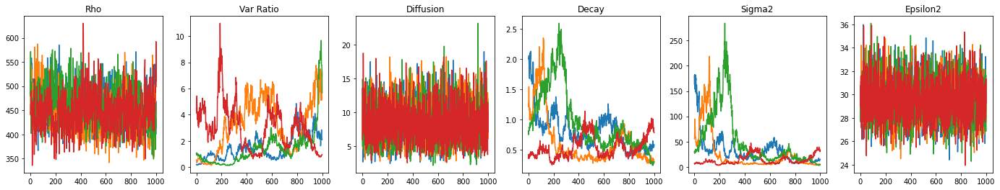

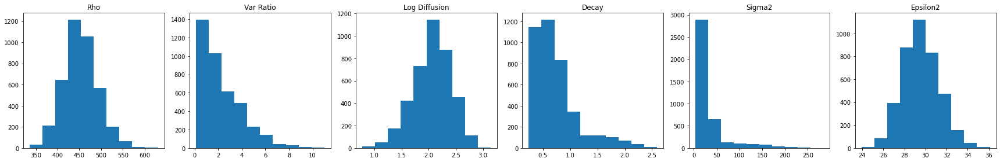

In [46]:
plot_tracks(samples)
plot_samples(samples)

In [25]:
rhos = [samples[j][i][0] for i in range(num_sample) for j in range(num_chains)]
varratios = [samples[j][i][1] for i in range(num_sample) for j in range(num_chains)]
diffs = [samples[j][i][2] for i in range(num_sample) for j in range(num_chains)]
decs = [samples[j][i][3] for i in range(num_sample) for j in range(num_chains)]
sigma2 = [samples[j][i][4] for i in range(num_sample) for j in range(num_chains)]
print([np.mean(rhos),np.mean(varratios),np.mean(diffs),np.mean(decs),np.mean(sigma2)])
print([np.std(rhos),np.std(varratios),np.std(diffs),np.std(decs),np.std(sigma2)])

eps2 = [sigma2[i]*varratios[i] for i in range(len(sigma2))]
print([np.mean(eps2),np.std(eps2)])
sigma = [np.sqrt(sigma2[i]) for i in range(len(sigma2))]
print([np.mean(sigma),np.std(sigma)])
eps = [np.sqrt(sigma2[i]*varratios[i]) for i in range(len(sigma2))]
print([np.mean(eps),np.std(eps)])

[453.3665067948097, 2.2554510105212997, 8.341983116601222, 0.7435410372994459, 30.166581488900206]
[38.97958904069211, 1.7492206720544827, 2.8093092863537255, 0.4091250815612659, 37.79883372128826]
[29.55549873891942, 1.717333396672507]
[4.836480536549776, 2.6028902221329675]
[5.434210234440386, 0.1576637777765809]


In [26]:
# Here we calculate the posterior mean

posterior_mean_soln = np.zeros(L.shape[0])
posterior_mean_source = np.zeros(L.shape[0])
for i in range(num_chains):
    for j in range(num_sample):
        if j%100 == 0:
            print([i,j])
        rho,varratio,diff,dec,sigma2 = tuple(samples[i][j])
        #sigma2 = calc_hat_sigma2(tuple(samples[i]))
        eps2 = varratio*sigma2

        #diffusion,decay = Constant(diff),Constant(dec)
        #equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds#- dot(n,advection)*u*v*ds # + div(advection*u)*v*dx
        K = diff*diffmat + advmat + dec*decaymat

        kappa = np.sqrt(8*nu)/rho
        Q_source = make_matern(guess_alpha,kappa,d,warped_V,sigma2,threshold=0,space_name="warped US") 
        Q_prior = K.transpose().tocsc() @ invL @ Q_source @ invL @ K
        Q_post  = Q_prior + O @ O.transpose()/eps2

        mean_soln_i = splinalg.spsolve(Q_post,O @ data)/eps2
        mean_source_i = invL @ K @ mean_soln_i

        posterior_mean_soln += mean_soln_i
        posterior_mean_source += mean_source_i
posterior_mean_source /= num_sample
posterior_mean_soln /= num_sample
soln_est = vec_to_func(posterior_mean_soln,warped_V)
source_est = vec_to_func(posterior_mean_source,warped_V)

[0, 0]
[0, 100]
[0, 200]
[0, 300]
[0, 400]
[0, 500]
[0, 600]
[0, 700]
[0, 800]
[0, 900]
[1, 0]
[1, 100]
[1, 200]
[1, 300]
[1, 400]
[1, 500]
[1, 600]
[1, 700]
[1, 800]
[1, 900]
[2, 0]
[2, 100]
[2, 200]
[2, 300]
[2, 400]
[2, 500]
[2, 600]
[2, 700]
[2, 800]
[2, 900]
[3, 0]
[3, 100]
[3, 200]
[3, 300]
[3, 400]
[3, 500]
[3, 600]
[3, 700]
[3, 800]
[3, 900]


Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


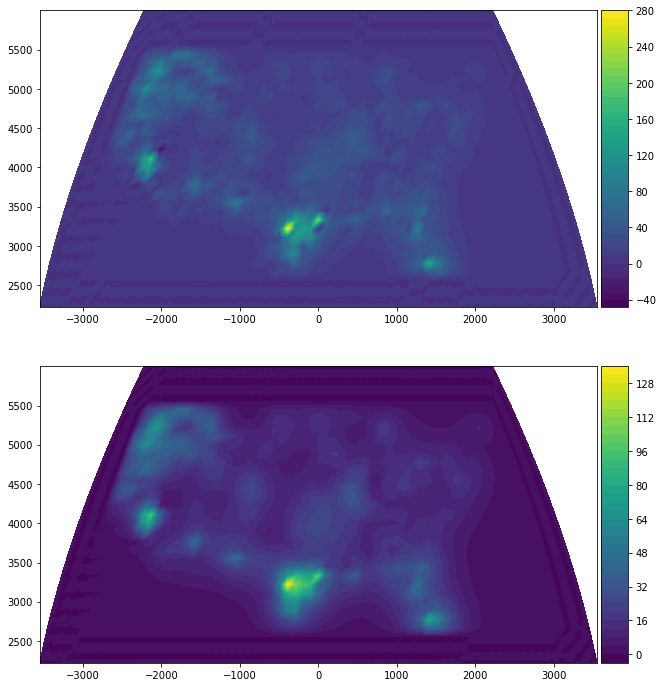

In [27]:
plt.figure(figsize=(16,12))

ax=plt.subplot(2,1,1)
c = plot(soln_est*interior_f)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,1,2)
c = plot(source_est*interior_f)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

plt.show()

In [28]:
# Now we use the law of total variance to calculate the pointwise variances for each location
# TODO DOUBLECHECK ALL THIS MATH, WHY IS THE STDERR SO HIGH???
exp_var_soln = np.zeros(L.shape[0])
var_exp_soln = np.zeros(L.shape[0])
exp_var_source = np.zeros(L.shape[0])
var_exp_source = np.zeros(L.shape[0])
for i in range(num_chains):
    for j in range(num_sample):
        print([i,j])
        rho,varratio,diff,dec,sigma2 = tuple(samples[i][j])
        #sigma2 = calc_hat_sigma2(tuple(samples[i]))
        eps2 = varratio*sigma2

        diffusion,decay = Constant(diff),Constant(dec)
        #equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds#- dot(n,advection)*u*v*ds # + div(advection*u)*v*dx
        #K = assemble_mat(equation)
        K = diff*diffmat + advmat + dec*decaymat

        kappa = 8*nu/rho**2
        Q_source = make_matern(guess_alpha,kappa,d,warped_V,sigma2,threshold=0,space_name="warped US") 
        Q_prior = K.transpose().tocsc() @ invL @ Q_source @ invL @ K
        Q_post  = Q_prior + O @ O.transpose()/eps2
        Q_post_chol = cholmod.cholesky(Q_post)

        mean_soln_i_alt = Q_post_chol(O @ data)/eps2
        mean_source_i = invL @ K @ mean_soln_i

        var_exp_soln += (mean_soln_i - posterior_mean_soln)**2
        var_exp_source += (mean_source_i - posterior_mean_source)**2

        cov_post_soln = Q_post_chol.inv()
        cov_post_source = invL @ K @ cov_post_soln @ K.transpose() @ invL

        exp_var_soln += cov_post_soln.diagonal()
        exp_var_source += cov_post_source.diagonal()
    
exp_var_soln /= num_sample
var_exp_soln /= num_sample
exp_var_source /= num_sample
var_exp_source /= num_sample

posterior_var_soln = exp_var_soln + var_exp_soln
posterior_var_source = exp_var_source + var_exp_source

var_est_soln = vec_to_func(posterior_var_soln,warped_V)
var_est_source = vec_to_func(posterior_var_source,warped_V)

std_est_soln = vec_to_func(np.sqrt(posterior_var_soln),warped_V)
std_est_source = vec_to_func(np.sqrt(posterior_var_source),warped_V)

[0, 0]
[0, 1]
[0, 2]
[0, 3]
[0, 4]
[0, 5]
[0, 6]
[0, 7]
[0, 8]
[0, 9]
[0, 10]
[0, 11]
[0, 12]
[0, 13]
[0, 14]
[0, 15]
[0, 16]
[0, 17]
[0, 18]
[0, 19]
[0, 20]
[0, 21]
[0, 22]
[0, 23]
[0, 24]
[0, 25]
[0, 26]
[0, 27]
[0, 28]
[0, 29]
[0, 30]
[0, 31]
[0, 32]
[0, 33]
[0, 34]
[0, 35]
[0, 36]
[0, 37]
[0, 38]
[0, 39]
[0, 40]
[0, 41]
[0, 42]
[0, 43]
[0, 44]
[0, 45]
[0, 46]
[0, 47]
[0, 48]
[0, 49]
[0, 50]
[0, 51]
[0, 52]
[0, 53]
[0, 54]
[0, 55]
[0, 56]
[0, 57]
[0, 58]
[0, 59]
[0, 60]
[0, 61]
[0, 62]
[0, 63]
[0, 64]
[0, 65]
[0, 66]
[0, 67]
[0, 68]
[0, 69]
[0, 70]
[0, 71]
[0, 72]
[0, 73]
[0, 74]
[0, 75]
[0, 76]
[0, 77]
[0, 78]
[0, 79]
[0, 80]
[0, 81]
[0, 82]
[0, 83]
[0, 84]
[0, 85]
[0, 86]
[0, 87]
[0, 88]
[0, 89]
[0, 90]
[0, 91]
[0, 92]
[0, 93]
[0, 94]
[0, 95]
[0, 96]
[0, 97]
[0, 98]
[0, 99]
[0, 100]
[0, 101]
[0, 102]
[0, 103]
[0, 104]
[0, 105]
[0, 106]
[0, 107]
[0, 108]
[0, 109]
[0, 110]
[0, 111]
[0, 112]
[0, 113]
[0, 114]
[0, 115]
[0, 116]
[0, 117]
[0, 118]
[0, 119]
[0, 120]
[0, 121]
[0, 122]
[0,

[0, 923]
[0, 924]
[0, 925]
[0, 926]
[0, 927]
[0, 928]
[0, 929]
[0, 930]
[0, 931]
[0, 932]
[0, 933]
[0, 934]
[0, 935]
[0, 936]
[0, 937]
[0, 938]
[0, 939]
[0, 940]
[0, 941]
[0, 942]
[0, 943]
[0, 944]
[0, 945]
[0, 946]
[0, 947]
[0, 948]
[0, 949]
[0, 950]
[0, 951]
[0, 952]
[0, 953]
[0, 954]
[0, 955]
[0, 956]
[0, 957]
[0, 958]
[0, 959]
[0, 960]
[0, 961]
[0, 962]
[0, 963]
[0, 964]
[0, 965]
[0, 966]
[0, 967]
[0, 968]
[0, 969]
[0, 970]
[0, 971]
[0, 972]
[0, 973]
[0, 974]
[0, 975]
[0, 976]
[0, 977]
[0, 978]
[0, 979]
[0, 980]
[0, 981]
[0, 982]
[0, 983]
[0, 984]
[0, 985]
[0, 986]
[0, 987]
[0, 988]
[0, 989]
[0, 990]
[0, 991]
[0, 992]
[0, 993]
[0, 994]
[0, 995]
[0, 996]
[0, 997]
[0, 998]
[0, 999]
[1, 0]
[1, 1]
[1, 2]
[1, 3]
[1, 4]
[1, 5]
[1, 6]
[1, 7]
[1, 8]
[1, 9]
[1, 10]
[1, 11]
[1, 12]
[1, 13]
[1, 14]
[1, 15]
[1, 16]
[1, 17]
[1, 18]
[1, 19]
[1, 20]
[1, 21]
[1, 22]
[1, 23]
[1, 24]
[1, 25]
[1, 26]
[1, 27]
[1, 28]
[1, 29]
[1, 30]
[1, 31]
[1, 32]
[1, 33]
[1, 34]
[1, 35]
[1, 36]
[1, 37]
[1, 38]
[1, 3

[1, 846]
[1, 847]
[1, 848]
[1, 849]
[1, 850]
[1, 851]
[1, 852]
[1, 853]
[1, 854]
[1, 855]
[1, 856]
[1, 857]
[1, 858]
[1, 859]
[1, 860]
[1, 861]
[1, 862]
[1, 863]
[1, 864]
[1, 865]
[1, 866]
[1, 867]
[1, 868]
[1, 869]
[1, 870]
[1, 871]
[1, 872]
[1, 873]
[1, 874]
[1, 875]
[1, 876]
[1, 877]
[1, 878]
[1, 879]
[1, 880]
[1, 881]
[1, 882]
[1, 883]
[1, 884]
[1, 885]
[1, 886]
[1, 887]
[1, 888]
[1, 889]
[1, 890]
[1, 891]
[1, 892]
[1, 893]
[1, 894]
[1, 895]
[1, 896]
[1, 897]
[1, 898]
[1, 899]
[1, 900]
[1, 901]
[1, 902]
[1, 903]
[1, 904]
[1, 905]
[1, 906]
[1, 907]
[1, 908]
[1, 909]
[1, 910]
[1, 911]
[1, 912]
[1, 913]
[1, 914]
[1, 915]
[1, 916]
[1, 917]
[1, 918]
[1, 919]
[1, 920]
[1, 921]
[1, 922]
[1, 923]
[1, 924]
[1, 925]
[1, 926]
[1, 927]
[1, 928]
[1, 929]
[1, 930]
[1, 931]
[1, 932]
[1, 933]
[1, 934]
[1, 935]
[1, 936]
[1, 937]
[1, 938]
[1, 939]
[1, 940]
[1, 941]
[1, 942]
[1, 943]
[1, 944]
[1, 945]
[1, 946]
[1, 947]
[1, 948]
[1, 949]
[1, 950]
[1, 951]
[1, 952]
[1, 953]
[1, 954]
[1, 955]
[1, 956]
[

[2, 769]
[2, 770]
[2, 771]
[2, 772]
[2, 773]
[2, 774]
[2, 775]
[2, 776]
[2, 777]
[2, 778]
[2, 779]
[2, 780]
[2, 781]
[2, 782]
[2, 783]
[2, 784]
[2, 785]
[2, 786]
[2, 787]
[2, 788]
[2, 789]
[2, 790]
[2, 791]
[2, 792]
[2, 793]
[2, 794]
[2, 795]
[2, 796]
[2, 797]
[2, 798]
[2, 799]
[2, 800]
[2, 801]
[2, 802]
[2, 803]
[2, 804]
[2, 805]
[2, 806]
[2, 807]
[2, 808]
[2, 809]
[2, 810]
[2, 811]
[2, 812]
[2, 813]
[2, 814]
[2, 815]
[2, 816]
[2, 817]
[2, 818]
[2, 819]
[2, 820]
[2, 821]
[2, 822]
[2, 823]
[2, 824]
[2, 825]
[2, 826]
[2, 827]
[2, 828]
[2, 829]
[2, 830]
[2, 831]
[2, 832]
[2, 833]
[2, 834]
[2, 835]
[2, 836]
[2, 837]
[2, 838]
[2, 839]
[2, 840]
[2, 841]
[2, 842]
[2, 843]
[2, 844]
[2, 845]
[2, 846]
[2, 847]
[2, 848]
[2, 849]
[2, 850]
[2, 851]
[2, 852]
[2, 853]
[2, 854]
[2, 855]
[2, 856]
[2, 857]
[2, 858]
[2, 861]
[2, 862]
[2, 863]
[2, 864]
[2, 865]
[2, 866]
[2, 867]
[2, 868]
[2, 869]
[2, 870]
[2, 871]
[2, 872]
[2, 873]
[2, 874]
[2, 875]
[2, 876]
[2, 877]
[2, 878]
[2, 879]
[2, 880]
[2, 881]
[

[3, 698]
[3, 699]
[3, 700]
[3, 701]
[3, 702]
[3, 703]
[3, 704]
[3, 705]
[3, 706]
[3, 707]
[3, 708]
[3, 709]
[3, 710]
[3, 711]
[3, 712]
[3, 713]
[3, 714]
[3, 715]
[3, 716]
[3, 717]
[3, 718]
[3, 719]
[3, 720]
[3, 721]
[3, 722]
[3, 723]
[3, 724]
[3, 725]
[3, 726]
[3, 727]
[3, 728]
[3, 729]
[3, 730]
[3, 731]
[3, 732]
[3, 733]
[3, 734]
[3, 735]
[3, 736]
[3, 737]
[3, 738]
[3, 739]
[3, 740]
[3, 741]
[3, 742]
[3, 743]
[3, 744]
[3, 745]
[3, 746]
[3, 747]
[3, 748]
[3, 749]
[3, 750]
[3, 751]
[3, 752]
[3, 753]
[3, 754]
[3, 755]
[3, 756]
[3, 757]
[3, 758]
[3, 759]
[3, 760]
[3, 761]
[3, 762]
[3, 763]
[3, 764]
[3, 765]
[3, 766]
[3, 767]
[3, 768]
[3, 769]
[3, 770]
[3, 771]
[3, 772]
[3, 773]
[3, 774]
[3, 775]
[3, 776]
[3, 777]
[3, 778]
[3, 779]
[3, 780]
[3, 781]
[3, 782]
[3, 783]
[3, 784]
[3, 785]
[3, 786]
[3, 787]
[3, 788]
[3, 789]
[3, 790]
[3, 791]
[3, 792]
[3, 793]
[3, 794]
[3, 795]
[3, 796]
[3, 797]
[3, 798]
[3, 799]
[3, 800]
[3, 801]
[3, 802]
[3, 803]
[3, 804]
[3, 805]
[3, 806]
[3, 807]
[3, 808]
[

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


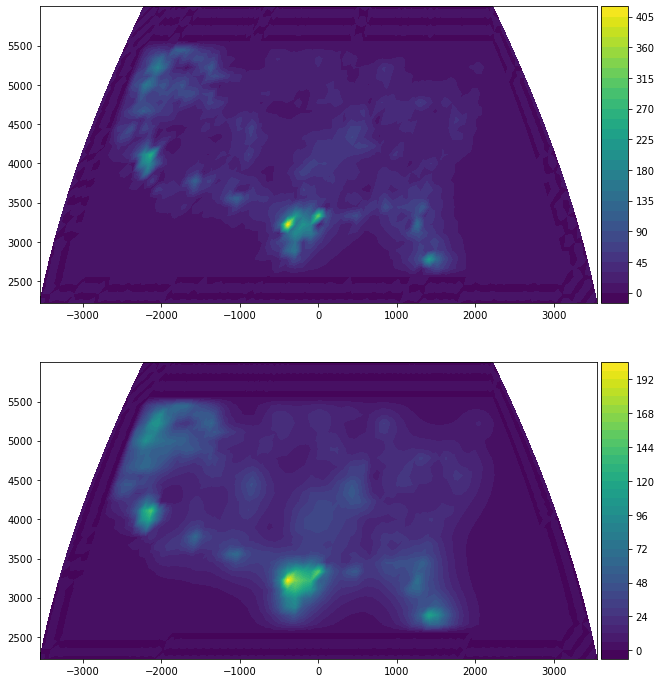

In [29]:
plt.figure(figsize=(16,12))

ax=plt.subplot(2,1,1)
c = plot(std_est_soln*interior_f)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
#ax.scatter(xs,ys)

ax = plt.subplot(2,1,2)
c = plot(std_est_source*interior_f)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

plt.show()

In [30]:
print("Amount entering:")
print(assemble(source_est*dx)) 
print("Amount leaving/decay:")
print(dec*assemble(soln_est*dx)) # small difference attributable to boundary effects

Amount entering:
232918776.46493474
Amount leaving/decay:
242164604.38991714


In [31]:
print(assemble(source_est*interior_f*dx)/7.6e6)

27.650260904750546


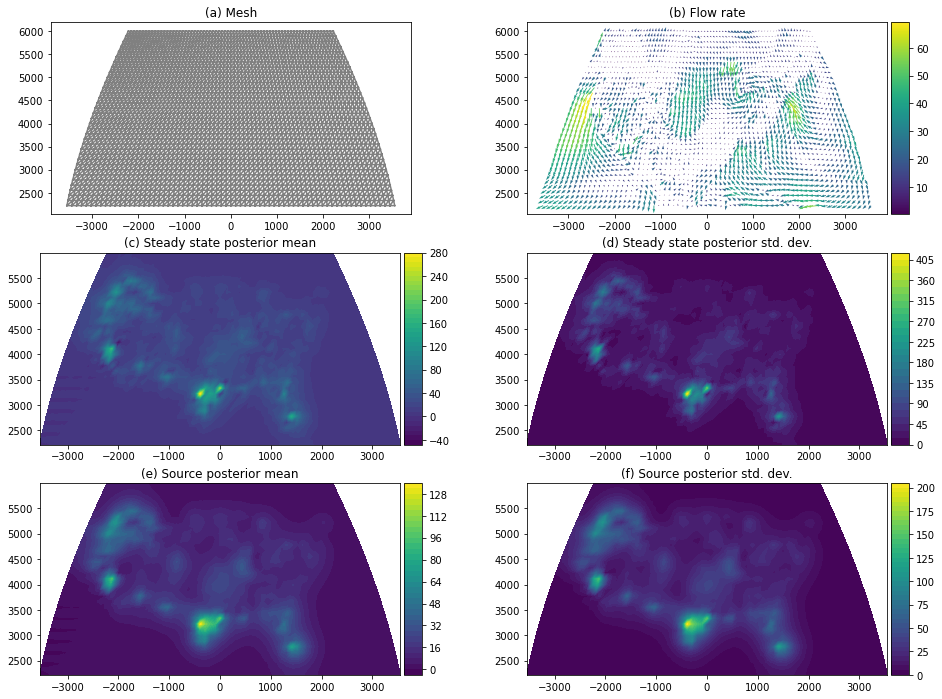

In [32]:
plt.figure(figsize=(16,12))

ax=plt.subplot(3,2,1)
c = plot(mesh,title="(a) Mesh")

ax=plt.subplot(3,2,2)
c = plot(advection,mesh=mesh,title="(b) Flow rate")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,3)
c = plot(soln_est,title='(c) Steady state posterior mean')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,4)
c = plot(std_est_soln,title='(d) Steady state posterior std. dev.')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,5)
c = plot(source_est,title='(e) Source posterior mean')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,6)
c = plot(std_est_source,title='(f) Source posterior std. dev.')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

plt.show()

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


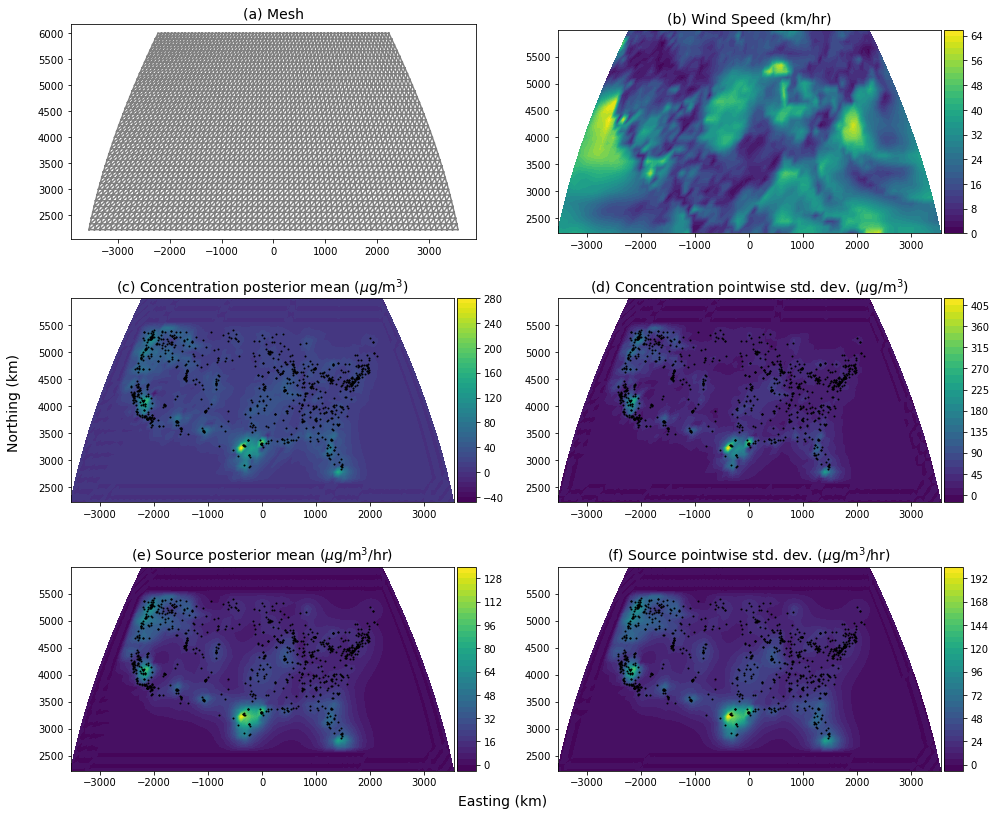

In [33]:
fig = plt.figure(figsize=(16,14))

titletextsize = 14
textsize = 14

ax=plt.subplot(3,2,1)

c = plot(mesh)
plt.title("(a) Mesh",size=titletextsize)

ax=plt.subplot(3,2,2)
c = plot(speed_f,mesh=mesh)
plt.title("(b) Wind Speed (km/hr)",fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,3)
c = plot(soln_est*interior_f)
plt.title('(c) Concentration posterior mean ($\mu$g/m$^3$)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,4)
c = plot(std_est_soln*interior_f)
plt.title('(d) Concentration pointwise std. dev. ($\mu$g/m$^3$)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,5)
c = plot(source_est*interior_f)
plt.title('(e) Source posterior mean ($\mu$g/m$^3$/hr)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,6)
c = plot(std_est_source*interior_f)
plt.title('(f) Source pointwise std. dev. ($\mu$g/m$^3$/hr)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

fig.text(0.5, 0.1, 'Easting (km)', ha='center',size=textsize)
fig.text(0.07, 0.5, 'Northing (km)', va='center', rotation='vertical',size=textsize)

plt.show()

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


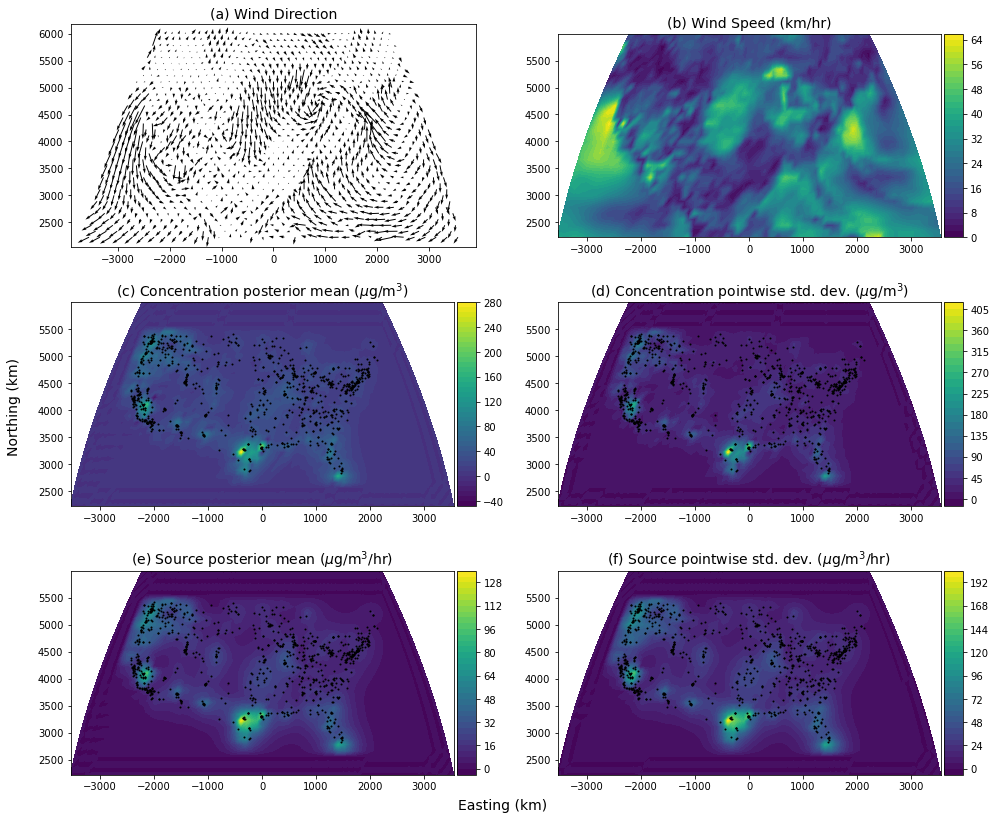

In [34]:
fig = plt.figure(figsize=(16,14))

titletextsize = 14
textsize = 14

ax=plt.subplot(3,2,1)

x = [km_x_coords[i] for i in range(len(km_x_coords)) if i%2==0]
y= [km_y_coords[i] for i in range(len(km_y_coords)) if i%2==0]
u = [vel_x[i]/20 for i in range(len(vel_x)) if i%2==0]
v = [list(vel_y)[i]/20 for i in range(len(vel_y)) if i%2==0]
q = ax.quiver(x,y,u,v)
plt.title("(a) Wind Direction",size=titletextsize)

ax=plt.subplot(3,2,2)
c = plot(speed_f,mesh=mesh)
plt.title("(b) Wind Speed (km/hr)",fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax=plt.subplot(3,2,3)
c = plot(soln_est*interior_f)
plt.title('(c) Concentration posterior mean ($\mu$g/m$^3$)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,4)
c = plot(std_est_soln*interior_f)
plt.title('(d) Concentration pointwise std. dev. ($\mu$g/m$^3$)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,5)
c = plot(source_est*interior_f)
plt.title('(e) Source posterior mean ($\mu$g/m$^3$/hr)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(3,2,6)
c = plot(std_est_source*interior_f)
plt.title('(f) Source pointwise std. dev. ($\mu$g/m$^3$/hr)',fontsize=titletextsize)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

fig.text(0.5, 0.1, 'Easting (km)', ha='center',size=textsize)
fig.text(0.07, 0.5, 'Northing (km)', va='center', rotation='vertical',size=textsize)

plt.savefig("../figs/results_and_data.png")

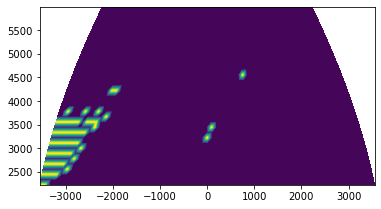

In [35]:
plot(vec_to_func(func_to_vec(soln_est) < 0,V))

90.8


(array([628., 228.,  50.,  14.,  12.,  11.,   0.,   0.,   1.,   2.]),
 array([-1.1 ,  8.09, 17.28, 26.47, 35.66, 44.85, 54.04, 63.23, 72.42,
        81.61, 90.8 ]),
 <BarContainer object of 10 artists>)

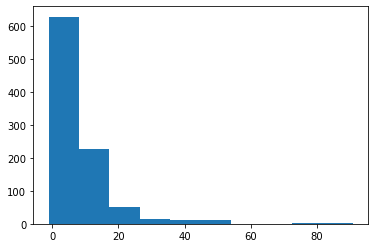

In [36]:
print(np.max(data))
plt.hist(data)

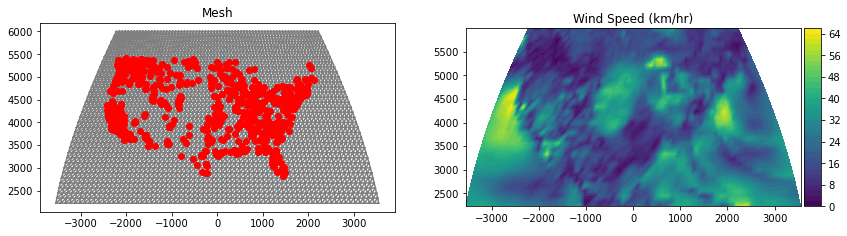

In [37]:
plt.figure(figsize=(14,5))

ax=plt.subplot(1,2,1)
c = plot(mesh,title="Mesh")
ax.scatter(xs,ys,color="red")

ax=plt.subplot(1,2,2)
c = plot(speed_f,mesh=mesh,title="Wind Speed (km/hr)")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

plt.show()

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


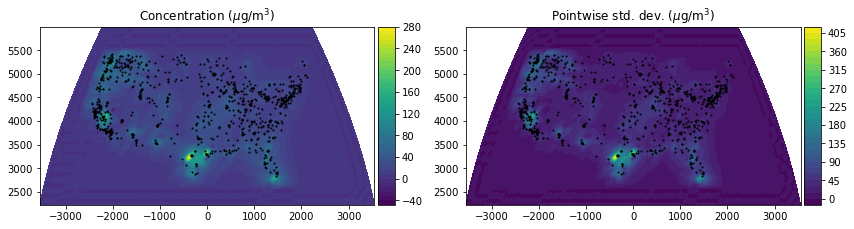

In [38]:
plt.figure(figsize=(14,5))


ax=plt.subplot(1,2,1)
c = plot(soln_est*interior_f,title='Concentration ($\mu$g/m$^3$)')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(1,2,2)
c = plot(std_est_soln*interior_f,title='Pointwise std. dev. ($\mu$g/m$^3$)')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

plt.show()

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


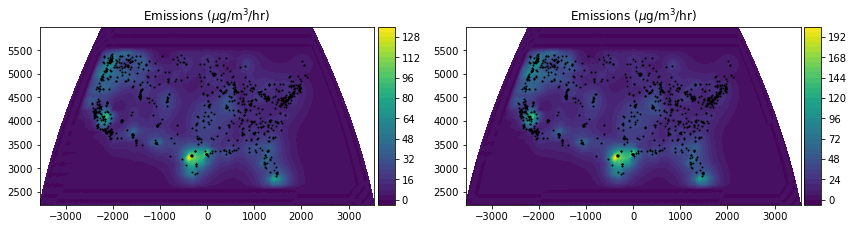

In [39]:
plt.figure(figsize=(14,5))

ax=plt.subplot(1,2,1)
c = plot(source_est*interior_f,title='Emissions ($\mu$g/m$^3$/hr)')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

ax=plt.subplot(1,2,2)
c = plot(std_est_source*interior_f,title='Emissions ($\mu$g/m$^3$/hr)')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
ax.scatter(xs,ys,s=1,color="black")

plt.show()

In [40]:
data

array([ 7.3,  5.2,  6.7,  6.4,  5. ,  6.8,  5.4, 10. ,  8.5,  4.2,  4.7,
        1.2,  3.8,  4. , 18.2, 13.9, 16.8, 10.8, 31.7,  9.2, 11.3, 13.2,
       19.9,  3.7,  0.9,  3.6,  2.3,  4. ,  2.6,  6.4,  8.8,  5.4,  5.5,
        7.8,  7.5,  5.8,  8.1,  8.3,  9.9,  5.7,  4.2,  6.2,  3.5,  5.5,
        2.7, 13.5, 12.5,  5.4, 17.9,  1.9,  2.8,  4.6, 51.3, 47.1, 47.1,
       25.8,  5.5,  2.1, 39.1,  1.4,  8.3,  8.6,  0.6, 19.3,  2.3, 37.8,
       33.2,  1. , 33.2, 39.5,  6.2, 17.1, 19.9,  3.3,  6.5,  5.5,  5.6,
       12.8, 14.8,  2.8,  2. , 22.3,  1.9, 15.1, 12.5, 23.5, 23.5, 24.3,
        1.4,  1.3,  5.7, 18.8,  4.8,  2.7,  0.8,  4.2,  4.9,  3.7,  5. ,
        8. ,  4.3,  0.2,  0.9,  2.5,  1.5,  1.3,  2.3, -0.2,  5.3,  4. ,
        3.7,  3.7,  4.7,  3.8,  2.3,  3. ,  2.8,  4.9,  4.5,  4.2,  2.1,
        0.9,  1.1,  5.8, 11.2, 12.3,  3.8,  9.7,  8.1,  6.2,  4.4,  7.3,
        3.8,  4.5, 17.3,  7.8,  9.6,  5.4,  7.8,  3.1, 10.8,  8.5, 14.3,
        3.1,  8.9, 10.1,  9.7,  9.7,  3.5, 11.1,  3

Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.
Object cannot be plotted directly, projecting to piecewise linears.


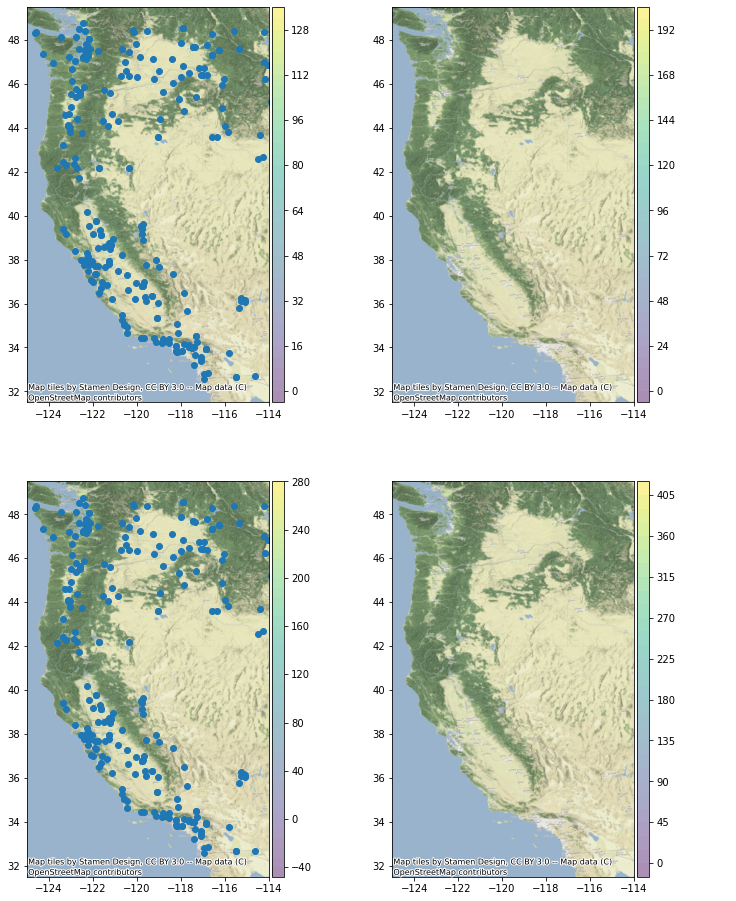

In [41]:
plt.figure(figsize=(12,16))

ax = plt.subplot(2,2,1)
ax.set_xlim([-125,-114])
ax.set_ylim([31.5,49.5])
c = plot(source_est*interior_f,alpha=0.45)
ax.scatter(lons,lats)
ctx.add_basemap(ax,zoom=8,crs="EPSG:4326")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,2)
ax.set_xlim([-125,-114])
ax.set_ylim([31.5,49.5])
c = plot(std_est_source*interior_f,alpha=0.45)
ctx.add_basemap(ax,zoom=8,crs="EPSG:4326")
ax.scatter(xs,ys)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,3)
ax.set_xlim([-125,-114])
ax.set_ylim([31.5,49.5])
c = plot(soln_est*interior_f,alpha=0.45)
ax.scatter(lons,lats)
ctx.add_basemap(ax,zoom=8,crs="EPSG:4326")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,4)
ax.set_xlim([-125,-114])
ax.set_ylim([31.5,49.5])
c = plot(std_est_soln*interior_f,alpha=0.45)
ctx.add_basemap(ax,zoom=8,crs="EPSG:4326")
ax.scatter(xs,ys)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
plt.show()

NameError: name 'w_est' is not defined

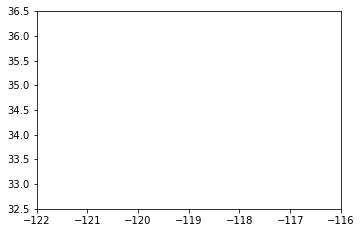

In [42]:
plt.figure(figsize=(12,8))

ax = plt.subplot(2,2,1)
ax.set_xlim([-122,-116])
ax.set_ylim([32.5,36.5])
c = plot(w_est*interior_f,alpha=0.8)
ax.scatter(lons,lats)
ctx.add_basemap(ax,zoom=7,crs="EPSG:4326")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,2)
ax.set_xlim([-122,-116])
ax.set_ylim([32.5,36.5])
c = plot(std_f*interior_f,alpha=0.8)
ctx.add_basemap(ax,zoom=7,crs="EPSG:4326")
ax.scatter(xs,ys)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,3)
ax.set_xlim([-122,-116])
ax.set_ylim([32.5,36.5])
c = plot(source_est*interior_f,alpha=0.8)
ax.scatter(lons,lats)
ctx.add_basemap(ax,zoom=7,crs="EPSG:4326")
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)

ax = plt.subplot(2,2,4)
ax.set_xlim([-122,-116])
ax.set_ylim([32.5,36.5])
c = plot(std_post_f*interior_f,alpha=0.8)
ctx.add_basemap(ax,zoom=7,crs="EPSG:4326")
ax.scatter(xs,ys)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right",size="5%",pad=0.05)
plt.colorbar(c,cax=cax)
plt.show()